In [16]:
# set vars here
degrees = [x for x in range(5)]
eps = 0.000001
compression_ratios = [0.1, 0.2, 0.3, 0.4, 0.5]

In [17]:
"""%%time
# load datasets (short, medium, long)
from data_utils import load_ucr_archive

ts_lengths = [(50, 199), (200, 499)]#, (500, 799)]
all_data = []
all_compression_ratios = []
for min_length, max_length in ts_lengths:
    all_data.append(load_ucr_archive(min_length, max_length))
    min_compression_ratio = (max(degrees) + 1) / min_length
    if (min_compression_ratio < min(compression_ratios)) & (min_compression_ratio not in compression_ratios):
        all_compression_ratios.append([min_compression_ratio] + compression_ratios)
    else:
        print("compression ratio", min_compression_ratio, "either too small or already present:")
        all_compression_ratios.append(compression_ratios)
print(*all_compression_ratios)"""

'%%time\n# load datasets (short, medium, long)\nfrom data_utils import load_ucr_archive\n\nts_lengths = [(50, 199), (200, 499)]#, (500, 799)]\nall_data = []\nall_compression_ratios = []\nfor min_length, max_length in ts_lengths:\n    all_data.append(load_ucr_archive(min_length, max_length))\n    min_compression_ratio = (max(degrees) + 1) / min_length\n    if (min_compression_ratio < min(compression_ratios)) & (min_compression_ratio not in compression_ratios):\n        all_compression_ratios.append([min_compression_ratio] + compression_ratios)\n    else:\n        print("compression ratio", min_compression_ratio, "either too small or already present:")\n        all_compression_ratios.append(compression_ratios)\nprint(*all_compression_ratios)'

In [18]:
"""%%time
from data_utils import load_gbnc_data
data = load_gbnc_data()"""

'%%time\nfrom data_utils import load_gbnc_data\ndata = load_gbnc_data()'

In [19]:
from data_utils import load_ucr_dataset
data = load_ucr_dataset(48)

In [20]:
from math import sqrt
import scipy
from spline_utils import calculate_max_dist


def calculate_errors(data_tuples, knots, n, eps=eps):
    result1 = scipy.interpolate.make_lsq_spline([x[0] for x in data_tuples], [x[1] for x in data_tuples], knots, k=n).c
    result2 = fit_max_spline(data_tuples, knots, n)[1]
    result3 = fit_max_l1_spline(data_tuples, knots, n, eps=eps)[1]

    results = [result1, result2, result3]

    errors = []
    data_points = [x[1] for x in data_tuples]
    counter = 0
    for result in results:
        counter += 1
        fitted_spline = [evaluate_spline(knots, result, n, x[0]) for x in data_tuples]  #data_points]
        max_dist = calculate_max_dist(knots, result, n, data_tuples)[0]
        errors.append([max_dist,  # maximum absolute distance,
                       mean_squared_error(data_points, fitted_spline),  # MSE
                       sqrt(mean_squared_error(data_points, fitted_spline)),  # RMSE
                       mean_absolute_error(data_points, fitted_spline)  # MAE
                       ])

    return errors

In [25]:
degrees = [1]

number of time series: 208
GestureMidAirD3 no. 0 len(ts): 180 ts processed: 0.0 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.137733  0.000703  0.026523  0.013592
Max         0.102853  0.007098  0.084250  0.078687
Max and L1  0.102854  0.001716  0.041425  0.024621 

opt distance 0.10285260901174142
number of data points: 180


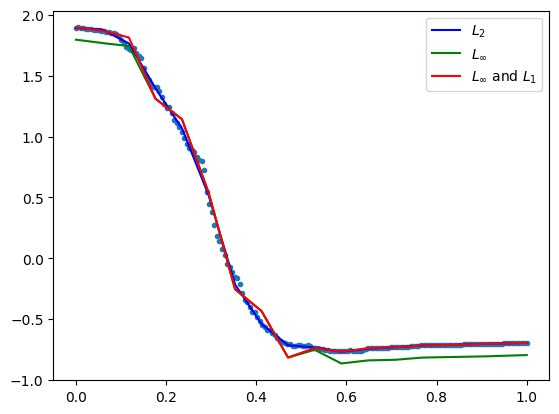

            max_dist       MSE      RMSE       MAE
LSQ         0.062576  0.000151  0.012278  0.006438
Max         0.050121  0.001872  0.043270  0.041132
Max and L1  0.050122  0.000249  0.015787  0.007873 

opt distance 0.05012079174559159
number of data points: 180


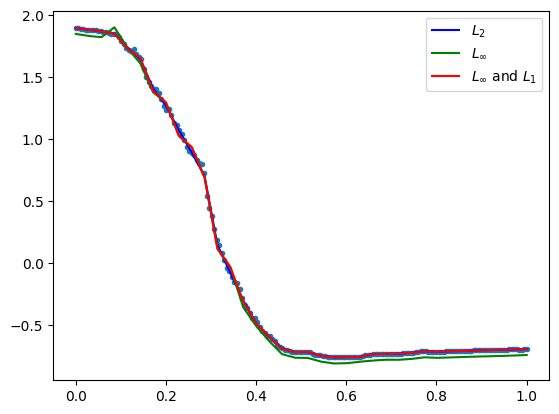

            max_dist       MSE      RMSE       MAE
LSQ         0.045101  0.000071  0.008406  0.004249
Max         0.034299  0.000927  0.030442  0.029155
Max and L1  0.034300  0.000083  0.009116  0.004325 

opt distance 0.03429866601885765
number of data points: 180


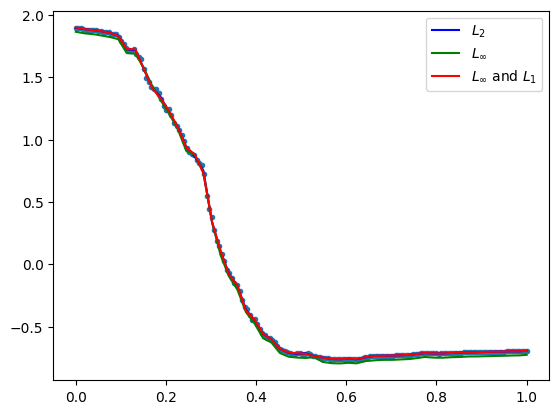

            max_dist       MSE      RMSE       MAE
LSQ         0.031470  0.000040  0.006310  0.003351
Max         0.023325  0.000438  0.020929  0.020233
Max and L1  0.023326  0.000052  0.007227  0.003434 

opt distance 0.023324939007666252
number of data points: 180


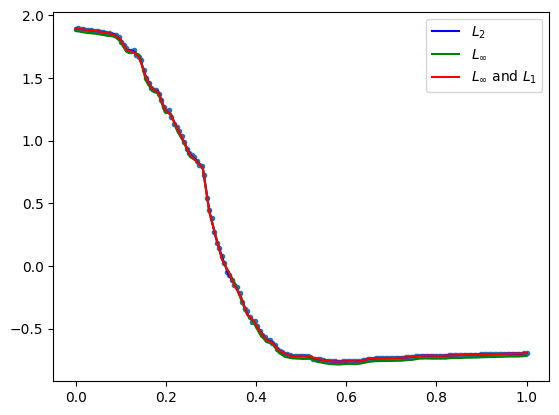

            max_dist       MSE      RMSE       MAE
LSQ         0.026083  0.000026  0.005132  0.002653
Max         0.018205  0.000277  0.016628  0.016103
Max and L1  0.018206  0.000036  0.005976  0.002806 

opt distance 0.01820528309459365
number of data points: 180


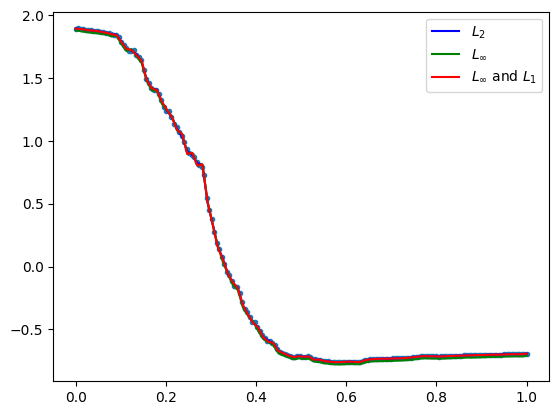

GestureMidAirD3 no. 1 len(ts): 90 ts processed: 0.48 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.623434  0.042364  0.205825  0.142697
Max         0.483716  0.103621  0.321902  0.282324
Max and L1  0.483717  0.064988  0.254928  0.195667 

opt distance 0.48371619118612547
number of data points: 90


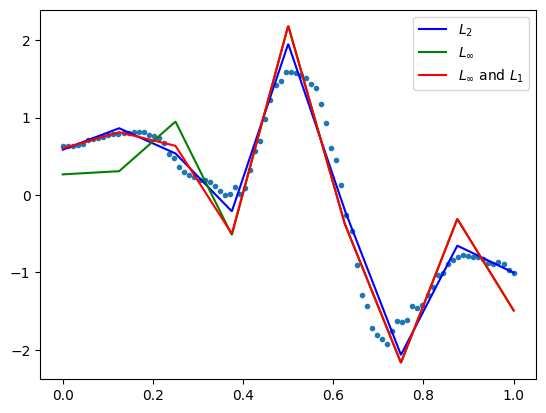

            max_dist       MSE      RMSE       MAE
LSQ         0.158272  0.002844  0.053332  0.039426
Max         0.148815  0.012121  0.110094  0.097410
Max and L1  0.148816  0.003279  0.057264  0.039717 

opt distance 0.1488150770335248
number of data points: 90


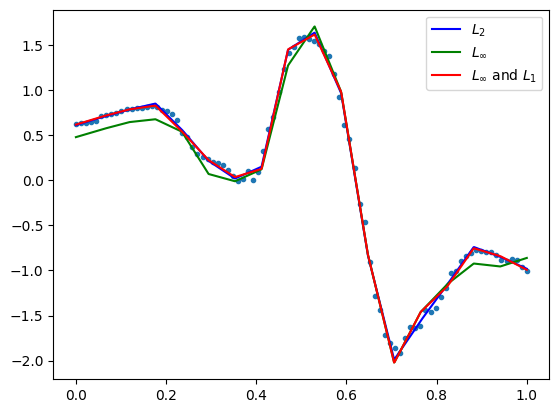

            max_dist       MSE      RMSE       MAE
LSQ         0.112179  0.001432  0.037841  0.025463
Max         0.096129  0.005745  0.075797  0.069702
Max and L1  0.096130  0.001771  0.042088  0.027172 

opt distance 0.09612882565734805
number of data points: 90


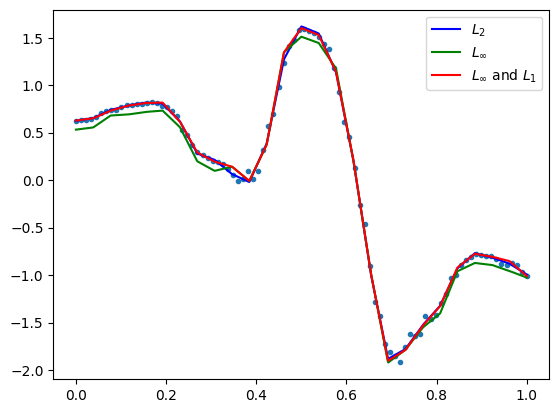

            max_dist       MSE      RMSE       MAE
LSQ         0.083945  0.000804  0.028353  0.019394
Max         0.075761  0.003709  0.060903  0.056443
Max and L1  0.075762  0.000999  0.031604  0.019237 

opt distance 0.07576076315764374
number of data points: 90


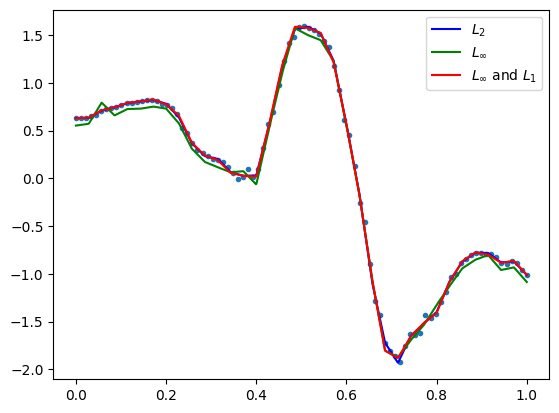

            max_dist       MSE      RMSE       MAE
LSQ         0.081055  0.000759  0.027548  0.018281
Max         0.063015  0.002770  0.052630  0.049164
Max and L1  0.063016  0.001050  0.032399  0.021081 

opt distance 0.06301476800613089
number of data points: 90


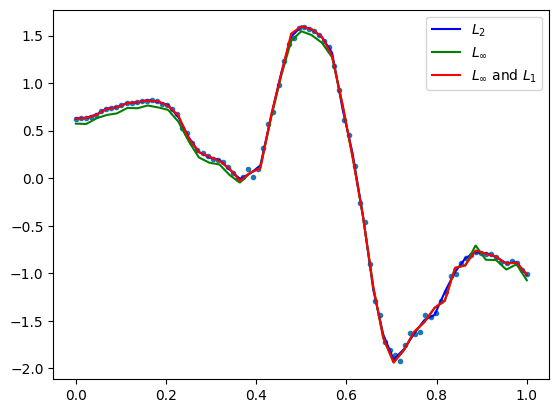

GestureMidAirD3 no. 2 len(ts): 120 ts processed: 0.96 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.060745  0.000299  0.017287  0.012191
Max         0.049932  0.001165  0.034139  0.030536
Max and L1  0.049933  0.000340  0.018452  0.012554 

opt distance 0.04993239419618334
number of data points: 120


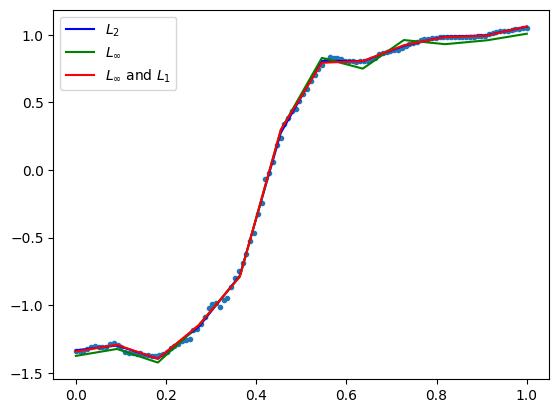

            max_dist       MSE      RMSE       MAE
LSQ         0.048772  0.000183  0.013517  0.008815
Max         0.040675  0.001040  0.032245  0.030131
Max and L1  0.040676  0.000205  0.014335  0.009070 

opt distance 0.04067493485265177
number of data points: 120


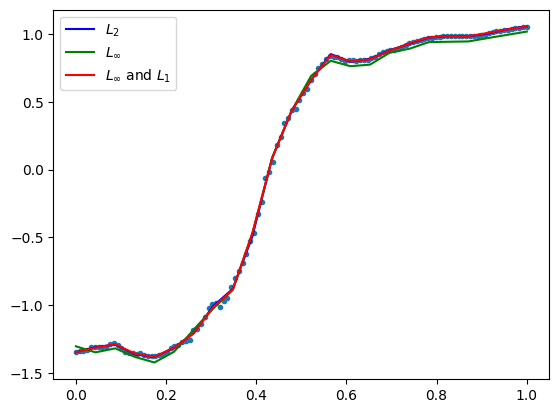

            max_dist       MSE      RMSE       MAE
LSQ         0.053334  0.000128  0.011322  0.006900
Max         0.034934  0.000880  0.029666  0.028033
Max and L1  0.034935  0.000173  0.013169  0.007555 

opt distance 0.03493404433309144
number of data points: 120


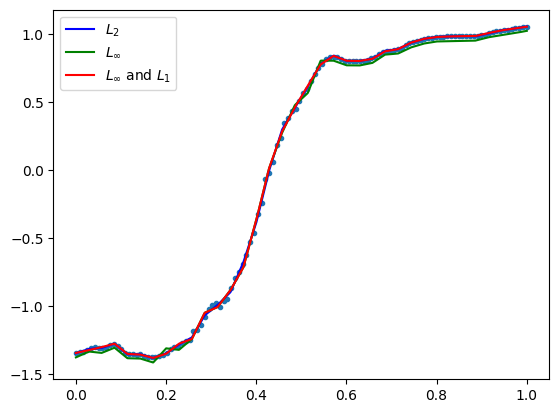

            max_dist       MSE      RMSE       MAE
LSQ         0.043129  0.000067  0.008183  0.004818
Max         0.029743  0.000646  0.025421  0.024334
Max and L1  0.029744  0.000080  0.008963  0.004504 

opt distance 0.02974297703345197
number of data points: 120


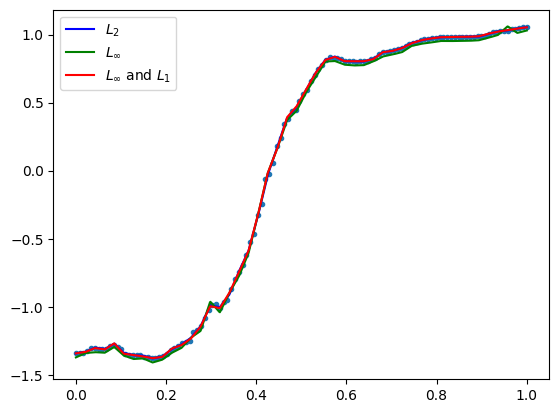

            max_dist       MSE      RMSE       MAE
LSQ         0.029955  0.000054  0.007344  0.004414
Max         0.024772  0.000475  0.021785  0.020721
Max and L1  0.024773  0.000061  0.007809  0.004039 

opt distance 0.024772457482571175
number of data points: 120


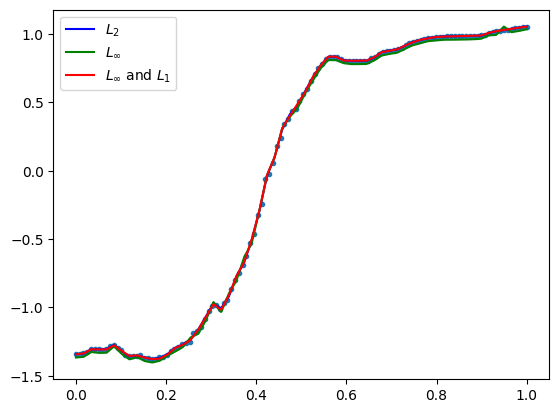

GestureMidAirD3 no. 3 len(ts): 240 ts processed: 1.44 %
[24, 48, 72, 96, 120]
            max_dist       MSE      RMSE       MAE
LSQ         0.309028  0.005126  0.071596  0.049022
Max         0.236763  0.030753  0.175366  0.162914
Max and L1  0.236764  0.011730  0.108304  0.078386 
opt distance 0.23676345694789097
number of data points: 240


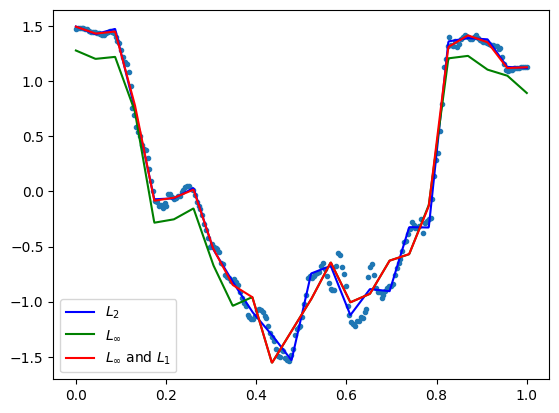

            max_dist       MSE      RMSE       MAE
LSQ         0.201353  0.002106  0.045887  0.030511
Max         0.149430  0.013092  0.114422  0.105827
Max and L1  0.149431  0.002856  0.053442  0.033307 

opt distance 0.14943007982583445
number of data points: 240


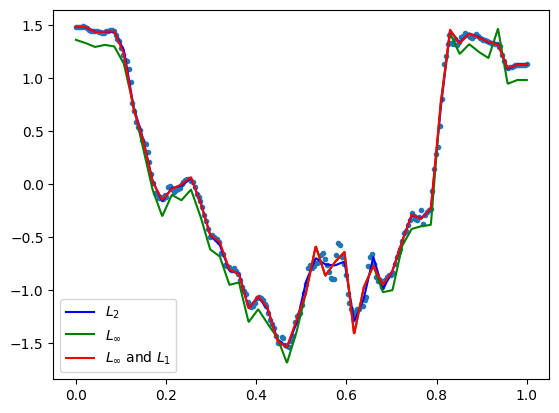

            max_dist       MSE      RMSE       MAE
LSQ         0.149529  0.000946  0.030765  0.019984
Max         0.106807  0.007450  0.086314  0.080620
Max and L1  0.106808  0.001271  0.035654  0.021669 

opt distance 0.106806656532667
number of data points: 240


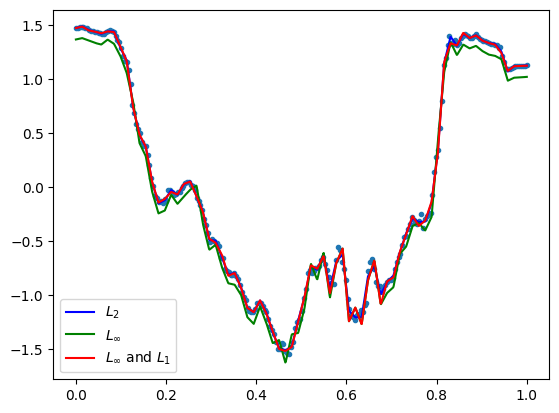

            max_dist       MSE      RMSE       MAE
LSQ         0.106140  0.000504  0.022459  0.015132
Max         0.074522  0.003814  0.061754  0.057942
Max and L1  0.074523  0.000640  0.025300  0.014630 

opt distance 0.07452235968074612
number of data points: 240


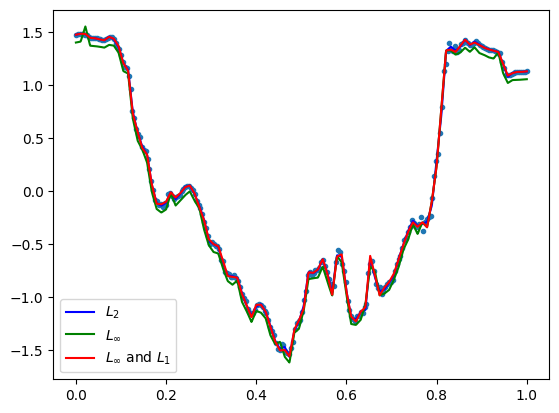

            max_dist       MSE      RMSE       MAE
LSQ         0.085034  0.000268  0.016383  0.010995
Max         0.062408  0.002977  0.054565  0.051929
Max and L1  0.062409  0.000458  0.021404  0.011251 

opt distance 0.06240831154176566
number of data points: 240


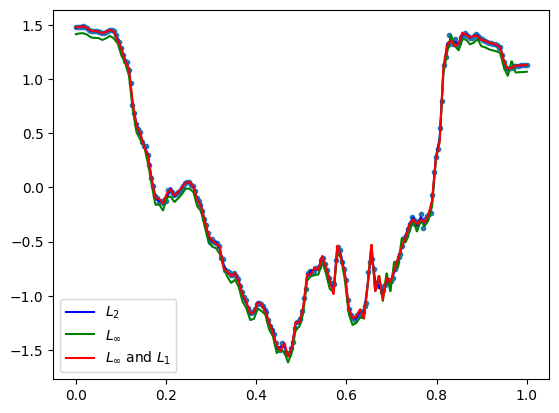

GestureMidAirD3 no. 4 len(ts): 238 ts processed: 1.92 %
[23, 47, 71, 95, 119]
            max_dist       MSE      RMSE       MAE
LSQ         0.283930  0.005321  0.072945  0.055447
Max         0.188271  0.015950  0.126294  0.113265
Max and L1  0.188272  0.006622  0.081374  0.061681 
opt distance 0.18827118374393761
number of data points: 238


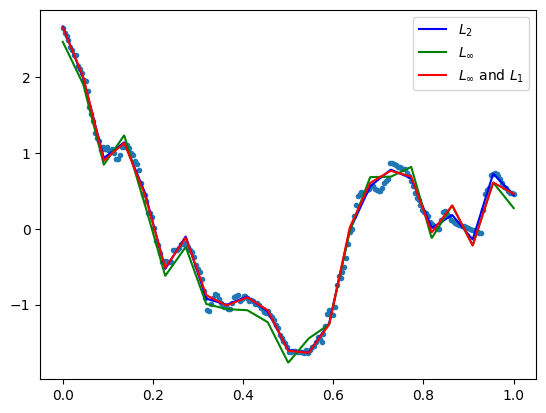

            max_dist       MSE      RMSE       MAE
LSQ         0.215748  0.002045  0.045224  0.032099
Max         0.159823  0.013386  0.115699  0.105409
Max and L1  0.159824  0.003312  0.057546  0.038366 

opt distance 0.15982321219318832
number of data points: 238


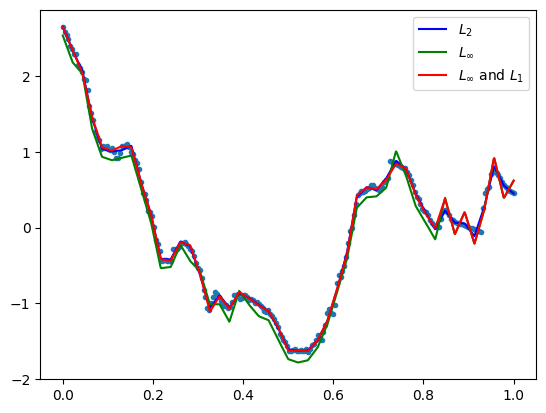

            max_dist       MSE      RMSE       MAE
LSQ         0.104237  0.001012  0.031817  0.022768
Max         0.089595  0.004922  0.070155  0.064724
Max and L1  0.089596  0.001308  0.036159  0.023746 

opt distance 0.08959507830209291
number of data points: 238


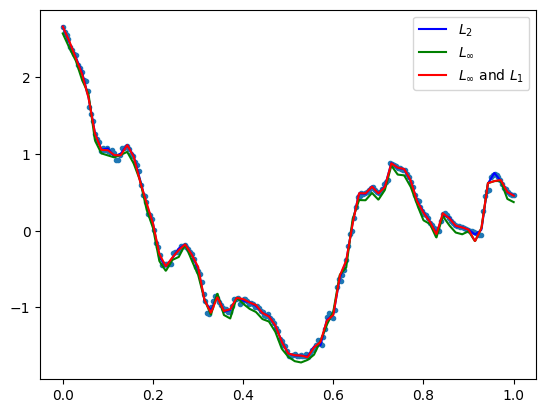

            max_dist       MSE      RMSE       MAE
LSQ         0.104273  0.000693  0.026320  0.018561
Max         0.077926  0.003977  0.063066  0.058579
Max and L1  0.077927  0.000920  0.030331  0.018419 

opt distance 0.07792588848266883
number of data points: 238


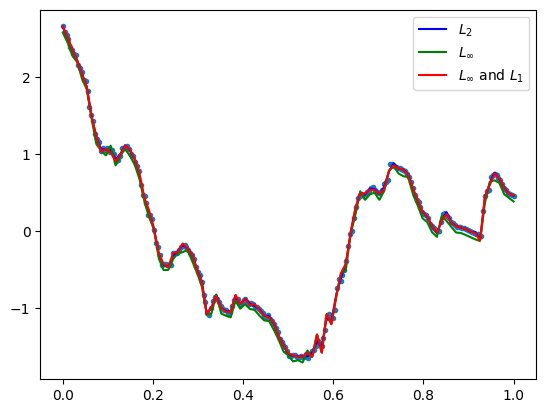

            max_dist       MSE      RMSE       MAE
LSQ         0.123293  0.000389  0.019723  0.013015
Max         0.079143  0.004764  0.069018  0.065761
Max and L1  0.079144  0.000532  0.023066  0.012065 

opt distance 0.07914270286402425
number of data points: 238


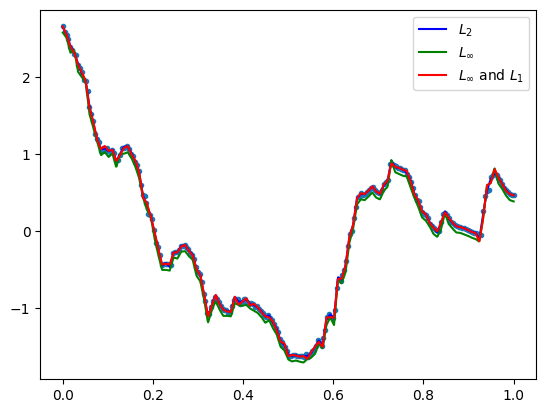

GestureMidAirD3 no. 5 len(ts): 90 ts processed: 2.4 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.093153  0.001457  0.038168  0.030809
Max         0.072657  0.001886  0.043433  0.037523
Max and L1  0.072658  0.001879  0.043344  0.037416 

opt distance 0.07265676092058536
number of data points: 90


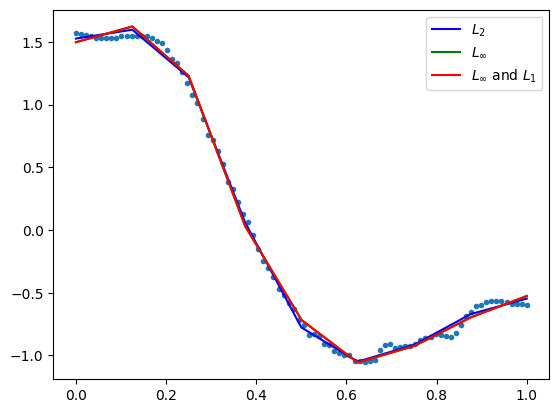

            max_dist       MSE      RMSE       MAE
LSQ         0.044311  0.000274  0.016563  0.012563
Max         0.034399  0.000614  0.024787  0.022405
Max and L1  0.034400  0.000349  0.018676  0.014661 

opt distance 0.03439869454995316
number of data points: 90


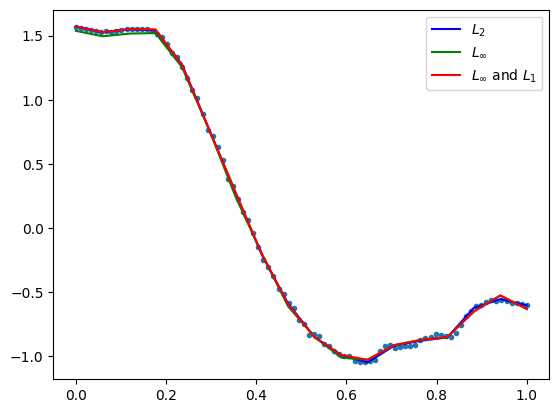

            max_dist       MSE      RMSE       MAE
LSQ         0.040727  0.000140  0.011812  0.008302
Max         0.029059  0.000483  0.021983  0.019879
Max and L1  0.029060  0.000162  0.012742  0.008332 

opt distance 0.02905915464809189
number of data points: 90


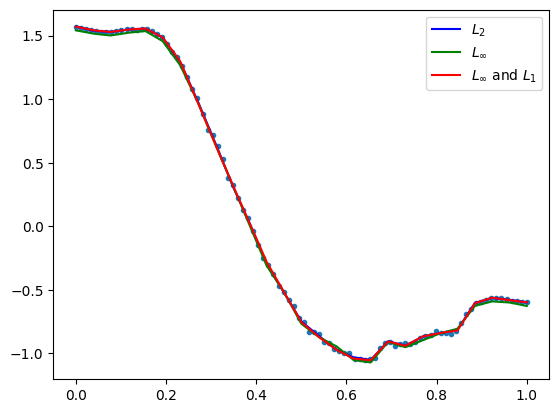

            max_dist       MSE      RMSE       MAE
LSQ         0.026748  0.000092  0.009584  0.006993
Max         0.021785  0.000295  0.017165  0.015743
Max and L1  0.021786  0.000113  0.010607  0.007078 

opt distance 0.0217853883336
number of data points: 90


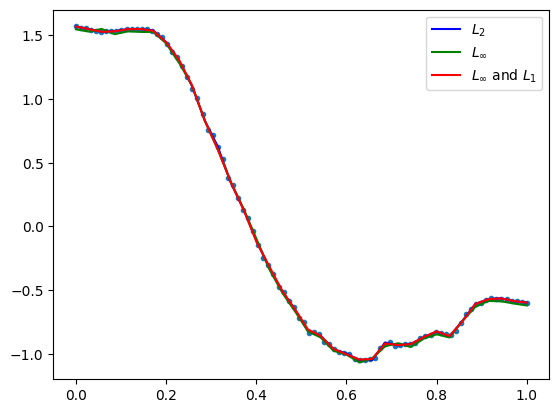

            max_dist       MSE      RMSE       MAE
LSQ         0.023626  0.000066  0.008153  0.005780
Max         0.018064  0.000234  0.015288  0.014140
Max and L1  0.018065  0.000091  0.009527  0.006298 

opt distance 0.018064160329462897
number of data points: 90


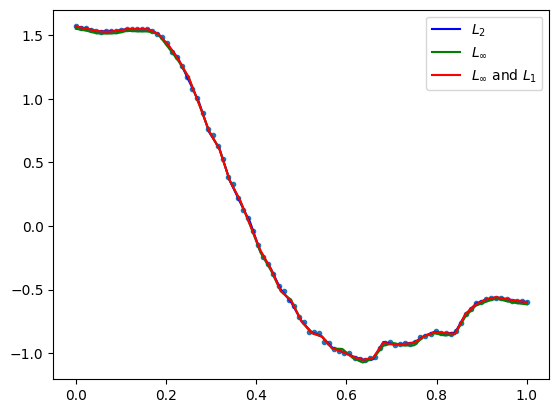

GestureMidAirD3 no. 6 len(ts): 360 ts processed: 2.88 %
[36, 72, 108, 144, 180]
            max_dist       MSE      RMSE       MAE
LSQ         0.083522  0.000525  0.022914  0.017246
Max         0.064037  0.002029  0.045042  0.040201
Max and L1  0.064038  0.000601  0.024512  0.017658 

opt distance 0.06403714678281928
number of data points: 360


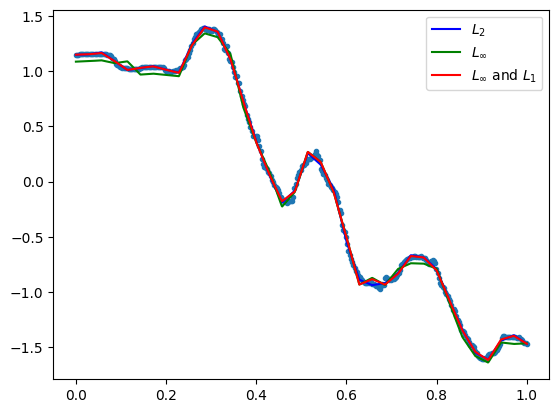

            max_dist       MSE      RMSE       MAE
LSQ         0.045044  0.000135  0.011636  0.007836
Max         0.037490  0.000851  0.029174  0.027093
Max and L1  0.037491  0.000164  0.012818  0.008099 

opt distance 0.0374901582910219
number of data points: 360


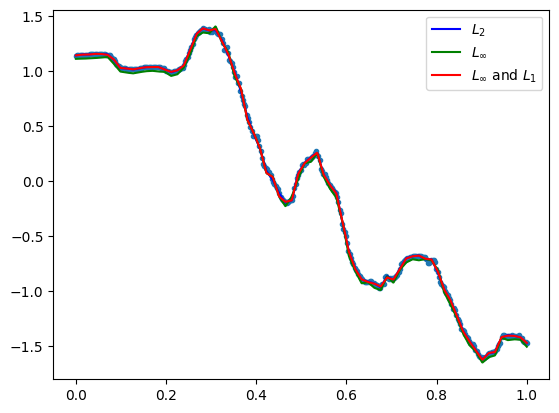

            max_dist       MSE      RMSE       MAE
LSQ         0.037455  0.000069  0.008303  0.005535
Max         0.027902  0.000522  0.022839  0.021382
Max and L1  0.027903  0.000079  0.008890  0.005204 
opt distance 0.02790200867151353
number of data points: 360


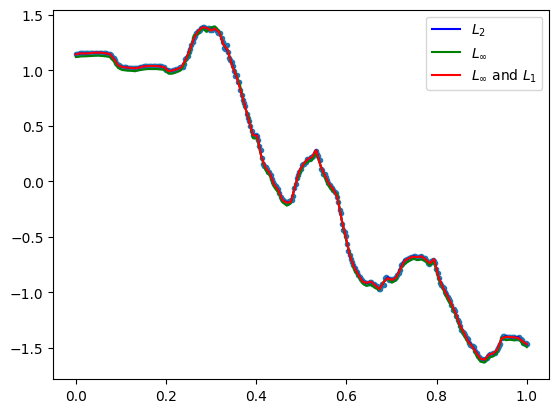

            max_dist       MSE      RMSE       MAE
LSQ         0.026759  0.000046  0.006750  0.004349
Max         0.020625  0.000296  0.017208  0.016067
Max and L1  0.020626  0.000053  0.007300  0.004186 
opt distance 0.020625018903400294
number of data points: 360


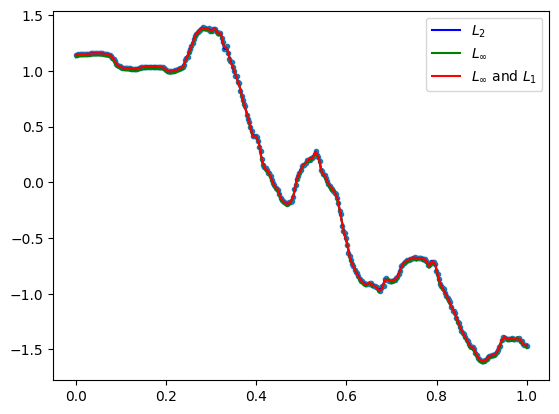

            max_dist       MSE      RMSE       MAE
LSQ         0.020787  0.000026  0.005067  0.003355
Max         0.016889  0.000213  0.014594  0.013857
Max and L1  0.016890  0.000034  0.005871  0.003089 
opt distance 0.016888644131196395
number of data points: 360


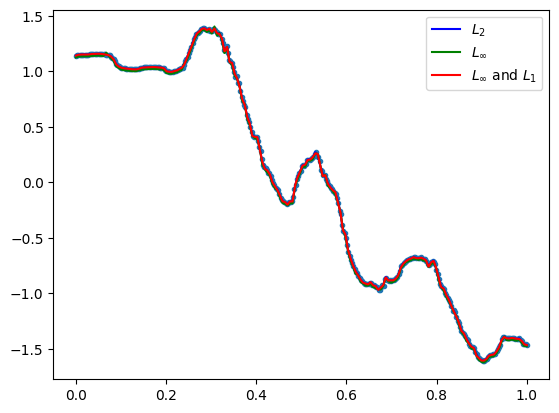

GestureMidAirD3 no. 7 len(ts): 120 ts processed: 3.37 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.084905  0.001070  0.032706  0.023940
Max         0.073252  0.002690  0.051867  0.047193
Max and L1  0.073253  0.001099  0.033152  0.024149 

opt distance 0.07325197430743585
number of data points: 120


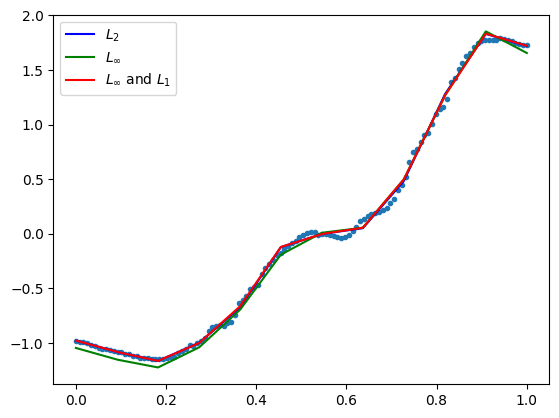

            max_dist       MSE      RMSE       MAE
LSQ         0.053575  0.000248  0.015759  0.011001
Max         0.040971  0.000796  0.028213  0.024795
Max and L1  0.040972  0.000340  0.018431  0.013029 

opt distance 0.040970785336283816
number of data points: 120


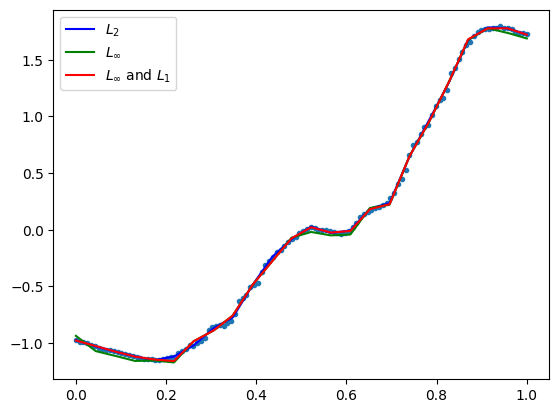

            max_dist       MSE      RMSE       MAE
LSQ         0.043685  0.000137  0.011689  0.007854
Max         0.036144  0.000836  0.028910  0.026971
Max and L1  0.036145  0.000172  0.013104  0.007982 

opt distance 0.03614353840904956
number of data points: 120


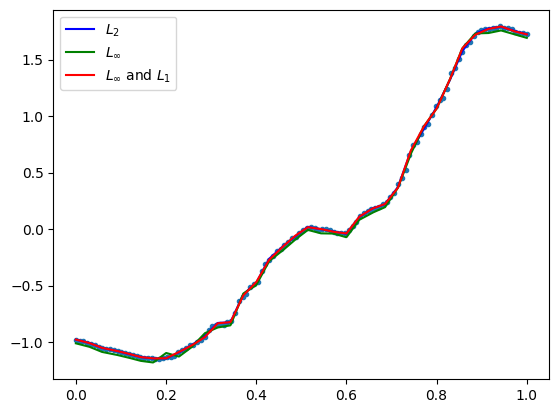

            max_dist       MSE      RMSE       MAE
LSQ         0.039244  0.000092  0.009575  0.006158
Max         0.032784  0.000771  0.027768  0.026255
Max and L1  0.032785  0.000158  0.012564  0.007246 

opt distance 0.03278445207018265
number of data points: 120


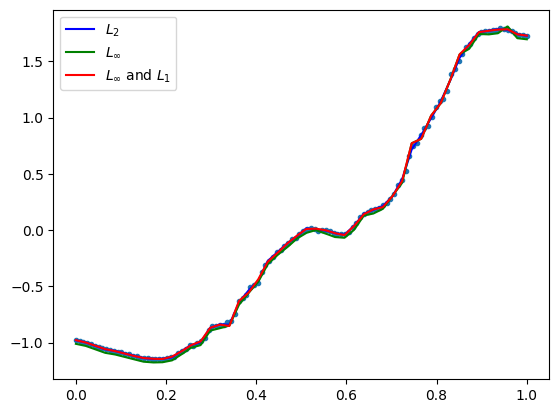

            max_dist       MSE      RMSE       MAE
LSQ         0.031014  0.000069  0.008301  0.005273
Max         0.022717  0.000381  0.019525  0.018371
Max and L1  0.022718  0.000103  0.010140  0.006129 

opt distance 0.02271670825780636
number of data points: 120


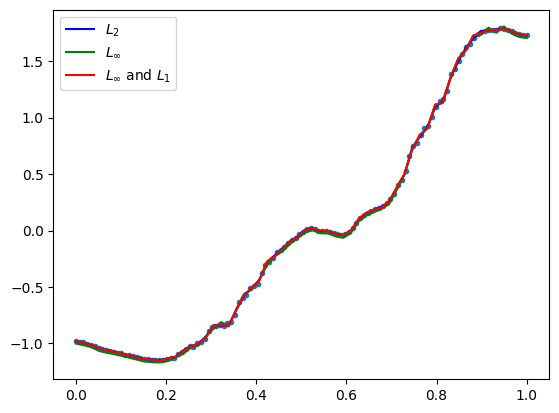

GestureMidAirD3 no. 8 len(ts): 180 ts processed: 3.85 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.047314  0.000138  0.011754  0.008479
Max         0.037238  0.000702  0.026494  0.024097
Max and L1  0.037239  0.000147  0.012129  0.008480 
opt distance 0.037237810497542156
number of data points: 180


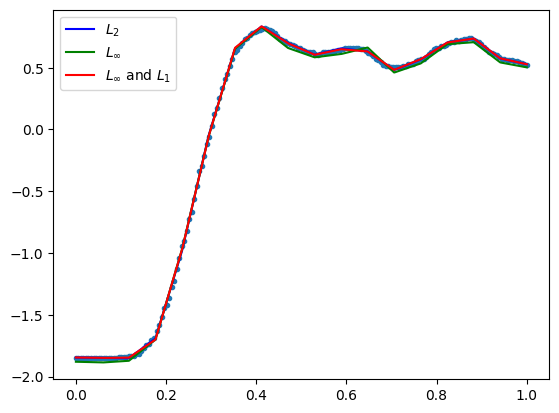

            max_dist       MSE      RMSE       MAE
LSQ         0.041076  0.000054  0.007337  0.004525
Max         0.028280  0.000506  0.022503  0.021133
Max and L1  0.028281  0.000063  0.007922  0.004724 

opt distance 0.028280009580030515
number of data points: 180


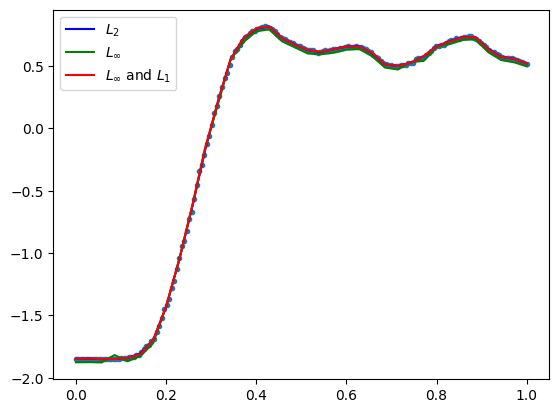

            max_dist       MSE      RMSE       MAE
LSQ         0.036214  0.000043  0.006563  0.004049
Max         0.023385  0.000384  0.019590  0.018664
Max and L1  0.023386  0.000066  0.008118  0.004691 

opt distance 0.023385196079924828
number of data points: 180


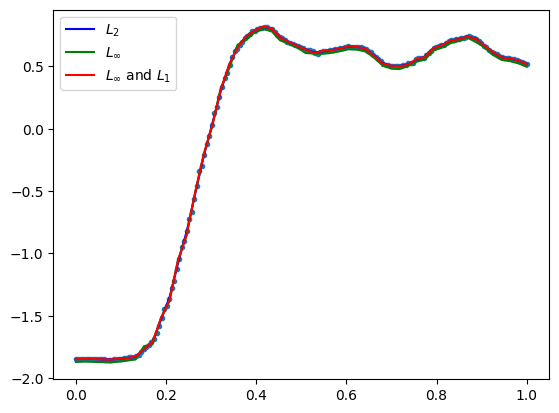

            max_dist       MSE      RMSE       MAE
LSQ         0.028675  0.000030  0.005497  0.003213
Max         0.018810  0.000258  0.016053  0.015316
Max and L1  0.018811  0.000035  0.005900  0.003151 

opt distance 0.01880960371611555
number of data points: 180


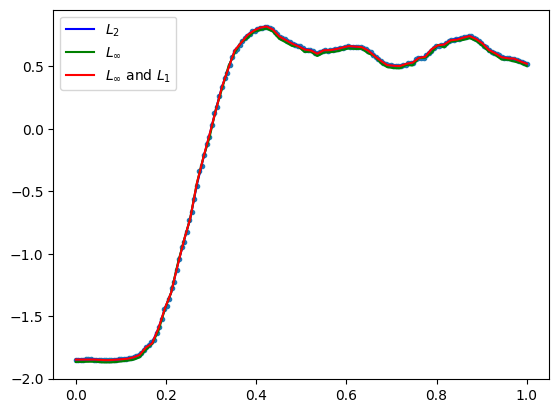

            max_dist       MSE      RMSE       MAE
LSQ         0.020465  0.000023  0.004799  0.002967
Max         0.015492  0.000184  0.013579  0.013034
Max and L1  0.015493  0.000029  0.005431  0.002969 

opt distance 0.015492344175840285
number of data points: 180


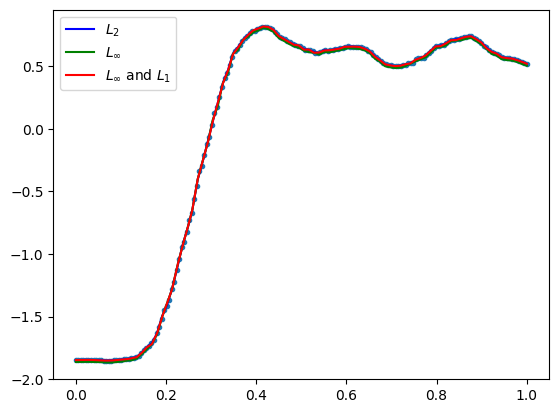

GestureMidAirD3 no. 9 len(ts): 169 ts processed: 4.33 %
[16, 33, 50, 67, 84]
            max_dist       MSE      RMSE       MAE
LSQ         0.046469  0.000081  0.009021  0.006045
Max         0.033808  0.000543  0.023313  0.021036
Max and L1  0.033809  0.000106  0.010316  0.006571 

opt distance 0.03380769777759132
number of data points: 169


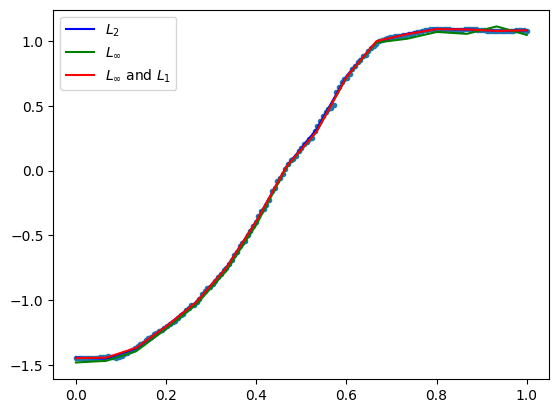

            max_dist       MSE      RMSE       MAE
LSQ         0.042053  0.000051  0.007122  0.004060
Max         0.028430  0.000534  0.023105  0.021453
Max and L1  0.028431  0.000068  0.008241  0.004449 

opt distance 0.02842999393656145
number of data points: 169


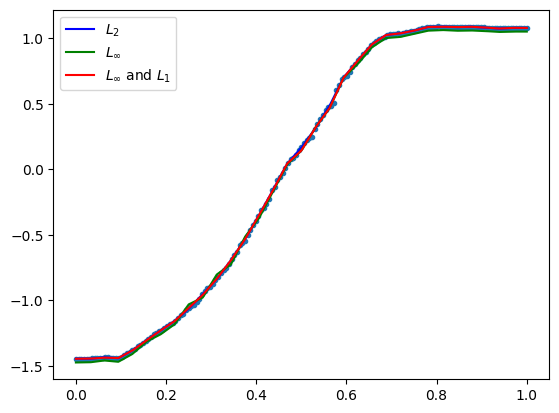

            max_dist       MSE      RMSE       MAE
LSQ         0.029594  0.000033  0.005724  0.003356
Max         0.022032  0.000339  0.018412  0.017402
Max and L1  0.022033  0.000044  0.006668  0.003553 

opt distance 0.02203181019333961
number of data points: 169


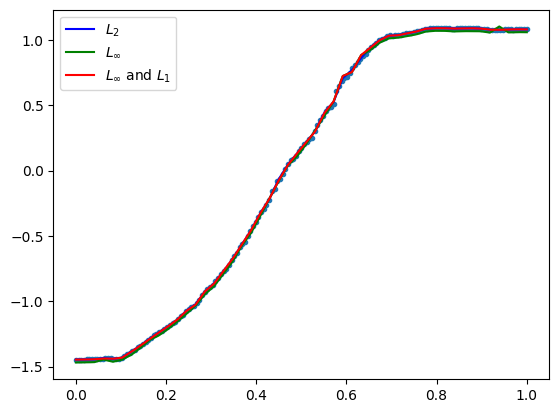

            max_dist       MSE      RMSE       MAE
LSQ         0.033006  0.000028  0.005257  0.002866
Max         0.025708  0.000522  0.022844  0.021968
Max and L1  0.025709  0.000042  0.006474  0.003011 

opt distance 0.025708141070238222
number of data points: 169


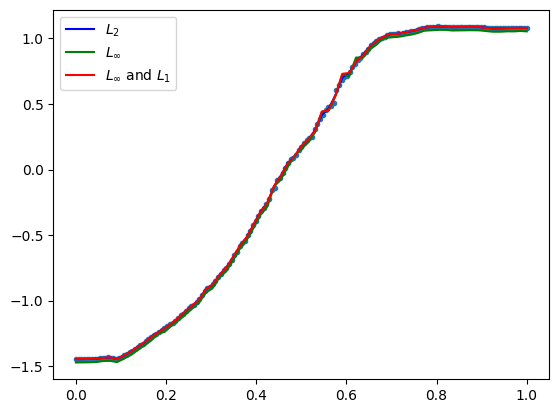

            max_dist       MSE      RMSE       MAE
LSQ         0.026137  0.000016  0.003963  0.002173
Max         0.017923  0.000267  0.016325  0.015796
Max and L1  0.017924  0.000024  0.004877  0.002178 

opt distance 0.017922947015494017
number of data points: 169


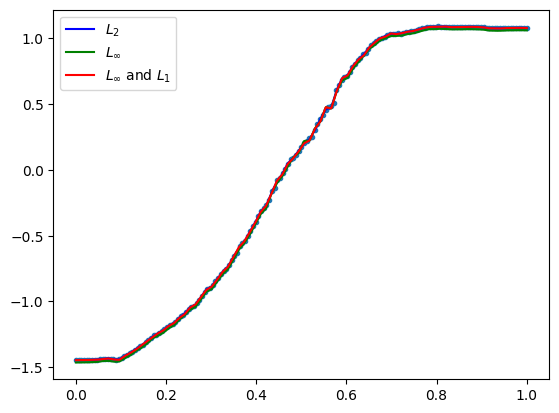

GestureMidAirD3 no. 10 len(ts): 179 ts processed: 4.81 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.060236  0.000254  0.015928  0.011090
Max         0.049589  0.001261  0.035506  0.031612
Max and L1  0.049590  0.000284  0.016843  0.011066 

opt distance 0.049588533790655975
number of data points: 179


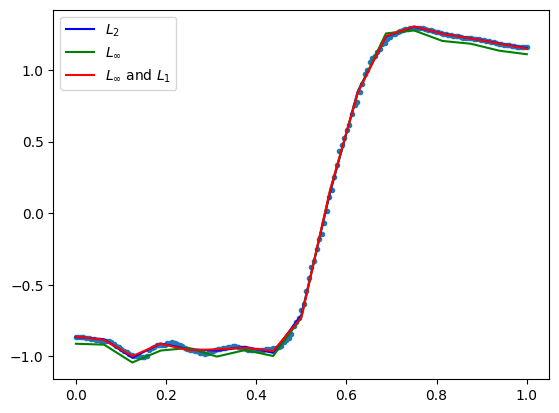

            max_dist       MSE      RMSE       MAE
LSQ         0.023561  0.000043  0.006553  0.004232
Max         0.021709  0.000298  0.017272  0.016113
Max and L1  0.021710  0.000048  0.006916  0.004201 

opt distance 0.02170895629769186
number of data points: 179


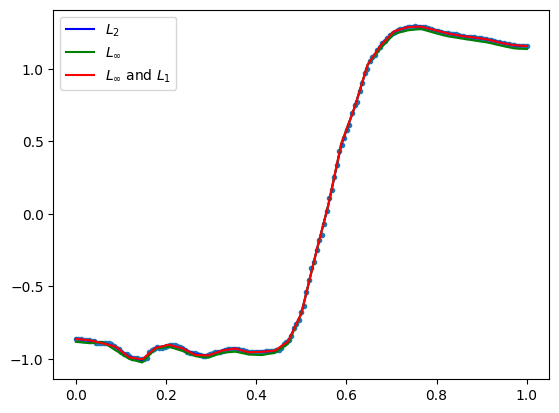

            max_dist       MSE      RMSE       MAE
LSQ         0.029820  0.000036  0.006017  0.003351
Max         0.020336  0.000303  0.017415  0.016772
Max and L1  0.020337  0.000042  0.006517  0.003343 

opt distance 0.020336043323652464
number of data points: 179


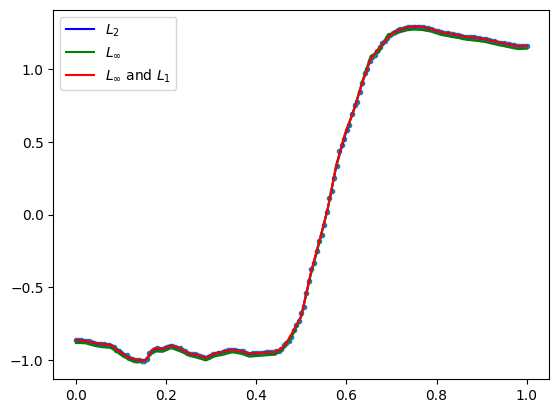

            max_dist       MSE      RMSE       MAE
LSQ         0.020887  0.000025  0.005002  0.002893
Max         0.016590  0.000205  0.014307  0.013664
Max and L1  0.016591  0.000028  0.005275  0.002715 

opt distance 0.016589610674159642
number of data points: 179


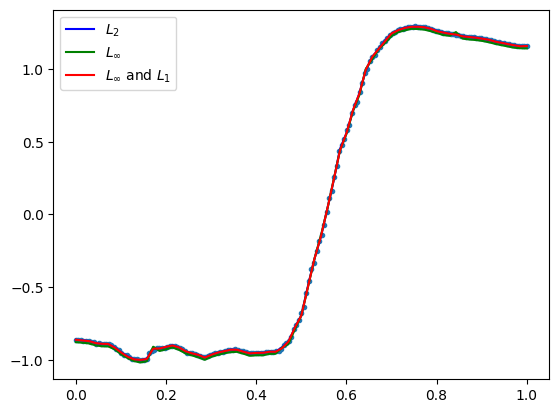

            max_dist       MSE      RMSE       MAE
LSQ         0.019801  0.000022  0.004716  0.002599
Max         0.014348  0.000167  0.012941  0.012605
Max and L1  0.014349  0.000026  0.005078  0.002593 

opt distance 0.014347920165986948
number of data points: 179


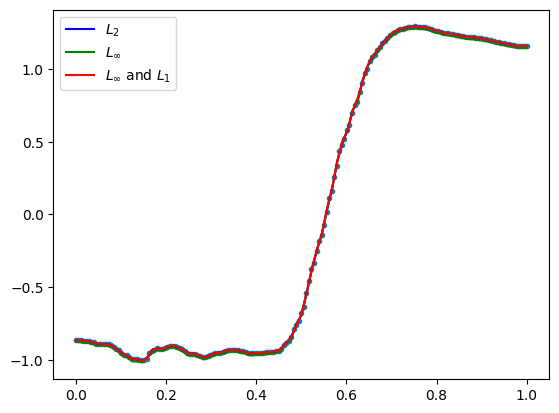

GestureMidAirD3 no. 11 len(ts): 180 ts processed: 5.29 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.081042  0.000411  0.020281  0.014122
Max         0.069559  0.002677  0.051735  0.047698
Max and L1  0.069560  0.000455  0.021322  0.013938 
opt distance 0.0695590602977732
number of data points: 180


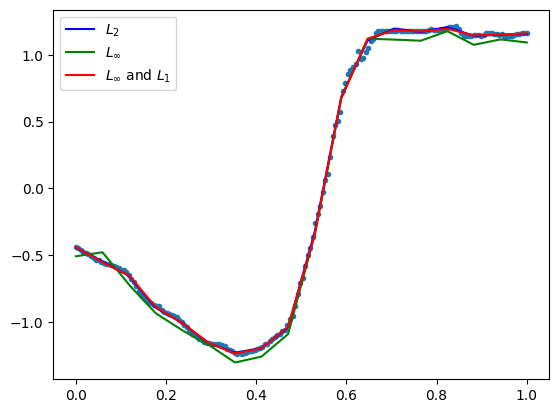

            max_dist       MSE      RMSE       MAE
LSQ         0.067289  0.000154  0.012404  0.007576
Max         0.046453  0.001202  0.034666  0.031674
Max and L1  0.046454  0.000241  0.015521  0.009443 

opt distance 0.04645312093391542
number of data points: 180


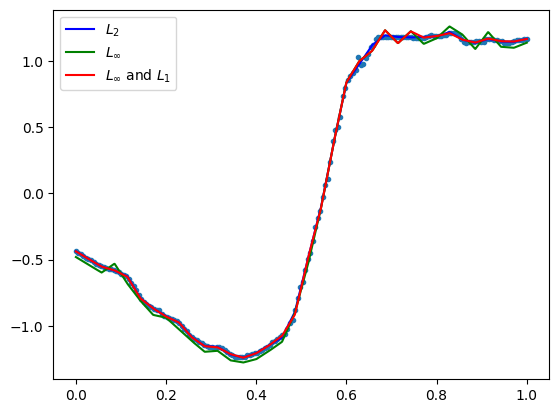

            max_dist       MSE      RMSE       MAE
LSQ         0.052805  0.000112  0.010589  0.005827
Max         0.042075  0.001366  0.036966  0.035608
Max and L1  0.042076  0.000135  0.011628  0.005847 

opt distance 0.04207468300528654
number of data points: 180


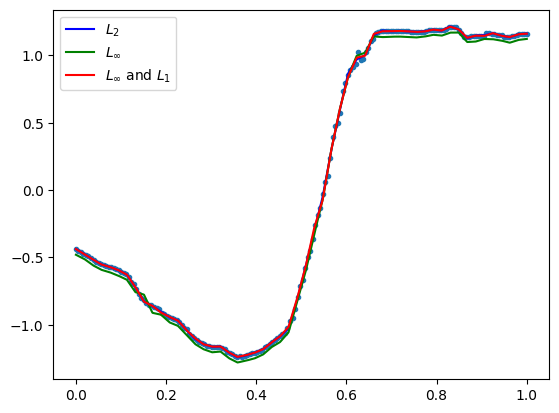

            max_dist       MSE      RMSE       MAE
LSQ         0.061949  0.000097  0.009867  0.004470
Max         0.039052  0.001276  0.035716  0.035004
Max and L1  0.039053  0.000150  0.012263  0.005614 

opt distance 0.039051693451819164
number of data points: 180


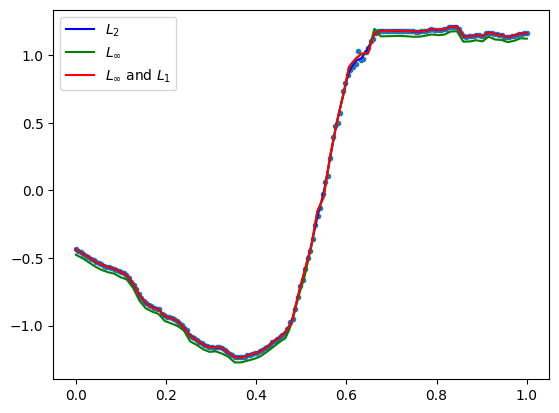

            max_dist       MSE      RMSE       MAE
LSQ         0.047877  0.000043  0.006588  0.003404
Max         0.034148  0.000957  0.030942  0.029988
Max and L1  0.034149  0.000089  0.009434  0.004108 

opt distance 0.03414785085228131
number of data points: 180


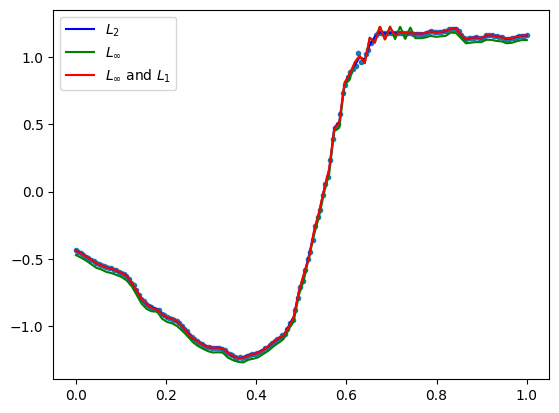

GestureMidAirD3 no. 12 len(ts): 180 ts processed: 5.7700000000000005 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.235117  0.005064  0.071161  0.052552
Max         0.189343  0.015786  0.125642  0.109325
Max and L1  0.189344  0.007227  0.085014  0.062836 

opt distance 0.18934267141966654
number of data points: 180


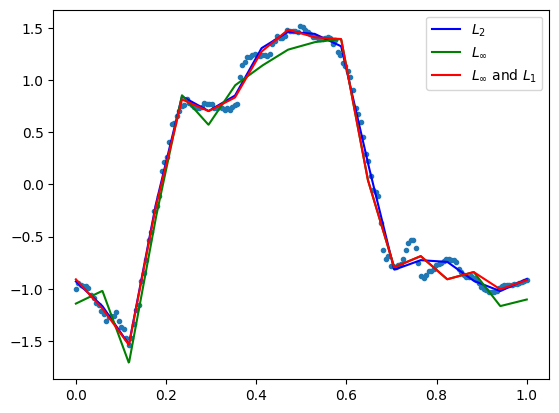

            max_dist       MSE      RMSE       MAE
LSQ         0.164139  0.001107  0.033267  0.023958
Max         0.113639  0.007093  0.084220  0.075762
Max and L1  0.113640  0.001404  0.037466  0.024434 

opt distance 0.11363912245458577
number of data points: 180


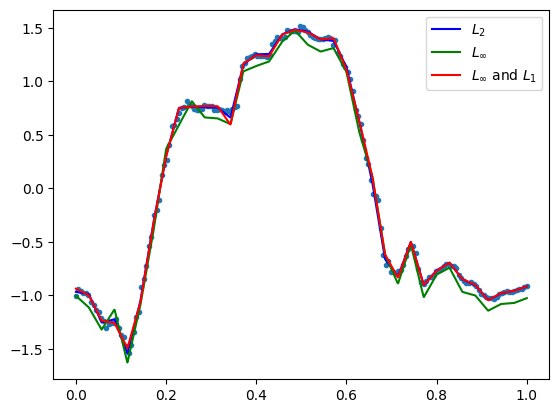

            max_dist       MSE      RMSE       MAE
LSQ         0.150608  0.000927  0.030454  0.020991
Max         0.110281  0.007874  0.088735  0.082388
Max and L1  0.110282  0.001946  0.044118  0.027135 

opt distance 0.11028064159666293
number of data points: 180


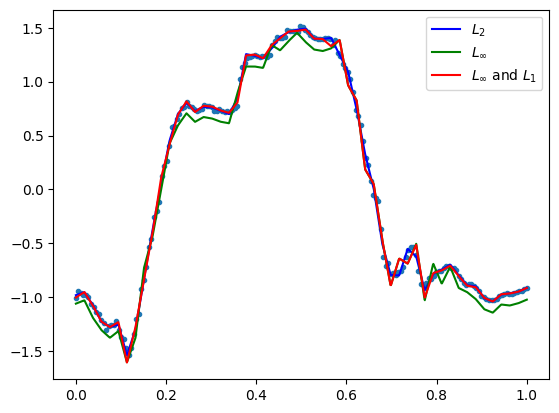

            max_dist       MSE      RMSE       MAE
LSQ         0.118889  0.000617  0.024842  0.016194
Max         0.094811  0.006469  0.080432  0.076154
Max and L1  0.094812  0.000860  0.029322  0.015511 

opt distance 0.09481117460167825
number of data points: 180


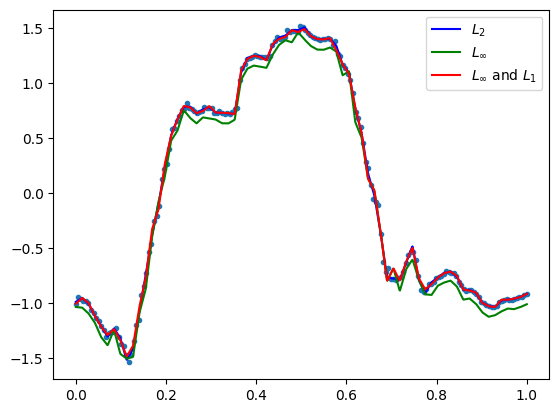

            max_dist       MSE      RMSE       MAE
LSQ         0.074585  0.000351  0.018748  0.012013
Max         0.052252  0.002050  0.045276  0.043131
Max and L1  0.052253  0.000468  0.021630  0.012703 

opt distance 0.05225167752705823
number of data points: 180


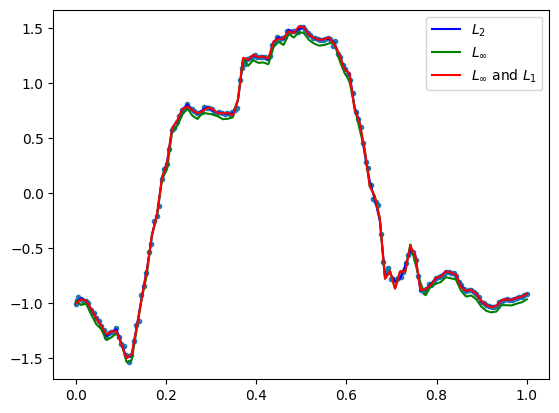

GestureMidAirD3 no. 13 len(ts): 120 ts processed: 6.25 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.103480  0.001361  0.036895  0.027819
Max         0.093925  0.003358  0.057951  0.050679
Max and L1  0.093926  0.001518  0.038958  0.028879 

opt distance 0.09392496142074044
number of data points: 120


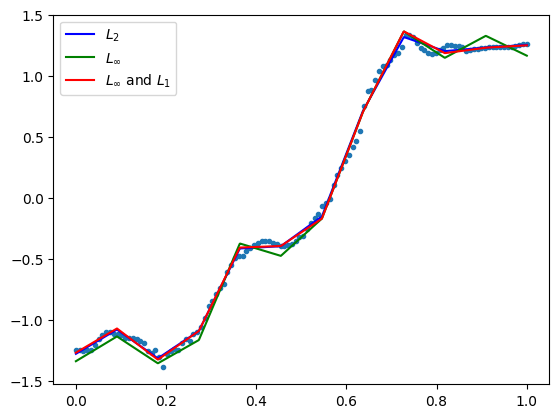

            max_dist       MSE      RMSE       MAE
LSQ         0.107635  0.000472  0.021727  0.015069
Max         0.071561  0.002978  0.054570  0.050237
Max and L1  0.071562  0.000766  0.027682  0.018631 

opt distance 0.07156063432110046
number of data points: 120


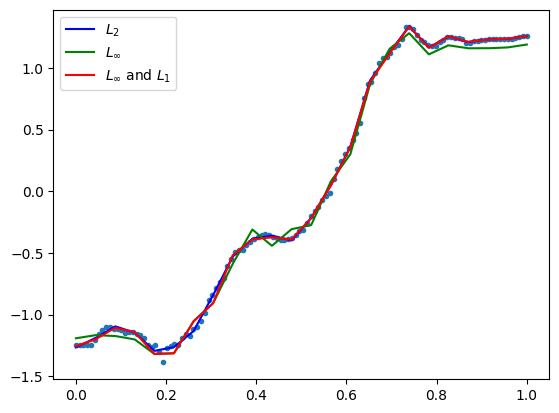

            max_dist       MSE      RMSE       MAE
LSQ         0.077989  0.000309  0.017585  0.011449
Max         0.057382  0.002225  0.047166  0.044320
Max and L1  0.057383  0.000355  0.018838  0.011090 

opt distance 0.0573815563049395
number of data points: 120


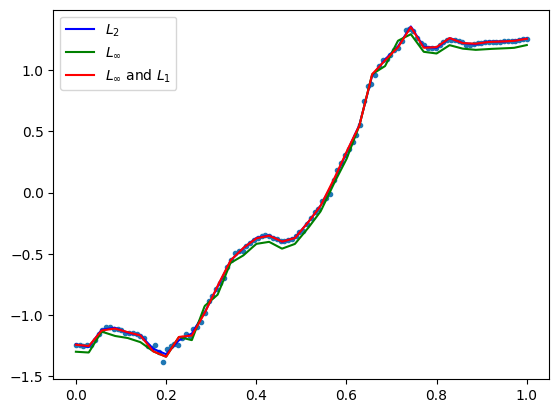

            max_dist       MSE      RMSE       MAE
LSQ         0.059193  0.000195  0.013947  0.008936
Max         0.043935  0.001315  0.036265  0.034158
Max and L1  0.043936  0.000250  0.015820  0.008942 

opt distance 0.043934927631208875
number of data points: 120


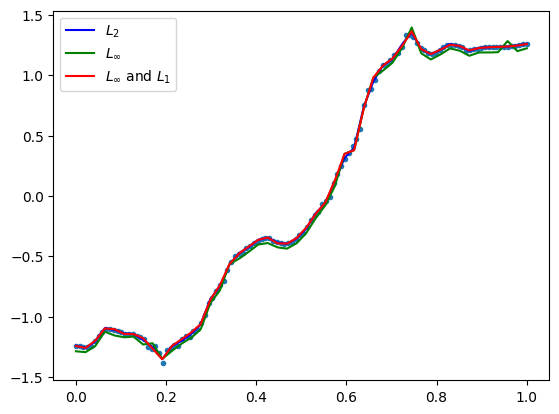

            max_dist       MSE      RMSE       MAE
LSQ         0.071571  0.000130  0.011399  0.006779
Max         0.046378  0.001684  0.041032  0.039087
Max and L1  0.046379  0.000201  0.014165  0.006821 

opt distance 0.04637760720702777
number of data points: 120


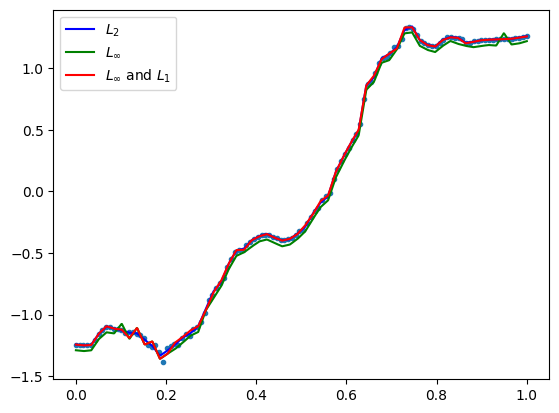

GestureMidAirD3 no. 14 len(ts): 300 ts processed: 6.7299999999999995 %
[30, 60, 90, 120, 150]
            max_dist       MSE      RMSE       MAE
LSQ         0.312665  0.007478  0.086475  0.060404
Max         0.270670  0.039605  0.199009  0.180141
Max and L1  0.270671  0.009379  0.096844  0.064989 
opt distance 0.2706698678375005
number of data points: 300


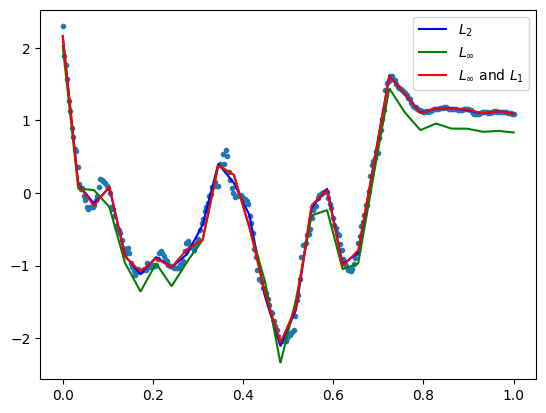

            max_dist       MSE      RMSE       MAE
LSQ         0.175207  0.002093  0.045749  0.031123
Max         0.129365  0.010343  0.101700  0.095358
Max and L1  0.129366  0.002502  0.050017  0.032290 

opt distance 0.1293652416597998
number of data points: 300


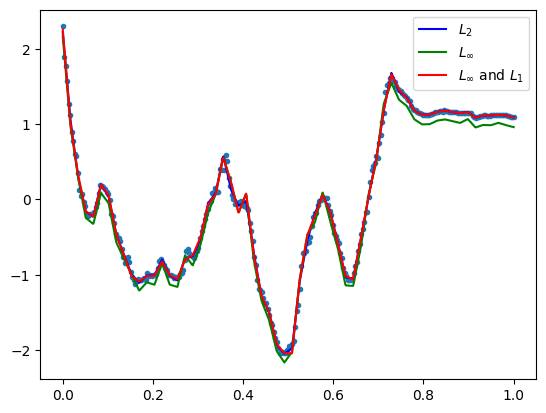

            max_dist       MSE      RMSE       MAE
LSQ         0.156572  0.001050  0.032409  0.020854
Max         0.108504  0.007891  0.088834  0.083459
Max and L1  0.108505  0.001227  0.035035  0.020302 

opt distance 0.10850365146644565
number of data points: 300


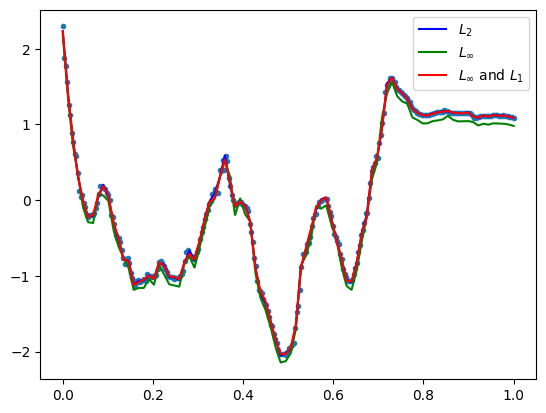

            max_dist       MSE      RMSE       MAE
LSQ         0.134356  0.000684  0.026153  0.016759
Max         0.093407  0.006509  0.080680  0.076837
Max and L1  0.093408  0.000891  0.029843  0.016483 
opt distance 0.09340709755091134
number of data points: 300


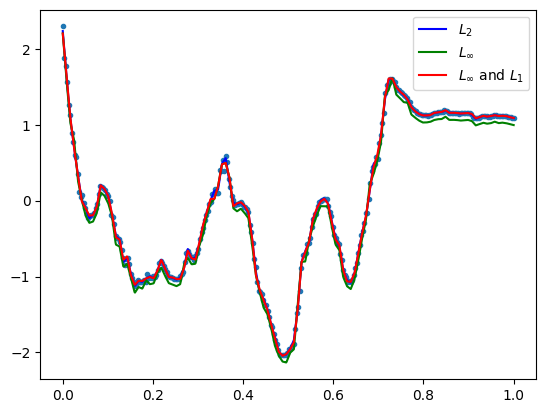

            max_dist       MSE      RMSE       MAE
LSQ         0.107051  0.000441  0.021011  0.013578
Max         0.077889  0.004697  0.068536  0.065366
Max and L1  0.077890  0.000591  0.024312  0.012461 
opt distance 0.07788850167828942
number of data points: 300


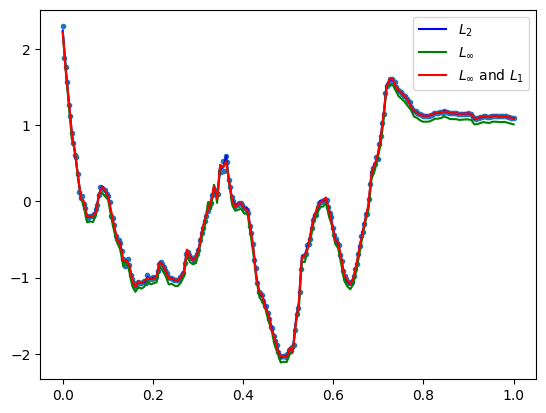

GestureMidAirD3 no. 15 len(ts): 316 ts processed: 7.21 %
[31, 63, 94, 126, 158]
            max_dist       MSE      RMSE       MAE
LSQ         0.345918  0.002674  0.051714  0.025231
Max         0.280394  0.056979  0.238703  0.230293
Max and L1  0.280395  0.004134  0.064300  0.030174 
opt distance 0.28039369243944173
number of data points: 316


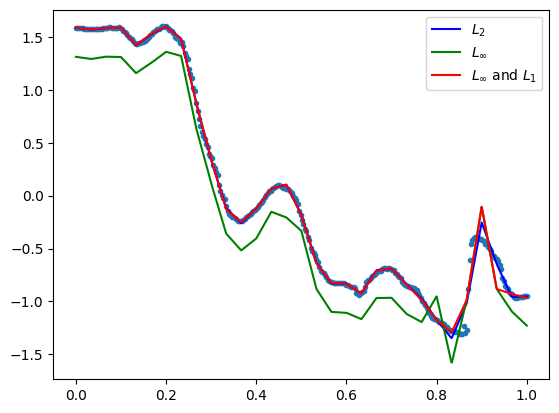

            max_dist       MSE      RMSE       MAE
LSQ         0.284505  0.000811  0.028471  0.010796
Max         0.198674  0.031890  0.178577  0.173855
Max and L1  0.198675  0.002718  0.052133  0.022899 

opt distance 0.19867360115833546
number of data points: 316


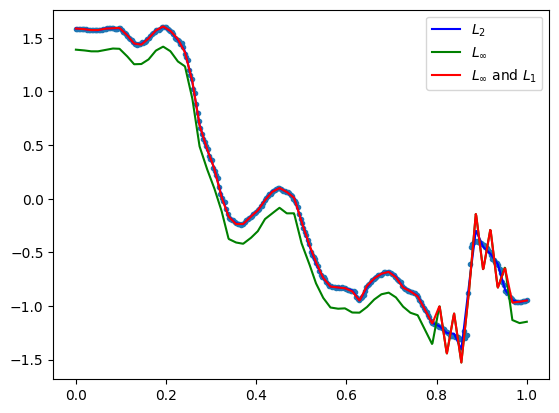

            max_dist       MSE      RMSE       MAE
LSQ         0.224975  0.000409  0.020213  0.007411
Max         0.162016  0.023300  0.152644  0.151446
Max and L1  0.162017  0.000649  0.025470  0.008861 

opt distance 0.16201645073743756
number of data points: 316


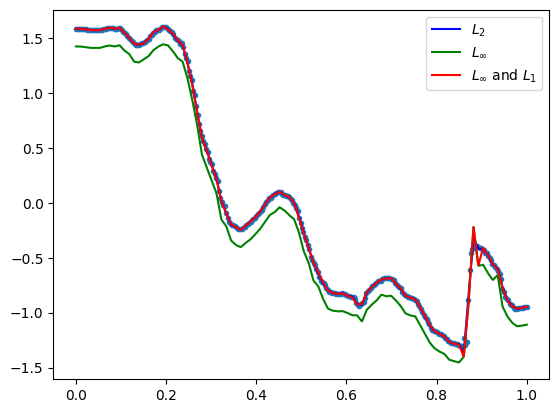

            max_dist       MSE      RMSE       MAE
LSQ         0.134106  0.000143  0.011976  0.004866
Max         0.085352  0.006345  0.079656  0.078523
Max and L1  0.085353  0.000234  0.015292  0.005469 
opt distance 0.08535185362393816
number of data points: 316


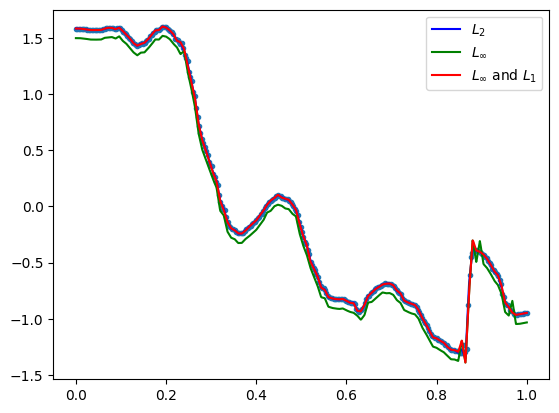

            max_dist       MSE      RMSE       MAE
LSQ         0.033881  0.000034  0.005872  0.003281
Max         0.027319  0.000620  0.024906  0.024288
Max and L1  0.027320  0.000048  0.006904  0.003136 
opt distance 0.027318581619911964
number of data points: 316


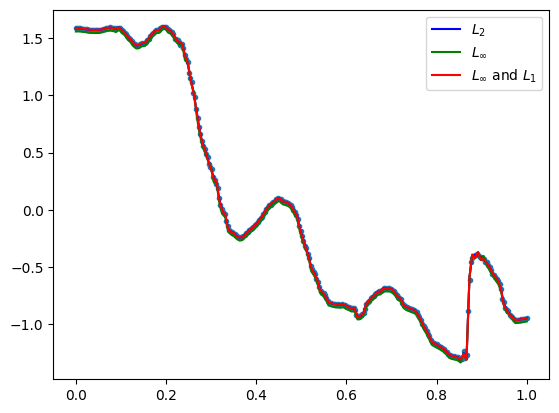

GestureMidAirD3 no. 16 len(ts): 180 ts processed: 7.6899999999999995 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.351976  0.009683  0.098401  0.072200
Max         0.271784  0.036058  0.189888  0.168259
Max and L1  0.271785  0.011793  0.108594  0.078153 
opt distance 0.2717838820504997
number of data points: 180


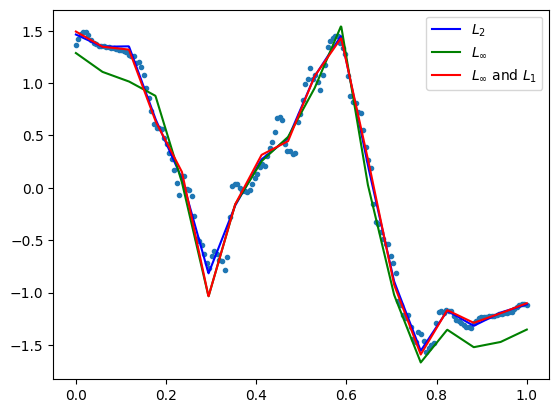

            max_dist       MSE      RMSE       MAE
LSQ         0.292765  0.004766  0.069039  0.048010
Max         0.225786  0.029862  0.172808  0.157749
Max and L1  0.225787  0.008514  0.092269  0.059896 

opt distance 0.22578601462852435
number of data points: 180


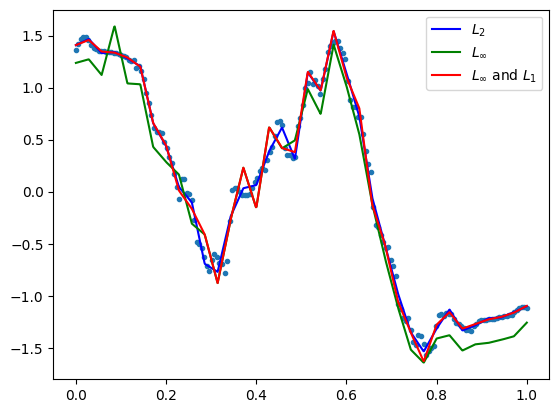

            max_dist       MSE      RMSE       MAE
LSQ         0.214154  0.002297  0.047923  0.030874
Max         0.167253  0.018525  0.136108  0.126146
Max and L1  0.167254  0.003148  0.056107  0.032565 

opt distance 0.1672526257560136
number of data points: 180


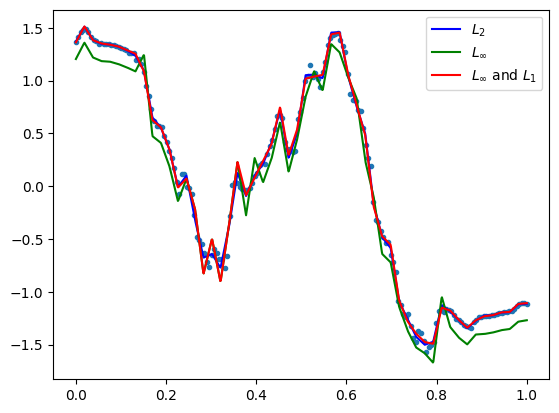

            max_dist       MSE      RMSE       MAE
LSQ         0.140625  0.001133  0.033661  0.022033
Max         0.115694  0.009611  0.098035  0.093018
Max and L1  0.115695  0.001347  0.036697  0.019829 

opt distance 0.11569448035893365
number of data points: 180


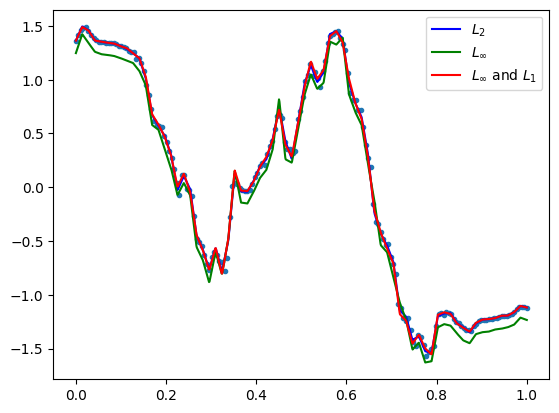

            max_dist       MSE      RMSE       MAE
LSQ         0.089659  0.000565  0.023767  0.016484
Max         0.059920  0.002565  0.050646  0.047038
Max and L1  0.059921  0.000769  0.027730  0.016453 

opt distance 0.05992028208897936
number of data points: 180


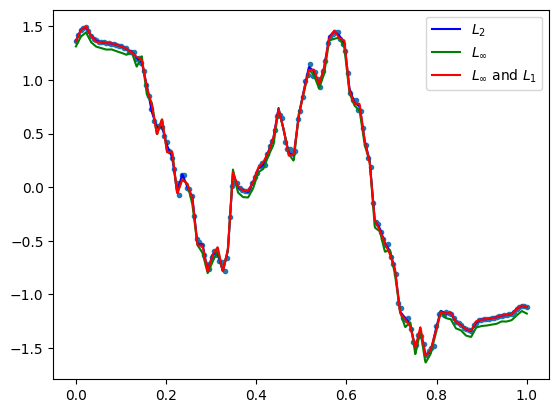

GestureMidAirD3 no. 17 len(ts): 180 ts processed: 8.17 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.157497  0.003022  0.054971  0.040694
Max         0.137297  0.009008  0.094908  0.084178
Max and L1  0.137298  0.003369  0.058043  0.041677 

opt distance 0.13729727891259688
number of data points: 180


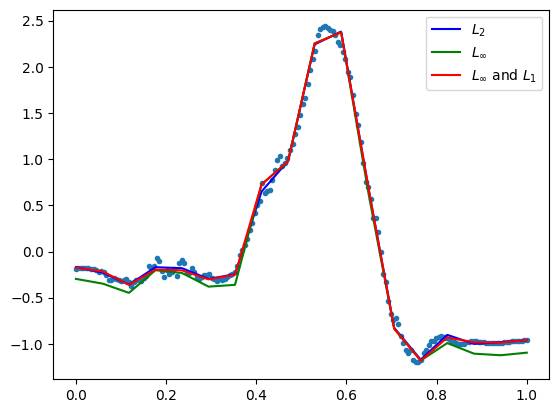

            max_dist       MSE      RMSE       MAE
LSQ         0.136739  0.001356  0.036819  0.024607
Max         0.097540  0.005704  0.075523  0.069249
Max and L1  0.097541  0.001852  0.043032  0.028843 

opt distance 0.09754006194603076
number of data points: 180


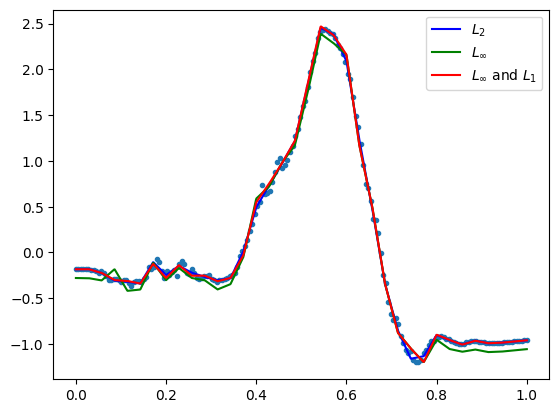

            max_dist       MSE      RMSE       MAE
LSQ         0.092890  0.000773  0.027801  0.018896
Max         0.066839  0.002983  0.054614  0.051288
Max and L1  0.066840  0.001010  0.031787  0.021630 

opt distance 0.06683850566819625
number of data points: 180


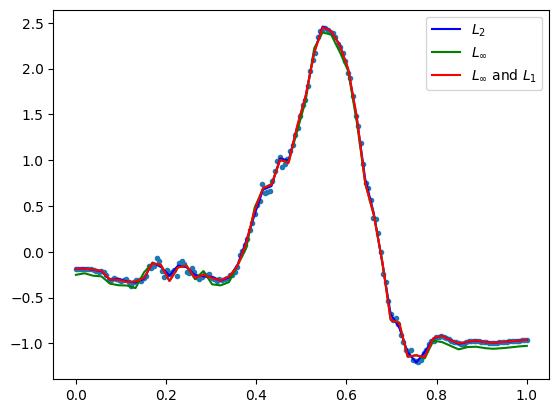

            max_dist       MSE      RMSE       MAE
LSQ         0.105418  0.000567  0.023818  0.015293
Max         0.072077  0.003773  0.061426  0.058347
Max and L1  0.072078  0.000787  0.028056  0.015898 

opt distance 0.0720769014731188
number of data points: 180


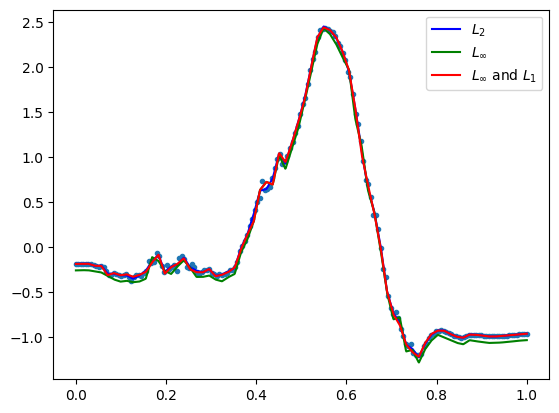

            max_dist       MSE      RMSE       MAE
LSQ         0.075788  0.000298  0.017272  0.010923
Max         0.050831  0.002015  0.044893  0.043139
Max and L1  0.050832  0.000423  0.020577  0.011628 

opt distance 0.05083147602011292
number of data points: 180


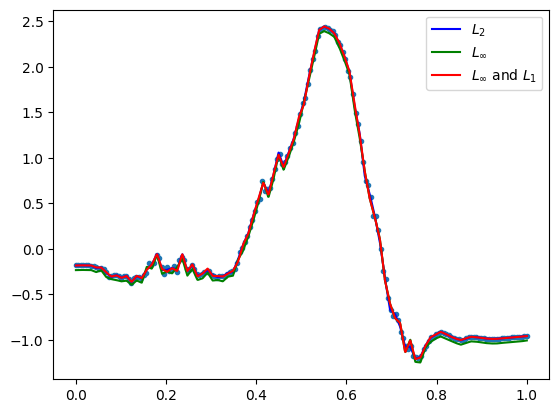

GestureMidAirD3 no. 18 len(ts): 120 ts processed: 8.649999999999999 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.113505  0.001657  0.040706  0.028600
Max         0.094742  0.004379  0.066175  0.060979
Max and L1  0.094743  0.002019  0.044933  0.033945 

opt distance 0.09474151917667359
number of data points: 120


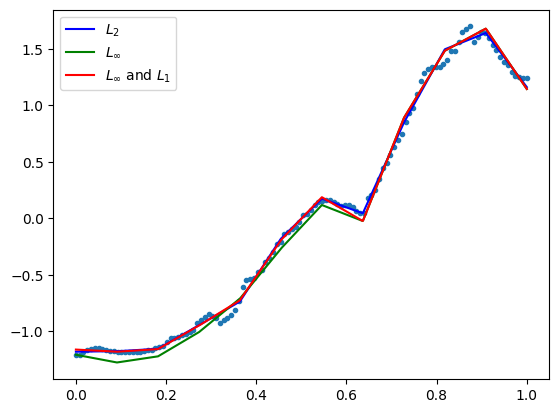

            max_dist       MSE      RMSE       MAE
LSQ         0.099911  0.000641  0.025327  0.018048
Max         0.062399  0.002072  0.045519  0.041073
Max and L1  0.062400  0.000818  0.028607  0.019937 

opt distance 0.062398659728998274
number of data points: 120


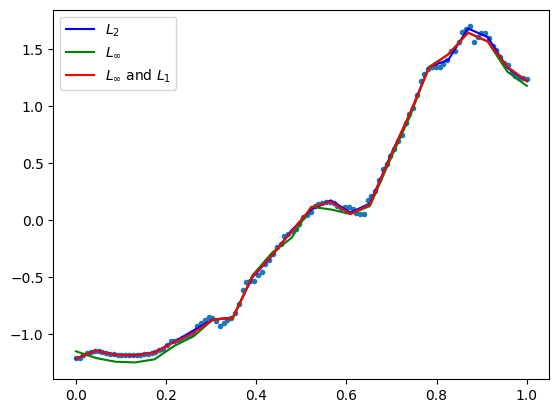

            max_dist       MSE      RMSE       MAE
LSQ         0.064183  0.000257  0.016020  0.011125
Max         0.054266  0.001824  0.042713  0.039197
Max and L1  0.054267  0.000322  0.017944  0.010848 
opt distance 0.05426560039934439
number of data points: 120


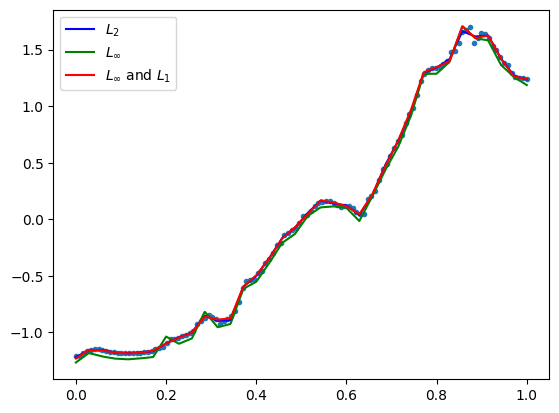

            max_dist       MSE      RMSE       MAE
LSQ         0.082459  0.000217  0.014736  0.009599
Max         0.052873  0.001931  0.043939  0.041588
Max and L1  0.052874  0.000331  0.018204  0.010179 

opt distance 0.05287327299416107
number of data points: 120


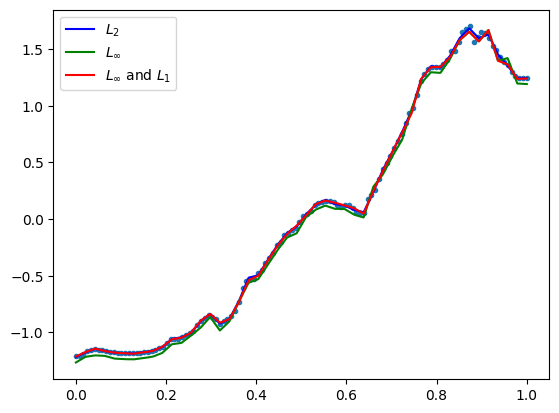

            max_dist       MSE      RMSE       MAE
LSQ         0.057403  0.000127  0.011254  0.007562
Max         0.042571  0.001379  0.037132  0.035677
Max and L1  0.042572  0.000187  0.013684  0.007537 

opt distance 0.04257062681682411
number of data points: 120


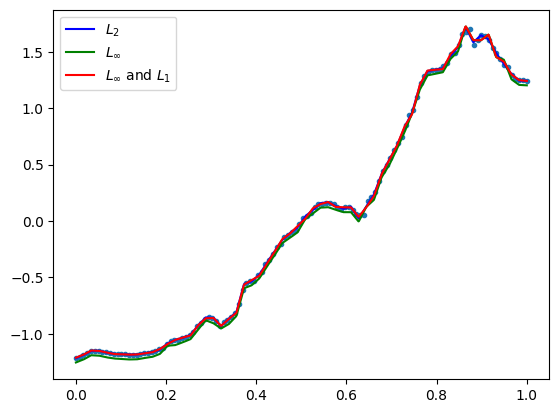

GestureMidAirD3 no. 19 len(ts): 171 ts processed: 9.13 %
[17, 34, 51, 68, 85]
            max_dist       MSE      RMSE       MAE
LSQ         0.179148  0.002705  0.052010  0.030842
Max         0.153347  0.015094  0.122858  0.112279
Max and L1  0.153348  0.004687  0.068464  0.044294 

opt distance 0.1533465183401076
number of data points: 171


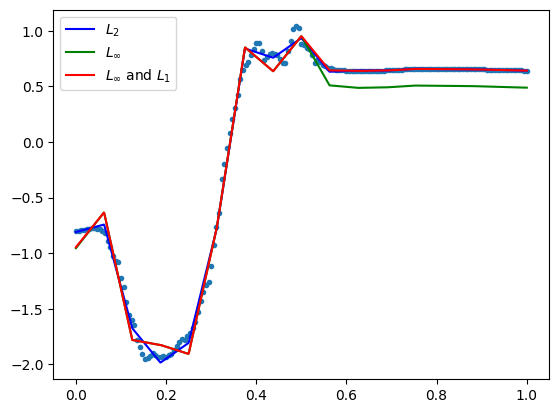

            max_dist       MSE      RMSE       MAE
LSQ         0.100813  0.000485  0.022031  0.012801
Max         0.073195  0.003807  0.061698  0.057346
Max and L1  0.073196  0.000703  0.026516  0.014797 

opt distance 0.07319541695588344
number of data points: 171


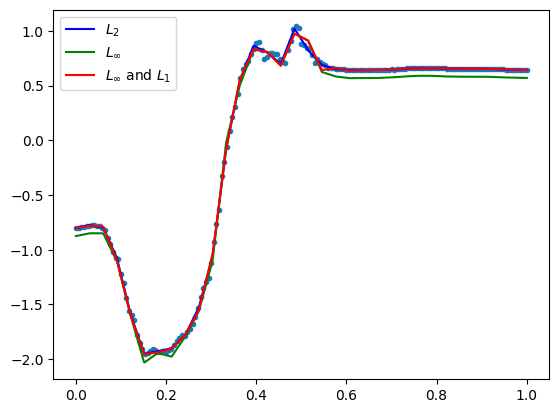

            max_dist       MSE      RMSE       MAE
LSQ         0.075472  0.000341  0.018469  0.010089
Max         0.060249  0.002586  0.050854  0.047415
Max and L1  0.060250  0.000454  0.021296  0.011086 

opt distance 0.06024889384228622
number of data points: 171


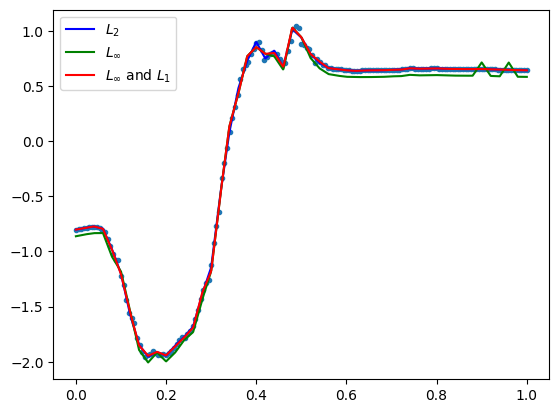

            max_dist       MSE      RMSE       MAE
LSQ         0.061751  0.000173  0.013159  0.006827
Max         0.041090  0.001352  0.036774  0.035115
Max and L1  0.041091  0.000242  0.015553  0.008027 

opt distance 0.04109007553649
number of data points: 171


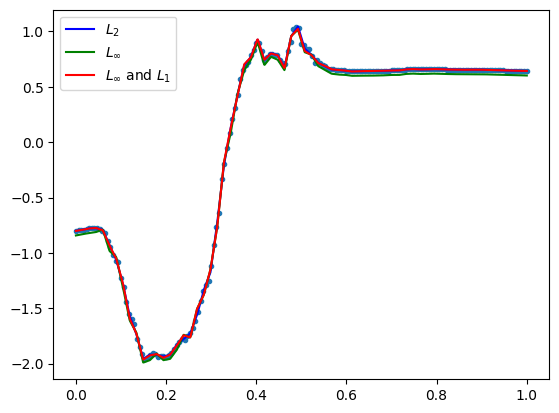

            max_dist       MSE      RMSE       MAE
LSQ         0.067988  0.000117  0.010825  0.005245
Max         0.047803  0.001916  0.043775  0.042255
Max and L1  0.047804  0.000248  0.015762  0.007253 

opt distance 0.04780328388555897
number of data points: 171


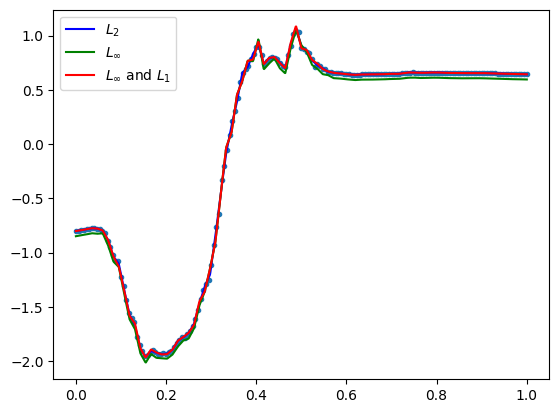

GestureMidAirD3 no. 20 len(ts): 109 ts processed: 9.62 %
[10, 21, 32, 43, 54]
            max_dist       MSE      RMSE       MAE
LSQ         0.181749  0.002737  0.052316  0.038424
Max         0.129197  0.006565  0.081026  0.071680
Max and L1  0.129198  0.004328  0.065789  0.053377 

opt distance 0.12919686694295263
number of data points: 109


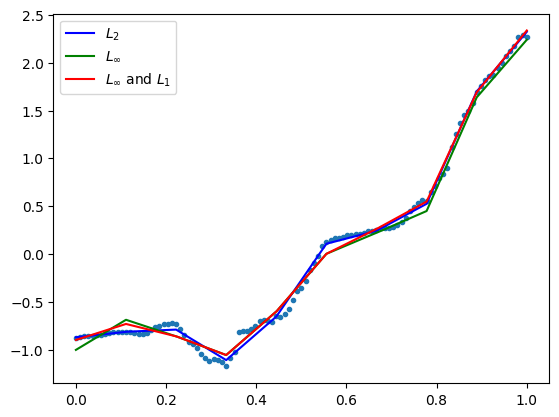

            max_dist       MSE      RMSE       MAE
LSQ         0.129933  0.000792  0.028150  0.017789
Max         0.103916  0.006625  0.081396  0.075335
Max and L1  0.103917  0.001083  0.032911  0.020004 

opt distance 0.10391640156932745
number of data points: 109


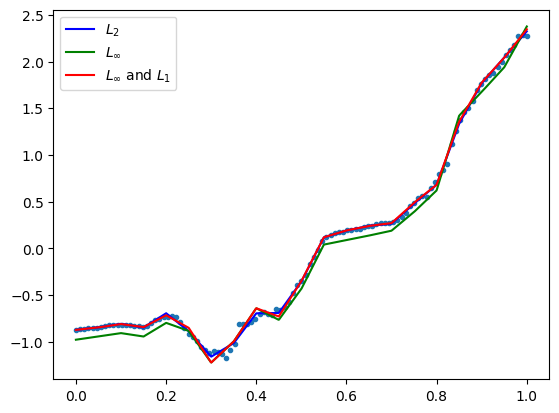

            max_dist       MSE      RMSE       MAE
LSQ         0.100242  0.000558  0.023612  0.015565
Max         0.070649  0.003145  0.056082  0.052449
Max and L1  0.070650  0.000745  0.027300  0.017311 

opt distance 0.07064884904754404
number of data points: 109


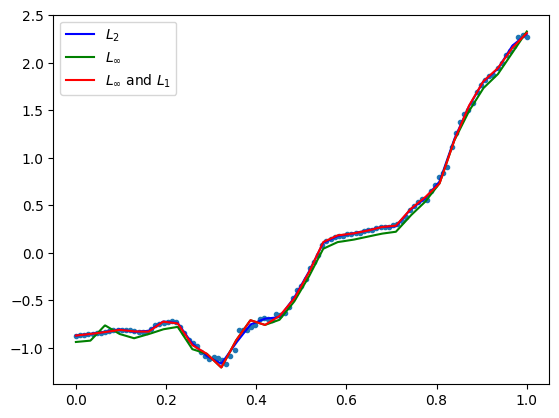

            max_dist       MSE      RMSE       MAE
LSQ         0.069158  0.000296  0.017199  0.011294
Max         0.054958  0.002117  0.046011  0.043000
Max and L1  0.054959  0.000426  0.020642  0.012049 

opt distance 0.0549582073988161
number of data points: 109


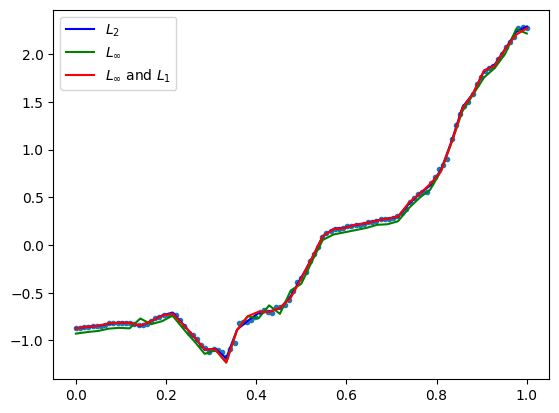

            max_dist       MSE      RMSE       MAE
LSQ         0.056993  0.000161  0.012698  0.007953
Max         0.043037  0.001351  0.036761  0.034397
Max and L1  0.043038  0.000242  0.015553  0.008644 

opt distance 0.043037298450501416
number of data points: 109


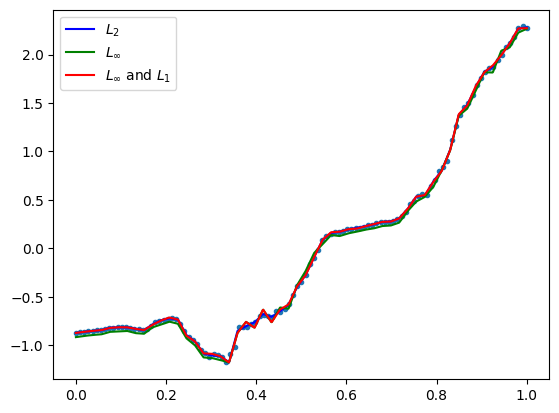

GestureMidAirD3 no. 21 len(ts): 120 ts processed: 10.100000000000001 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.155975  0.001622  0.040269  0.028618
Max         0.119825  0.006345  0.079654  0.068381
Max and L1  0.119826  0.003069  0.055394  0.040292 

opt distance 0.11982506983779176
number of data points: 120


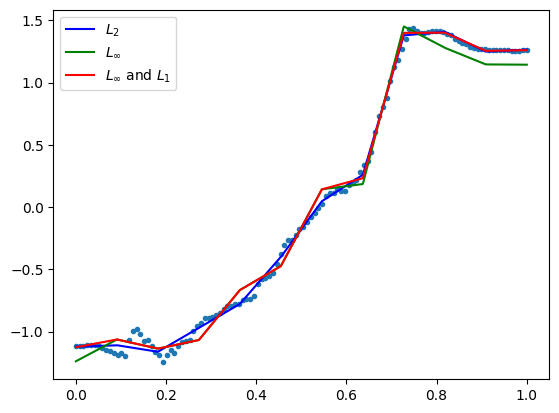

            max_dist       MSE      RMSE       MAE
LSQ         0.098269  0.000387  0.019683  0.013193
Max         0.061840  0.002124  0.046091  0.042161
Max and L1  0.061841  0.000622  0.024939  0.016539 

opt distance 0.061840328649728826
number of data points: 120


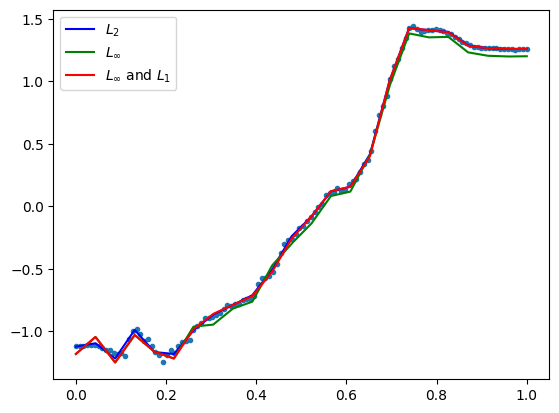

            max_dist       MSE      RMSE       MAE
LSQ         0.073567  0.000334  0.018277  0.011917
Max         0.059308  0.002297  0.047923  0.044859
Max and L1  0.059309  0.000460  0.021456  0.012866 
opt distance 0.05930817637023765
number of data points: 120


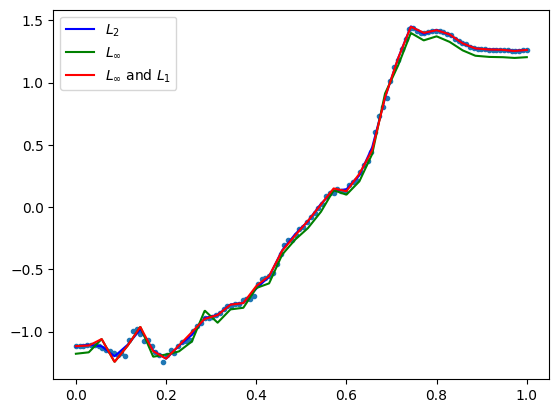

            max_dist       MSE      RMSE       MAE
LSQ         0.038249  0.000148  0.012158  0.008492
Max         0.030293  0.000620  0.024898  0.023257
Max and L1  0.030294  0.000182  0.013487  0.008437 

opt distance 0.030292943837252118
number of data points: 120


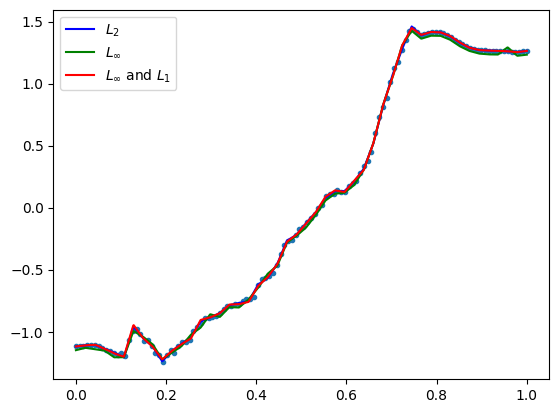

            max_dist       MSE      RMSE       MAE
LSQ         0.053820  0.000141  0.011858  0.007355
Max         0.036310  0.000973  0.031191  0.029119
Max and L1  0.036311  0.000199  0.014113  0.007768 

opt distance 0.03630977254235834
number of data points: 120


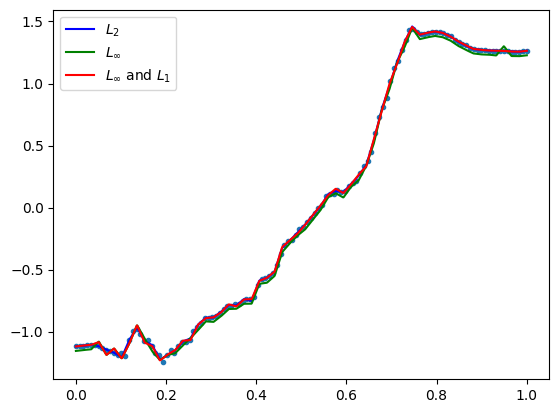

GestureMidAirD3 no. 22 len(ts): 173 ts processed: 10.58 %
[17, 34, 51, 69, 86]
            max_dist       MSE      RMSE       MAE
LSQ         0.036455  0.000064  0.007989  0.004970
Max         0.029240  0.000438  0.020917  0.018365
Max and L1  0.029241  0.000129  0.011347  0.007241 
opt distance 0.029239662754054978
number of data points: 173


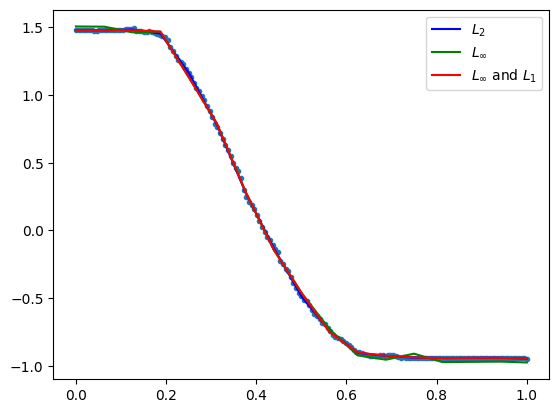

            max_dist       MSE      RMSE       MAE
LSQ         0.030166  0.000053  0.007297  0.004412
Max         0.025290  0.000427  0.020668  0.019229
Max and L1  0.025291  0.000080  0.008936  0.005357 

opt distance 0.025289783331451758
number of data points: 173


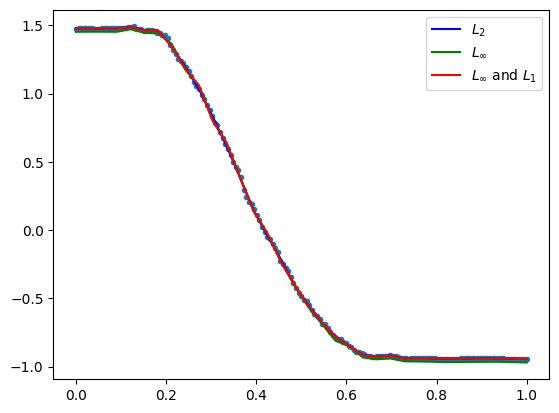

            max_dist       MSE      RMSE       MAE
LSQ         0.018644  0.000019  0.004388  0.002767
Max         0.014640  0.000139  0.011804  0.010841
Max and L1  0.014641  0.000026  0.005109  0.002875 

opt distance 0.014639839443404856
number of data points: 173


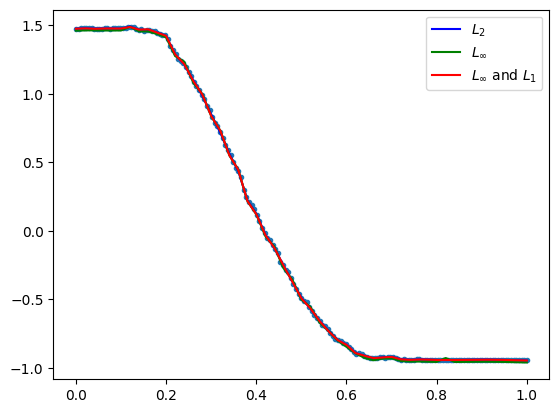

            max_dist       MSE      RMSE       MAE
LSQ         0.023159  0.000018  0.004203  0.002455
Max         0.016075  0.000198  0.014062  0.013331
Max and L1  0.016076  0.000025  0.004964  0.002463 

opt distance 0.016075477691697575
number of data points: 173


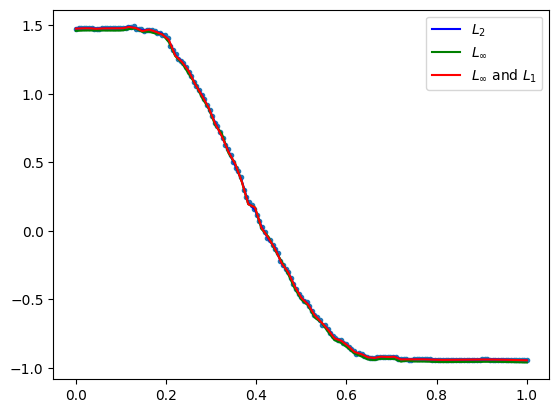

            max_dist       MSE      RMSE       MAE
LSQ         0.011037  0.000008  0.002799  0.001663
Max         0.008752  0.000060  0.007748  0.007325
Max and L1  0.008753  0.000011  0.003246  0.001703 

opt distance 0.008752274976532805
number of data points: 173


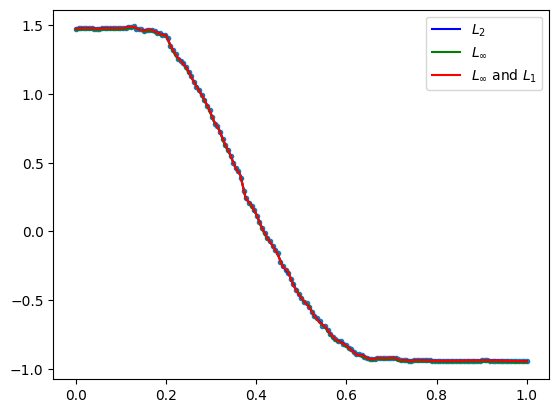

GestureMidAirD3 no. 23 len(ts): 120 ts processed: 11.06 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.289535  0.008892  0.094300  0.070931
Max         0.249850  0.029429  0.171548  0.148058
Max and L1  0.249851  0.011809  0.108668  0.077005 

opt distance 0.24984959639248855
number of data points: 120


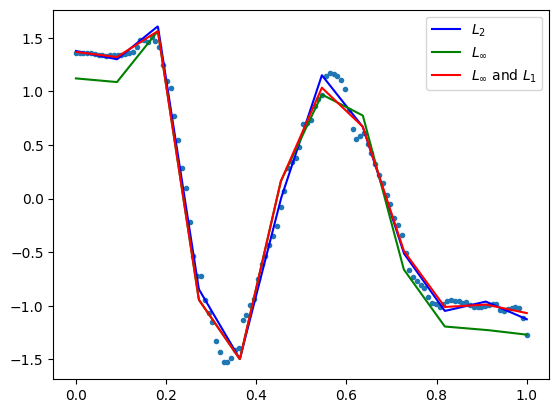

            max_dist       MSE      RMSE       MAE
LSQ         0.120157  0.001807  0.042515  0.031587
Max         0.101631  0.005068  0.071192  0.063053
Max and L1  0.101632  0.002166  0.046541  0.033982 

opt distance 0.10163078579972708
number of data points: 120


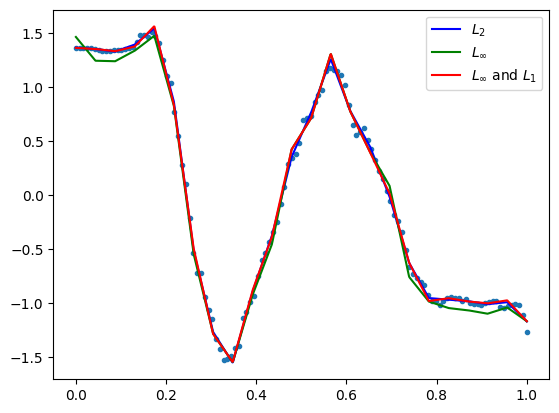

            max_dist       MSE      RMSE       MAE
LSQ         0.103919  0.001335  0.036536  0.025720
Max         0.085091  0.004396  0.066299  0.059565
Max and L1  0.085092  0.001489  0.038581  0.025260 

opt distance 0.0850910908716979
number of data points: 120


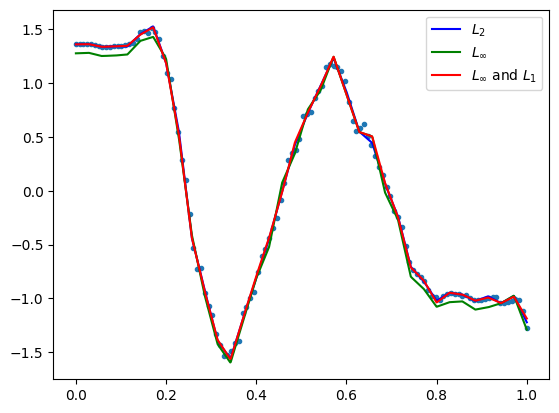

            max_dist       MSE      RMSE       MAE
LSQ         0.083119  0.000643  0.025354  0.017087
Max         0.074184  0.003871  0.062216  0.058478
Max and L1  0.074185  0.000834  0.028871  0.016698 

opt distance 0.07418401270500591
number of data points: 120


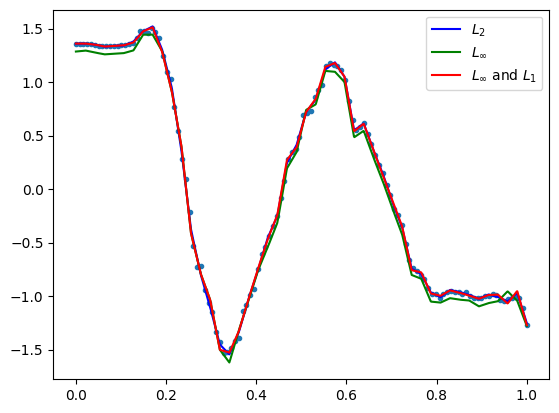

            max_dist       MSE      RMSE       MAE
LSQ         0.096212  0.000520  0.022802  0.015806
Max         0.062206  0.002756  0.052496  0.048792
Max and L1  0.062207  0.000699  0.026445  0.015591 

opt distance 0.062206181591438536
number of data points: 120


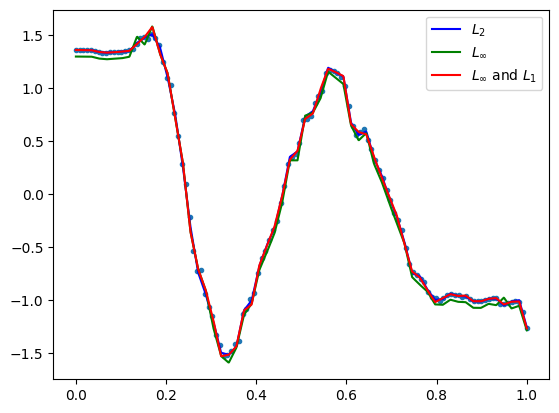

GestureMidAirD3 no. 24 len(ts): 359 ts processed: 11.540000000000001 %
[35, 71, 107, 143, 179]
            max_dist       MSE      RMSE       MAE
LSQ         0.084718  0.000217  0.014731  0.009949
Max         0.077050  0.003525  0.059372  0.055771
Max and L1  0.077051  0.000314  0.017708  0.011089 

opt distance 0.07704971530148615
number of data points: 359


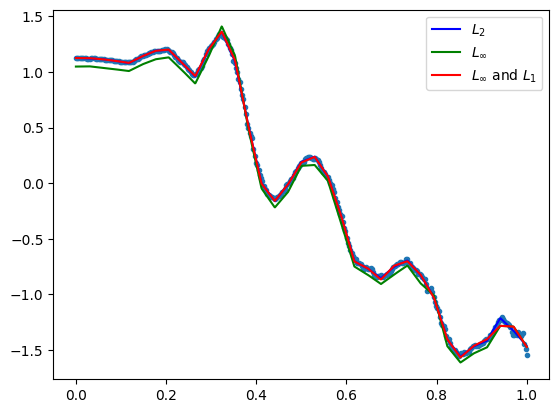

            max_dist       MSE      RMSE       MAE
LSQ         0.066721  0.000114  0.010658  0.007048
Max         0.049990  0.001553  0.039402  0.037048
Max and L1  0.049991  0.000127  0.011276  0.006861 

opt distance 0.04998963160005543
number of data points: 359


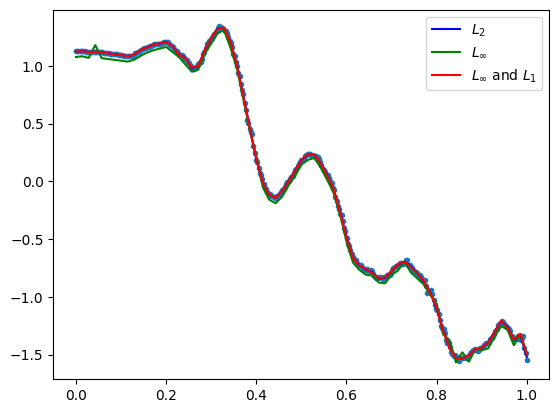

            max_dist       MSE      RMSE       MAE
LSQ         0.045700  0.000065  0.008043  0.005322
Max         0.030809  0.000645  0.025398  0.023972
Max and L1  0.030810  0.000084  0.009181  0.005223 
opt distance 0.030808922343585156
number of data points: 359


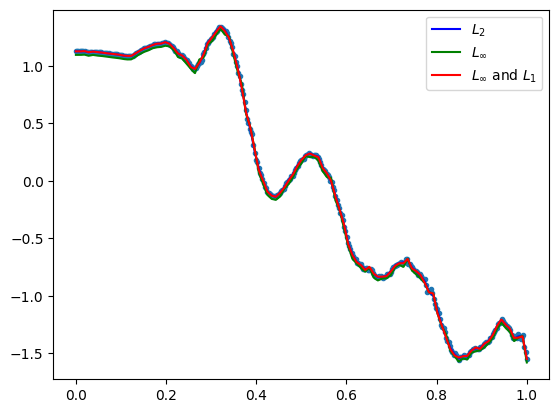

            max_dist       MSE      RMSE       MAE
LSQ         0.036484  0.000041  0.006389  0.004177
Max         0.027620  0.000542  0.023279  0.022049
Max and L1  0.027621  0.000054  0.007337  0.003956 
opt distance 0.027619558080997253
number of data points: 359


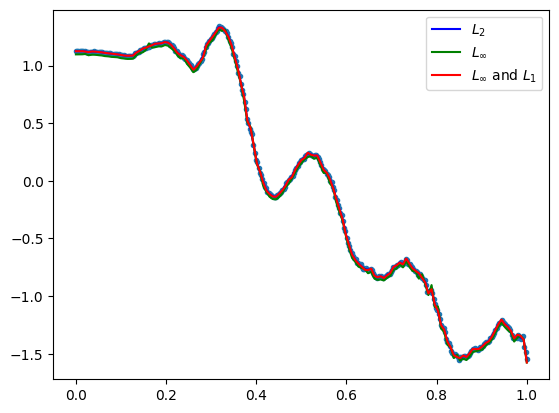

            max_dist       MSE      RMSE       MAE
LSQ         0.042146  0.000034  0.005838  0.003698
Max         0.029077  0.000678  0.026033  0.025231
Max and L1  0.029078  0.000050  0.007077  0.003398 
opt distance 0.02907724485911328
number of data points: 359


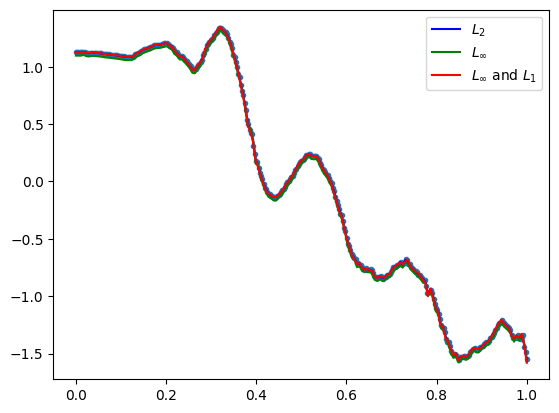

GestureMidAirD3 no. 25 len(ts): 90 ts processed: 12.02 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.204158  0.003331  0.057715  0.045533
Max         0.125106  0.005155  0.071801  0.059748
Max and L1  0.125107  0.004942  0.070296  0.058257 

opt distance 0.1251059257766063
number of data points: 90


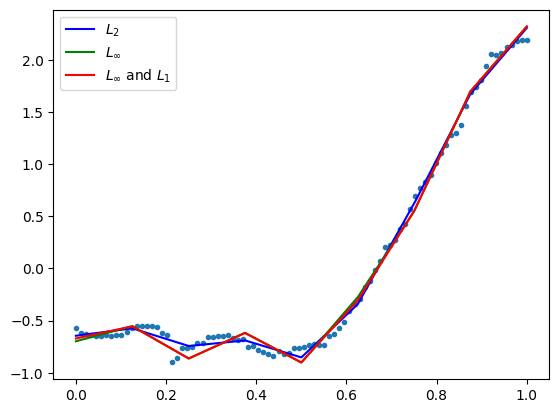

            max_dist       MSE      RMSE       MAE
LSQ         0.156794  0.001002  0.031662  0.021912
Max         0.108567  0.006122  0.078242  0.071555
Max and L1  0.108568  0.001761  0.041969  0.028623 

opt distance 0.10856673060844149
number of data points: 90


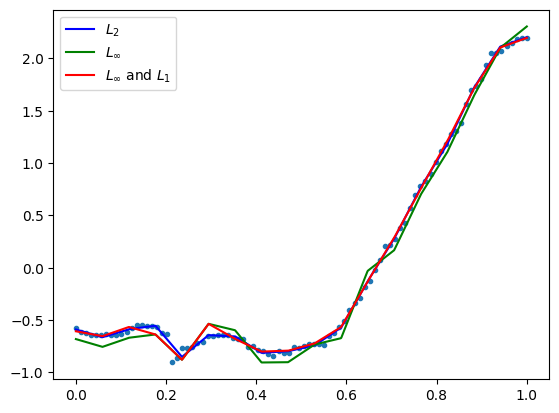

            max_dist       MSE      RMSE       MAE
LSQ         0.138381  0.000672  0.025921  0.017584
Max         0.098124  0.005696  0.075471  0.069683
Max and L1  0.098125  0.001234  0.035122  0.023029 

opt distance 0.09812355596675515
number of data points: 90


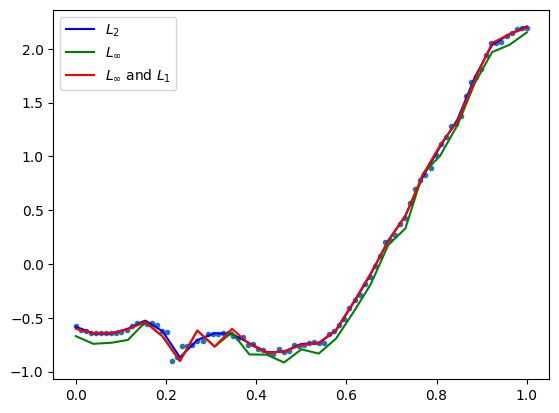

            max_dist       MSE      RMSE       MAE
LSQ         0.125635  0.000573  0.023946  0.015931
Max         0.088924  0.004934  0.070240  0.064457
Max and L1  0.088925  0.000997  0.031570  0.018615 

opt distance 0.08892414728410486
number of data points: 90


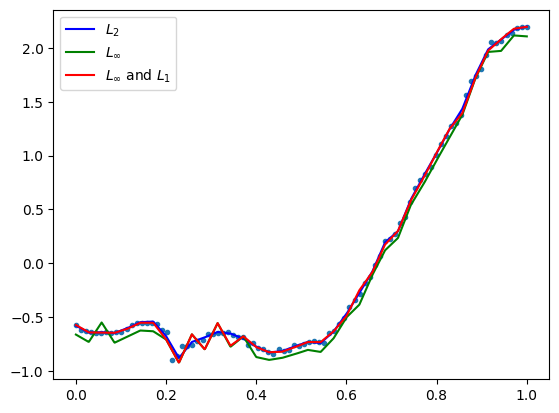

            max_dist       MSE      RMSE       MAE
LSQ         0.109943  0.000451  0.021233  0.013056
Max         0.074781  0.004037  0.063539  0.059558
Max and L1  0.074782  0.000837  0.028933  0.016647 

opt distance 0.07478071323566486
number of data points: 90


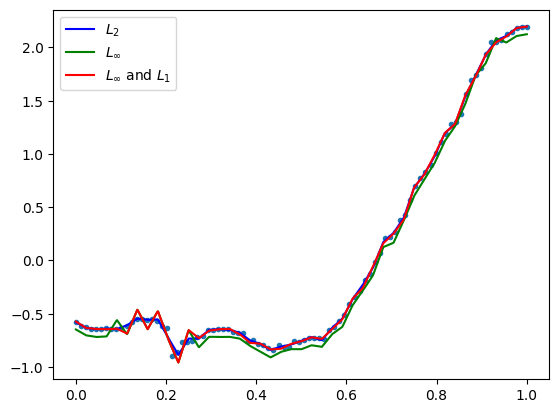

GestureMidAirD3 no. 26 len(ts): 90 ts processed: 12.5 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.360100  0.017087  0.130715  0.103778
Max         0.295726  0.034773  0.186476  0.159510
Max and L1  0.295727  0.023176  0.152237  0.121996 

opt distance 0.29572625291253885
number of data points: 90


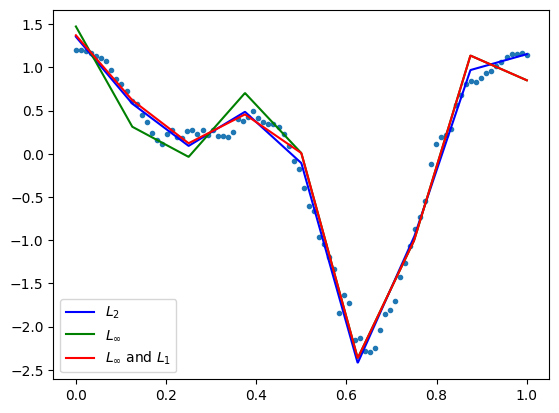

            max_dist       MSE      RMSE       MAE
LSQ         0.249186  0.003991  0.063175  0.046014
Max         0.167869  0.015467  0.124367  0.114600
Max and L1  0.167870  0.005304  0.072829  0.050626 

opt distance 0.1678693513737707
number of data points: 90


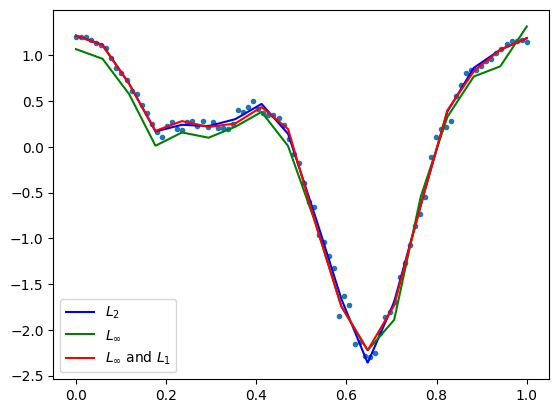

            max_dist       MSE      RMSE       MAE
LSQ         0.261717  0.003306  0.057494  0.039534
Max         0.177043  0.018622  0.136464  0.123933
Max and L1  0.177044  0.004045  0.063604  0.038784 

opt distance 0.17704330473771765
number of data points: 90


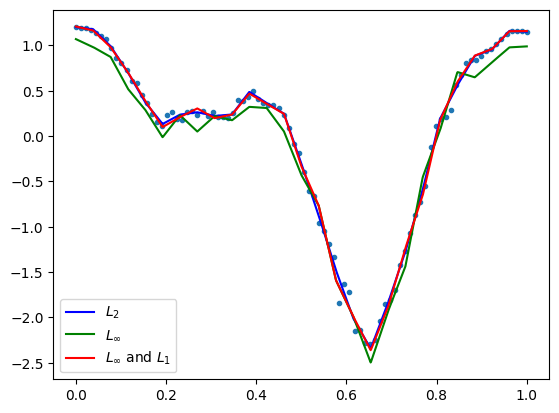

            max_dist       MSE      RMSE       MAE
LSQ         0.277805  0.002308  0.048040  0.030370
Max         0.182780  0.022475  0.149915  0.140261
Max and L1  0.182781  0.003300  0.057448  0.031731 

opt distance 0.18277975440962957
number of data points: 90


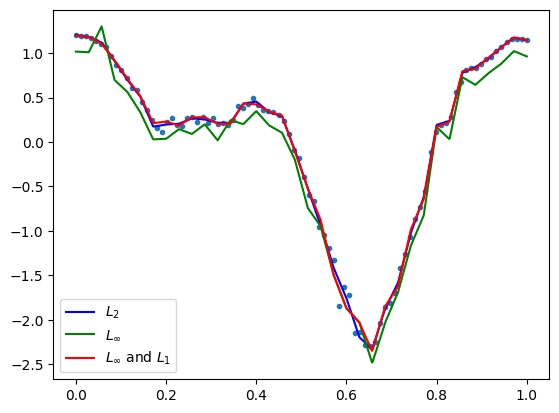

            max_dist       MSE      RMSE       MAE
LSQ         0.236269  0.001945  0.044097  0.024753
Max         0.167386  0.022350  0.149498  0.144866
Max and L1  0.167387  0.003016  0.054920  0.028879 

opt distance 0.16738552976699417
number of data points: 90


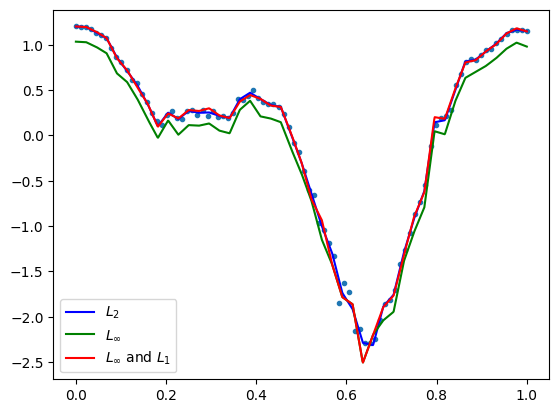

GestureMidAirD3 no. 27 len(ts): 227 ts processed: 12.98 %
[22, 45, 68, 90, 113]
            max_dist       MSE      RMSE       MAE
LSQ         0.392749  0.007071  0.084089  0.048390
Max         0.291428  0.051365  0.226639  0.210761
Max and L1  0.291429  0.010145  0.100723  0.060764 
opt distance 0.29142823638224613
number of data points: 227


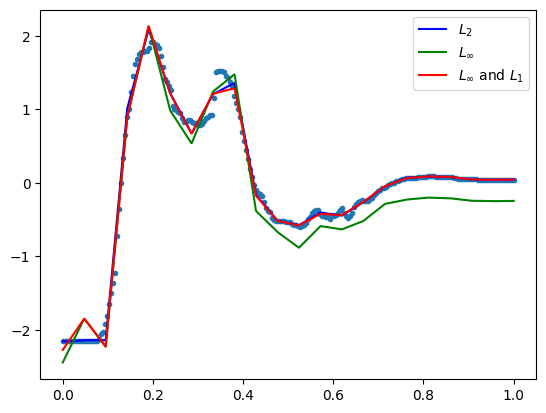

            max_dist       MSE      RMSE       MAE
LSQ         0.217529  0.000968  0.031119  0.017518
Max         0.165221  0.019937  0.141198  0.134805
Max and L1  0.165222  0.001115  0.033398  0.017774 

opt distance 0.1652211194575245
number of data points: 227


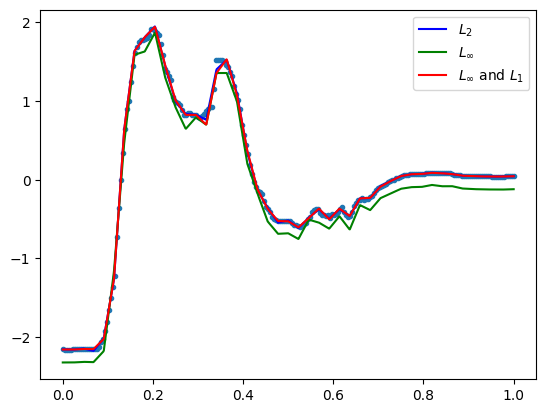

            max_dist       MSE      RMSE       MAE
LSQ         0.165051  0.000628  0.025055  0.013886
Max         0.119890  0.011194  0.105804  0.102074
Max and L1  0.119891  0.000837  0.028932  0.014097 

opt distance 0.11989043262732291
number of data points: 227


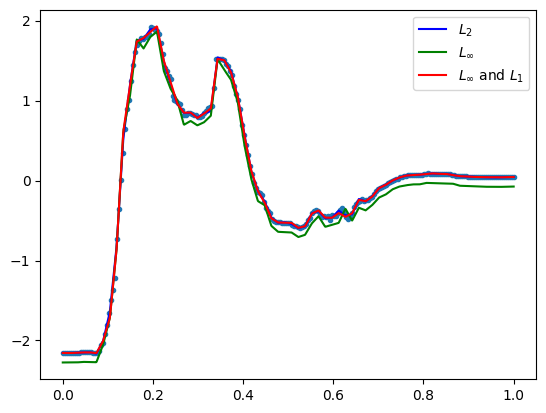

            max_dist       MSE      RMSE       MAE
LSQ         0.161688  0.000407  0.020185  0.009337
Max         0.106303  0.009464  0.097281  0.094709
Max and L1  0.106304  0.000638  0.025257  0.010527 

opt distance 0.10630306160437619
number of data points: 227


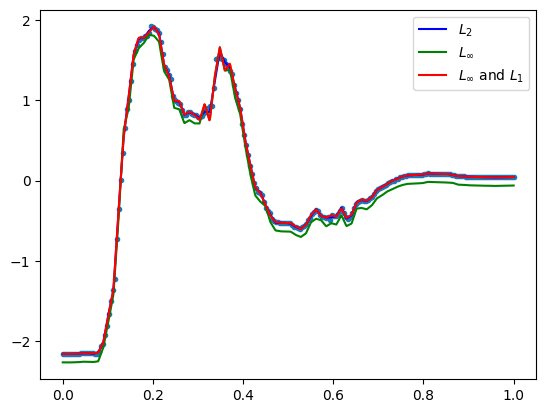

            max_dist       MSE      RMSE       MAE
LSQ         0.082469  0.000210  0.014481  0.007321
Max         0.061571  0.003106  0.055730  0.053661
Max and L1  0.061572  0.000340  0.018446  0.008433 

opt distance 0.0615714831613746
number of data points: 227


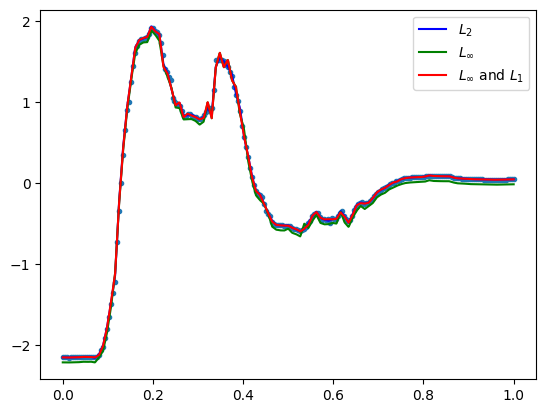

GestureMidAirD3 no. 28 len(ts): 180 ts processed: 13.459999999999999 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.046765  0.000203  0.014253  0.010729
Max         0.043005  0.000879  0.029641  0.026470
Max and L1  0.043006  0.000314  0.017710  0.013039 

opt distance 0.043004511813170665
number of data points: 180


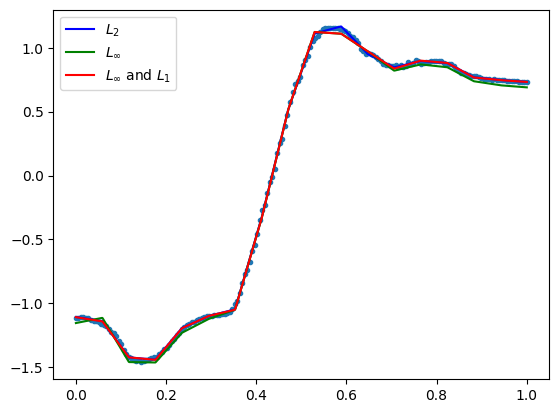

            max_dist       MSE      RMSE       MAE
LSQ         0.035041  0.000088  0.009358  0.006068
Max         0.026569  0.000436  0.020886  0.019608
Max and L1  0.026570  0.000099  0.009961  0.006278 

opt distance 0.026568937505703286
number of data points: 180


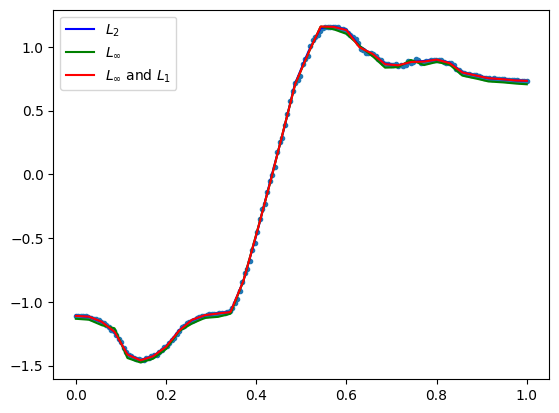

            max_dist       MSE      RMSE       MAE
LSQ         0.030428  0.000060  0.007751  0.004919
Max         0.024792  0.000412  0.020296  0.019152
Max and L1  0.024793  0.000070  0.008349  0.004684 

opt distance 0.024792319271316556
number of data points: 180


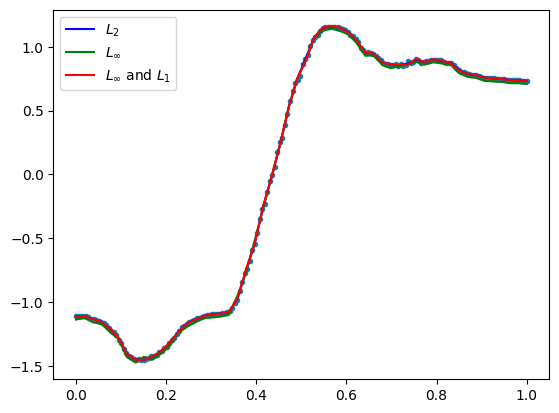

            max_dist       MSE      RMSE       MAE
LSQ         0.021629  0.000040  0.006362  0.004099
Max         0.018272  0.000231  0.015183  0.014323
Max and L1  0.018273  0.000048  0.006951  0.004054 

opt distance 0.018271975294531256
number of data points: 180


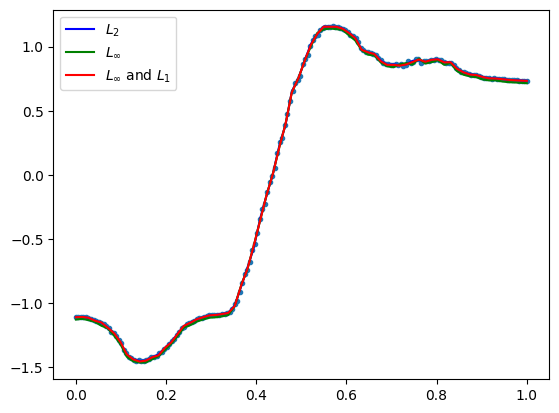

            max_dist       MSE      RMSE       MAE
LSQ         0.021346  0.000026  0.005080  0.003324
Max         0.016071  0.000199  0.014105  0.013546
Max and L1  0.016072  0.000038  0.006130  0.003396 

opt distance 0.016071029829210846
number of data points: 180


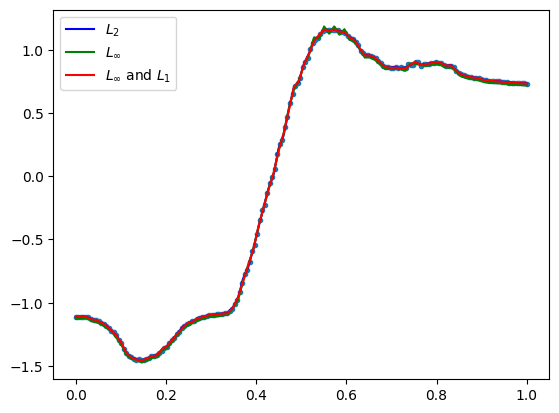

GestureMidAirD3 no. 29 len(ts): 180 ts processed: 13.94 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.247912  0.003761  0.061323  0.042783
Max         0.208159  0.023286  0.152597  0.139129
Max and L1  0.208160  0.004776  0.069108  0.046819 

opt distance 0.20815914555893317
number of data points: 180


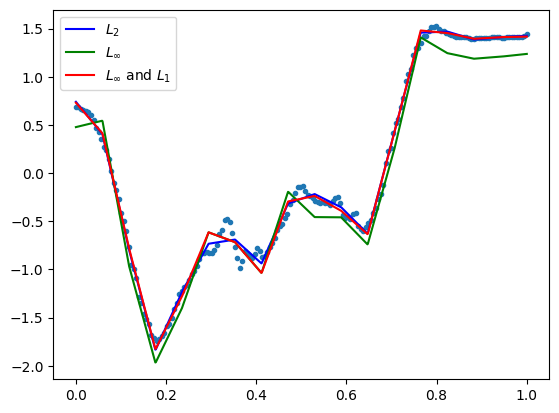

            max_dist       MSE      RMSE       MAE
LSQ         0.143105  0.001342  0.036627  0.024926
Max         0.123491  0.008999  0.094863  0.088101
Max and L1  0.123492  0.002170  0.046582  0.030017 

opt distance 0.12349075177041022
number of data points: 180


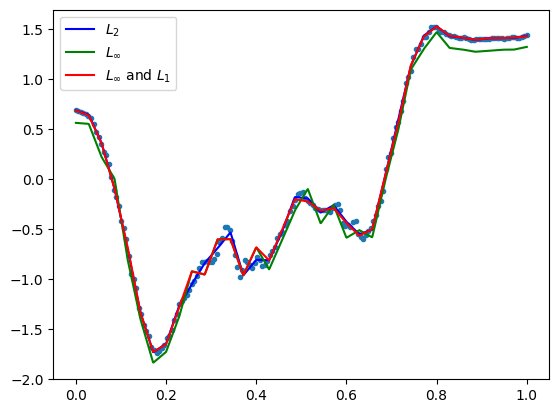

            max_dist       MSE      RMSE       MAE
LSQ         0.069006  0.000509  0.022557  0.015642
Max         0.057028  0.001941  0.044053  0.040491
Max and L1  0.057029  0.000628  0.025050  0.016768 

opt distance 0.05702848611682744
number of data points: 180


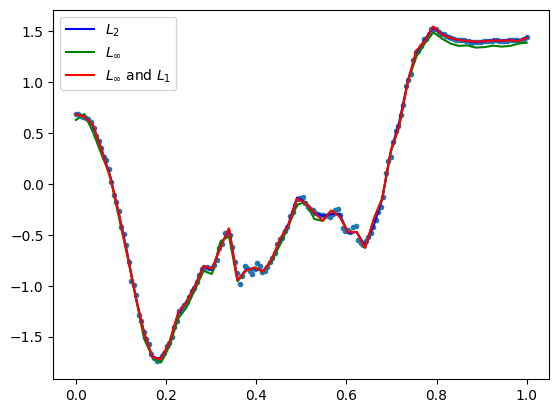

            max_dist       MSE      RMSE       MAE
LSQ         0.064371  0.000319  0.017871  0.012506
Max         0.046582  0.001464  0.038268  0.035543
Max and L1  0.046583  0.000388  0.019700  0.012137 

opt distance 0.04658193239593004
number of data points: 180


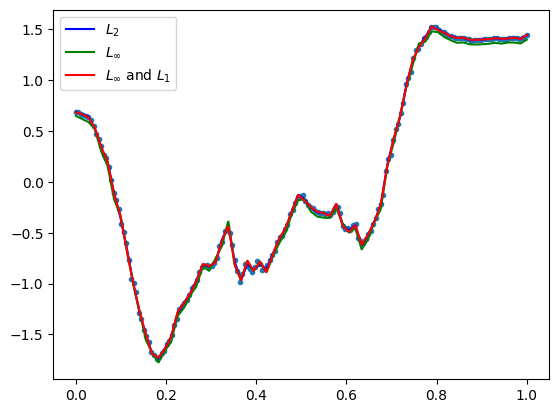

            max_dist       MSE      RMSE       MAE
LSQ         0.058526  0.000196  0.013987  0.009498
Max         0.038926  0.001106  0.033255  0.031281
Max and L1  0.038927  0.000291  0.017050  0.010250 

opt distance 0.03892590807313655
number of data points: 180


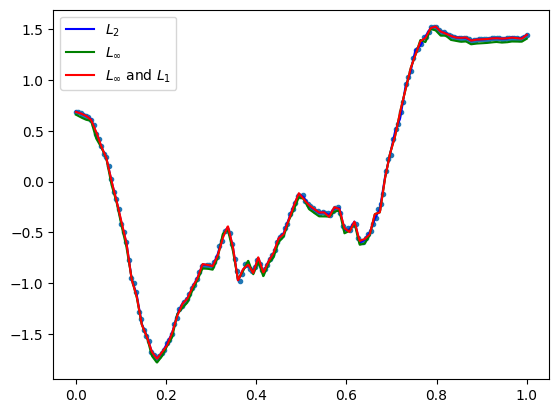

GestureMidAirD3 no. 30 len(ts): 161 ts processed: 14.42 %
[16, 32, 48, 64, 80]
            max_dist       MSE      RMSE       MAE
LSQ         0.144331  0.000820  0.028638  0.019051
Max         0.117423  0.008093  0.089962  0.084559
Max and L1  0.117424  0.001120  0.033466  0.021478 

opt distance 0.11742280343868794
number of data points: 161


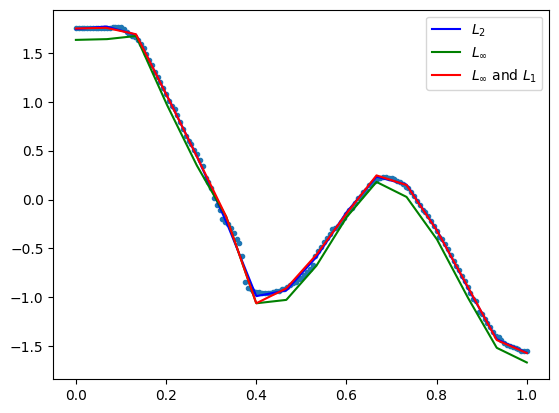

            max_dist       MSE      RMSE       MAE
LSQ         0.110104  0.000239  0.015444  0.009103
Max         0.080976  0.004237  0.065093  0.061385
Max and L1  0.080977  0.000391  0.019779  0.010832 

opt distance 0.08097628765170194
number of data points: 161


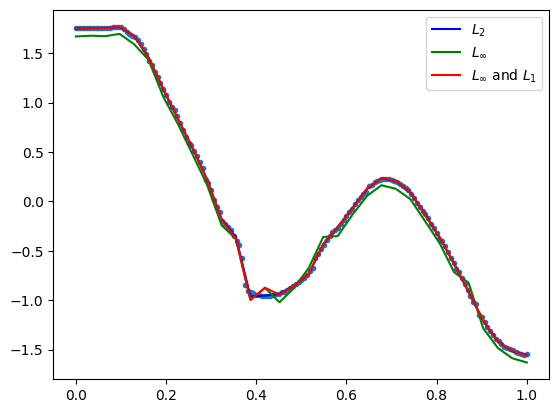

            max_dist       MSE      RMSE       MAE
LSQ         0.085972  0.000134  0.011591  0.007041
Max         0.055238  0.002184  0.046729  0.044986
Max and L1  0.055239  0.000221  0.014870  0.008292 

opt distance 0.055237986527612
number of data points: 161


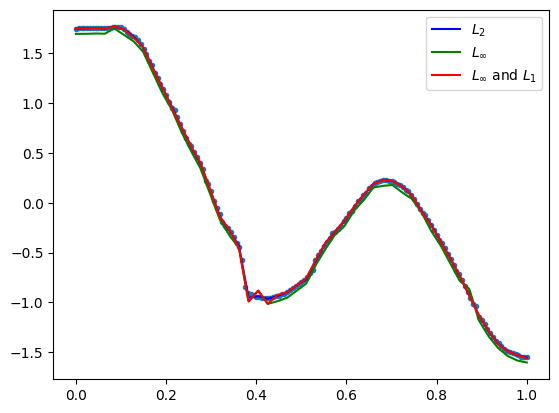

            max_dist       MSE      RMSE       MAE
LSQ         0.075797  0.000094  0.009709  0.005396
Max         0.049910  0.001966  0.044340  0.042939
Max and L1  0.049911  0.000171  0.013069  0.006265 

opt distance 0.04990986407888831
number of data points: 161


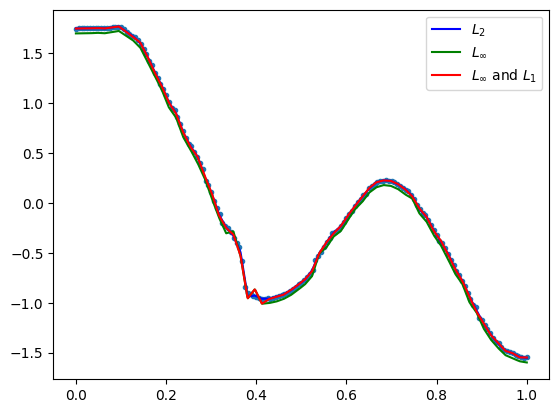

            max_dist       MSE      RMSE       MAE
LSQ         0.057934  0.000072  0.008460  0.004812
Max         0.038671  0.001202  0.034676  0.033439
Max and L1  0.038672  0.000128  0.011302  0.005470 

opt distance 0.03867099402439056
number of data points: 161


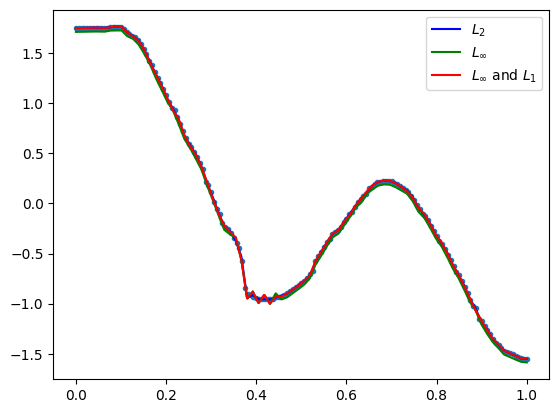

GestureMidAirD3 no. 31 len(ts): 180 ts processed: 14.899999999999999 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.102179  0.001627  0.040331  0.032731
Max         0.091673  0.003328  0.057693  0.050048
Max and L1  0.091674  0.001721  0.041483  0.032622 
opt distance 0.09167268199301848
number of data points: 180


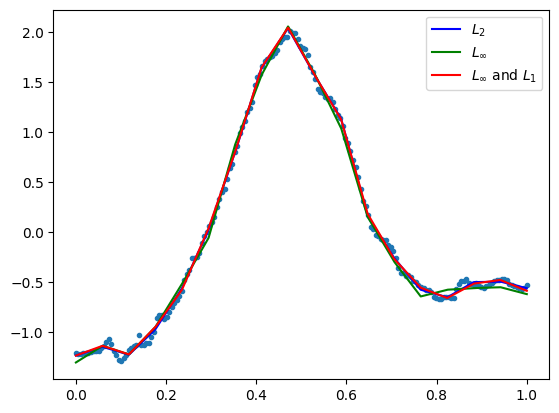

            max_dist       MSE      RMSE       MAE
LSQ         0.098273  0.000799  0.028269  0.020813
Max         0.078850  0.003224  0.056778  0.051834
Max and L1  0.078851  0.001137  0.033720  0.023916 

opt distance 0.07884954347470535
number of data points: 180


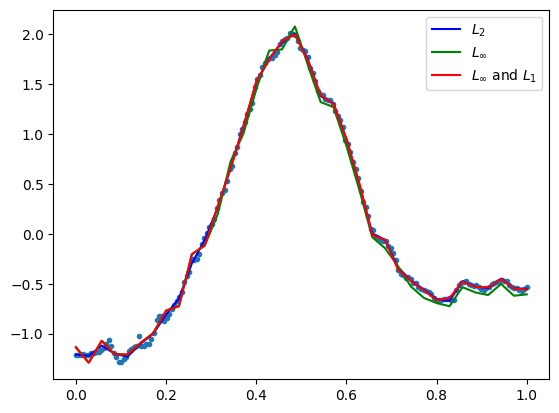

            max_dist       MSE      RMSE       MAE
LSQ         0.076671  0.000379  0.019457  0.014614
Max         0.053382  0.001636  0.040443  0.036689
Max and L1  0.053383  0.000467  0.021607  0.014700 

opt distance 0.05338199282390351
number of data points: 180


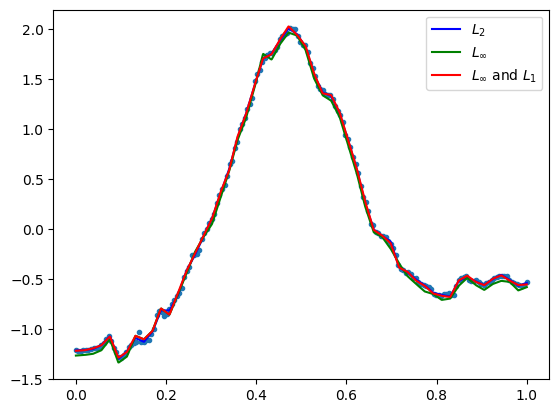

            max_dist       MSE      RMSE       MAE
LSQ         0.044908  0.000218  0.014752  0.011193
Max         0.038119  0.000894  0.029896  0.027254
Max and L1  0.038120  0.000272  0.016485  0.010747 

opt distance 0.03811854744235862
number of data points: 180


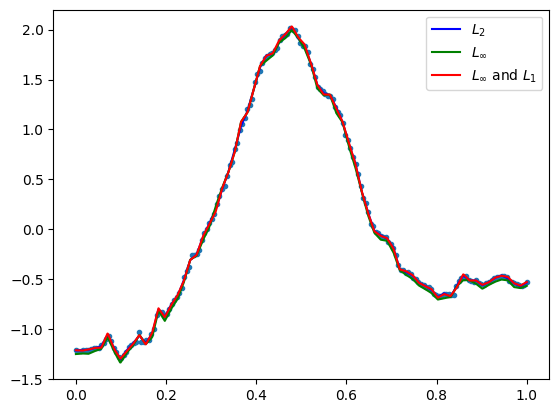

            max_dist       MSE      RMSE       MAE
LSQ         0.066394  0.000192  0.013861  0.010412
Max         0.045857  0.001504  0.038786  0.036414
Max and L1  0.045858  0.000287  0.016933  0.009616 

opt distance 0.04585696799664379
number of data points: 180


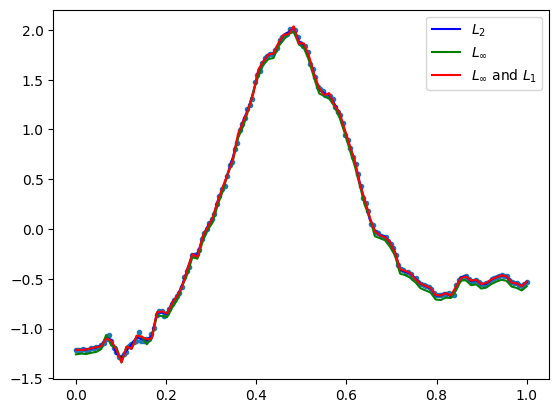

GestureMidAirD3 no. 32 len(ts): 120 ts processed: 15.379999999999999 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.145723  0.001458  0.038185  0.027203
Max         0.115447  0.006087  0.078018  0.068328
Max and L1  0.115448  0.002017  0.044908  0.032276 

opt distance 0.11544679163184654
number of data points: 120


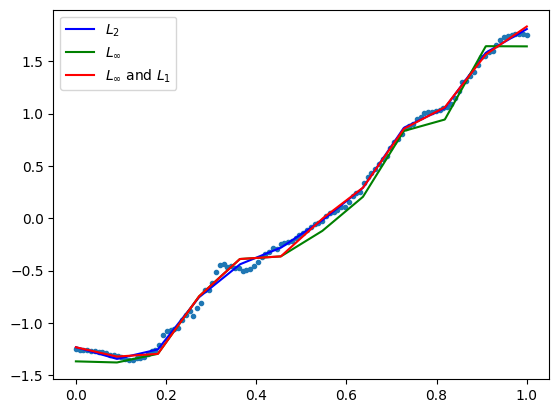

            max_dist       MSE      RMSE       MAE
LSQ         0.065422  0.000328  0.018103  0.012268
Max         0.052337  0.001415  0.037612  0.034310
Max and L1  0.052338  0.000498  0.022313  0.015180 

opt distance 0.0523367973191647
number of data points: 120


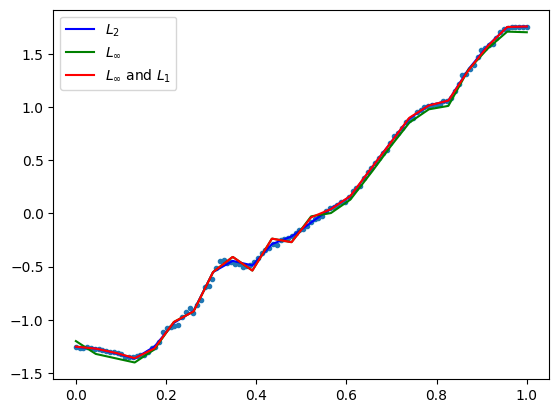

            max_dist       MSE      RMSE       MAE
LSQ         0.052246  0.000186  0.013637  0.009575
Max         0.042298  0.001109  0.033295  0.030885
Max and L1  0.042299  0.000240  0.015500  0.009832 

opt distance 0.04229797869844228
number of data points: 120


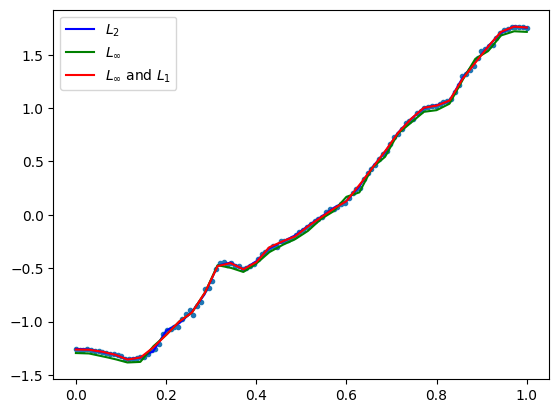

            max_dist       MSE      RMSE       MAE
LSQ         0.050301  0.000161  0.012678  0.008973
Max         0.039147  0.000995  0.031551  0.028938
Max and L1  0.039148  0.000251  0.015831  0.009686 

opt distance 0.03914721370839902
number of data points: 120


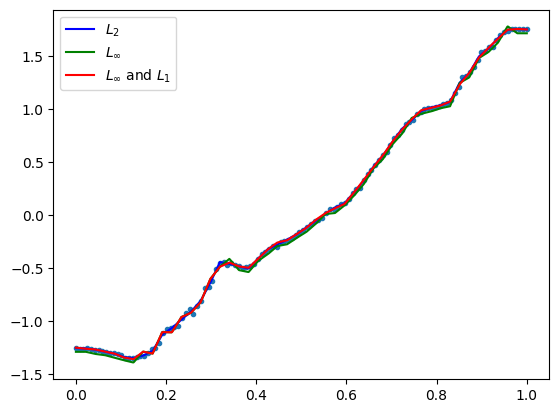

            max_dist       MSE      RMSE       MAE
LSQ         0.044087  0.000096  0.009815  0.006655
Max         0.031141  0.000738  0.027165  0.025708
Max and L1  0.031142  0.000128  0.011294  0.006310 

opt distance 0.03114144888472925
number of data points: 120


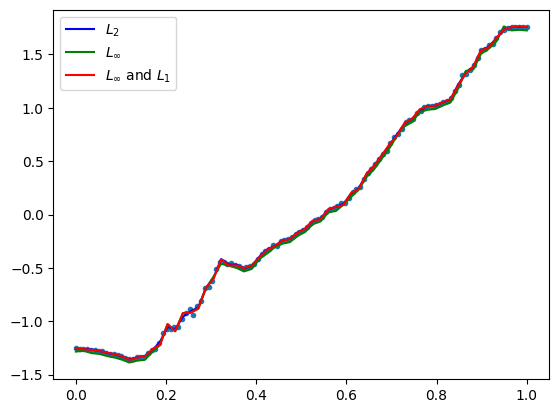

GestureMidAirD3 no. 33 len(ts): 228 ts processed: 15.870000000000001 %
[22, 45, 68, 91, 114]
            max_dist       MSE      RMSE       MAE
LSQ         0.363978  0.010034  0.100171  0.063835
Max         0.305542  0.054740  0.233966  0.214767
Max and L1  0.305543  0.012054  0.109791  0.066784 
opt distance 0.30554168109042246
number of data points: 228


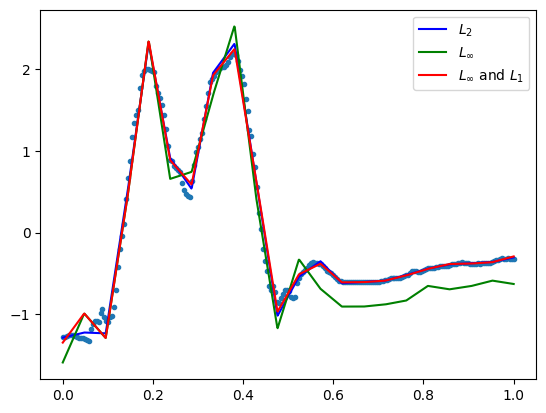

            max_dist       MSE      RMSE       MAE
LSQ         0.174854  0.001608  0.040105  0.024840
Max         0.130668  0.010983  0.104798  0.096440
Max and L1  0.130669  0.001824  0.042707  0.024721 

opt distance 0.1306680204758182
number of data points: 228


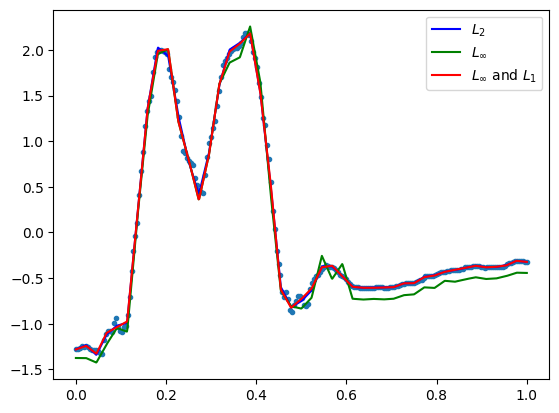

            max_dist       MSE      RMSE       MAE
LSQ         0.099944  0.000731  0.027042  0.016595
Max         0.071854  0.003697  0.060806  0.057254
Max and L1  0.071855  0.000820  0.028635  0.016958 

opt distance 0.07185428222891399
number of data points: 228


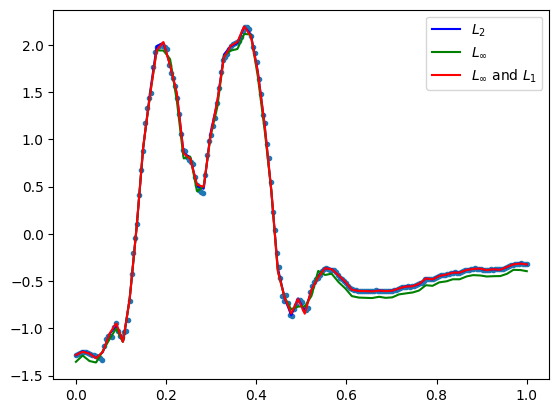

            max_dist       MSE      RMSE       MAE
LSQ         0.084465  0.000347  0.018633  0.011087
Max         0.064542  0.003229  0.056825  0.054273
Max and L1  0.064543  0.000449  0.021186  0.010638 

opt distance 0.06454185570649257
number of data points: 228


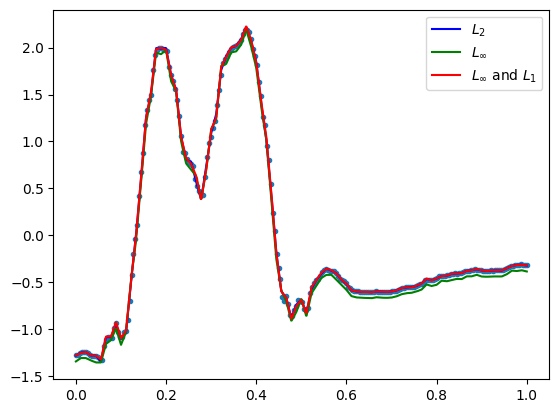

            max_dist       MSE      RMSE       MAE
LSQ         0.058458  0.000175  0.013230  0.008050
Max         0.038863  0.001162  0.034095  0.032283
Max and L1  0.038864  0.000225  0.014989  0.007928 

opt distance 0.038862660374080905
number of data points: 228


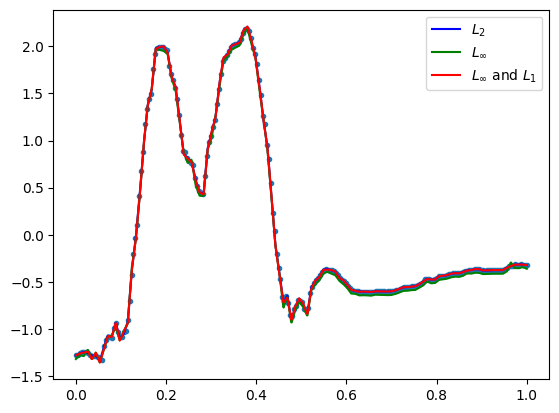

GestureMidAirD3 no. 34 len(ts): 119 ts processed: 16.35 %
[11, 23, 35, 47, 59]
            max_dist       MSE      RMSE       MAE
LSQ         0.155518  0.003673  0.060607  0.047068
Max         0.136958  0.007996  0.089418  0.078978
Max and L1  0.136959  0.005731  0.075703  0.058906 

opt distance 0.13695823103157992
number of data points: 119


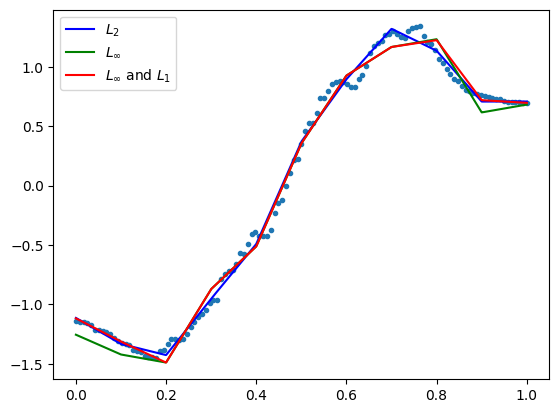

            max_dist       MSE      RMSE       MAE
LSQ         0.084070  0.000842  0.029011  0.021067
Max         0.069898  0.002733  0.052275  0.047883
Max and L1  0.069899  0.000967  0.031092  0.021535 

opt distance 0.06989775421807097
number of data points: 119


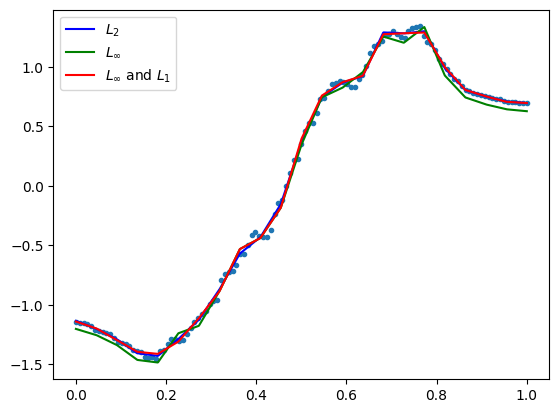

            max_dist       MSE      RMSE       MAE
LSQ         0.077393  0.000434  0.020845  0.014865
Max         0.052300  0.001771  0.042081  0.039224
Max and L1  0.052301  0.000522  0.022840  0.014881 

opt distance 0.05230038824526767
number of data points: 119


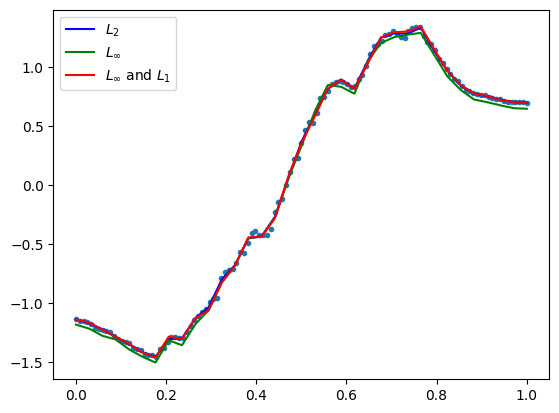

            max_dist       MSE      RMSE       MAE
LSQ         0.063396  0.000262  0.016200  0.011274
Max         0.041312  0.001106  0.033249  0.030365
Max and L1  0.041313  0.000301  0.017361  0.010900 

opt distance 0.04131201918168426
number of data points: 119


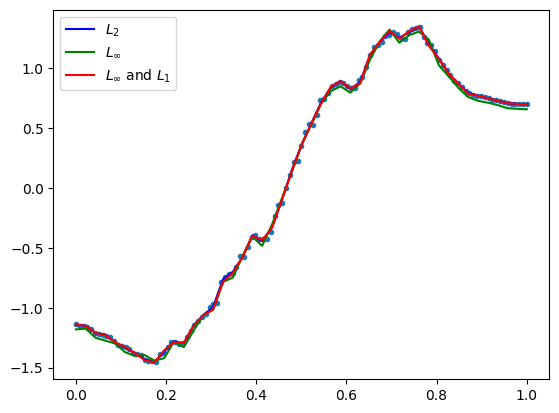

            max_dist       MSE      RMSE       MAE
LSQ         0.047365  0.000160  0.012644  0.008697
Max         0.036671  0.000963  0.031028  0.028883
Max and L1  0.036672  0.000199  0.014098  0.008317 

opt distance 0.03667135616820327
number of data points: 119


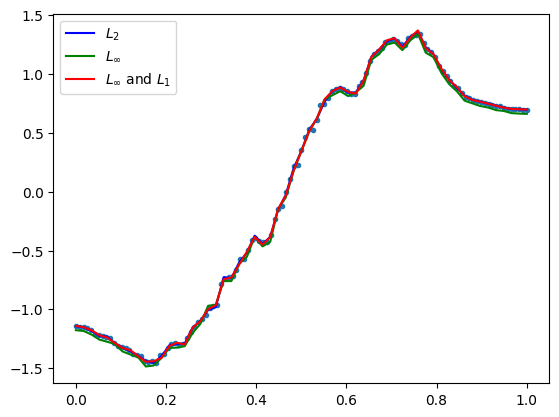

GestureMidAirD3 no. 35 len(ts): 179 ts processed: 16.830000000000002 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.190084  0.004555  0.067490  0.053622
Max         0.147739  0.008289  0.091046  0.078707
Max and L1  0.147740  0.005899  0.076806  0.061666 

opt distance 0.14773899297391635
number of data points: 179


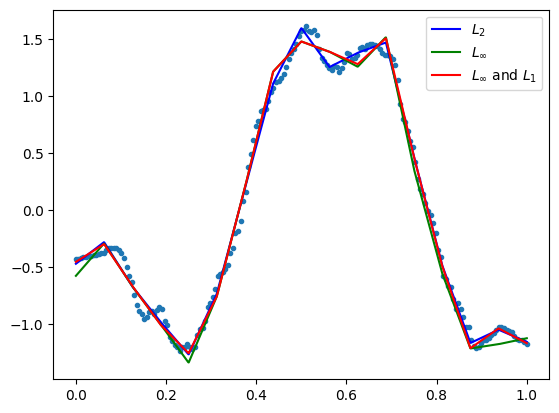

            max_dist       MSE      RMSE       MAE
LSQ         0.097664  0.000868  0.029460  0.021572
Max         0.068734  0.002463  0.049626  0.043796
Max and L1  0.068735  0.001165  0.034127  0.024772 

opt distance 0.06873423231010996
number of data points: 179


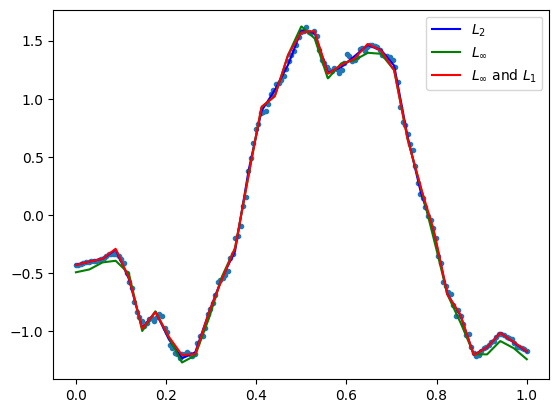

            max_dist       MSE      RMSE       MAE
LSQ         0.074029  0.000547  0.023395  0.017267
Max         0.055777  0.001802  0.042445  0.038431
Max and L1  0.055778  0.000644  0.025372  0.017381 

opt distance 0.055777388471142775
number of data points: 179


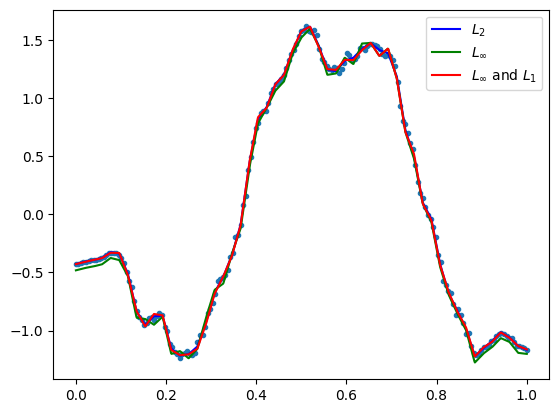

            max_dist       MSE      RMSE       MAE
LSQ         0.049468  0.000301  0.017352  0.012979
Max         0.038741  0.000910  0.030167  0.026948
Max and L1  0.038742  0.000382  0.019537  0.013277 

opt distance 0.03874144831181794
number of data points: 179


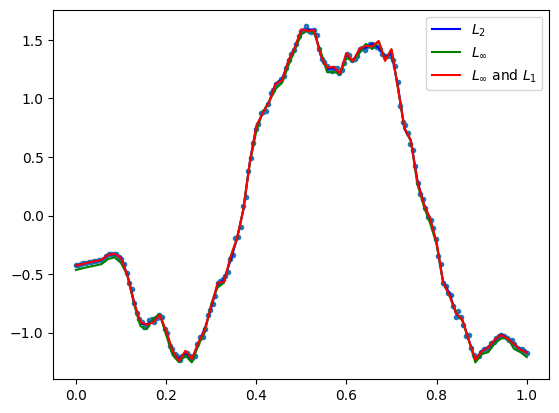

            max_dist       MSE      RMSE       MAE
LSQ         0.040012  0.000179  0.013382  0.009958
Max         0.029466  0.000591  0.024304  0.022560
Max and L1  0.029467  0.000240  0.015499  0.010358 

opt distance 0.02946587857318712
number of data points: 179


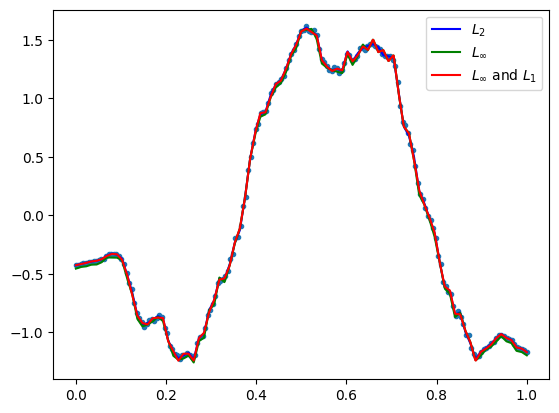

GestureMidAirD3 no. 36 len(ts): 341 ts processed: 17.31 %
[34, 68, 102, 136, 170]
            max_dist       MSE      RMSE       MAE
LSQ         0.036624  0.000227  0.015058  0.012323
Max         0.032108  0.000418  0.020434  0.017784
Max and L1  0.032109  0.000255  0.015961  0.012719 

opt distance 0.032107534129531386
number of data points: 341


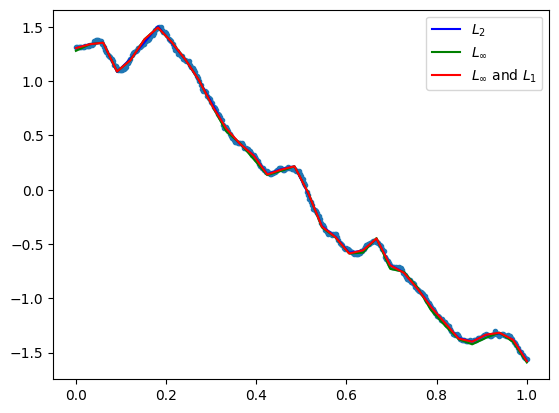

            max_dist       MSE      RMSE       MAE
LSQ         0.024472  0.000057  0.007542  0.005919
Max         0.018086  0.000157  0.012534  0.011115
Max and L1  0.018087  0.000066  0.008107  0.006027 

opt distance 0.018085915641278975
number of data points: 341


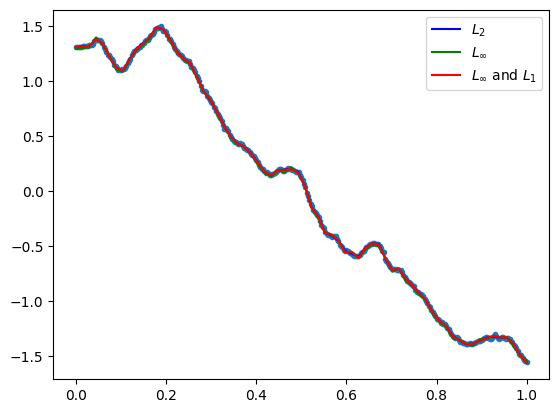

            max_dist       MSE      RMSE       MAE
LSQ         0.016834  0.000028  0.005331  0.004130
Max         0.013709  0.000103  0.010165  0.009106
Max and L1  0.013710  0.000033  0.005786  0.003954 
opt distance 0.01370910530412617
number of data points: 341


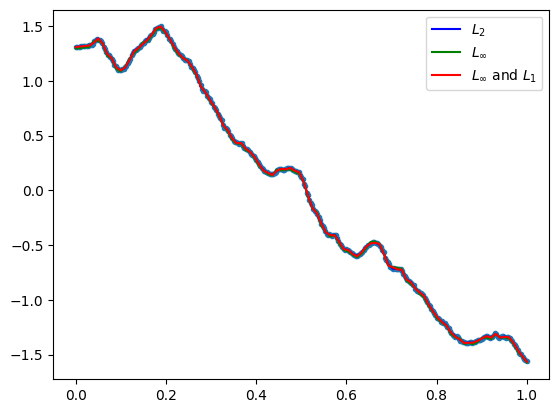

            max_dist       MSE      RMSE       MAE
LSQ         0.016633  0.000021  0.004591  0.003449
Max         0.011116  0.000077  0.008799  0.007986
Max and L1  0.011117  0.000025  0.004999  0.003302 
opt distance 0.0111158376451242
number of data points: 341


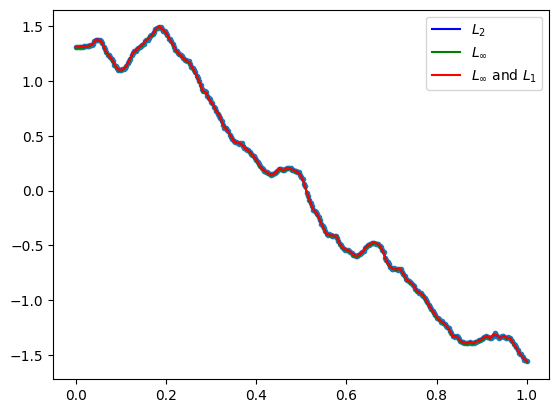

            max_dist       MSE      RMSE       MAE
LSQ         0.012196  0.000012  0.003444  0.002509
Max         0.009387  0.000062  0.007848  0.007340
Max and L1  0.009388  0.000015  0.003911  0.002393 
opt distance 0.009386505821741125
number of data points: 341


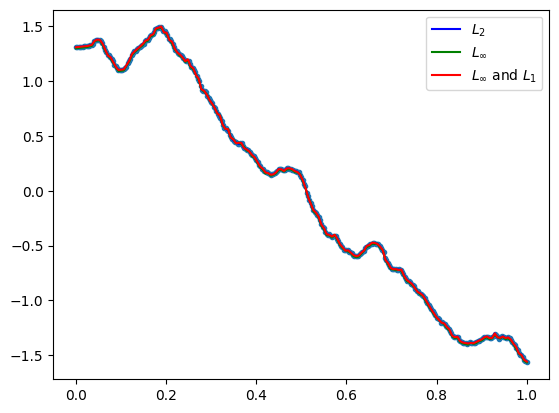

GestureMidAirD3 no. 37 len(ts): 179 ts processed: 17.79 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.056581  0.000384  0.019590  0.014256
Max         0.047248  0.000913  0.030209  0.026026
Max and L1  0.047249  0.000508  0.022534  0.017403 

opt distance 0.04724824021967916
number of data points: 179


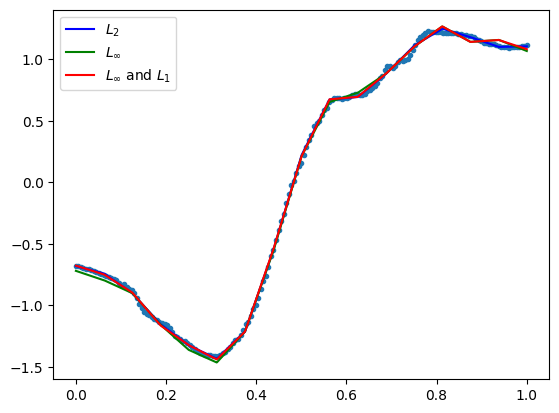

            max_dist       MSE      RMSE       MAE
LSQ         0.030323  0.000075  0.008634  0.006345
Max         0.025254  0.000343  0.018517  0.016856
Max and L1  0.025255  0.000101  0.010033  0.006873 

opt distance 0.02525382219769583
number of data points: 179


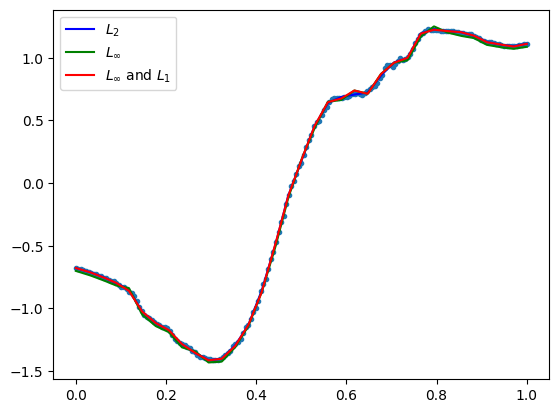

            max_dist       MSE      RMSE       MAE
LSQ         0.026500  0.000044  0.006634  0.004705
Max         0.018824  0.000214  0.014632  0.013493
Max and L1  0.018825  0.000062  0.007844  0.005208 

opt distance 0.01882424933740101
number of data points: 179


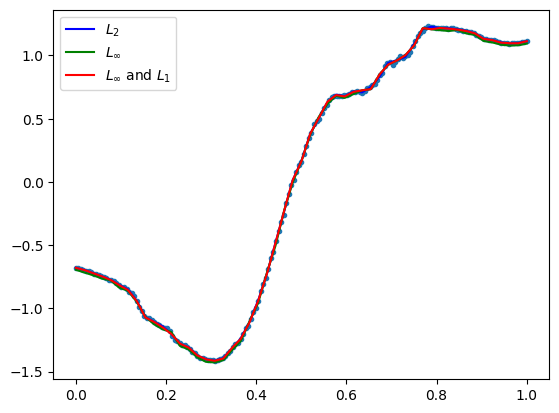

            max_dist       MSE      RMSE       MAE
LSQ         0.015396  0.000028  0.005270  0.003632
Max         0.013317  0.000120  0.010943  0.010257
Max and L1  0.013318  0.000034  0.005811  0.003651 

opt distance 0.013317086939300256
number of data points: 179


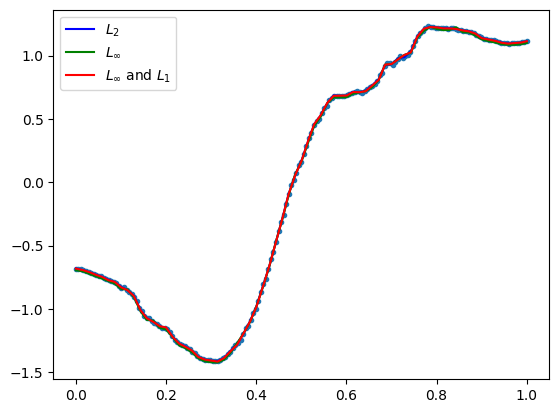

            max_dist       MSE      RMSE       MAE
LSQ         0.015178  0.000018  0.004224  0.002781
Max         0.011974  0.000107  0.010334  0.009894
Max and L1  0.011975  0.000022  0.004742  0.002732 

opt distance 0.011973504148901895
number of data points: 179


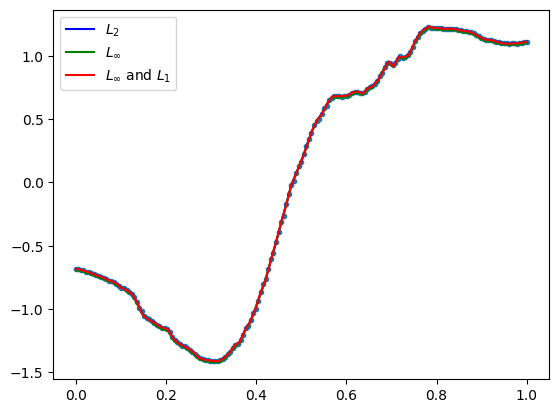

GestureMidAirD3 no. 38 len(ts): 89 ts processed: 18.27 %
[8, 17, 26, 35, 44]
            max_dist       MSE      RMSE       MAE
LSQ         0.068484  0.000403  0.020081  0.016026
Max         0.047716  0.000881  0.029679  0.025864
Max and L1  0.047717  0.000527  0.022949  0.017854 

opt distance 0.04771601847415932
number of data points: 89


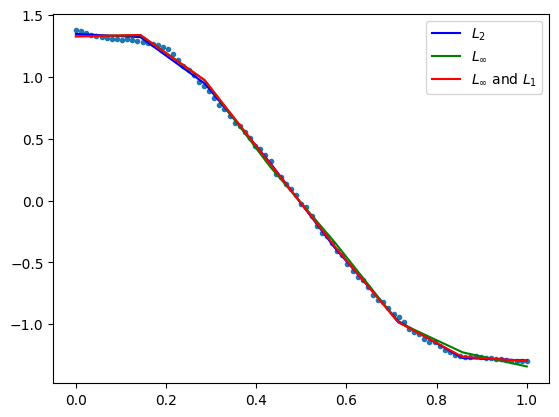

            max_dist       MSE      RMSE       MAE
LSQ         0.029910  0.000092  0.009591  0.007420
Max         0.022960  0.000255  0.015975  0.013902
Max and L1  0.022961  0.000124  0.011147  0.008142 

opt distance 0.022959643111179928
number of data points: 89


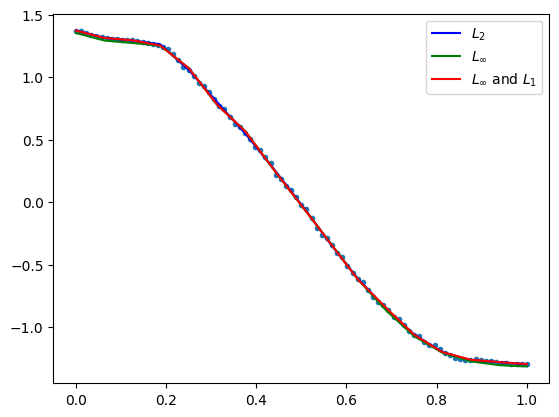

            max_dist       MSE      RMSE       MAE
LSQ         0.023149  0.000072  0.008482  0.006165
Max         0.021560  0.000269  0.016406  0.014660
Max and L1  0.021561  0.000089  0.009416  0.006129 

opt distance 0.02156006366648744
number of data points: 89


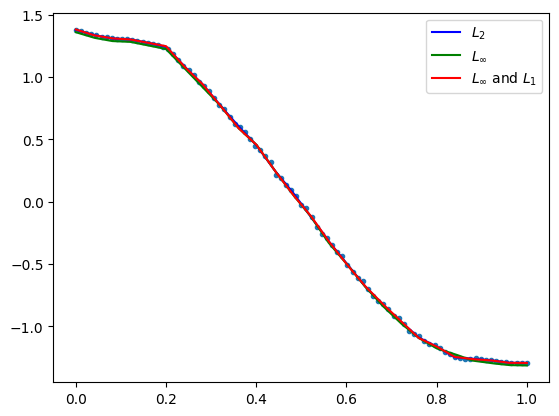

            max_dist       MSE      RMSE       MAE
LSQ         0.021598  0.000057  0.007532  0.005358
Max         0.017381  0.000202  0.014219  0.013286
Max and L1  0.017382  0.000072  0.008486  0.005492 

opt distance 0.01738099606663428
number of data points: 89


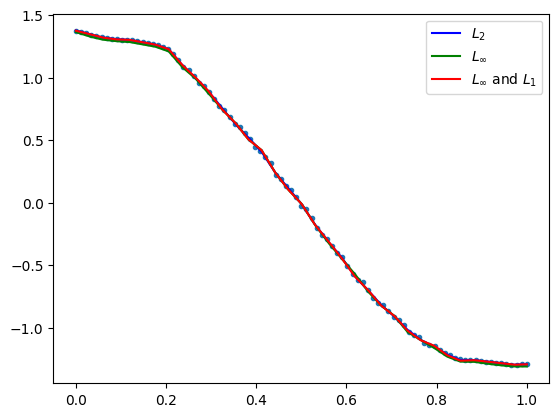

            max_dist       MSE      RMSE       MAE
LSQ         0.017268  0.000040  0.006342  0.004578
Max         0.013678  0.000134  0.011567  0.010921
Max and L1  0.013679  0.000049  0.007005  0.004673 

opt distance 0.013678175170191764
number of data points: 89


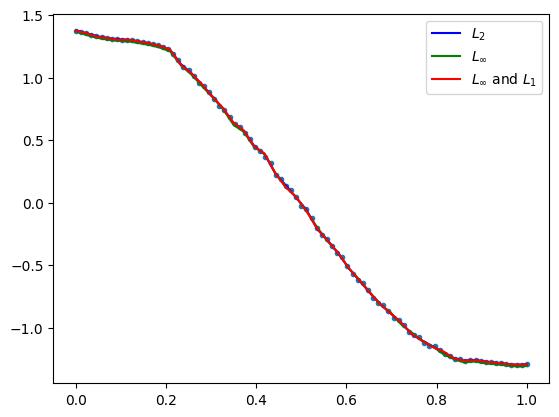

GestureMidAirD3 no. 39 len(ts): 87 ts processed: 18.75 %
[8, 17, 26, 34, 43]
            max_dist       MSE      RMSE       MAE
LSQ         0.388231  0.018067  0.134415  0.099380
Max         0.303663  0.040388  0.200969  0.179138
Max and L1  0.303664  0.021397  0.146278  0.107874 

opt distance 0.30366324144827117
number of data points: 87


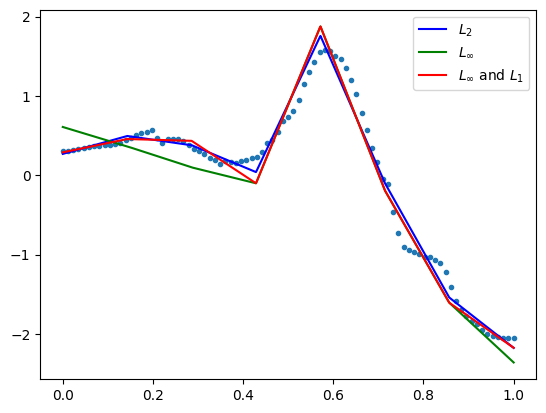

            max_dist       MSE      RMSE       MAE
LSQ         0.167753  0.001556  0.039444  0.026827
Max         0.105776  0.006089  0.078031  0.070216
Max and L1  0.105777  0.003178  0.056377  0.042024 

opt distance 0.10577635495035767
number of data points: 87


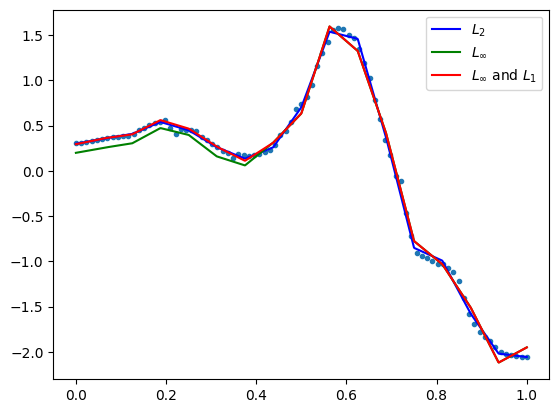

            max_dist       MSE      RMSE       MAE
LSQ         0.082827  0.000524  0.022889  0.015957
Max         0.055356  0.001884  0.043409  0.039893
Max and L1  0.055357  0.000785  0.028018  0.019810 

opt distance 0.05535589675617228
number of data points: 87


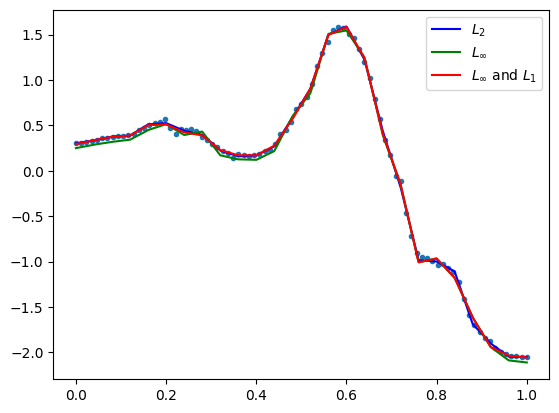

            max_dist       MSE      RMSE       MAE
LSQ         0.091994  0.000383  0.019573  0.012589
Max         0.062060  0.002632  0.051306  0.047737
Max and L1  0.062061  0.000515  0.022700  0.012816 

opt distance 0.06206031206920364
number of data points: 87


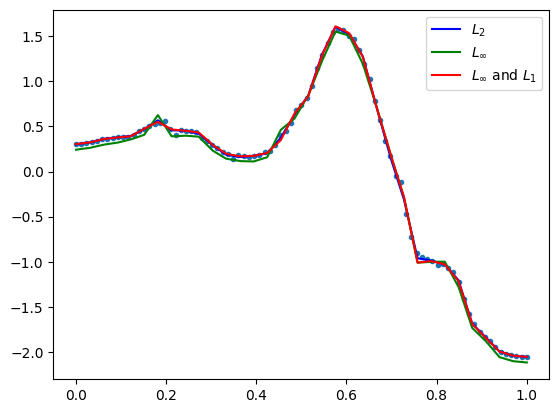

            max_dist       MSE      RMSE       MAE
LSQ         0.078253  0.000314  0.017716  0.011082
Max         0.061200  0.002767  0.052599  0.049464
Max and L1  0.061201  0.000705  0.026553  0.015024 

opt distance 0.06119956829874687
number of data points: 87


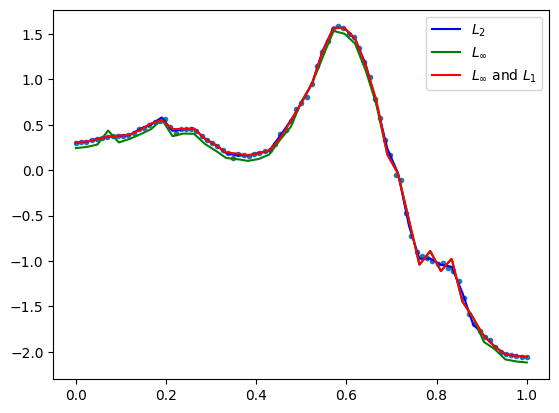

GestureMidAirD3 no. 40 len(ts): 114 ts processed: 19.23 %
[11, 22, 34, 45, 57]
            max_dist       MSE      RMSE       MAE
LSQ         0.322083  0.012199  0.110449  0.082801
Max         0.274888  0.042941  0.207222  0.190394
Max and L1  0.274889  0.015627  0.125008  0.087009 

opt distance 0.2748883105288751
number of data points: 114


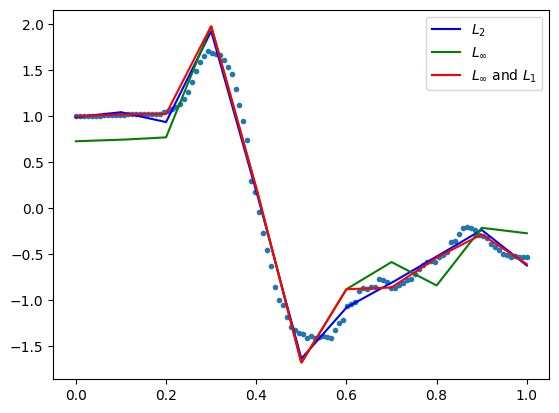

            max_dist       MSE      RMSE       MAE
LSQ         0.168879  0.000839  0.028963  0.017752
Max         0.106741  0.007644  0.087429  0.082548
Max and L1  0.106742  0.001151  0.033928  0.019964 

opt distance 0.10674093522295369
number of data points: 114


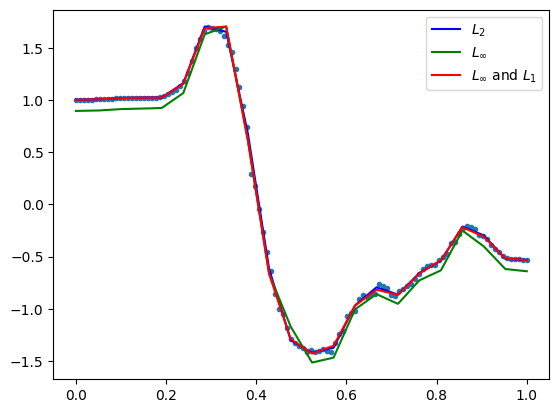

            max_dist       MSE      RMSE       MAE
LSQ         0.096055  0.000500  0.022364  0.014434
Max         0.083639  0.004935  0.070249  0.065684
Max and L1  0.083640  0.000762  0.027610  0.015571 

opt distance 0.08363920736367361
number of data points: 114


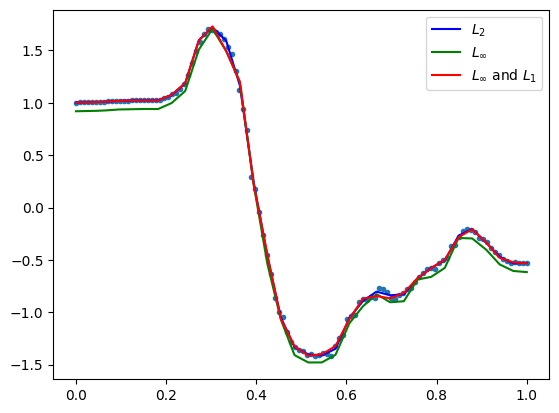

            max_dist       MSE      RMSE       MAE
LSQ         0.101143  0.000368  0.019184  0.010591
Max         0.087074  0.005914  0.076903  0.073405
Max and L1  0.087075  0.000648  0.025447  0.012673 

opt distance 0.08707440988854519
number of data points: 114


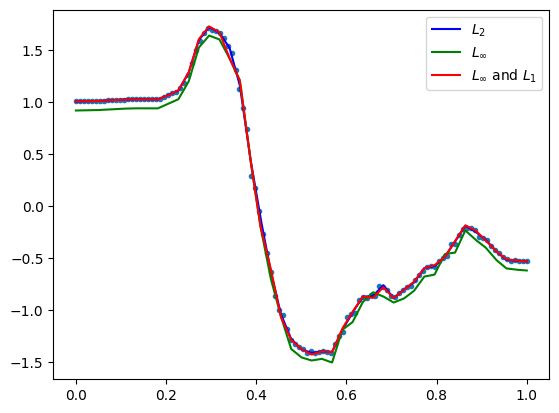

            max_dist       MSE      RMSE       MAE
LSQ         0.066729  0.000235  0.015346  0.009425
Max         0.050051  0.001974  0.044425  0.042686
Max and L1  0.050052  0.000382  0.019534  0.010652 

opt distance 0.05005107741987025
number of data points: 114


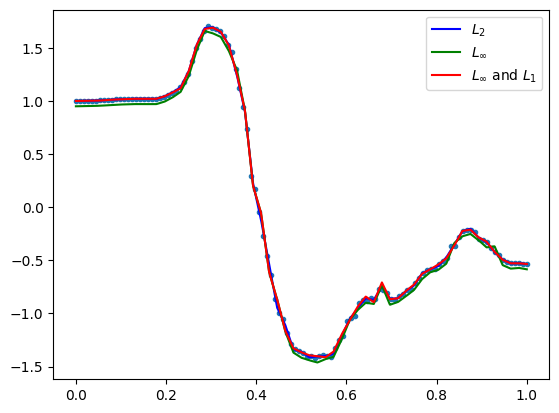

GestureMidAirD3 no. 41 len(ts): 167 ts processed: 19.71 %
[16, 33, 50, 66, 83]
            max_dist       MSE      RMSE       MAE
LSQ         0.116365  0.001055  0.032487  0.024256
Max         0.089995  0.004328  0.065791  0.059738
Max and L1  0.089996  0.001387  0.037248  0.026469 

opt distance 0.08999530785296694
number of data points: 167


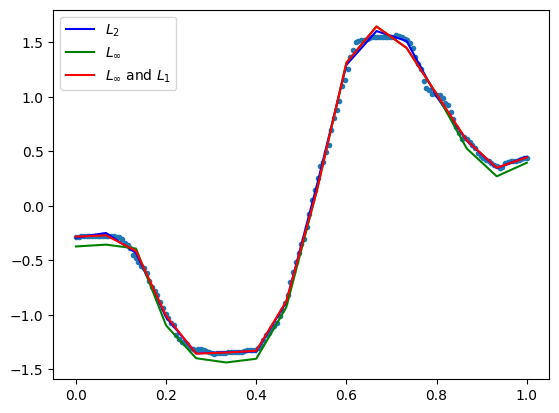

            max_dist       MSE      RMSE       MAE
LSQ         0.049616  0.000207  0.014385  0.010628
Max         0.032372  0.000578  0.024048  0.021859
Max and L1  0.032373  0.000243  0.015600  0.011088 

opt distance 0.03237188225919049
number of data points: 167


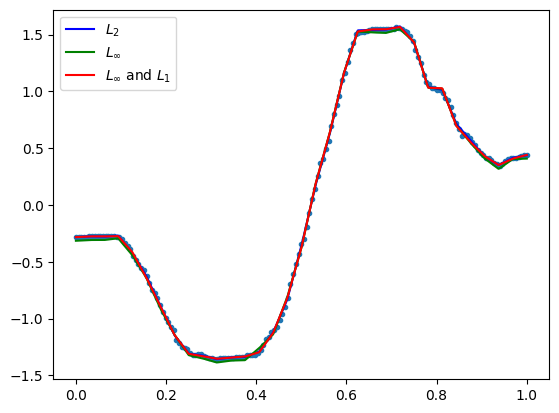

            max_dist       MSE      RMSE       MAE
LSQ         0.038571  0.000102  0.010123  0.007021
Max         0.030312  0.000603  0.024563  0.022979
Max and L1  0.030313  0.000136  0.011675  0.007372 

opt distance 0.030312321919330643
number of data points: 167


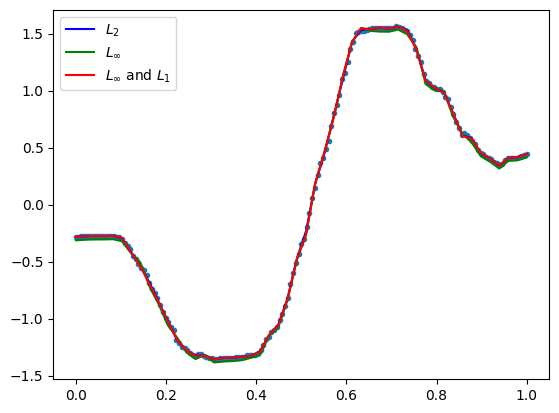

            max_dist       MSE      RMSE       MAE
LSQ         0.030348  0.000066  0.008094  0.005467
Max         0.021200  0.000310  0.017597  0.016531
Max and L1  0.021201  0.000083  0.009132  0.005662 

opt distance 0.021200421614099976
number of data points: 167


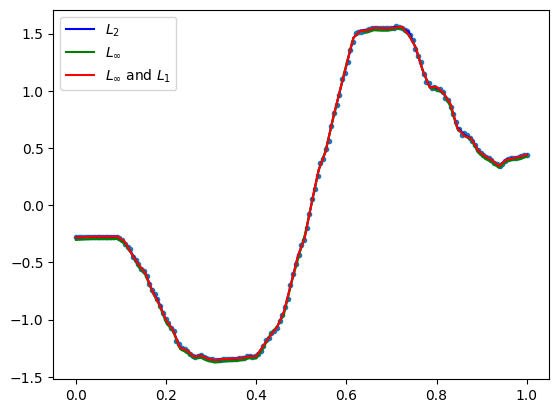

            max_dist       MSE      RMSE       MAE
LSQ         0.029653  0.000050  0.007085  0.004714
Max         0.019633  0.000291  0.017055  0.016248
Max and L1  0.019634  0.000065  0.008065  0.004642 

opt distance 0.019632768456775473
number of data points: 167


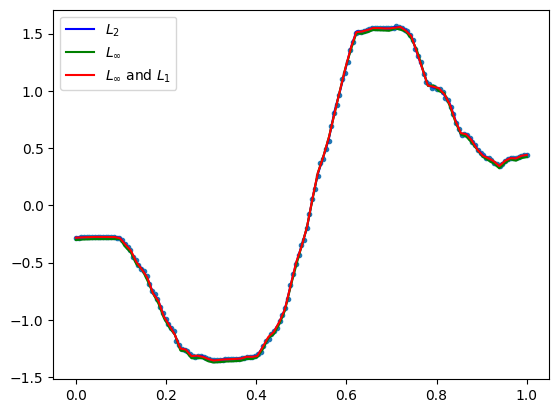

GestureMidAirD3 no. 42 len(ts): 90 ts processed: 20.19 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.163446  0.001433  0.037859  0.023869
Max         0.142105  0.010172  0.100855  0.090176
Max and L1  0.142106  0.001528  0.039089  0.023449 

opt distance 0.142104536523739
number of data points: 90


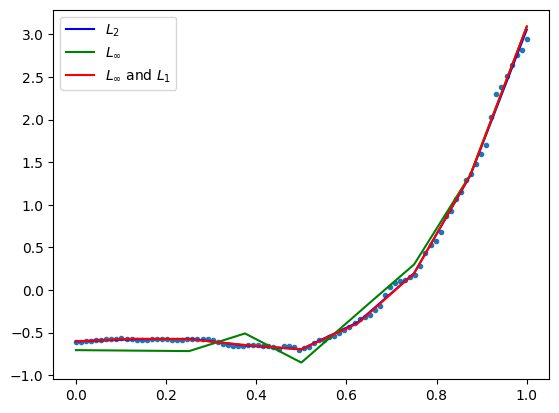

            max_dist       MSE      RMSE       MAE
LSQ         0.140129  0.000675  0.025987  0.016272
Max         0.095368  0.006323  0.079519  0.074826
Max and L1  0.095369  0.001120  0.033469  0.019228 

opt distance 0.09536833010348447
number of data points: 90


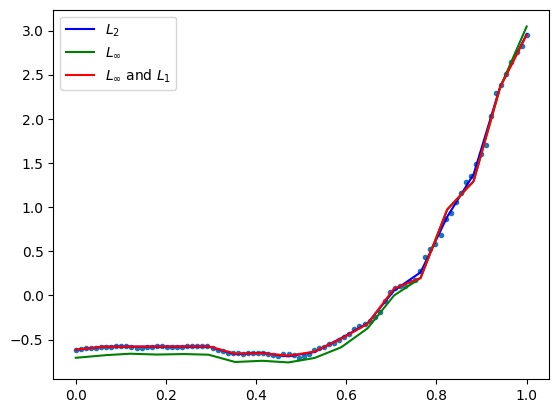

            max_dist       MSE      RMSE       MAE
LSQ         0.127209  0.000587  0.024225  0.014046
Max         0.095486  0.006599  0.081232  0.076880
Max and L1  0.095487  0.000991  0.031483  0.016359 

opt distance 0.0954859117808754
number of data points: 90


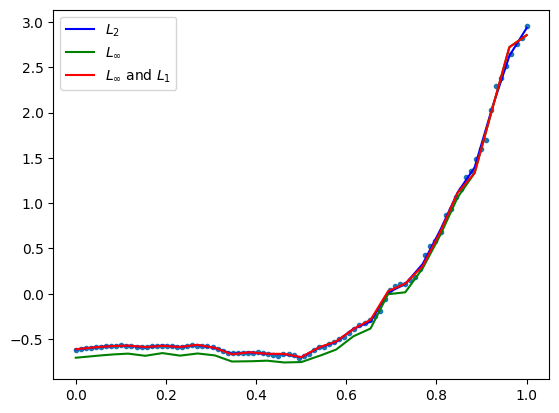

            max_dist       MSE      RMSE       MAE
LSQ         0.085558  0.000366  0.019142  0.010942
Max         0.070883  0.003677  0.060634  0.057049
Max and L1  0.070884  0.000620  0.024898  0.012651 

opt distance 0.07088273350610313
number of data points: 90


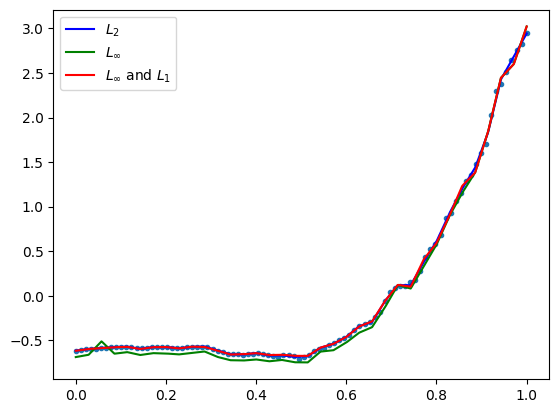

            max_dist       MSE      RMSE       MAE
LSQ         0.031350  0.000103  0.010159  0.006548
Max         0.027730  0.000591  0.024314  0.023258
Max and L1  0.027731  0.000141  0.011890  0.006816 

opt distance 0.027730431503483612
number of data points: 90


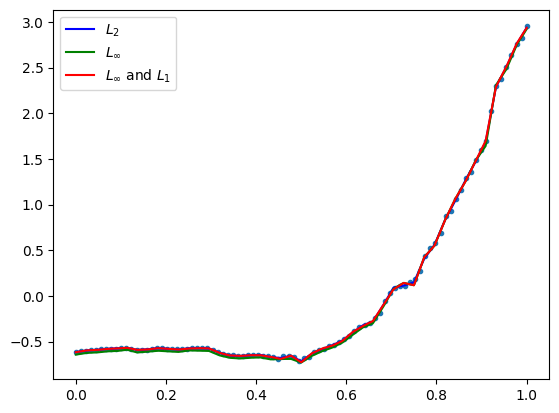

GestureMidAirD3 no. 43 len(ts): 129 ts processed: 20.669999999999998 %
[12, 25, 38, 51, 64]
            max_dist       MSE      RMSE       MAE
LSQ         0.268929  0.006864  0.082849  0.055169
Max         0.199971  0.022272  0.149240  0.135014
Max and L1  0.199972  0.007805  0.088344  0.061325 

opt distance 0.19997122690808744
number of data points: 129


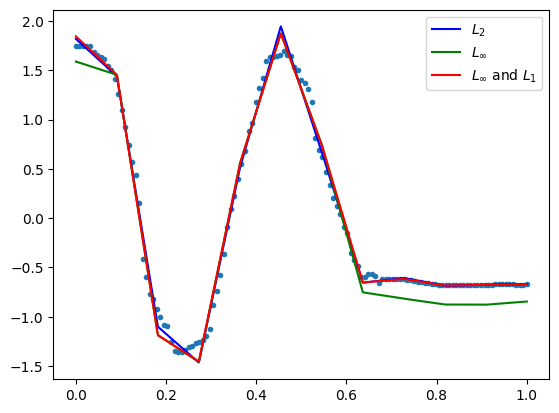

            max_dist       MSE      RMSE       MAE
LSQ         0.200666  0.001687  0.041071  0.024916
Max         0.143396  0.012609  0.112289  0.103686
Max and L1  0.143397  0.002342  0.048397  0.028210 

opt distance 0.14339572854094793
number of data points: 129


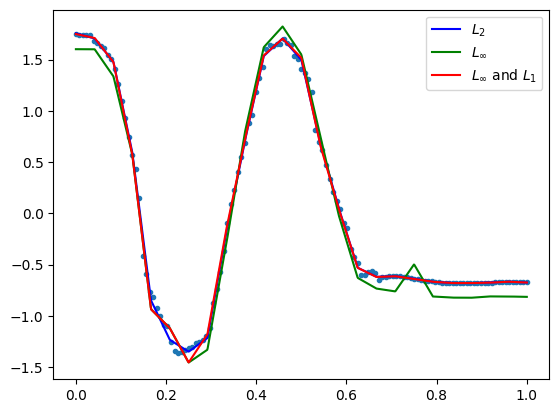

            max_dist       MSE      RMSE       MAE
LSQ         0.179340  0.000894  0.029896  0.017432
Max         0.118025  0.009912  0.099561  0.093660
Max and L1  0.118026  0.001229  0.035062  0.018862 

opt distance 0.11802489087228689
number of data points: 129


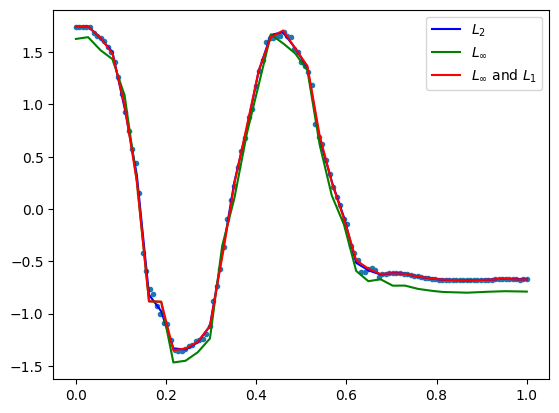

            max_dist       MSE      RMSE       MAE
LSQ         0.167461  0.000701  0.026482  0.014930
Max         0.097730  0.007574  0.087028  0.083902
Max and L1  0.097731  0.001075  0.032783  0.016910 

opt distance 0.0977303212356786
number of data points: 129


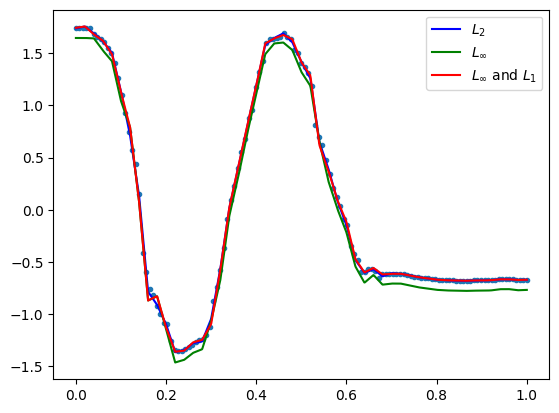

            max_dist       MSE      RMSE       MAE
LSQ         0.146855  0.000631  0.025112  0.014089
Max         0.099871  0.008093  0.089963  0.086253
Max and L1  0.099872  0.001059  0.032547  0.015686 

opt distance 0.09987093162348804
number of data points: 129


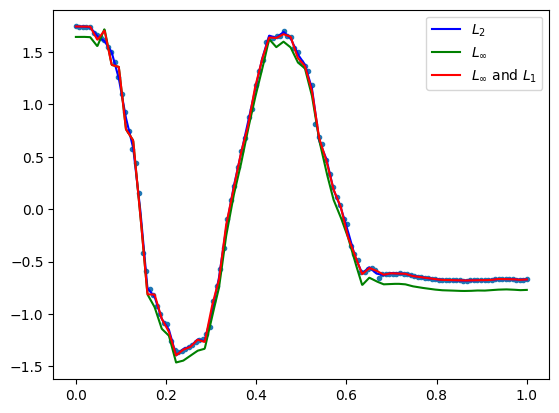

GestureMidAirD3 no. 44 len(ts): 116 ts processed: 21.15 %
[11, 23, 34, 46, 58]
            max_dist       MSE      RMSE       MAE
LSQ         0.063878  0.000761  0.027582  0.022808
Max         0.053990  0.001035  0.032167  0.027683
Max and L1  0.053991  0.000839  0.028961  0.023699 

opt distance 0.053989965277932095
number of data points: 116


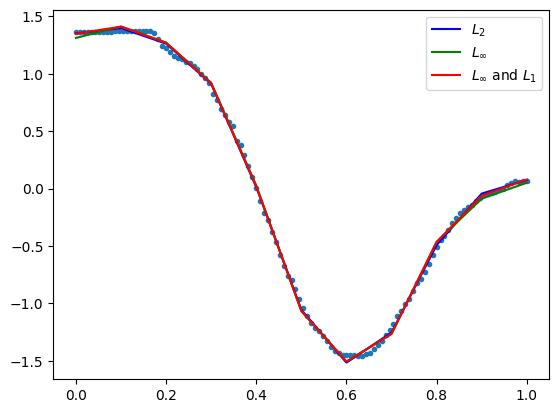

            max_dist       MSE      RMSE       MAE
LSQ         0.035008  0.000156  0.012499  0.009867
Max         0.028454  0.000409  0.020221  0.017947
Max and L1  0.028455  0.000180  0.013413  0.010226 

opt distance 0.028453902305910342
number of data points: 116


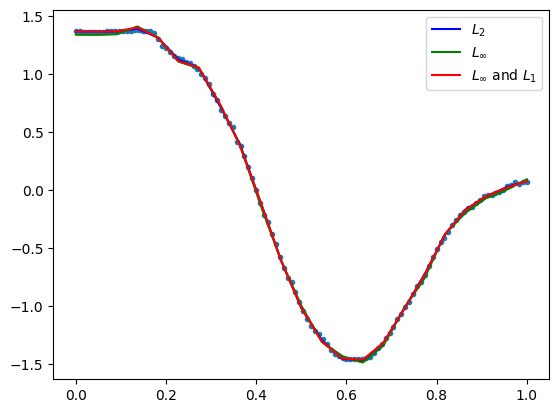

            max_dist       MSE      RMSE       MAE
LSQ         0.031739  0.000091  0.009542  0.006494
Max         0.025009  0.000358  0.018910  0.016780
Max and L1  0.025010  0.000116  0.010762  0.007046 
opt distance 0.025009318786550622
number of data points: 116


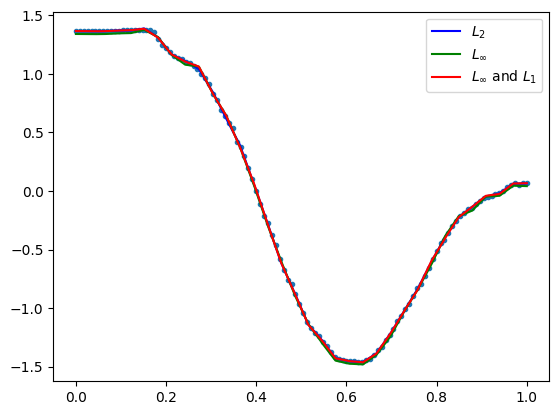

            max_dist       MSE      RMSE       MAE
LSQ         0.031434  0.000055  0.007443  0.005166
Max         0.024094  0.000407  0.020177  0.019108
Max and L1  0.024095  0.000085  0.009200  0.005618 

opt distance 0.024093639777339124
number of data points: 116


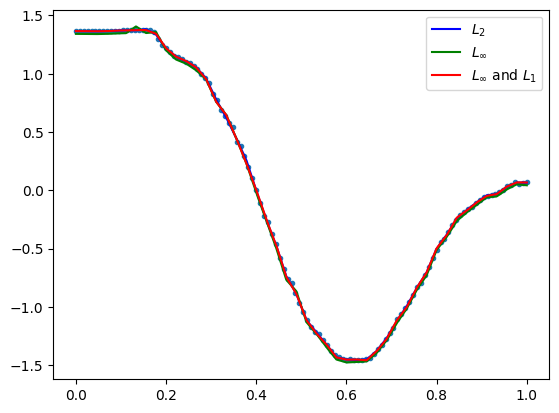

            max_dist       MSE      RMSE       MAE
LSQ         0.030895  0.000039  0.006267  0.004092
Max         0.022369  0.000371  0.019271  0.018344
Max and L1  0.022370  0.000062  0.007875  0.004313 

opt distance 0.0223688123234006
number of data points: 116


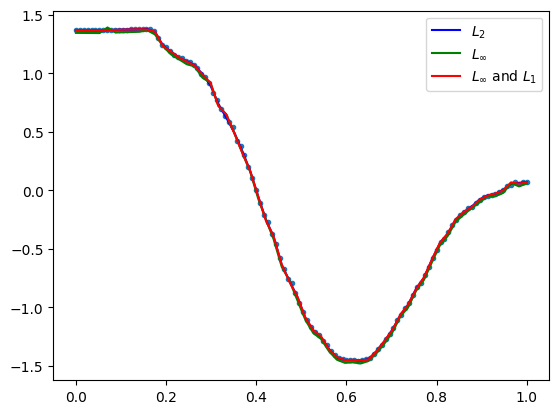

GestureMidAirD3 no. 45 len(ts): 82 ts processed: 21.63 %
[8, 16, 24, 32, 41]
            max_dist       MSE      RMSE       MAE
LSQ         0.412509  0.013272  0.115204  0.078491
Max         0.318741  0.035315  0.187923  0.158236
Max and L1  0.318742  0.027648  0.166278  0.129010 

opt distance 0.3187411226520014
number of data points: 82


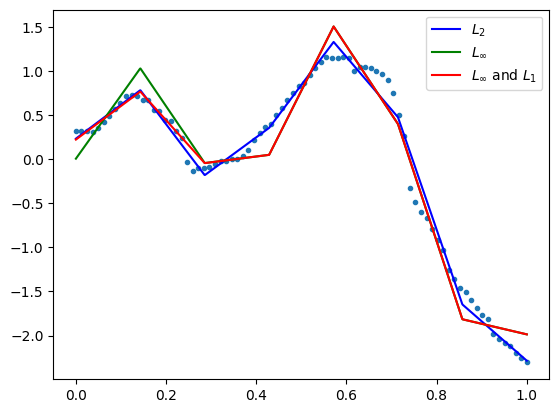

            max_dist       MSE      RMSE       MAE
LSQ         0.256936  0.005136  0.071668  0.048950
Max         0.212165  0.024266  0.155775  0.141325
Max and L1  0.212166  0.008151  0.090286  0.061783 

opt distance 0.21216455543643498
number of data points: 82


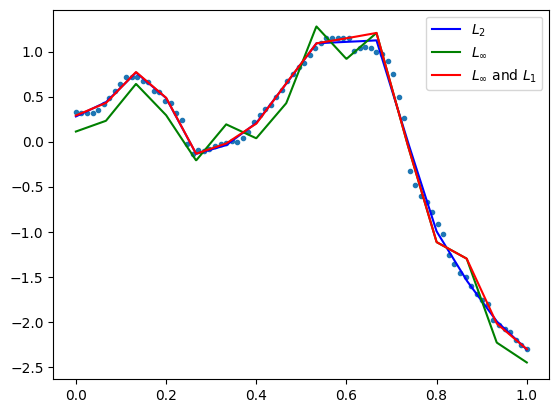

            max_dist       MSE      RMSE       MAE
LSQ         0.184646  0.001490  0.038604  0.025793
Max         0.131738  0.010784  0.103846  0.094717
Max and L1  0.131739  0.002874  0.053606  0.033509 

opt distance 0.13173843673279648
number of data points: 82


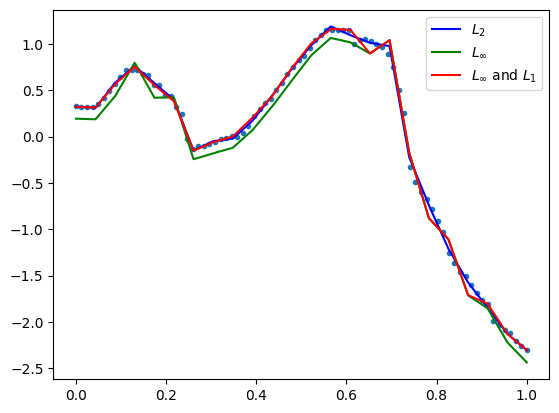

            max_dist       MSE      RMSE       MAE
LSQ         0.135180  0.000666  0.025814  0.017567
Max         0.086814  0.004962  0.070438  0.065058
Max and L1  0.086815  0.000916  0.030270  0.017489 

opt distance 0.0868136400809088
number of data points: 82


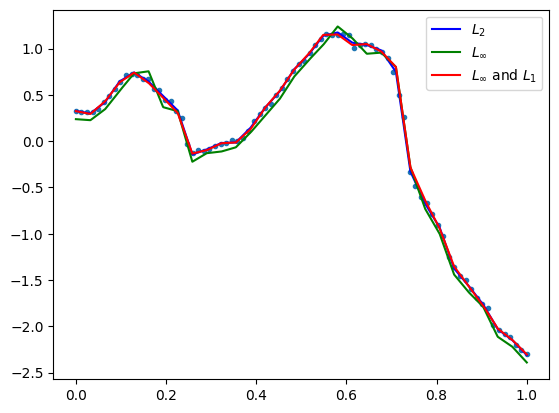

            max_dist       MSE      RMSE       MAE
LSQ         0.108360  0.000531  0.023049  0.014533
Max         0.080788  0.004946  0.070330  0.066772
Max and L1  0.080789  0.001020  0.031936  0.017560 

opt distance 0.0807875900158778
number of data points: 82


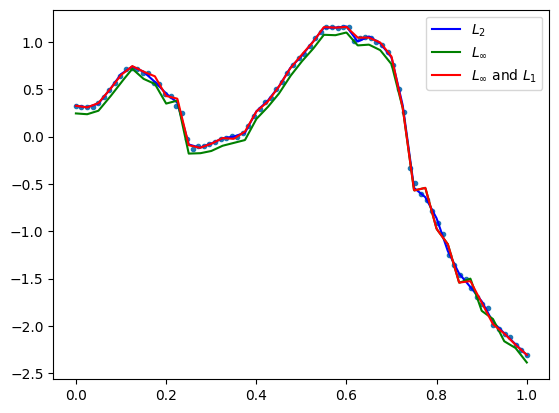

GestureMidAirD3 no. 46 len(ts): 115 ts processed: 22.12 %
[11, 23, 34, 46, 57]
            max_dist       MSE      RMSE       MAE
LSQ         0.116584  0.001509  0.038848  0.026018
Max         0.102294  0.005066  0.071173  0.063404
Max and L1  0.102295  0.001718  0.041450  0.026932 

opt distance 0.10229372876969645
number of data points: 115


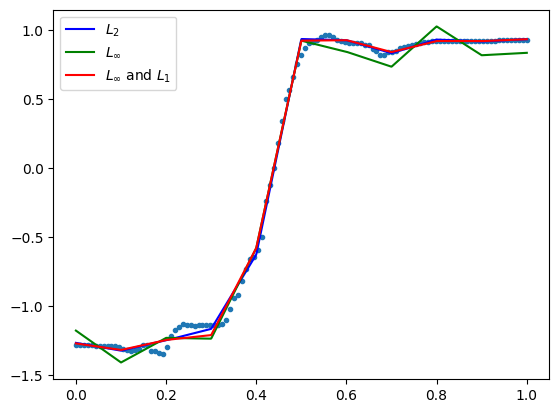

            max_dist       MSE      RMSE       MAE
LSQ         0.056268  0.000225  0.014991  0.008999
Max         0.045174  0.001314  0.036250  0.033467
Max and L1  0.045175  0.000240  0.015482  0.008782 

opt distance 0.04517364090584092
number of data points: 115


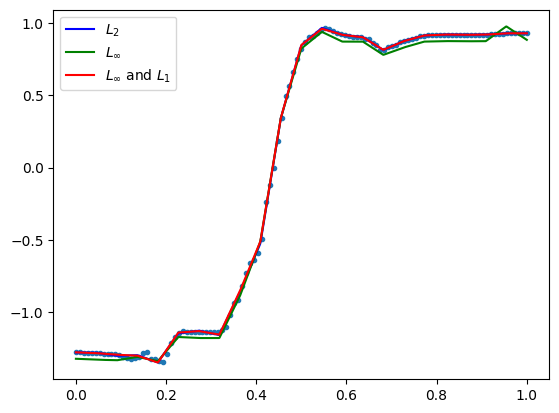

            max_dist       MSE      RMSE       MAE
LSQ         0.077532  0.000249  0.015775  0.008472
Max         0.064503  0.002970  0.054496  0.051389
Max and L1  0.064504  0.000346  0.018590  0.009319 

opt distance 0.06450349475902105
number of data points: 115


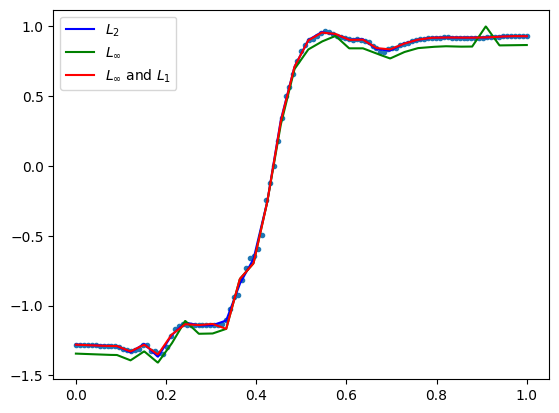

            max_dist       MSE      RMSE       MAE
LSQ         0.062777  0.000110  0.010495  0.005393
Max         0.044116  0.001574  0.039678  0.038386
Max and L1  0.044117  0.000165  0.012856  0.006037 

opt distance 0.044116157969215086
number of data points: 115


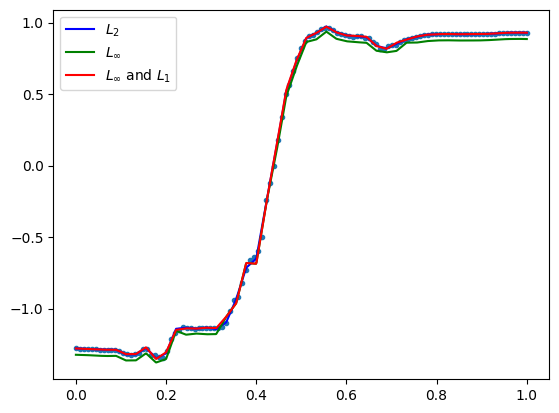

            max_dist       MSE      RMSE       MAE
LSQ         0.049888  0.000072  0.008477  0.004179
Max         0.030573  0.000793  0.028156  0.027310
Max and L1  0.030574  0.000102  0.010077  0.004509 

opt distance 0.03057312270932061
number of data points: 115


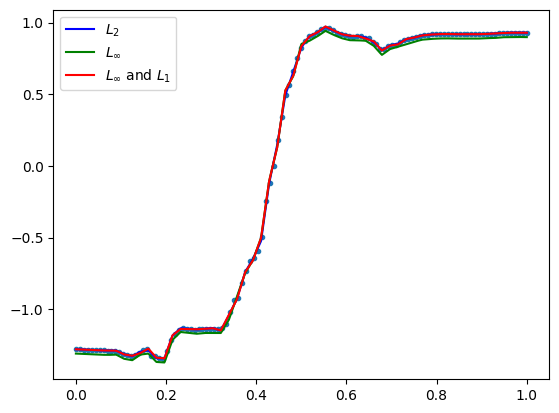

GestureMidAirD3 no. 47 len(ts): 114 ts processed: 22.6 %
[11, 22, 34, 45, 57]
            max_dist       MSE      RMSE       MAE
LSQ         0.095208  0.001223  0.034966  0.028552
Max         0.074732  0.002535  0.050348  0.045034
Max and L1  0.074733  0.001444  0.037994  0.029123 

opt distance 0.0747316691832911
number of data points: 114


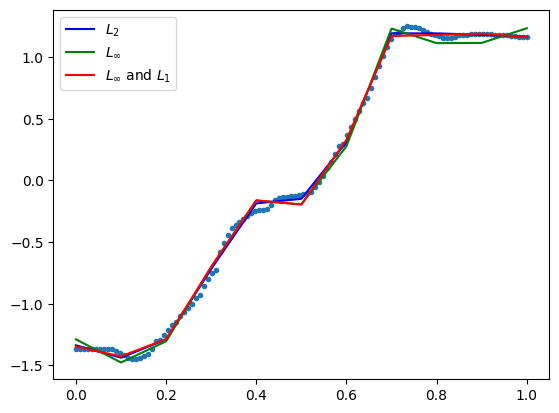

            max_dist       MSE      RMSE       MAE
LSQ         0.060590  0.000153  0.012351  0.008349
Max         0.039409  0.000952  0.030852  0.028384
Max and L1  0.039410  0.000264  0.016262  0.010673 

opt distance 0.03940931019319788
number of data points: 114


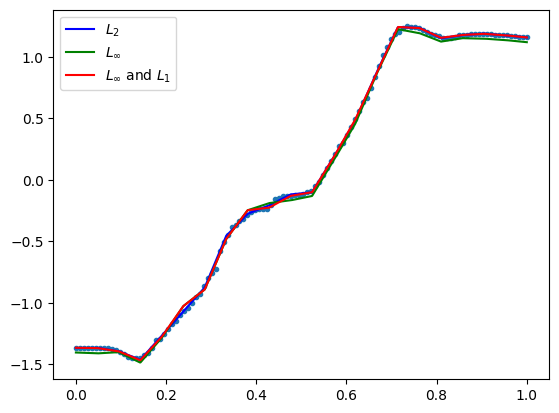

            max_dist       MSE      RMSE       MAE
LSQ         0.038447  0.000058  0.007629  0.004844
Max         0.025338  0.000426  0.020632  0.019183
Max and L1  0.025339  0.000071  0.008447  0.004729 

opt distance 0.02533765234924857
number of data points: 114


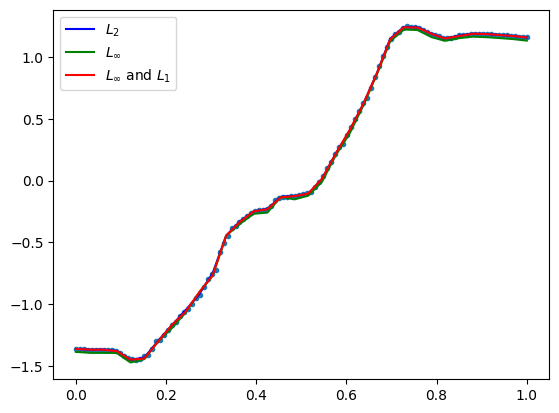

            max_dist       MSE      RMSE       MAE
LSQ         0.046235  0.000053  0.007299  0.004028
Max         0.032279  0.000767  0.027701  0.026242
Max and L1  0.032280  0.000085  0.009208  0.004547 

opt distance 0.032278730299648735
number of data points: 114


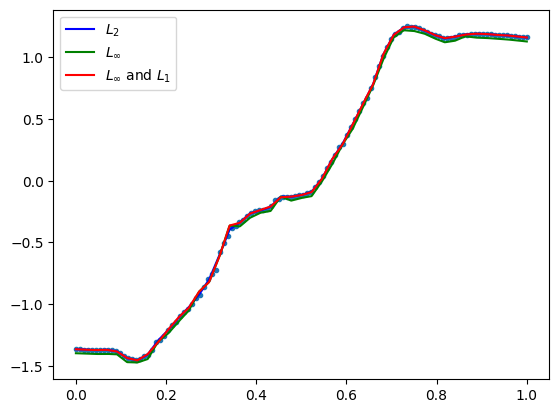

            max_dist       MSE      RMSE       MAE
LSQ         0.032452  0.000034  0.005865  0.003408
Max         0.022667  0.000411  0.020281  0.019507
Max and L1  0.022668  0.000057  0.007555  0.003671 

opt distance 0.022666712221111607
number of data points: 114


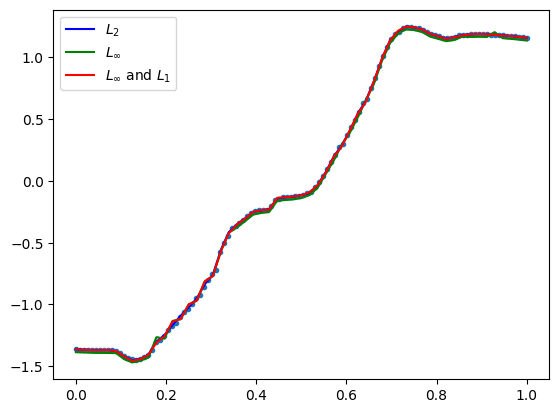

GestureMidAirD3 no. 48 len(ts): 223 ts processed: 23.080000000000002 %
[22, 44, 66, 89, 111]
            max_dist       MSE      RMSE       MAE
LSQ         0.141658  0.001559  0.039484  0.026838
Max         0.121810  0.008279  0.090990  0.083086
Max and L1  0.121811  0.001662  0.040765  0.026571 
opt distance 0.12180984011080759
number of data points: 223


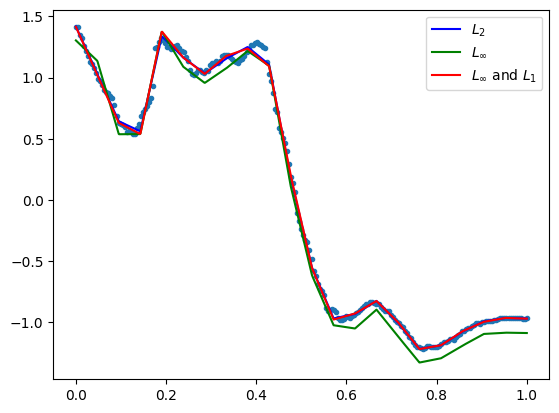

            max_dist       MSE      RMSE       MAE
LSQ         0.128008  0.000375  0.019365  0.012610
Max         0.094067  0.005795  0.076127  0.071560
Max and L1  0.094068  0.000452  0.021268  0.012815 

opt distance 0.09406680661805322
number of data points: 223


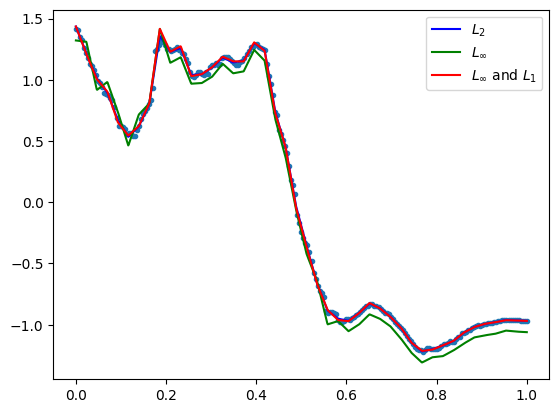

            max_dist       MSE      RMSE       MAE
LSQ         0.140994  0.000301  0.017359  0.010326
Max         0.093595  0.006430  0.080190  0.076856
Max and L1  0.093596  0.000484  0.021997  0.011200 

opt distance 0.09359515177381938
number of data points: 223


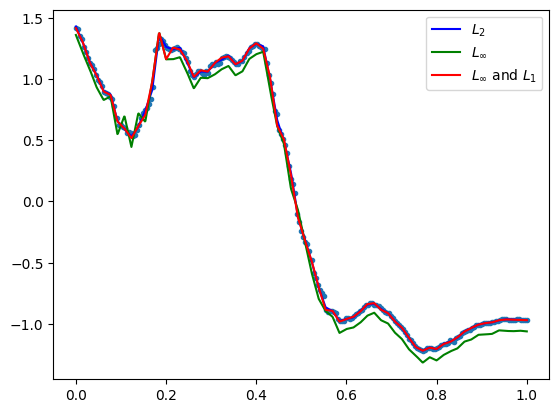

            max_dist       MSE      RMSE       MAE
LSQ         0.116659  0.000175  0.013241  0.007743
Max         0.073108  0.004302  0.065590  0.064149
Max and L1  0.073109  0.000252  0.015890  0.007569 

opt distance 0.0731076313192267
number of data points: 223


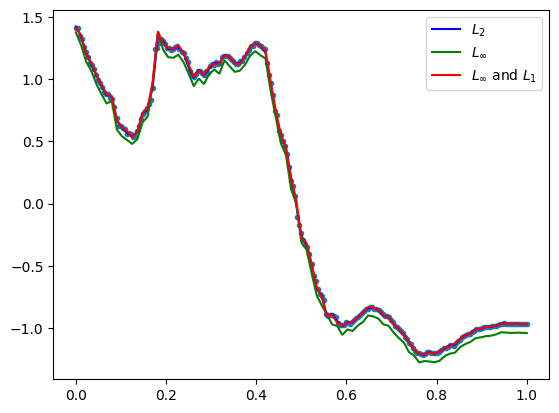

            max_dist       MSE      RMSE       MAE
LSQ         0.101719  0.000142  0.011928  0.006240
Max         0.071069  0.004219  0.064957  0.062981
Max and L1  0.071070  0.000312  0.017661  0.007601 

opt distance 0.07106893447954928
number of data points: 223


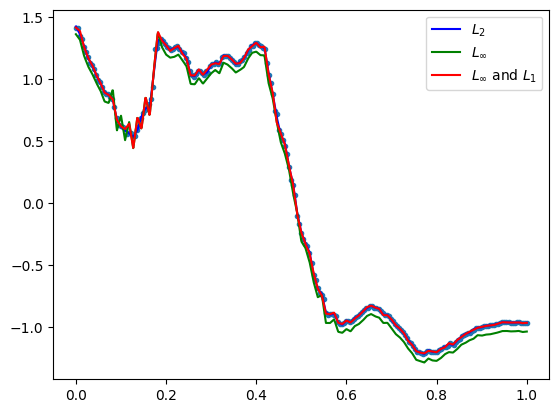

GestureMidAirD3 no. 49 len(ts): 226 ts processed: 23.56 %
[22, 45, 67, 90, 113]
            max_dist       MSE      RMSE       MAE
LSQ         0.311918  0.002408  0.049068  0.024318
Max         0.215059  0.033427  0.182830  0.173845
Max and L1  0.215060  0.004450  0.066710  0.034239 
opt distance 0.21505940063370532
number of data points: 226


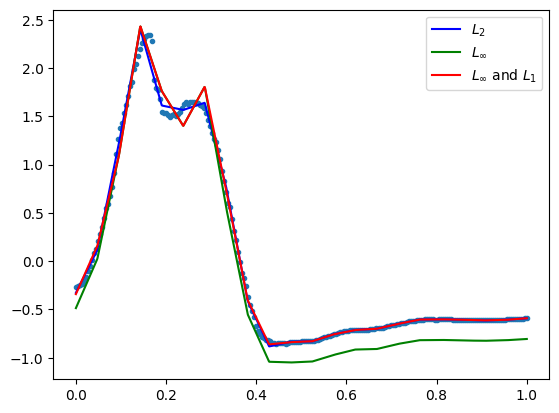

            max_dist       MSE      RMSE       MAE
LSQ         0.158903  0.000451  0.021238  0.009780
Max         0.125298  0.012037  0.109712  0.104529
Max and L1  0.125299  0.000526  0.022941  0.009718 

opt distance 0.12529814620198598
number of data points: 226


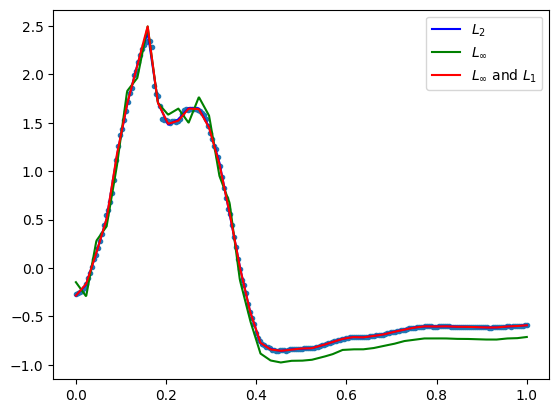

            max_dist       MSE      RMSE       MAE
LSQ         0.156958  0.000274  0.016539  0.006480
Max         0.116000  0.011579  0.107608  0.105391
Max and L1  0.116001  0.000466  0.021581  0.007859 

opt distance 0.11599982862326946
number of data points: 226


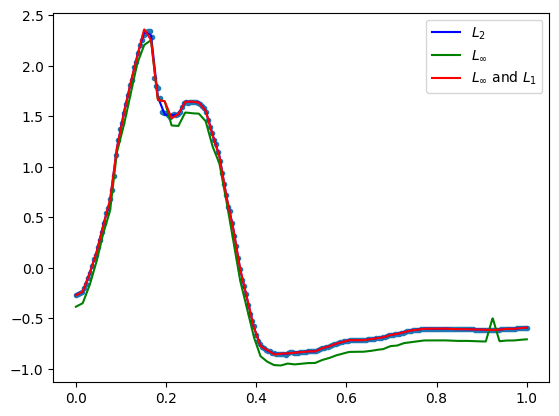

            max_dist       MSE      RMSE       MAE
LSQ         0.145950  0.000212  0.014556  0.005605
Max         0.101371  0.009072  0.095249  0.093594
Max and L1  0.101372  0.000370  0.019230  0.006590 

opt distance 0.10137074823292397
number of data points: 226


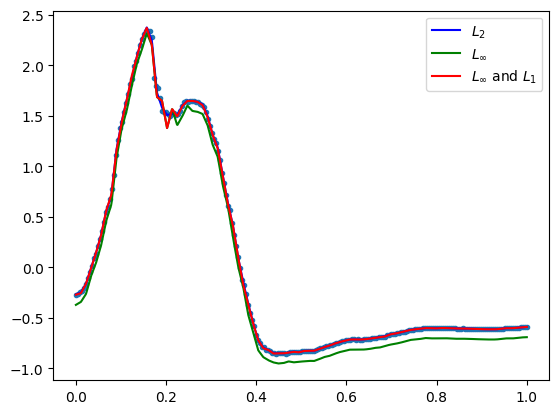

            max_dist       MSE      RMSE       MAE
LSQ         0.133885  0.000178  0.013351  0.004671
Max         0.086445  0.006804  0.082485  0.081409
Max and L1  0.086446  0.000332  0.018217  0.006184 

opt distance 0.08644527313918066
number of data points: 226


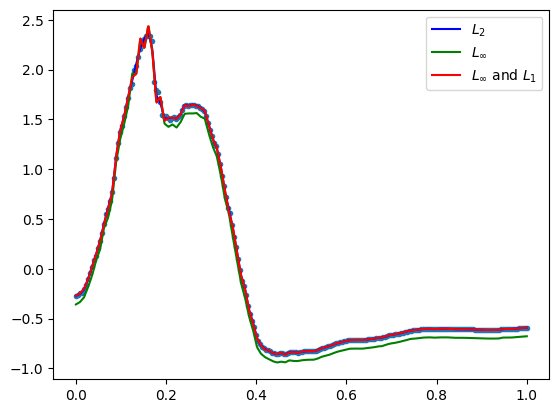

GestureMidAirD3 no. 50 len(ts): 90 ts processed: 24.04 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.463630  0.022080  0.148593  0.101259
Max         0.370819  0.054147  0.232694  0.207889
Max and L1  0.370820  0.043392  0.208307  0.177506 

opt distance 0.3708192805734954
number of data points: 90


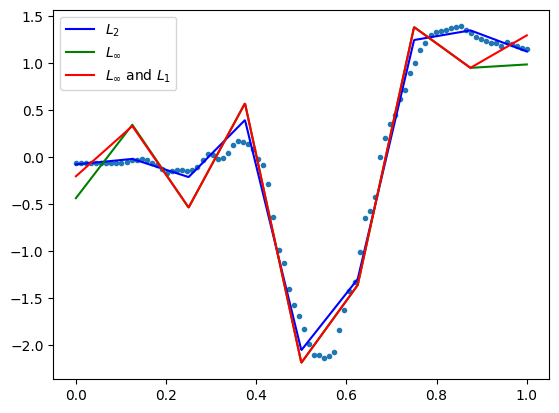

            max_dist       MSE      RMSE       MAE
LSQ         0.114805  0.001990  0.044610  0.033313
Max         0.105385  0.005142  0.071705  0.063026
Max and L1  0.105386  0.002338  0.048353  0.035123 

opt distance 0.1053850022758779
number of data points: 90


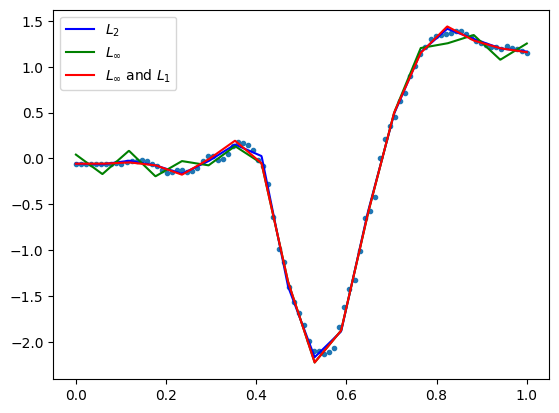

            max_dist       MSE      RMSE       MAE
LSQ         0.126004  0.001115  0.033394  0.022383
Max         0.107201  0.007995  0.089416  0.084579
Max and L1  0.107202  0.001476  0.038417  0.022324 

opt distance 0.10720110816882673
number of data points: 90


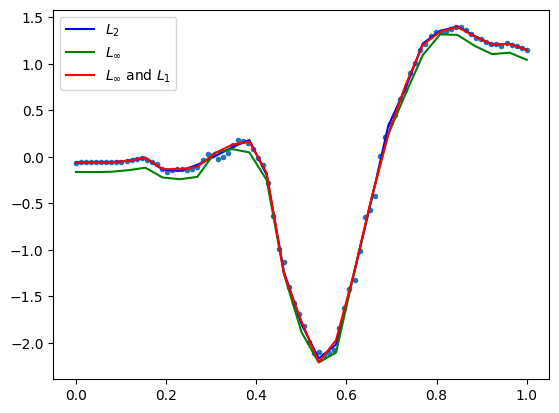

            max_dist       MSE      RMSE       MAE
LSQ         0.135397  0.000824  0.028704  0.016419
Max         0.098886  0.006657  0.081591  0.076673
Max and L1  0.098887  0.001302  0.036087  0.020594 

opt distance 0.0988864369877928
number of data points: 90


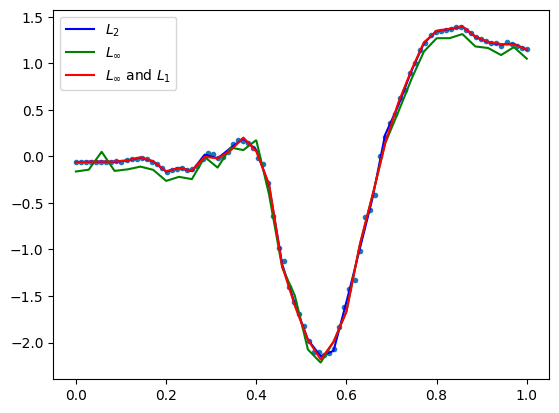

            max_dist       MSE      RMSE       MAE
LSQ         0.072260  0.000408  0.020204  0.012567
Max         0.052454  0.002109  0.045926  0.043576
Max and L1  0.052455  0.000590  0.024287  0.014700 

opt distance 0.052454181301484604
number of data points: 90


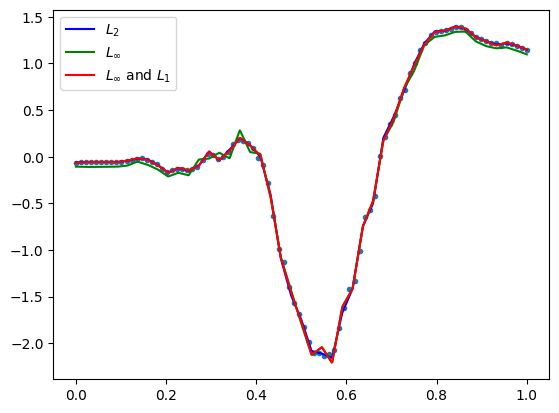

GestureMidAirD3 no. 51 len(ts): 280 ts processed: 24.52 %
[28, 56, 84, 112, 140]
            max_dist       MSE      RMSE       MAE
LSQ         0.135947  0.001577  0.039716  0.025967
Max         0.107804  0.006598  0.081225  0.073904
Max and L1  0.107805  0.001682  0.041012  0.026846 
opt distance 0.10780419028636158
number of data points: 280


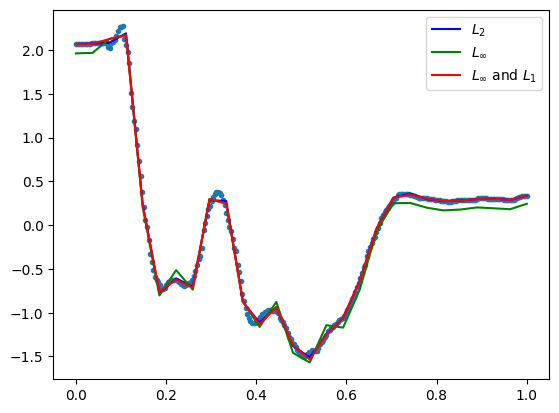

            max_dist       MSE      RMSE       MAE
LSQ         0.094746  0.000340  0.018445  0.011476
Max         0.082358  0.004774  0.069094  0.065370
Max and L1  0.082359  0.000389  0.019722  0.010978 

opt distance 0.08235836967170837
number of data points: 280


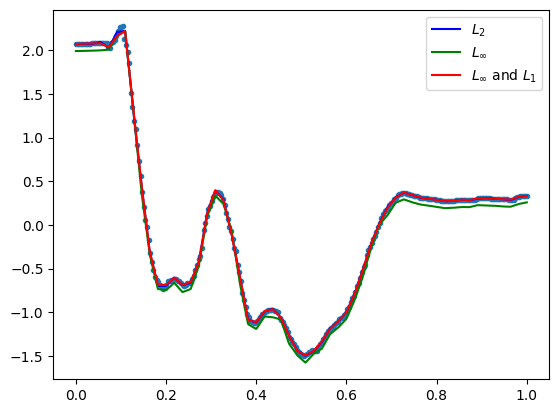

            max_dist       MSE      RMSE       MAE
LSQ         0.099921  0.000209  0.014469  0.007694
Max         0.082691  0.005504  0.074190  0.072100
Max and L1  0.082692  0.000364  0.019068  0.008761 

opt distance 0.08269147100904477
number of data points: 280


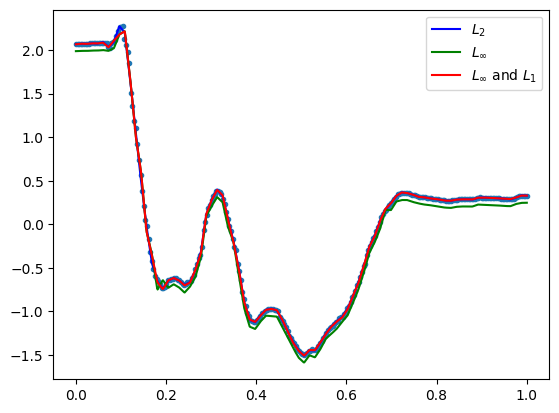

            max_dist       MSE      RMSE       MAE
LSQ         0.064651  0.000099  0.009951  0.005520
Max         0.045519  0.001635  0.040437  0.039089
Max and L1  0.045520  0.000120  0.010974  0.005178 

opt distance 0.04551889024486813
number of data points: 280


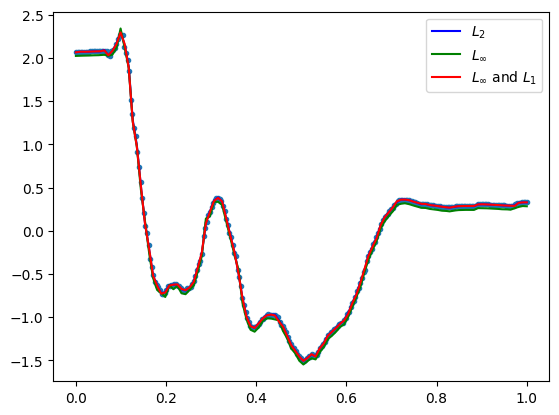

            max_dist       MSE      RMSE       MAE
LSQ         0.068200  0.000091  0.009516  0.004860
Max         0.047843  0.001970  0.044382  0.043472
Max and L1  0.047844  0.000131  0.011448  0.004759 
opt distance 0.047843167608157655
number of data points: 280


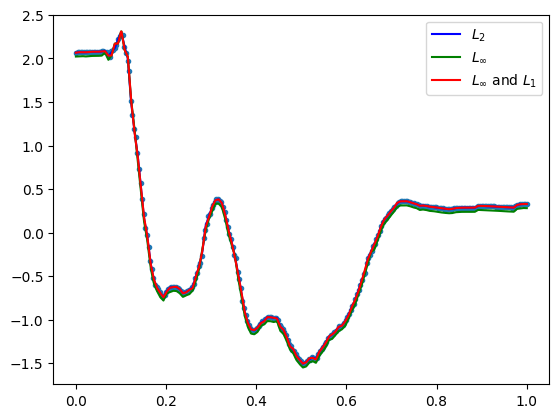

GestureMidAirD3 no. 52 len(ts): 168 ts processed: 25.0 %
[16, 33, 50, 67, 84]
            max_dist       MSE      RMSE       MAE
LSQ         0.086911  0.001382  0.037170  0.028083
Max         0.078077  0.002575  0.050744  0.045025
Max and L1  0.078078  0.001550  0.039375  0.029721 

opt distance 0.07807677442109964
number of data points: 168


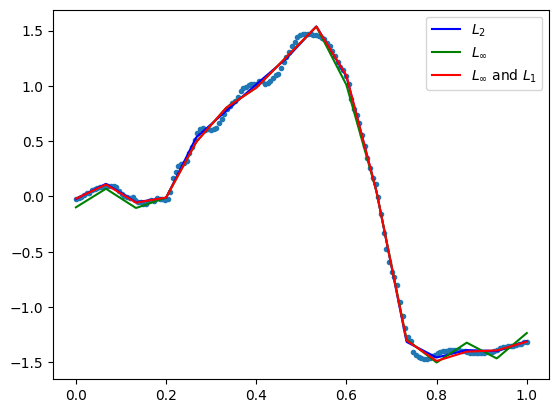

            max_dist       MSE      RMSE       MAE
LSQ         0.077377  0.000377  0.019422  0.013233
Max         0.056144  0.001934  0.043983  0.040908
Max and L1  0.056145  0.000445  0.021104  0.013921 

opt distance 0.056143605490187015
number of data points: 168


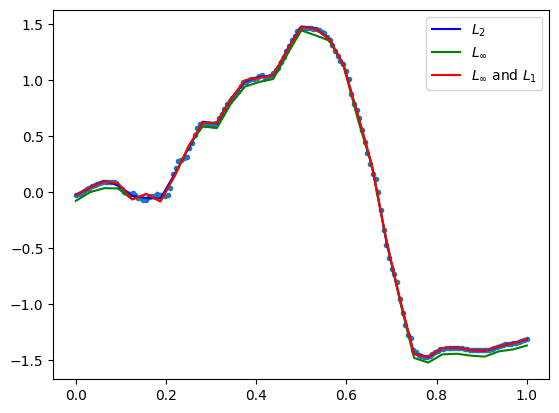

            max_dist       MSE      RMSE       MAE
LSQ         0.038947  0.000108  0.010387  0.007012
Max         0.027809  0.000484  0.022002  0.020279
Max and L1  0.027810  0.000131  0.011451  0.007230 

opt distance 0.02780929553645415
number of data points: 168


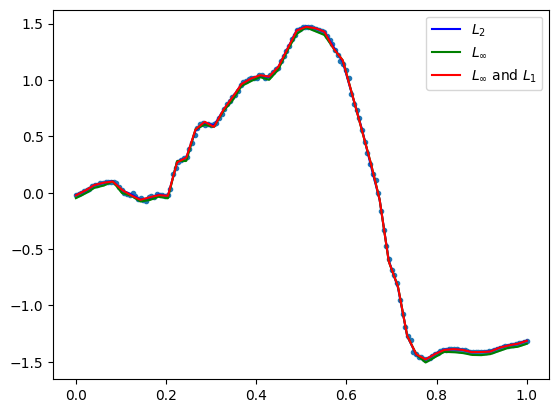

            max_dist       MSE      RMSE       MAE
LSQ         0.036083  0.000073  0.008516  0.005534
Max         0.026972  0.000501  0.022390  0.020801
Max and L1  0.026973  0.000089  0.009424  0.005301 

opt distance 0.026971510557779865
number of data points: 168


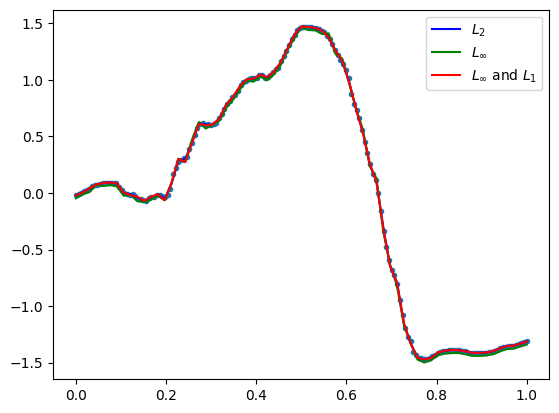

            max_dist       MSE      RMSE       MAE
LSQ         0.027983  0.000031  0.005581  0.003622
Max         0.019521  0.000275  0.016591  0.015539
Max and L1  0.019522  0.000048  0.006955  0.003727 

opt distance 0.019520716289150232
number of data points: 168


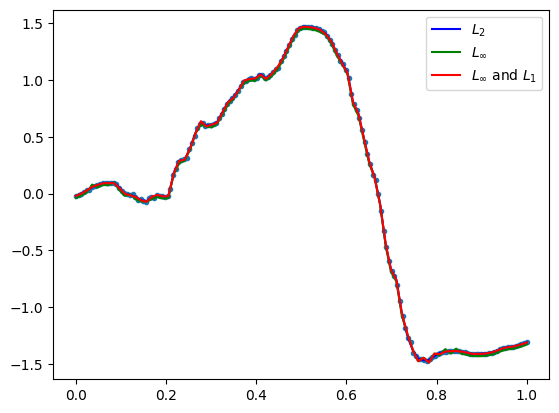

GestureMidAirD3 no. 53 len(ts): 115 ts processed: 25.480000000000004 %
[11, 23, 34, 46, 57]
            max_dist       MSE      RMSE       MAE
LSQ         0.273696  0.005548  0.074486  0.055983
Max         0.199572  0.018744  0.136908  0.120420
Max and L1  0.199573  0.006700  0.081856  0.061243 

opt distance 0.19957184661003244
number of data points: 115


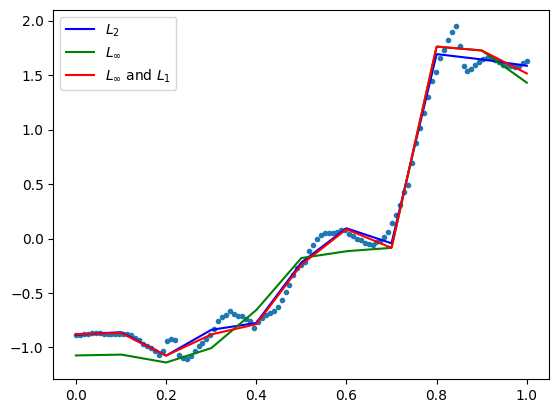

            max_dist       MSE      RMSE       MAE
LSQ         0.203568  0.001443  0.037981  0.023382
Max         0.141244  0.013031  0.114153  0.106511
Max and L1  0.141245  0.003575  0.059791  0.037959 

opt distance 0.14124447384226047
number of data points: 115


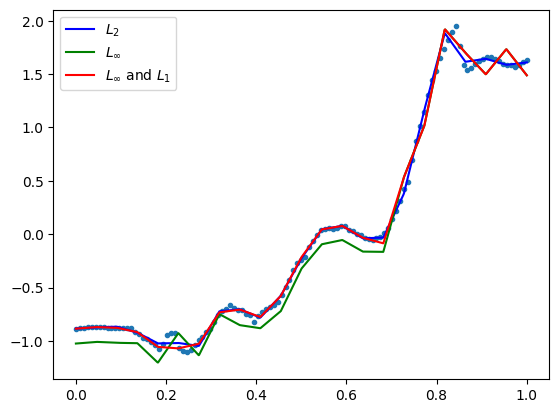

            max_dist       MSE      RMSE       MAE
LSQ         0.120103  0.000581  0.024107  0.013784
Max         0.101549  0.007416  0.086115  0.082125
Max and L1  0.101550  0.000862  0.029354  0.015635 

opt distance 0.10154889740581634
number of data points: 115


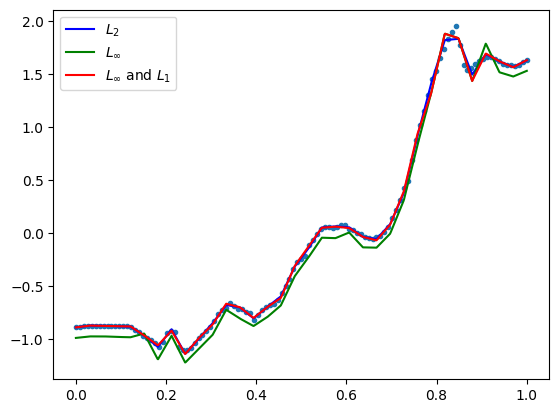

            max_dist       MSE      RMSE       MAE
LSQ         0.057225  0.000216  0.014699  0.009553
Max         0.043536  0.001259  0.035477  0.033066
Max and L1  0.043537  0.000306  0.017480  0.010447 
opt distance 0.043535662772315464
number of data points: 115


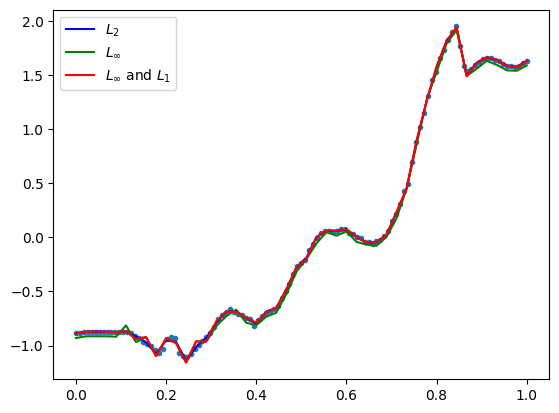

            max_dist       MSE      RMSE       MAE
LSQ         0.032593  0.000102  0.010116  0.006865
Max         0.026158  0.000489  0.022117  0.020758
Max and L1  0.026159  0.000144  0.012005  0.007517 

opt distance 0.026158335935472787
number of data points: 115


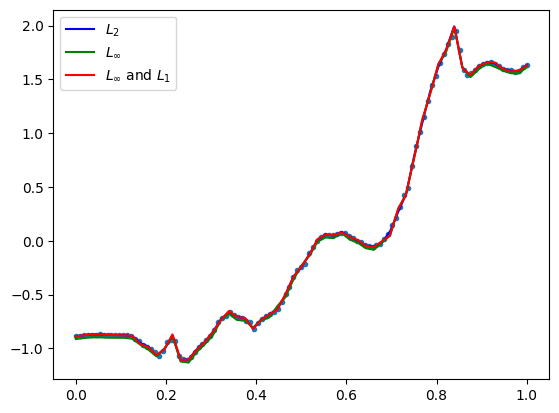

GestureMidAirD3 no. 54 len(ts): 114 ts processed: 25.96 %
[11, 22, 34, 45, 57]
            max_dist       MSE      RMSE       MAE
LSQ         0.234485  0.006166  0.078526  0.063277
Max         0.168302  0.012250  0.110681  0.099038
Max and L1  0.168303  0.008241  0.090778  0.075271 

opt distance 0.16830174420683308
number of data points: 114


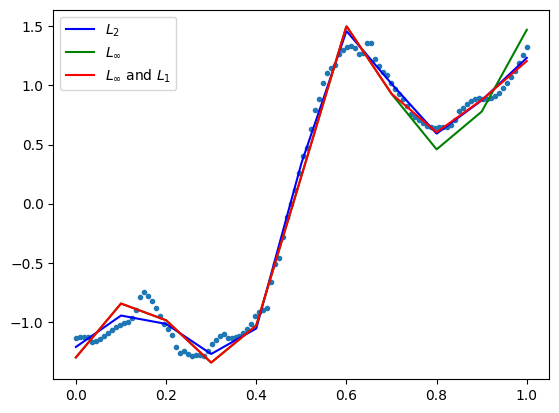

            max_dist       MSE      RMSE       MAE
LSQ         0.087784  0.000875  0.029580  0.022883
Max         0.062950  0.001850  0.043014  0.037944
Max and L1  0.062951  0.001142  0.033786  0.026595 

opt distance 0.06295030748392197
number of data points: 114


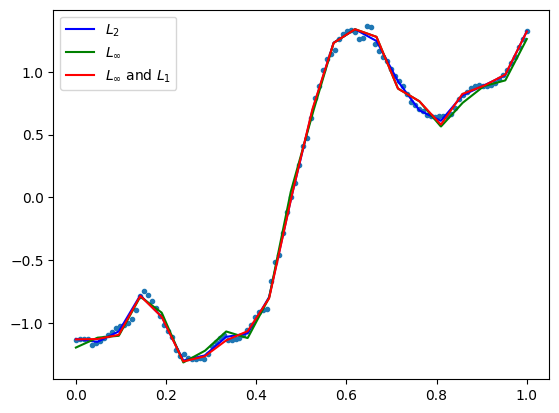

            max_dist       MSE      RMSE       MAE
LSQ         0.083188  0.000402  0.020038  0.013958
Max         0.058207  0.002331  0.048284  0.045364
Max and L1  0.058208  0.000529  0.023001  0.014787 

opt distance 0.058206844964378404
number of data points: 114


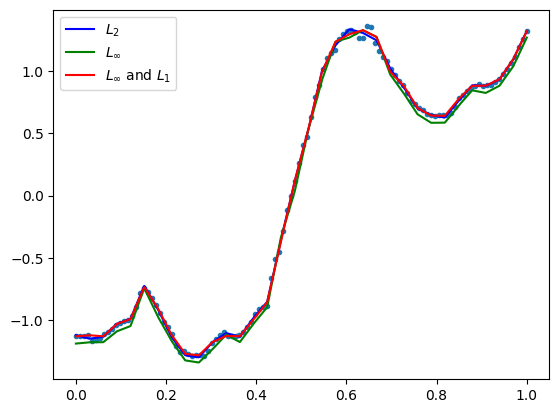

            max_dist       MSE      RMSE       MAE
LSQ         0.084571  0.000358  0.018918  0.012560
Max         0.059456  0.002371  0.048697  0.044944
Max and L1  0.059457  0.000478  0.021865  0.012929 
opt distance 0.05945589829717837
number of data points: 114


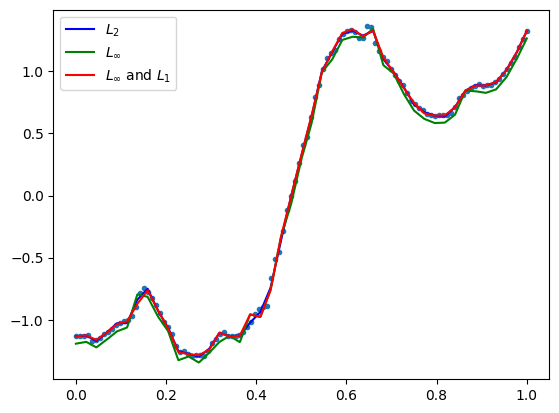

            max_dist       MSE      RMSE       MAE
LSQ         0.054262  0.000220  0.014849  0.009520
Max         0.044883  0.001459  0.038192  0.035753
Max and L1  0.044884  0.000404  0.020107  0.012463 

opt distance 0.04488262836594842
number of data points: 114


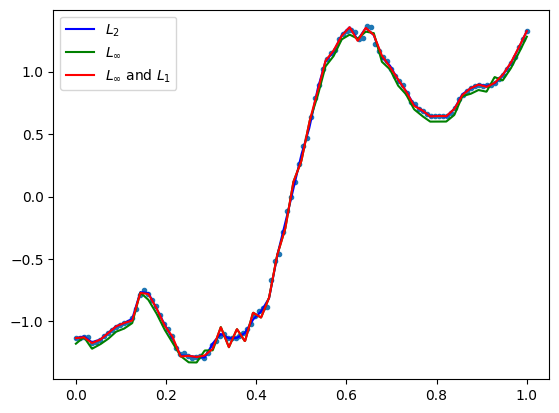

GestureMidAirD3 no. 55 len(ts): 115 ts processed: 26.44 %
[11, 23, 34, 46, 57]
            max_dist       MSE      RMSE       MAE
LSQ         0.181252  0.002297  0.047928  0.029093
Max         0.144694  0.009801  0.099001  0.087548
Max and L1  0.144695  0.003456  0.058791  0.037870 

opt distance 0.14469429644428392
number of data points: 115


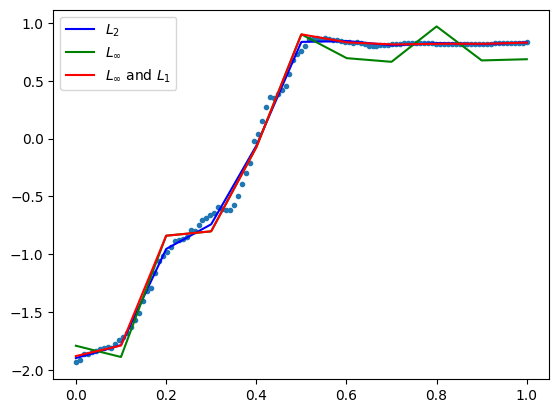

            max_dist       MSE      RMSE       MAE
LSQ         0.072164  0.000335  0.018315  0.011286
Max         0.056116  0.001955  0.044212  0.040841
Max and L1  0.056117  0.000458  0.021391  0.012920 

opt distance 0.056116388443335066
number of data points: 115


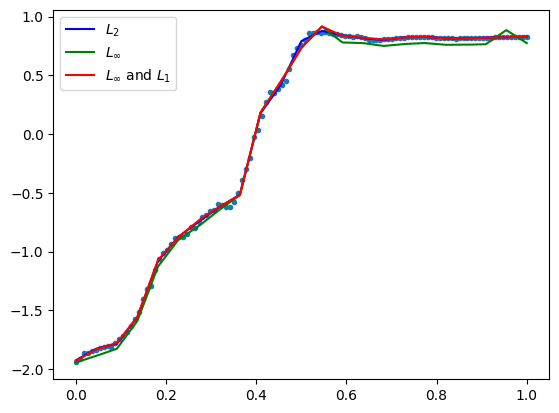

            max_dist       MSE      RMSE       MAE
LSQ         0.041279  0.000150  0.012264  0.007817
Max         0.030889  0.000670  0.025884  0.024223
Max and L1  0.030890  0.000181  0.013440  0.008006 

opt distance 0.03088882563563251
number of data points: 115


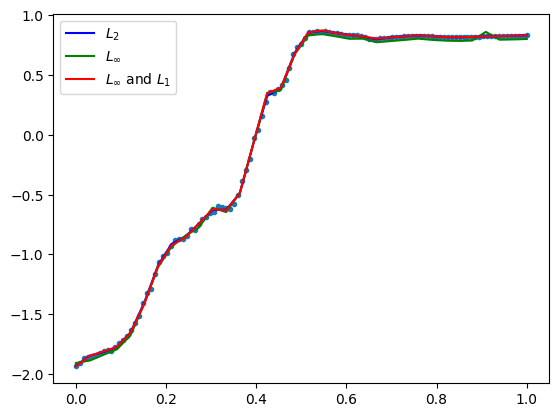

            max_dist       MSE      RMSE       MAE
LSQ         0.043200  0.000115  0.010722  0.006341
Max         0.029790  0.000679  0.026056  0.024831
Max and L1  0.029791  0.000141  0.011859  0.006502 

opt distance 0.029789652277966705
number of data points: 115


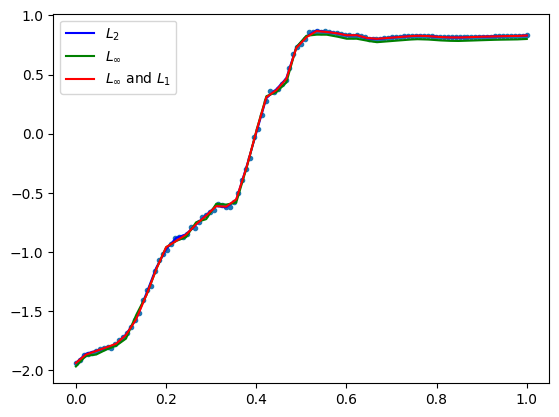

            max_dist       MSE      RMSE       MAE
LSQ         0.037363  0.000077  0.008765  0.005177
Max         0.026019  0.000529  0.022990  0.021891
Max and L1  0.026020  0.000127  0.011254  0.006469 

opt distance 0.026018707768559163
number of data points: 115


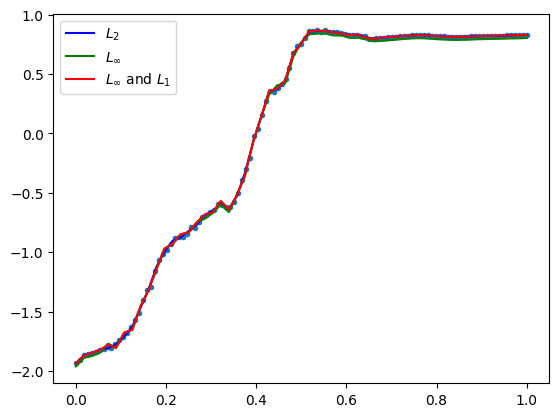

GestureMidAirD3 no. 56 len(ts): 173 ts processed: 26.919999999999998 %
[17, 34, 51, 69, 86]
            max_dist       MSE      RMSE       MAE
LSQ         0.114215  0.000912  0.030205  0.020870
Max         0.084040  0.003435  0.058611  0.052735
Max and L1  0.084041  0.001146  0.033859  0.022814 
opt distance 0.08403989753879182
number of data points: 173


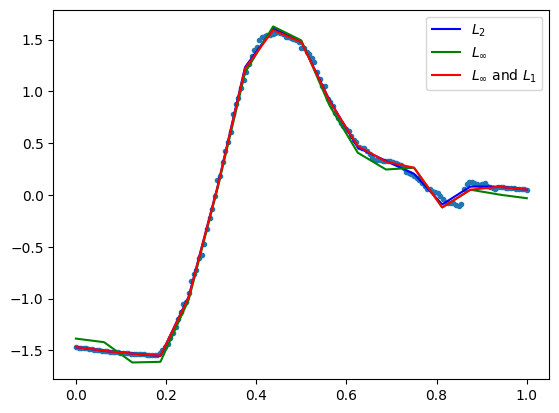

            max_dist       MSE      RMSE       MAE
LSQ         0.053927  0.000226  0.015043  0.009920
Max         0.046335  0.001324  0.036390  0.033709
Max and L1  0.046336  0.000250  0.015822  0.009650 

opt distance 0.046334679609546986
number of data points: 173


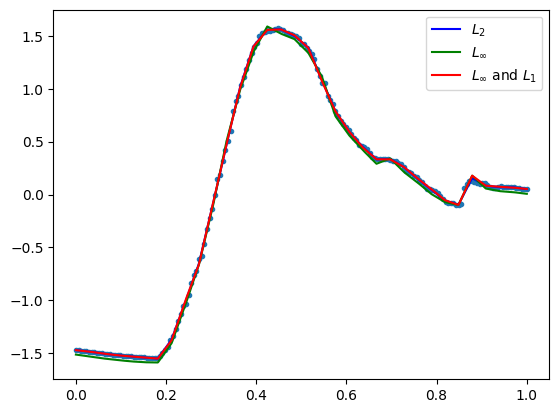

            max_dist       MSE      RMSE       MAE
LSQ         0.071839  0.000190  0.013768  0.008417
Max         0.050539  0.001724  0.041526  0.038473
Max and L1  0.050540  0.000336  0.018320  0.010602 

opt distance 0.05053872244884858
number of data points: 173


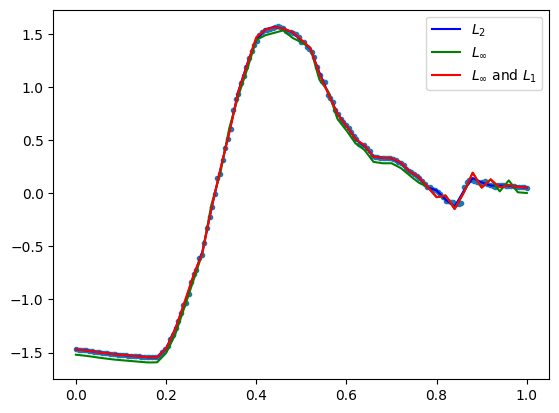

            max_dist       MSE      RMSE       MAE
LSQ         0.042834  0.000086  0.009277  0.005407
Max         0.028808  0.000606  0.024616  0.023315
Max and L1  0.028809  0.000105  0.010239  0.005594 

opt distance 0.02880836338673587
number of data points: 173


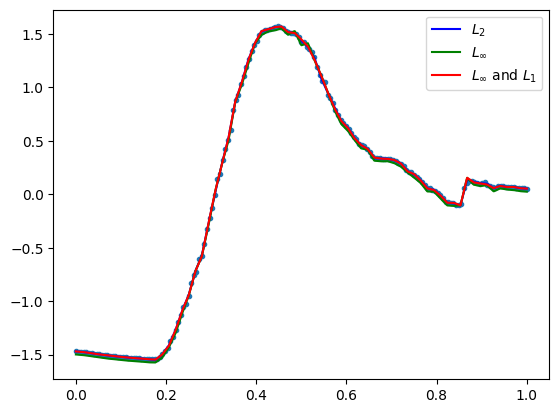

            max_dist       MSE      RMSE       MAE
LSQ         0.046826  0.000076  0.008714  0.004770
Max         0.032570  0.000827  0.028757  0.027441
Max and L1  0.032571  0.000109  0.010452  0.005285 

opt distance 0.03256998447380635
number of data points: 173


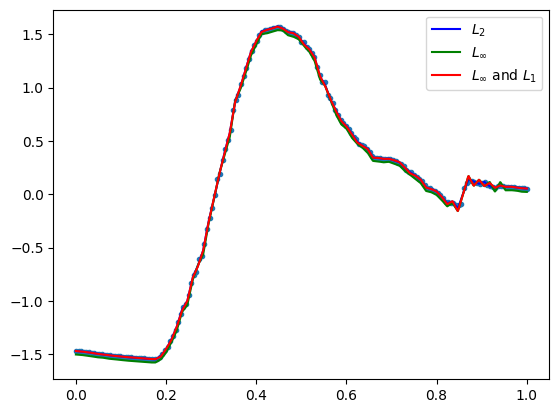

GestureMidAirD3 no. 57 len(ts): 239 ts processed: 27.400000000000002 %
[23, 47, 71, 95, 119]
            max_dist       MSE      RMSE       MAE
LSQ         0.113707  0.001436  0.037899  0.027915
Max         0.097174  0.004435  0.066599  0.059152
Max and L1  0.097175  0.001582  0.039775  0.028483 
opt distance 0.0971741511449626
number of data points: 239


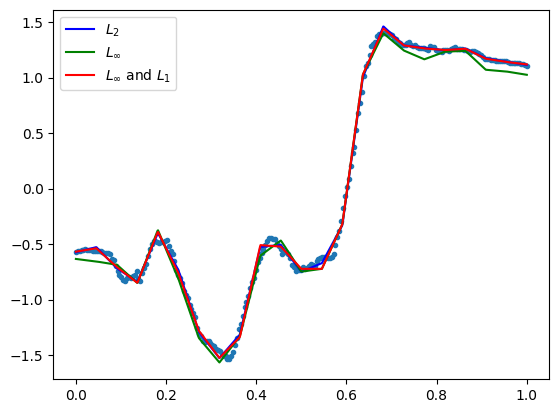

            max_dist       MSE      RMSE       MAE
LSQ         0.080263  0.000251  0.015828  0.011125
Max         0.053386  0.001632  0.040400  0.037179
Max and L1  0.053387  0.000299  0.017302  0.011086 

opt distance 0.05338583440913287
number of data points: 239


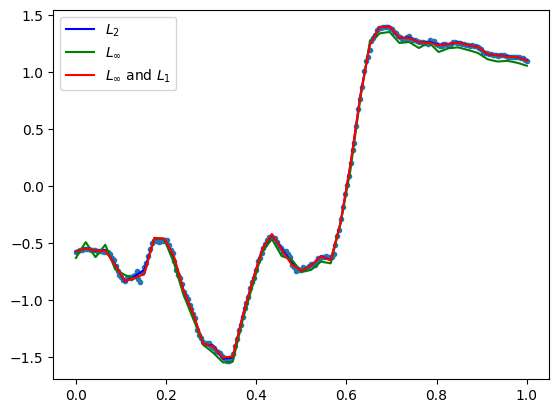

            max_dist       MSE      RMSE       MAE
LSQ         0.041168  0.000080  0.008966  0.006594
Max         0.028057  0.000470  0.021673  0.019764
Max and L1  0.028058  0.000097  0.009863  0.006321 

opt distance 0.028056709724006878
number of data points: 239


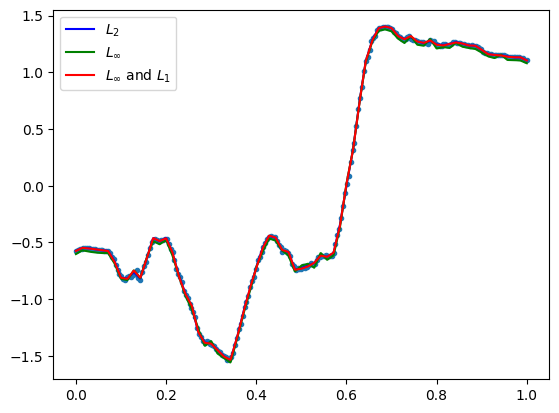

            max_dist       MSE      RMSE       MAE
LSQ         0.047082  0.000078  0.008815  0.005991
Max         0.035074  0.000855  0.029240  0.027698
Max and L1  0.035075  0.000125  0.011190  0.006229 

opt distance 0.035074189846811335
number of data points: 239


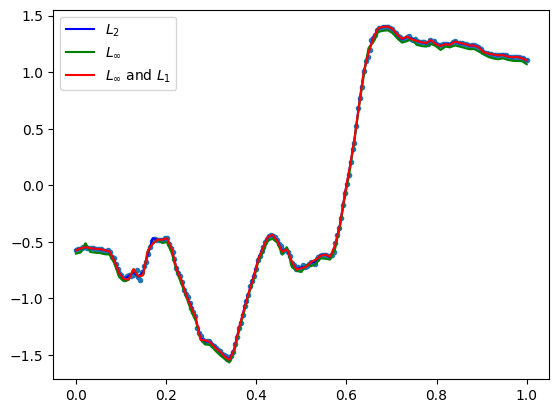

            max_dist       MSE      RMSE       MAE
LSQ         0.024709  0.000052  0.007187  0.005032
Max         0.019043  0.000254  0.015948  0.014859
Max and L1  0.019044  0.000071  0.008417  0.005123 
opt distance 0.01904346562777723
number of data points: 239


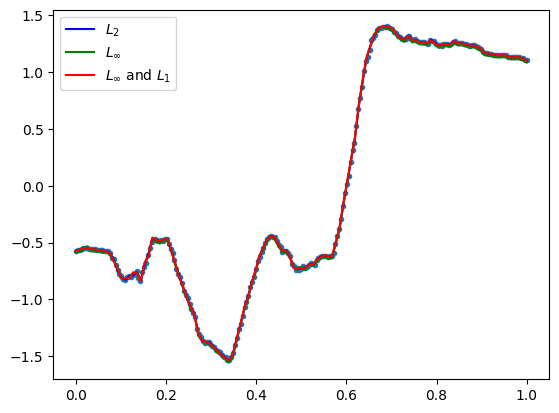

GestureMidAirD3 no. 58 len(ts): 240 ts processed: 27.88 %
[24, 48, 72, 96, 120]
            max_dist       MSE      RMSE       MAE
LSQ         0.371886  0.008829  0.093965  0.069063
Max         0.256597  0.031157  0.176514  0.156403
Max and L1  0.256598  0.010981  0.104791  0.075781 

opt distance 0.2565966432060889
number of data points: 240


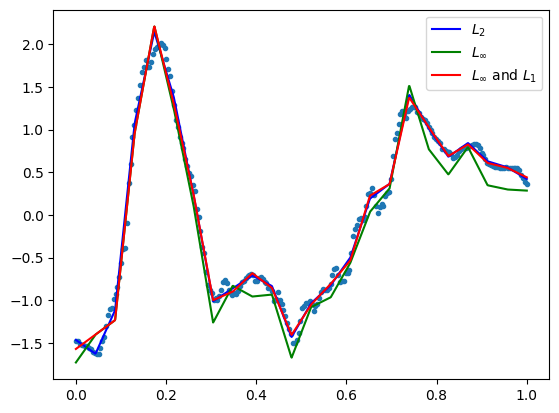

            max_dist       MSE      RMSE       MAE
LSQ         0.141960  0.001859  0.043117  0.032016
Max         0.111692  0.006267  0.079163  0.070539
Max and L1  0.111693  0.002216  0.047073  0.032904 

opt distance 0.1116920618183363
number of data points: 240


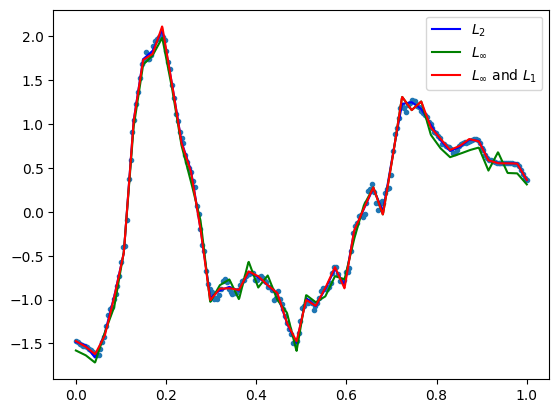

            max_dist       MSE      RMSE       MAE
LSQ         0.127140  0.000985  0.031379  0.022396
Max         0.099611  0.006350  0.079686  0.074211
Max and L1  0.099612  0.001473  0.038381  0.024358 

opt distance 0.09961113301012409
number of data points: 240


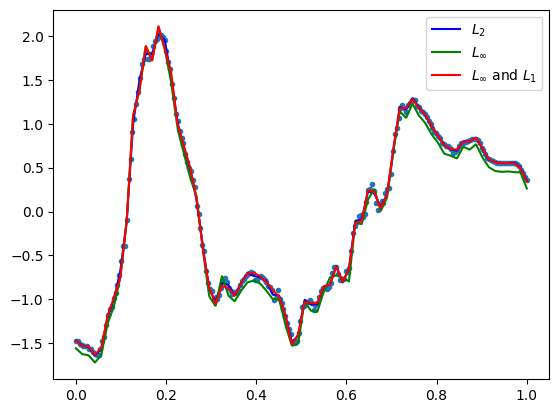

            max_dist       MSE      RMSE       MAE
LSQ         0.124791  0.000652  0.025542  0.016904
Max         0.106552  0.007932  0.089063  0.083687
Max and L1  0.106553  0.000969  0.031130  0.016651 

opt distance 0.10655214382915372
number of data points: 240


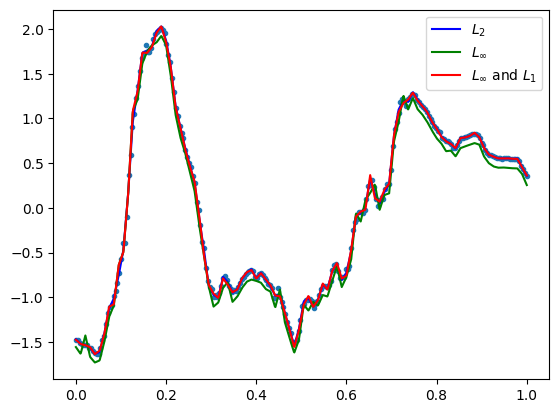

            max_dist       MSE      RMSE       MAE
LSQ         0.064164  0.000291  0.017056  0.012031
Max         0.049452  0.001770  0.042070  0.039284
Max and L1  0.049453  0.000390  0.019744  0.011339 
opt distance 0.04945239431447601
number of data points: 240


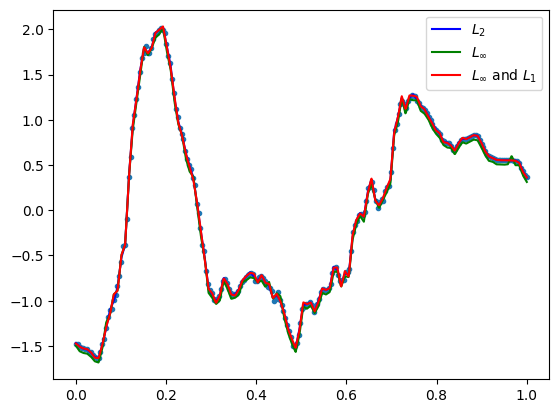

GestureMidAirD3 no. 59 len(ts): 300 ts processed: 28.37 %
[30, 60, 90, 120, 150]
            max_dist       MSE      RMSE       MAE
LSQ         0.285527  0.011075  0.105239  0.083120
Max         0.238276  0.023213  0.152358  0.132767
Max and L1  0.238277  0.012578  0.112152  0.084354 
opt distance 0.23827589447893488
number of data points: 300


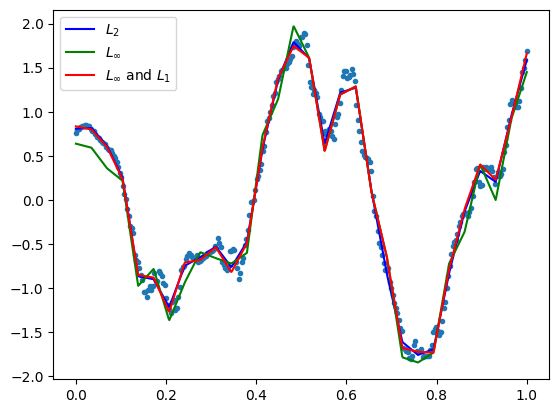

            max_dist       MSE      RMSE       MAE
LSQ         0.191893  0.003111  0.055780  0.041171
Max         0.151218  0.011240  0.106019  0.094397
Max and L1  0.151219  0.004169  0.064565  0.045640 

opt distance 0.15121757296712962
number of data points: 300


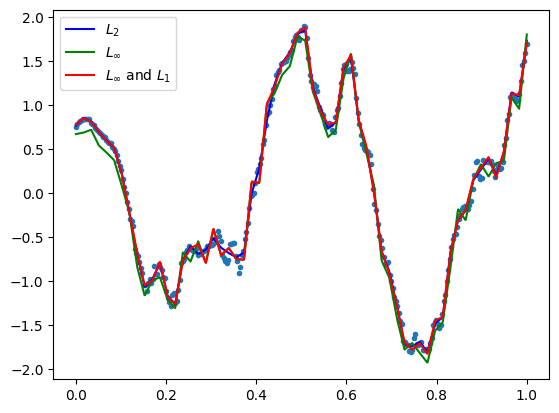

            max_dist       MSE      RMSE       MAE
LSQ         0.120822  0.001099  0.033144  0.025098
Max         0.074480  0.003159  0.056203  0.050578
Max and L1  0.074481  0.001311  0.036204  0.025770 

opt distance 0.07448046687469817
number of data points: 300


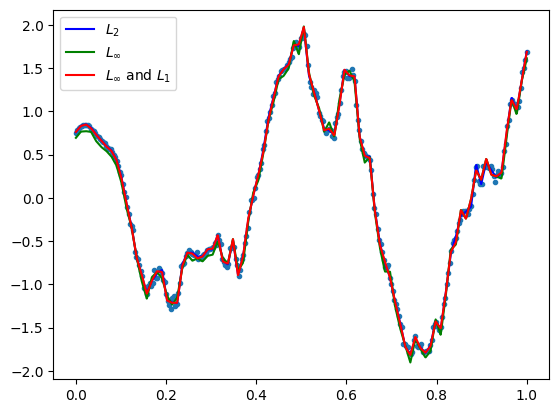

            max_dist       MSE      RMSE       MAE
LSQ         0.104232  0.000861  0.029350  0.021771
Max         0.067941  0.002940  0.054221  0.049814
Max and L1  0.067942  0.001027  0.032054  0.021390 
opt distance 0.06794142398021921
number of data points: 300


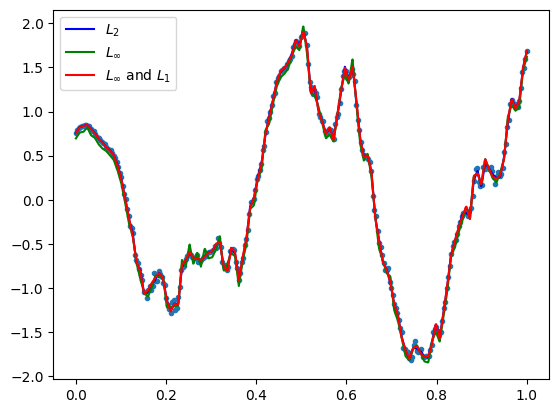

            max_dist       MSE      RMSE       MAE
LSQ         0.080194  0.000487  0.022061  0.016322
Max         0.053972  0.001969  0.044372  0.040954
Max and L1  0.053973  0.000614  0.024789  0.015774 
opt distance 0.05397224139235761
number of data points: 300


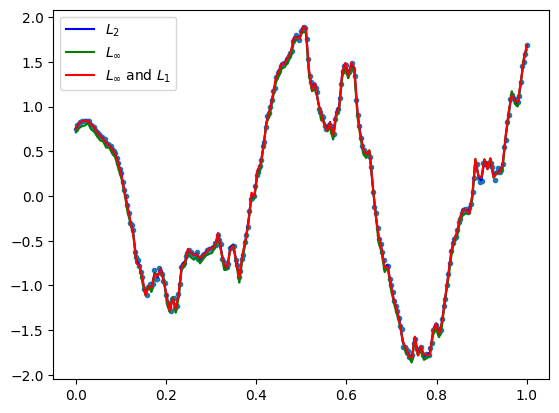

GestureMidAirD3 no. 60 len(ts): 240 ts processed: 28.849999999999998 %
[24, 48, 72, 96, 120]
            max_dist       MSE      RMSE       MAE
LSQ         0.374562  0.009719  0.098584  0.074666
Max         0.291215  0.043055  0.207497  0.186285
Max and L1  0.291216  0.011887  0.109026  0.076016 

opt distance 0.2912149803735682
number of data points: 240


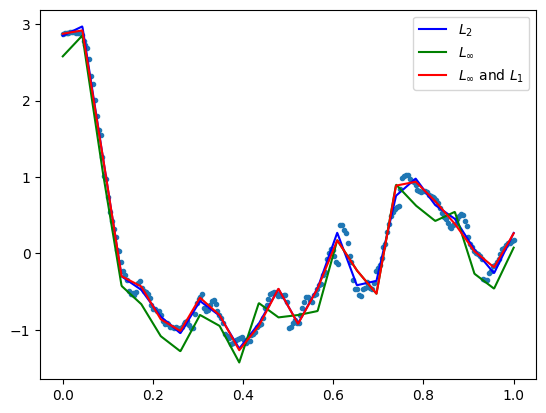

            max_dist       MSE      RMSE       MAE
LSQ         0.336491  0.003502  0.059174  0.040608
Max         0.222501  0.030310  0.174098  0.163258
Max and L1  0.222502  0.005341  0.073084  0.046943 

opt distance 0.22250079532427627
number of data points: 240


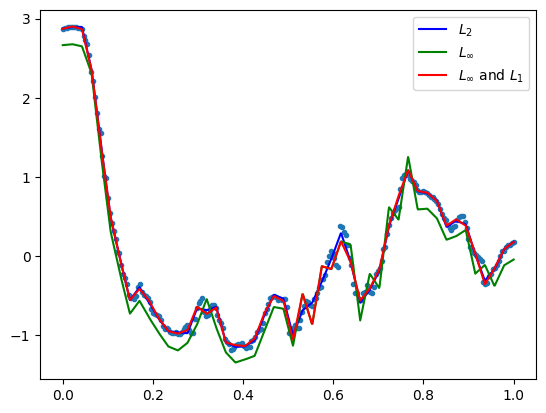

            max_dist       MSE      RMSE       MAE
LSQ         0.198570  0.001461  0.038218  0.026694
Max         0.142313  0.012275  0.110793  0.102504
Max and L1  0.142314  0.002091  0.045724  0.028249 

opt distance 0.14231327204375843
number of data points: 240


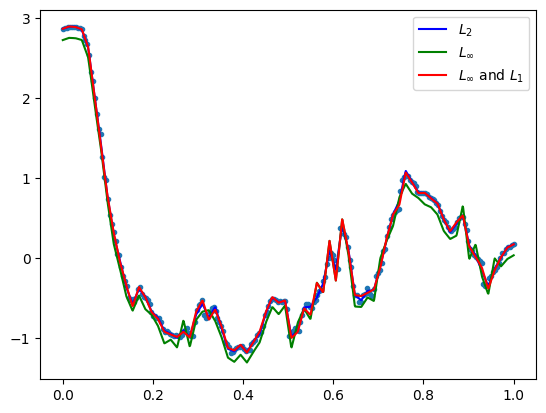

            max_dist       MSE      RMSE       MAE
LSQ         0.214143  0.000902  0.030040  0.019409
Max         0.140177  0.014052  0.118542  0.112857
Max and L1  0.140178  0.001392  0.037315  0.019402 

opt distance 0.1401767806606909
number of data points: 240


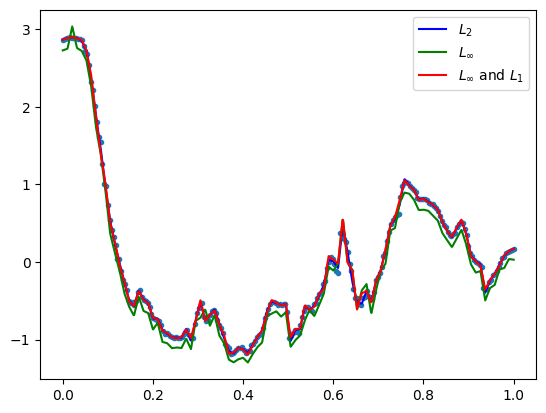

            max_dist       MSE      RMSE       MAE
LSQ         0.198459  0.000725  0.026934  0.016464
Max         0.141252  0.016054  0.126706  0.123014
Max and L1  0.141253  0.001566  0.039578  0.019412 

opt distance 0.14125159969090398
number of data points: 240


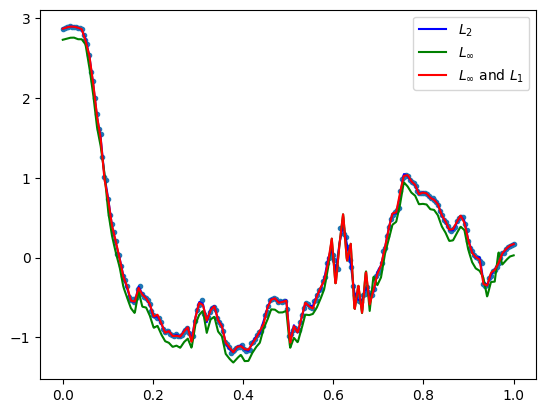

GestureMidAirD3 no. 61 len(ts): 171 ts processed: 29.330000000000002 %
[17, 34, 51, 68, 85]
            max_dist       MSE      RMSE       MAE
LSQ         0.183342  0.001594  0.039926  0.028342
Max         0.142873  0.010677  0.103328  0.096974
Max and L1  0.142874  0.002740  0.052344  0.036684 

opt distance 0.14287288183857844
number of data points: 171


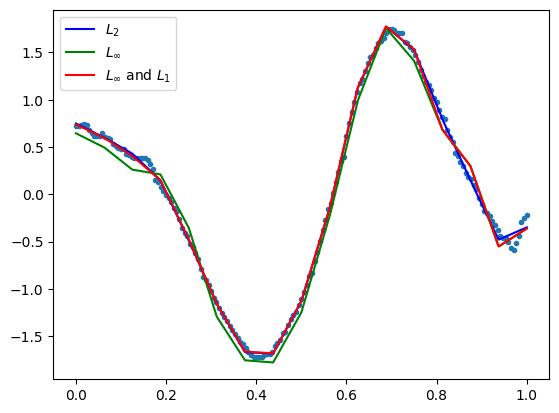

            max_dist       MSE      RMSE       MAE
LSQ         0.093571  0.000346  0.018597  0.014311
Max         0.054581  0.001472  0.038368  0.034675
Max and L1  0.054582  0.000460  0.021448  0.015065 

opt distance 0.054581414804103
number of data points: 171


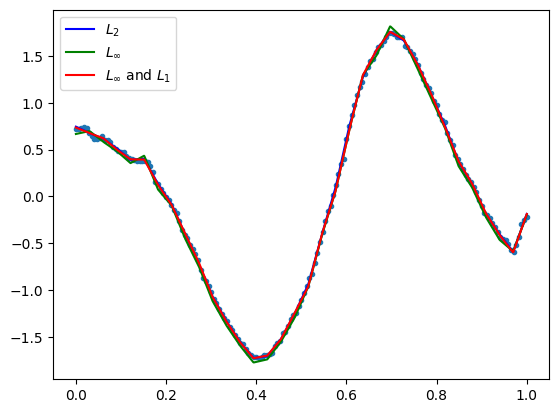

            max_dist       MSE      RMSE       MAE
LSQ         0.074511  0.000278  0.016669  0.011874
Max         0.061547  0.002320  0.048168  0.045152
Max and L1  0.061548  0.000350  0.018702  0.011806 

opt distance 0.061547463377870516
number of data points: 171


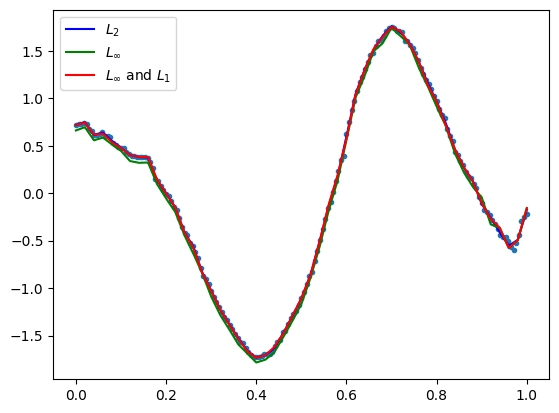

            max_dist       MSE      RMSE       MAE
LSQ         0.052812  0.000143  0.011970  0.008887
Max         0.039967  0.000995  0.031543  0.028936
Max and L1  0.039968  0.000185  0.013599  0.008623 

opt distance 0.03996659580023553
number of data points: 171


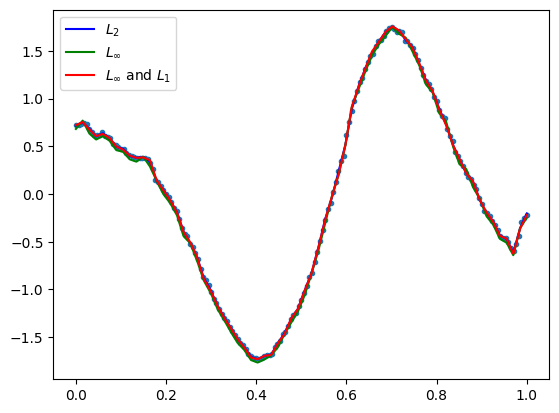

            max_dist       MSE      RMSE       MAE
LSQ         0.034189  0.000108  0.010386  0.007689
Max         0.025778  0.000460  0.021459  0.019963
Max and L1  0.025779  0.000141  0.011889  0.007508 

opt distance 0.025778440933969603
number of data points: 171


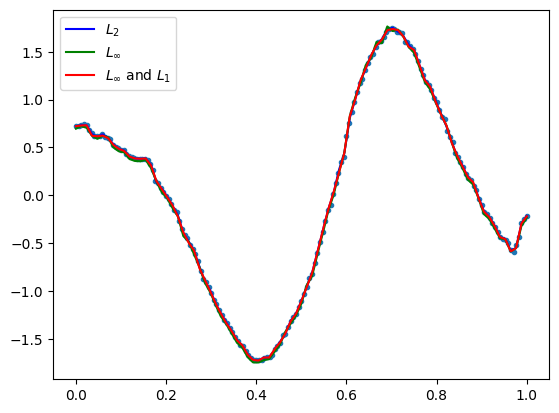

GestureMidAirD3 no. 62 len(ts): 173 ts processed: 29.81 %
[17, 34, 51, 69, 86]
            max_dist       MSE      RMSE       MAE
LSQ         0.072866  0.000389  0.019711  0.014728
Max         0.050615  0.001163  0.034103  0.030502
Max and L1  0.050616  0.000511  0.022600  0.017042 

opt distance 0.050614541881964396
number of data points: 173


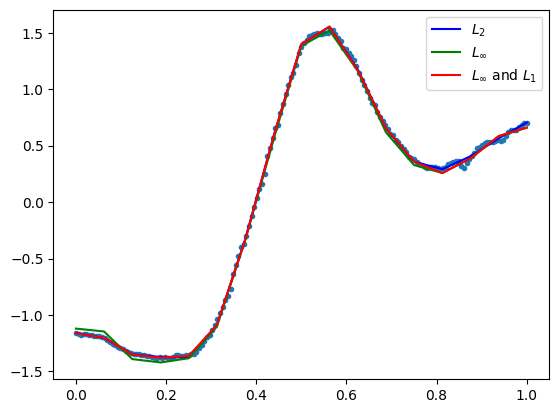

            max_dist       MSE      RMSE       MAE
LSQ         0.057083  0.000199  0.014103  0.009960
Max         0.039841  0.000946  0.030756  0.028591
Max and L1  0.039842  0.000249  0.015768  0.010334 

opt distance 0.03984146523260845
number of data points: 173


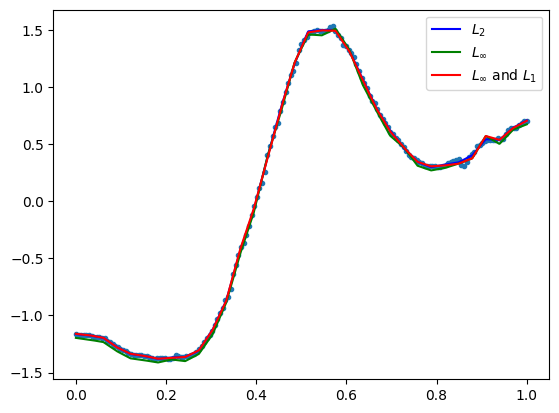

            max_dist       MSE      RMSE       MAE
LSQ         0.039824  0.000094  0.009683  0.006599
Max         0.030118  0.000577  0.024016  0.022441
Max and L1  0.030119  0.000131  0.011448  0.007202 

opt distance 0.03011838288125329
number of data points: 173


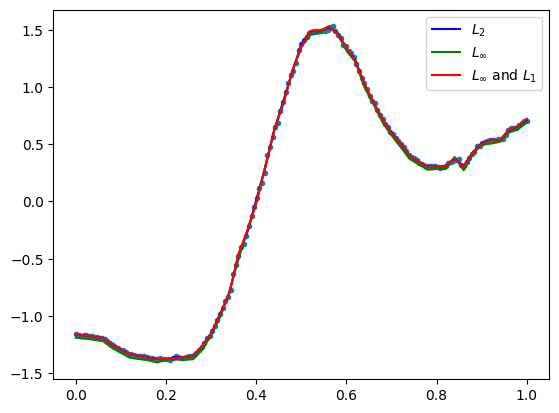

            max_dist       MSE      RMSE       MAE
LSQ         0.028665  0.000066  0.008106  0.005551
Max         0.022113  0.000334  0.018282  0.017086
Max and L1  0.022114  0.000085  0.009210  0.005613 

opt distance 0.02211311283061727
number of data points: 173


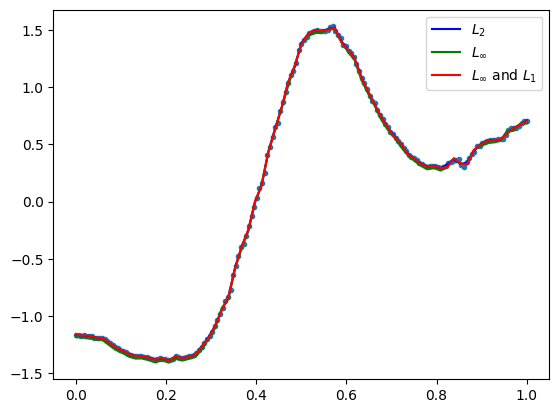

            max_dist       MSE      RMSE       MAE
LSQ         0.024553  0.000036  0.005976  0.003941
Max         0.019639  0.000296  0.017201  0.016481
Max and L1  0.019640  0.000045  0.006702  0.003640 

opt distance 0.019638741808293128
number of data points: 173


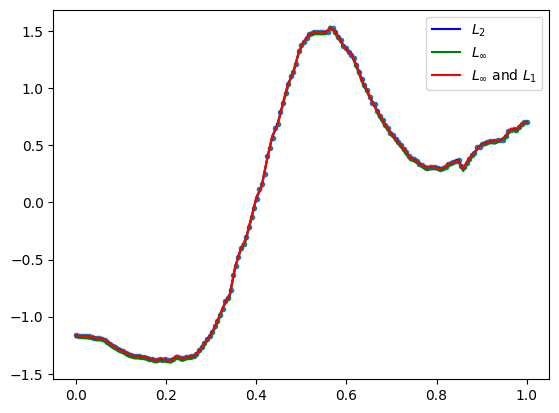

GestureMidAirD3 no. 63 len(ts): 358 ts processed: 30.29 %
[35, 71, 107, 143, 179]
            max_dist       MSE      RMSE       MAE
LSQ         0.028456  0.000097  0.009824  0.007631
Max         0.025696  0.000284  0.016854  0.014898
Max and L1  0.025697  0.000102  0.010116  0.007568 

opt distance 0.0256962004902759
number of data points: 358


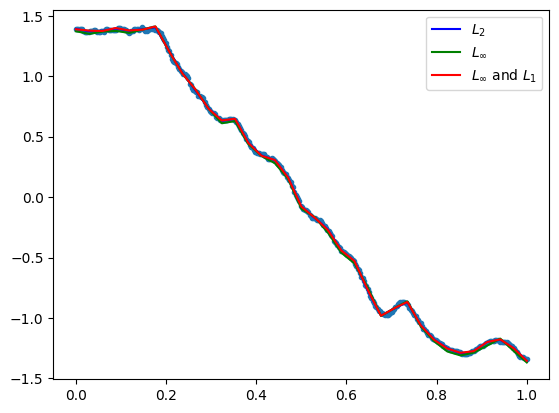

            max_dist       MSE      RMSE       MAE
LSQ         0.017107  0.000024  0.004943  0.003828
Max         0.014230  0.000102  0.010080  0.009002
Max and L1  0.014231  0.000028  0.005293  0.003707 

opt distance 0.014230046289957388
number of data points: 358


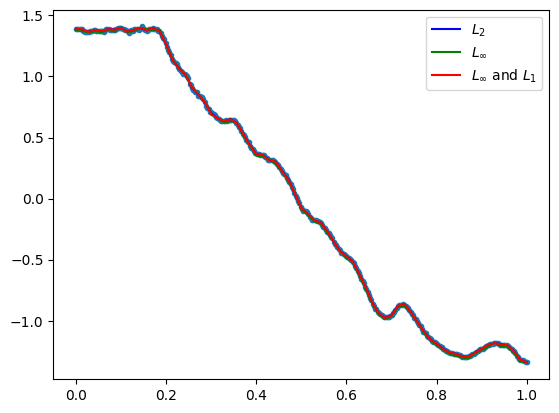

            max_dist       MSE      RMSE       MAE
LSQ         0.018394  0.000015  0.003869  0.002836
Max         0.011521  0.000078  0.008853  0.008066
Max and L1  0.011522  0.000020  0.004433  0.002934 
opt distance 0.011520805404164669
number of data points: 358


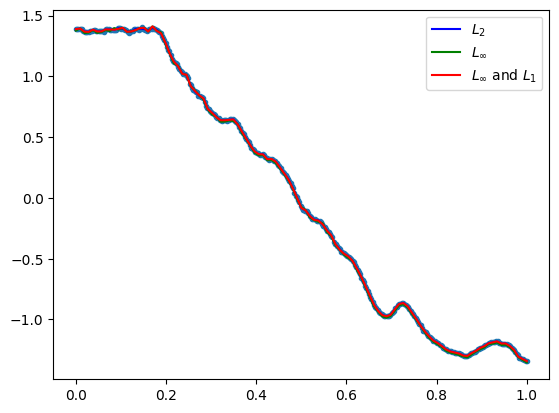

            max_dist       MSE      RMSE       MAE
LSQ         0.011072  0.000010  0.003106  0.002309
Max         0.008420  0.000043  0.006592  0.006028
Max and L1  0.008421  0.000012  0.003463  0.002242 
opt distance 0.0084202604720325
number of data points: 358


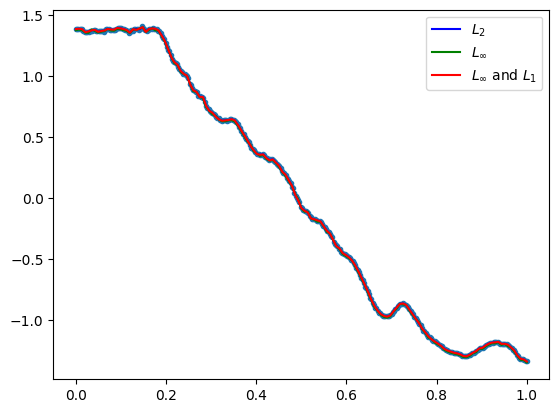

            max_dist       MSE      RMSE       MAE
LSQ         0.011826  0.000006  0.002364  0.001730
Max         0.008638  0.000054  0.007329  0.006910
Max and L1  0.008639  0.000008  0.002811  0.001569 
opt distance 0.008638323291489947
number of data points: 358


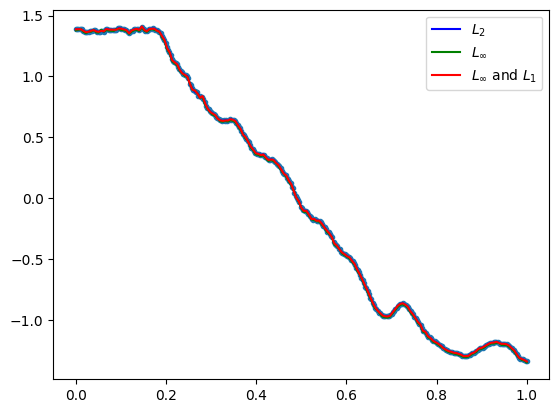

GestureMidAirD3 no. 64 len(ts): 137 ts processed: 30.769999999999996 %
[13, 27, 41, 54, 68]
            max_dist       MSE      RMSE       MAE
LSQ         0.216227  0.002404  0.049034  0.026696
Max         0.175939  0.019170  0.138457  0.127910
Max and L1  0.175940  0.002651  0.051485  0.027567 

opt distance 0.1759391536446936
number of data points: 137


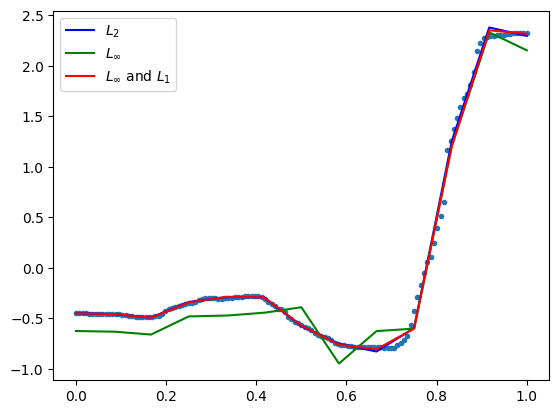

            max_dist       MSE      RMSE       MAE
LSQ         0.220904  0.001029  0.032077  0.015164
Max         0.151793  0.017136  0.130906  0.124833
Max and L1  0.151794  0.001502  0.038749  0.016868 

opt distance 0.1517929121168607
number of data points: 137


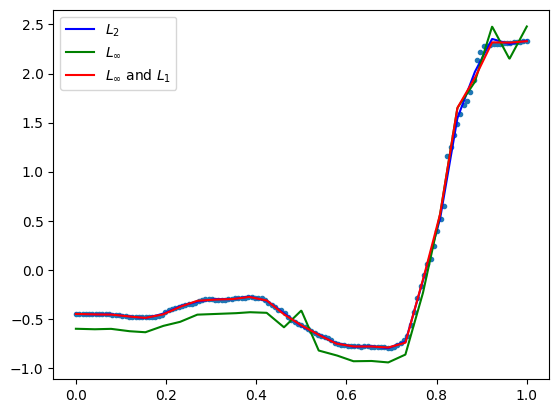

            max_dist       MSE      RMSE       MAE
LSQ         0.164413  0.000429  0.020718  0.008147
Max         0.127758  0.013386  0.115698  0.111805
Max and L1  0.127759  0.000514  0.022663  0.007808 

opt distance 0.1277576634634274
number of data points: 137


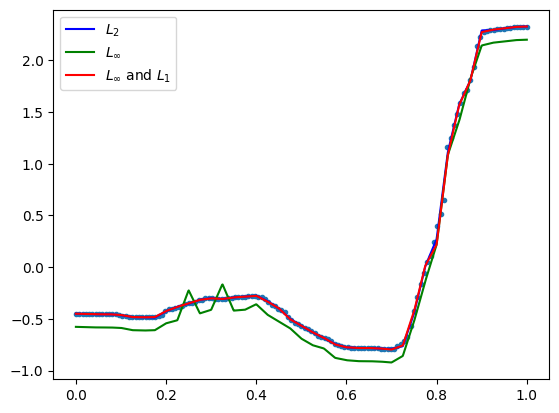

            max_dist       MSE      RMSE       MAE
LSQ         0.133659  0.000288  0.016960  0.006232
Max         0.098919  0.008625  0.092869  0.091294
Max and L1  0.098920  0.000577  0.024016  0.008394 

opt distance 0.09891921496424613
number of data points: 137


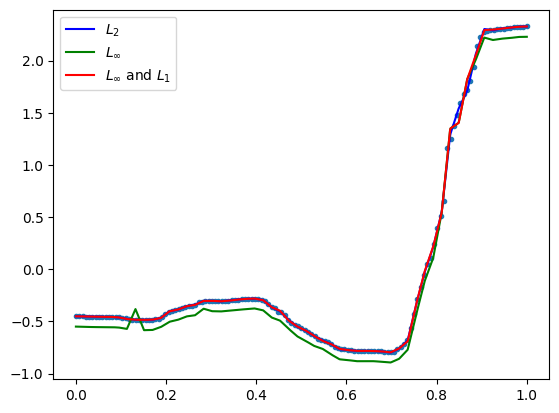

            max_dist       MSE      RMSE       MAE
LSQ         0.143474  0.000316  0.017763  0.005494
Max         0.100652  0.009169  0.095755  0.093955
Max and L1  0.100653  0.000905  0.030086  0.011401 

opt distance 0.10065183849948642
number of data points: 137


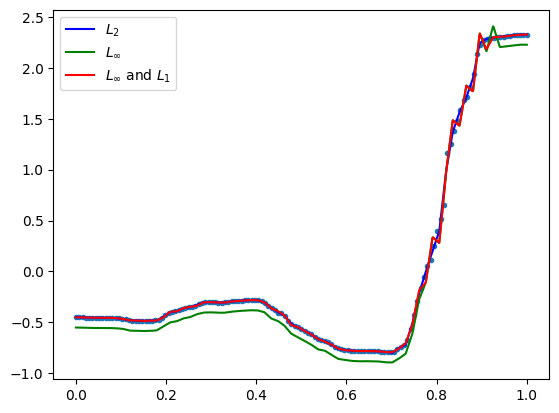

GestureMidAirD3 no. 65 len(ts): 332 ts processed: 31.25 %
[33, 66, 99, 132, 166]
            max_dist       MSE      RMSE       MAE
LSQ         0.065634  0.000215  0.014668  0.010571
Max         0.052527  0.001421  0.037698  0.034356
Max and L1  0.052528  0.000294  0.017154  0.011594 

opt distance 0.0525274864092569
number of data points: 332


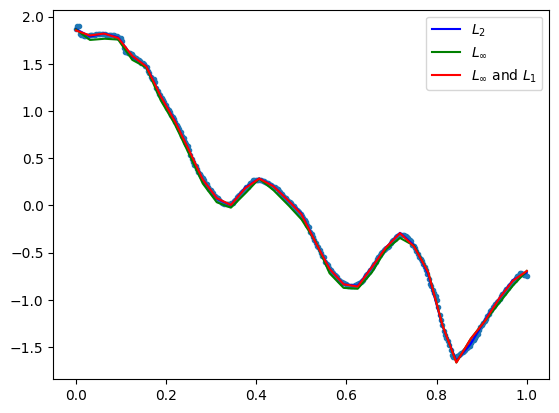

            max_dist       MSE      RMSE       MAE
LSQ         0.036914  0.000059  0.007666  0.005032
Max         0.028984  0.000524  0.022883  0.021511
Max and L1  0.028985  0.000067  0.008211  0.004988 

opt distance 0.028984351077059173
number of data points: 332


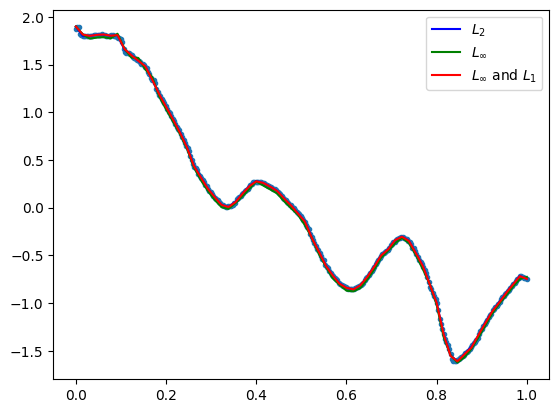

            max_dist       MSE      RMSE       MAE
LSQ         0.038674  0.000036  0.006026  0.003831
Max         0.028984  0.000610  0.024698  0.023711
Max and L1  0.028985  0.000044  0.006603  0.003507 
opt distance 0.028984351077059156
number of data points: 332


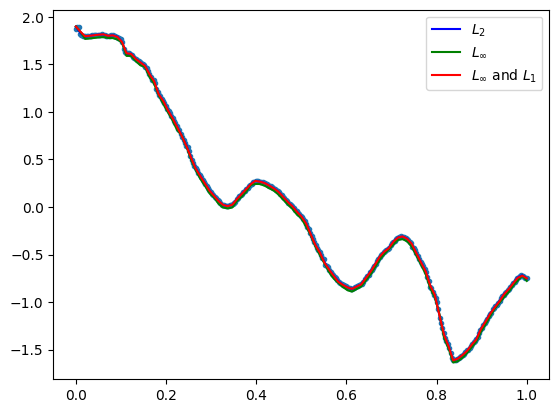

            max_dist       MSE      RMSE       MAE
LSQ         0.029290  0.000024  0.004895  0.003069
Max         0.025494  0.000494  0.022215  0.021396
Max and L1  0.025495  0.000031  0.005571  0.002749 
opt distance 0.02549388591349882
number of data points: 332


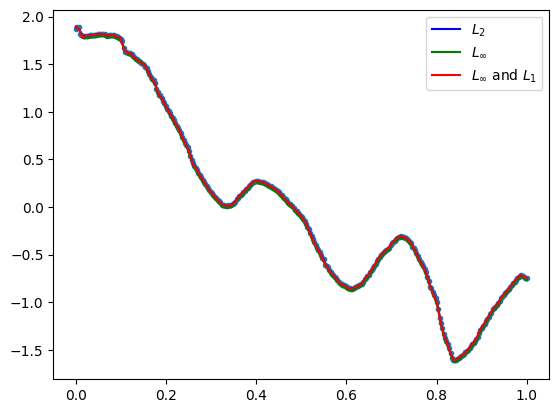

            max_dist       MSE      RMSE       MAE
LSQ         0.023834  0.000014  0.003674  0.002315
Max         0.016059  0.000206  0.014343  0.013924
Max and L1  0.016060  0.000018  0.004212  0.002071 
opt distance 0.01605929868629631
number of data points: 332


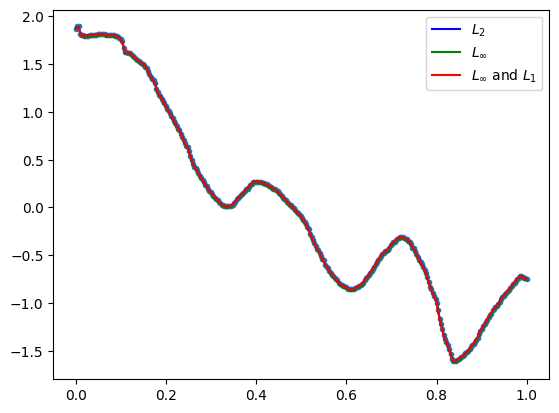

GestureMidAirD3 no. 66 len(ts): 90 ts processed: 31.730000000000004 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.679253  0.045501  0.213310  0.153162
Max         0.584673  0.164199  0.405215  0.369263
Max and L1  0.584674  0.087371  0.295586  0.224716 

opt distance 0.5846730833054817
number of data points: 90


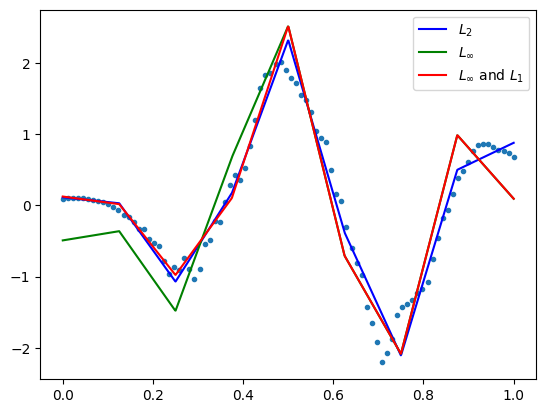

            max_dist       MSE      RMSE       MAE
LSQ         0.244220  0.005606  0.074871  0.053623
Max         0.189018  0.019069  0.138090  0.123492
Max and L1  0.189019  0.009406  0.096986  0.070944 

opt distance 0.18901827381478697
number of data points: 90


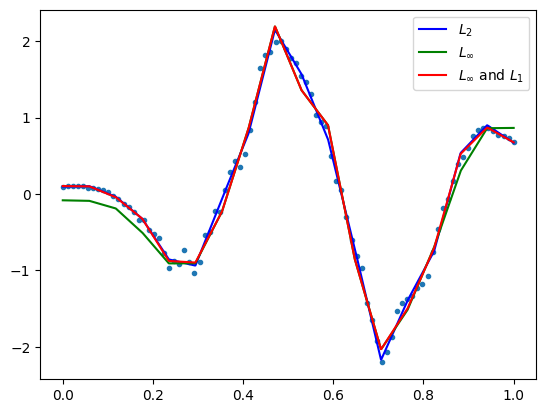

            max_dist       MSE      RMSE       MAE
LSQ         0.252193  0.005993  0.077412  0.052590
Max         0.180036  0.018459  0.135864  0.120435
Max and L1  0.180037  0.009003  0.094882  0.065383 

opt distance 0.18003636472216536
number of data points: 90


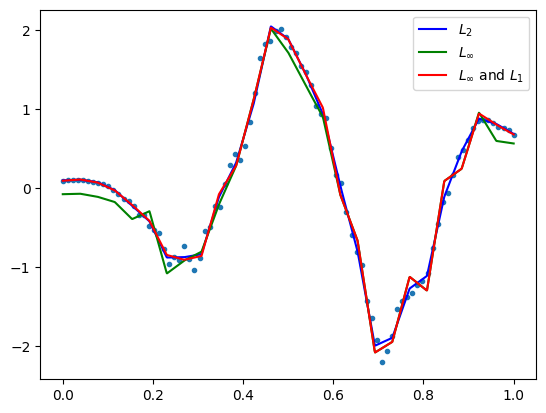

            max_dist       MSE      RMSE       MAE
LSQ         0.169727  0.002891  0.053767  0.038251
Max         0.126822  0.010056  0.100282  0.091648
Max and L1  0.126823  0.003790  0.061561  0.040769 

opt distance 0.1268216212957226
number of data points: 90


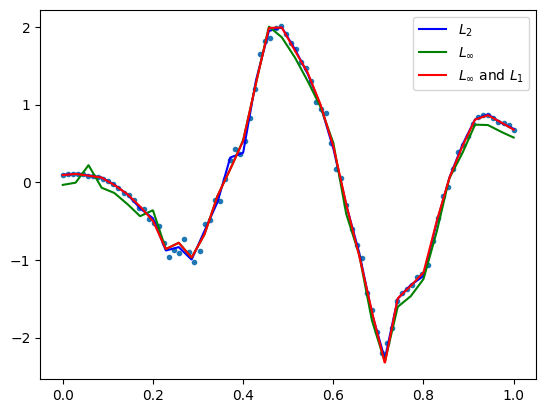

            max_dist       MSE      RMSE       MAE
LSQ         0.111005  0.001793  0.042345  0.031508
Max         0.087429  0.005324  0.072965  0.068346
Max and L1  0.087430  0.002386  0.048842  0.033202 

opt distance 0.08742900532995052
number of data points: 90


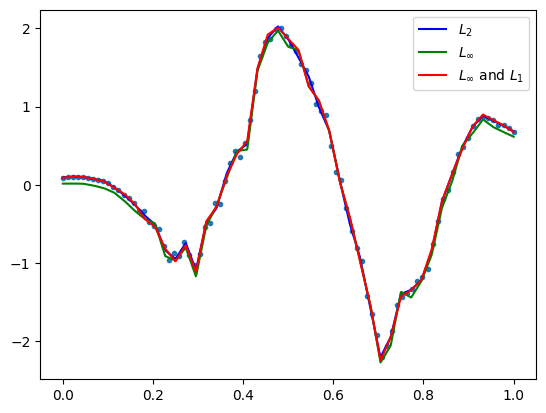

GestureMidAirD3 no. 67 len(ts): 300 ts processed: 32.21 %
[30, 60, 90, 120, 150]
            max_dist       MSE      RMSE       MAE
LSQ         0.652675  0.018109  0.134569  0.081171
Max         0.515658  0.170994  0.413514  0.387920
Max and L1  0.515659  0.031253  0.176784  0.108223 
opt distance 0.5156584898986405
number of data points: 300


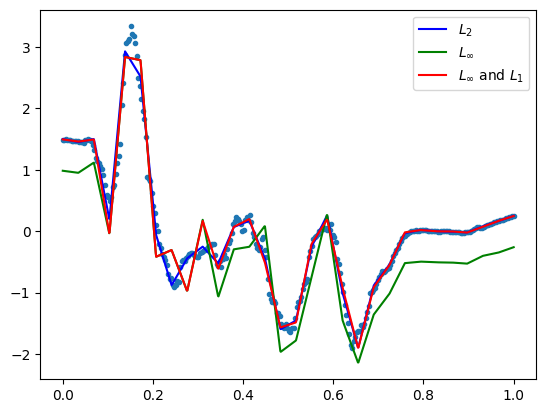

            max_dist       MSE      RMSE       MAE
LSQ         0.319923  0.004223  0.064986  0.041546
Max         0.223359  0.032017  0.178932  0.166251
Max and L1  0.223360  0.005775  0.075996  0.046345 

opt distance 0.2233585112705783
number of data points: 300


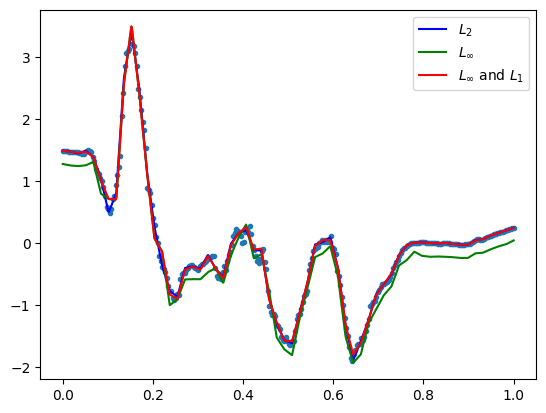

            max_dist       MSE      RMSE       MAE
LSQ         0.250745  0.001693  0.041142  0.025571
Max         0.159677  0.018109  0.134570  0.127493
Max and L1  0.159678  0.002224  0.047162  0.025215 

opt distance 0.15967727007930194
number of data points: 300


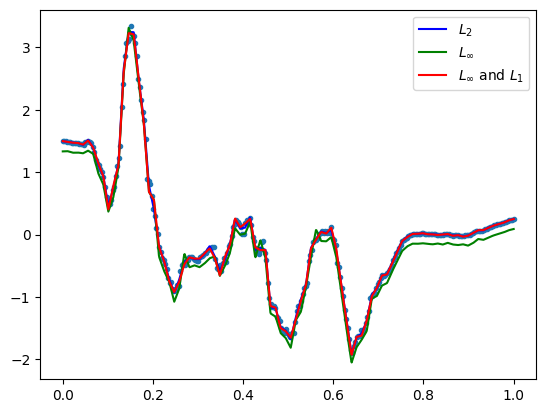

            max_dist       MSE      RMSE       MAE
LSQ         0.245224  0.001264  0.035548  0.021597
Max         0.180199  0.025252  0.158908  0.152546
Max and L1  0.180200  0.001828  0.042753  0.020564 
opt distance 0.18019922825602266
number of data points: 300


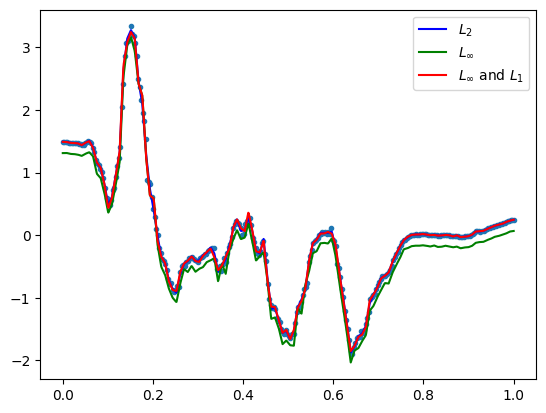

            max_dist       MSE      RMSE       MAE
LSQ         0.112202  0.000681  0.026104  0.016130
Max         0.078557  0.004811  0.069360  0.066248
Max and L1  0.078558  0.000886  0.029769  0.015864 
opt distance 0.07855653457984488
number of data points: 300


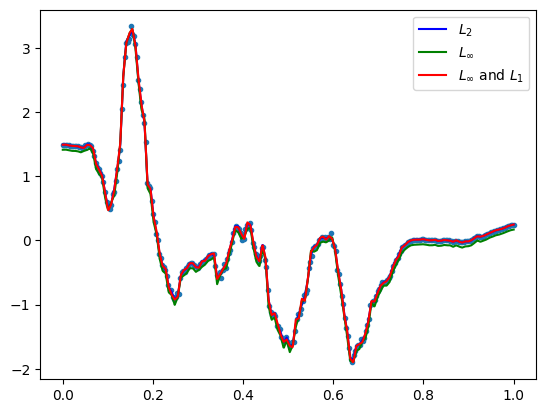

GestureMidAirD3 no. 68 len(ts): 120 ts processed: 32.690000000000005 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.287454  0.007095  0.084233  0.060212
Max         0.234239  0.029214  0.170921  0.157228
Max and L1  0.234240  0.008441  0.091874  0.064370 

opt distance 0.23423887567263246
number of data points: 120


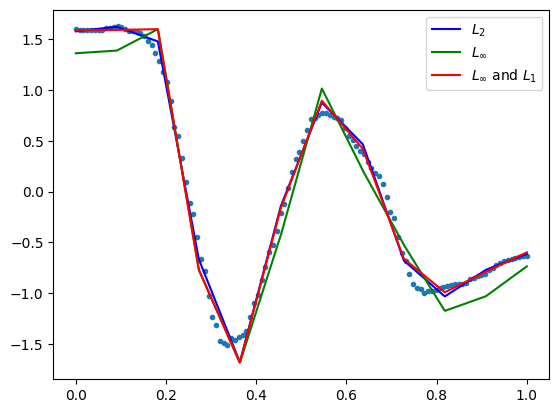

            max_dist       MSE      RMSE       MAE
LSQ         0.092165  0.000763  0.027623  0.019097
Max         0.075231  0.003049  0.055221  0.050350
Max and L1  0.075232  0.000891  0.029853  0.019309 

opt distance 0.07523125360651599
number of data points: 120


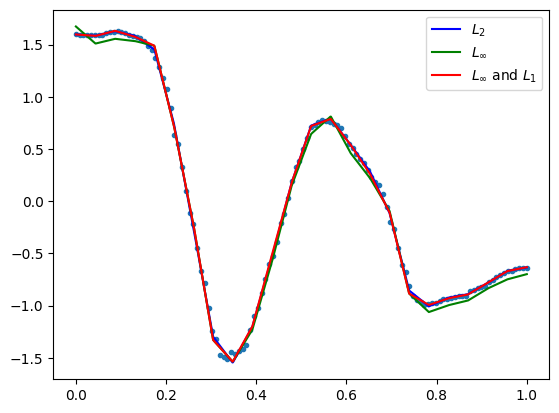

            max_dist       MSE      RMSE       MAE
LSQ         0.067544  0.000342  0.018484  0.012620
Max         0.050298  0.001506  0.038810  0.035318
Max and L1  0.050299  0.000382  0.019548  0.012064 

opt distance 0.050298094923523266
number of data points: 120


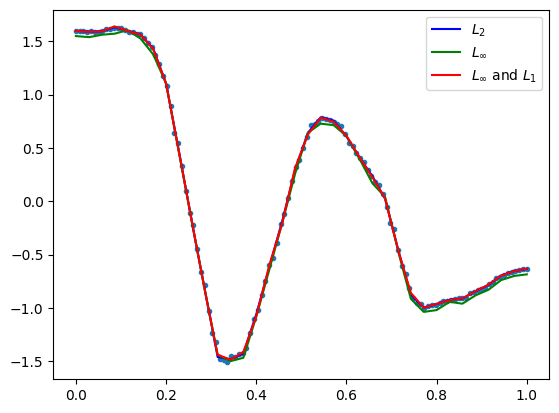

            max_dist       MSE      RMSE       MAE
LSQ         0.059687  0.000300  0.017320  0.011764
Max         0.041257  0.001149  0.033903  0.031825
Max and L1  0.041258  0.000359  0.018957  0.011870 
opt distance 0.04125702193024222
number of data points: 120


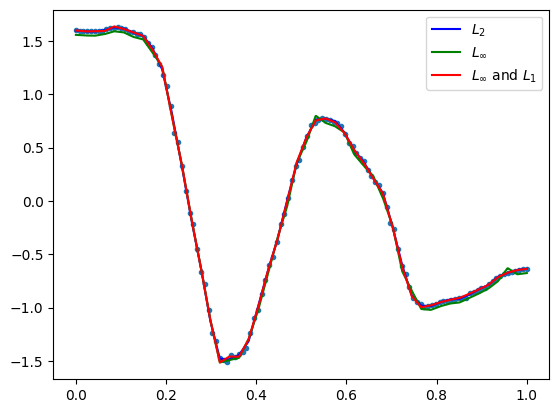

            max_dist       MSE      RMSE       MAE
LSQ         0.053305  0.000220  0.014836  0.009706
Max         0.041820  0.001268  0.035614  0.033286
Max and L1  0.041821  0.000322  0.017955  0.010734 
opt distance 0.04182006008320083
number of data points: 120


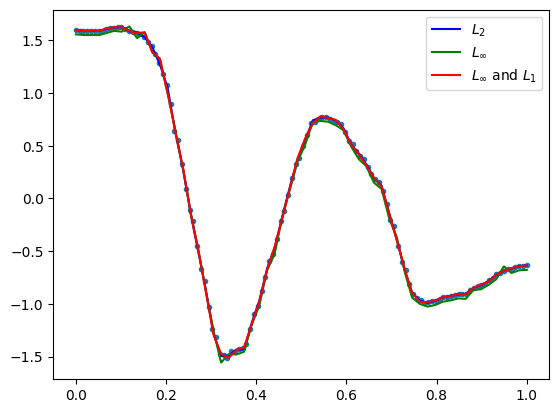

GestureMidAirD3 no. 69 len(ts): 88 ts processed: 33.17 %
[8, 17, 26, 35, 44]
            max_dist       MSE      RMSE       MAE
LSQ         0.567928  0.030799  0.175497  0.116547
Max         0.425558  0.079377  0.281740  0.251261
Max and L1  0.425559  0.056809  0.238347  0.193112 

opt distance 0.42555837822977594
number of data points: 88


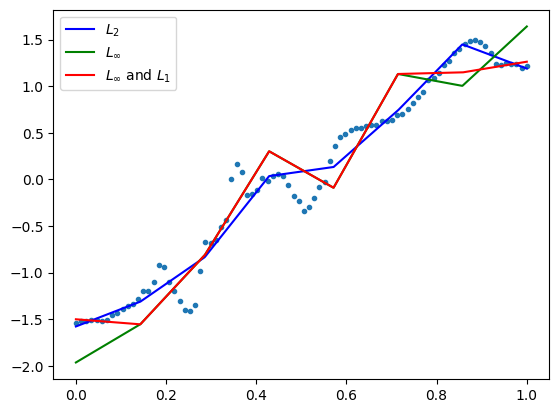

            max_dist       MSE      RMSE       MAE
LSQ         0.301450  0.005637  0.075078  0.048976
Max         0.223597  0.030068  0.173402  0.160355
Max and L1  0.223598  0.012144  0.110199  0.077148 

opt distance 0.22359739903831888
number of data points: 88


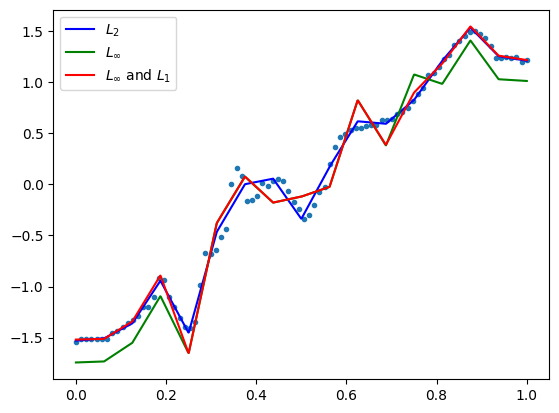

            max_dist       MSE      RMSE       MAE
LSQ         0.201122  0.002632  0.051301  0.032944
Max         0.164831  0.016912  0.130044  0.121040
Max and L1  0.164832  0.003281  0.057283  0.034439 

opt distance 0.1648308475614747
number of data points: 88


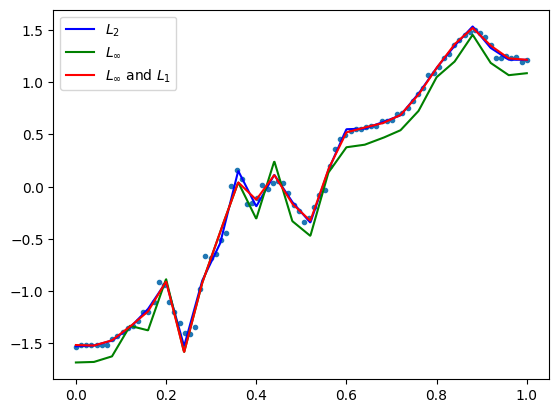

            max_dist       MSE      RMSE       MAE
LSQ         0.104368  0.001172  0.034240  0.023488
Max         0.082346  0.004717  0.068684  0.064530
Max and L1  0.082347  0.001509  0.038848  0.025059 

opt distance 0.08234622304488813
number of data points: 88


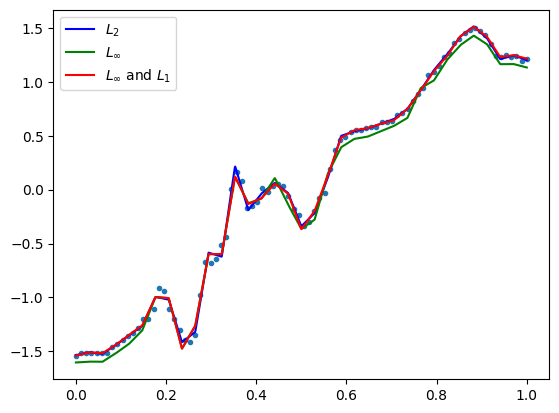

            max_dist       MSE      RMSE       MAE
LSQ         0.101589  0.000883  0.029709  0.019012
Max         0.078957  0.004564  0.067557  0.063954
Max and L1  0.078958  0.001112  0.033354  0.019304 

opt distance 0.0789571640816338
number of data points: 88


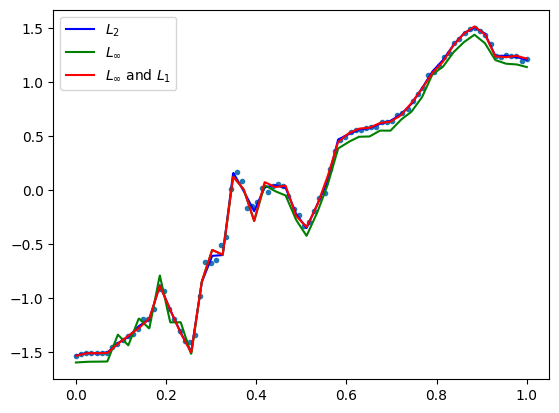

GestureMidAirD3 no. 70 len(ts): 180 ts processed: 33.650000000000006 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.080418  0.000292  0.017100  0.009897
Max         0.072369  0.003338  0.057772  0.054527
Max and L1  0.072370  0.000388  0.019703  0.011223 

opt distance 0.07236852092751489
number of data points: 180


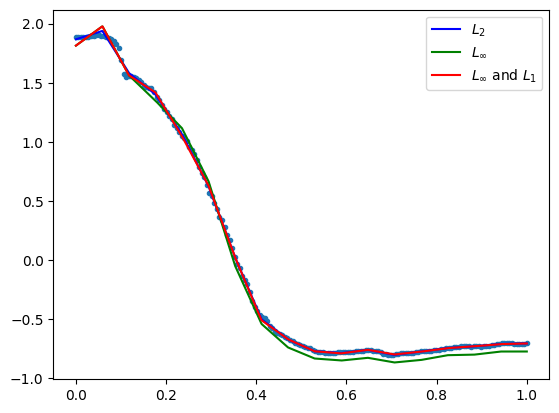

            max_dist       MSE      RMSE       MAE
LSQ         0.059314  0.000074  0.008602  0.005108
Max         0.040547  0.001099  0.033155  0.031253
Max and L1  0.040548  0.000133  0.011517  0.006429 

opt distance 0.040547403655627465
number of data points: 180


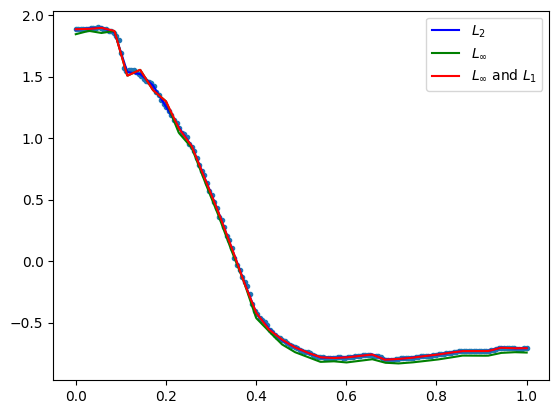

            max_dist       MSE      RMSE       MAE
LSQ         0.050791  0.000042  0.006450  0.003594
Max         0.032186  0.000807  0.028409  0.027593
Max and L1  0.032187  0.000068  0.008270  0.004129 

opt distance 0.03218631493855489
number of data points: 180


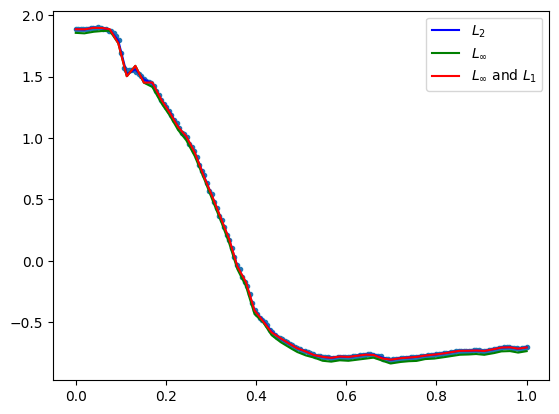

            max_dist       MSE      RMSE       MAE
LSQ         0.045690  0.000037  0.006072  0.003068
Max         0.032172  0.000825  0.028722  0.027567
Max and L1  0.032173  0.000060  0.007763  0.003433 

opt distance 0.03217171367562242
number of data points: 180


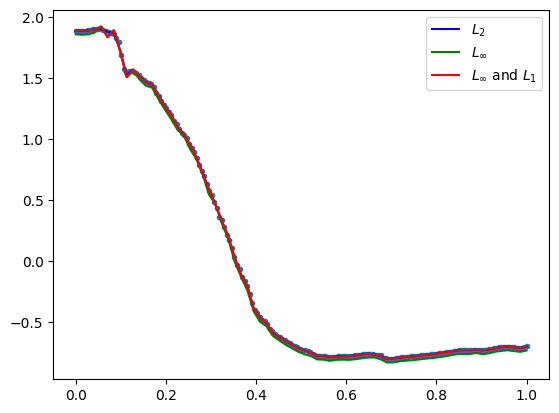

            max_dist       MSE      RMSE       MAE
LSQ         0.037859  0.000028  0.005275  0.002635
Max         0.025882  0.000562  0.023713  0.022954
Max and L1  0.025883  0.000044  0.006616  0.002842 

opt distance 0.025881660176438406
number of data points: 180


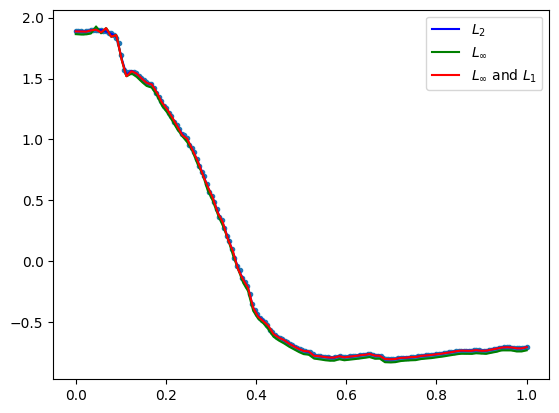

GestureMidAirD3 no. 71 len(ts): 180 ts processed: 34.13 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.022128  0.000042  0.006497  0.004256
Max         0.019815  0.000228  0.015105  0.013870
Max and L1  0.019816  0.000050  0.007088  0.004453 

opt distance 0.019814885018964556
number of data points: 180


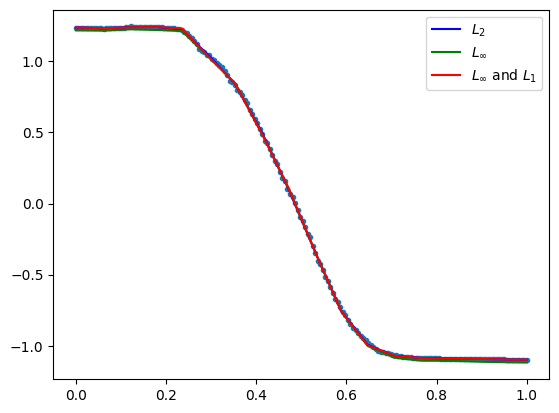

            max_dist       MSE      RMSE       MAE
LSQ         0.015534  0.000017  0.004127  0.002558
Max         0.012630  0.000103  0.010165  0.009362
Max and L1  0.012631  0.000020  0.004431  0.002591 
opt distance 0.012629781228844422
number of data points: 180


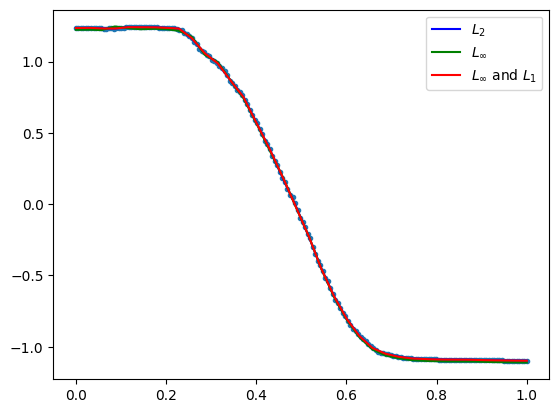

            max_dist       MSE      RMSE       MAE
LSQ         0.017597  0.000016  0.003941  0.002364
Max         0.012480  0.000112  0.010568  0.009911
Max and L1  0.012481  0.000022  0.004684  0.002608 

opt distance 0.012480414959027202
number of data points: 180


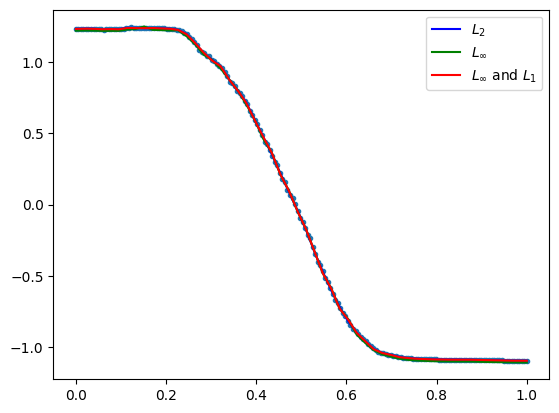

            max_dist       MSE      RMSE       MAE
LSQ         0.011000  0.000011  0.003333  0.002018
Max         0.009008  0.000062  0.007849  0.007489
Max and L1  0.009009  0.000013  0.003617  0.001989 

opt distance 0.009007905930357954
number of data points: 180


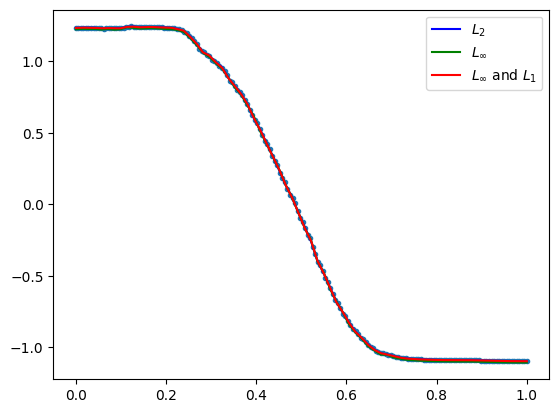

            max_dist       MSE      RMSE       MAE
LSQ         0.010346  0.000008  0.002823  0.001618
Max         0.008690  0.000061  0.007809  0.007510
Max and L1  0.008691  0.000010  0.003226  0.001630 

opt distance 0.008689521826942543
number of data points: 180


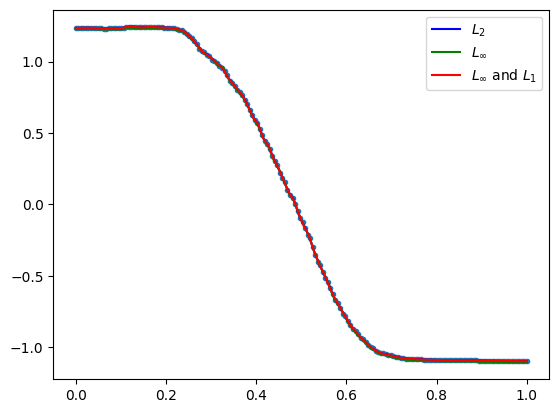

GestureMidAirD3 no. 72 len(ts): 180 ts processed: 34.62 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.052513  0.000135  0.011607  0.007352
Max         0.044579  0.001274  0.035698  0.033928
Max and L1  0.044580  0.000161  0.012699  0.007499 

opt distance 0.04457930483231276
number of data points: 180


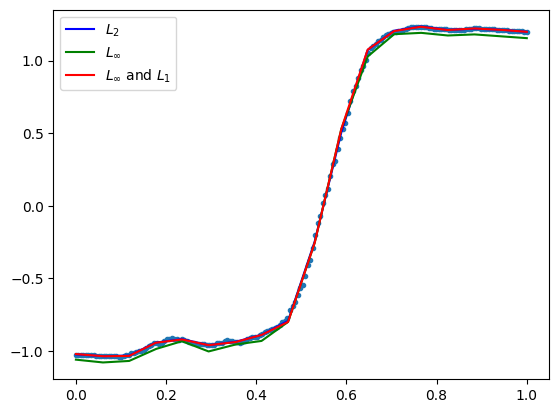

            max_dist       MSE      RMSE       MAE
LSQ         0.023870  0.000040  0.006334  0.004041
Max         0.019852  0.000256  0.015995  0.015029
Max and L1  0.019853  0.000049  0.006992  0.004280 

opt distance 0.019851547811653363
number of data points: 180


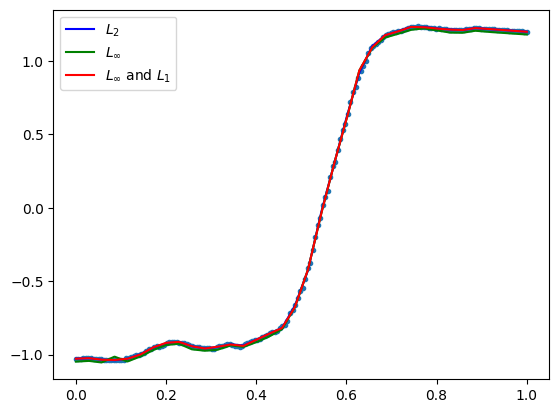

            max_dist       MSE      RMSE       MAE
LSQ         0.023074  0.000033  0.005752  0.003377
Max         0.020320  0.000304  0.017443  0.016677
Max and L1  0.020321  0.000038  0.006131  0.003287 

opt distance 0.020320138562574266
number of data points: 180


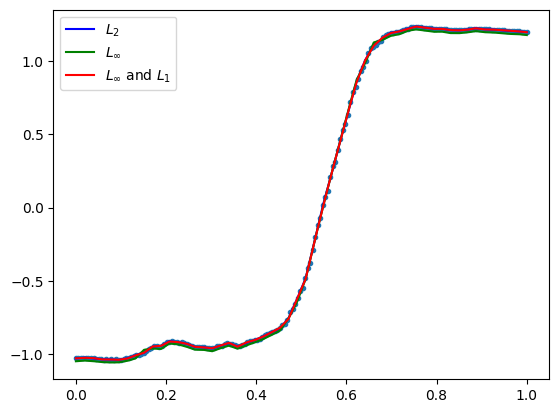

            max_dist       MSE      RMSE       MAE
LSQ         0.022881  0.000024  0.004908  0.002626
Max         0.020104  0.000321  0.017918  0.017267
Max and L1  0.020105  0.000033  0.005716  0.002628 

opt distance 0.02010361137141134
number of data points: 180


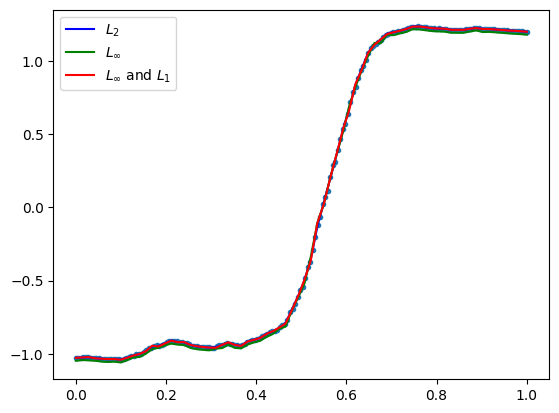

            max_dist       MSE      RMSE       MAE
LSQ         0.022903  0.000023  0.004772  0.002378
Max         0.019107  0.000313  0.017687  0.017311
Max and L1  0.019108  0.000033  0.005739  0.002560 

opt distance 0.019107265436244577
number of data points: 180


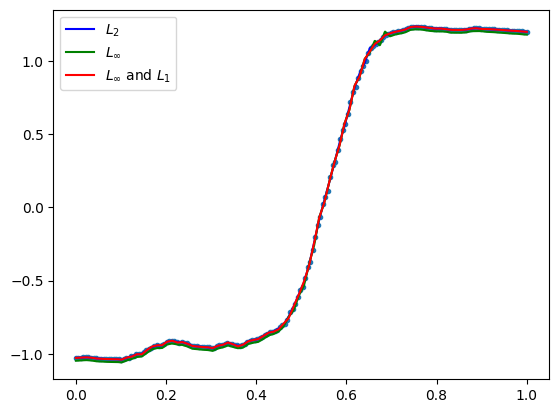

GestureMidAirD3 no. 73 len(ts): 179 ts processed: 35.099999999999994 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.091498  0.001091  0.033025  0.023997
Max         0.082638  0.003357  0.057936  0.052771
Max and L1  0.082639  0.001233  0.035118  0.025219 

opt distance 0.08263836245491132
number of data points: 179


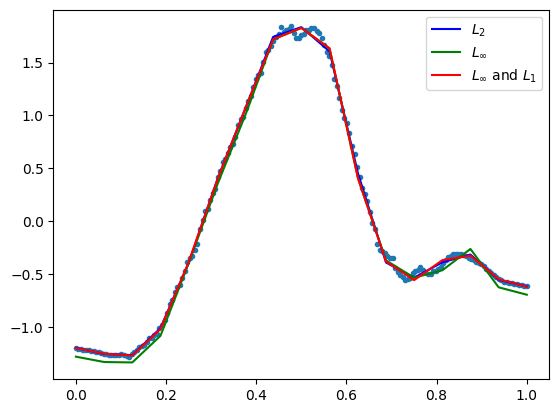

            max_dist       MSE      RMSE       MAE
LSQ         0.047060  0.000287  0.016934  0.012343
Max         0.038004  0.000792  0.028149  0.025325
Max and L1  0.038005  0.000332  0.018230  0.013120 

opt distance 0.0380038358076554
number of data points: 179


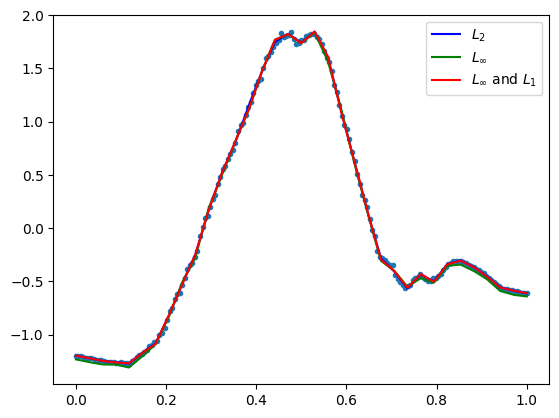

            max_dist       MSE      RMSE       MAE
LSQ         0.041828  0.000180  0.013425  0.009362
Max         0.036355  0.000792  0.028149  0.025326
Max and L1  0.036356  0.000204  0.014295  0.009149 

opt distance 0.03635510425488603
number of data points: 179


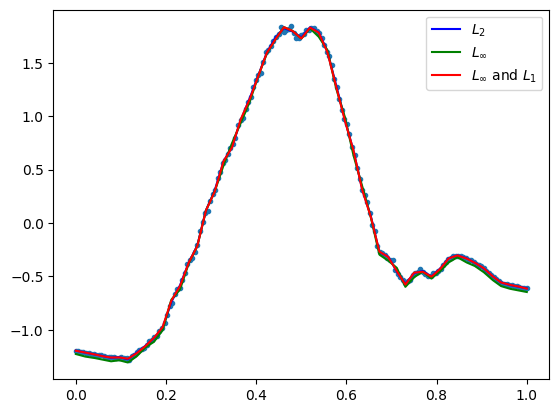

            max_dist       MSE      RMSE       MAE
LSQ         0.043295  0.000150  0.012262  0.008701
Max         0.028939  0.000538  0.023197  0.021153
Max and L1  0.028940  0.000183  0.013535  0.008698 

opt distance 0.02893852712075103
number of data points: 179


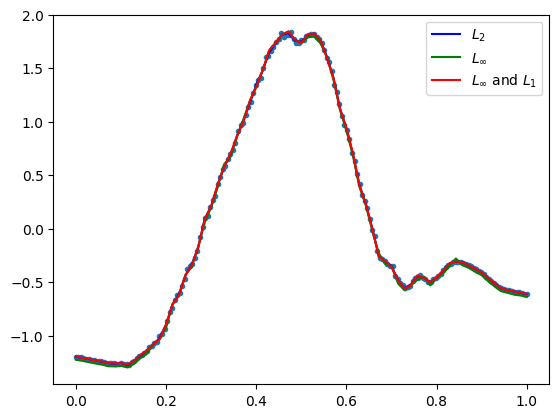

            max_dist       MSE      RMSE       MAE
LSQ         0.028917  0.000073  0.008571  0.006056
Max         0.019344  0.000272  0.016485  0.015513
Max and L1  0.019345  0.000097  0.009852  0.006421 

opt distance 0.019343743898884012
number of data points: 179


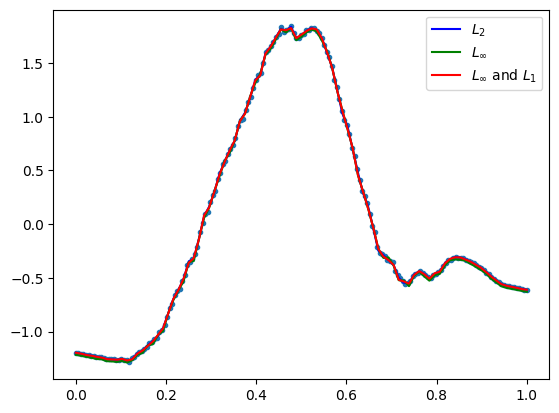

GestureMidAirD3 no. 74 len(ts): 84 ts processed: 35.58 %
[8, 16, 25, 33, 42]
            max_dist       MSE      RMSE       MAE
LSQ         0.301980  0.007185  0.084765  0.060925
Max         0.210736  0.015982  0.126421  0.105112
Max and L1  0.210737  0.013883  0.117824  0.096290 

opt distance 0.21073599382354913
number of data points: 84


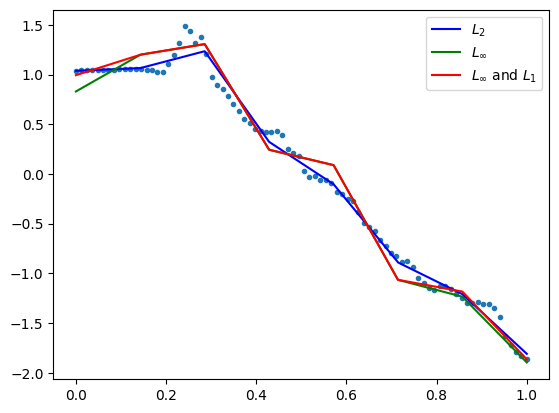

            max_dist       MSE      RMSE       MAE
LSQ         0.165532  0.001854  0.043052  0.031720
Max         0.131173  0.008483  0.092102  0.081932
Max and L1  0.131174  0.003202  0.056584  0.042110 

opt distance 0.13117320374274344
number of data points: 84


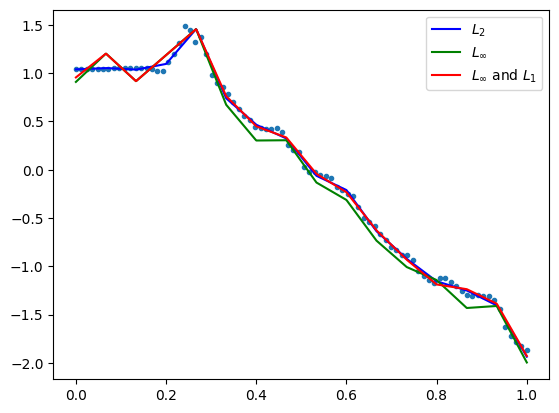

            max_dist       MSE      RMSE       MAE
LSQ         0.104032  0.000820  0.028637  0.020344
Max         0.080683  0.003656  0.060467  0.055544
Max and L1  0.080684  0.001185  0.034419  0.022476 

opt distance 0.0806825868769333
number of data points: 84


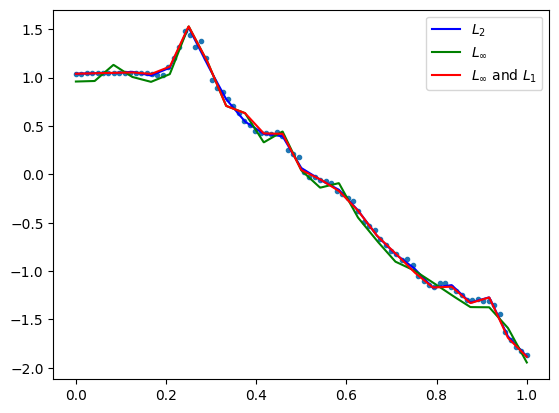

            max_dist       MSE      RMSE       MAE
LSQ         0.074058  0.000500  0.022353  0.014963
Max         0.064102  0.002672  0.051691  0.047478
Max and L1  0.064103  0.000716  0.026766  0.016608 

opt distance 0.06410239994305711
number of data points: 84


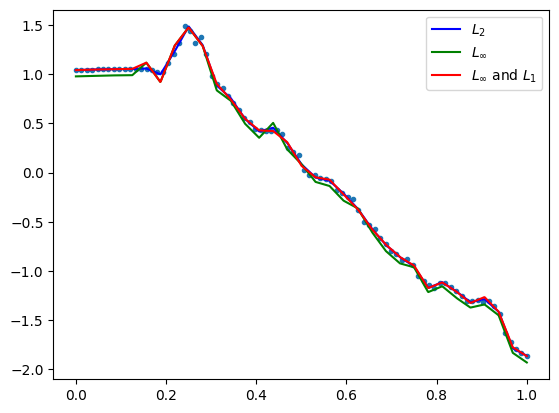

            max_dist       MSE      RMSE       MAE
LSQ         0.085298  0.000369  0.019196  0.012026
Max         0.064248  0.002928  0.054111  0.050897
Max and L1  0.064249  0.000765  0.027660  0.016371 

opt distance 0.06424772423884914
number of data points: 84


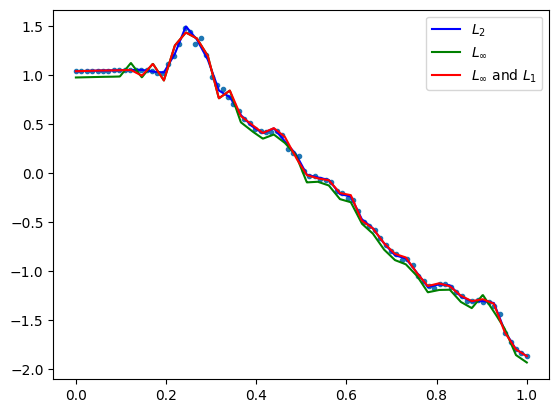

GestureMidAirD3 no. 75 len(ts): 226 ts processed: 36.059999999999995 %
[22, 45, 67, 90, 113]
            max_dist       MSE      RMSE       MAE
LSQ         0.731076  0.018384  0.135588  0.064476
Max         0.675717  0.326613  0.571500  0.548344
Max and L1  0.675718  0.018793  0.137088  0.064970 
opt distance 0.6757170318696167
number of data points: 226


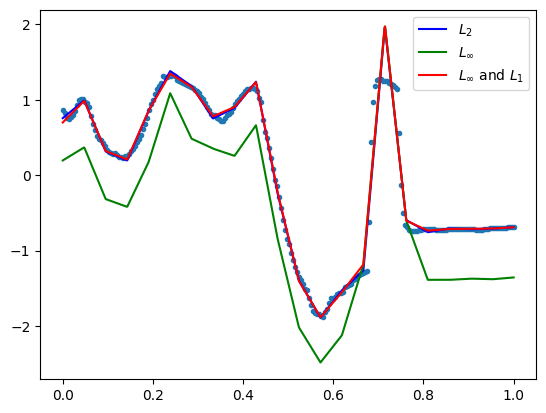

            max_dist       MSE      RMSE       MAE
LSQ         0.699929  0.013583  0.116548  0.048891
Max         0.549579  0.239412  0.489298  0.471590
Max and L1  0.549580  0.030351  0.174215  0.083809 

opt distance 0.5495793890206486
number of data points: 226


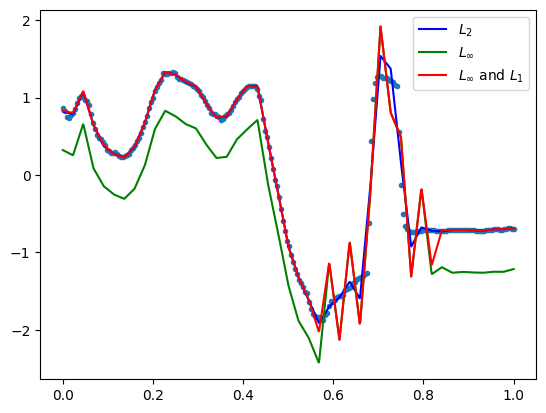

            max_dist       MSE      RMSE       MAE
LSQ         0.499950  0.003803  0.061670  0.022498
Max         0.391575  0.133567  0.365469  0.359842
Max and L1  0.391576  0.005623  0.074987  0.026022 

opt distance 0.39157468648281474
number of data points: 226


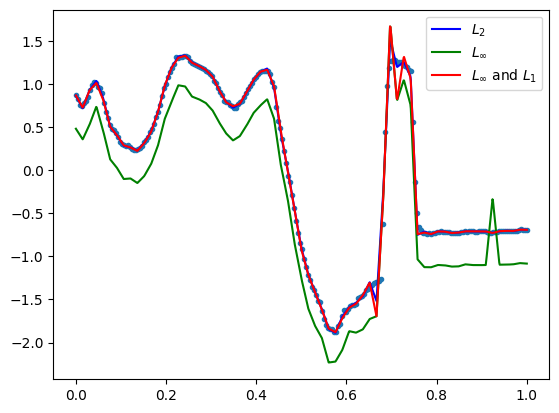

            max_dist       MSE      RMSE       MAE
LSQ         0.217883  0.000591  0.024311  0.010588
Max         0.155296  0.020455  0.143020  0.139892
Max and L1  0.155297  0.001169  0.034193  0.013585 

opt distance 0.15529618154153174
number of data points: 226


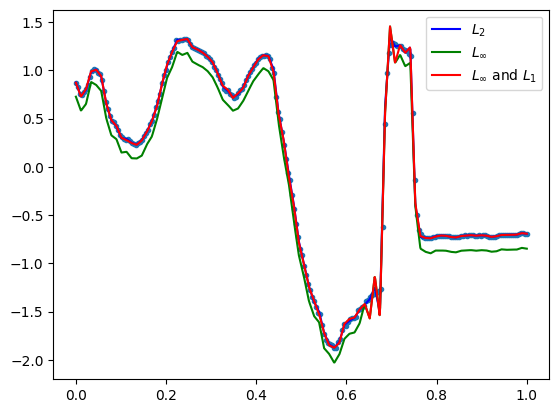

            max_dist       MSE      RMSE       MAE
LSQ         0.134834  0.000360  0.018983  0.009201
Max         0.095234  0.007698  0.087738  0.086002
Max and L1  0.095235  0.000639  0.025274  0.010907 

opt distance 0.09523445638170713
number of data points: 226


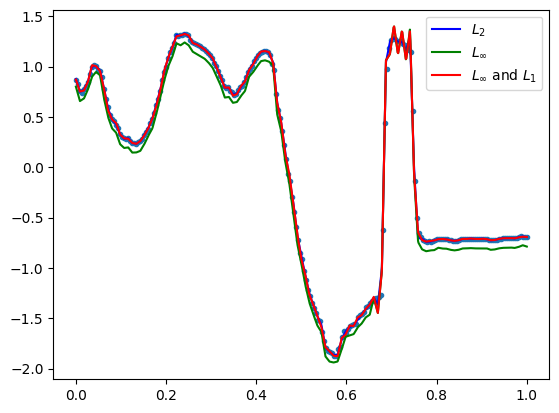

GestureMidAirD3 no. 76 len(ts): 118 ts processed: 36.54 %
[11, 23, 35, 47, 59]
            max_dist       MSE      RMSE       MAE
LSQ         0.151812  0.003600  0.060003  0.046397
Max         0.122237  0.007381  0.085912  0.077828
Max and L1  0.122238  0.004570  0.067604  0.054851 

opt distance 0.12223708949372475
number of data points: 118


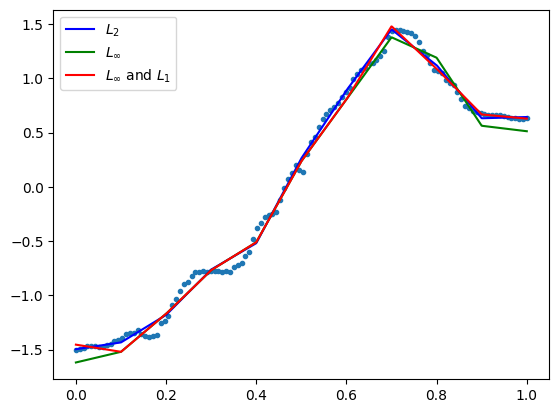

            max_dist       MSE      RMSE       MAE
LSQ         0.104994  0.000728  0.026989  0.018604
Max         0.084582  0.003887  0.062348  0.057180
Max and L1  0.084583  0.001361  0.036896  0.025881 

opt distance 0.08458215739704378
number of data points: 118


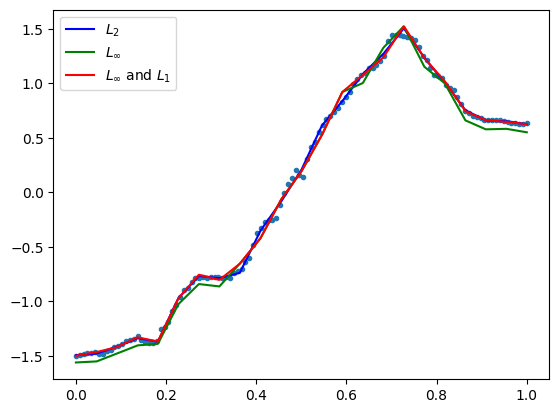

            max_dist       MSE      RMSE       MAE
LSQ         0.066476  0.000229  0.015125  0.010080
Max         0.056043  0.001961  0.044283  0.041243
Max and L1  0.056044  0.000396  0.019894  0.012098 

opt distance 0.05604305309178121
number of data points: 118


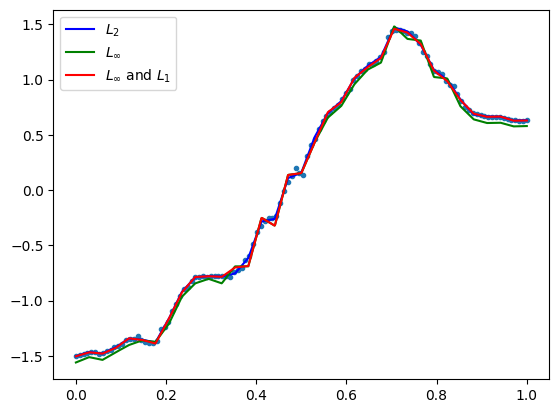

            max_dist       MSE      RMSE       MAE
LSQ         0.048567  0.000189  0.013748  0.009361
Max         0.044268  0.001395  0.037348  0.035278
Max and L1  0.044269  0.000224  0.014952  0.008721 

opt distance 0.04426807669910537
number of data points: 118


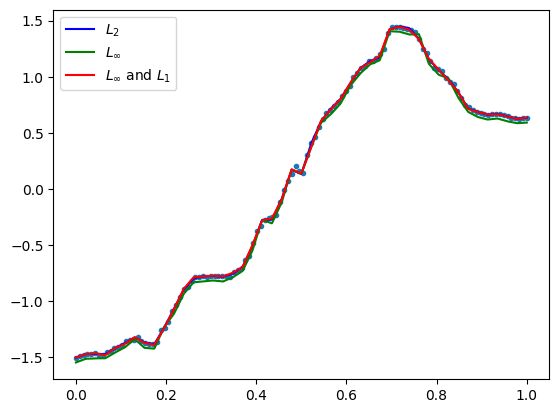

            max_dist       MSE      RMSE       MAE
LSQ         0.036197  0.000117  0.010830  0.007614
Max         0.026806  0.000512  0.022617  0.021186
Max and L1  0.026807  0.000166  0.012895  0.008151 

opt distance 0.02680613502572521
number of data points: 118


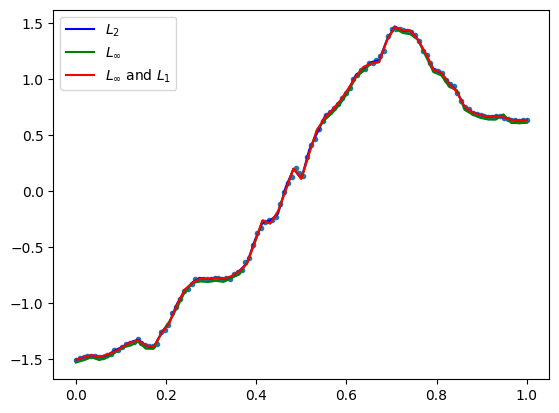

GestureMidAirD3 no. 77 len(ts): 170 ts processed: 37.019999999999996 %
[17, 34, 51, 68, 85]
            max_dist       MSE      RMSE       MAE
LSQ         0.057878  0.000250  0.015820  0.011466
Max         0.046683  0.001015  0.031858  0.027805
Max and L1  0.046684  0.000302  0.017366  0.012110 

opt distance 0.04668269319081175
number of data points: 170


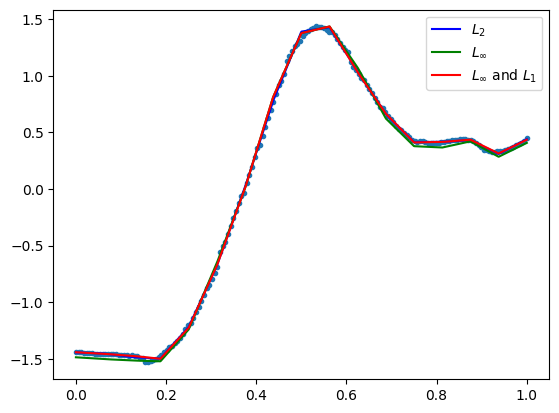

            max_dist       MSE      RMSE       MAE
LSQ         0.033950  0.000093  0.009646  0.006733
Max         0.026561  0.000358  0.018922  0.016820
Max and L1  0.026562  0.000107  0.010362  0.006827 

opt distance 0.02656124937199074
number of data points: 170


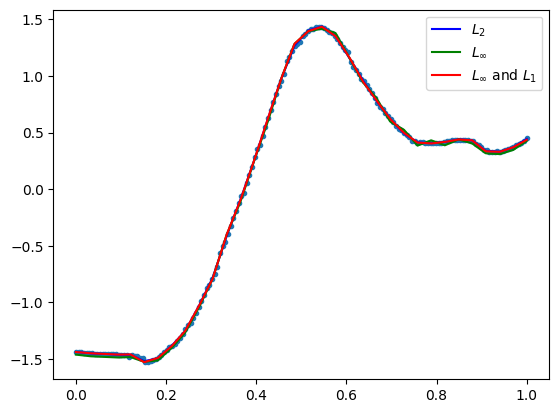

            max_dist       MSE      RMSE       MAE
LSQ         0.032690  0.000056  0.007500  0.005015
Max         0.024570  0.000398  0.019952  0.018506
Max and L1  0.024571  0.000068  0.008248  0.004898 

opt distance 0.02457049693789859
number of data points: 170


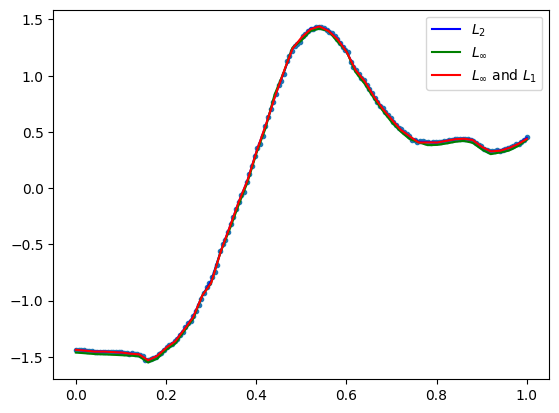

            max_dist       MSE      RMSE       MAE
LSQ         0.031646  0.000044  0.006626  0.004176
Max         0.023709  0.000398  0.019941  0.018769
Max and L1  0.023710  0.000055  0.007440  0.004013 

opt distance 0.02370912283894429
number of data points: 170


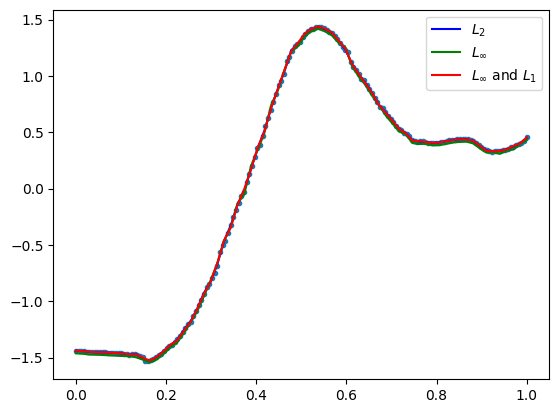

            max_dist       MSE      RMSE       MAE
LSQ         0.024466  0.000032  0.005673  0.003515
Max         0.017864  0.000248  0.015742  0.015115
Max and L1  0.017865  0.000046  0.006787  0.003758 

opt distance 0.01786367463870884
number of data points: 170


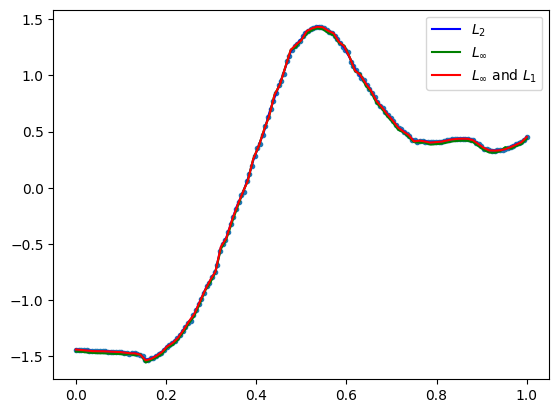

GestureMidAirD3 no. 78 len(ts): 90 ts processed: 37.5 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.098758  0.001349  0.036730  0.026805
Max         0.090868  0.004039  0.063550  0.058668
Max and L1  0.090869  0.001797  0.042393  0.032050 

opt distance 0.09086763998594083
number of data points: 90


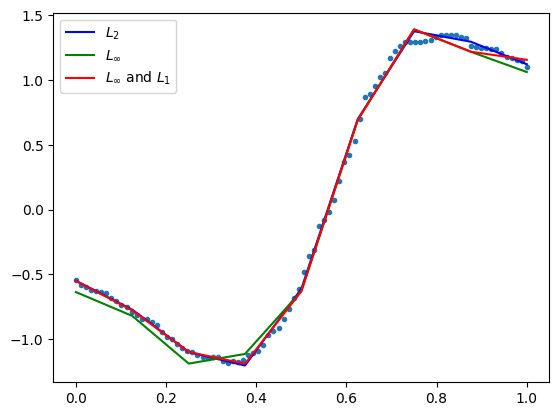

            max_dist       MSE      RMSE       MAE
LSQ         0.064493  0.000336  0.018324  0.013336
Max         0.046637  0.001045  0.032331  0.028945
Max and L1  0.046638  0.000372  0.019295  0.013460 

opt distance 0.04663705878457768
number of data points: 90


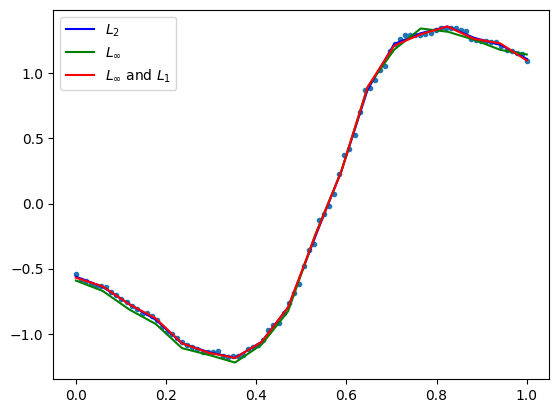

            max_dist       MSE      RMSE       MAE
LSQ         0.072228  0.000283  0.016810  0.011854
Max         0.049846  0.001608  0.040099  0.037733
Max and L1  0.049847  0.000327  0.018095  0.011782 

opt distance 0.049845730338136274
number of data points: 90


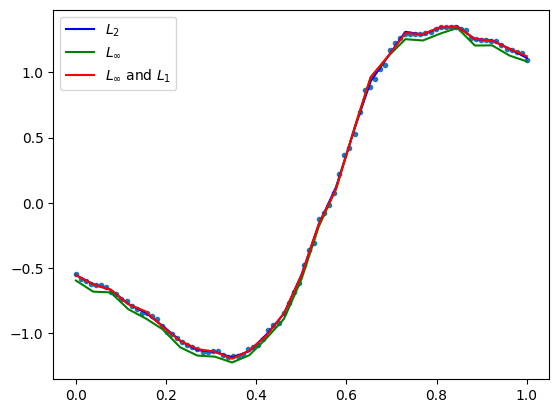

            max_dist       MSE      RMSE       MAE
LSQ         0.068260  0.000214  0.014642  0.009332
Max         0.047489  0.001525  0.039051  0.036534
Max and L1  0.047490  0.000329  0.018139  0.010630 

opt distance 0.04748935423441546
number of data points: 90


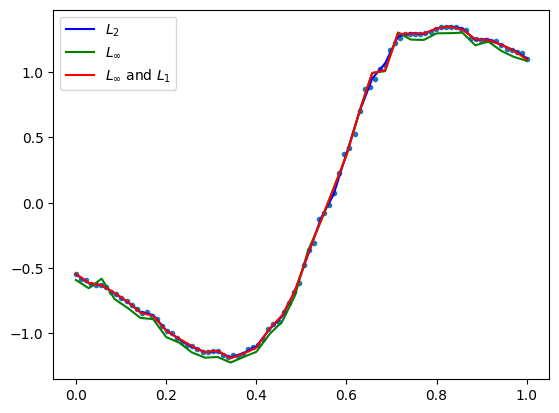

            max_dist       MSE      RMSE       MAE
LSQ         0.037935  0.000081  0.009009  0.006271
Max         0.028612  0.000612  0.024744  0.023524
Max and L1  0.028613  0.000155  0.012470  0.007782 

opt distance 0.028611851469229843
number of data points: 90


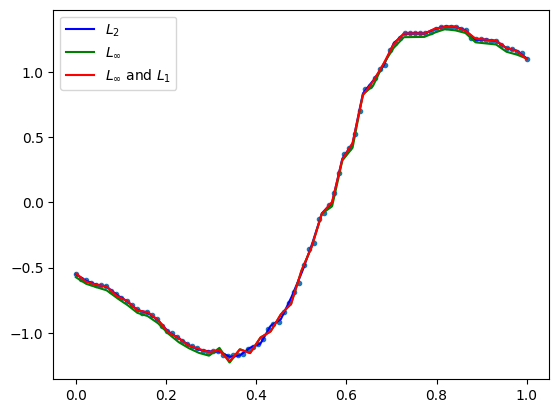

GestureMidAirD3 no. 79 len(ts): 125 ts processed: 37.980000000000004 %
[12, 25, 37, 50, 62]
            max_dist       MSE      RMSE       MAE
LSQ         0.042192  0.000132  0.011497  0.008465
Max         0.030462  0.000367  0.019170  0.016428
Max and L1  0.030463  0.000169  0.012995  0.009414 

opt distance 0.03046223252713597
number of data points: 125


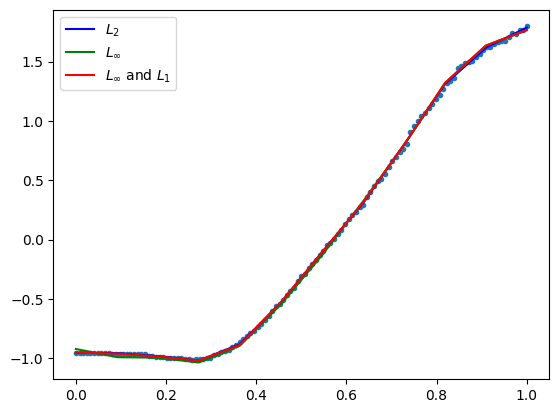

            max_dist       MSE      RMSE       MAE
LSQ         0.037790  0.000081  0.008979  0.005946
Max         0.027189  0.000408  0.020197  0.018236
Max and L1  0.027190  0.000101  0.010055  0.006468 

opt distance 0.02718890660006246
number of data points: 125


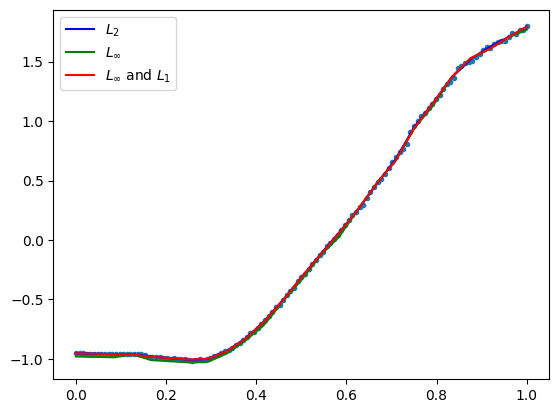

            max_dist       MSE      RMSE       MAE
LSQ         0.028984  0.000051  0.007149  0.004921
Max         0.019959  0.000250  0.015826  0.014558
Max and L1  0.019960  0.000069  0.008333  0.005301 

opt distance 0.019958539347208266
number of data points: 125


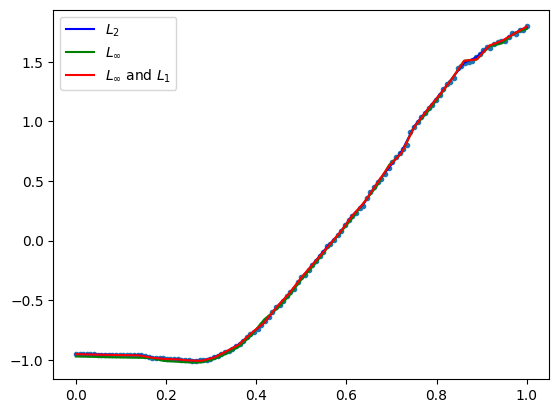

            max_dist       MSE      RMSE       MAE
LSQ         0.024506  0.000038  0.006150  0.003956
Max         0.016660  0.000192  0.013866  0.013048
Max and L1  0.016661  0.000050  0.007095  0.004325 

opt distance 0.01665986513765183
number of data points: 125


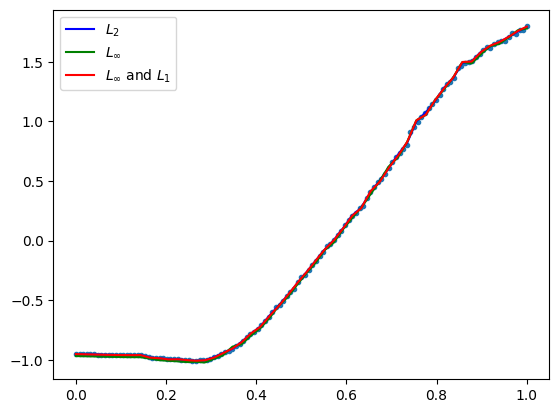

            max_dist       MSE      RMSE       MAE
LSQ         0.021151  0.000026  0.005052  0.003275
Max         0.015986  0.000198  0.014055  0.013510
Max and L1  0.015987  0.000048  0.006911  0.004010 

opt distance 0.015986171312549646
number of data points: 125


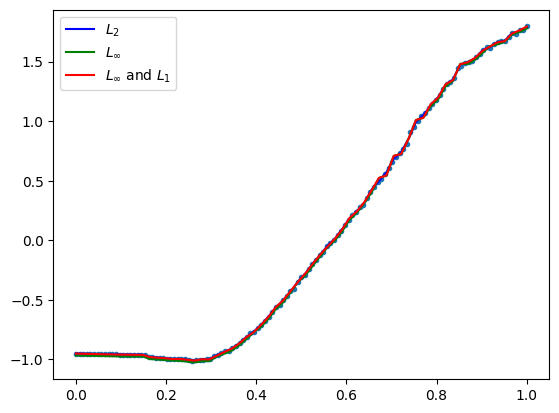

GestureMidAirD3 no. 80 len(ts): 119 ts processed: 38.46 %
[11, 23, 35, 47, 59]
            max_dist       MSE      RMSE       MAE
LSQ         0.204181  0.005428  0.073676  0.058848
Max         0.166271  0.011734  0.108322  0.095808
Max and L1  0.166272  0.005735  0.075730  0.059987 

opt distance 0.16627118365727178
number of data points: 119


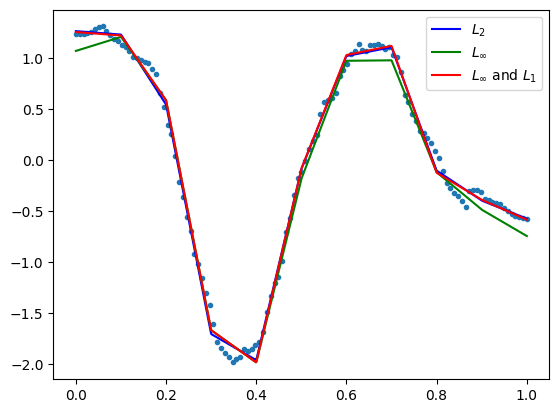

            max_dist       MSE      RMSE       MAE
LSQ         0.132218  0.001814  0.042593  0.034133
Max         0.097246  0.004342  0.065896  0.057154
Max and L1  0.097247  0.002273  0.047680  0.035260 

opt distance 0.09724565764663141
number of data points: 119


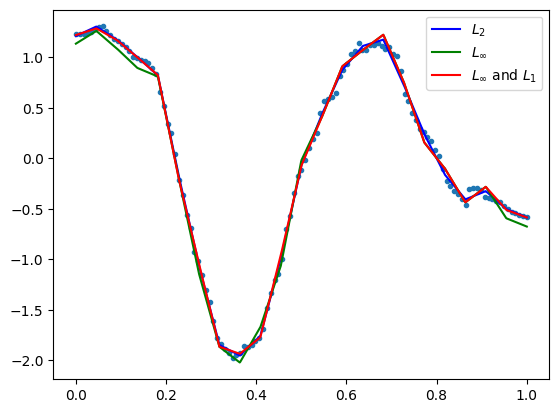

            max_dist       MSE      RMSE       MAE
LSQ         0.090453  0.000828  0.028768  0.021069
Max         0.062457  0.002369  0.048674  0.044491
Max and L1  0.062458  0.001042  0.032278  0.023284 

opt distance 0.062457382150311394
number of data points: 119


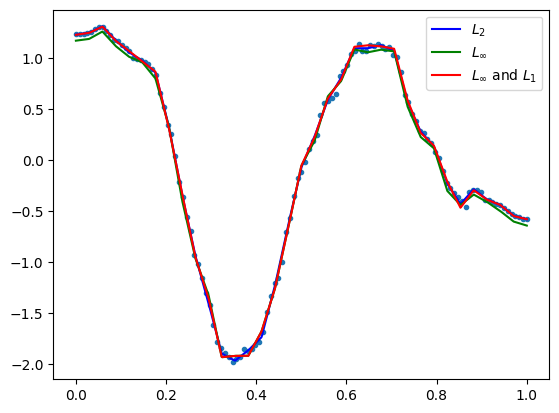

            max_dist       MSE      RMSE       MAE
LSQ         0.075602  0.000554  0.023536  0.016317
Max         0.060795  0.002323  0.048202  0.043875
Max and L1  0.060796  0.000727  0.026963  0.017280 

opt distance 0.060795381669867525
number of data points: 119


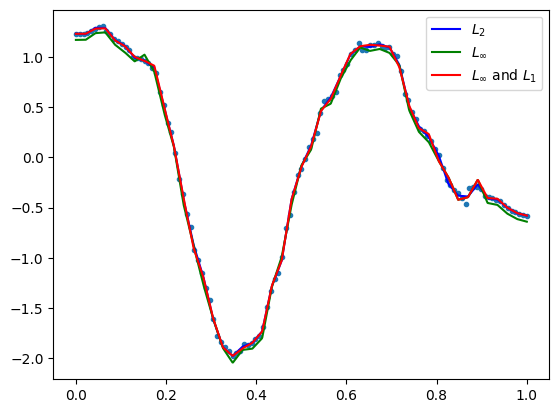

            max_dist       MSE      RMSE       MAE
LSQ         0.051639  0.000354  0.018826  0.013880
Max         0.038627  0.001073  0.032764  0.030817
Max and L1  0.038628  0.000418  0.020442  0.013784 

opt distance 0.0386272407415138
number of data points: 119


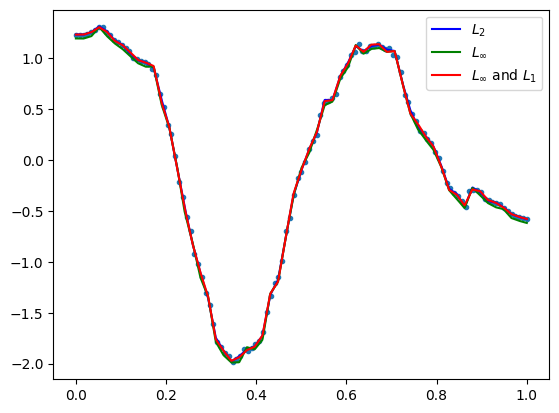

GestureMidAirD3 no. 81 len(ts): 197 ts processed: 38.940000000000005 %
[19, 39, 59, 78, 98]
            max_dist       MSE      RMSE       MAE
LSQ         0.176122  0.002052  0.045298  0.034767
Max         0.138108  0.008726  0.093414  0.082989
Max and L1  0.138109  0.002950  0.054313  0.039428 
opt distance 0.13810844487930163
number of data points: 197


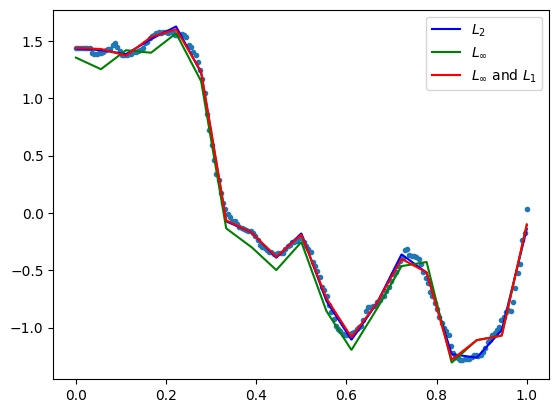

            max_dist       MSE      RMSE       MAE
LSQ         0.067236  0.000308  0.017546  0.012400
Max         0.050020  0.001431  0.037822  0.035158
Max and L1  0.050021  0.000401  0.020015  0.013311 

opt distance 0.050020178703544575
number of data points: 197


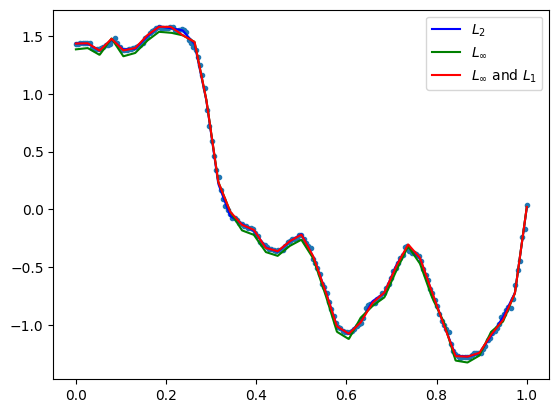

            max_dist       MSE      RMSE       MAE
LSQ         0.044936  0.000149  0.012197  0.008613
Max         0.038466  0.000900  0.029996  0.027757
Max and L1  0.038467  0.000164  0.012801  0.008035 

opt distance 0.03846557775256544
number of data points: 197


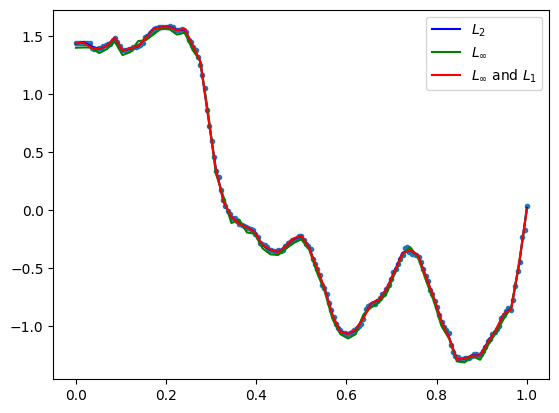

            max_dist       MSE      RMSE       MAE
LSQ         0.043799  0.000123  0.011083  0.007697
Max         0.038240  0.000981  0.031314  0.029228
Max and L1  0.038241  0.000150  0.012268  0.007082 

opt distance 0.03823954757464343
number of data points: 197


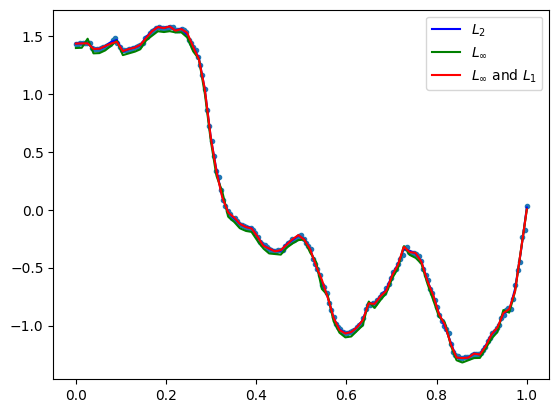

            max_dist       MSE      RMSE       MAE
LSQ         0.042729  0.000085  0.009199  0.006177
Max         0.037122  0.001090  0.033008  0.031797
Max and L1  0.037123  0.000109  0.010432  0.005450 

opt distance 0.037121530936679796
number of data points: 197


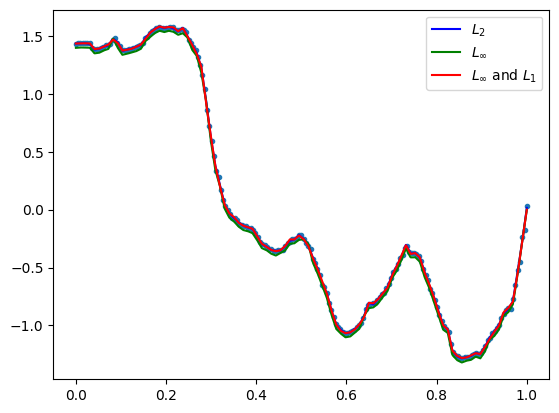

GestureMidAirD3 no. 82 len(ts): 179 ts processed: 39.42 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.332458  0.003139  0.056030  0.026463
Max         0.257915  0.047674  0.218343  0.209530
Max and L1  0.257916  0.005863  0.076570  0.039890 

opt distance 0.25791517020718796
number of data points: 179


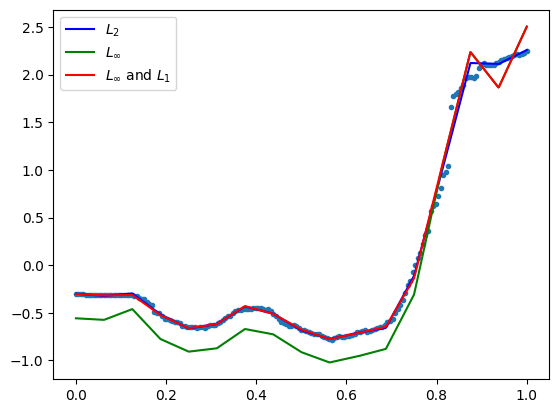

            max_dist       MSE      RMSE       MAE
LSQ         0.278541  0.001409  0.037537  0.014976
Max         0.225078  0.040536  0.201336  0.195205
Max and L1  0.225079  0.002531  0.050314  0.020540 

opt distance 0.22507770779833552
number of data points: 179


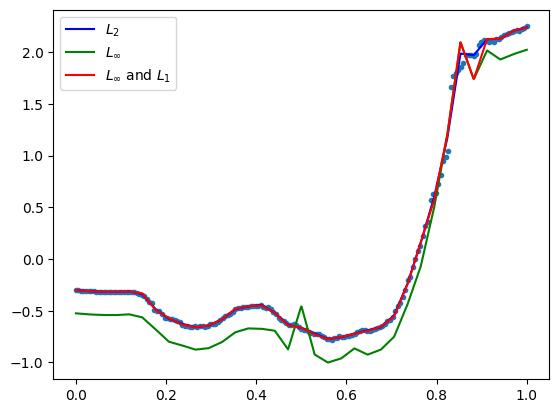

            max_dist       MSE      RMSE       MAE
LSQ         0.237626  0.000929  0.030483  0.010883
Max         0.199669  0.035008  0.187105  0.184489
Max and L1  0.199670  0.001771  0.042083  0.015351 

opt distance 0.19966944045408286
number of data points: 179


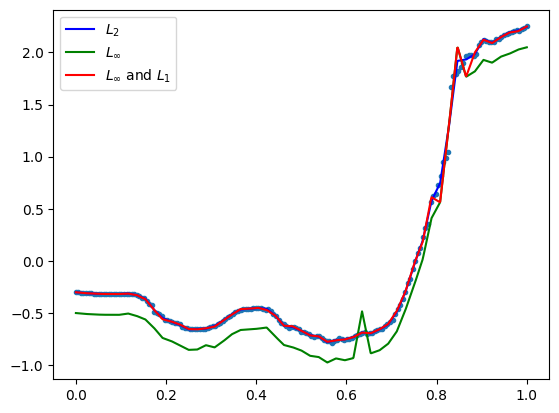

            max_dist       MSE      RMSE       MAE
LSQ         0.216552  0.000756  0.027490  0.009180
Max         0.188601  0.032666  0.180737  0.179114
Max and L1  0.188602  0.001034  0.032152  0.009741 

opt distance 0.1886008282892087
number of data points: 179


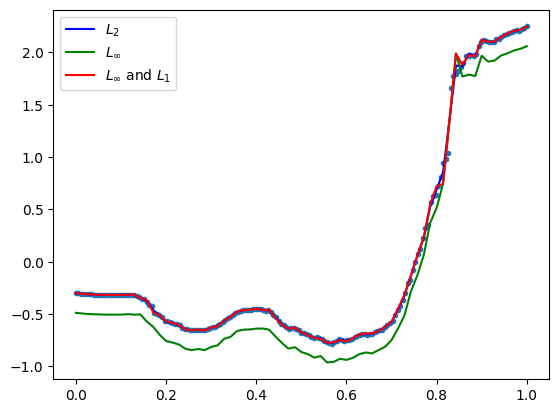

            max_dist       MSE      RMSE       MAE
LSQ         0.213876  0.000556  0.023587  0.007905
Max         0.146606  0.019437  0.139416  0.137191
Max and L1  0.146607  0.001523  0.039025  0.014202 

opt distance 0.14660643753098798
number of data points: 179


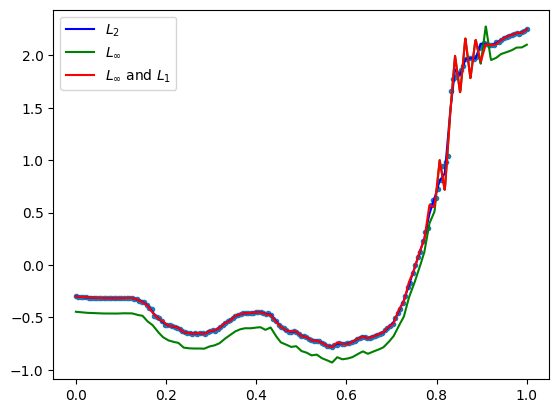

GestureMidAirD3 no. 83 len(ts): 180 ts processed: 39.900000000000006 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.064164  0.000222  0.014912  0.010872
Max         0.044662  0.001059  0.032540  0.029915
Max and L1  0.044663  0.000257  0.016035  0.011324 

opt distance 0.04466183945683089
number of data points: 180


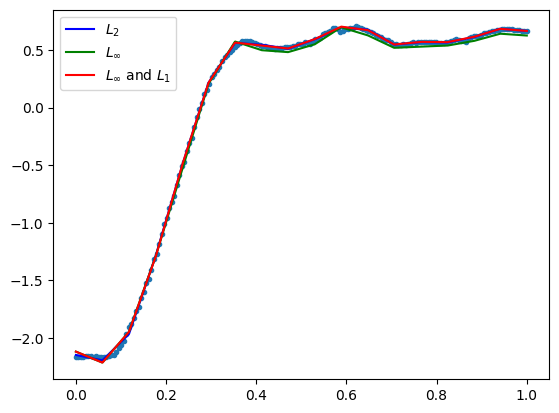

            max_dist       MSE      RMSE       MAE
LSQ         0.029921  0.000062  0.007854  0.005408
Max         0.023777  0.000323  0.017968  0.016537
Max and L1  0.023778  0.000076  0.008718  0.005528 

opt distance 0.023777000662892723
number of data points: 180


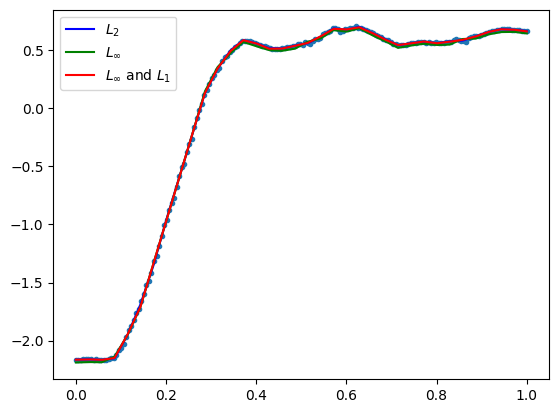

            max_dist       MSE      RMSE       MAE
LSQ         0.028328  0.000054  0.007315  0.004894
Max         0.021339  0.000295  0.017180  0.015911
Max and L1  0.021340  0.000063  0.007933  0.004776 

opt distance 0.021338504456831133
number of data points: 180


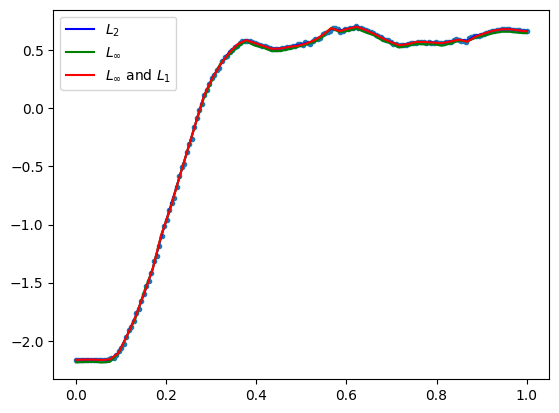

            max_dist       MSE      RMSE       MAE
LSQ         0.023182  0.000037  0.006091  0.003939
Max         0.018860  0.000254  0.015933  0.015146
Max and L1  0.018861  0.000044  0.006632  0.003630 

opt distance 0.01885955809894619
number of data points: 180


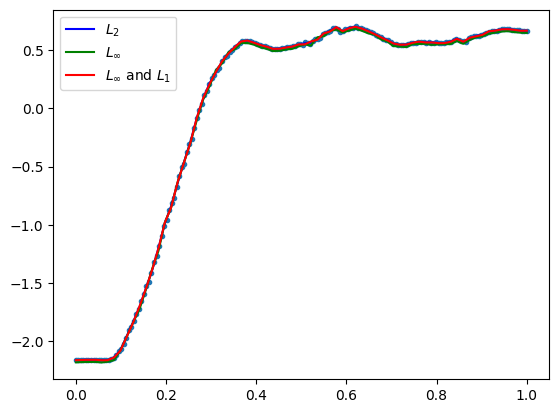

            max_dist       MSE      RMSE       MAE
LSQ         0.026843  0.000029  0.005380  0.003333
Max         0.017393  0.000236  0.015362  0.014754
Max and L1  0.017394  0.000038  0.006174  0.003273 

opt distance 0.017392607222683612
number of data points: 180


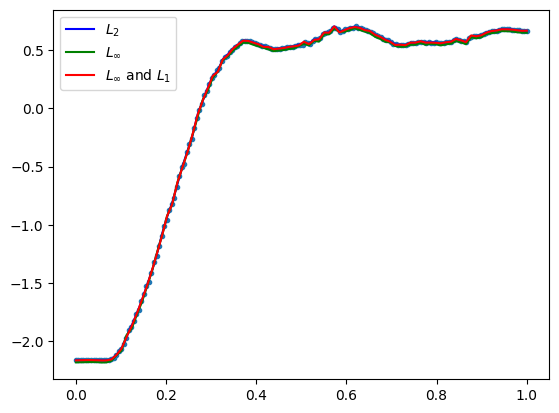

GestureMidAirD3 no. 84 len(ts): 119 ts processed: 40.38 %
[11, 23, 35, 47, 59]
            max_dist       MSE      RMSE       MAE
LSQ         0.171021  0.001698  0.041210  0.031267
Max         0.118976  0.006230  0.078929  0.070489
Max and L1  0.118977  0.003653  0.060444  0.048132 

opt distance 0.11897595896100363
number of data points: 119


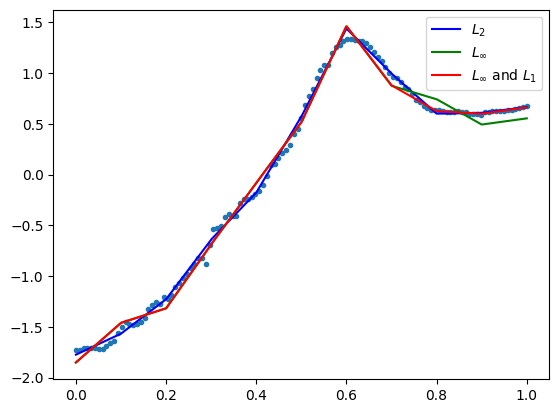

            max_dist       MSE      RMSE       MAE
LSQ         0.141364  0.000729  0.026997  0.018973
Max         0.098218  0.005401  0.073492  0.067442
Max and L1  0.098219  0.001175  0.034279  0.022318 

opt distance 0.09821823254084311
number of data points: 119


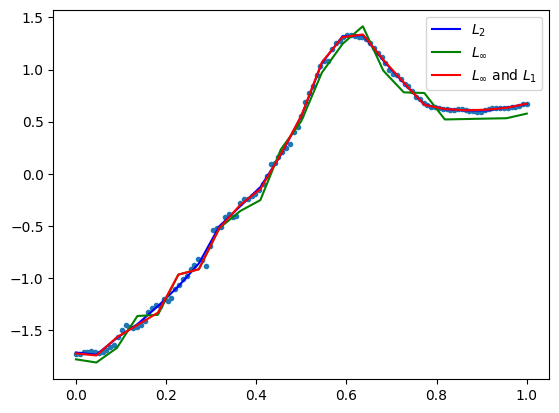

            max_dist       MSE      RMSE       MAE
LSQ         0.106123  0.000422  0.020550  0.012780
Max         0.086482  0.005261  0.072534  0.068561
Max and L1  0.086483  0.000584  0.024168  0.013465 

opt distance 0.08648175301453537
number of data points: 119


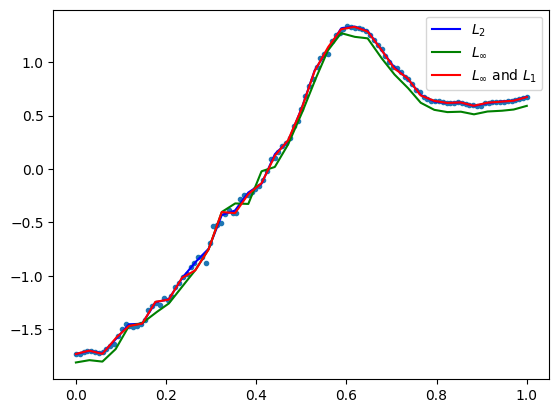

            max_dist       MSE      RMSE       MAE
LSQ         0.079736  0.000268  0.016363  0.010288
Max         0.059376  0.002590  0.050890  0.048231
Max and L1  0.059377  0.000359  0.018944  0.009908 

opt distance 0.05937622360183836
number of data points: 119


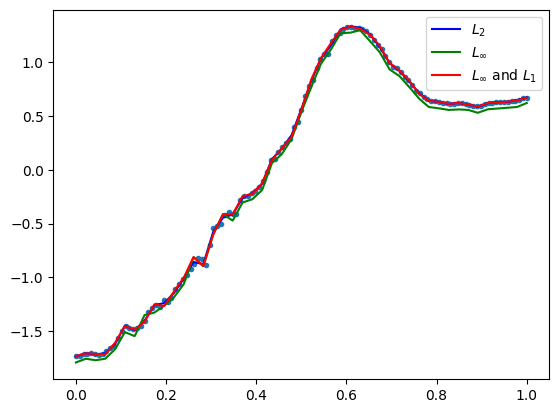

            max_dist       MSE      RMSE       MAE
LSQ         0.070702  0.000259  0.016078  0.009766
Max         0.047603  0.001698  0.041210  0.038867
Max and L1  0.047604  0.000388  0.019690  0.011292 

opt distance 0.04760268999419559
number of data points: 119


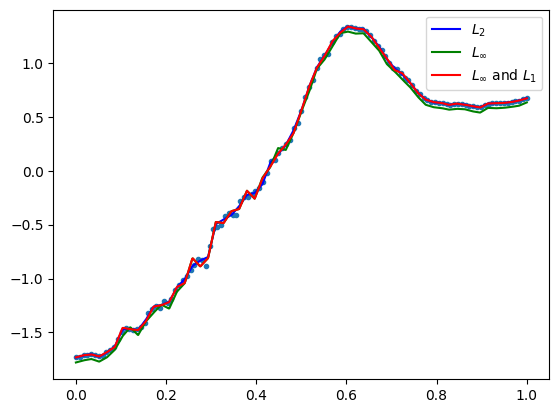

GestureMidAirD3 no. 85 len(ts): 285 ts processed: 40.87 %
[28, 57, 85, 114, 142]
            max_dist       MSE      RMSE       MAE
LSQ         0.147573  0.001936  0.044000  0.029831
Max         0.105347  0.005906  0.076848  0.068904
Max and L1  0.105348  0.002288  0.047836  0.033226 
opt distance 0.10534657595865887
number of data points: 285


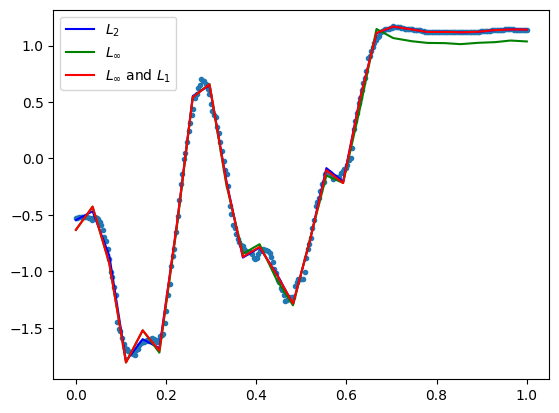

            max_dist       MSE      RMSE       MAE
LSQ         0.077489  0.000311  0.017646  0.010486
Max         0.070052  0.003176  0.056355  0.051968
Max and L1  0.070053  0.000471  0.021706  0.012030 

opt distance 0.07005245378033825
number of data points: 285


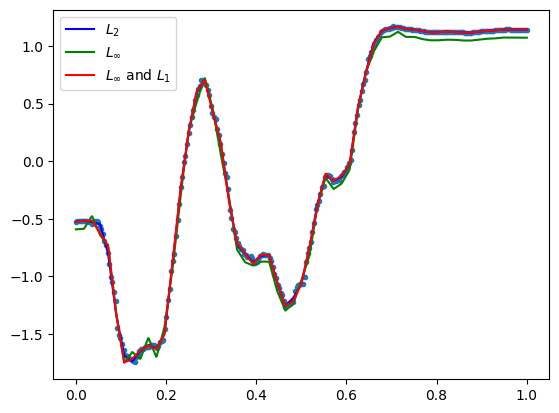

            max_dist       MSE      RMSE       MAE
LSQ         0.061790  0.000188  0.013694  0.008009
Max         0.044172  0.001366  0.036965  0.034455
Max and L1  0.044173  0.000236  0.015347  0.008583 

opt distance 0.04417152960401394
number of data points: 285


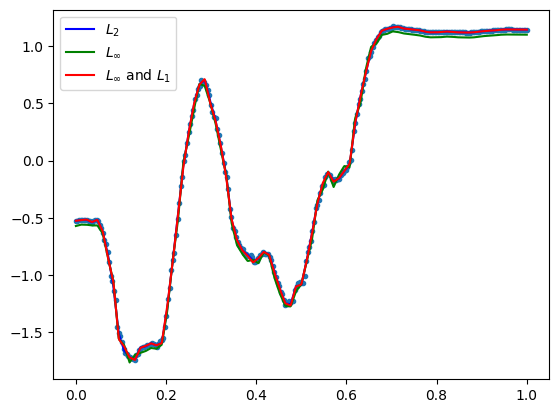

            max_dist       MSE      RMSE       MAE
LSQ         0.078161  0.000117  0.010805  0.006099
Max         0.057018  0.002527  0.050271  0.048090
Max and L1  0.057019  0.000204  0.014290  0.006449 

opt distance 0.057017743151646934
number of data points: 285


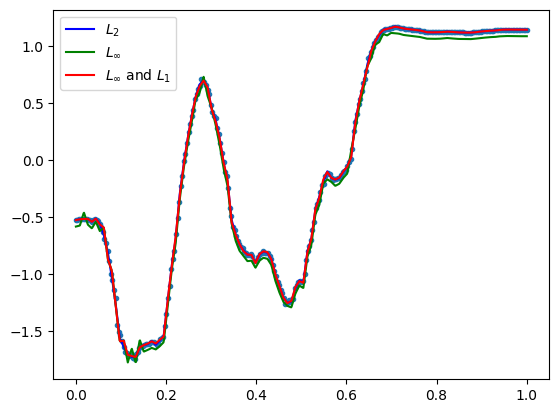

            max_dist       MSE      RMSE       MAE
LSQ         0.045869  0.000074  0.008600  0.005145
Max         0.033554  0.000891  0.029853  0.028370
Max and L1  0.033555  0.000112  0.010564  0.005048 
opt distance 0.0335542804578372
number of data points: 285


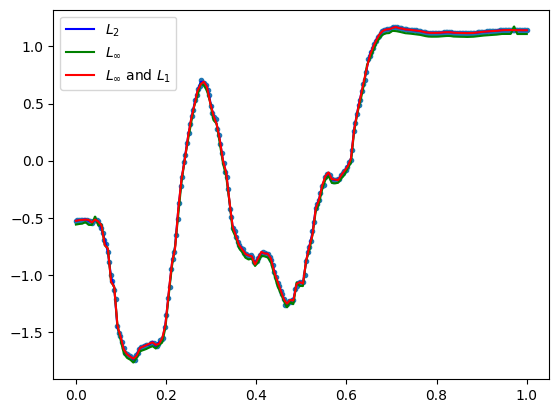

GestureMidAirD3 no. 86 len(ts): 171 ts processed: 41.349999999999994 %
[17, 34, 51, 68, 85]
            max_dist       MSE      RMSE       MAE
LSQ         0.145506  0.001196  0.034589  0.024189
Max         0.095310  0.004911  0.070076  0.063256
Max and L1  0.095311  0.001836  0.042851  0.029774 

opt distance 0.09530954829457974
number of data points: 171


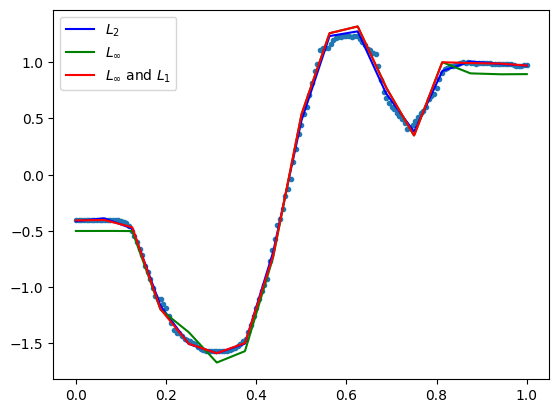

            max_dist       MSE      RMSE       MAE
LSQ         0.064868  0.000326  0.018068  0.012161
Max         0.048402  0.001440  0.037950  0.034820
Max and L1  0.048403  0.000478  0.021862  0.014774 

opt distance 0.048402311558161014
number of data points: 171


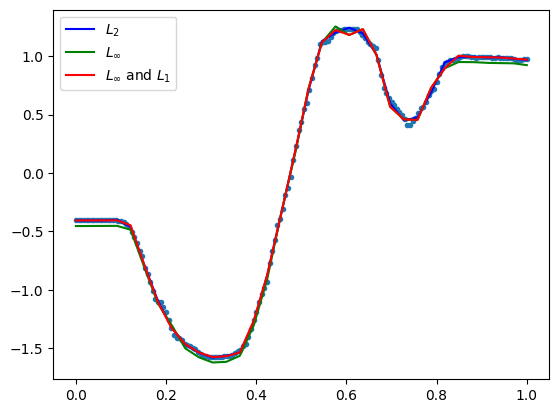

            max_dist       MSE      RMSE       MAE
LSQ         0.039896  0.000112  0.010573  0.006865
Max         0.032814  0.000675  0.025984  0.023837
Max and L1  0.032815  0.000139  0.011785  0.006902 

opt distance 0.03281423123435876
number of data points: 171


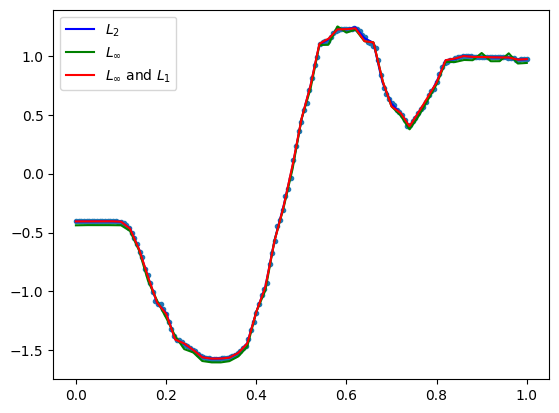

            max_dist       MSE      RMSE       MAE
LSQ         0.043226  0.000099  0.009930  0.006161
Max         0.026969  0.000521  0.022823  0.021369
Max and L1  0.026970  0.000135  0.011600  0.006974 

opt distance 0.026968763717876234
number of data points: 171


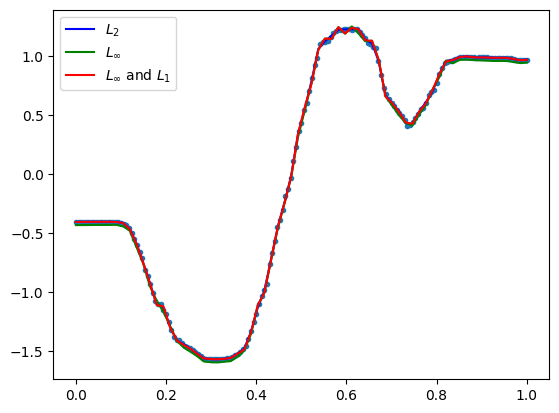

            max_dist       MSE      RMSE       MAE
LSQ         0.038546  0.000051  0.007137  0.004097
Max         0.026949  0.000591  0.024310  0.023412
Max and L1  0.026950  0.000071  0.008419  0.004000 

opt distance 0.026949251090101062
number of data points: 171


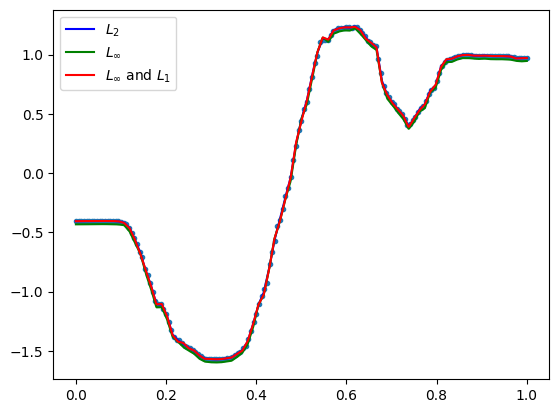

GestureMidAirD3 no. 87 len(ts): 179 ts processed: 41.83 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.215847  0.004610  0.067896  0.050034
Max         0.173085  0.013039  0.114187  0.099764
Max and L1  0.173086  0.006739  0.082094  0.062614 
opt distance 0.17308468294381096
number of data points: 179


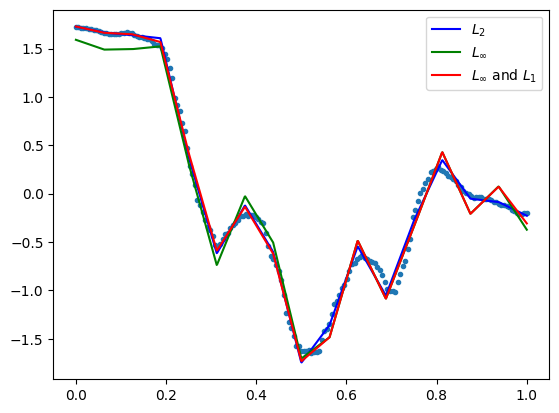

            max_dist       MSE      RMSE       MAE
LSQ         0.085338  0.000580  0.024087  0.016505
Max         0.062187  0.002113  0.045973  0.041908
Max and L1  0.062188  0.000713  0.026711  0.018578 

opt distance 0.06218714705711084
number of data points: 179


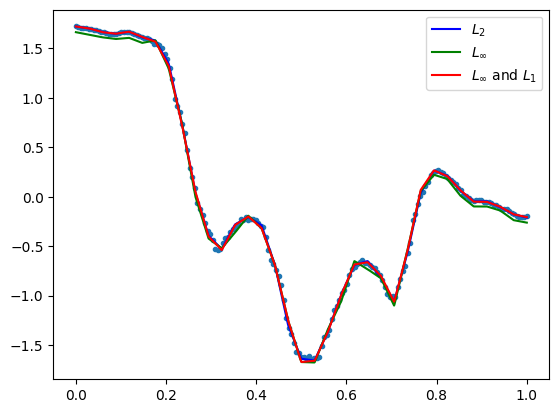

            max_dist       MSE      RMSE       MAE
LSQ         0.070466  0.000343  0.018532  0.012049
Max         0.055068  0.001937  0.044017  0.040719
Max and L1  0.055069  0.000411  0.020262  0.012100 

opt distance 0.0550682845721685
number of data points: 179


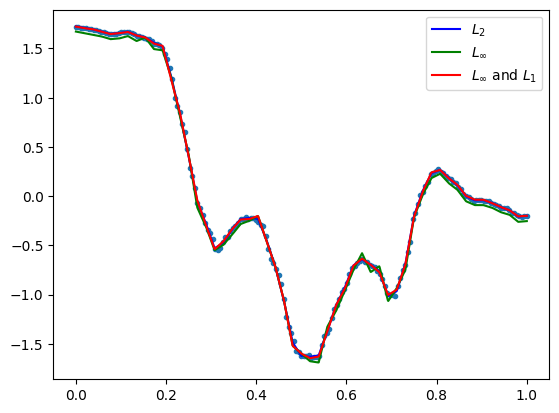

            max_dist       MSE      RMSE       MAE
LSQ         0.062361  0.000209  0.014456  0.009726
Max         0.045513  0.001397  0.037381  0.034923
Max and L1  0.045514  0.000293  0.017113  0.010070 

opt distance 0.04551317130575064
number of data points: 179


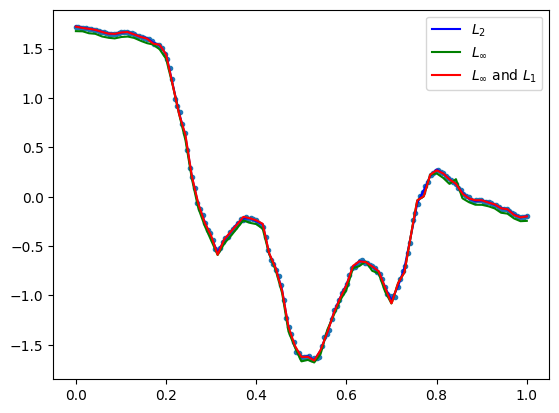

            max_dist       MSE      RMSE       MAE
LSQ         0.039118  0.000129  0.011379  0.007882
Max         0.031409  0.000697  0.026408  0.024562
Max and L1  0.031410  0.000182  0.013504  0.008049 

opt distance 0.03140852822927655
number of data points: 179


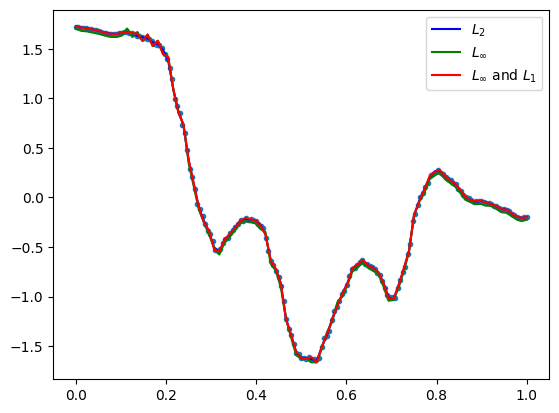

GestureMidAirD3 no. 88 len(ts): 171 ts processed: 42.309999999999995 %
[17, 34, 51, 68, 85]
            max_dist       MSE      RMSE       MAE
LSQ         0.092453  0.001026  0.032038  0.024130
Max         0.081196  0.003213  0.056687  0.050997
Max and L1  0.081197  0.001577  0.039712  0.031029 

opt distance 0.08119610049292472
number of data points: 171


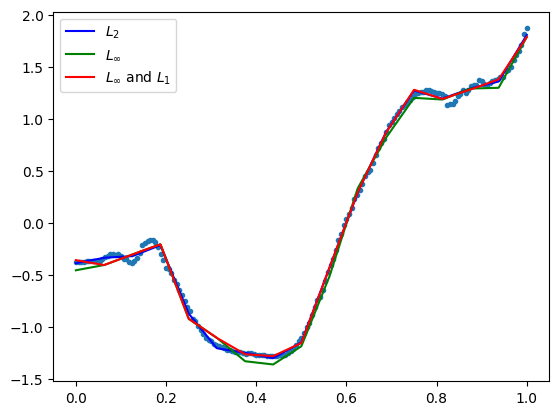

            max_dist       MSE      RMSE       MAE
LSQ         0.046499  0.000226  0.015021  0.010587
Max         0.042956  0.001103  0.033218  0.030881
Max and L1  0.042957  0.000254  0.015946  0.010665 

opt distance 0.042955852398080585
number of data points: 171


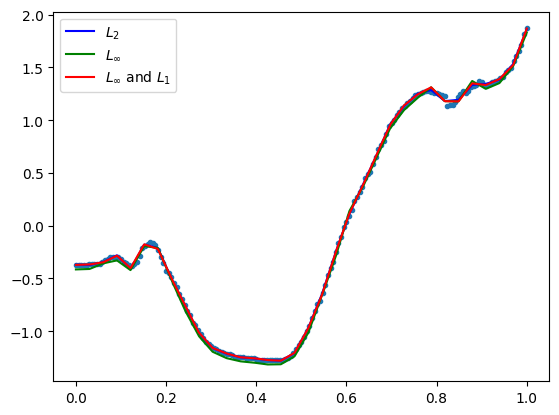

            max_dist       MSE      RMSE       MAE
LSQ         0.038618  0.000117  0.010806  0.007574
Max         0.033730  0.000730  0.027013  0.025022
Max and L1  0.033731  0.000173  0.013136  0.008419 

opt distance 0.0337303607403507
number of data points: 171


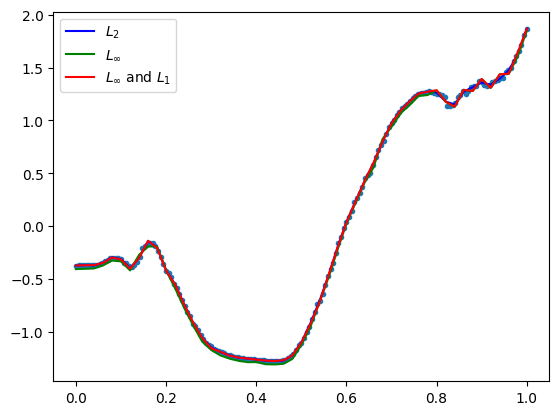

            max_dist       MSE      RMSE       MAE
LSQ         0.032323  0.000067  0.008159  0.005790
Max         0.027989  0.000526  0.022937  0.021383
Max and L1  0.027990  0.000095  0.009737  0.005643 

opt distance 0.027988881045423065
number of data points: 171


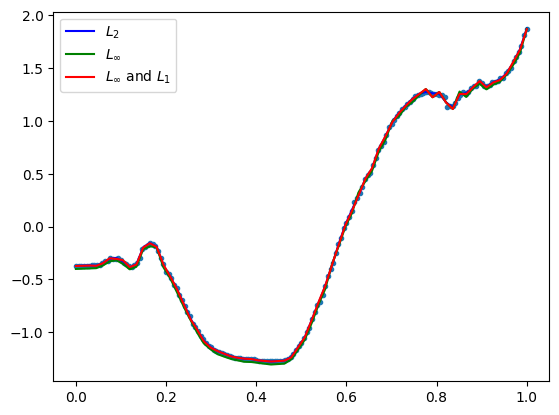

            max_dist       MSE      RMSE       MAE
LSQ         0.027551  0.000044  0.006644  0.004623
Max         0.020091  0.000299  0.017292  0.016183
Max and L1  0.020092  0.000067  0.008157  0.004631 

opt distance 0.02009119371285921
number of data points: 171


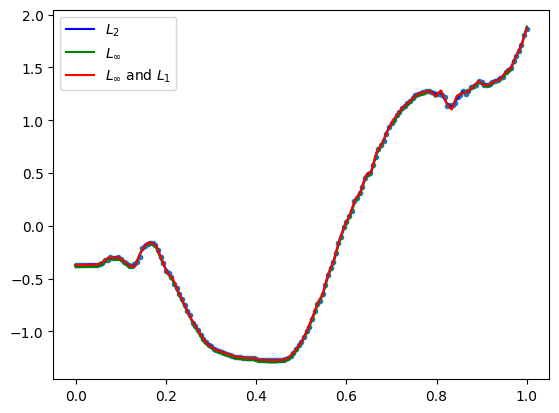

GestureMidAirD3 no. 89 len(ts): 180 ts processed: 42.79 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.048920  0.000233  0.015259  0.011076
Max         0.044147  0.001133  0.033660  0.030931
Max and L1  0.044148  0.000266  0.016303  0.011001 
opt distance 0.04414668518660486
number of data points: 180


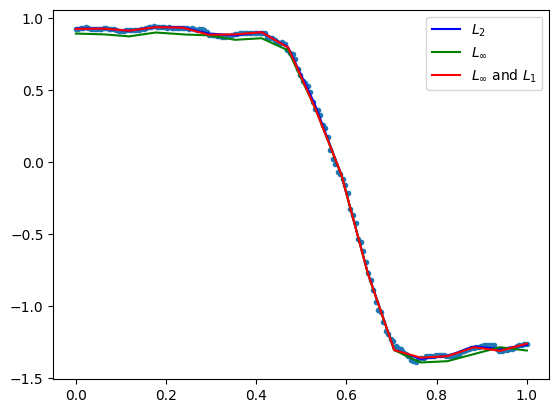

            max_dist       MSE      RMSE       MAE
LSQ         0.029988  0.000073  0.008555  0.005655
Max         0.024099  0.000356  0.018873  0.017421
Max and L1  0.024100  0.000079  0.008900  0.005651 

opt distance 0.02409855152788376
number of data points: 180


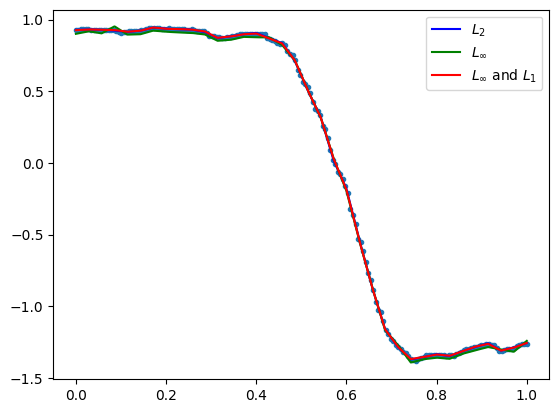

            max_dist       MSE      RMSE       MAE
LSQ         0.032450  0.000063  0.007916  0.004704
Max         0.022689  0.000363  0.019046  0.018103
Max and L1  0.022690  0.000070  0.008358  0.004737 

opt distance 0.022689373797756592
number of data points: 180


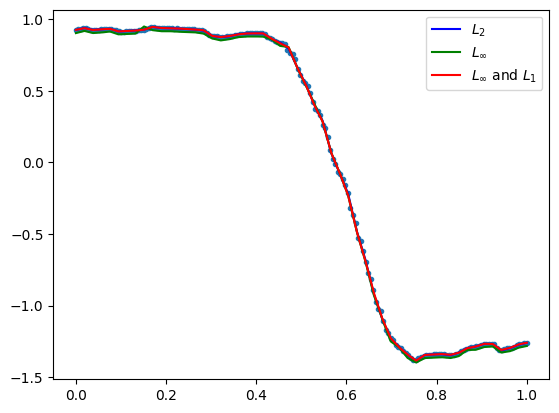

            max_dist       MSE      RMSE       MAE
LSQ         0.028676  0.000047  0.006880  0.004097
Max         0.021199  0.000346  0.018614  0.017938
Max and L1  0.021200  0.000057  0.007578  0.003906 

opt distance 0.02119945805601263
number of data points: 180


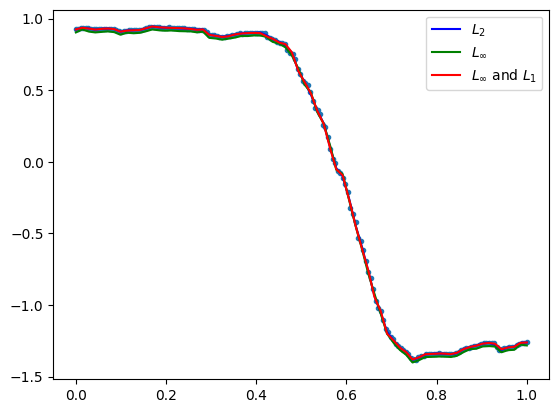

            max_dist       MSE      RMSE       MAE
LSQ         0.026984  0.000028  0.005316  0.002952
Max         0.019109  0.000299  0.017286  0.016727
Max and L1  0.019110  0.000037  0.006080  0.002861 

opt distance 0.019109161176022106
number of data points: 180


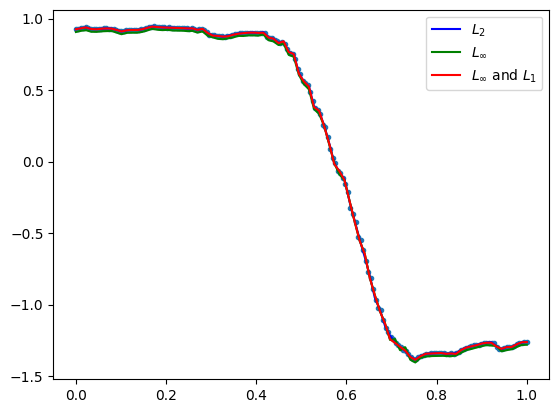

GestureMidAirD3 no. 90 len(ts): 115 ts processed: 43.269999999999996 %
[11, 23, 34, 46, 57]
            max_dist       MSE      RMSE       MAE
LSQ         0.097070  0.001355  0.036812  0.025950
Max         0.077844  0.002886  0.053725  0.047189
Max and L1  0.077845  0.001979  0.044492  0.034644 

opt distance 0.07784427586242076
number of data points: 115


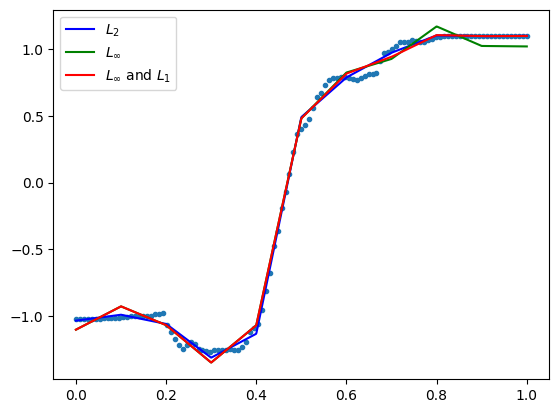

            max_dist       MSE      RMSE       MAE
LSQ         0.064789  0.000260  0.016121  0.009959
Max         0.045341  0.001227  0.035028  0.032300
Max and L1  0.045342  0.000391  0.019764  0.012432 

opt distance 0.045340823694958315
number of data points: 115


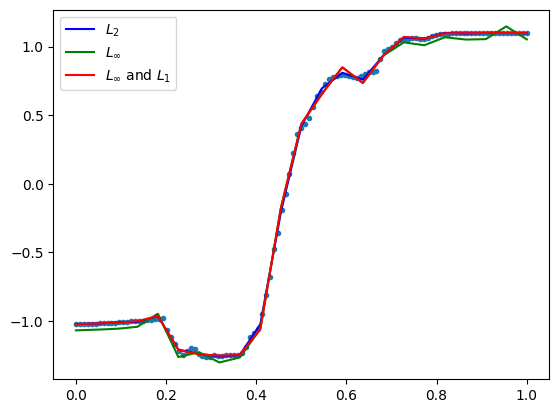

            max_dist       MSE      RMSE       MAE
LSQ         0.048957  0.000204  0.014291  0.008810
Max         0.036988  0.000902  0.030032  0.027921
Max and L1  0.036989  0.000283  0.016827  0.010645 

opt distance 0.036987953656222206
number of data points: 115


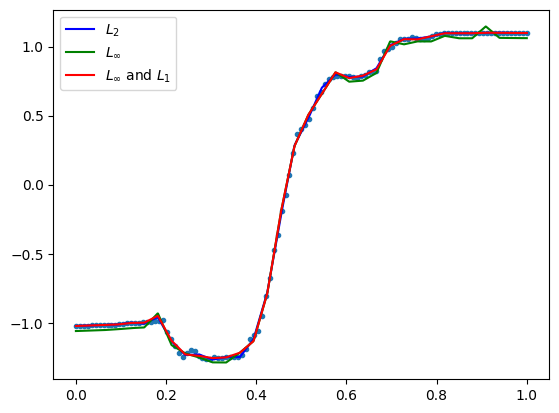

            max_dist       MSE      RMSE       MAE
LSQ         0.031836  0.000090  0.009502  0.005869
Max         0.024739  0.000448  0.021171  0.019913
Max and L1  0.024740  0.000110  0.010486  0.006146 

opt distance 0.024739137331839633
number of data points: 115


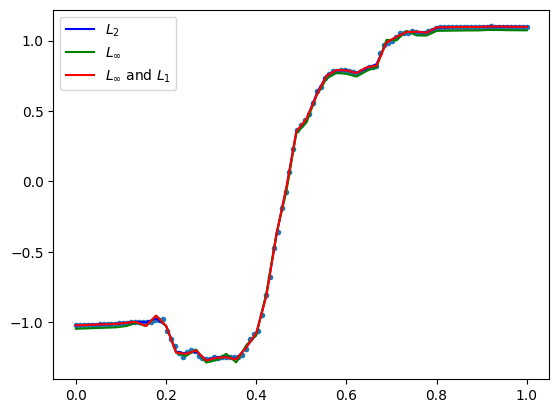

            max_dist       MSE      RMSE       MAE
LSQ         0.036660  0.000071  0.008409  0.004674
Max         0.024001  0.000459  0.021436  0.020410
Max and L1  0.024002  0.000083  0.009110  0.004631 

opt distance 0.024001372058923526
number of data points: 115


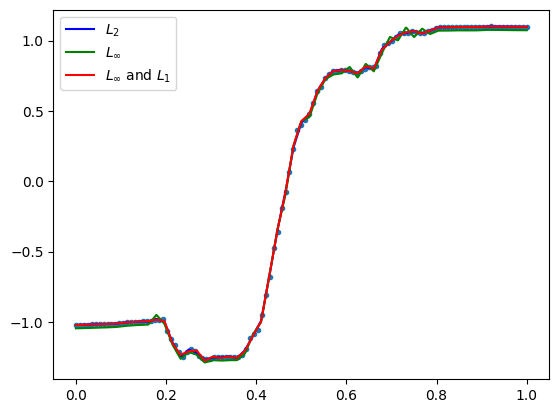

GestureMidAirD3 no. 91 len(ts): 180 ts processed: 43.75 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.142467  0.001632  0.040396  0.028588
Max         0.119180  0.006435  0.080217  0.071610
Max and L1  0.119181  0.002474  0.049743  0.035382 

opt distance 0.1191804724151887
number of data points: 180


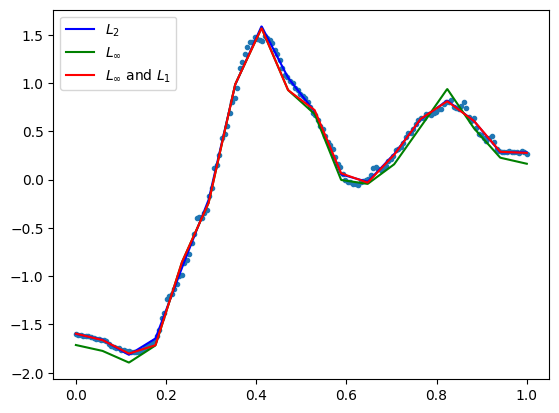

            max_dist       MSE      RMSE       MAE
LSQ         0.117250  0.000586  0.024211  0.016582
Max         0.082815  0.003914  0.062562  0.057561
Max and L1  0.082816  0.000776  0.027857  0.017640 

opt distance 0.0828145575648793
number of data points: 180


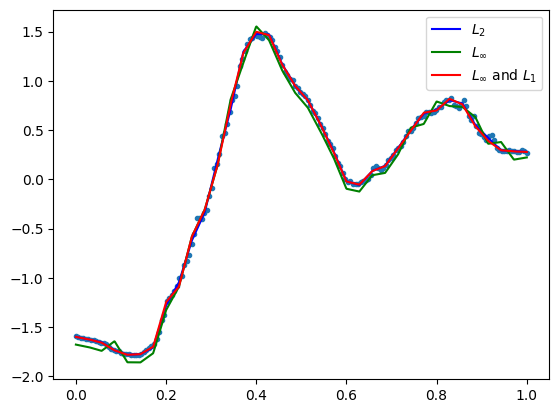

            max_dist       MSE      RMSE       MAE
LSQ         0.068259  0.000395  0.019870  0.014101
Max         0.056148  0.001849  0.042999  0.039400
Max and L1  0.056149  0.000536  0.023159  0.015400 

opt distance 0.05614805326192493
number of data points: 180


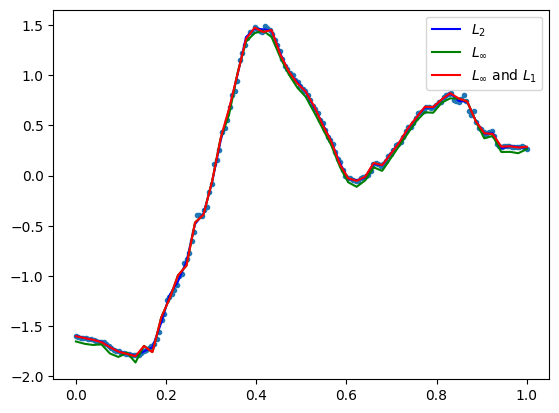

            max_dist       MSE      RMSE       MAE
LSQ         0.051821  0.000214  0.014620  0.010306
Max         0.037877  0.000972  0.031184  0.029171
Max and L1  0.037878  0.000256  0.016001  0.009914 

opt distance 0.0378770033971029
number of data points: 180


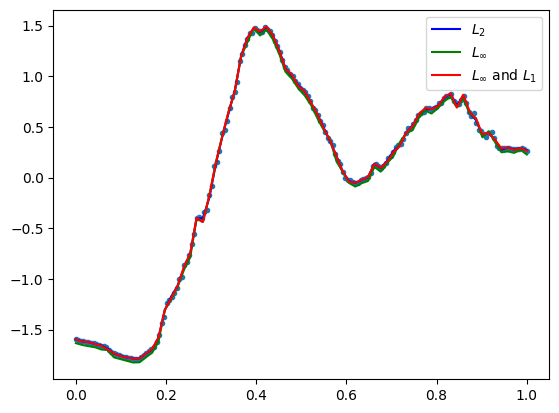

            max_dist       MSE      RMSE       MAE
LSQ         0.056328  0.000188  0.013701  0.009313
Max         0.038005  0.001073  0.032749  0.031194
Max and L1  0.038006  0.000256  0.015993  0.009430 

opt distance 0.03800547638875528
number of data points: 180


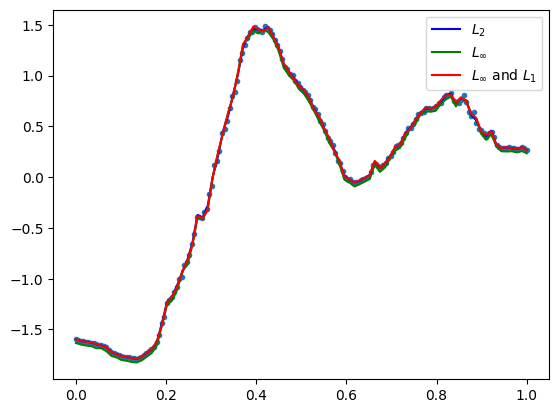

GestureMidAirD3 no. 92 len(ts): 171 ts processed: 44.230000000000004 %
[17, 34, 51, 68, 85]
            max_dist       MSE      RMSE       MAE
LSQ         0.077704  0.000379  0.019476  0.013048
Max         0.058311  0.001753  0.041865  0.038069
Max and L1  0.058312  0.000460  0.021450  0.014271 

opt distance 0.05831132656940705
number of data points: 171


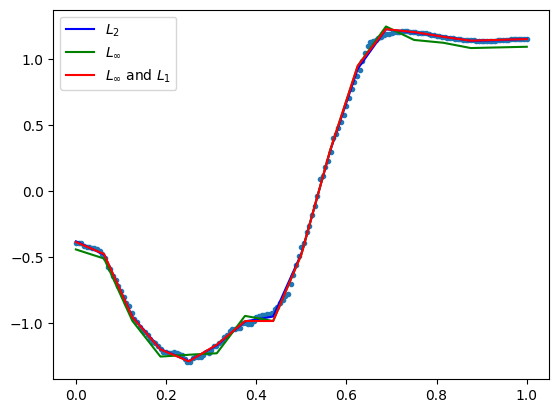

            max_dist       MSE      RMSE       MAE
LSQ         0.040948  0.000124  0.011152  0.007498
Max         0.029590  0.000534  0.023111  0.021141
Max and L1  0.029591  0.000149  0.012203  0.007942 

opt distance 0.029589925608304
number of data points: 171


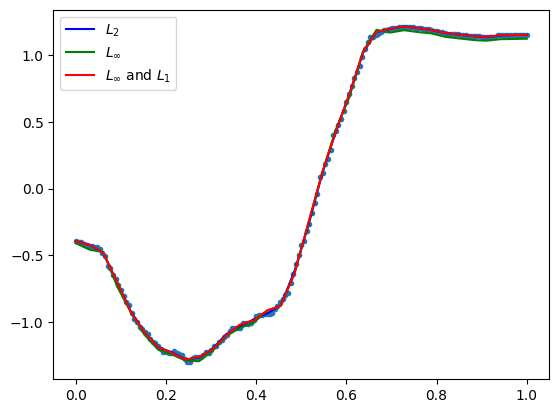

            max_dist       MSE      RMSE       MAE
LSQ         0.034004  0.000070  0.008350  0.005572
Max         0.022016  0.000312  0.017674  0.016265
Max and L1  0.022017  0.000081  0.008997  0.005658 

opt distance 0.02201634349749976
number of data points: 171


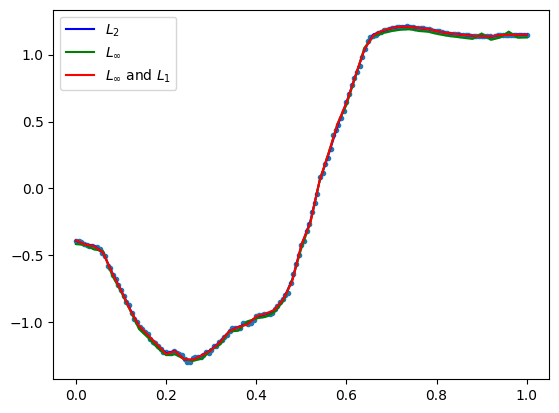

            max_dist       MSE      RMSE       MAE
LSQ         0.033204  0.000047  0.006844  0.004242
Max         0.026218  0.000505  0.022466  0.021198
Max and L1  0.026219  0.000069  0.008330  0.004331 

opt distance 0.026217876960765694
number of data points: 171


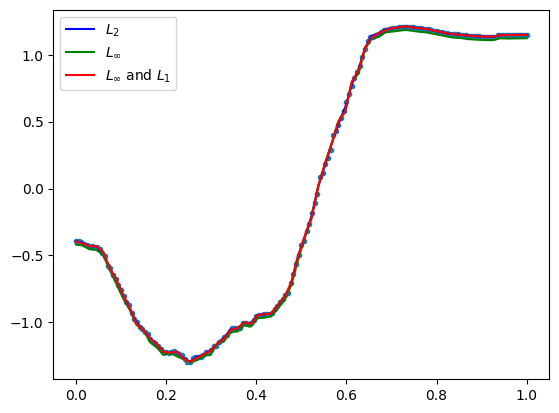

            max_dist       MSE      RMSE       MAE
LSQ         0.033106  0.000028  0.005325  0.003102
Max         0.024476  0.000500  0.022353  0.021709
Max and L1  0.024477  0.000046  0.006786  0.003127 

opt distance 0.024475992807970862
number of data points: 171


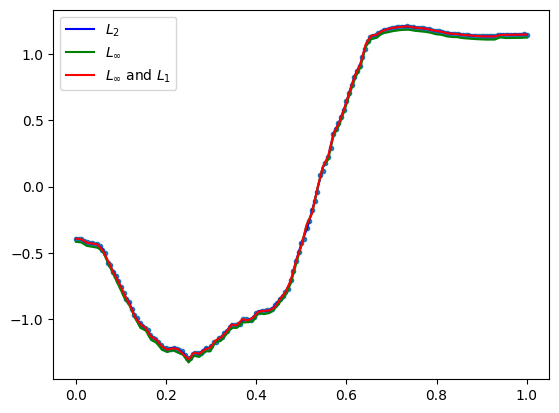

GestureMidAirD3 no. 93 len(ts): 120 ts processed: 44.71 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.105176  0.000958  0.030954  0.021038
Max         0.087669  0.003933  0.062716  0.056390
Max and L1  0.087670  0.001717  0.041438  0.030114 

opt distance 0.08766895731199847
number of data points: 120


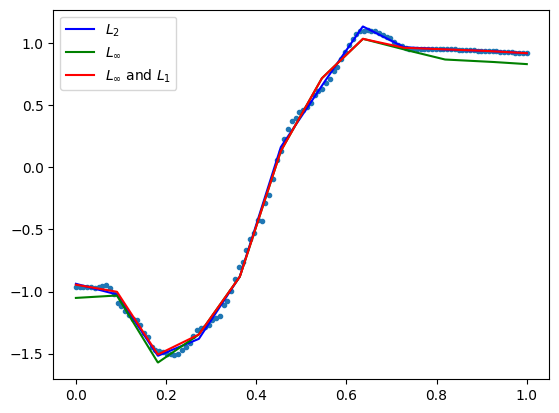

            max_dist       MSE      RMSE       MAE
LSQ         0.077517  0.000297  0.017238  0.011297
Max         0.055426  0.001745  0.041771  0.037127
Max and L1  0.055427  0.000582  0.024127  0.015842 

opt distance 0.05542613985049149
number of data points: 120


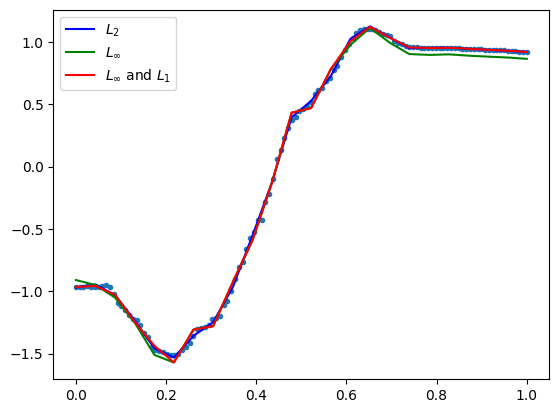

            max_dist       MSE      RMSE       MAE
LSQ         0.056763  0.000125  0.011159  0.006803
Max         0.037637  0.000976  0.031234  0.029297
Max and L1  0.037638  0.000160  0.012643  0.007180 

opt distance 0.037637015374197044
number of data points: 120


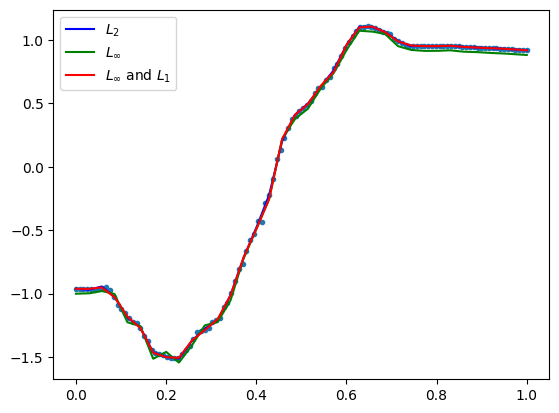

            max_dist       MSE      RMSE       MAE
LSQ         0.048054  0.000088  0.009366  0.005858
Max         0.036828  0.001006  0.031721  0.030172
Max and L1  0.036829  0.000145  0.012021  0.006419 

opt distance 0.03682761801585093
number of data points: 120


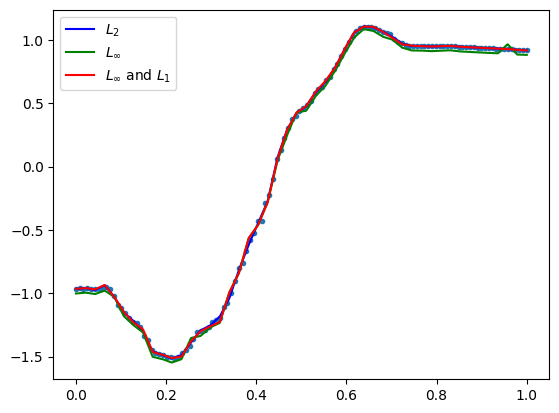

            max_dist       MSE      RMSE       MAE
LSQ         0.038711  0.000073  0.008539  0.004960
Max         0.032948  0.000877  0.029608  0.028539
Max and L1  0.032949  0.000095  0.009757  0.004531 

opt distance 0.03294803713038902
number of data points: 120


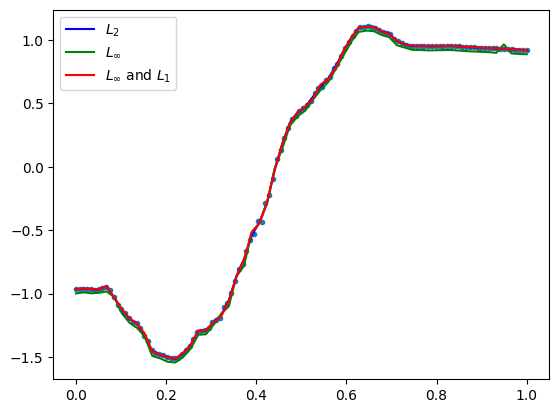

GestureMidAirD3 no. 94 len(ts): 180 ts processed: 45.190000000000005 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.104889  0.000665  0.025795  0.018926
Max         0.066502  0.001860  0.043126  0.038097
Max and L1  0.066503  0.000949  0.030799  0.023241 

opt distance 0.06650225090156747
number of data points: 180


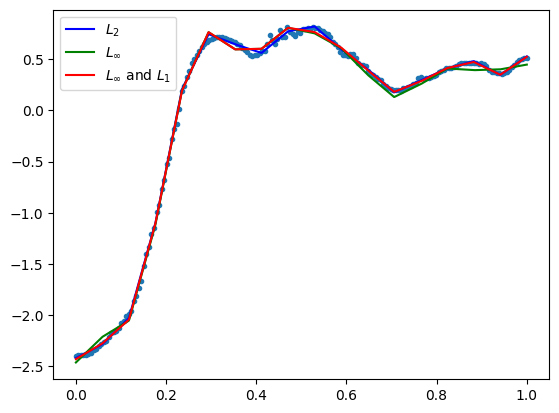

            max_dist       MSE      RMSE       MAE
LSQ         0.070240  0.000318  0.017838  0.012189
Max         0.056719  0.001700  0.041228  0.036887
Max and L1  0.056720  0.000409  0.020223  0.013382 

opt distance 0.05671931736397053
number of data points: 180


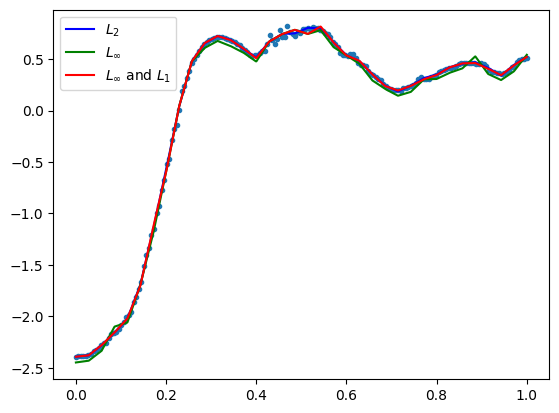

            max_dist       MSE      RMSE       MAE
LSQ         0.064479  0.000246  0.015677  0.010111
Max         0.057040  0.002160  0.046471  0.043792
Max and L1  0.057041  0.000306  0.017483  0.009910 

opt distance 0.05703951970020488
number of data points: 180


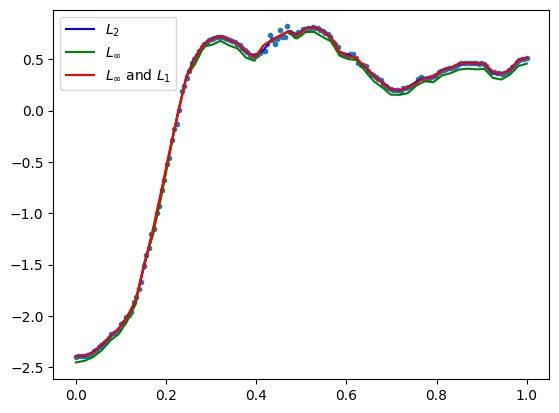

            max_dist       MSE      RMSE       MAE
LSQ         0.065261  0.000209  0.014468  0.008864
Max         0.051497  0.001863  0.043164  0.040393
Max and L1  0.051498  0.000295  0.017171  0.009631 

opt distance 0.05149671933202719
number of data points: 180


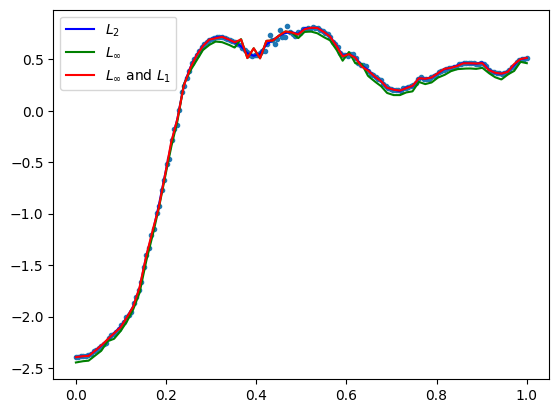

            max_dist       MSE      RMSE       MAE
LSQ         0.047300  0.000116  0.010793  0.006551
Max         0.034551  0.000908  0.030139  0.028861
Max and L1  0.034552  0.000171  0.013061  0.007220 

opt distance 0.034551078794007935
number of data points: 180


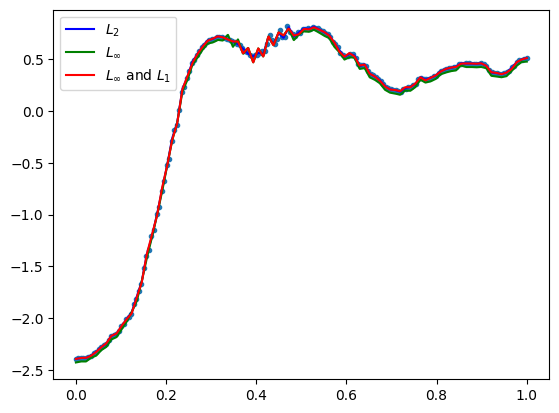

GestureMidAirD3 no. 95 len(ts): 89 ts processed: 45.67 %
[8, 17, 26, 35, 44]
            max_dist       MSE      RMSE       MAE
LSQ         0.067045  0.000508  0.022547  0.015456
Max         0.055963  0.001130  0.033613  0.028850
Max and L1  0.055964  0.000736  0.027126  0.019538 

opt distance 0.05596308360442296
number of data points: 89


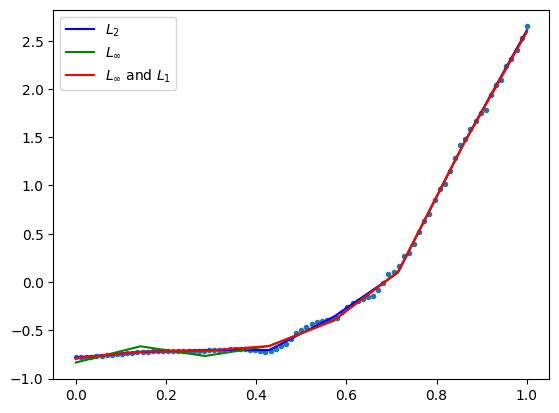

            max_dist       MSE      RMSE       MAE
LSQ         0.058424  0.000243  0.015581  0.009732
Max         0.046434  0.001377  0.037108  0.033487
Max and L1  0.046435  0.000260  0.016131  0.009780 

opt distance 0.046433946479181865
number of data points: 89


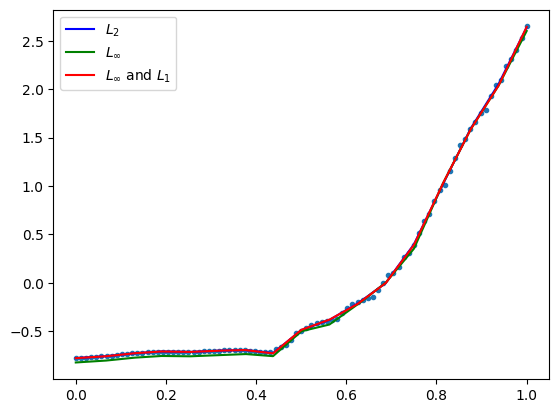

            max_dist       MSE      RMSE       MAE
LSQ         0.048913  0.000205  0.014325  0.009139
Max         0.034583  0.000798  0.028247  0.026222
Max and L1  0.034584  0.000272  0.016482  0.010695 

opt distance 0.03458257047602109
number of data points: 89


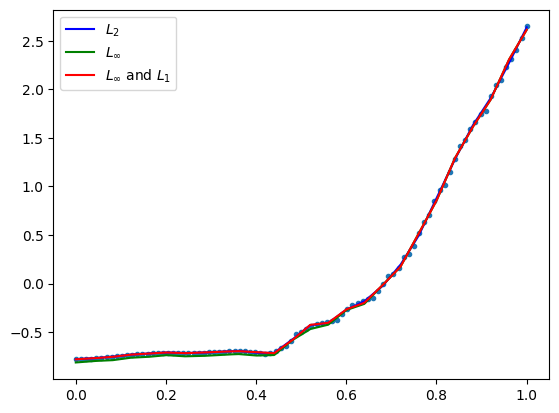

            max_dist       MSE      RMSE       MAE
LSQ         0.029844  0.000113  0.010630  0.006710
Max         0.024494  0.000457  0.021372  0.020441
Max and L1  0.024495  0.000133  0.011549  0.006949 

opt distance 0.024493614924346523
number of data points: 89


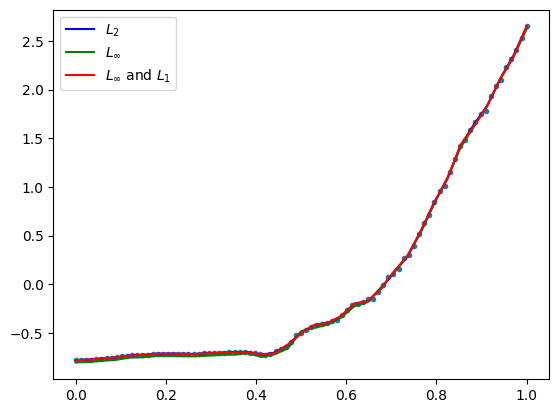

            max_dist       MSE      RMSE       MAE
LSQ         0.028482  0.000093  0.009627  0.005682
Max         0.023672  0.000451  0.021228  0.020540
Max and L1  0.023673  0.000114  0.010675  0.006079 

opt distance 0.023671756814112543
number of data points: 89


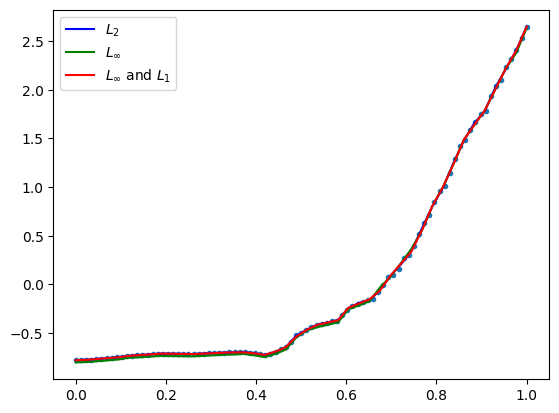

GestureMidAirD3 no. 96 len(ts): 180 ts processed: 46.150000000000006 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.169250  0.001533  0.039157  0.026808
Max         0.124523  0.007859  0.088649  0.080788
Max and L1  0.124524  0.002768  0.052611  0.038451 

opt distance 0.12452290895672702
number of data points: 180


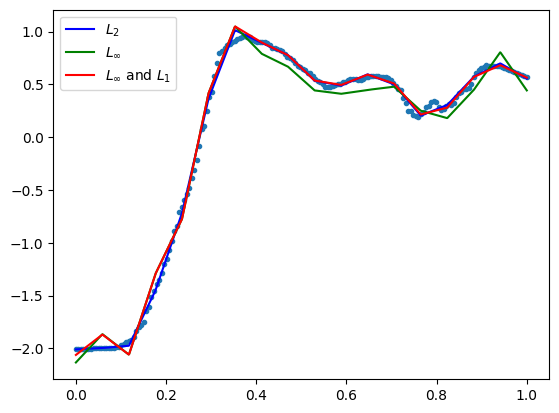

            max_dist       MSE      RMSE       MAE
LSQ         0.054334  0.000218  0.014761  0.009993
Max         0.043721  0.001037  0.032208  0.029370
Max and L1  0.043722  0.000290  0.017020  0.011302 

opt distance 0.043720680586101096
number of data points: 180


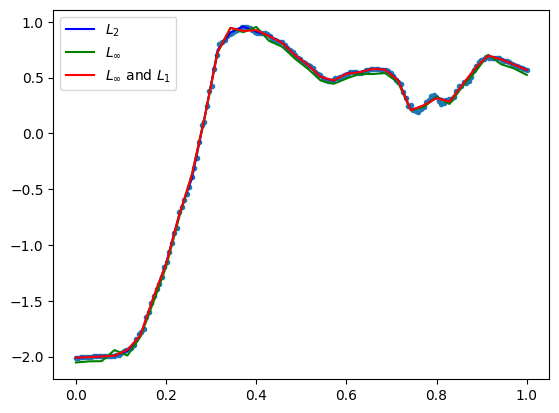

            max_dist       MSE      RMSE       MAE
LSQ         0.043895  0.000098  0.009901  0.006659
Max         0.037193  0.000904  0.030069  0.028223
Max and L1  0.037194  0.000133  0.011547  0.006765 

opt distance 0.03719295089710518
number of data points: 180


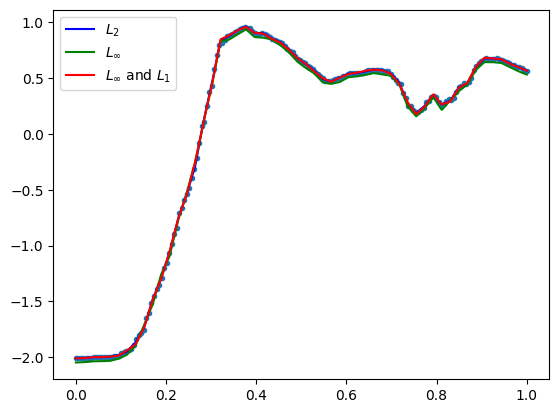

            max_dist       MSE      RMSE       MAE
LSQ         0.042891  0.000100  0.010009  0.005983
Max         0.036366  0.000968  0.031107  0.029933
Max and L1  0.036367  0.000121  0.010997  0.005755 

opt distance 0.036366264513017665
number of data points: 180


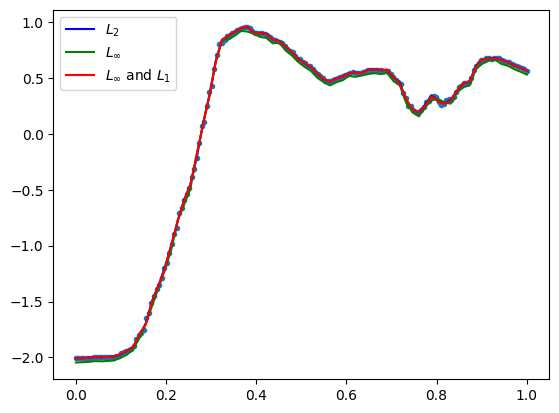

            max_dist       MSE      RMSE       MAE
LSQ         0.046165  0.000062  0.007889  0.004635
Max         0.033807  0.000923  0.030385  0.029403
Max and L1  0.033808  0.000106  0.010295  0.005005 

opt distance 0.0338072588151181
number of data points: 180


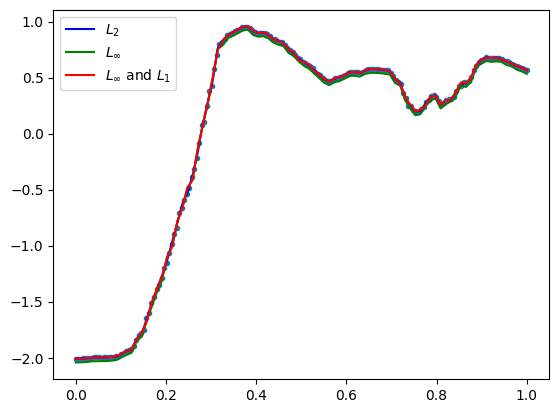

GestureMidAirD3 no. 97 len(ts): 240 ts processed: 46.63 %
[24, 48, 72, 96, 120]
            max_dist       MSE      RMSE       MAE
LSQ         0.324986  0.007641  0.087413  0.064524
Max         0.244572  0.027177  0.164854  0.144216
Max and L1  0.244573  0.012200  0.110455  0.082442 

opt distance 0.24457225635304555
number of data points: 240


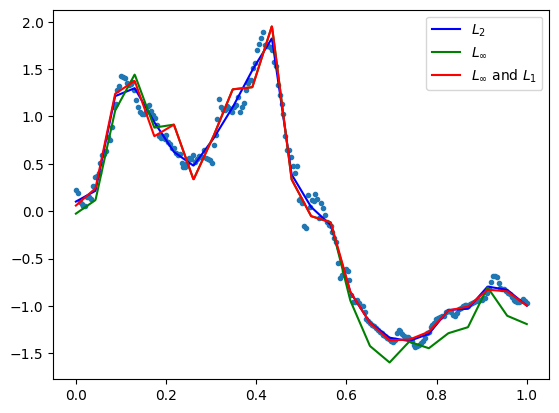

            max_dist       MSE      RMSE       MAE
LSQ         0.216887  0.002159  0.046462  0.033146
Max         0.167438  0.015716  0.125365  0.115053
Max and L1  0.167439  0.002941  0.054227  0.035484 

opt distance 0.16743789129078876
number of data points: 240


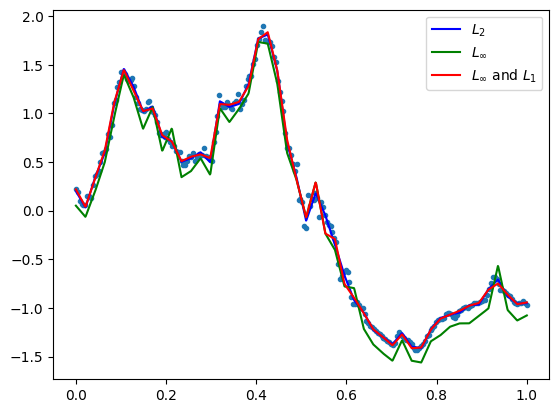

            max_dist       MSE      RMSE       MAE
LSQ         0.157564  0.001441  0.037960  0.025115
Max         0.121927  0.009675  0.098361  0.092818
Max and L1  0.121928  0.001833  0.042812  0.026089 

opt distance 0.12192726704218432
number of data points: 240


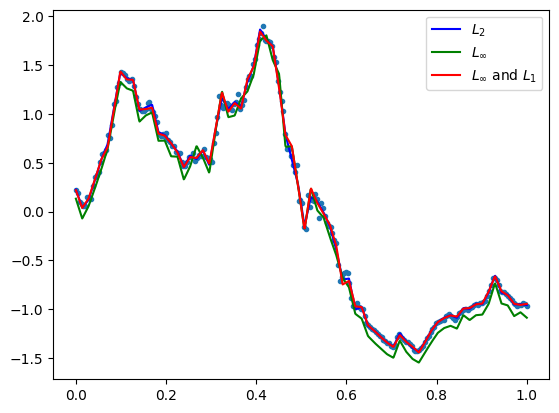

            max_dist       MSE      RMSE       MAE
LSQ         0.139738  0.000986  0.031406  0.019707
Max         0.128631  0.012024  0.109653  0.103994
Max and L1  0.128632  0.001145  0.033834  0.018051 

opt distance 0.1286312152950186
number of data points: 240


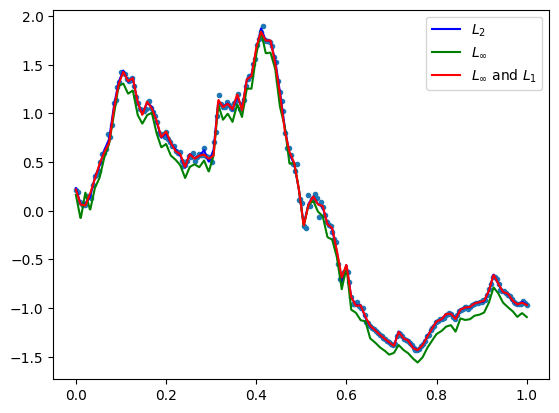

            max_dist       MSE      RMSE       MAE
LSQ         0.163467  0.000778  0.027893  0.015954
Max         0.126884  0.013097  0.114444  0.110413
Max and L1  0.126885  0.001067  0.032658  0.014993 

opt distance 0.12688409770648934
number of data points: 240


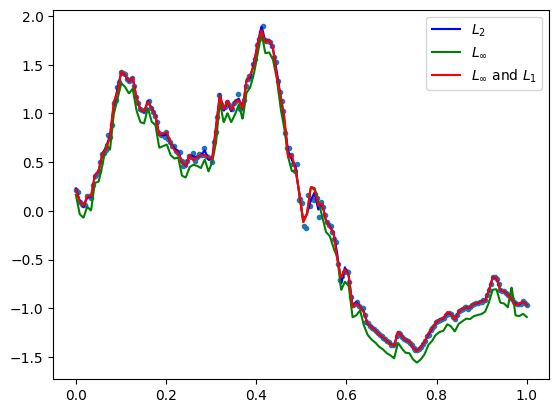

GestureMidAirD3 no. 98 len(ts): 90 ts processed: 47.12 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.280644  0.008187  0.090481  0.068735
Max         0.205174  0.015469  0.124376  0.107504
Max and L1  0.205175  0.011367  0.106617  0.086412 

opt distance 0.20517359895872778
number of data points: 90


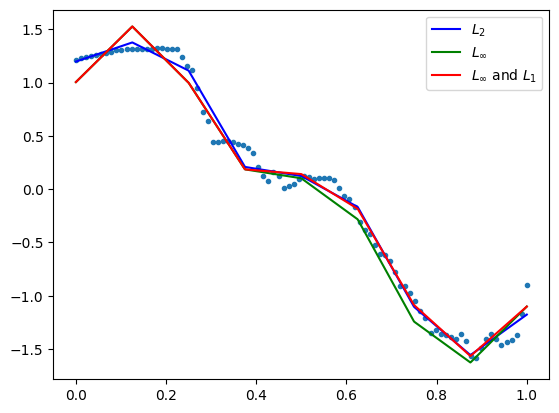

            max_dist       MSE      RMSE       MAE
LSQ         0.170955  0.002389  0.048879  0.033231
Max         0.140173  0.012036  0.109707  0.101685
Max and L1  0.140174  0.002631  0.051292  0.033160 

opt distance 0.14017257221944227
number of data points: 90


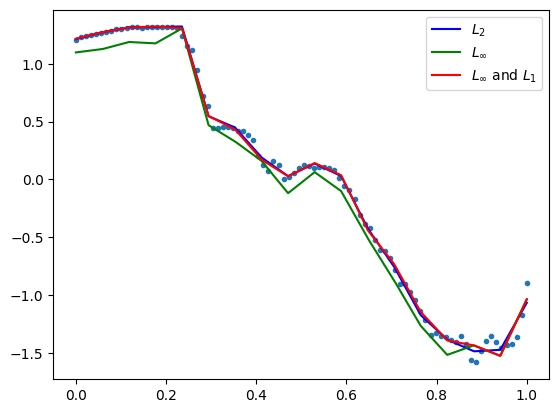

            max_dist       MSE      RMSE       MAE
LSQ         0.078435  0.000794  0.028176  0.019871
Max         0.062972  0.002504  0.050045  0.045582
Max and L1  0.062973  0.001004  0.031688  0.022008 

opt distance 0.06297150342832906
number of data points: 90


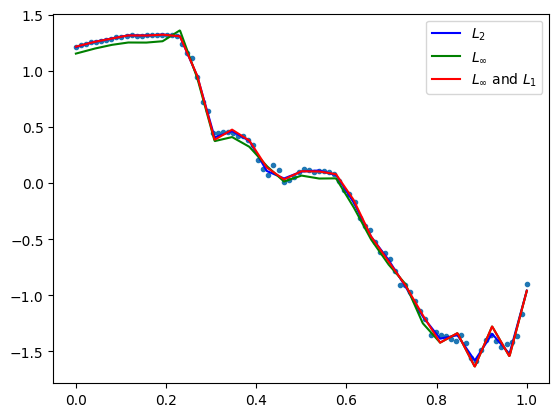

            max_dist       MSE      RMSE       MAE
LSQ         0.072515  0.000541  0.023264  0.016943
Max         0.053805  0.001839  0.042887  0.038874
Max and L1  0.053806  0.000752  0.027414  0.018427 

opt distance 0.05380491595358196
number of data points: 90


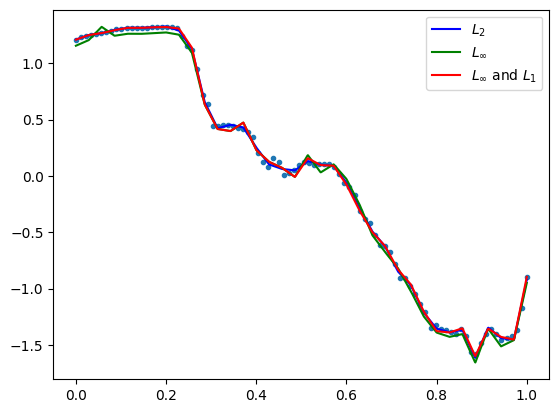

            max_dist       MSE      RMSE       MAE
LSQ         0.054393  0.000440  0.020973  0.014108
Max         0.043135  0.001477  0.038429  0.037086
Max and L1  0.043136  0.000611  0.024709  0.017075 

opt distance 0.04313524330650678
number of data points: 90


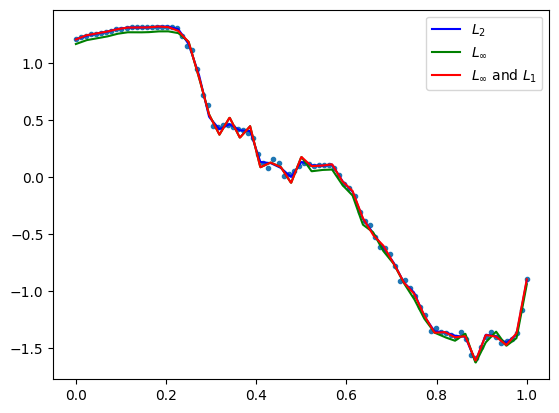

GestureMidAirD3 no. 99 len(ts): 90 ts processed: 47.599999999999994 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.306862  0.011372  0.106638  0.086961
Max         0.246226  0.020849  0.144390  0.122427
Max and L1  0.246227  0.012677  0.112593  0.088884 

opt distance 0.24622571968544515
number of data points: 90


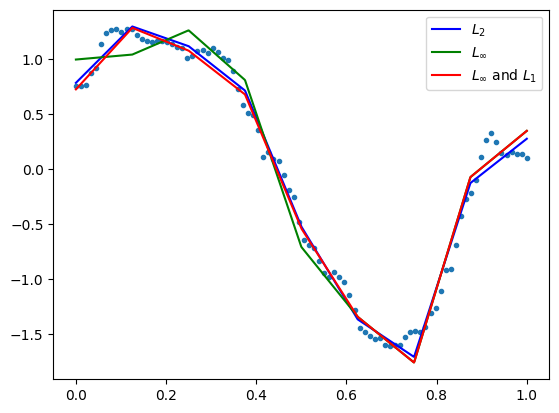

            max_dist       MSE      RMSE       MAE
LSQ         0.158065  0.003061  0.055327  0.043898
Max         0.133136  0.008623  0.092861  0.081673
Max and L1  0.133137  0.003529  0.059403  0.043509 

opt distance 0.13313641656842662
number of data points: 90


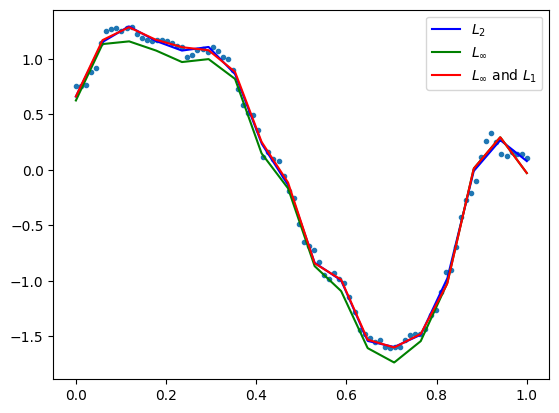

            max_dist       MSE      RMSE       MAE
LSQ         0.100170  0.001494  0.038658  0.030792
Max         0.075459  0.003222  0.056762  0.051069
Max and L1  0.075460  0.001681  0.040994  0.030567 

opt distance 0.07545896221363926
number of data points: 90


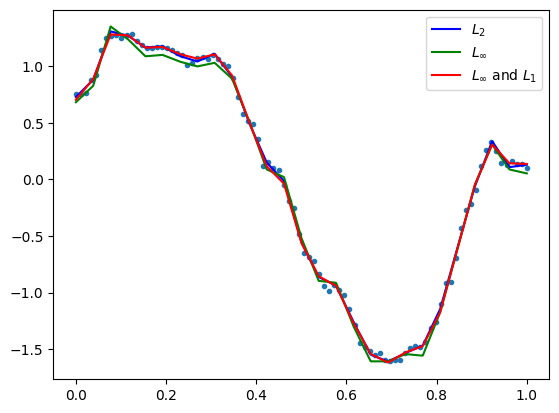

            max_dist       MSE      RMSE       MAE
LSQ         0.117566  0.000808  0.028425  0.019533
Max         0.075407  0.003641  0.060343  0.054806
Max and L1  0.075408  0.001204  0.034705  0.022418 

opt distance 0.07540721015093983
number of data points: 90


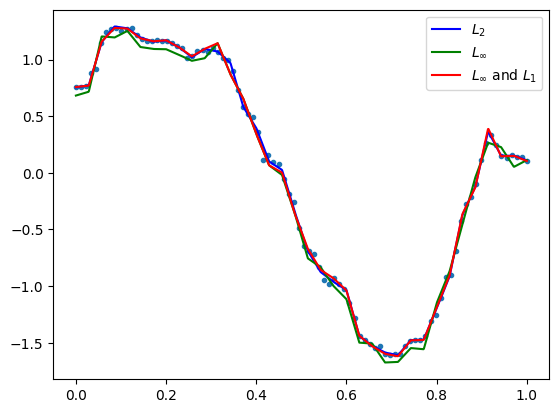

            max_dist       MSE      RMSE       MAE
LSQ         0.089511  0.000610  0.024691  0.018917
Max         0.062639  0.002575  0.050742  0.046162
Max and L1  0.062640  0.000945  0.030741  0.019956 

opt distance 0.06263884273694915
number of data points: 90


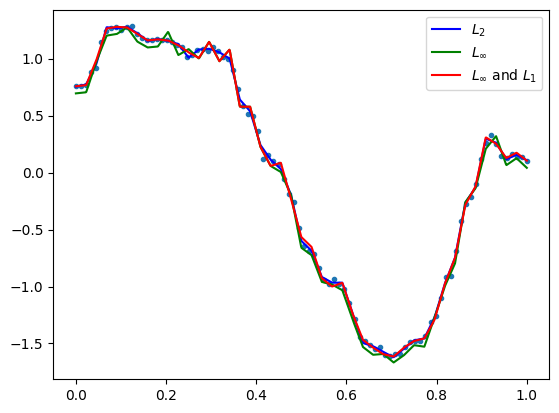

GestureMidAirD3 no. 100 len(ts): 179 ts processed: 48.08 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.122455  0.002070  0.045500  0.036551
Max         0.104035  0.004136  0.064312  0.056343
Max and L1  0.104036  0.002392  0.048910  0.037929 

opt distance 0.10403516647412836
number of data points: 179


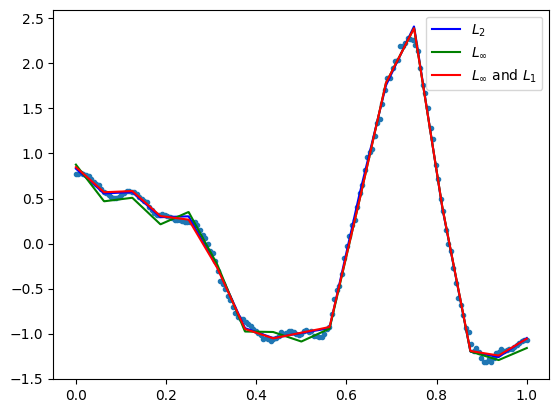

            max_dist       MSE      RMSE       MAE
LSQ         0.091194  0.000648  0.025447  0.017594
Max         0.072818  0.002693  0.051895  0.046332
Max and L1  0.072819  0.000727  0.026959  0.017571 

opt distance 0.07281764495489086
number of data points: 179


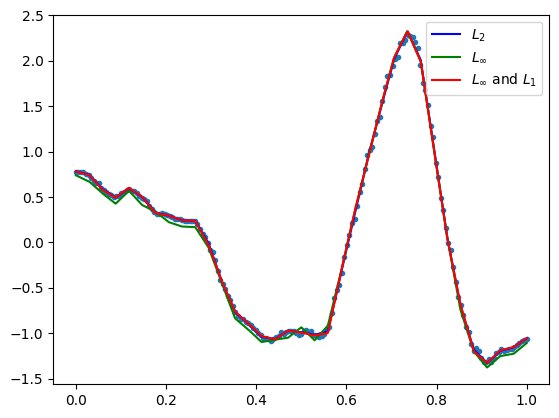

            max_dist       MSE      RMSE       MAE
LSQ         0.064545  0.000405  0.020115  0.014463
Max         0.055182  0.001867  0.043209  0.039861
Max and L1  0.055183  0.000462  0.021487  0.013836 

opt distance 0.05518223796125599
number of data points: 179


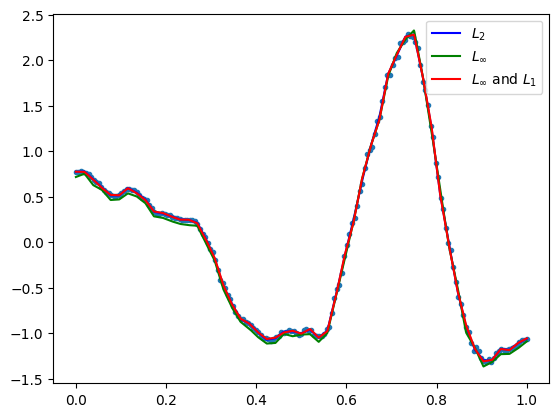

            max_dist       MSE      RMSE       MAE
LSQ         0.051293  0.000312  0.017652  0.012204
Max         0.040339  0.001136  0.033709  0.031578
Max and L1  0.040340  0.000390  0.019739  0.013063 

opt distance 0.0403386315250998
number of data points: 179


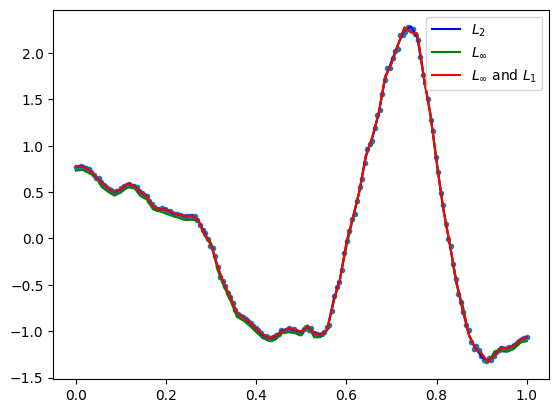

            max_dist       MSE      RMSE       MAE
LSQ         0.048816  0.000261  0.016169  0.010783
Max         0.036557  0.000981  0.031314  0.029664
Max and L1  0.036558  0.000329  0.018143  0.011537 

opt distance 0.03655704964965746
number of data points: 179


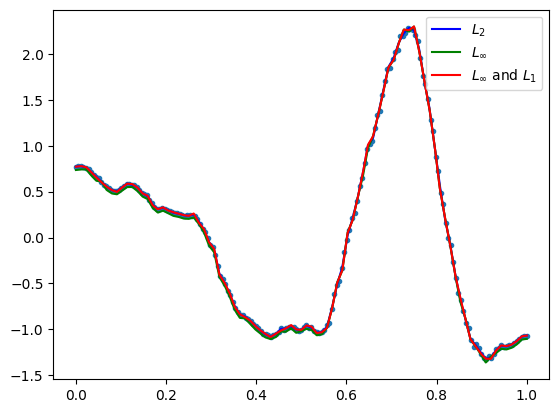

GestureMidAirD3 no. 101 len(ts): 239 ts processed: 48.559999999999995 %
[23, 47, 71, 95, 119]
            max_dist       MSE      RMSE       MAE
LSQ         0.309909  0.008899  0.094332  0.060733
Max         0.248489  0.038279  0.195651  0.178840
Max and L1  0.248490  0.012503  0.111816  0.072409 
opt distance 0.24848922658627937
number of data points: 239


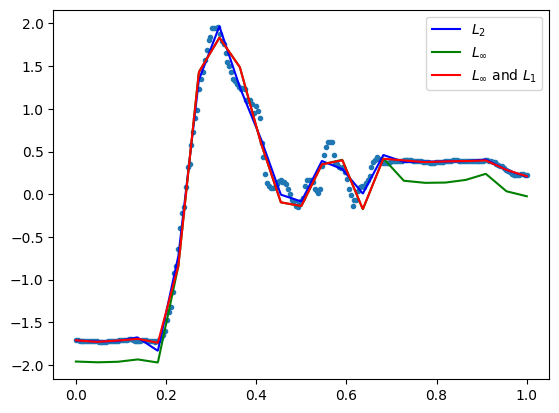

            max_dist       MSE      RMSE       MAE
LSQ         0.176665  0.001863  0.043160  0.024680
Max         0.136973  0.013475  0.116080  0.109693
Max and L1  0.136974  0.002440  0.049401  0.027765 

opt distance 0.13697261850013456
number of data points: 239


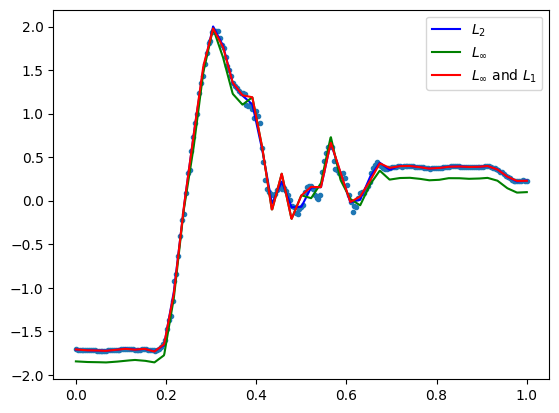

            max_dist       MSE      RMSE       MAE
LSQ         0.127356  0.000556  0.023585  0.012915
Max         0.093736  0.006838  0.082691  0.079787
Max and L1  0.093737  0.000644  0.025370  0.012824 

opt distance 0.09373557424388261
number of data points: 239


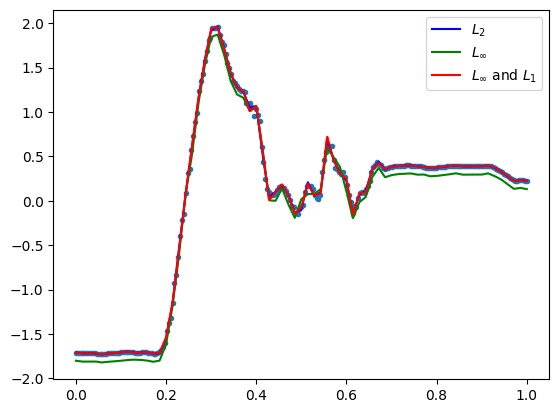

            max_dist       MSE      RMSE       MAE
LSQ         0.073941  0.000306  0.017504  0.009717
Max         0.058833  0.002673  0.051700  0.049054
Max and L1  0.058834  0.000346  0.018607  0.008932 

opt distance 0.05883286832673929
number of data points: 239


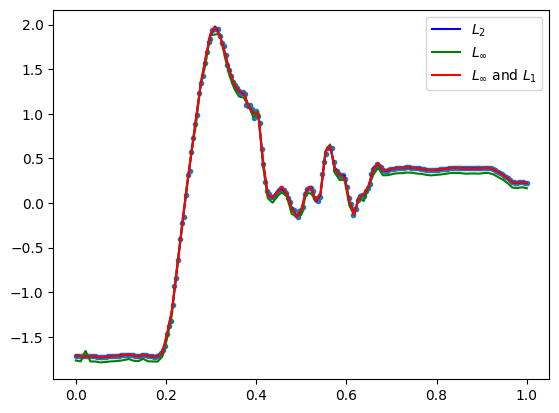

            max_dist       MSE      RMSE       MAE
LSQ         0.067409  0.000253  0.015902  0.008614
Max         0.051395  0.002183  0.046728  0.044997
Max and L1  0.051396  0.000346  0.018612  0.008882 

opt distance 0.05139491990030509
number of data points: 239


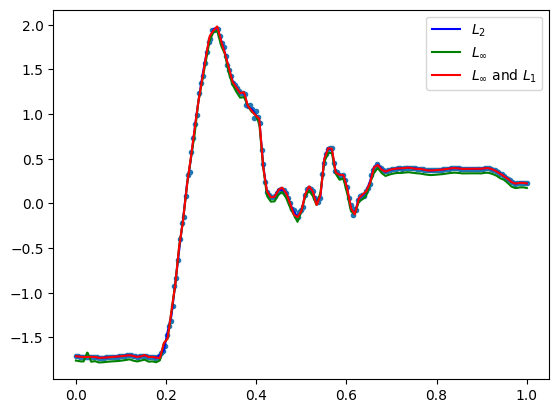

GestureMidAirD3 no. 102 len(ts): 88 ts processed: 49.04 %
[8, 17, 26, 35, 44]
            max_dist       MSE      RMSE       MAE
LSQ         0.228778  0.004073  0.063822  0.046443
Max         0.162358  0.010526  0.102594  0.089824
Max and L1  0.162359  0.004994  0.070668  0.051721 

opt distance 0.16235797144977537
number of data points: 88


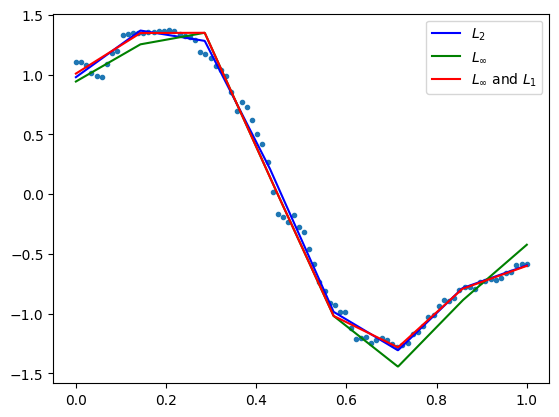

            max_dist       MSE      RMSE       MAE
LSQ         0.154464  0.001618  0.040225  0.028795
Max         0.118482  0.007700  0.087751  0.079633
Max and L1  0.118483  0.003191  0.056488  0.040362 

opt distance 0.11848178567714437
number of data points: 88


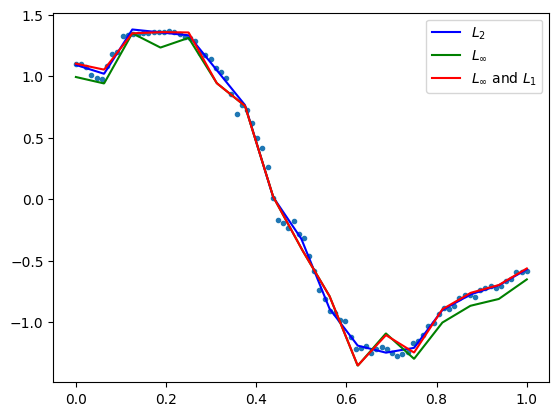

            max_dist       MSE      RMSE       MAE
LSQ         0.084187  0.000916  0.030271  0.022528
Max         0.074775  0.002958  0.054384  0.049129
Max and L1  0.074776  0.001132  0.033643  0.023089 

opt distance 0.07477469213302888
number of data points: 88


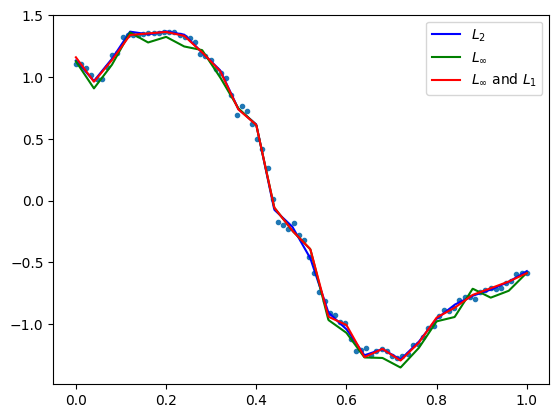

            max_dist       MSE      RMSE       MAE
LSQ         0.058395  0.000434  0.020841  0.015813
Max         0.047489  0.001353  0.036784  0.033192
Max and L1  0.047490  0.000507  0.022513  0.015254 

opt distance 0.04748877618281785
number of data points: 88


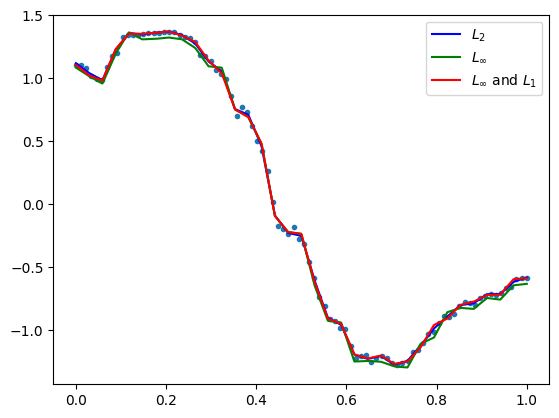

            max_dist       MSE      RMSE       MAE
LSQ         0.068613  0.000336  0.018325  0.013823
Max         0.045588  0.001346  0.036690  0.033659
Max and L1  0.045589  0.000530  0.023011  0.015144 

opt distance 0.045587649929229146
number of data points: 88


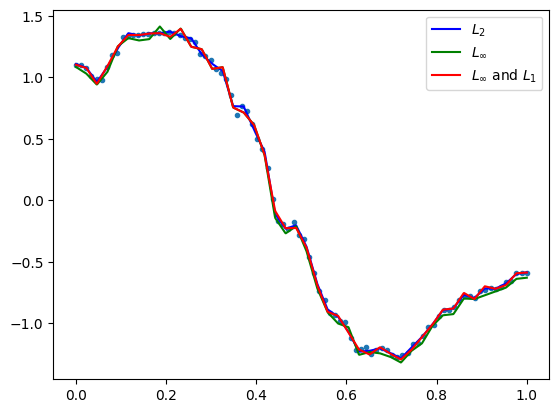

GestureMidAirD3 no. 103 len(ts): 90 ts processed: 49.519999999999996 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.049153  0.000282  0.016799  0.011880
Max         0.042747  0.000796  0.028218  0.025143
Max and L1  0.042748  0.000374  0.019340  0.014070 

opt distance 0.04274681901481464
number of data points: 90


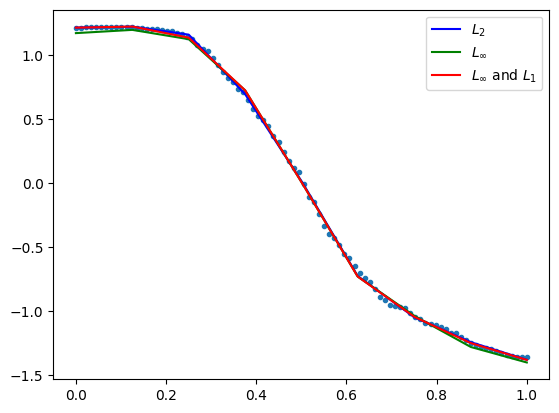

            max_dist       MSE      RMSE       MAE
LSQ         0.037506  0.000120  0.010965  0.007505
Max         0.029575  0.000461  0.021476  0.019027
Max and L1  0.029576  0.000137  0.011695  0.007989 

opt distance 0.02957521295443801
number of data points: 90


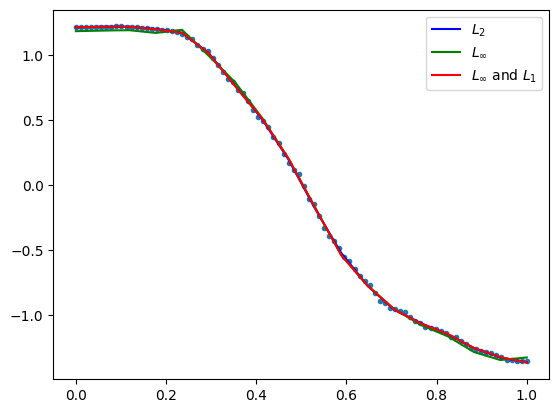

            max_dist       MSE      RMSE       MAE
LSQ         0.023240  0.000067  0.008156  0.005607
Max         0.019810  0.000247  0.015721  0.014523
Max and L1  0.019811  0.000073  0.008534  0.005502 

opt distance 0.019810288740413018
number of data points: 90


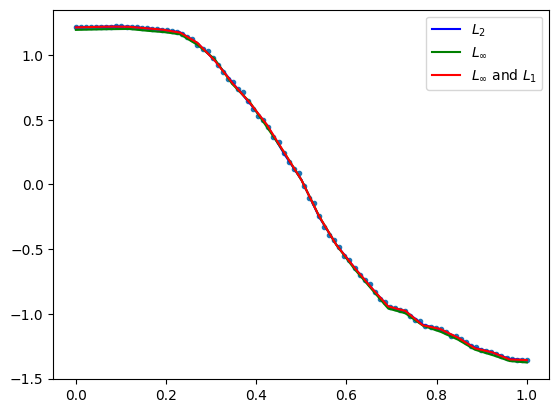

            max_dist       MSE      RMSE       MAE
LSQ         0.025308  0.000056  0.007484  0.005178
Max         0.019426  0.000243  0.015583  0.014560
Max and L1  0.019427  0.000070  0.008343  0.005036 

opt distance 0.019425715313850043
number of data points: 90


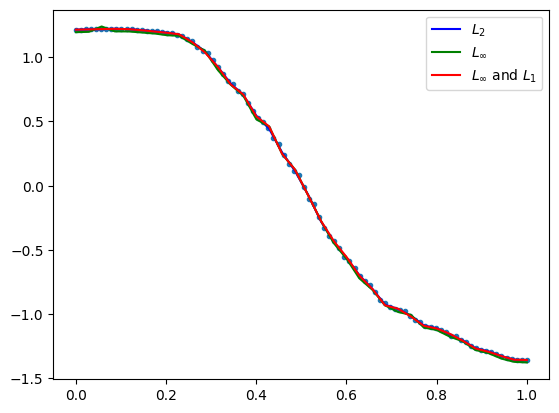

            max_dist       MSE      RMSE       MAE
LSQ         0.021349  0.000043  0.006542  0.004499
Max         0.018334  0.000249  0.015777  0.014858
Max and L1  0.018335  0.000063  0.007938  0.004695 

opt distance 0.018334440401786778
number of data points: 90


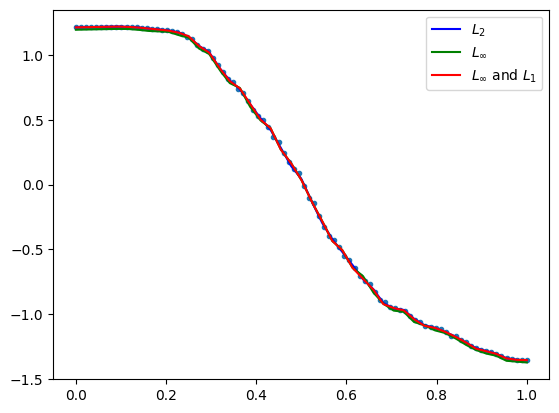

GestureMidAirD3 no. 104 len(ts): 171 ts processed: 50.0 %
[17, 34, 51, 68, 85]
            max_dist       MSE      RMSE       MAE
LSQ         0.078435  0.000550  0.023454  0.017249
Max         0.060444  0.001924  0.043860  0.040104
Max and L1  0.060445  0.000836  0.028915  0.021305 

opt distance 0.06044418727684438
number of data points: 171


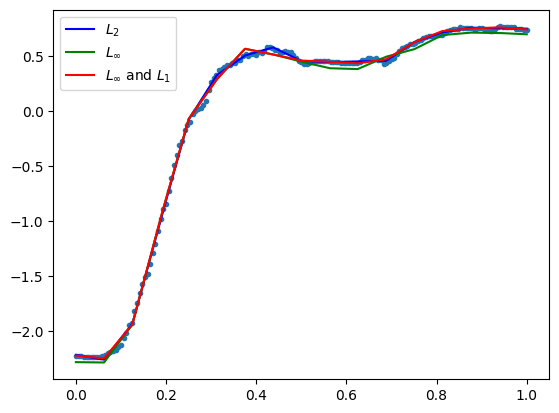

            max_dist       MSE      RMSE       MAE
LSQ         0.054630  0.000196  0.013993  0.010366
Max         0.036759  0.000802  0.028316  0.026138
Max and L1  0.036760  0.000238  0.015432  0.010677 

opt distance 0.036758660546765694
number of data points: 171


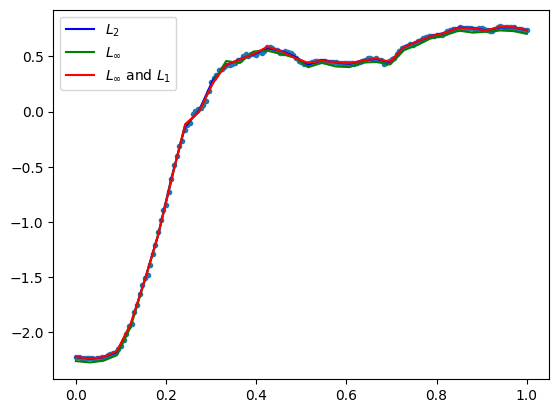

            max_dist       MSE      RMSE       MAE
LSQ         0.031047  0.000075  0.008634  0.005891
Max         0.022633  0.000307  0.017532  0.016255
Max and L1  0.022634  0.000092  0.009586  0.006273 

opt distance 0.022632933534555293
number of data points: 171


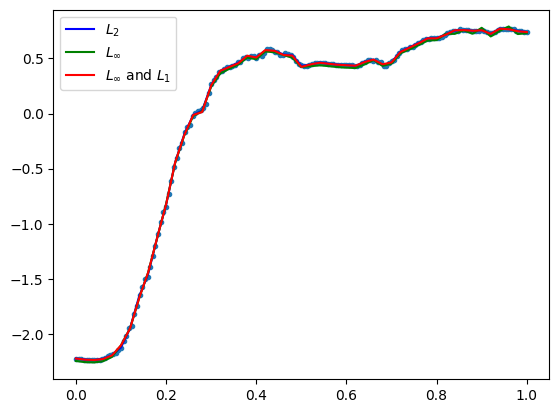

            max_dist       MSE      RMSE       MAE
LSQ         0.031264  0.000056  0.007474  0.004906
Max         0.020553  0.000297  0.017227  0.016093
Max and L1  0.020554  0.000070  0.008383  0.005034 

opt distance 0.020552615365027133
number of data points: 171


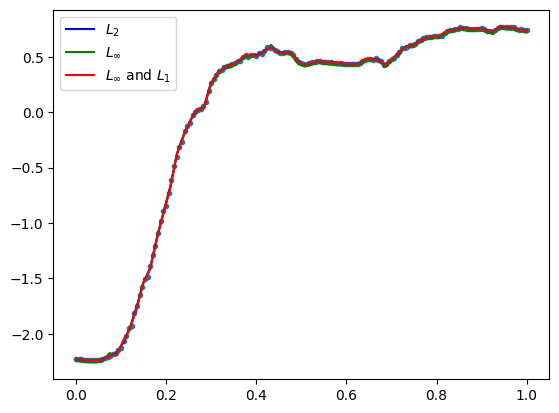

            max_dist       MSE      RMSE       MAE
LSQ         0.026354  0.000041  0.006369  0.004107
Max         0.020192  0.000301  0.017362  0.016456
Max and L1  0.020193  0.000056  0.007507  0.004256 

opt distance 0.020191763185252502
number of data points: 171


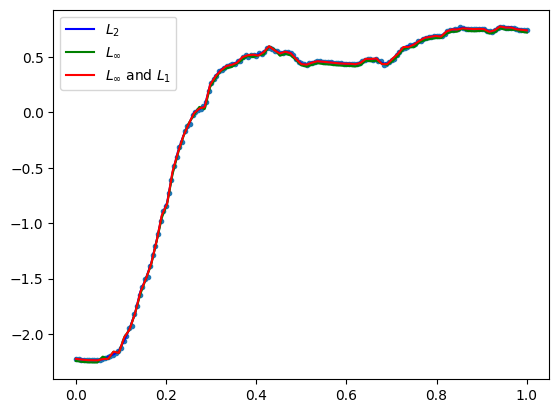

GestureMidAirD3 no. 105 len(ts): 240 ts processed: 50.480000000000004 %
[24, 48, 72, 96, 120]
            max_dist       MSE      RMSE       MAE
LSQ         0.150180  0.001780  0.042188  0.031157
Max         0.136277  0.009002  0.094879  0.085478
Max and L1  0.136278  0.003013  0.054887  0.037778 
opt distance 0.13627721203336057
number of data points: 240


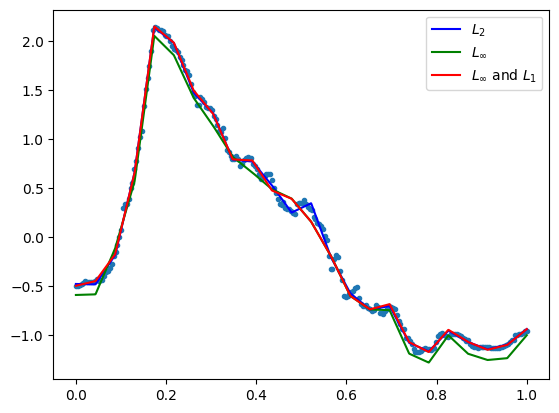

            max_dist       MSE      RMSE       MAE
LSQ         0.173899  0.001052  0.032438  0.021656
Max         0.124568  0.009379  0.096843  0.090200
Max and L1  0.124569  0.001603  0.040032  0.024449 

opt distance 0.12456771237060271
number of data points: 240


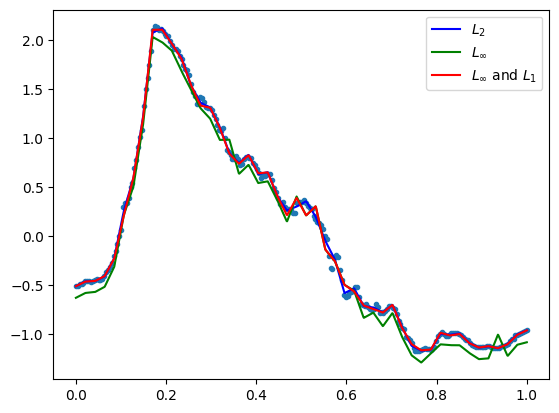

            max_dist       MSE      RMSE       MAE
LSQ         0.098269  0.000511  0.022609  0.015527
Max         0.070287  0.003020  0.054952  0.050530
Max and L1  0.070288  0.000600  0.024503  0.015224 

opt distance 0.07028656289038948
number of data points: 240


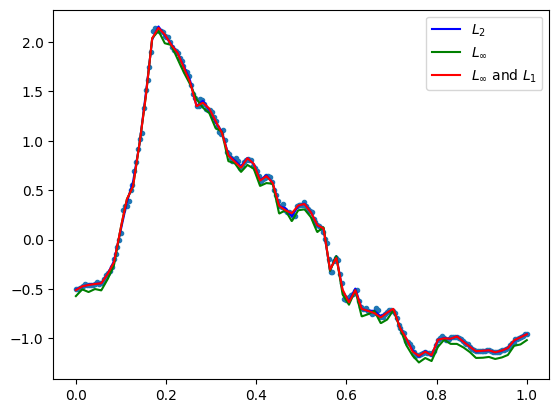

            max_dist       MSE      RMSE       MAE
LSQ         0.073730  0.000282  0.016806  0.011454
Max         0.053830  0.001975  0.044439  0.041432
Max and L1  0.053831  0.000363  0.019062  0.011118 

opt distance 0.05383042301230252
number of data points: 240


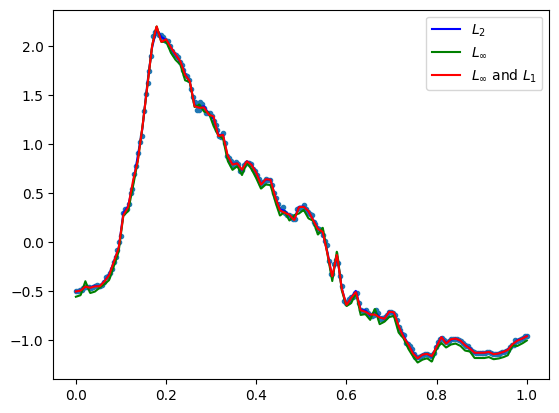

            max_dist       MSE      RMSE       MAE
LSQ         0.071585  0.000209  0.014460  0.009642
Max         0.047511  0.001655  0.040684  0.038433
Max and L1  0.047512  0.000298  0.017258  0.009723 

opt distance 0.047510931388708925
number of data points: 240


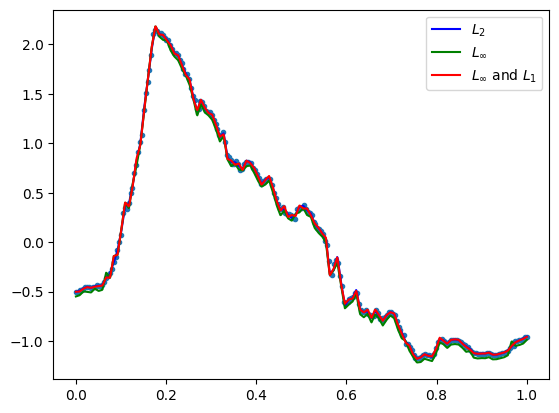

GestureMidAirD3 no. 106 len(ts): 178 ts processed: 50.96000000000001 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.195944  0.004049  0.063634  0.048656
Max         0.160466  0.011119  0.105449  0.094576
Max and L1  0.160467  0.006234  0.078953  0.061120 

opt distance 0.1604655559655498
number of data points: 178


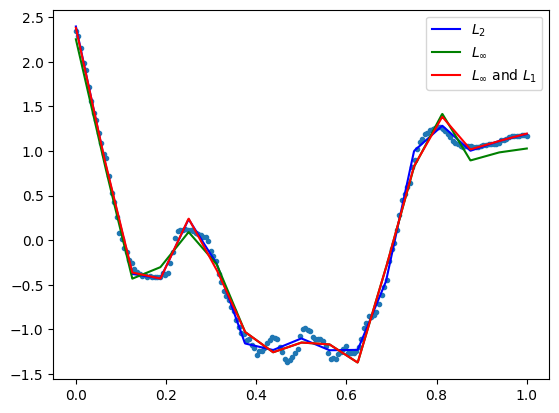

            max_dist       MSE      RMSE       MAE
LSQ         0.096028  0.000887  0.029782  0.021815
Max         0.070376  0.002469  0.049692  0.044348
Max and L1  0.070377  0.001214  0.034840  0.025988 

opt distance 0.07037582221359906
number of data points: 178


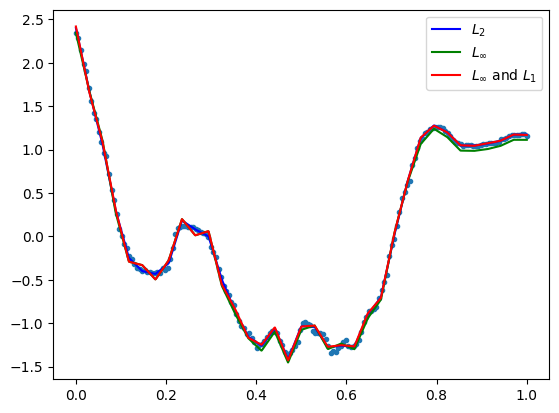

            max_dist       MSE      RMSE       MAE
LSQ         0.073720  0.000496  0.022265  0.015964
Max         0.061092  0.002077  0.045571  0.041301
Max and L1  0.061093  0.000690  0.026277  0.017259 

opt distance 0.06109168204162965
number of data points: 178


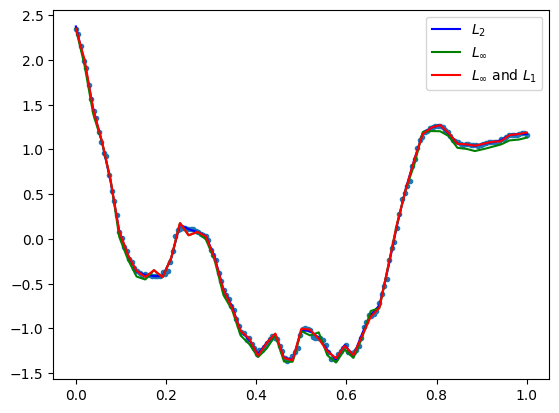

            max_dist       MSE      RMSE       MAE
LSQ         0.054494  0.000281  0.016751  0.012231
Max         0.037593  0.000889  0.029821  0.027401
Max and L1  0.037594  0.000337  0.018351  0.012324 

opt distance 0.03759274672353119
number of data points: 178


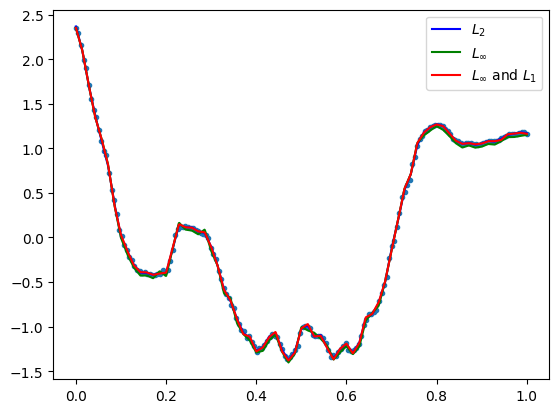

            max_dist       MSE      RMSE       MAE
LSQ         0.052076  0.000179  0.013369  0.009650
Max         0.033103  0.000762  0.027601  0.025866
Max and L1  0.033104  0.000249  0.015777  0.009854 

opt distance 0.0331025271741484
number of data points: 178


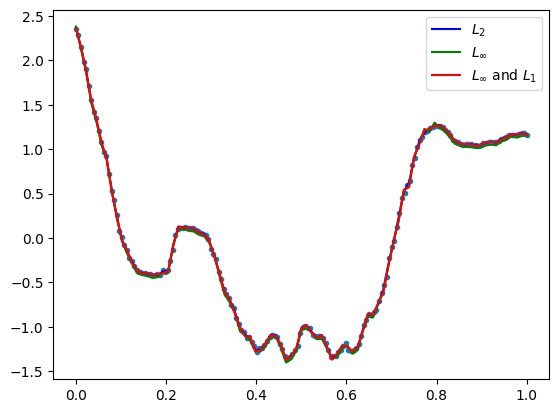

GestureMidAirD3 no. 107 len(ts): 120 ts processed: 51.44 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.148869  0.004128  0.064253  0.051934
Max         0.130965  0.007530  0.086775  0.075825
Max and L1  0.130966  0.005313  0.072890  0.059087 

opt distance 0.1309654640995211
number of data points: 120


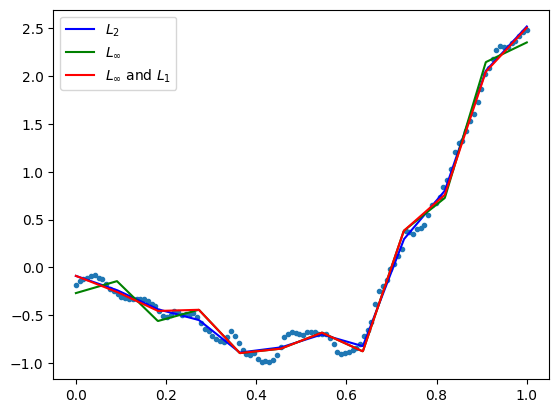

            max_dist       MSE      RMSE       MAE
LSQ         0.091264  0.000902  0.030028  0.023197
Max         0.060844  0.001725  0.041529  0.036989
Max and L1  0.060845  0.001008  0.031745  0.024057 

opt distance 0.060844404953740355
number of data points: 120


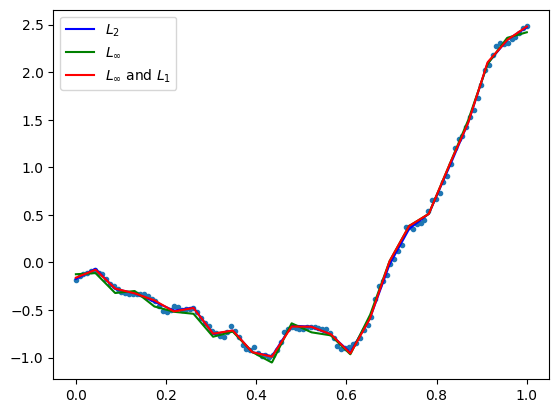

            max_dist       MSE      RMSE       MAE
LSQ         0.090158  0.000519  0.022790  0.017311
Max         0.058558  0.001962  0.044295  0.039985
Max and L1  0.058559  0.000742  0.027233  0.018865 

opt distance 0.05855773028052307
number of data points: 120


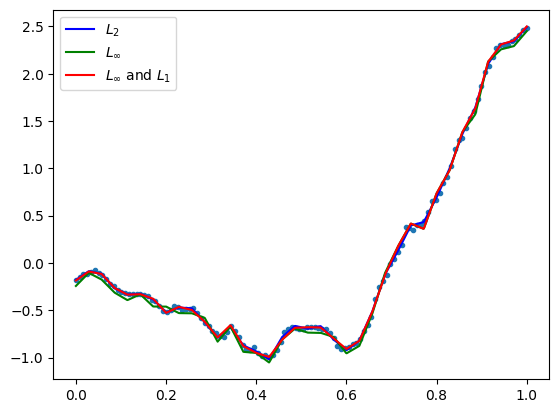

            max_dist       MSE      RMSE       MAE
LSQ         0.078451  0.000363  0.019060  0.014210
Max         0.059547  0.002274  0.047686  0.044219
Max and L1  0.059548  0.000520  0.022812  0.013958 

opt distance 0.059546927731892824
number of data points: 120


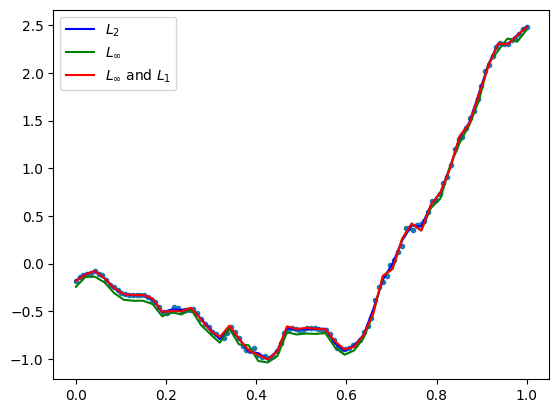

            max_dist       MSE      RMSE       MAE
LSQ         0.053591  0.000221  0.014859  0.010964
Max         0.036945  0.000969  0.031123  0.029110
Max and L1  0.036946  0.000288  0.016977  0.010569 

opt distance 0.03694462588760383
number of data points: 120


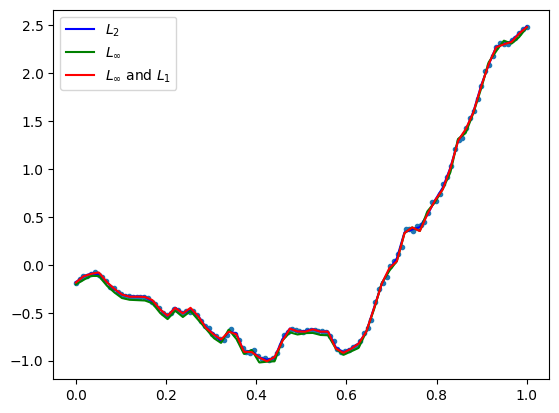

GestureMidAirD3 no. 108 len(ts): 287 ts processed: 51.92 %
[28, 57, 86, 114, 143]
            max_dist       MSE      RMSE       MAE
LSQ         0.287709  0.003980  0.063084  0.040580
Max         0.212885  0.024817  0.157533  0.144506
Max and L1  0.212886  0.004728  0.068761  0.042379 
opt distance 0.21288513283018276
number of data points: 287


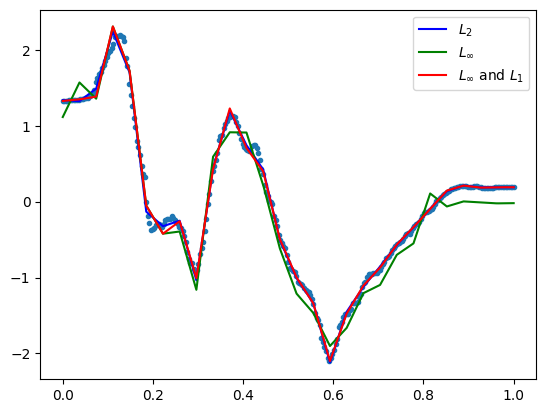

            max_dist       MSE      RMSE       MAE
LSQ         0.128699  0.000736  0.027126  0.017751
Max         0.095523  0.005614  0.074925  0.068812
Max and L1  0.095524  0.000904  0.030069  0.018380 

opt distance 0.09552333509566523
number of data points: 287


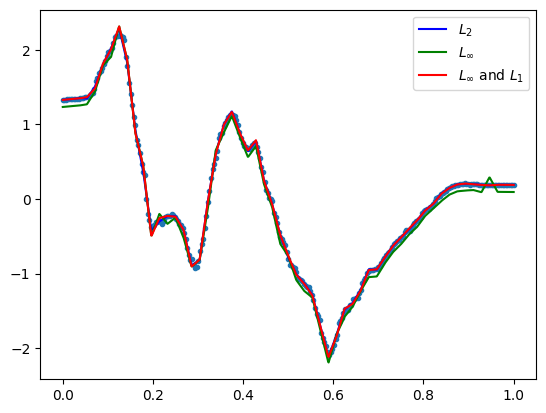

            max_dist       MSE      RMSE       MAE
LSQ         0.130943  0.000386  0.019643  0.012576
Max         0.079916  0.004366  0.066074  0.061598
Max and L1  0.079917  0.000615  0.024805  0.013985 

opt distance 0.07991604729425444
number of data points: 287


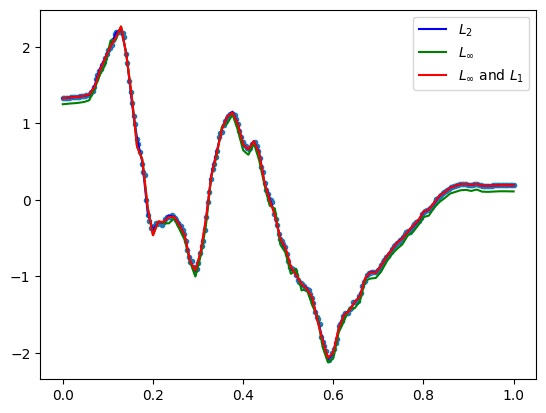

            max_dist       MSE      RMSE       MAE
LSQ         0.115147  0.000253  0.015905  0.009652
Max         0.069684  0.003713  0.060932  0.058696
Max and L1  0.069685  0.000389  0.019735  0.010115 
opt distance 0.06968411371733689
number of data points: 287


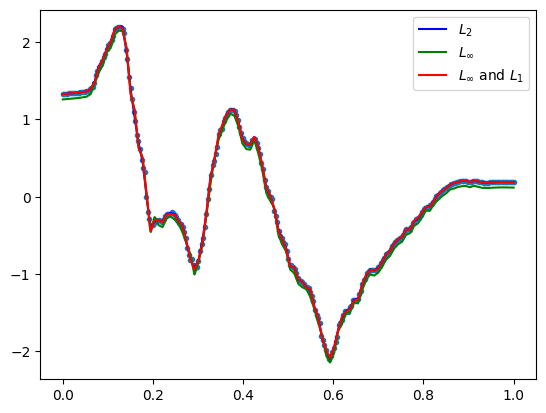

            max_dist       MSE      RMSE       MAE
LSQ         0.065027  0.000139  0.011782  0.007271
Max         0.048748  0.001886  0.043427  0.041640
Max and L1  0.048749  0.000211  0.014528  0.007192 
opt distance 0.048748383524187644
number of data points: 287


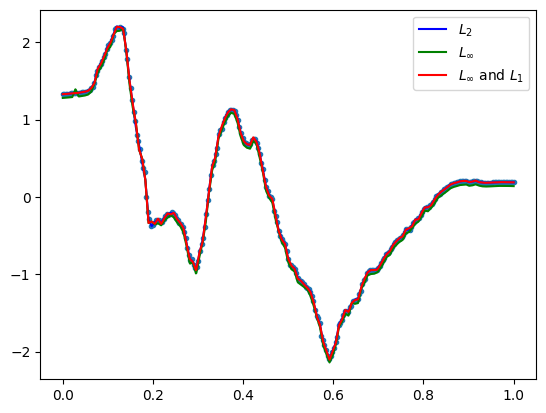

GestureMidAirD3 no. 109 len(ts): 180 ts processed: 52.400000000000006 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.049365  0.000203  0.014232  0.009592
Max         0.045625  0.001172  0.034240  0.031521
Max and L1  0.045626  0.000230  0.015155  0.009632 

opt distance 0.045625427280177835
number of data points: 180


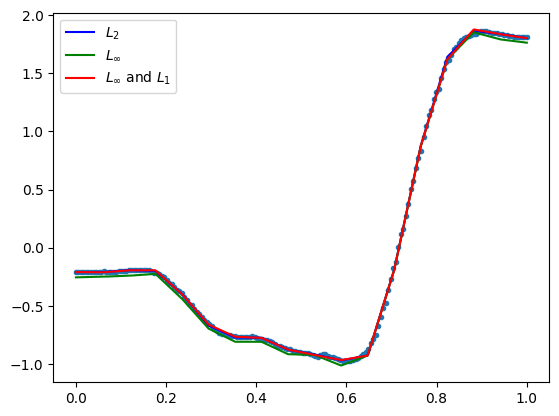

            max_dist       MSE      RMSE       MAE
LSQ         0.035637  0.000064  0.007981  0.004991
Max         0.028647  0.000535  0.023125  0.021661
Max and L1  0.028648  0.000072  0.008493  0.004827 

opt distance 0.02864725590080867
number of data points: 180


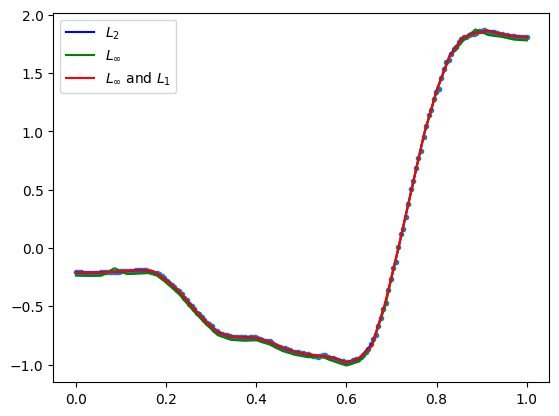

            max_dist       MSE      RMSE       MAE
LSQ         0.032455  0.000052  0.007243  0.004097
Max         0.024735  0.000444  0.021064  0.019986
Max and L1  0.024736  0.000070  0.008350  0.004495 

opt distance 0.024735236805245794
number of data points: 180


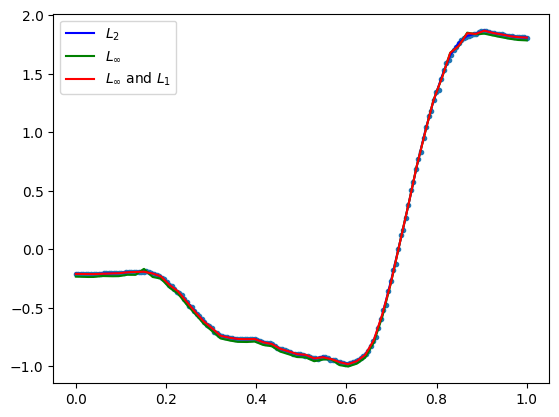

            max_dist       MSE      RMSE       MAE
LSQ         0.030869  0.000036  0.006036  0.003281
Max         0.023101  0.000410  0.020250  0.019405
Max and L1  0.023102  0.000045  0.006688  0.003335 

opt distance 0.023100573221336455
number of data points: 180


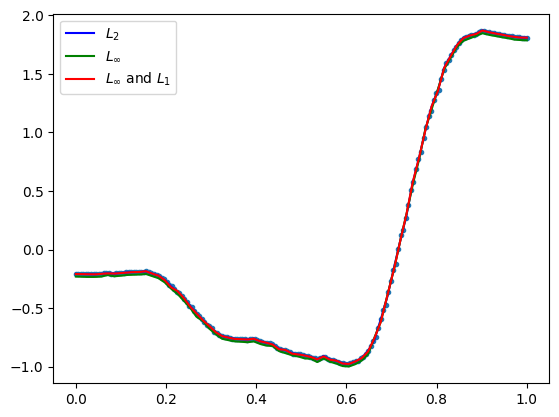

            max_dist       MSE      RMSE       MAE
LSQ         0.022587  0.000023  0.004807  0.002772
Max         0.014832  0.000172  0.013106  0.012560
Max and L1  0.014833  0.000030  0.005463  0.002822 

opt distance 0.0148321981385652
number of data points: 180


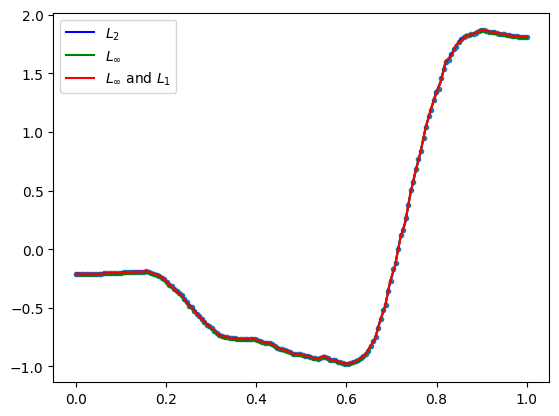

GestureMidAirD3 no. 110 len(ts): 120 ts processed: 52.88 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.089951  0.000685  0.026174  0.017075
Max         0.074840  0.002379  0.048776  0.042798
Max and L1  0.074841  0.001290  0.035916  0.027098 

opt distance 0.074839658112279
number of data points: 120


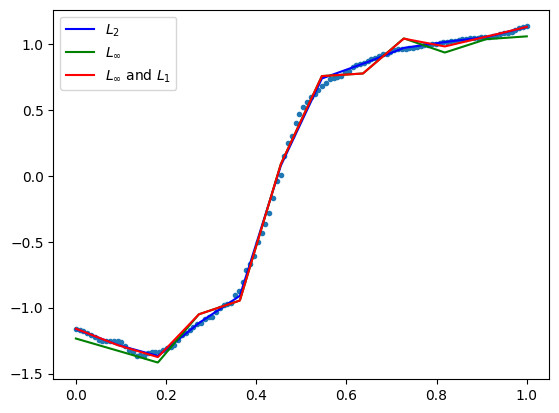

            max_dist       MSE      RMSE       MAE
LSQ         0.034944  0.000086  0.009248  0.006496
Max         0.025992  0.000397  0.019916  0.018468
Max and L1  0.025993  0.000112  0.010574  0.006943 

opt distance 0.025991647830814254
number of data points: 120


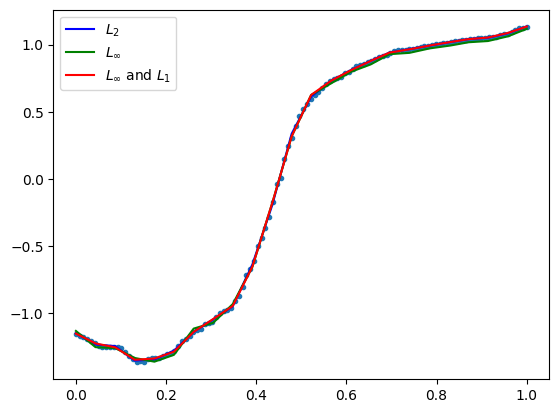

            max_dist       MSE      RMSE       MAE
LSQ         0.034641  0.000062  0.007863  0.005139
Max         0.025111  0.000449  0.021184  0.020178
Max and L1  0.025112  0.000080  0.008952  0.005296 

opt distance 0.02511056484806526
number of data points: 120


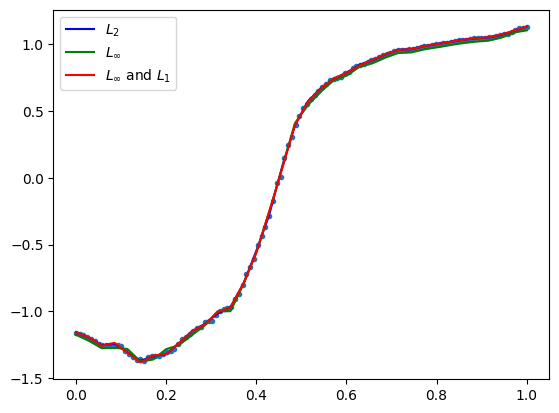

            max_dist       MSE      RMSE       MAE
LSQ         0.034014  0.000041  0.006433  0.004055
Max         0.024930  0.000442  0.021023  0.019782
Max and L1  0.024931  0.000069  0.008320  0.004598 

opt distance 0.024929624524594275
number of data points: 120


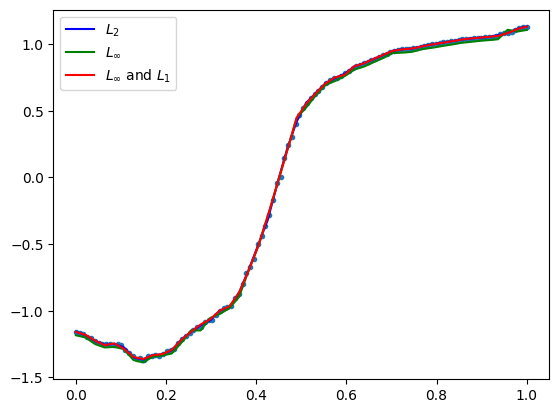

            max_dist       MSE      RMSE       MAE
LSQ         0.027257  0.000031  0.005603  0.003350
Max         0.020676  0.000338  0.018390  0.017638
Max and L1  0.020677  0.000051  0.007116  0.003602 

opt distance 0.02067644037259575
number of data points: 120


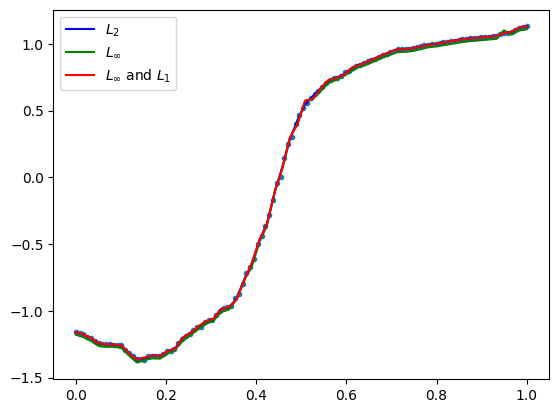

GestureMidAirD3 no. 111 len(ts): 239 ts processed: 53.37 %
[23, 47, 71, 95, 119]
            max_dist       MSE      RMSE       MAE
LSQ         0.115095  0.000852  0.029191  0.019377
Max         0.101215  0.005761  0.075900  0.070700
Max and L1  0.101216  0.000902  0.030025  0.019607 

opt distance 0.10121481473335714
number of data points: 239


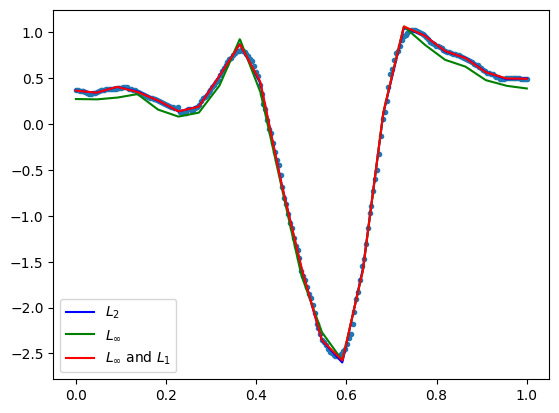

            max_dist       MSE      RMSE       MAE
LSQ         0.069165  0.000180  0.013412  0.008630
Max         0.054625  0.001960  0.044273  0.041826
Max and L1  0.054626  0.000213  0.014604  0.008650 

opt distance 0.05462502071958378
number of data points: 239


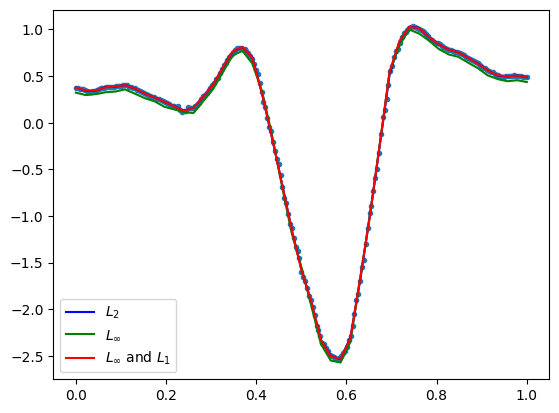

            max_dist       MSE      RMSE       MAE
LSQ         0.056827  0.000143  0.011960  0.007284
Max         0.042694  0.001319  0.036313  0.034772
Max and L1  0.042695  0.000202  0.014229  0.008011 

opt distance 0.04269394046166994
number of data points: 239


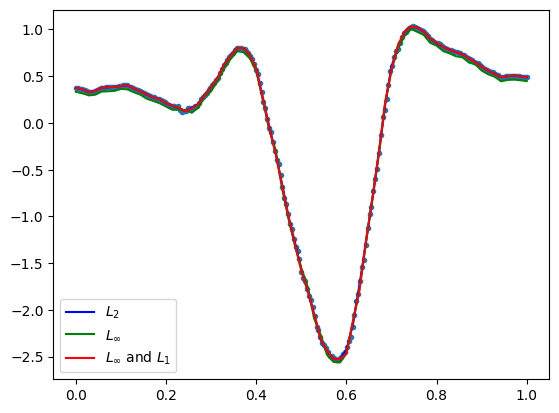

            max_dist       MSE      RMSE       MAE
LSQ         0.036302  0.000095  0.009731  0.006069
Max         0.030360  0.000667  0.025829  0.024656
Max and L1  0.030361  0.000108  0.010409  0.005750 

opt distance 0.03036041782652278
number of data points: 239


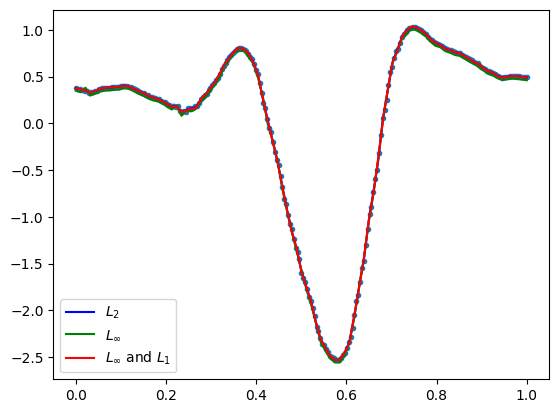

            max_dist       MSE      RMSE       MAE
LSQ         0.037855  0.000069  0.008294  0.005000
Max         0.028084  0.000631  0.025115  0.024214
Max and L1  0.028085  0.000091  0.009532  0.004791 

opt distance 0.028083803088139514
number of data points: 239


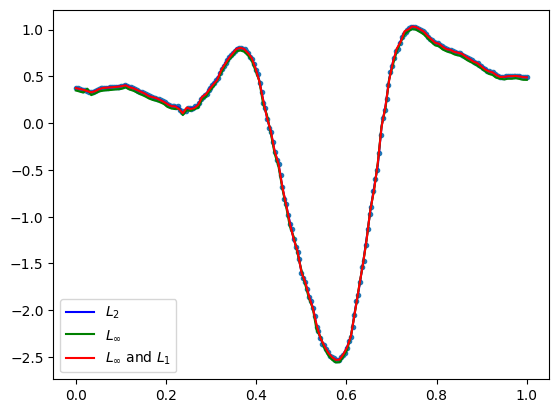

GestureMidAirD3 no. 112 len(ts): 223 ts processed: 53.849999999999994 %
[22, 44, 66, 89, 111]
            max_dist       MSE      RMSE       MAE
LSQ         0.289550  0.002340  0.048369  0.028647
Max         0.197998  0.024505  0.156542  0.145305
Max and L1  0.197999  0.003091  0.055601  0.031109 
opt distance 0.19799772558262038
number of data points: 223


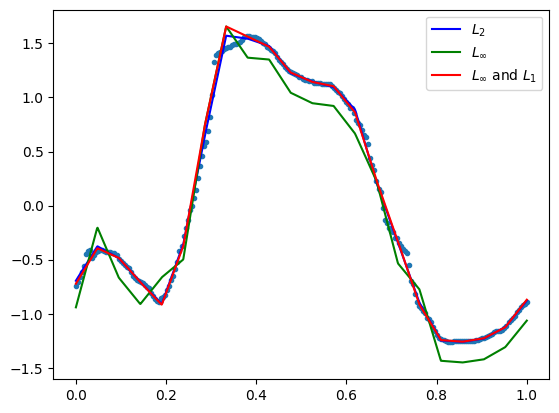

            max_dist       MSE      RMSE       MAE
LSQ         0.159227  0.000763  0.027618  0.015076
Max         0.131139  0.012368  0.111211  0.106715
Max and L1  0.131140  0.000966  0.031088  0.015803 

opt distance 0.13113859535747294
number of data points: 223


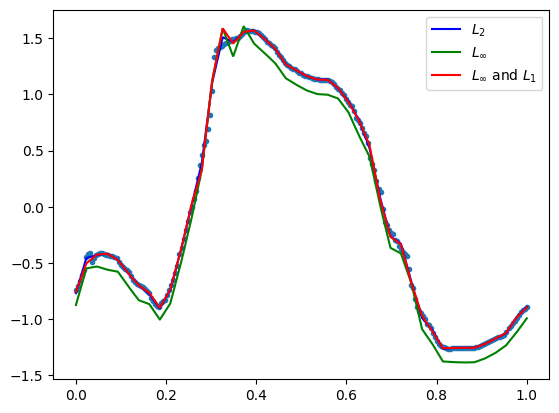

            max_dist       MSE      RMSE       MAE
LSQ         0.063706  0.000193  0.013881  0.008384
Max         0.045544  0.001422  0.037706  0.035838
Max and L1  0.045545  0.000243  0.015573  0.009089 

opt distance 0.04554422721254814
number of data points: 223


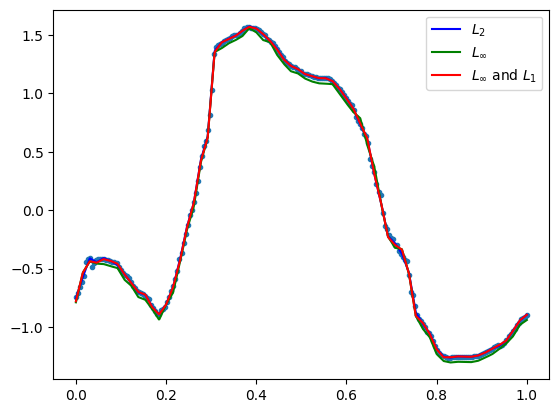

            max_dist       MSE      RMSE       MAE
LSQ         0.049687  0.000109  0.010419  0.005879
Max         0.038283  0.001103  0.033213  0.032012
Max and L1  0.038284  0.000135  0.011620  0.005859 

opt distance 0.03828333948944969
number of data points: 223


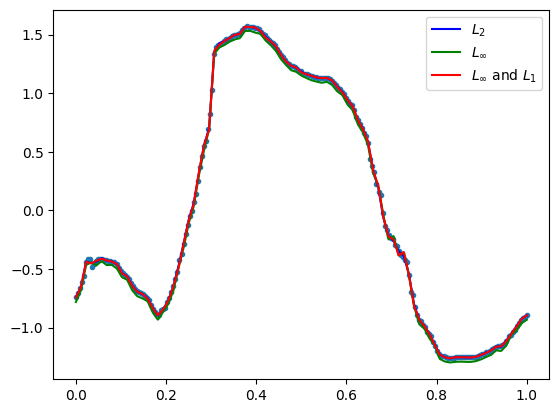

            max_dist       MSE      RMSE       MAE
LSQ         0.047735  0.000076  0.008738  0.004833
Max         0.034407  0.000919  0.030309  0.029053
Max and L1  0.034408  0.000131  0.011456  0.005841 

opt distance 0.0344073770145035
number of data points: 223


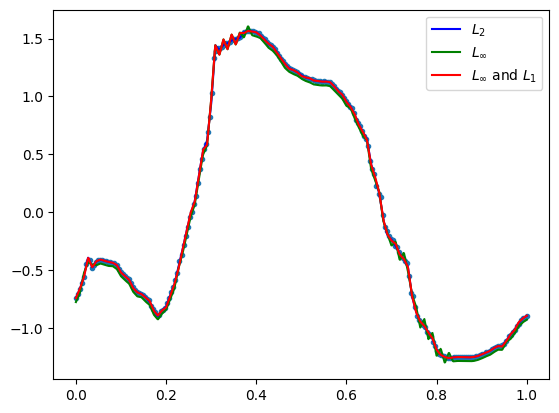

GestureMidAirD3 no. 113 len(ts): 179 ts processed: 54.33 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.062952  0.000445  0.021100  0.015377
Max         0.052814  0.001096  0.033110  0.028766
Max and L1  0.052815  0.000536  0.023147  0.017033 

opt distance 0.05281402472665572
number of data points: 179


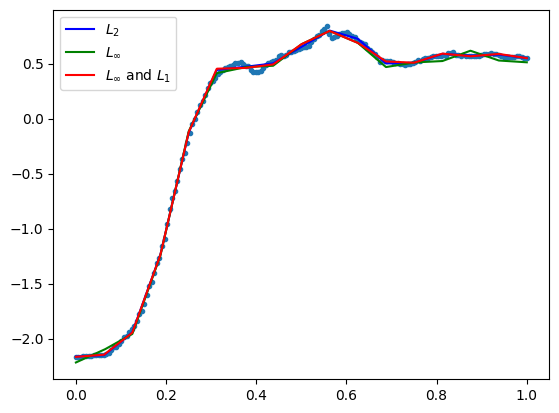

            max_dist       MSE      RMSE       MAE
LSQ         0.051252  0.000174  0.013181  0.009129
Max         0.042657  0.001093  0.033059  0.030731
Max and L1  0.042658  0.000260  0.016137  0.010758 

opt distance 0.04265693168748478
number of data points: 179


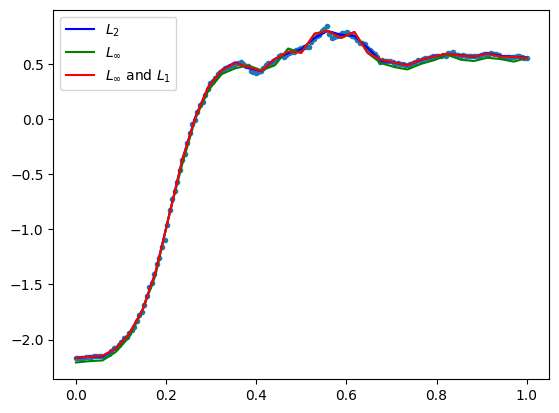

            max_dist       MSE      RMSE       MAE
LSQ         0.033398  0.000071  0.008400  0.005934
Max         0.026966  0.000448  0.021154  0.019343
Max and L1  0.026967  0.000090  0.009491  0.005668 

opt distance 0.02696557320082127
number of data points: 179


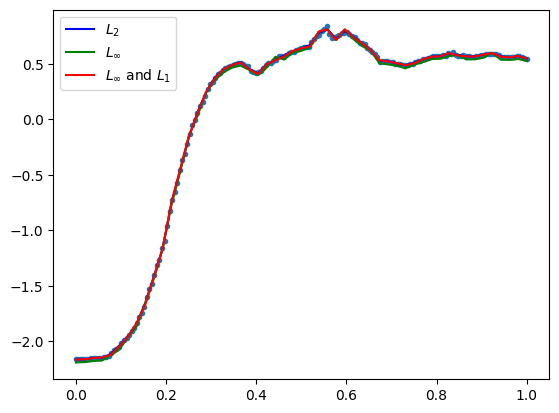

            max_dist       MSE      RMSE       MAE
LSQ         0.025049  0.000050  0.007074  0.004955
Max         0.019803  0.000263  0.016228  0.015068
Max and L1  0.019804  0.000063  0.007922  0.004788 

opt distance 0.019802625354386448
number of data points: 179


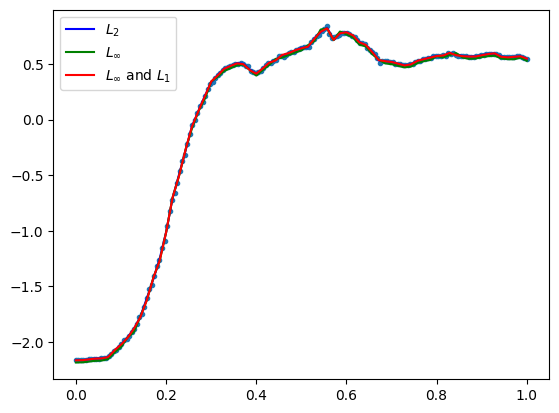

            max_dist       MSE      RMSE       MAE
LSQ         0.023426  0.000037  0.006123  0.004223
Max         0.018556  0.000248  0.015750  0.014785
Max and L1  0.018557  0.000048  0.006933  0.003898 

opt distance 0.01855635802182721
number of data points: 179


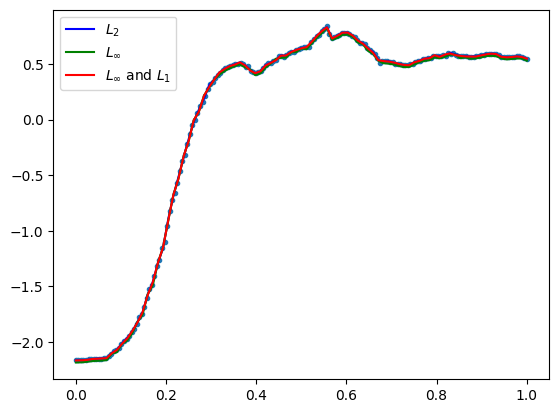

GestureMidAirD3 no. 114 len(ts): 179 ts processed: 54.81 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.050188  0.000164  0.012801  0.008572
Max         0.044410  0.001131  0.033629  0.031068
Max and L1  0.044411  0.000182  0.013482  0.008480 

opt distance 0.04441016593084468
number of data points: 179


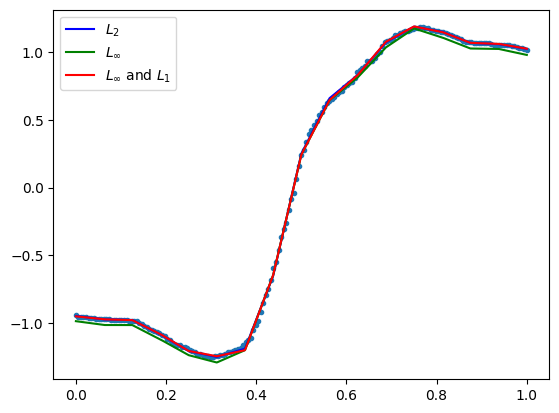

            max_dist       MSE      RMSE       MAE
LSQ         0.031533  0.000047  0.006830  0.004457
Max         0.022198  0.000298  0.017274  0.016169
Max and L1  0.022199  0.000056  0.007516  0.004603 

opt distance 0.022197534256423696
number of data points: 179


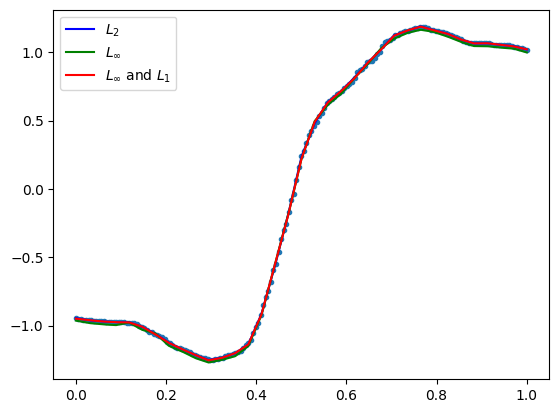

            max_dist       MSE      RMSE       MAE
LSQ         0.021667  0.000027  0.005168  0.003202
Max         0.018226  0.000229  0.015136  0.014538
Max and L1  0.018227  0.000030  0.005520  0.003111 

opt distance 0.01822572045525661
number of data points: 179


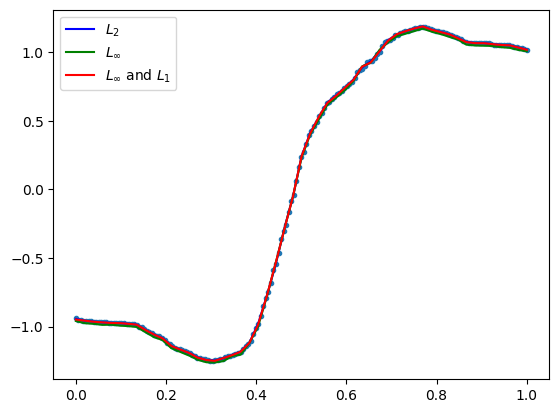

            max_dist       MSE      RMSE       MAE
LSQ         0.018595  0.000021  0.004579  0.002811
Max         0.015882  0.000186  0.013642  0.013062
Max and L1  0.015883  0.000024  0.004905  0.002641 

opt distance 0.01588208208138671
number of data points: 179


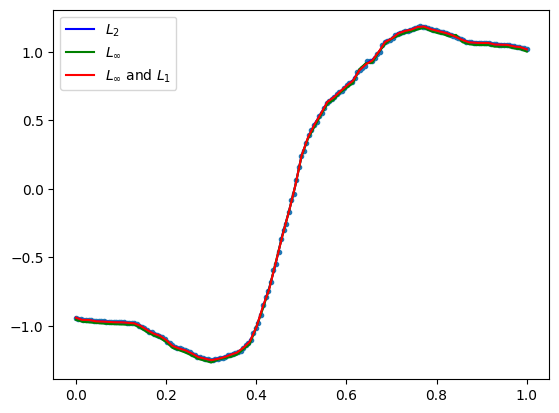

            max_dist       MSE      RMSE       MAE
LSQ         0.022819  0.000015  0.003908  0.002166
Max         0.014798  0.000178  0.013333  0.013039
Max and L1  0.014799  0.000021  0.004541  0.002188 

opt distance 0.014797954851064221
number of data points: 179


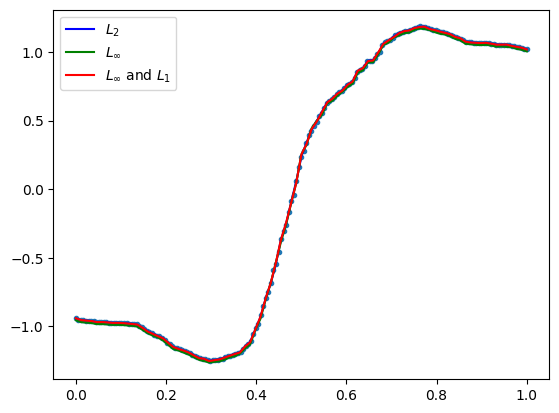

GestureMidAirD3 no. 115 len(ts): 120 ts processed: 55.28999999999999 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.105724  0.001592  0.039905  0.030691
Max         0.080678  0.002597  0.050957  0.044530
Max and L1  0.080679  0.002218  0.047092  0.039542 

opt distance 0.08067840869561466
number of data points: 120


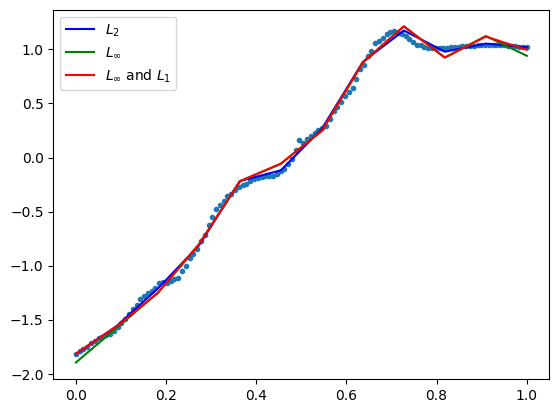

            max_dist       MSE      RMSE       MAE
LSQ         0.078194  0.000187  0.013671  0.009012
Max         0.045985  0.001359  0.036867  0.034467
Max and L1  0.045986  0.000278  0.016672  0.010659 

opt distance 0.04598481105652155
number of data points: 120


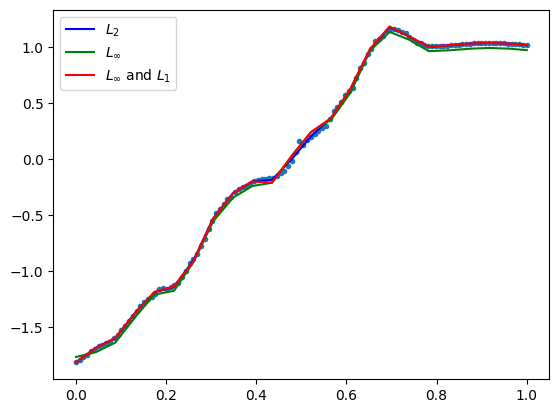

            max_dist       MSE      RMSE       MAE
LSQ         0.055163  0.000101  0.010064  0.006209
Max         0.035351  0.000846  0.029084  0.027121
Max and L1  0.035352  0.000160  0.012639  0.007388 

opt distance 0.03535092188153826
number of data points: 120


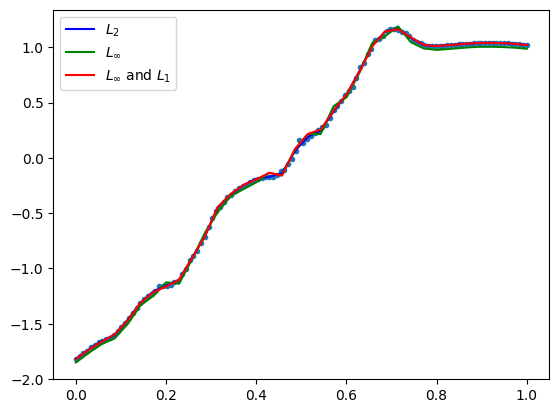

            max_dist       MSE      RMSE       MAE
LSQ         0.041628  0.000057  0.007575  0.004883
Max         0.027627  0.000513  0.022650  0.021016
Max and L1  0.027628  0.000079  0.008867  0.004949 

opt distance 0.027626972321193852
number of data points: 120


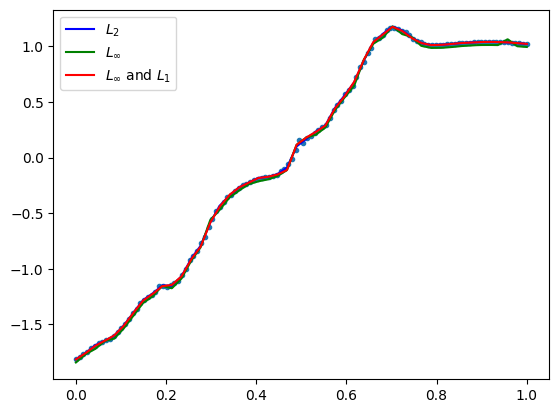

            max_dist       MSE      RMSE       MAE
LSQ         0.025559  0.000034  0.005858  0.003885
Max         0.019724  0.000289  0.017009  0.015966
Max and L1  0.019725  0.000051  0.007143  0.003798 

opt distance 0.019723769412767655
number of data points: 120


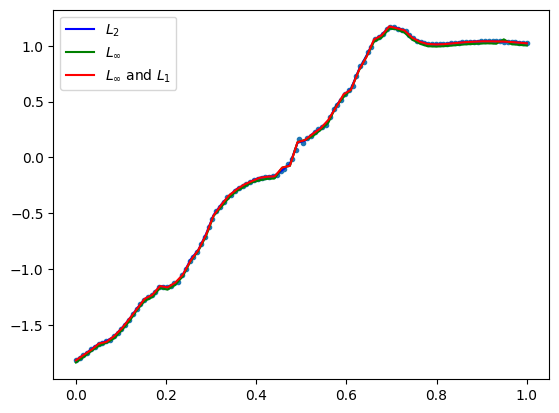

GestureMidAirD3 no. 116 len(ts): 143 ts processed: 55.769999999999996 %
[14, 28, 42, 57, 71]
            max_dist       MSE      RMSE       MAE
LSQ         0.049855  0.000192  0.013849  0.009721
Max         0.044474  0.000969  0.031136  0.027868
Max and L1  0.044475  0.000272  0.016503  0.011190 

opt distance 0.04447351397553878
number of data points: 143


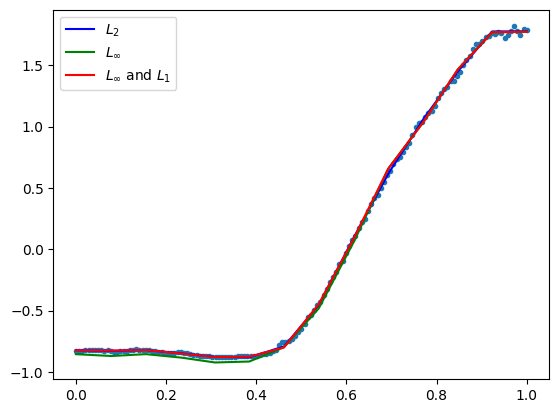

            max_dist       MSE      RMSE       MAE
LSQ         0.044584  0.000106  0.010315  0.006849
Max         0.035565  0.000755  0.027469  0.025643
Max and L1  0.035566  0.000144  0.012001  0.007499 

opt distance 0.03556471824688689
number of data points: 143


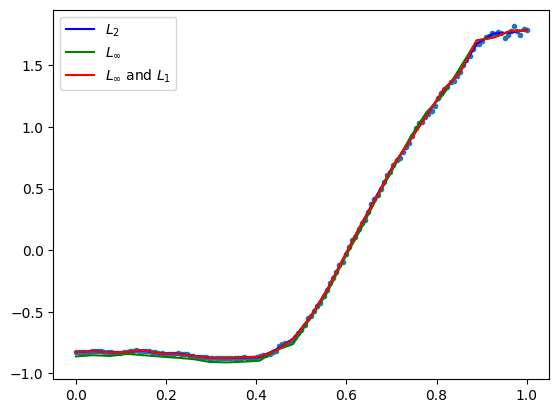

            max_dist       MSE      RMSE       MAE
LSQ         0.039533  0.000068  0.008236  0.005573
Max         0.030511  0.000601  0.024525  0.022783
Max and L1  0.030512  0.000106  0.010299  0.006015 

opt distance 0.0305110219699129
number of data points: 143


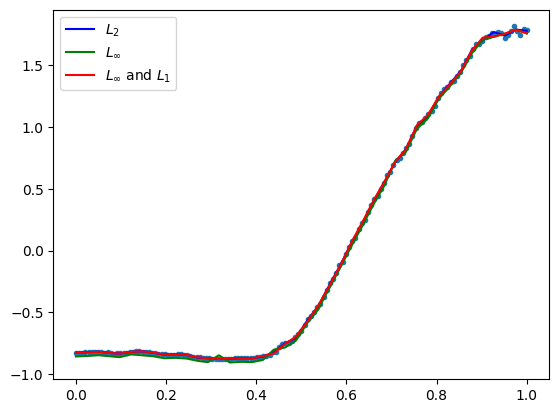

            max_dist       MSE      RMSE       MAE
LSQ         0.037743  0.000066  0.008104  0.005166
Max         0.026327  0.000492  0.022183  0.020764
Max and L1  0.026328  0.000084  0.009164  0.005150 

opt distance 0.026327097557063583
number of data points: 143


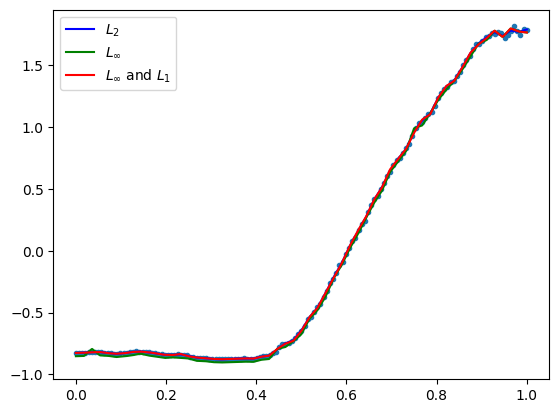

            max_dist       MSE      RMSE       MAE
LSQ         0.020911  0.000029  0.005428  0.003619
Max         0.014323  0.000153  0.012383  0.011740
Max and L1  0.014324  0.000039  0.006227  0.003589 

opt distance 0.014322858667382964
number of data points: 143


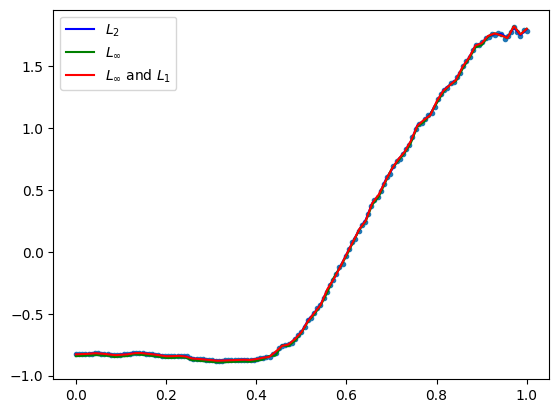

GestureMidAirD3 no. 117 len(ts): 180 ts processed: 56.25 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.039683  0.000089  0.009431  0.005866
Max         0.030647  0.000521  0.022817  0.020840
Max and L1  0.030648  0.000136  0.011663  0.007742 

opt distance 0.030646721116802333
number of data points: 180


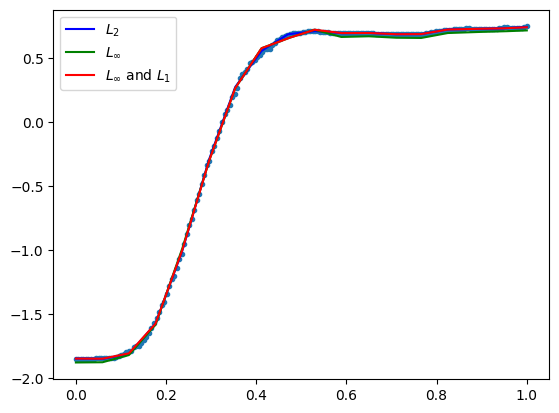

            max_dist       MSE      RMSE       MAE
LSQ         0.022211  0.000032  0.005691  0.003460
Max         0.016641  0.000178  0.013334  0.012422
Max and L1  0.016642  0.000035  0.005878  0.003386 

opt distance 0.016641240580090127
number of data points: 180


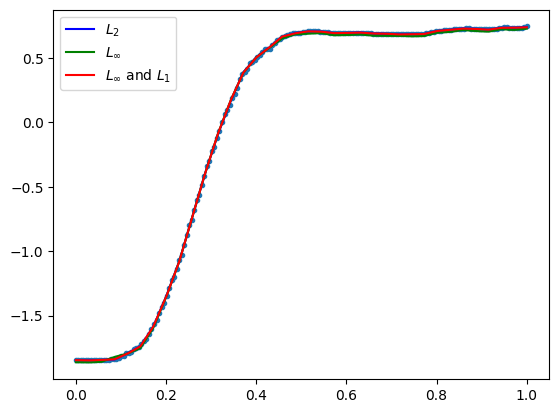

            max_dist       MSE      RMSE       MAE
LSQ         0.018751  0.000030  0.005443  0.003074
Max         0.016107  0.000190  0.013785  0.013186
Max and L1  0.016108  0.000034  0.005830  0.003207 

opt distance 0.016107059229013843
number of data points: 180


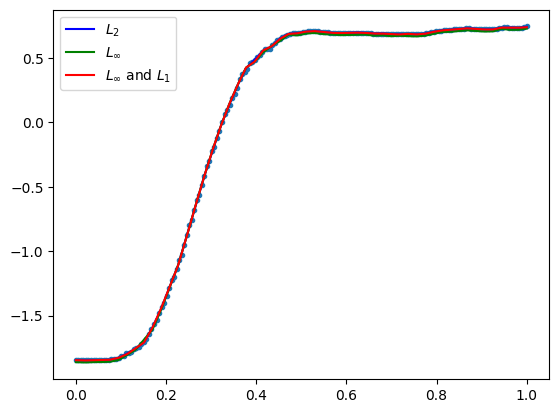

            max_dist       MSE      RMSE       MAE
LSQ         0.016034  0.000021  0.004574  0.002412
Max         0.013660  0.000146  0.012083  0.011596
Max and L1  0.013661  0.000023  0.004785  0.002424 

opt distance 0.013659870112063915
number of data points: 180


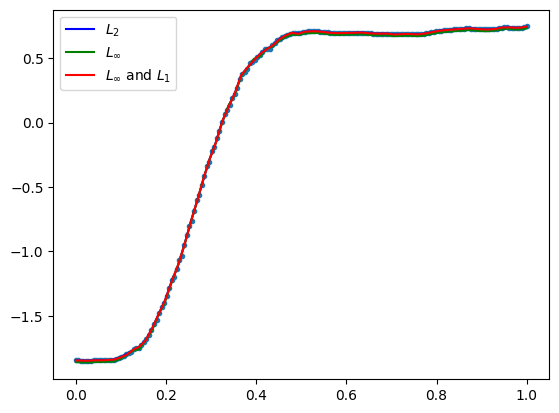

            max_dist       MSE      RMSE       MAE
LSQ         0.016009  0.000018  0.004300  0.002349
Max         0.012328  0.000127  0.011258  0.010872
Max and L1  0.012329  0.000025  0.004971  0.002574 

opt distance 0.012328310759270227
number of data points: 180


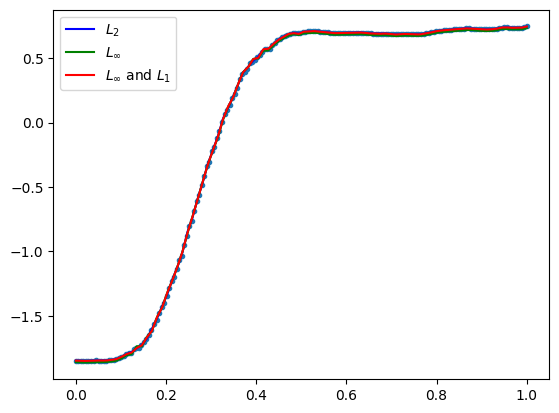

GestureMidAirD3 no. 118 len(ts): 111 ts processed: 56.730000000000004 %
[11, 22, 33, 44, 55]
            max_dist       MSE      RMSE       MAE
LSQ         0.490912  0.008131  0.090173  0.060011
Max         0.306253  0.061951  0.248900  0.230622
Max and L1  0.306254  0.014801  0.121660  0.079874 

opt distance 0.30625335490450667
number of data points: 111


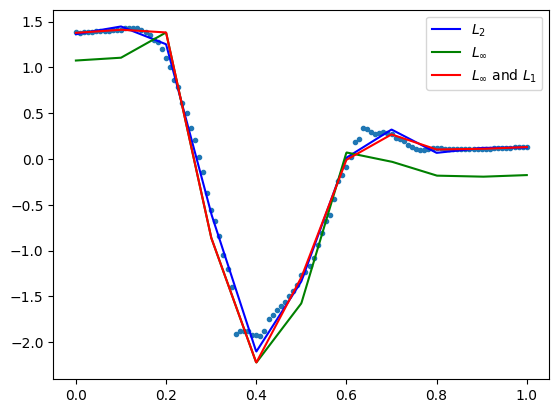

            max_dist       MSE      RMSE       MAE
LSQ         0.314054  0.001873  0.043279  0.020321
Max         0.214003  0.032253  0.179591  0.168878
Max and L1  0.214004  0.004018  0.063388  0.031147 

opt distance 0.2140029636156811
number of data points: 111


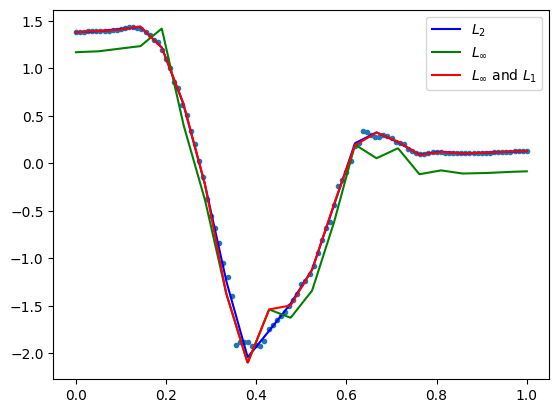

            max_dist       MSE      RMSE       MAE
LSQ         0.260599  0.001300  0.036051  0.017579
Max         0.176671  0.025140  0.158556  0.153019
Max and L1  0.176672  0.001832  0.042802  0.019262 

opt distance 0.1766706408699792
number of data points: 111


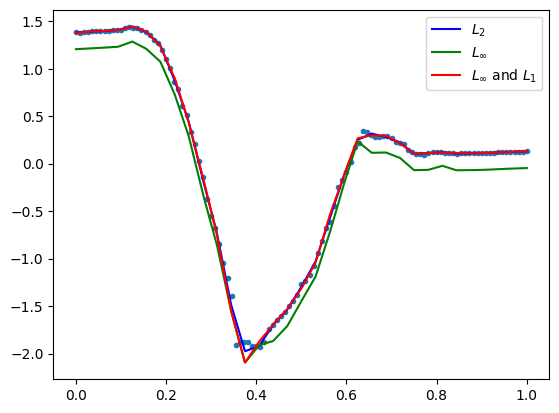

            max_dist       MSE      RMSE       MAE
LSQ         0.187268  0.000881  0.029686  0.013996
Max         0.151167  0.019024  0.137927  0.133840
Max and L1  0.151168  0.001947  0.044127  0.018742 

opt distance 0.15116741145869525
number of data points: 111


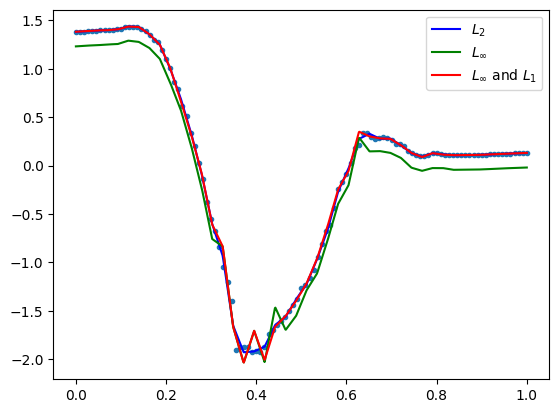

            max_dist       MSE      RMSE       MAE
LSQ         0.147376  0.000506  0.022494  0.010599
Max         0.101007  0.008499  0.092191  0.088649
Max and L1  0.101008  0.001162  0.034081  0.015825 

opt distance 0.10100677869403116
number of data points: 111


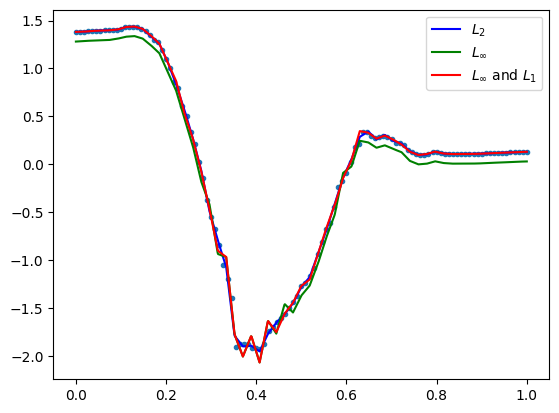

GestureMidAirD3 no. 119 len(ts): 180 ts processed: 57.21000000000001 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.057353  0.000326  0.018059  0.012180
Max         0.050637  0.001305  0.036119  0.032979
Max and L1  0.050638  0.000437  0.020909  0.014950 

opt distance 0.050636750380950946
number of data points: 180


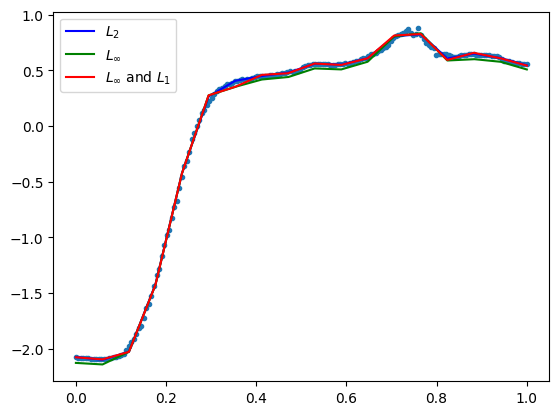

            max_dist       MSE      RMSE       MAE
LSQ         0.055123  0.000089  0.009412  0.006149
Max         0.036887  0.000865  0.029403  0.027685
Max and L1  0.036888  0.000118  0.010871  0.006602 
opt distance 0.03688747965615552
number of data points: 180


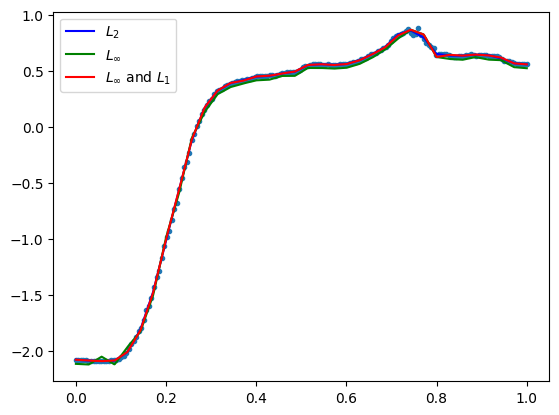

            max_dist       MSE      RMSE       MAE
LSQ         0.048522  0.000078  0.008820  0.005305
Max         0.032516  0.000738  0.027168  0.025883
Max and L1  0.032517  0.000106  0.010298  0.005693 

opt distance 0.03251646248671161
number of data points: 180


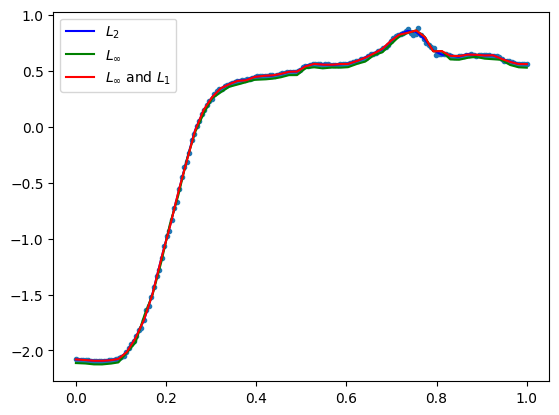

            max_dist       MSE      RMSE       MAE
LSQ         0.028517  0.000044  0.006614  0.004177
Max         0.019687  0.000270  0.016424  0.015603
Max and L1  0.019688  0.000053  0.007262  0.004225 

opt distance 0.019686612279268143
number of data points: 180


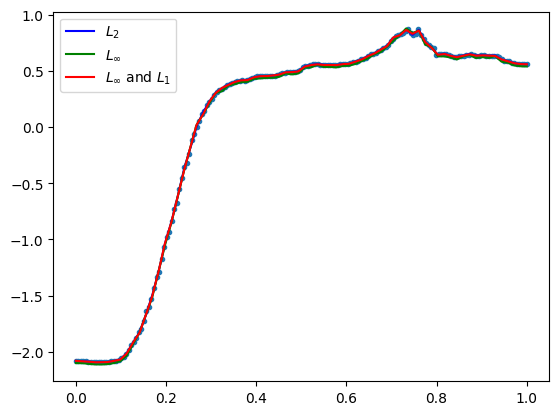

            max_dist       MSE      RMSE       MAE
LSQ         0.032095  0.000039  0.006265  0.003489
Max         0.021885  0.000394  0.019855  0.019355
Max and L1  0.021886  0.000055  0.007420  0.003733 

opt distance 0.021884796438209533
number of data points: 180


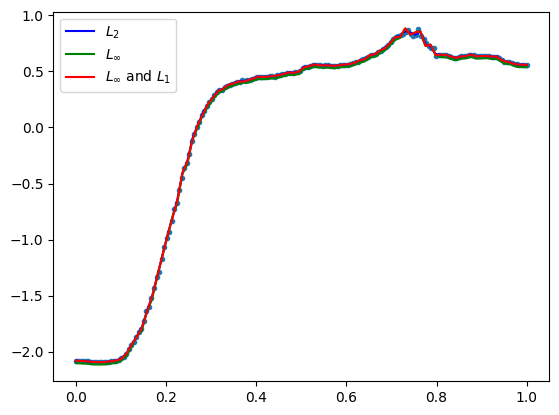

GestureMidAirD3 no. 120 len(ts): 114 ts processed: 57.69 %
[11, 22, 34, 45, 57]
            max_dist       MSE      RMSE       MAE
LSQ         0.122893  0.002021  0.044952  0.033770
Max         0.093200  0.003638  0.060317  0.053072
Max and L1  0.093201  0.002896  0.053812  0.045161 

opt distance 0.09320035095787471
number of data points: 114


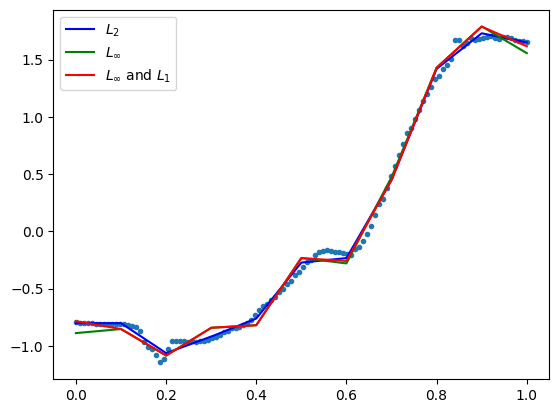

            max_dist       MSE      RMSE       MAE
LSQ         0.090277  0.000384  0.019601  0.013097
Max         0.063824  0.002275  0.047695  0.043434
Max and L1  0.063825  0.000656  0.025614  0.016672 

opt distance 0.06382388803566497
number of data points: 114


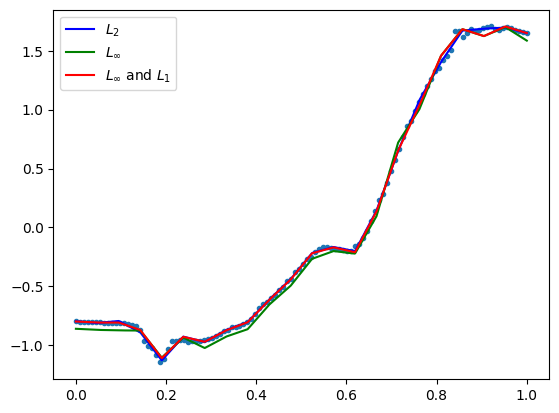

            max_dist       MSE      RMSE       MAE
LSQ         0.063153  0.000164  0.012813  0.008151
Max         0.047479  0.001562  0.039519  0.037578
Max and L1  0.047480  0.000207  0.014378  0.008193 

opt distance 0.04747867068313726
number of data points: 114


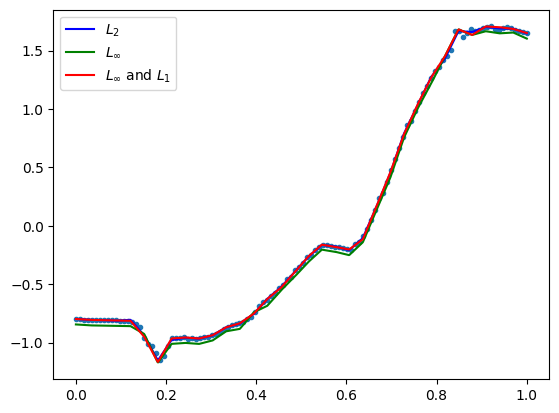

            max_dist       MSE      RMSE       MAE
LSQ         0.047363  0.000122  0.011053  0.006561
Max         0.033710  0.000795  0.028202  0.026443
Max and L1  0.033711  0.000161  0.012694  0.007067 
opt distance 0.03370973833430746
number of data points: 114


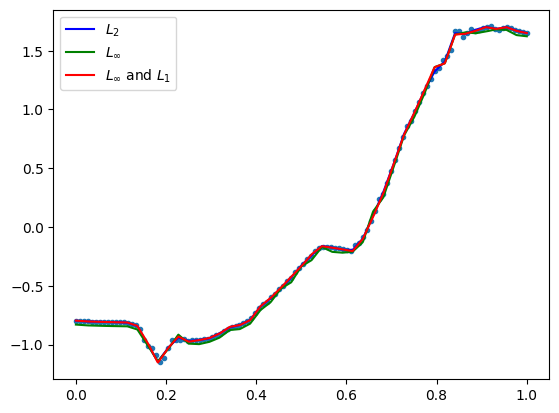

            max_dist       MSE      RMSE       MAE
LSQ         0.051619  0.000093  0.009663  0.005799
Max         0.032651  0.000838  0.028952  0.027843
Max and L1  0.032652  0.000134  0.011559  0.006058 

opt distance 0.03265133299812084
number of data points: 114


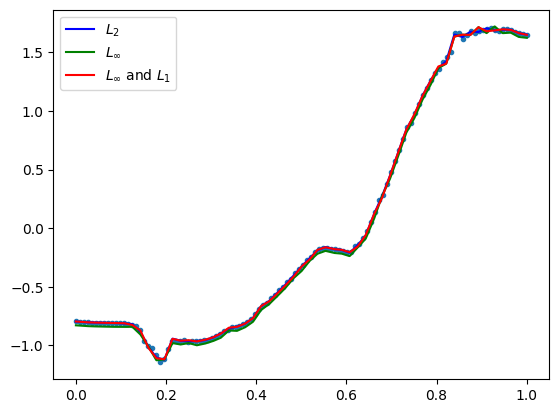

GestureMidAirD3 no. 121 len(ts): 167 ts processed: 58.17 %
[16, 33, 50, 66, 83]
            max_dist       MSE      RMSE       MAE
LSQ         0.925086  0.030385  0.174314  0.107504
Max         0.625150  0.197885  0.444843  0.402482
Max and L1  0.625151  0.047765  0.218552  0.129238 

opt distance 0.6251495657588514
number of data points: 167


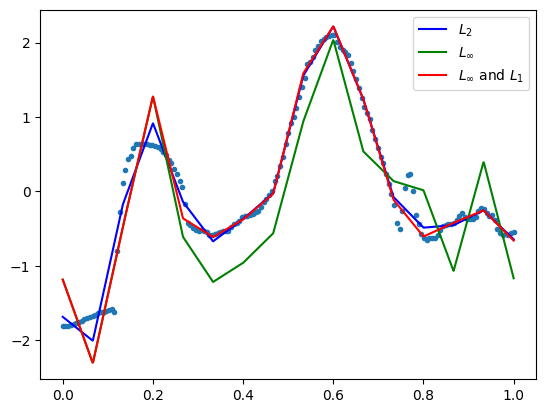

            max_dist       MSE      RMSE       MAE
LSQ         0.634689  0.010281  0.101393  0.052560
Max         0.416599  0.117666  0.343024  0.323932
Max and L1  0.416600  0.021289  0.145907  0.082753 

opt distance 0.41659940284829033
number of data points: 167


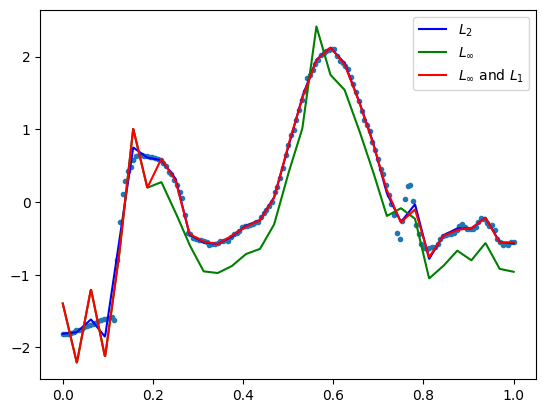

            max_dist       MSE      RMSE       MAE
LSQ         0.470894  0.004498  0.067065  0.034468
Max         0.306812  0.076066  0.275801  0.270762
Max and L1  0.306813  0.007102  0.084275  0.040056 

opt distance 0.30681233486077436
number of data points: 167


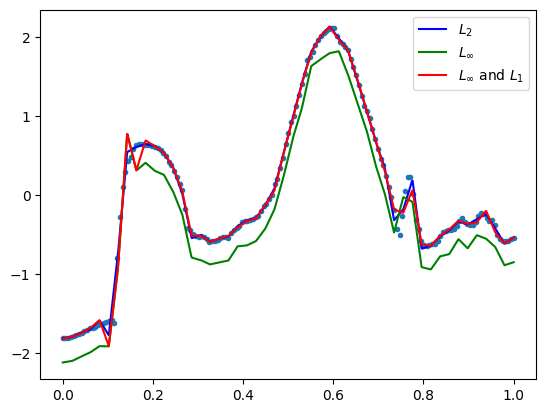

            max_dist       MSE      RMSE       MAE
LSQ         0.357144  0.001681  0.041001  0.018418
Max         0.227226  0.043941  0.209621  0.206225
Max and L1  0.227227  0.003215  0.056701  0.024554 

opt distance 0.22722550388190216
number of data points: 167


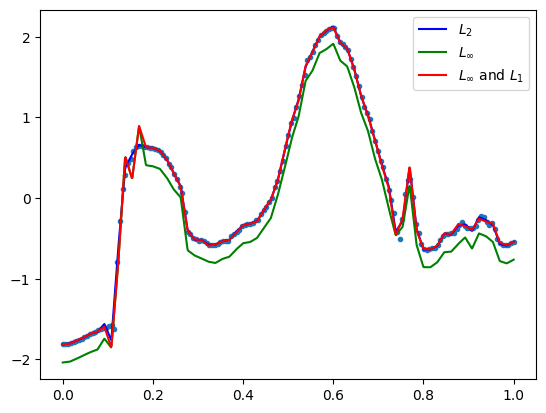

            max_dist       MSE      RMSE       MAE
LSQ         0.260841  0.000854  0.029232  0.013670
Max         0.178872  0.027190  0.164893  0.160514
Max and L1  0.178873  0.001840  0.042901  0.017360 

opt distance 0.1788716277886942
number of data points: 167


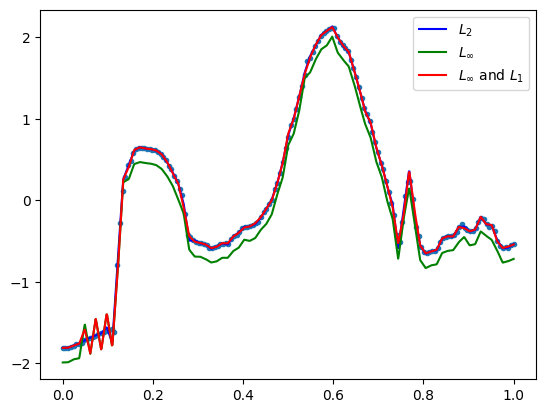

GestureMidAirD3 no. 122 len(ts): 225 ts processed: 58.650000000000006 %
[22, 45, 67, 90, 112]
            max_dist       MSE      RMSE       MAE
LSQ         0.383841  0.004435  0.066593  0.045978
Max         0.280027  0.047120  0.217071  0.203041
Max and L1  0.280028  0.006293  0.079331  0.050362 
opt distance 0.2800268267542091
number of data points: 225


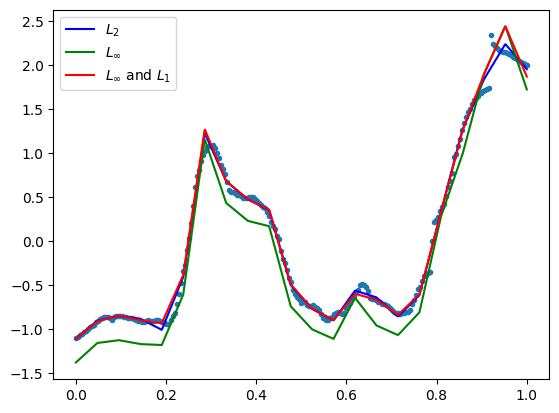

            max_dist       MSE      RMSE       MAE
LSQ         0.337812  0.001503  0.038770  0.019385
Max         0.240650  0.044035  0.209846  0.203387
Max and L1  0.240651  0.002934  0.054171  0.026350 

opt distance 0.2406499549379935
number of data points: 225


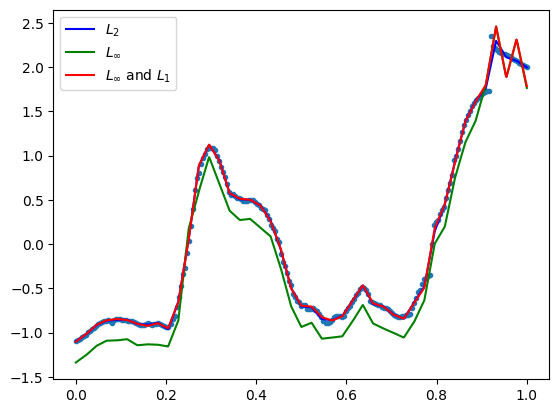

            max_dist       MSE      RMSE       MAE
LSQ         0.238373  0.000902  0.030035  0.013699
Max         0.179145  0.026064  0.161442  0.157177
Max and L1  0.179146  0.001170  0.034198  0.014752 

opt distance 0.17914519301151086
number of data points: 225


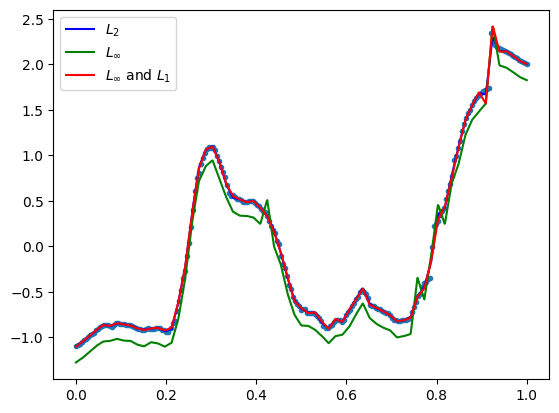

            max_dist       MSE      RMSE       MAE
LSQ         0.203710  0.000498  0.022326  0.010254
Max         0.151412  0.019509  0.139674  0.137646
Max and L1  0.151413  0.000701  0.026467  0.009800 

opt distance 0.15141176205692142
number of data points: 225


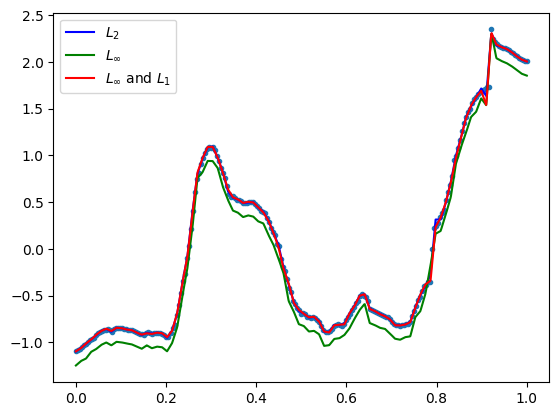

            max_dist       MSE      RMSE       MAE
LSQ         0.226826  0.000430  0.020736  0.008107
Max         0.159901  0.022753  0.150841  0.148197
Max and L1  0.159902  0.000918  0.030297  0.010419 

opt distance 0.1599013869410266
number of data points: 225


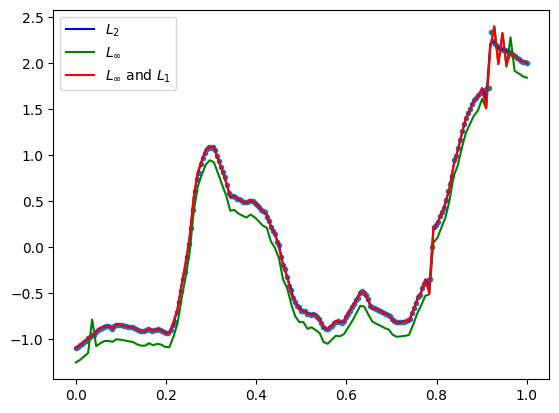

GestureMidAirD3 no. 123 len(ts): 120 ts processed: 59.13 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.256415  0.006856  0.082799  0.060417
Max         0.220196  0.022369  0.149562  0.132794
Max and L1  0.220197  0.009206  0.095950  0.070738 

opt distance 0.22019638507584693
number of data points: 120


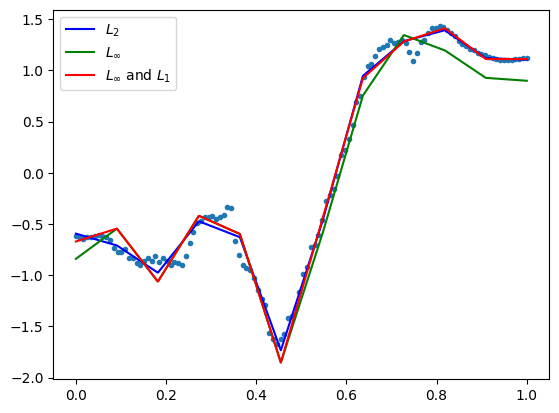

            max_dist       MSE      RMSE       MAE
LSQ         0.162234  0.002256  0.047494  0.033886
Max         0.124798  0.009390  0.096901  0.089159
Max and L1  0.124799  0.003154  0.056159  0.038832 

opt distance 0.12479778253092455
number of data points: 120


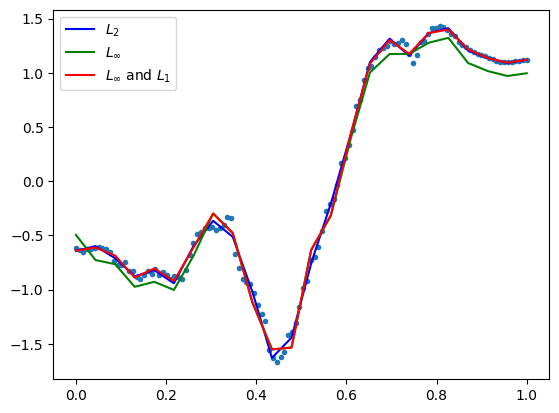

            max_dist       MSE      RMSE       MAE
LSQ         0.104579  0.000955  0.030899  0.022513
Max         0.073044  0.003048  0.055212  0.049334
Max and L1  0.073045  0.001127  0.033574  0.022919 

opt distance 0.07304419180072613
number of data points: 120


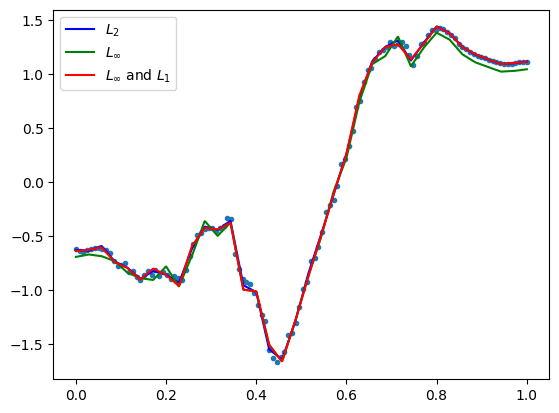

            max_dist       MSE      RMSE       MAE
LSQ         0.083951  0.000547  0.023385  0.017027
Max         0.066672  0.002806  0.052974  0.048309
Max and L1  0.066673  0.000735  0.027108  0.016810 

opt distance 0.06667224840091614
number of data points: 120


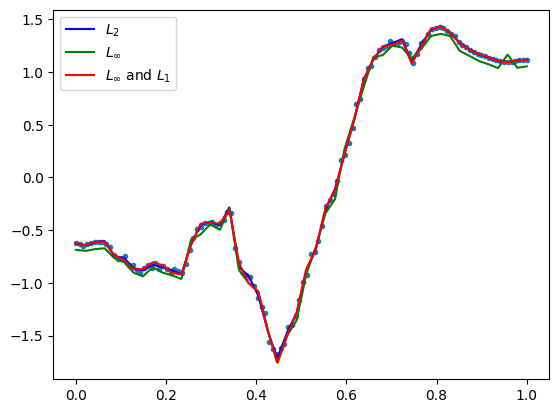

            max_dist       MSE      RMSE       MAE
LSQ         0.073069  0.000413  0.020326  0.014046
Max         0.053547  0.001951  0.044169  0.040685
Max and L1  0.053548  0.000624  0.024983  0.015680 

opt distance 0.053547153084944066
number of data points: 120


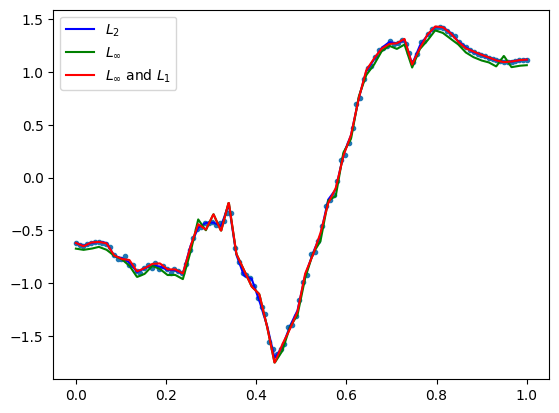

GestureMidAirD3 no. 124 len(ts): 164 ts processed: 59.62 %
[16, 32, 49, 65, 82]
            max_dist       MSE      RMSE       MAE
LSQ         0.534549  0.005828  0.076340  0.038285
Max         0.434103  0.117059  0.342138  0.320567
Max and L1  0.434104  0.012274  0.110786  0.061484 

opt distance 0.4341034426752154
number of data points: 164


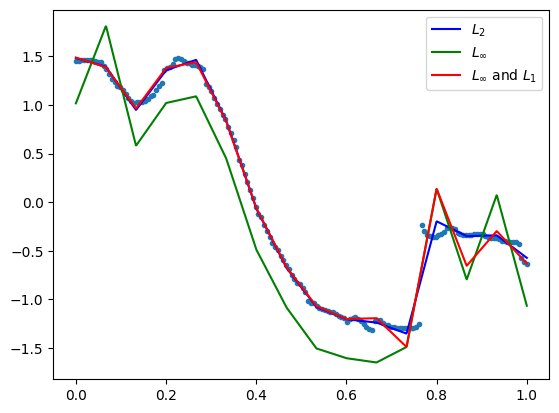

            max_dist       MSE      RMSE       MAE
LSQ         0.442492  0.003161  0.056219  0.024123
Max         0.376732  0.114265  0.338031  0.329603
Max and L1  0.376733  0.004423  0.066505  0.027117 

opt distance 0.3767320165061978
number of data points: 164


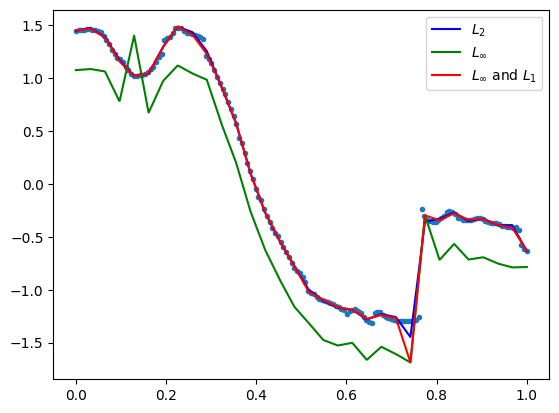

            max_dist       MSE      RMSE       MAE
LSQ         0.395332  0.001845  0.042949  0.014583
Max         0.307916  0.082386  0.287030  0.281292
Max and L1  0.307917  0.003210  0.056654  0.018849 

opt distance 0.30791564571880525
number of data points: 164


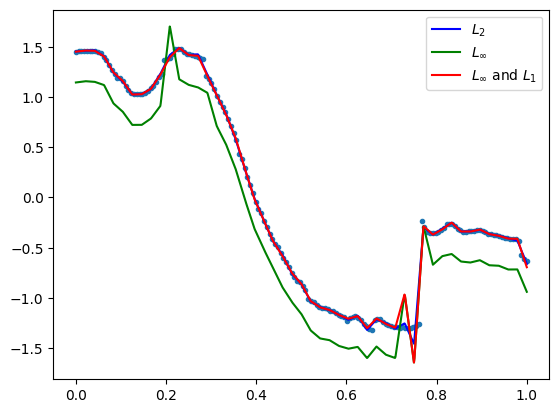

            max_dist       MSE      RMSE       MAE
LSQ         0.420969  0.002051  0.045288  0.015147
Max         0.313573  0.088547  0.297568  0.293390
Max and L1  0.313574  0.004556  0.067495  0.021387 

opt distance 0.313573164346119
number of data points: 164


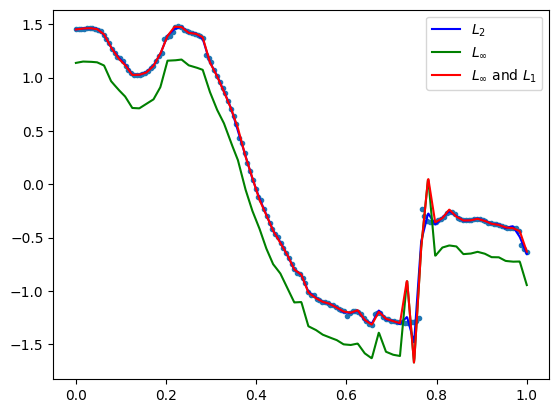

            max_dist       MSE      RMSE       MAE
LSQ         0.380184  0.001466  0.038288  0.011647
Max         0.263636  0.062522  0.250044  0.244773
Max and L1  0.263637  0.003632  0.060266  0.019973 

opt distance 0.26363585013864743
number of data points: 164


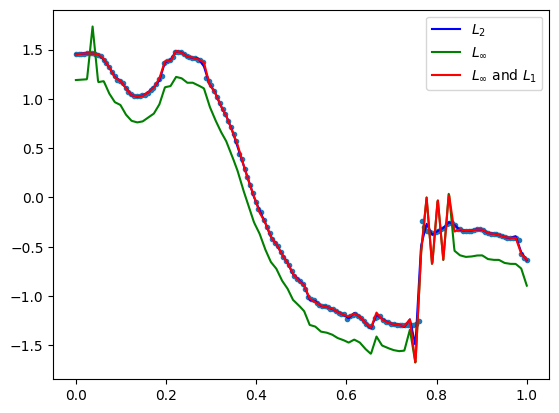

GestureMidAirD3 no. 125 len(ts): 180 ts processed: 60.099999999999994 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.091951  0.000359  0.018953  0.011222
Max         0.065644  0.002861  0.053485  0.050102
Max and L1  0.065645  0.000577  0.024023  0.014028 

opt distance 0.06564362233675147
number of data points: 180


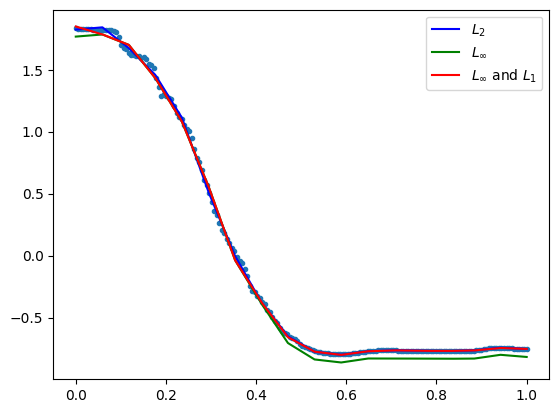

            max_dist       MSE      RMSE       MAE
LSQ         0.067435  0.000113  0.010624  0.005425
Max         0.045301  0.001547  0.039327  0.037684
Max and L1  0.045302  0.000159  0.012623  0.005905 

opt distance 0.045301481225534644
number of data points: 180


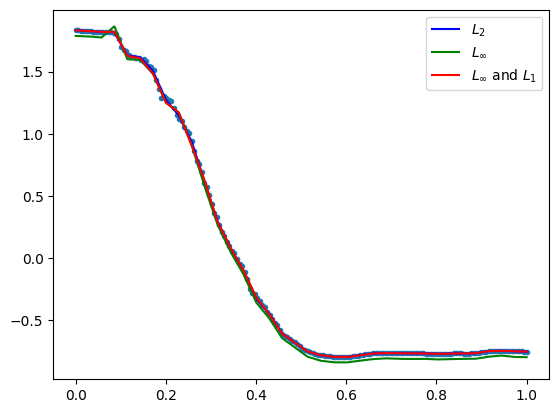

            max_dist       MSE      RMSE       MAE
LSQ         0.030702  0.000051  0.007172  0.004030
Max         0.021953  0.000371  0.019258  0.018301
Max and L1  0.021954  0.000066  0.008126  0.004278 

opt distance 0.021953281712529908
number of data points: 180


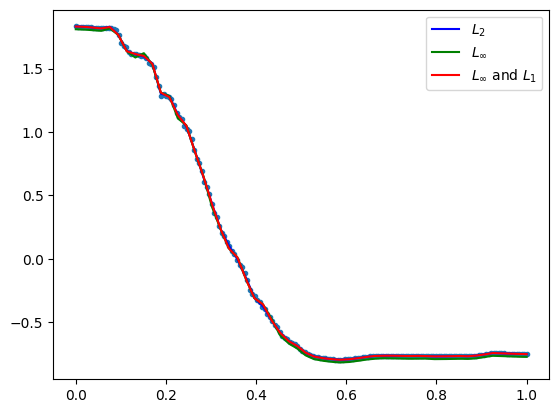

            max_dist       MSE      RMSE       MAE
LSQ         0.037453  0.000042  0.006456  0.003470
Max         0.023100  0.000430  0.020741  0.019875
Max and L1  0.023101  0.000056  0.007475  0.003344 

opt distance 0.02309982759094409
number of data points: 180


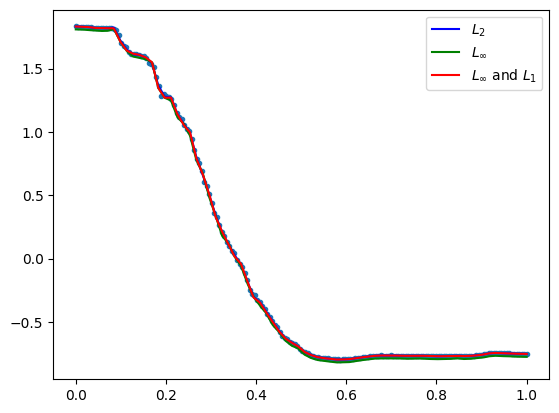

            max_dist       MSE      RMSE       MAE
LSQ         0.021552  0.000026  0.005141  0.002744
Max         0.014469  0.000173  0.013162  0.012734
Max and L1  0.014470  0.000034  0.005841  0.002984 

opt distance 0.01446854297586392
number of data points: 180


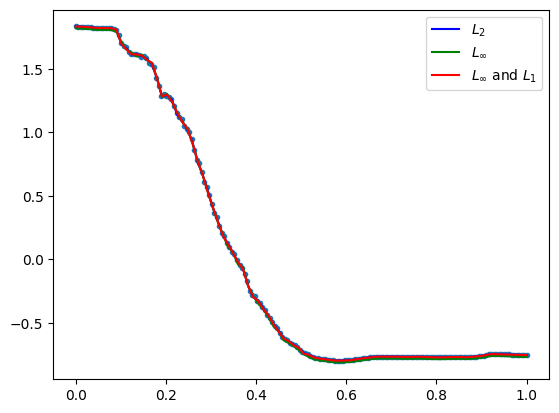

GestureMidAirD3 no. 126 len(ts): 180 ts processed: 60.58 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.257650  0.004875  0.069822  0.051172
Max         0.199831  0.018026  0.134260  0.120512
Max and L1  0.199832  0.008459  0.091971  0.069046 

opt distance 0.19983059882036674
number of data points: 180


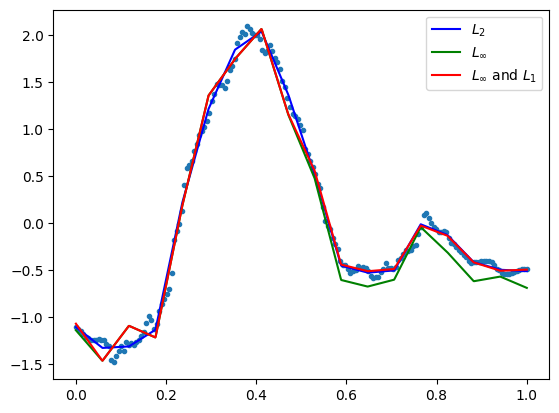

            max_dist       MSE      RMSE       MAE
LSQ         0.118319  0.001509  0.038847  0.029586
Max         0.096772  0.005098  0.071402  0.064672
Max and L1  0.096773  0.001657  0.040701  0.029032 
opt distance 0.09677249008647723
number of data points: 180


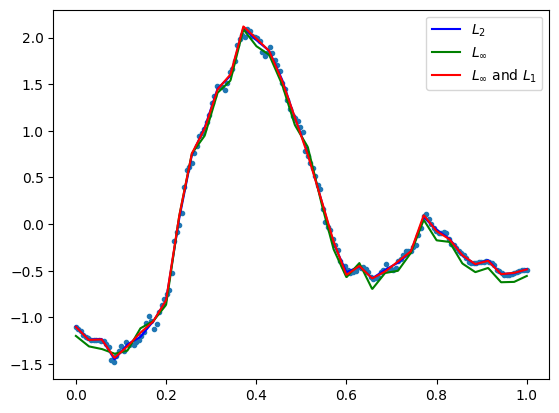

            max_dist       MSE      RMSE       MAE
LSQ         0.127240  0.000935  0.030570  0.021253
Max         0.087927  0.005054  0.071089  0.066142
Max and L1  0.087928  0.001183  0.034398  0.021657 

opt distance 0.08792727621195531
number of data points: 180


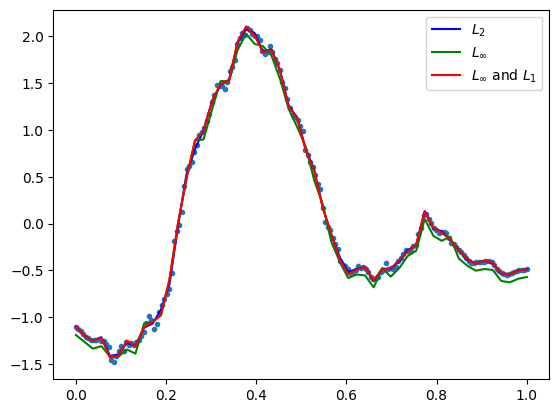

            max_dist       MSE      RMSE       MAE
LSQ         0.128764  0.000706  0.026577  0.017015
Max         0.084108  0.004958  0.070415  0.066548
Max and L1  0.084109  0.001128  0.033580  0.020138 

opt distance 0.08410828098270971
number of data points: 180


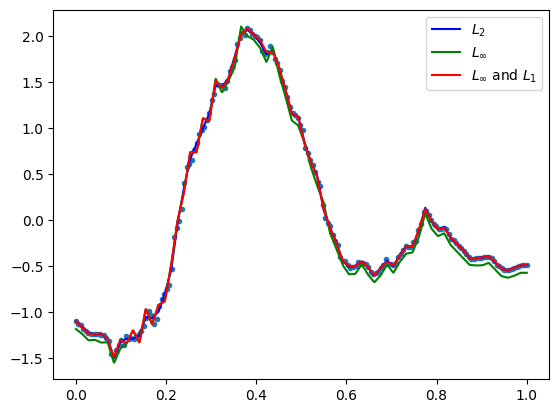

            max_dist       MSE      RMSE       MAE
LSQ         0.101730  0.000392  0.019800  0.012996
Max         0.065056  0.003225  0.056786  0.054517
Max and L1  0.065057  0.000598  0.024449  0.013550 

opt distance 0.06505580919276327
number of data points: 180


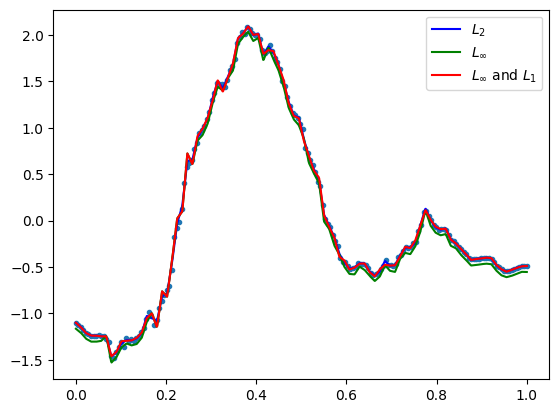

GestureMidAirD3 no. 127 len(ts): 168 ts processed: 61.06 %
[16, 33, 50, 67, 84]
            max_dist       MSE      RMSE       MAE
LSQ         0.101363  0.001053  0.032453  0.024242
Max         0.089130  0.003999  0.063239  0.057210
Max and L1  0.089131  0.001288  0.035883  0.026174 

opt distance 0.08912960064094562
number of data points: 168


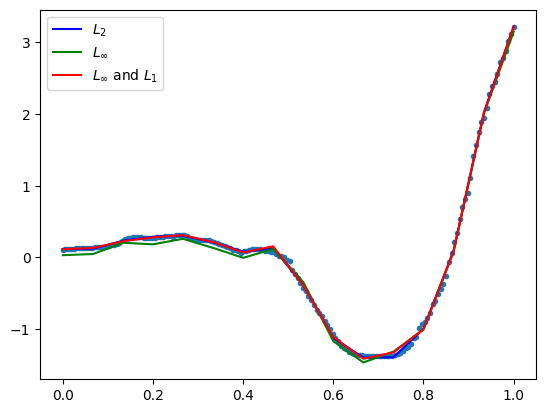

            max_dist       MSE      RMSE       MAE
LSQ         0.111711  0.000392  0.019796  0.011250
Max         0.085293  0.005144  0.071723  0.068365
Max and L1  0.085294  0.000518  0.022759  0.012093 

opt distance 0.085293198957078
number of data points: 168


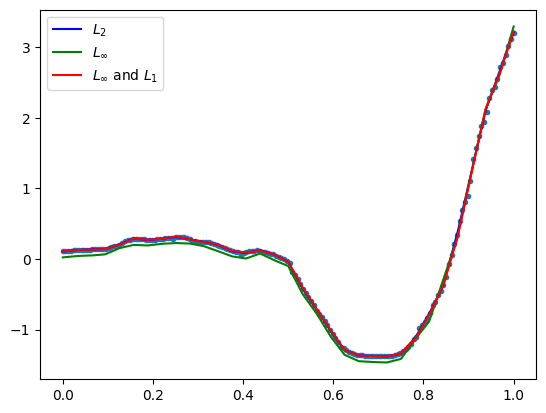

            max_dist       MSE      RMSE       MAE
LSQ         0.051721  0.000212  0.014566  0.008581
Max         0.045679  0.001501  0.038746  0.036700
Max and L1  0.045680  0.000227  0.015081  0.008234 

opt distance 0.04567873954158934
number of data points: 168


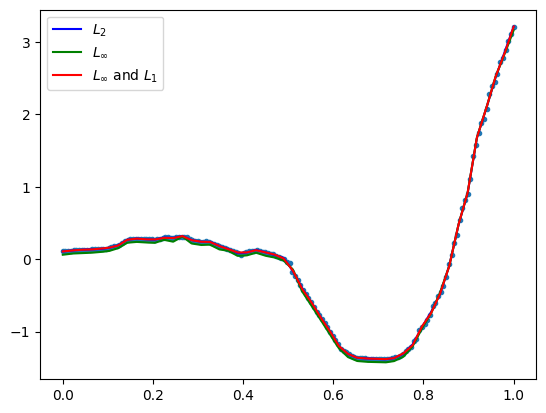

            max_dist       MSE      RMSE       MAE
LSQ         0.057663  0.000193  0.013875  0.007189
Max         0.050263  0.001995  0.044660  0.042988
Max and L1  0.050264  0.000313  0.017699  0.008870 

opt distance 0.05026300933312816
number of data points: 168


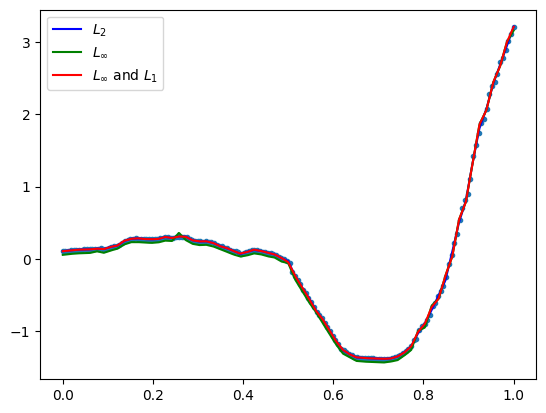

            max_dist       MSE      RMSE       MAE
LSQ         0.058491  0.000133  0.011528  0.005970
Max         0.044126  0.001649  0.040612  0.039649
Max and L1  0.044127  0.000186  0.013634  0.006298 

opt distance 0.04412596019714098
number of data points: 168


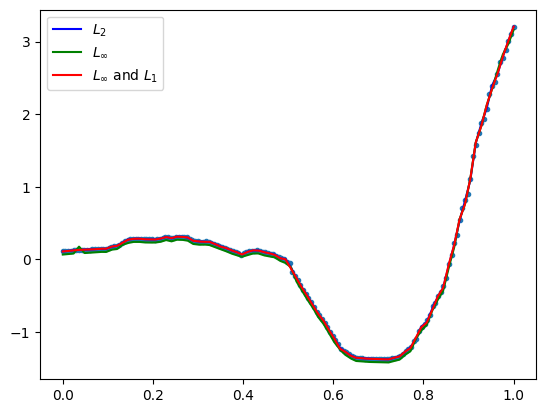

GestureMidAirD3 no. 128 len(ts): 180 ts processed: 61.53999999999999 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.233886  0.008395  0.091625  0.074110
Max         0.188378  0.014149  0.118949  0.103504
Max and L1  0.188379  0.009260  0.096228  0.076670 
opt distance 0.18837772530630148
number of data points: 180


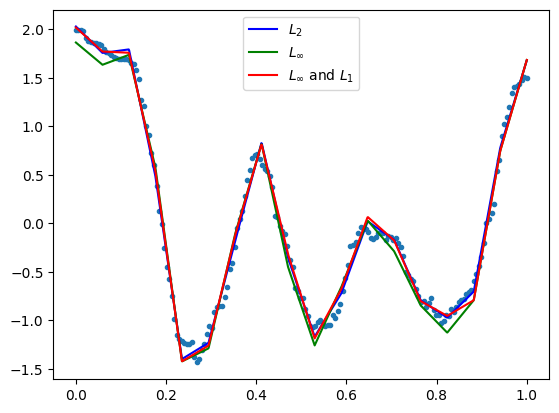

            max_dist       MSE      RMSE       MAE
LSQ         0.152645  0.002002  0.044746  0.033620
Max         0.113868  0.005891  0.076754  0.067415
Max and L1  0.113869  0.002819  0.053094  0.039036 

opt distance 0.11386808101493363
number of data points: 180


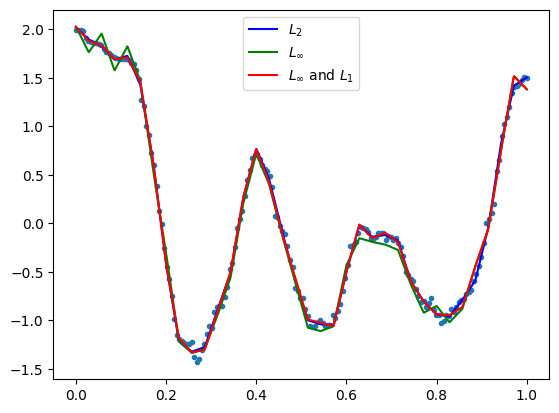

            max_dist       MSE      RMSE       MAE
LSQ         0.138645  0.001047  0.032362  0.024797
Max         0.082844  0.003843  0.061995  0.055174
Max and L1  0.082845  0.001320  0.036337  0.025186 

opt distance 0.08284376487195531
number of data points: 180


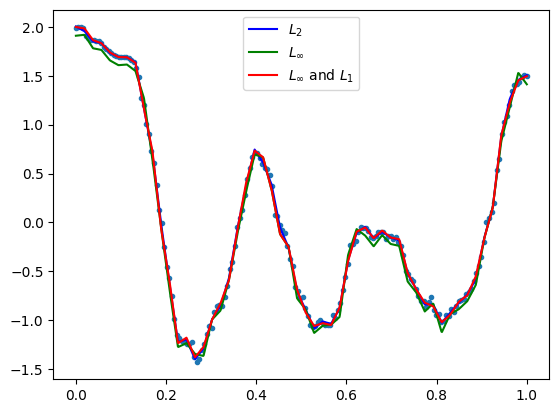

            max_dist       MSE      RMSE       MAE
LSQ         0.116629  0.000663  0.025758  0.018682
Max         0.073255  0.003298  0.057431  0.052092
Max and L1  0.073256  0.000966  0.031087  0.019888 

opt distance 0.07325547940520236
number of data points: 180


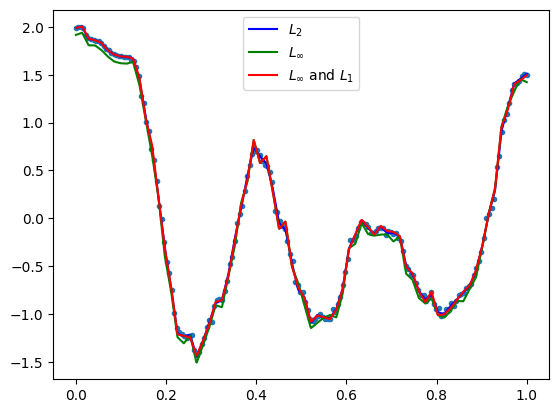

            max_dist       MSE      RMSE      MAE
LSQ         0.086654  0.000443  0.021051  0.01499
Max         0.064115  0.003022  0.054974  0.05197
Max and L1  0.064116  0.000744  0.027269  0.01685 

opt distance 0.06411494898343835
number of data points: 180


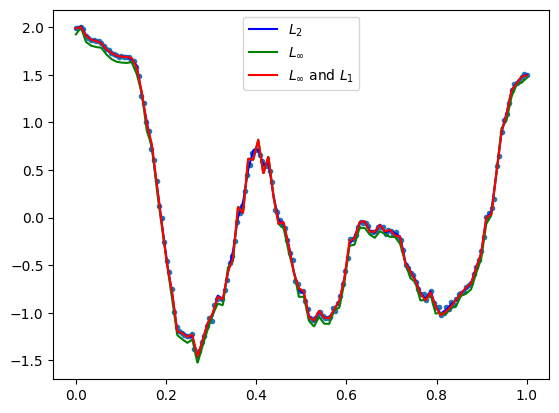

GestureMidAirD3 no. 129 len(ts): 120 ts processed: 62.019999999999996 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.124481  0.002162  0.046501  0.036035
Max         0.099213  0.003993  0.063191  0.055328
Max and L1  0.099214  0.002662  0.051591  0.040786 

opt distance 0.09921267760610536
number of data points: 120


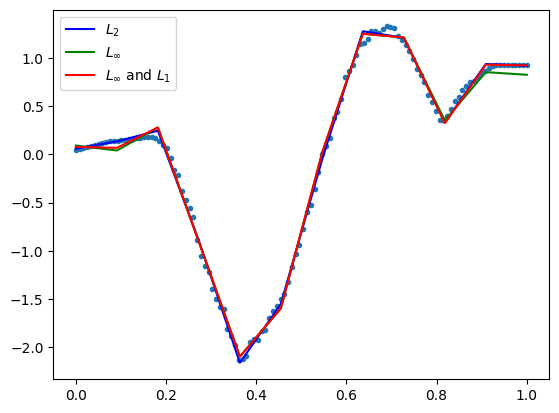

            max_dist       MSE      RMSE       MAE
LSQ         0.126230  0.001327  0.036429  0.024798
Max         0.098208  0.005623  0.074986  0.069220
Max and L1  0.098209  0.001571  0.039640  0.026363 

opt distance 0.09820802244145997
number of data points: 120


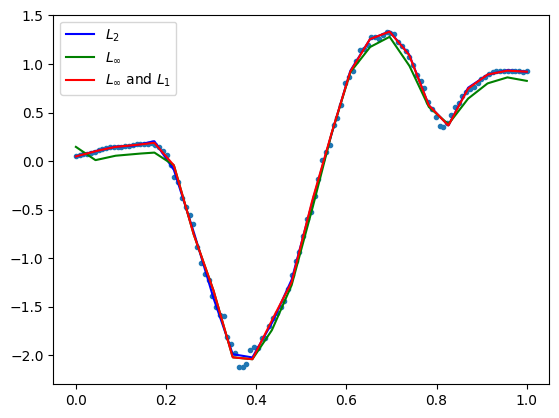

            max_dist       MSE      RMSE       MAE
LSQ         0.081112  0.000583  0.024149  0.016480
Max         0.065306  0.002476  0.049764  0.044637
Max and L1  0.065307  0.000709  0.026618  0.016940 

opt distance 0.06530619759377398
number of data points: 120


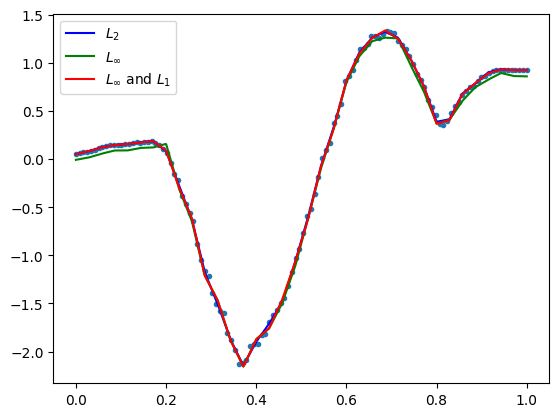

            max_dist       MSE      RMSE       MAE
LSQ         0.069401  0.000422  0.020540  0.014105
Max         0.048632  0.001498  0.038703  0.035324
Max and L1  0.048633  0.000499  0.022330  0.014112 

opt distance 0.04863214738139737
number of data points: 120


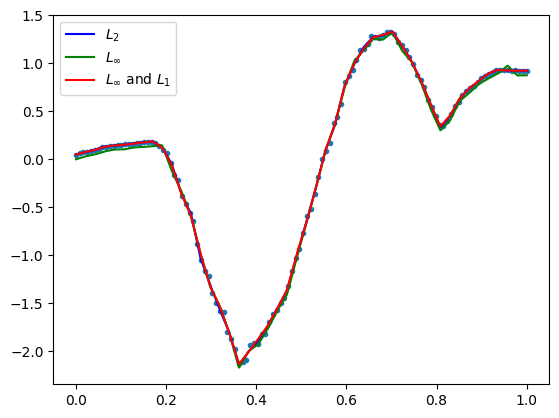

            max_dist       MSE      RMSE       MAE
LSQ         0.055213  0.000323  0.017961  0.012239
Max         0.045893  0.001516  0.038929  0.036221
Max and L1  0.045894  0.000442  0.021014  0.012449 

opt distance 0.04589284633681606
number of data points: 120


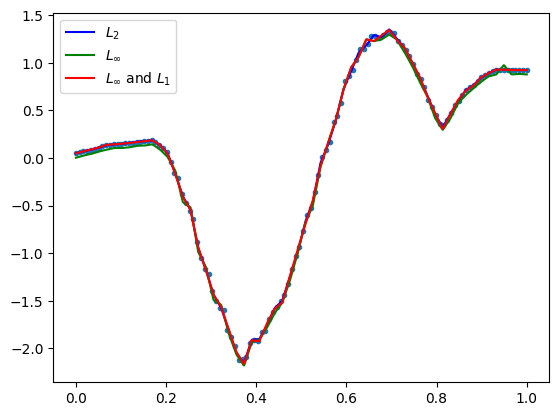

GestureMidAirD3 no. 130 len(ts): 90 ts processed: 62.5 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.360976  0.022212  0.149039  0.109629
Max         0.330490  0.041558  0.203858  0.178216
Max and L1  0.330491  0.022876  0.151249  0.111788 
opt distance 0.33049008473475994
number of data points: 90


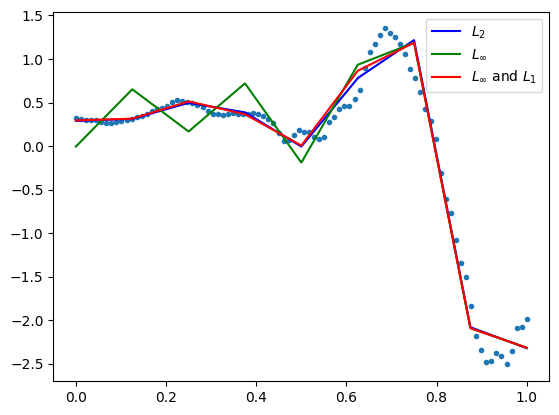

            max_dist       MSE      RMSE       MAE
LSQ         0.168059  0.003556  0.059635  0.041056
Max         0.146444  0.013207  0.114921  0.106062
Max and L1  0.146445  0.004240  0.065115  0.043694 

opt distance 0.1464437088493536
number of data points: 90


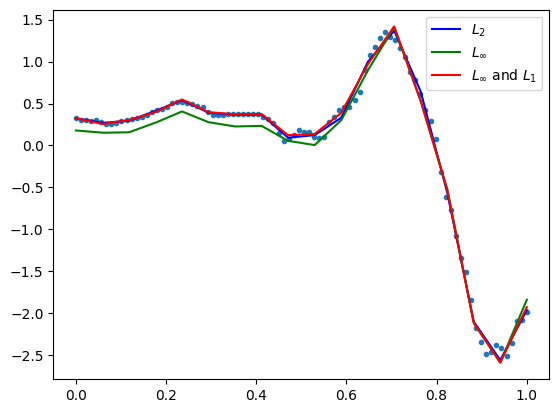

            max_dist       MSE      RMSE       MAE
LSQ         0.112150  0.001346  0.036690  0.022251
Max         0.098808  0.006686  0.081769  0.077155
Max and L1  0.098809  0.001668  0.040837  0.024227 

opt distance 0.0988079316810313
number of data points: 90


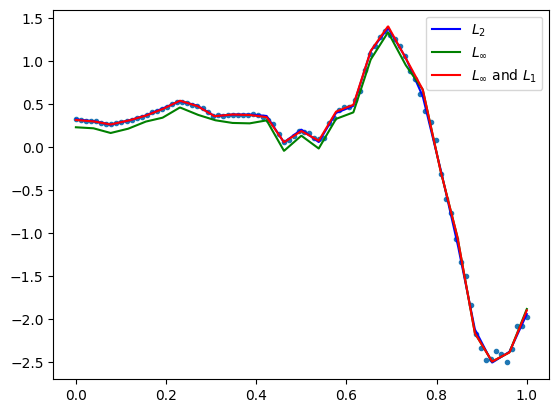

            max_dist       MSE      RMSE       MAE
LSQ         0.136702  0.000978  0.031272  0.019478
Max         0.100050  0.007198  0.084843  0.080653
Max and L1  0.100051  0.001494  0.038654  0.022438 

opt distance 0.100050002688961
number of data points: 90


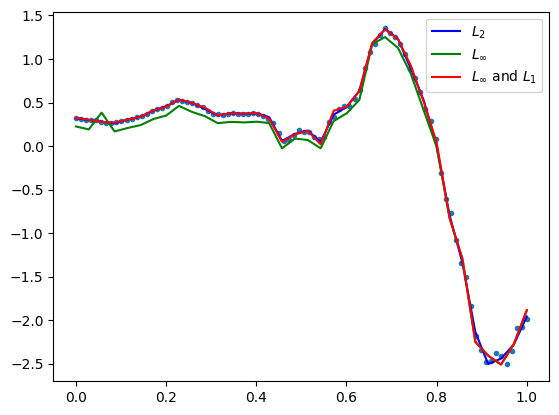

            max_dist       MSE      RMSE       MAE
LSQ         0.061879  0.000292  0.017097  0.011848
Max         0.042075  0.001272  0.035672  0.033389
Max and L1  0.042076  0.000401  0.020021  0.012559 

opt distance 0.04207483305535389
number of data points: 90


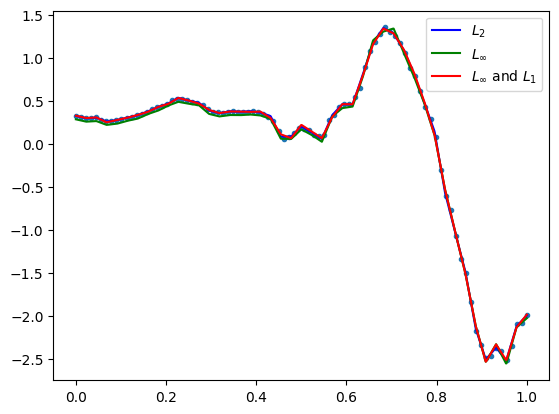

GestureMidAirD3 no. 131 len(ts): 89 ts processed: 62.980000000000004 %
[8, 17, 26, 35, 44]
            max_dist       MSE      RMSE       MAE
LSQ         0.080157  0.000645  0.025394  0.018528
Max         0.064809  0.001461  0.038227  0.033500
Max and L1  0.064810  0.000890  0.029839  0.021542 

opt distance 0.06480941101210216
number of data points: 89


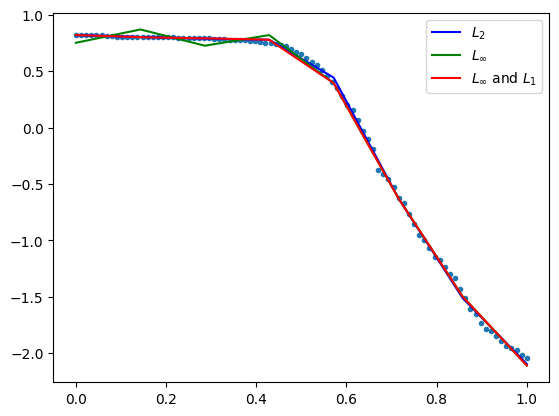

            max_dist       MSE      RMSE       MAE
LSQ         0.074557  0.000228  0.015089  0.008666
Max         0.045850  0.001402  0.037446  0.034908
Max and L1  0.045851  0.000348  0.018650  0.011187 

opt distance 0.04585017212044623
number of data points: 89


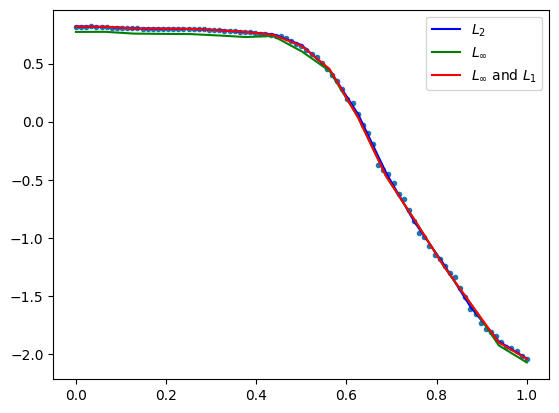

            max_dist       MSE      RMSE       MAE
LSQ         0.051846  0.000099  0.009927  0.005831
Max         0.035393  0.000858  0.029299  0.026956
Max and L1  0.035394  0.000117  0.010797  0.005876 

opt distance 0.03539254219321397
number of data points: 89


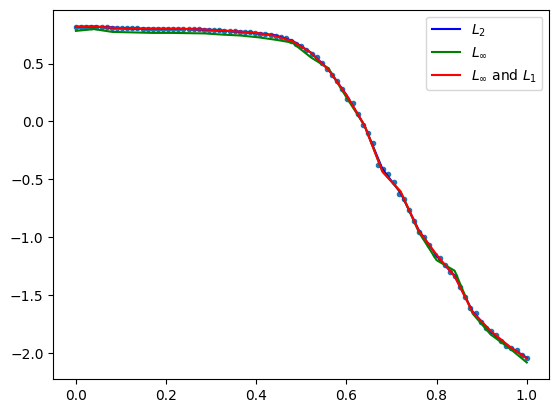

            max_dist       MSE      RMSE       MAE
LSQ         0.035631  0.000078  0.008850  0.005151
Max         0.024403  0.000460  0.021456  0.020308
Max and L1  0.024404  0.000100  0.009977  0.005604 

opt distance 0.024403478433860478
number of data points: 89


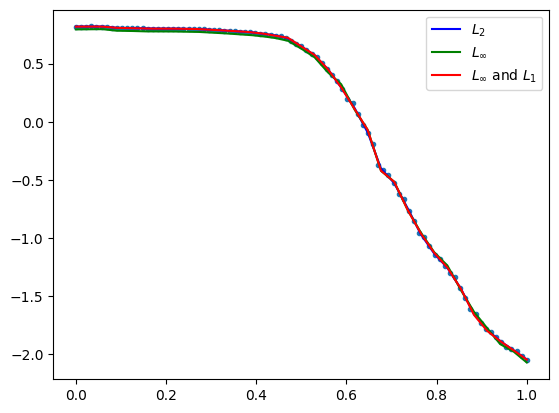

            max_dist       MSE      RMSE       MAE
LSQ         0.023654  0.000055  0.007386  0.004180
Max         0.018326  0.000267  0.016351  0.015573
Max and L1  0.018327  0.000068  0.008250  0.004564 

opt distance 0.018325727856397796
number of data points: 89


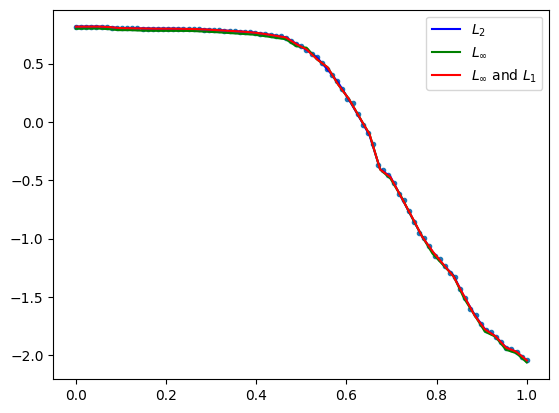

GestureMidAirD3 no. 132 len(ts): 180 ts processed: 63.46000000000001 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.080711  0.000616  0.024828  0.019806
Max         0.064853  0.001793  0.042348  0.036982
Max and L1  0.064854  0.000685  0.026170  0.019012 
opt distance 0.06485316571854449
number of data points: 180


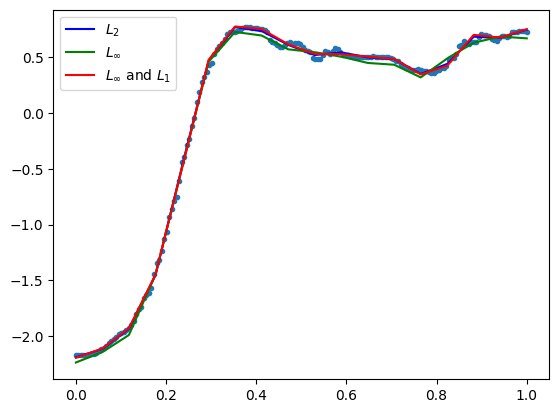

            max_dist       MSE      RMSE       MAE
LSQ         0.060367  0.000232  0.015231  0.011125
Max         0.053517  0.001676  0.040941  0.037585
Max and L1  0.053518  0.000299  0.017292  0.011040 

opt distance 0.05351669121671276
number of data points: 180


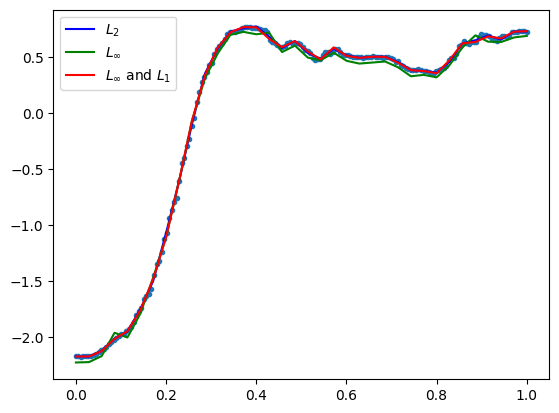

            max_dist       MSE      RMSE       MAE
LSQ         0.060625  0.000150  0.012262  0.007957
Max         0.044948  0.001347  0.036708  0.034127
Max and L1  0.044949  0.000261  0.016161  0.009606 

opt distance 0.044948199220606666
number of data points: 180


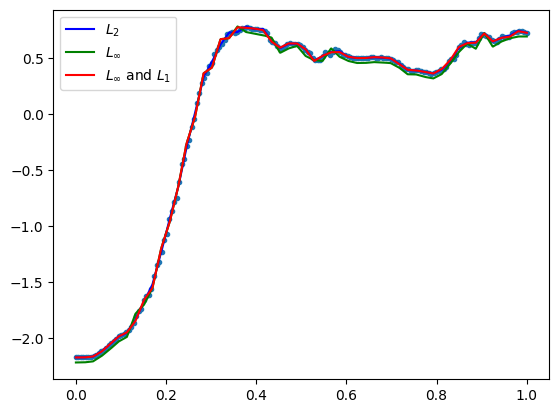

            max_dist       MSE      RMSE       MAE
LSQ         0.042476  0.000088  0.009404  0.005949
Max         0.035484  0.000922  0.030371  0.028981
Max and L1  0.035485  0.000138  0.011757  0.006319 

opt distance 0.035483775506390335
number of data points: 180


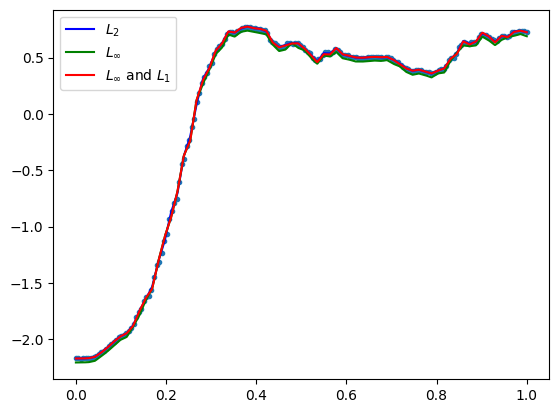

            max_dist       MSE      RMSE       MAE
LSQ         0.027851  0.000056  0.007470  0.004954
Max         0.020976  0.000337  0.018355  0.017619
Max and L1  0.020977  0.000066  0.008155  0.004589 

opt distance 0.02097618712013529
number of data points: 180


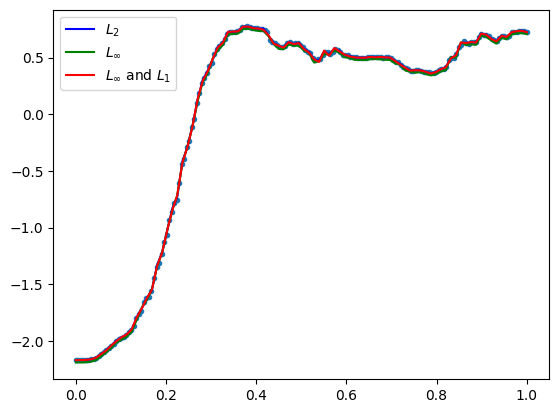

GestureMidAirD3 no. 133 len(ts): 227 ts processed: 63.94 %
[22, 45, 68, 90, 113]
            max_dist       MSE      RMSE       MAE
LSQ         0.280803  0.007425  0.086168  0.051966
Max         0.243519  0.038774  0.196912  0.181322
Max and L1  0.243520  0.009251  0.096182  0.059504 
opt distance 0.24351900473387478
number of data points: 227


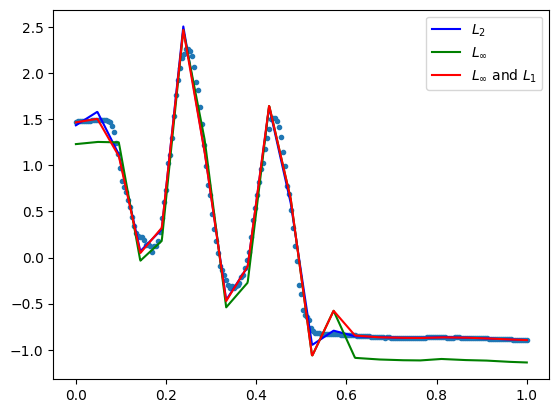

            max_dist       MSE      RMSE       MAE
LSQ         0.087730  0.000461  0.021471  0.012097
Max         0.062397  0.002690  0.051867  0.048406
Max and L1  0.062398  0.000594  0.024376  0.014099 

opt distance 0.062397038450871745
number of data points: 227


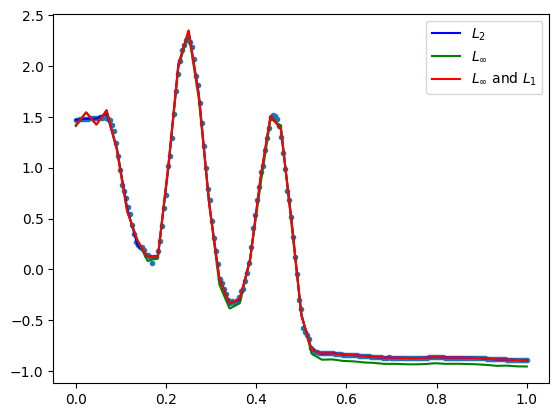

            max_dist       MSE      RMSE       MAE
LSQ         0.080832  0.000240  0.015481  0.008486
Max         0.052225  0.002091  0.045722  0.043399
Max and L1  0.052226  0.000317  0.017814  0.009162 

opt distance 0.05222477875173759
number of data points: 227


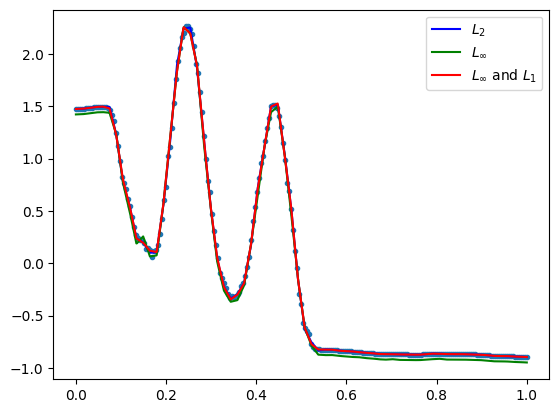

            max_dist       MSE      RMSE       MAE
LSQ         0.054185  0.000135  0.011630  0.006033
Max         0.045907  0.001741  0.041725  0.040223
Max and L1  0.045908  0.000189  0.013747  0.006256 

opt distance 0.04590697295047709
number of data points: 227


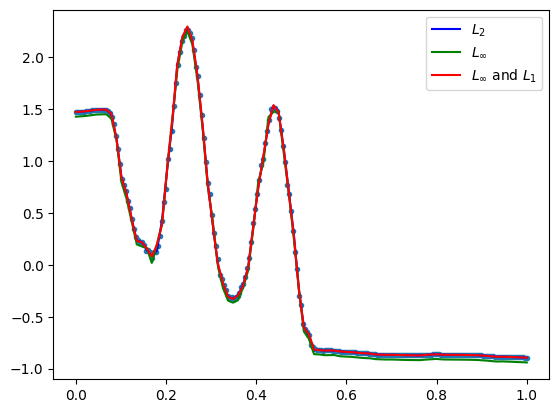

            max_dist       MSE      RMSE       MAE
LSQ         0.049068  0.000133  0.011528  0.005915
Max         0.040165  0.001387  0.037238  0.036255
Max and L1  0.040166  0.000155  0.012443  0.005481 

opt distance 0.0401646709503808
number of data points: 227


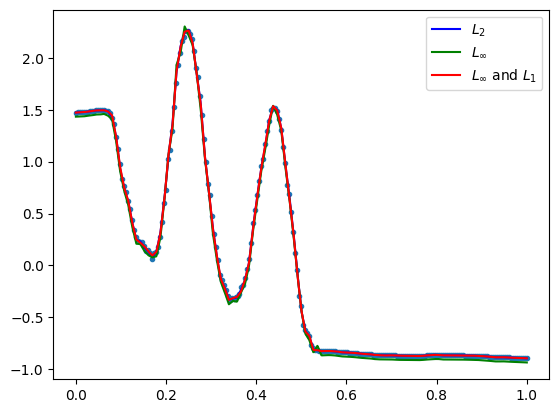

GestureMidAirD3 no. 134 len(ts): 240 ts processed: 64.42 %
[24, 48, 72, 96, 120]
            max_dist       MSE     RMSE       MAE
LSQ         0.113741  0.000776  0.02785  0.019294
Max         0.091165  0.004372  0.06612  0.060138
Max and L1  0.091166  0.000856  0.02926  0.019507 
opt distance 0.09116522193841275
number of data points: 240


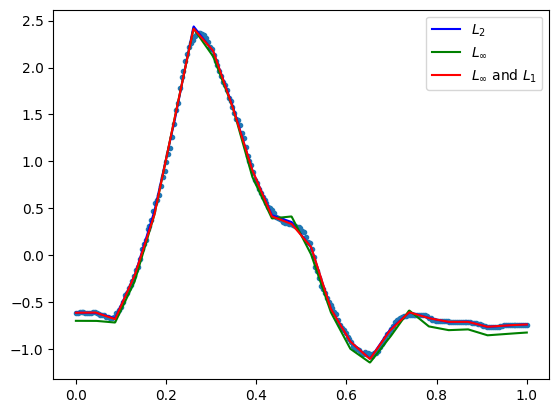

            max_dist       MSE      RMSE       MAE
LSQ         0.039871  0.000126  0.011239  0.007769
Max         0.034192  0.000660  0.025690  0.023140
Max and L1  0.034193  0.000152  0.012326  0.007890 

opt distance 0.034191555810597116
number of data points: 240


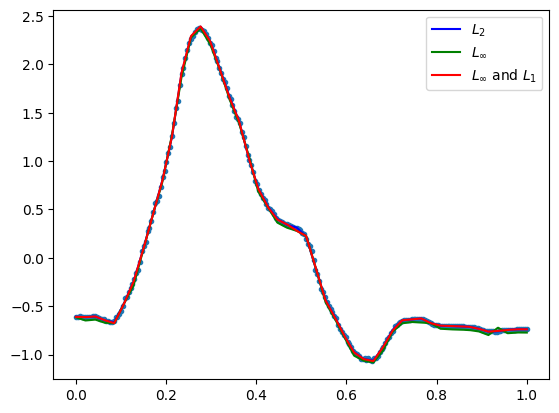

            max_dist       MSE      RMSE       MAE
LSQ         0.034242  0.000081  0.008986  0.005859
Max         0.026401  0.000466  0.021581  0.020157
Max and L1  0.026402  0.000090  0.009504  0.005591 

opt distance 0.026401237919740028
number of data points: 240


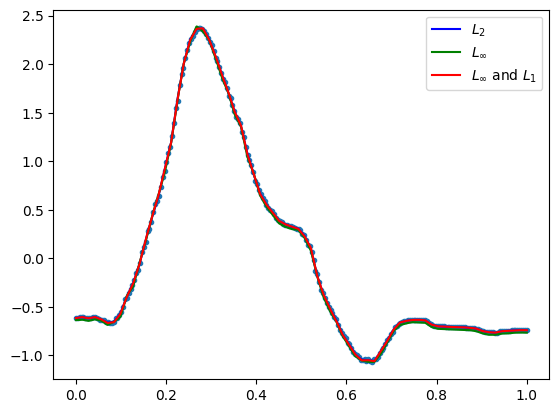

            max_dist       MSE      RMSE       MAE
LSQ         0.030758  0.000074  0.008624  0.005654
Max         0.023588  0.000381  0.019519  0.018157
Max and L1  0.023589  0.000087  0.009313  0.005409 

opt distance 0.023588013405324047
number of data points: 240


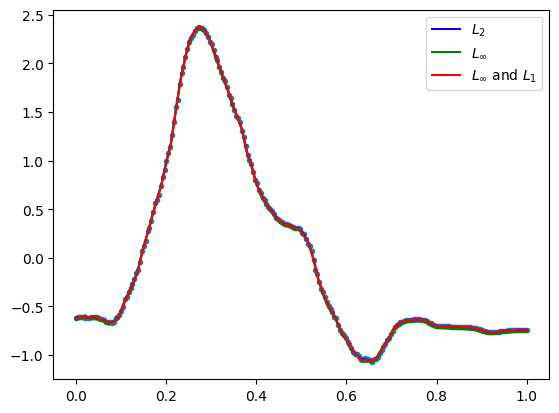

            max_dist       MSE      RMSE       MAE
LSQ         0.025931  0.000049  0.007032  0.004580
Max         0.020305  0.000310  0.017613  0.016506
Max and L1  0.020306  0.000062  0.007878  0.004312 

opt distance 0.0203049627112694
number of data points: 240


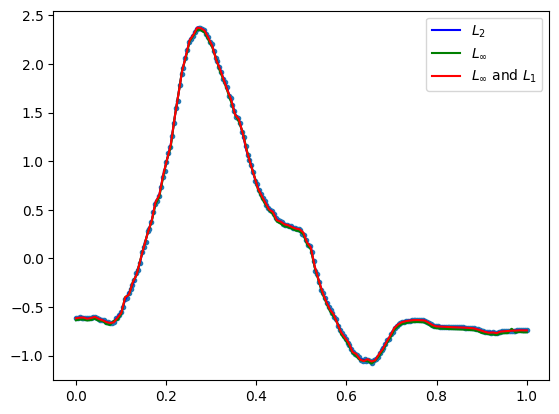

GestureMidAirD3 no. 135 len(ts): 134 ts processed: 64.9 %
[13, 26, 40, 53, 67]
            max_dist       MSE      RMSE       MAE
LSQ         0.112880  0.000760  0.027566  0.019620
Max         0.077800  0.002702  0.051985  0.046641
Max and L1  0.077801  0.001021  0.031957  0.022376 

opt distance 0.07780029924143217
number of data points: 134


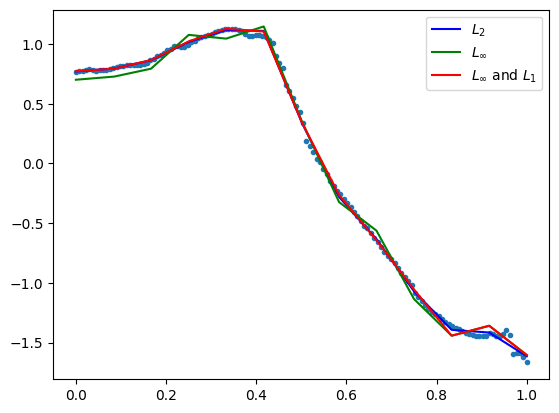

            max_dist       MSE      RMSE       MAE
LSQ         0.086575  0.000230  0.015176  0.009651
Max         0.060656  0.002439  0.049385  0.047382
Max and L1  0.060657  0.000419  0.020460  0.012277 
opt distance 0.06065594125403119
number of data points: 134


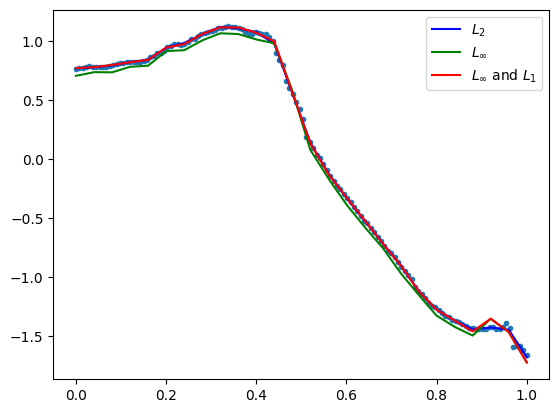

            max_dist       MSE      RMSE       MAE
LSQ         0.055342  0.000146  0.012092  0.006978
Max         0.047001  0.001559  0.039487  0.037783
Max and L1  0.047002  0.000193  0.013887  0.007402 

opt distance 0.04700123058567044
number of data points: 134


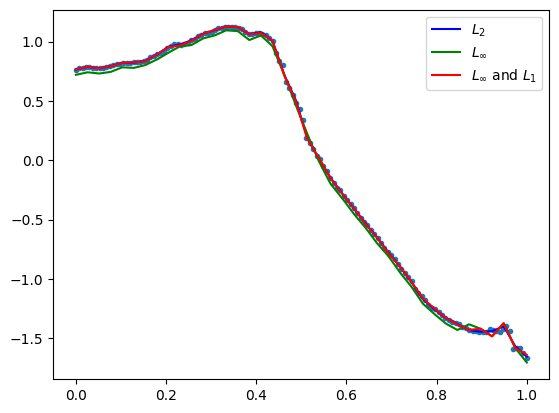

            max_dist       MSE      RMSE       MAE
LSQ         0.076412  0.000131  0.011456  0.005937
Max         0.048244  0.001774  0.042117  0.040630
Max and L1  0.048245  0.000210  0.014503  0.006898 

opt distance 0.04824415952326505
number of data points: 134


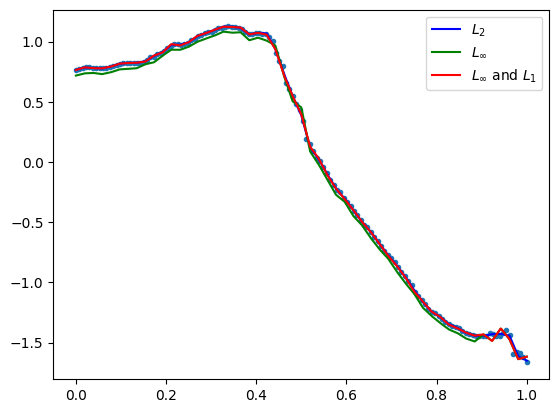

            max_dist       MSE      RMSE       MAE
LSQ         0.040589  0.000051  0.007153  0.004110
Max         0.028449  0.000664  0.025772  0.025154
Max and L1  0.028450  0.000071  0.008403  0.004186 

opt distance 0.028448870560104367
number of data points: 134


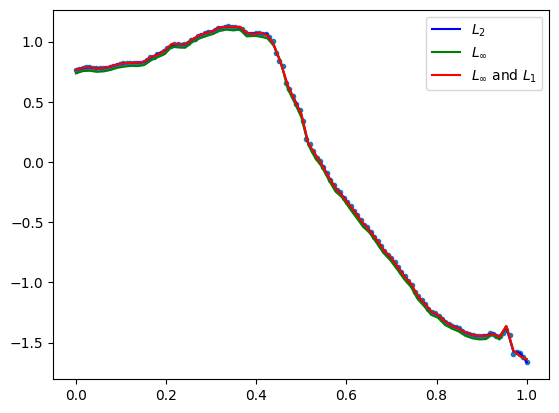

GestureMidAirD3 no. 136 len(ts): 115 ts processed: 65.38000000000001 %
[11, 23, 34, 46, 57]
            max_dist       MSE      RMSE       MAE
LSQ         0.213554  0.003922  0.062623  0.048080
Max         0.161516  0.011151  0.105599  0.092165
Max and L1  0.161517  0.007538  0.086824  0.070734 

opt distance 0.16151645755037514
number of data points: 115


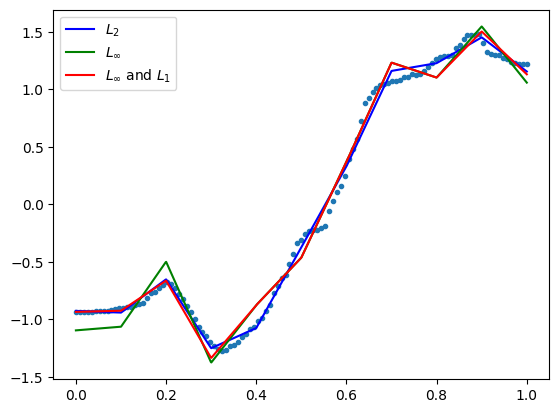

            max_dist       MSE      RMSE       MAE
LSQ         0.069946  0.000414  0.020350  0.014610
Max         0.052713  0.001493  0.038636  0.034953
Max and L1  0.052714  0.000604  0.024568  0.017640 

opt distance 0.052713087507830436
number of data points: 115


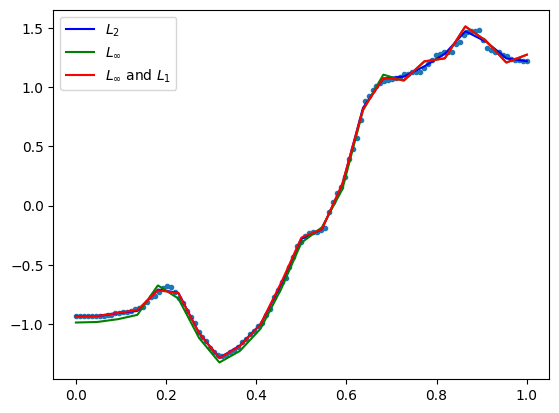

            max_dist       MSE      RMSE       MAE
LSQ         0.049865  0.000196  0.014005  0.009623
Max         0.037942  0.000856  0.029253  0.026593
Max and L1  0.037943  0.000263  0.016203  0.010523 

opt distance 0.03794185804745551
number of data points: 115


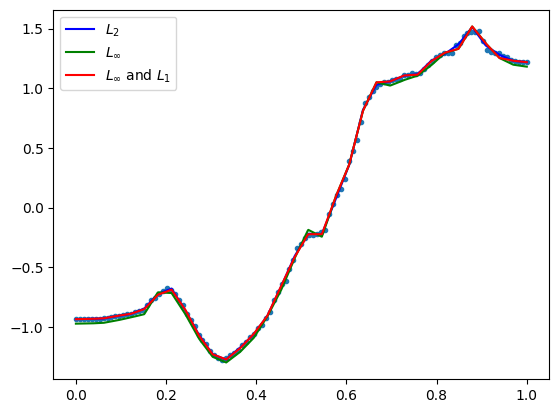

            max_dist       MSE      RMSE       MAE
LSQ         0.031912  0.000091  0.009516  0.006727
Max         0.026435  0.000454  0.021316  0.019440
Max and L1  0.026436  0.000116  0.010792  0.006763 

opt distance 0.026434944858054865
number of data points: 115


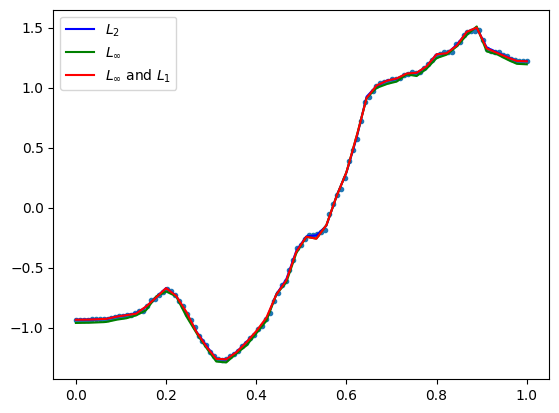

            max_dist       MSE      RMSE       MAE
LSQ         0.022432  0.000046  0.006788  0.004986
Max         0.017044  0.000208  0.014406  0.013556
Max and L1  0.017045  0.000057  0.007552  0.004532 

opt distance 0.017043942004582202
number of data points: 115


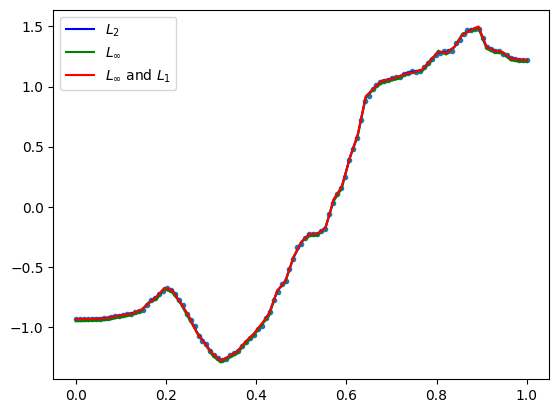

GestureMidAirD3 no. 137 len(ts): 239 ts processed: 65.86999999999999 %
[23, 47, 71, 95, 119]
            max_dist       MSE      RMSE       MAE
LSQ         0.340471  0.008439  0.091864  0.065404
Max         0.283850  0.044791  0.211638  0.198929
Max and L1  0.283851  0.009923  0.099614  0.068317 

opt distance 0.2838498164855722
number of data points: 239


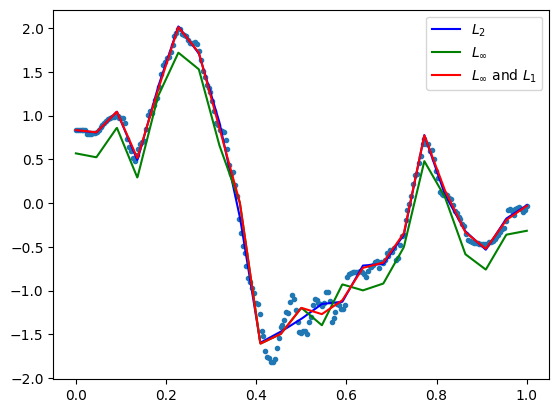

            max_dist       MSE      RMSE       MAE
LSQ         0.159009  0.002013  0.044870  0.033892
Max         0.136785  0.010761  0.103737  0.096456
Max and L1  0.136786  0.002310  0.048058  0.032938 

opt distance 0.13678493620144808
number of data points: 239


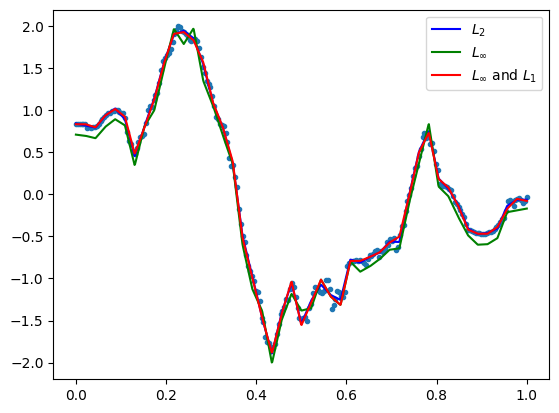

            max_dist       MSE      RMSE       MAE
LSQ         0.136735  0.001203  0.034685  0.024772
Max         0.117678  0.008781  0.093706  0.087499
Max and L1  0.117679  0.001530  0.039121  0.024464 

opt distance 0.11767789178351806
number of data points: 239


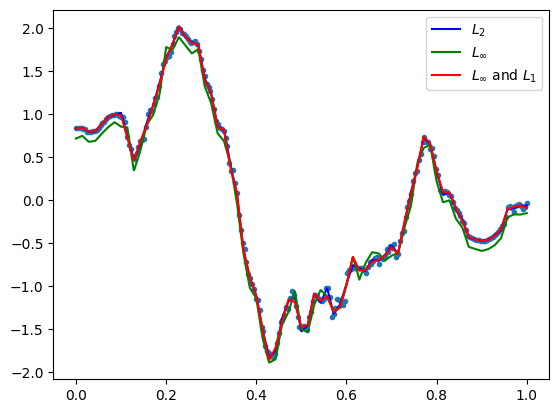

            max_dist       MSE      RMSE       MAE
LSQ         0.132633  0.000719  0.026815  0.019213
Max         0.090424  0.005459  0.073887  0.068222
Max and L1  0.090425  0.001039  0.032229  0.018762 

opt distance 0.09042357439132749
number of data points: 239


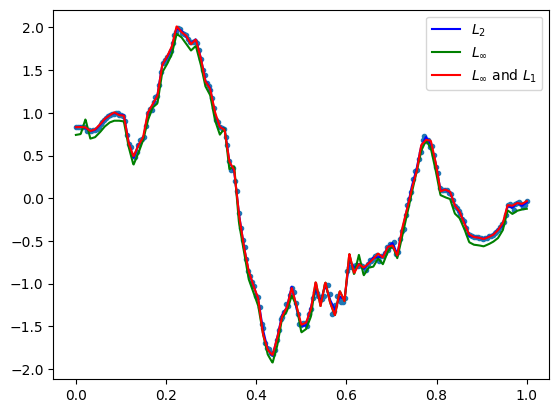

            max_dist       MSE      RMSE       MAE
LSQ         0.068853  0.000384  0.019601  0.014318
Max         0.052299  0.001932  0.043959  0.041168
Max and L1  0.052300  0.000486  0.022043  0.013249 

opt distance 0.05229853783337679
number of data points: 239


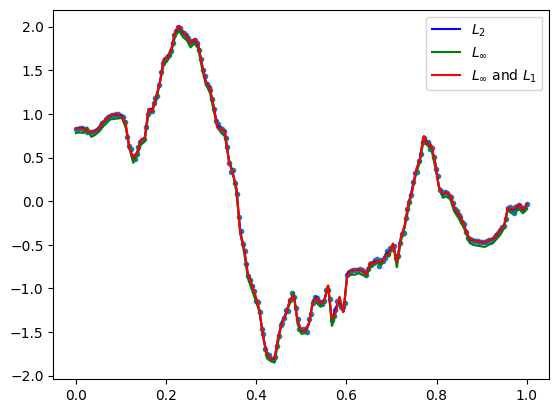

GestureMidAirD3 no. 138 len(ts): 113 ts processed: 66.35 %
[11, 22, 33, 45, 56]
            max_dist       MSE      RMSE       MAE
LSQ         0.079421  0.000838  0.028950  0.023139
Max         0.060785  0.001389  0.037270  0.031849
Max and L1  0.060786  0.001124  0.033527  0.027043 

opt distance 0.06078502914523254
number of data points: 113


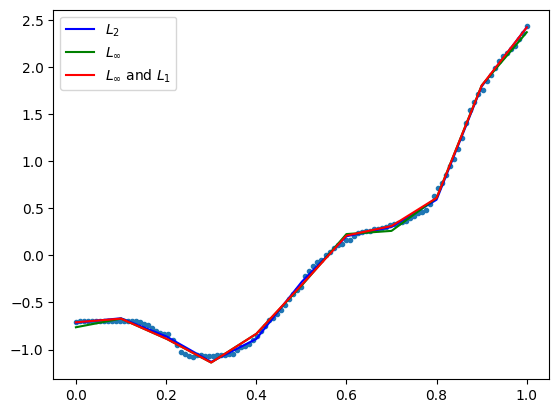

            max_dist       MSE      RMSE       MAE
LSQ         0.058935  0.000260  0.016127  0.010742
Max         0.047468  0.001381  0.037163  0.034226
Max and L1  0.047469  0.000285  0.016883  0.010420 

opt distance 0.047468153493654686
number of data points: 113


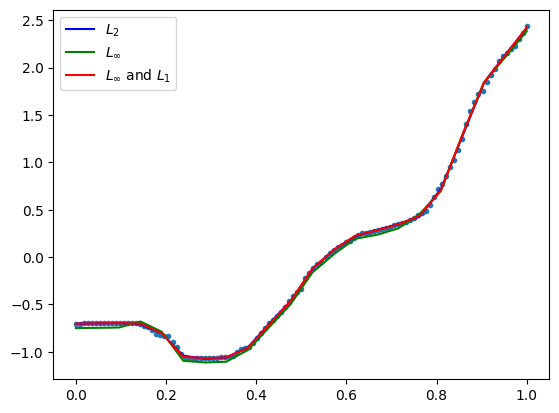

            max_dist       MSE      RMSE       MAE
LSQ         0.036696  0.000097  0.009856  0.006860
Max         0.028774  0.000525  0.022905  0.021057
Max and L1  0.028775  0.000119  0.010911  0.006977 

opt distance 0.028774062756928735
number of data points: 113


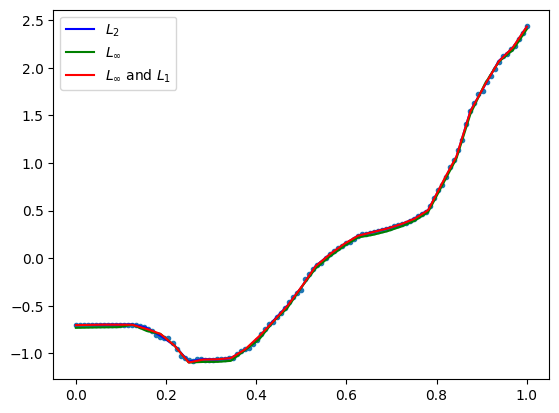

            max_dist       MSE      RMSE       MAE
LSQ         0.026088  0.000052  0.007195  0.004814
Max         0.019981  0.000282  0.016801  0.015711
Max and L1  0.019982  0.000068  0.008266  0.004850 

opt distance 0.019980569837826534
number of data points: 113


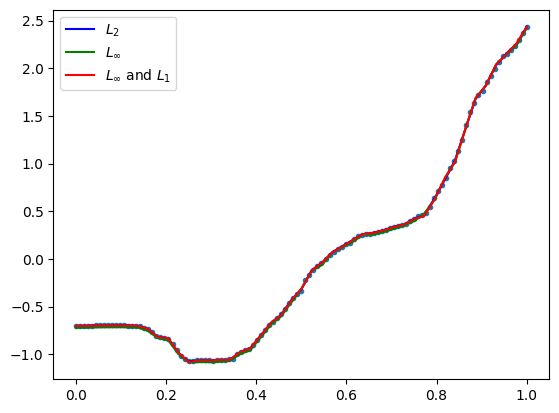

            max_dist       MSE      RMSE       MAE
LSQ         0.030105  0.000030  0.005505  0.003461
Max         0.020482  0.000313  0.017686  0.016794
Max and L1  0.020483  0.000041  0.006370  0.003292 

opt distance 0.02048150221916406
number of data points: 113


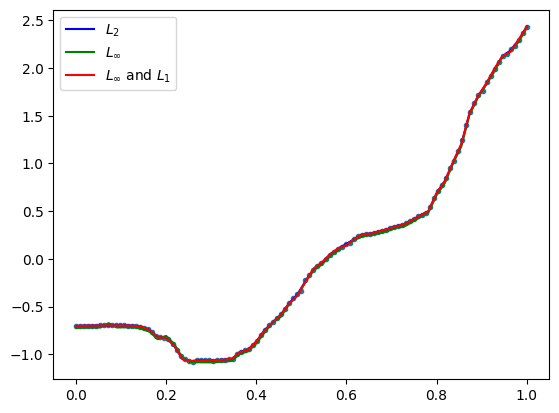

GestureMidAirD3 no. 139 len(ts): 358 ts processed: 66.83 %
[35, 71, 107, 143, 179]
            max_dist       MSE      RMSE       MAE
LSQ         0.074063  0.000461  0.021472  0.015276
Max         0.058489  0.001643  0.040533  0.036148
Max and L1  0.058490  0.000580  0.024080  0.017235 

opt distance 0.058488691143468365
number of data points: 358


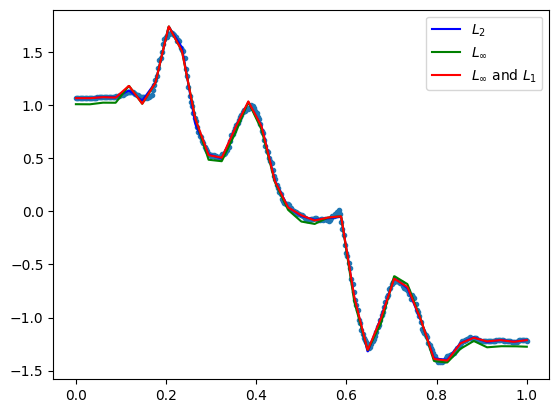

            max_dist       MSE      RMSE       MAE
LSQ         0.042587  0.000107  0.010357  0.006820
Max         0.035291  0.000761  0.027593  0.025493
Max and L1  0.035292  0.000138  0.011761  0.007150 

opt distance 0.03529063765018059
number of data points: 358


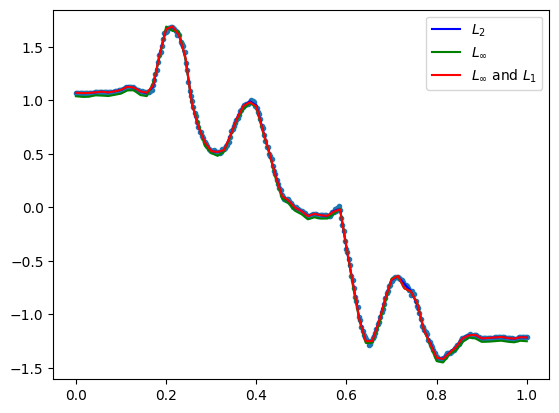

            max_dist       MSE      RMSE       MAE
LSQ         0.037779  0.000061  0.007838  0.005098
Max         0.026688  0.000463  0.021514  0.019980
Max and L1  0.026689  0.000074  0.008578  0.004959 
opt distance 0.02668776795243441
number of data points: 358


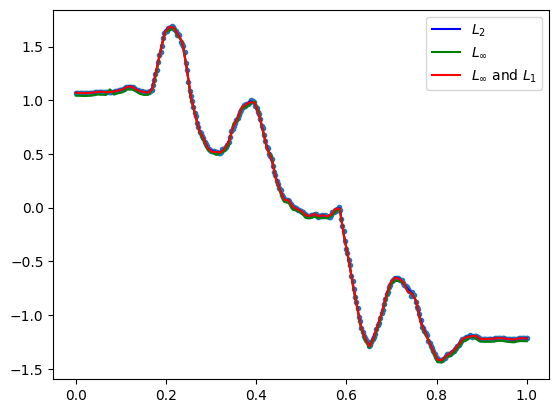

            max_dist       MSE      RMSE       MAE
LSQ         0.032963  0.000039  0.006253  0.003997
Max         0.021925  0.000351  0.018745  0.017745
Max and L1  0.021926  0.000049  0.006966  0.003770 
opt distance 0.021924729996924953
number of data points: 358


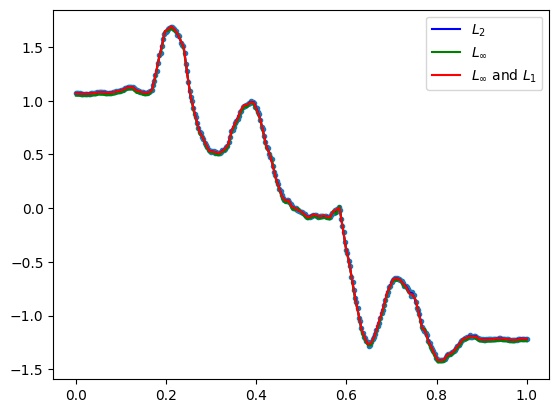

            max_dist       MSE      RMSE       MAE
LSQ         0.022556  0.000030  0.005497  0.003470
Max         0.017807  0.000244  0.015636  0.014933
Max and L1  0.017808  0.000039  0.006261  0.003308 
opt distance 0.017807350616334112
number of data points: 358


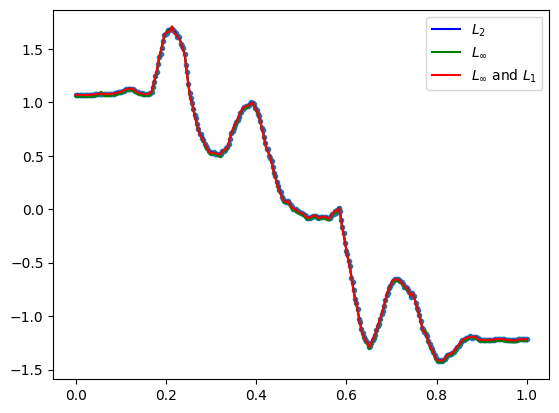

GestureMidAirD3 no. 140 len(ts): 168 ts processed: 67.31 %
[16, 33, 50, 67, 84]
            max_dist       MSE      RMSE       MAE
LSQ         0.191374  0.003051  0.055237  0.035070
Max         0.162929  0.014148  0.118944  0.107552
Max and L1  0.162930  0.005318  0.072927  0.050691 

opt distance 0.16292920429308594
number of data points: 168


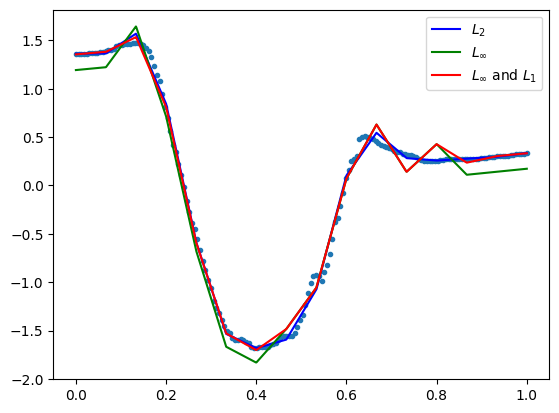

            max_dist       MSE      RMSE       MAE
LSQ         0.124939  0.000530  0.023013  0.013079
Max         0.088983  0.005508  0.074219  0.070183
Max and L1  0.088984  0.000809  0.028440  0.015219 

opt distance 0.08898250255461732
number of data points: 168


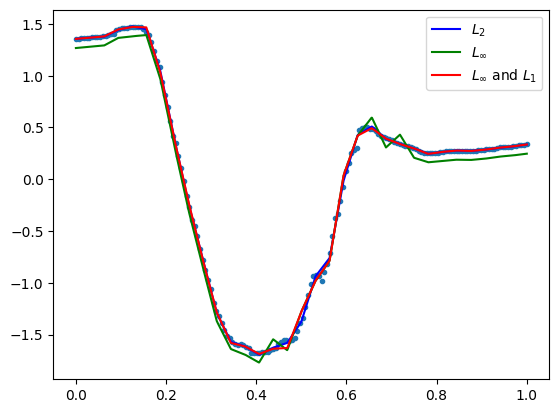

            max_dist       MSE      RMSE       MAE
LSQ         0.071306  0.000197  0.014036  0.008096
Max         0.049464  0.001823  0.042702  0.040777
Max and L1  0.049465  0.000240  0.015478  0.008109 

opt distance 0.049463732446732855
number of data points: 168


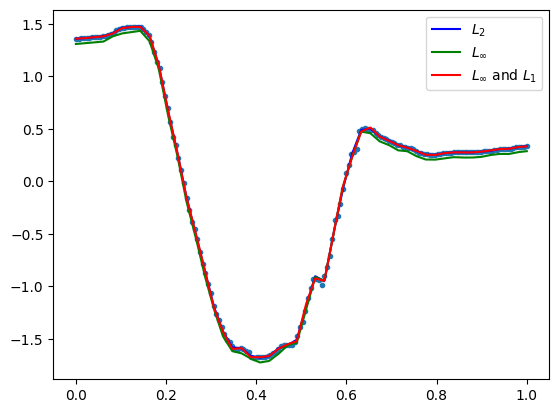

            max_dist       MSE      RMSE       MAE
LSQ         0.053145  0.000092  0.009601  0.005735
Max         0.037280  0.001049  0.032387  0.030857
Max and L1  0.037281  0.000118  0.010873  0.005493 

opt distance 0.03728004310917771
number of data points: 168


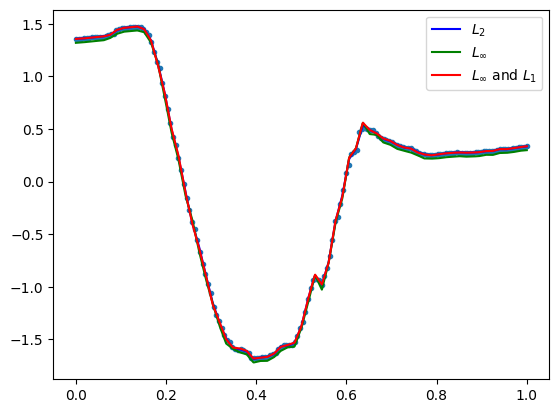

            max_dist       MSE      RMSE       MAE
LSQ         0.054227  0.000096  0.009816  0.004864
Max         0.041590  0.001388  0.037255  0.035821
Max and L1  0.041591  0.000177  0.013287  0.006248 

opt distance 0.041589766267811516
number of data points: 168


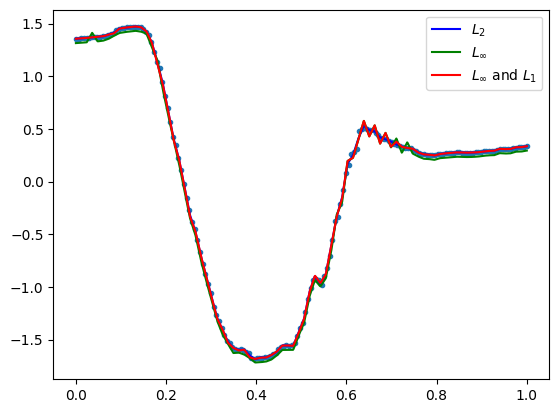

GestureMidAirD3 no. 141 len(ts): 180 ts processed: 67.78999999999999 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.047940  0.000223  0.014931  0.011137
Max         0.034800  0.000551  0.023480  0.020361
Max and L1  0.034801  0.000249  0.015768  0.011538 

opt distance 0.03479976145246355
number of data points: 180


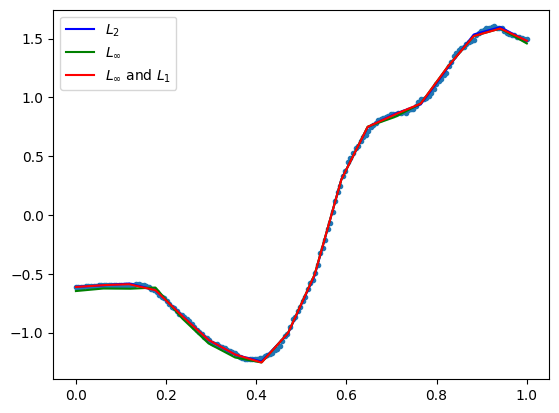

            max_dist       MSE      RMSE       MAE
LSQ         0.034059  0.000062  0.007863  0.005275
Max         0.022910  0.000283  0.016819  0.015356
Max and L1  0.022911  0.000071  0.008455  0.005420 

opt distance 0.02291008913700958
number of data points: 180


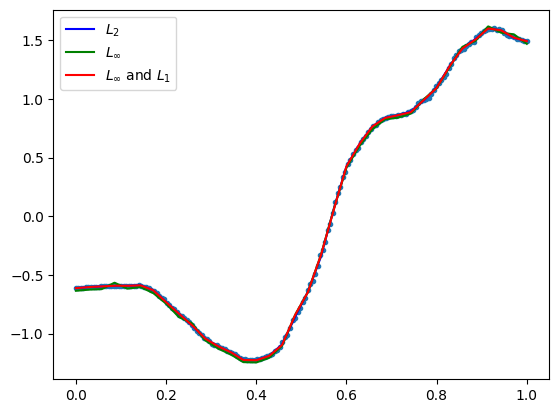

            max_dist       MSE      RMSE       MAE
LSQ         0.022483  0.000038  0.006142  0.004168
Max         0.015932  0.000155  0.012435  0.011507
Max and L1  0.015933  0.000046  0.006762  0.004395 

opt distance 0.015932149969101927
number of data points: 180


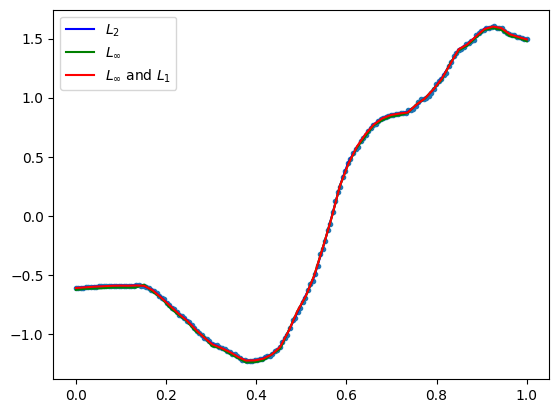

            max_dist       MSE      RMSE       MAE
LSQ         0.024316  0.000026  0.005122  0.003428
Max         0.015374  0.000168  0.012959  0.012115
Max and L1  0.015375  0.000032  0.005632  0.003324 

opt distance 0.015373769421007509
number of data points: 180


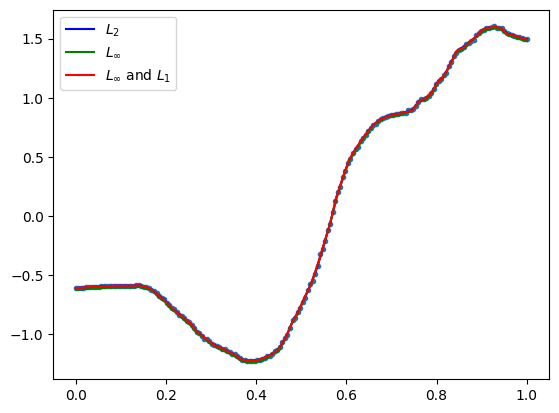

            max_dist       MSE      RMSE       MAE
LSQ         0.017970  0.000020  0.004441  0.002994
Max         0.013131  0.000128  0.011327  0.010724
Max and L1  0.013132  0.000024  0.004946  0.002794 

opt distance 0.013131312957323081
number of data points: 180


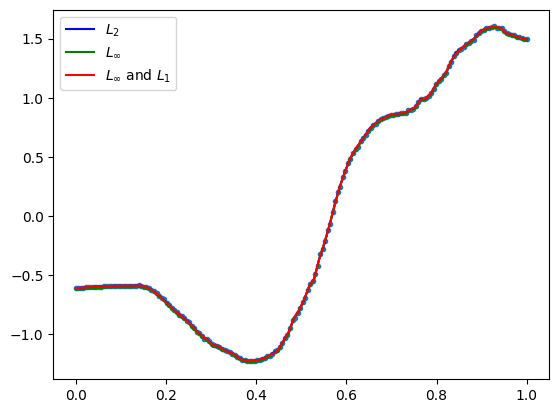

GestureMidAirD3 no. 142 len(ts): 169 ts processed: 68.27 %
[16, 33, 50, 67, 84]
            max_dist       MSE      RMSE       MAE
LSQ         0.318028  0.009534  0.097642  0.059434
Max         0.276561  0.038555  0.196354  0.171944
Max and L1  0.276562  0.010910  0.104452  0.060571 

opt distance 0.2765605336778282
number of data points: 169


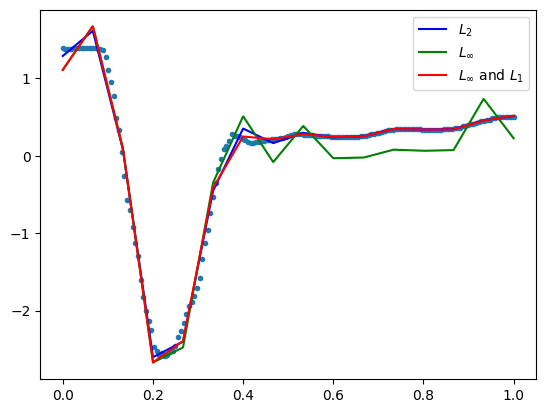

            max_dist      MSE      RMSE       MAE
LSQ         0.127348  0.00061  0.024708  0.012024
Max         0.094283  0.00662  0.081364  0.076909
Max and L1  0.094284  0.00081  0.028456  0.013567 

opt distance 0.0942827034835793
number of data points: 169


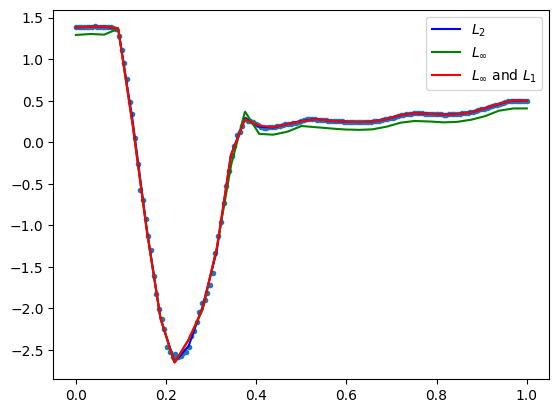

            max_dist       MSE      RMSE       MAE
LSQ         0.062263  0.000268  0.016376  0.008678
Max         0.046148  0.001672  0.040892  0.039385
Max and L1  0.046149  0.000299  0.017288  0.009186 

opt distance 0.0461478579024783
number of data points: 169


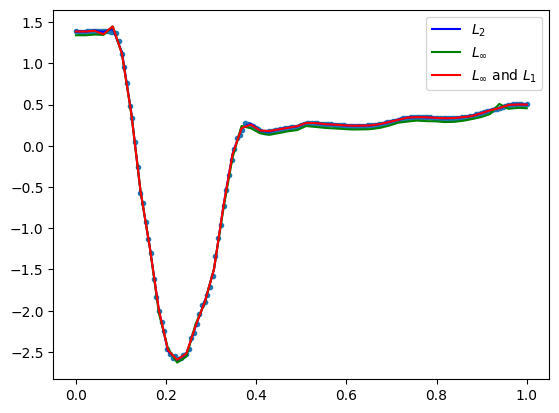

            max_dist       MSE      RMSE       MAE
LSQ         0.081910  0.000200  0.014130  0.006320
Max         0.056013  0.002671  0.051677  0.050239
Max and L1  0.056014  0.000270  0.016419  0.007084 

opt distance 0.05601349085391205
number of data points: 169


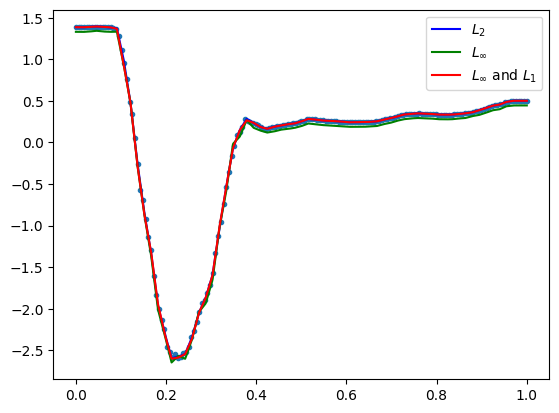

            max_dist       MSE      RMSE       MAE
LSQ         0.054988  0.000119  0.010930  0.005312
Max         0.039876  0.001398  0.037386  0.036685
Max and L1  0.039877  0.000158  0.012561  0.005315 

opt distance 0.039876126028288585
number of data points: 169


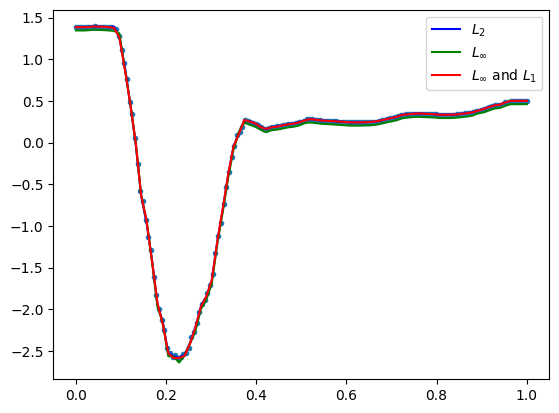

GestureMidAirD3 no. 143 len(ts): 118 ts processed: 68.75 %
[11, 23, 35, 47, 59]
            max_dist       MSE      RMSE       MAE
LSQ         0.251530  0.006818  0.082572  0.054533
Max         0.210515  0.022530  0.150099  0.136344
Max and L1  0.210516  0.010089  0.100442  0.072741 

opt distance 0.21051465414938259
number of data points: 118


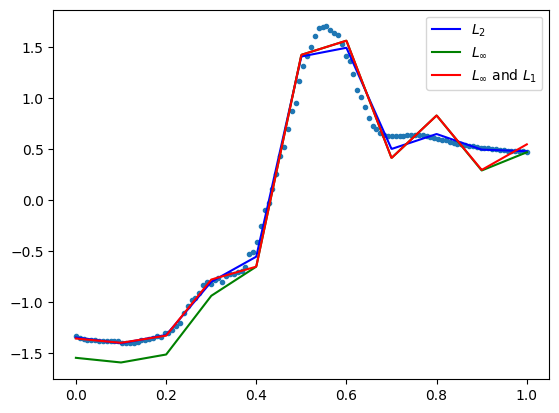

            max_dist       MSE      RMSE       MAE
LSQ         0.069121  0.000354  0.018803  0.012472
Max         0.047499  0.001288  0.035890  0.032582
Max and L1  0.047500  0.000434  0.020828  0.014019 

opt distance 0.0474989084856272
number of data points: 118


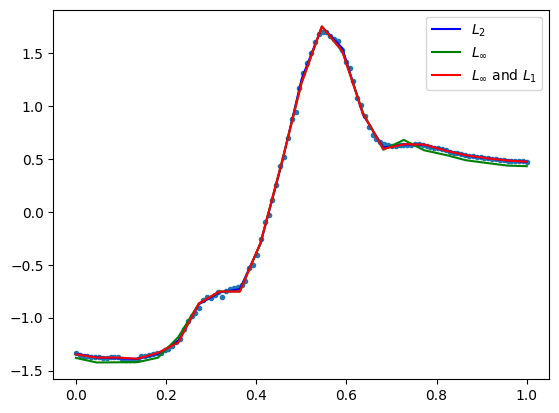

            max_dist       MSE      RMSE       MAE
LSQ         0.059878  0.000239  0.015463  0.009861
Max         0.039531  0.001141  0.033785  0.032241
Max and L1  0.039532  0.000345  0.018569  0.011507 

opt distance 0.03953051903526734
number of data points: 118


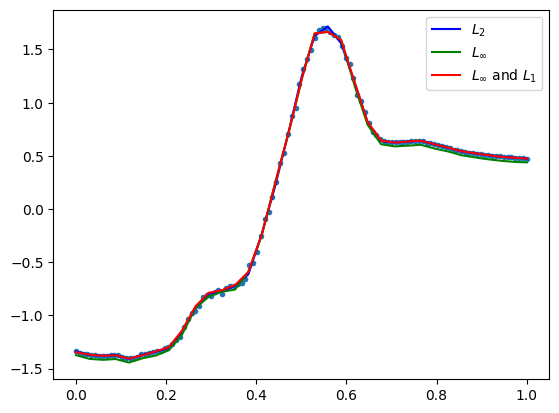

            max_dist       MSE      RMSE       MAE
LSQ         0.054782  0.000169  0.012987  0.007760
Max         0.039140  0.001119  0.033449  0.031437
Max and L1  0.039141  0.000207  0.014398  0.007573 

opt distance 0.03914018727674496
number of data points: 118


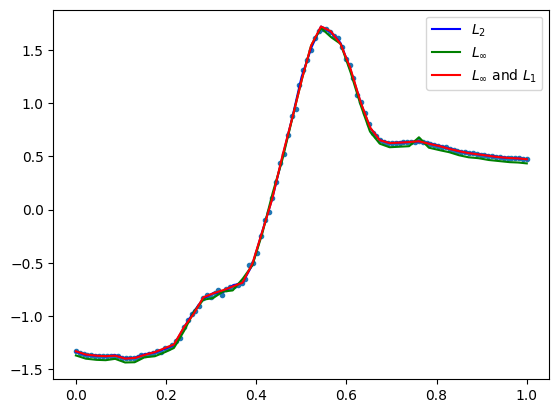

            max_dist       MSE      RMSE       MAE
LSQ         0.047117  0.000134  0.011585  0.006680
Max         0.036579  0.001038  0.032219  0.030315
Max and L1  0.036580  0.000182  0.013497  0.006636 

opt distance 0.036578744290605175
number of data points: 118


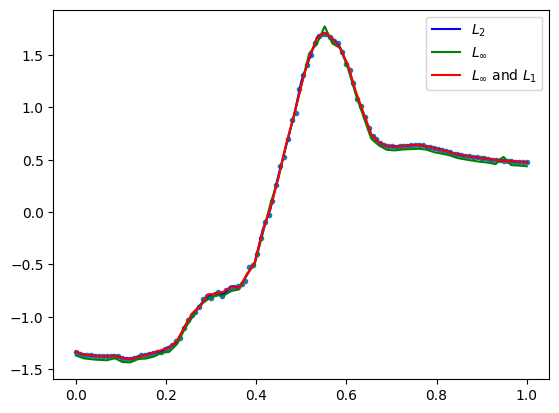

GestureMidAirD3 no. 144 len(ts): 179 ts processed: 69.23 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.067040  0.000302  0.017378  0.011866
Max         0.056345  0.001509  0.038850  0.034974
Max and L1  0.056346  0.000593  0.024357  0.017364 

opt distance 0.05634491755706156
number of data points: 179


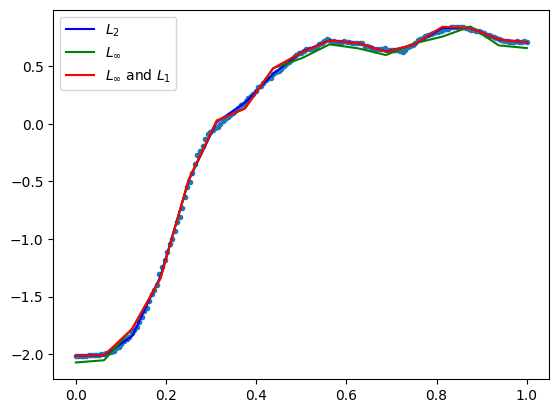

            max_dist       MSE      RMSE       MAE
LSQ         0.026941  0.000045  0.006733  0.005060
Max         0.018840  0.000191  0.013816  0.012500
Max and L1  0.018841  0.000055  0.007443  0.005091 

opt distance 0.018840475952546874
number of data points: 179


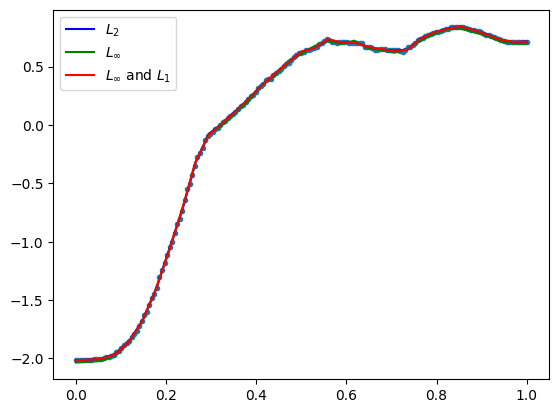

            max_dist       MSE      RMSE       MAE
LSQ         0.020445  0.000030  0.005518  0.003918
Max         0.016180  0.000164  0.012824  0.011894
Max and L1  0.016181  0.000036  0.005974  0.003743 

opt distance 0.0161800174751372
number of data points: 179


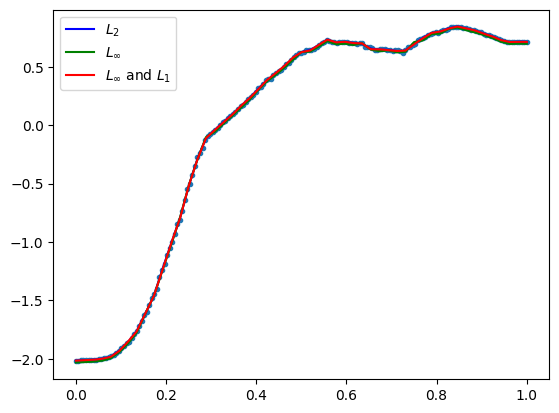

            max_dist       MSE      RMSE       MAE
LSQ         0.021714  0.000029  0.005423  0.003649
Max         0.017258  0.000209  0.014458  0.013606
Max and L1  0.017259  0.000034  0.005844  0.003338 

opt distance 0.017257602740556644
number of data points: 179


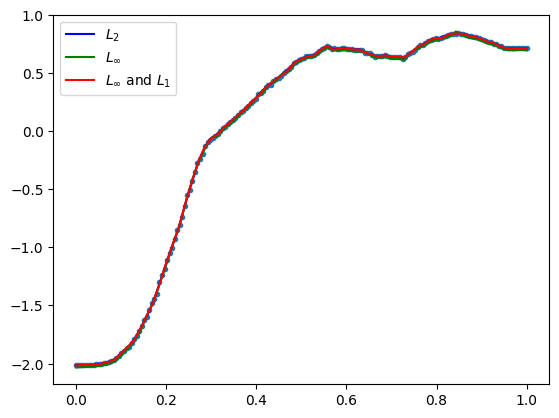

            max_dist       MSE      RMSE       MAE
LSQ         0.018187  0.000023  0.004772  0.003111
Max         0.013826  0.000146  0.012103  0.011533
Max and L1  0.013827  0.000032  0.005633  0.003226 

opt distance 0.01382635686527822
number of data points: 179


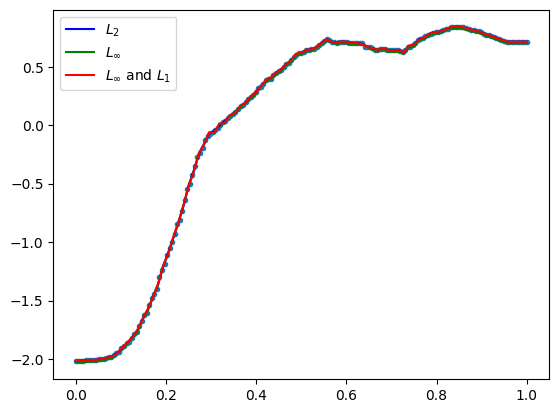

GestureMidAirD3 no. 145 len(ts): 145 ts processed: 69.71000000000001 %
[14, 29, 43, 58, 72]
            max_dist       MSE      RMSE       MAE
LSQ         0.346254  0.002897  0.053828  0.024466
Max         0.259952  0.045873  0.214181  0.202563
Max and L1  0.259953  0.007025  0.083814  0.047904 

opt distance 0.25995156305672373
number of data points: 145


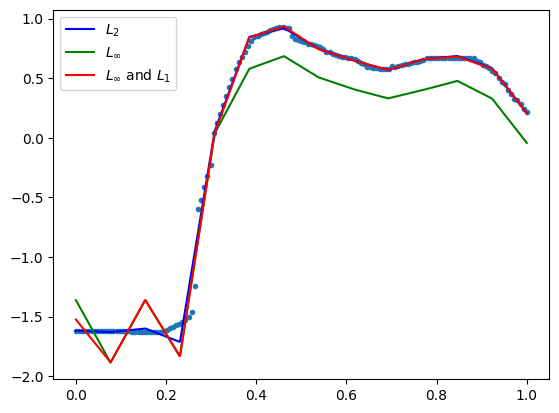

            max_dist       MSE      RMSE       MAE
LSQ         0.246328  0.000992  0.031490  0.010657
Max         0.184082  0.029402  0.171469  0.168526
Max and L1  0.184083  0.001557  0.039463  0.014481 

opt distance 0.18408244015539976
number of data points: 145


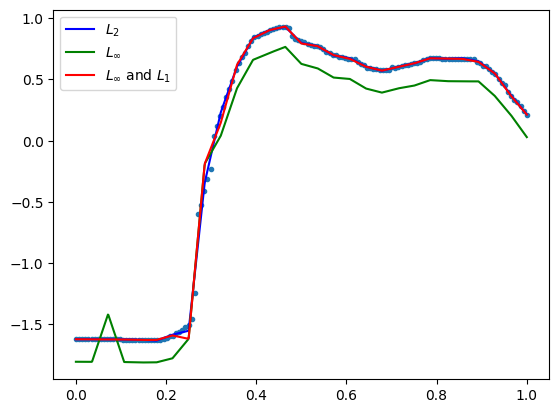

            max_dist       MSE      RMSE       MAE
LSQ         0.297475  0.001148  0.033883  0.011125
Max         0.185041  0.030114  0.173535  0.169818
Max and L1  0.185042  0.002276  0.047709  0.017297 

opt distance 0.18504133485343877
number of data points: 145


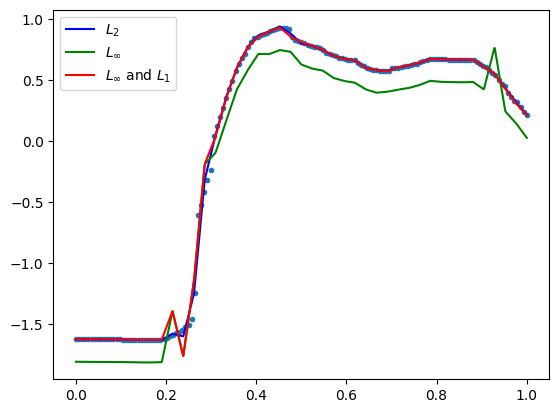

            max_dist       MSE      RMSE       MAE
LSQ         0.241991  0.000681  0.026091  0.007950
Max         0.143348  0.018288  0.135233  0.132603
Max and L1  0.143349  0.001428  0.037793  0.012883 

opt distance 0.1433478288264206
number of data points: 145


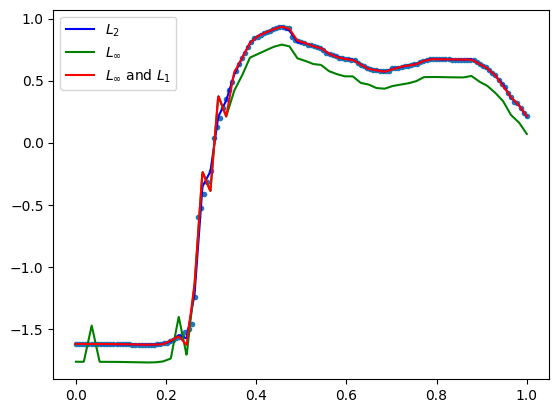

            max_dist       MSE      RMSE       MAE
LSQ         0.170138  0.000503  0.022418  0.006572
Max         0.132241  0.015141  0.123047  0.119857
Max and L1  0.132242  0.002667  0.051641  0.024272 

opt distance 0.13224068343829495
number of data points: 145


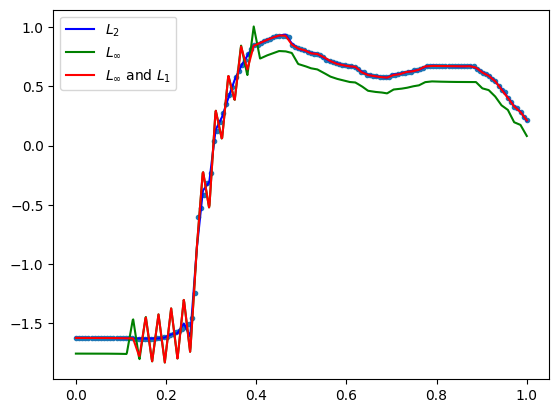

GestureMidAirD3 no. 146 len(ts): 172 ts processed: 70.19 %
[17, 34, 51, 68, 86]
            max_dist       MSE      RMSE       MAE
LSQ         0.111879  0.000866  0.029427  0.020219
Max         0.092854  0.004351  0.065964  0.059024
Max and L1  0.092855  0.001375  0.037077  0.025161 

opt distance 0.09285396396491177
number of data points: 172


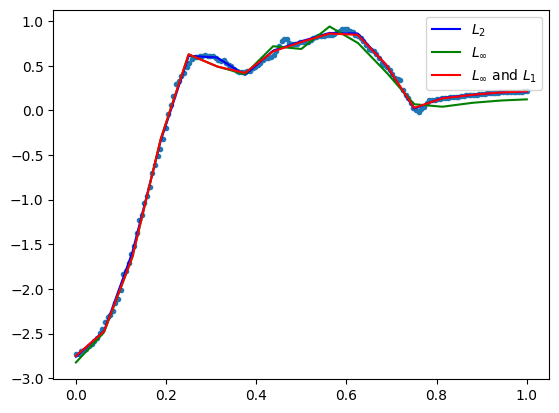

            max_dist       MSE      RMSE       MAE
LSQ         0.063129  0.000229  0.015120  0.010145
Max         0.042187  0.000964  0.031041  0.027906
Max and L1  0.042188  0.000280  0.016728  0.010818 

opt distance 0.042187011553280876
number of data points: 172


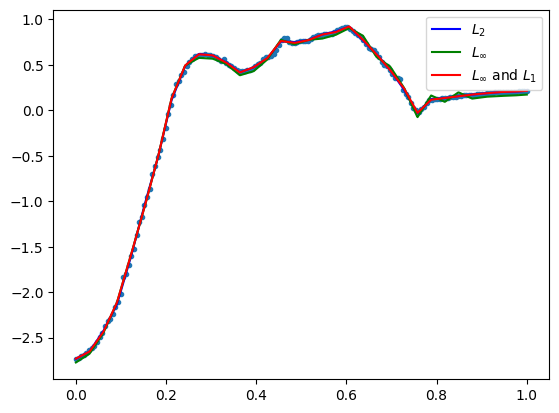

            max_dist       MSE      RMSE       MAE
LSQ         0.064001  0.000120  0.010975  0.006704
Max         0.042035  0.001241  0.035229  0.033179
Max and L1  0.042036  0.000207  0.014383  0.008085 

opt distance 0.04203512330395204
number of data points: 172


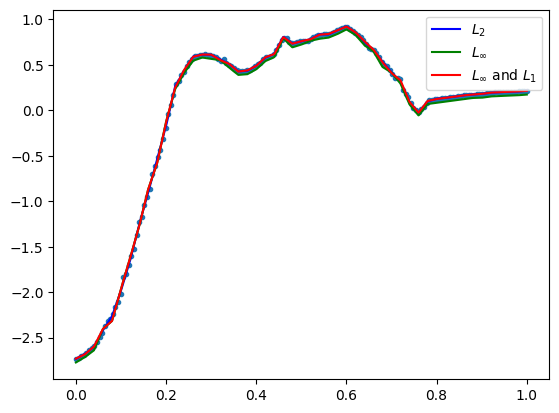

            max_dist       MSE      RMSE       MAE
LSQ         0.037097  0.000089  0.009453  0.006258
Max         0.033179  0.000794  0.028173  0.026774
Max and L1  0.033180  0.000121  0.010998  0.006147 

opt distance 0.03317935140123391
number of data points: 172


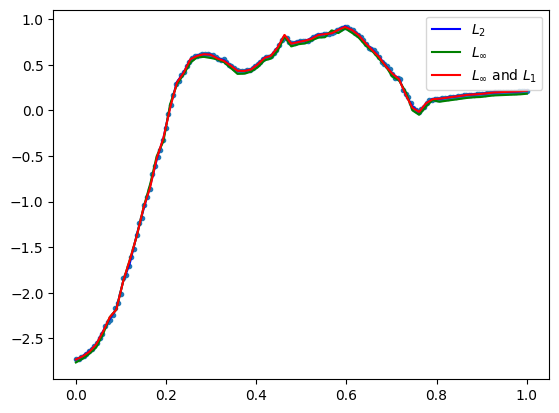

            max_dist       MSE      RMSE       MAE
LSQ         0.029835  0.000050  0.007049  0.004490
Max         0.021473  0.000352  0.018758  0.017823
Max and L1  0.021474  0.000062  0.007898  0.004299 

opt distance 0.021472507620347858
number of data points: 172


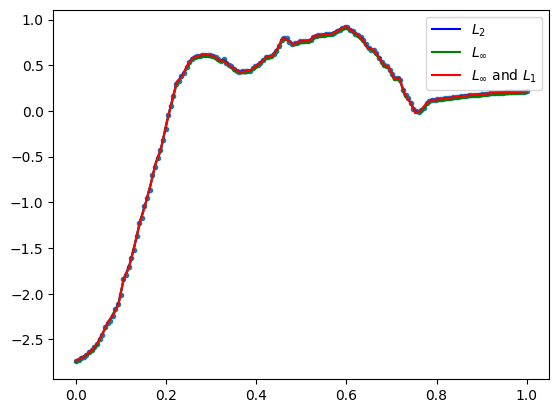

GestureMidAirD3 no. 147 len(ts): 180 ts processed: 70.67 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.075686  0.000486  0.022049  0.017331
Max         0.066244  0.002064  0.045433  0.039656
Max and L1  0.066245  0.000537  0.023175  0.016613 

opt distance 0.06624365001127047
number of data points: 180


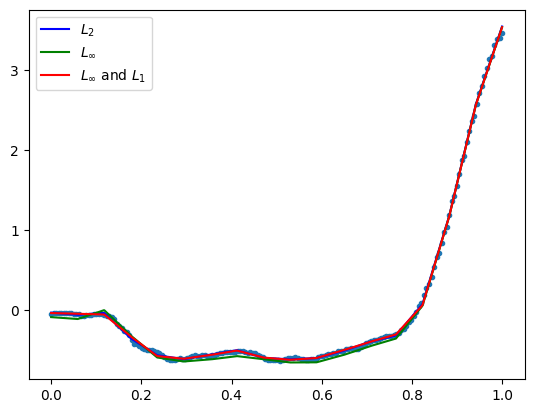

            max_dist       MSE      RMSE       MAE
LSQ         0.050820  0.000150  0.012267  0.008561
Max         0.042234  0.001063  0.032611  0.030266
Max and L1  0.042235  0.000242  0.015558  0.009921 

opt distance 0.042234089395215745
number of data points: 180


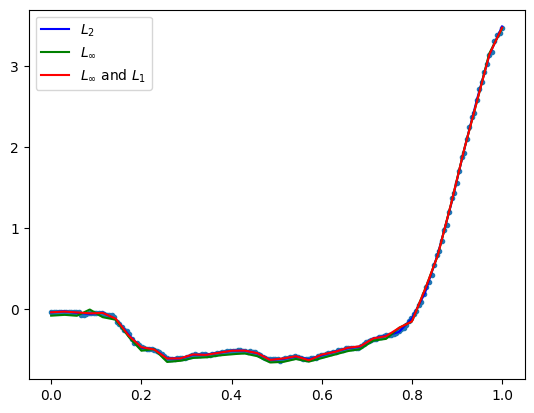

            max_dist       MSE      RMSE       MAE
LSQ         0.041671  0.000111  0.010547  0.006656
Max         0.034345  0.000809  0.028446  0.027004
Max and L1  0.034346  0.000132  0.011495  0.006697 

opt distance 0.03434466445625903
number of data points: 180


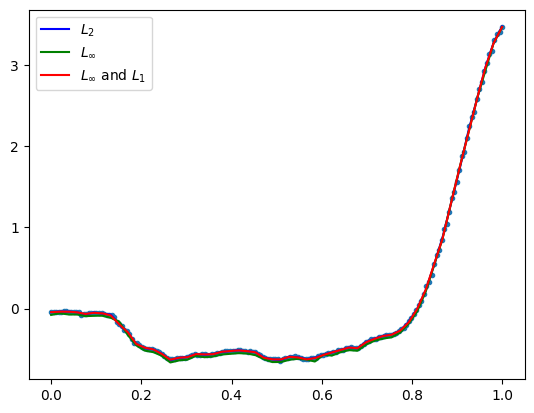

            max_dist       MSE      RMSE       MAE
LSQ         0.044826  0.000093  0.009625  0.005794
Max         0.034662  0.000883  0.029719  0.028538
Max and L1  0.034663  0.000116  0.010753  0.005738 

opt distance 0.034661838896369146
number of data points: 180


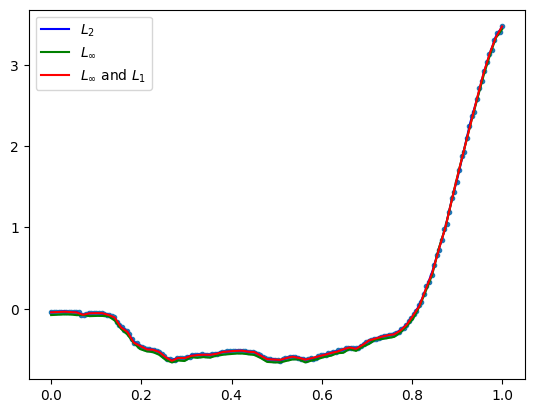

            max_dist       MSE      RMSE       MAE
LSQ         0.041872  0.000066  0.008093  0.004655
Max         0.028847  0.000676  0.025993  0.025214
Max and L1  0.028848  0.000081  0.009000  0.004431 

opt distance 0.02884705147489024
number of data points: 180


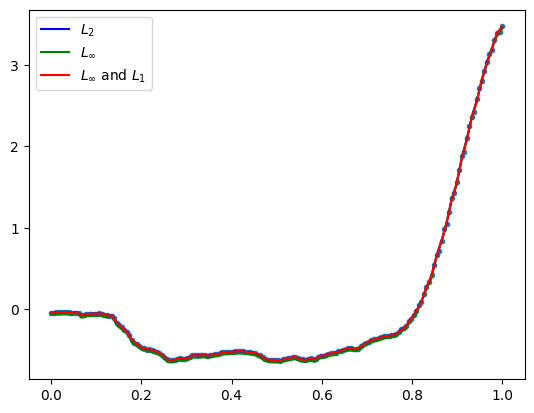

GestureMidAirD3 no. 148 len(ts): 82 ts processed: 71.15 %
[8, 16, 24, 32, 41]
            max_dist       MSE      RMSE       MAE
LSQ         0.374890  0.021526  0.146719  0.109350
Max         0.299395  0.039636  0.199088  0.179610
Max and L1  0.299396  0.029663  0.172229  0.138897 

opt distance 0.2993952397369122
number of data points: 82


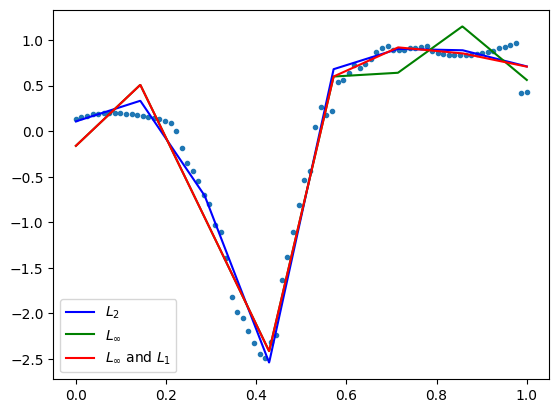

            max_dist       MSE      RMSE       MAE
LSQ         0.303421  0.007358  0.085777  0.056108
Max         0.229358  0.031966  0.178791  0.167172
Max and L1  0.229359  0.008601  0.092741  0.058534 

opt distance 0.22935767996468748
number of data points: 82


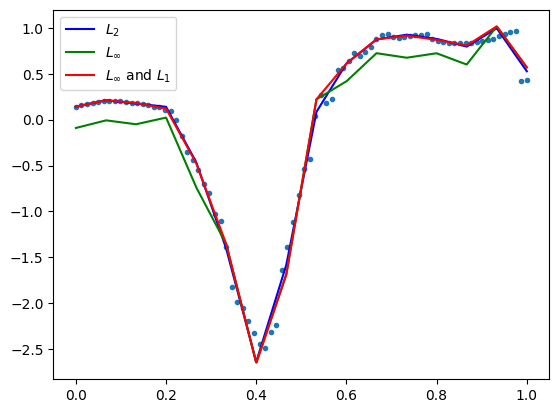

            max_dist       MSE      RMSE       MAE
LSQ         0.205479  0.003574  0.059779  0.037079
Max         0.165780  0.019288  0.138880  0.132117
Max and L1  0.165781  0.006317  0.079482  0.051449 

opt distance 0.1657803040501616
number of data points: 82


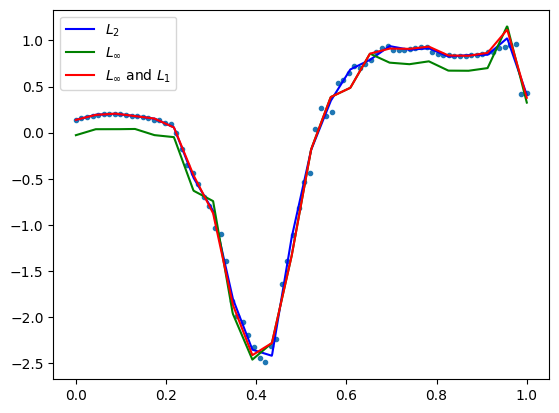

            max_dist       MSE      RMSE       MAE
LSQ         0.175392  0.002619  0.051173  0.028626
Max         0.138207  0.014288  0.119533  0.113532
Max and L1  0.138208  0.003120  0.055859  0.030108 

opt distance 0.1382073108040846
number of data points: 82


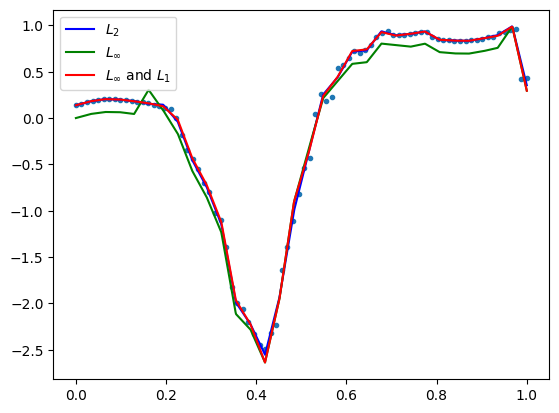

            max_dist       MSE      RMSE       MAE
LSQ         0.189516  0.002182  0.046709  0.024143
Max         0.138207  0.015926  0.126199  0.122873
Max and L1  0.138208  0.002370  0.048685  0.023746 

opt distance 0.13820731080408458
number of data points: 82


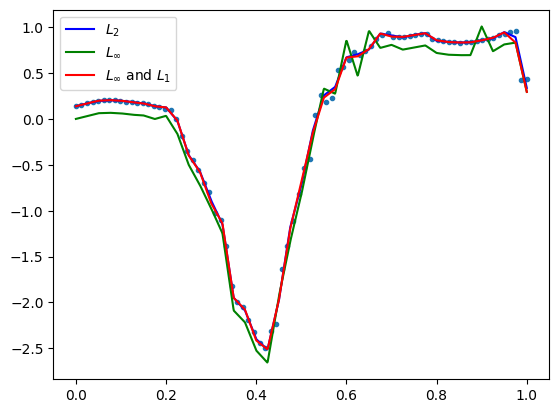

GestureMidAirD3 no. 149 len(ts): 90 ts processed: 71.63000000000001 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.130242  0.002245  0.047386  0.033516
Max         0.115432  0.005021  0.070861  0.060953
Max and L1  0.115433  0.004282  0.065440  0.053079 

opt distance 0.11543161128954119
number of data points: 90


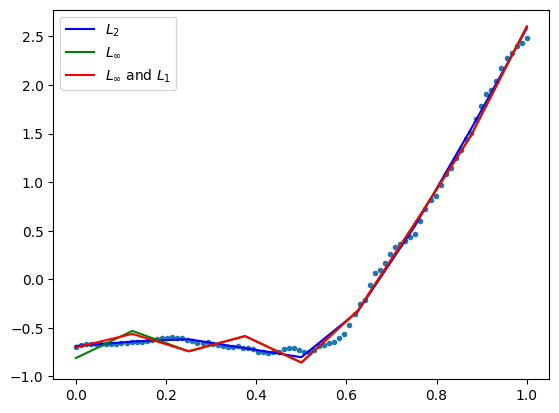

            max_dist       MSE      RMSE       MAE
LSQ         0.056963  0.000352  0.018759  0.013449
Max         0.050299  0.001321  0.036352  0.032704
Max and L1  0.050300  0.000548  0.023412  0.016748 

opt distance 0.05029874561222289
number of data points: 90


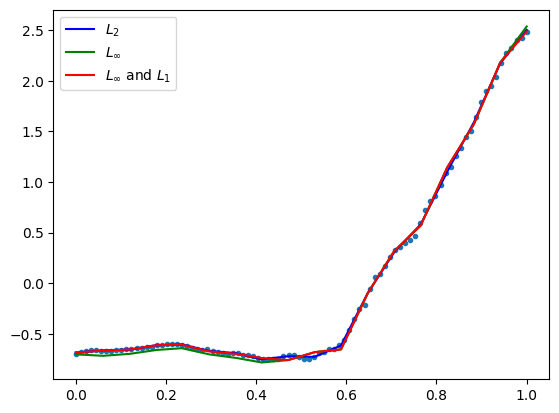

            max_dist       MSE      RMSE       MAE
LSQ         0.058477  0.000270  0.016426  0.011053
Max         0.041551  0.001125  0.033545  0.031605
Max and L1  0.041552  0.000332  0.018227  0.011731 

opt distance 0.04155143731391808
number of data points: 90


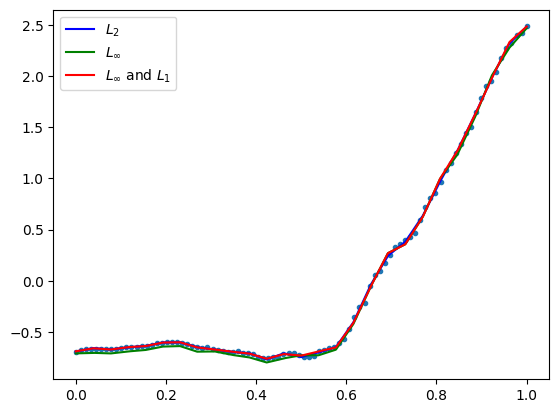

            max_dist       MSE      RMSE       MAE
LSQ         0.048623  0.000160  0.012660  0.008331
Max         0.033020  0.000716  0.026752  0.025020
Max and L1  0.033021  0.000200  0.014142  0.008732 

opt distance 0.03302033404519476
number of data points: 90


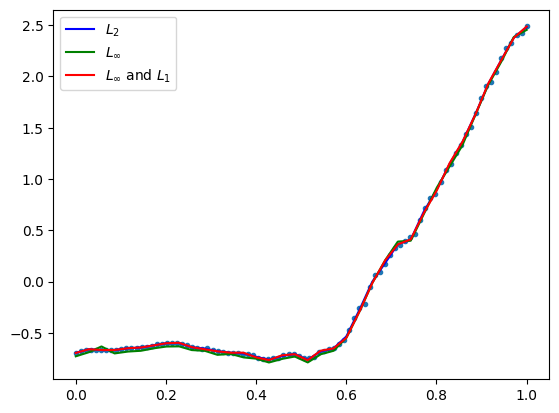

            max_dist       MSE      RMSE       MAE
LSQ         0.027776  0.000061  0.007823  0.005074
Max         0.020665  0.000315  0.017749  0.016833
Max and L1  0.020666  0.000095  0.009751  0.006003 

opt distance 0.020664683284526086
number of data points: 90


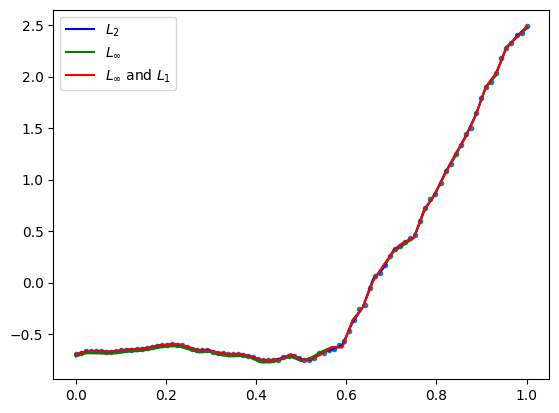

GestureMidAirD3 no. 150 len(ts): 87 ts processed: 72.11999999999999 %
[8, 17, 26, 34, 43]
            max_dist       MSE      RMSE       MAE
LSQ         0.225720  0.007261  0.085209  0.067824
Max         0.173653  0.013582  0.116543  0.101490
Max and L1  0.173654  0.008987  0.094801  0.077034 

opt distance 0.17365343636493102
number of data points: 87


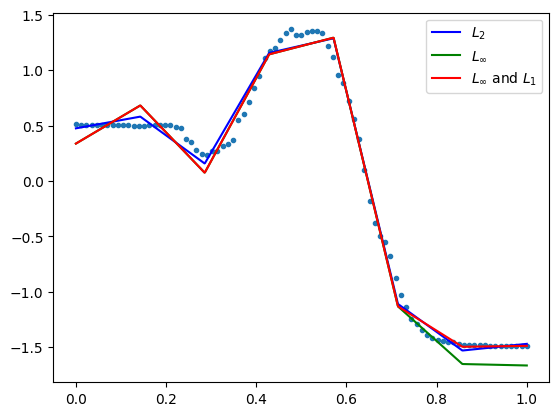

            max_dist       MSE      RMSE       MAE
LSQ         0.122950  0.001328  0.036436  0.023768
Max         0.101236  0.006576  0.081095  0.074589
Max and L1  0.101237  0.001557  0.039460  0.023405 

opt distance 0.1012363919350219
number of data points: 87


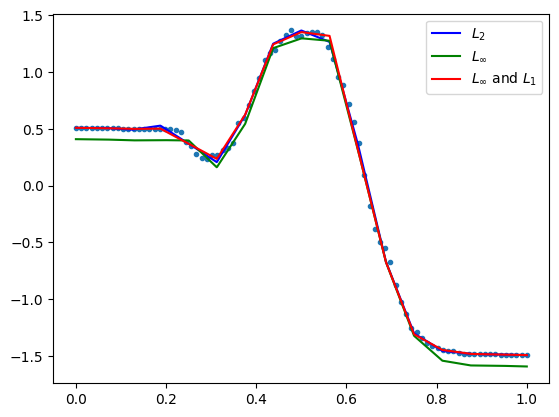

            max_dist       MSE      RMSE       MAE
LSQ         0.093158  0.000786  0.028032  0.017170
Max         0.076151  0.003943  0.062797  0.057920
Max and L1  0.076152  0.001113  0.033367  0.020001 

opt distance 0.07615098716640556
number of data points: 87


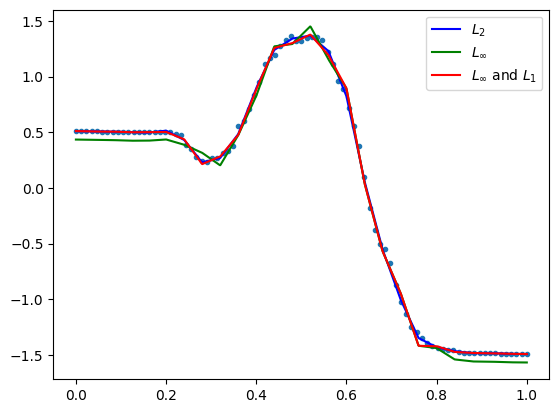

            max_dist       MSE      RMSE       MAE
LSQ         0.048242  0.000268  0.016371  0.010229
Max         0.037261  0.001042  0.032277  0.030104
Max and L1  0.037262  0.000356  0.018859  0.011915 

opt distance 0.03726051244823076
number of data points: 87


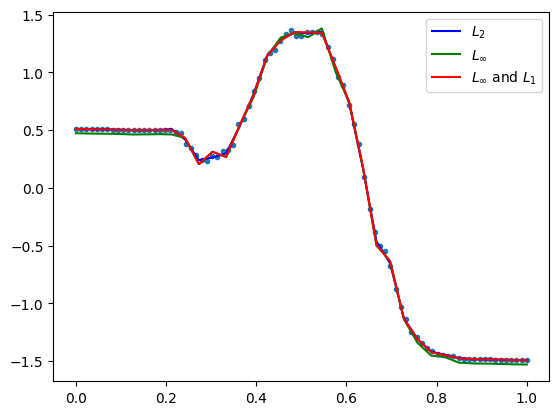

            max_dist       MSE      RMSE       MAE
LSQ         0.048433  0.000151  0.012302  0.007020
Max         0.035340  0.000999  0.031601  0.030086
Max and L1  0.035341  0.000252  0.015871  0.008805 

opt distance 0.03533960438787271
number of data points: 87


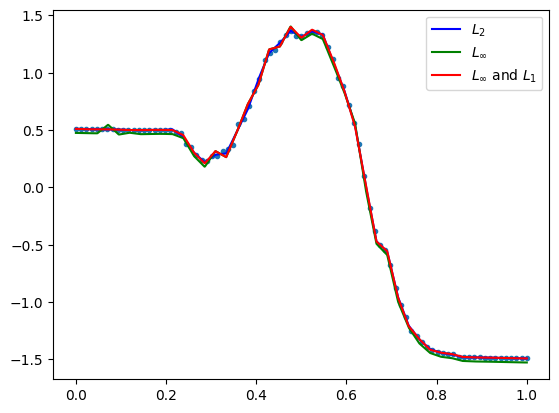

GestureMidAirD3 no. 151 len(ts): 297 ts processed: 72.6 %
[29, 59, 89, 118, 148]
            max_dist       MSE      RMSE       MAE
LSQ         0.195949  0.003844  0.062001  0.049066
Max         0.142604  0.009954  0.099768  0.089310
Max and L1  0.142605  0.004789  0.069200  0.053814 
opt distance 0.14260378637245605
number of data points: 297


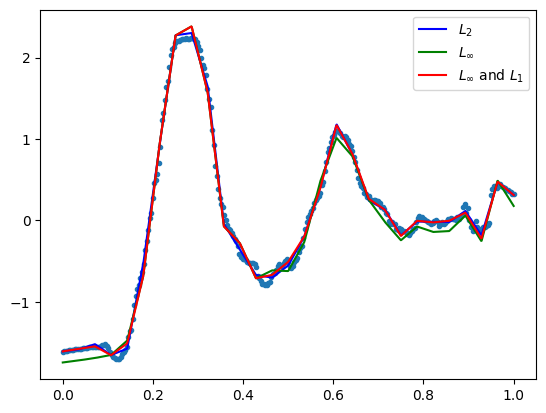

            max_dist       MSE      RMSE       MAE
LSQ         0.164418  0.001067  0.032662  0.021627
Max         0.131911  0.011376  0.106657  0.101711
Max and L1  0.131912  0.001499  0.038723  0.023716 

opt distance 0.13191117896759785
number of data points: 297


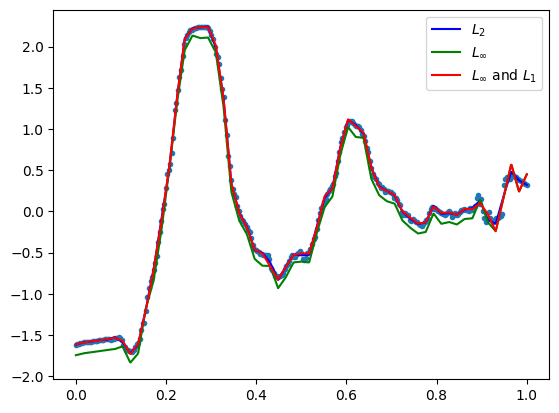

            max_dist       MSE      RMSE       MAE
LSQ         0.127588  0.000548  0.023406  0.015607
Max         0.083082  0.004536  0.067346  0.063109
Max and L1  0.083083  0.000719  0.026814  0.015835 

opt distance 0.0830815065057389
number of data points: 297


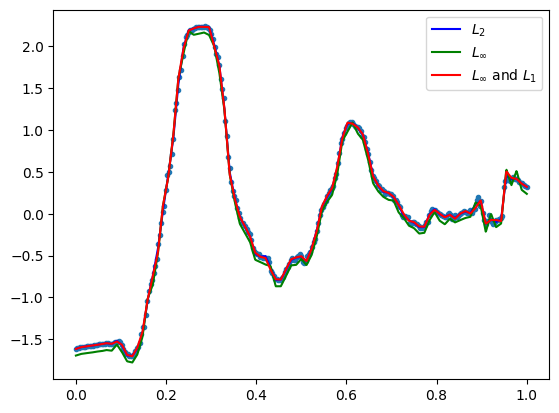

            max_dist       MSE      RMSE       MAE
LSQ         0.138388  0.000348  0.018665  0.011469
Max         0.096016  0.006808  0.082508  0.079228
Max and L1  0.096017  0.000605  0.024593  0.012271 
opt distance 0.09601642282165246
number of data points: 297


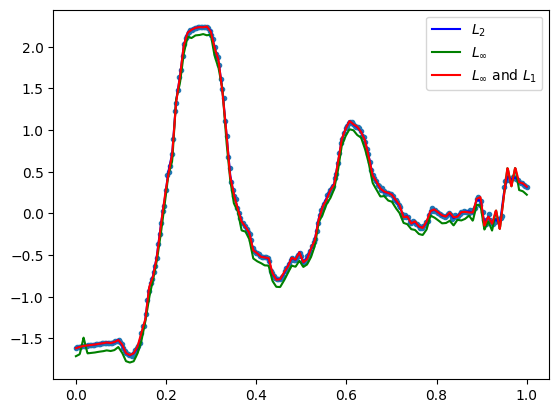

            max_dist       MSE      RMSE       MAE
LSQ         0.081152  0.000219  0.014804  0.009310
Max         0.060245  0.002802  0.052932  0.050599
Max and L1  0.060246  0.000298  0.017263  0.008857 
opt distance 0.060245133262472265
number of data points: 297


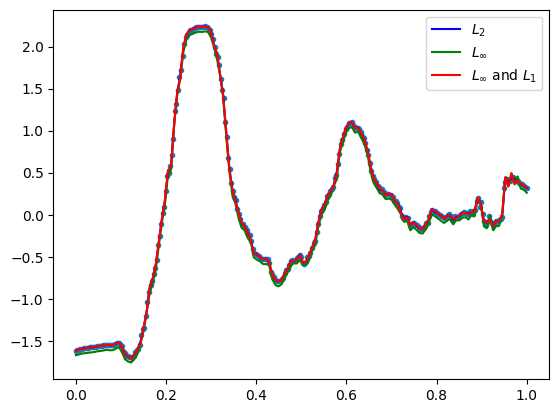

GestureMidAirD3 no. 152 len(ts): 180 ts processed: 73.08 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.048717  0.000207  0.014404  0.010959
Max         0.043259  0.000883  0.029719  0.026722
Max and L1  0.043260  0.000233  0.015279  0.011017 

opt distance 0.043258610736157055
number of data points: 180


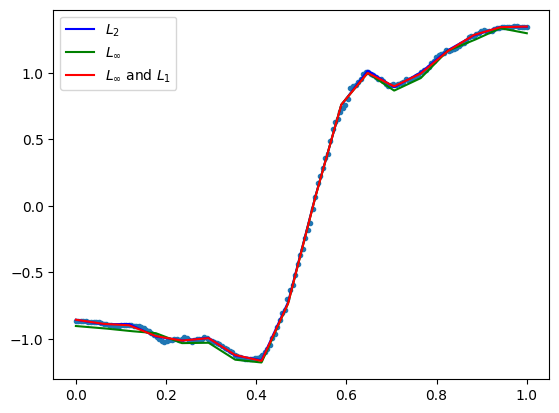

            max_dist       MSE      RMSE       MAE
LSQ         0.040366  0.000076  0.008710  0.005518
Max         0.030425  0.000551  0.023484  0.021707
Max and L1  0.030426  0.000086  0.009251  0.005522 
opt distance 0.030424930791397787
number of data points: 180


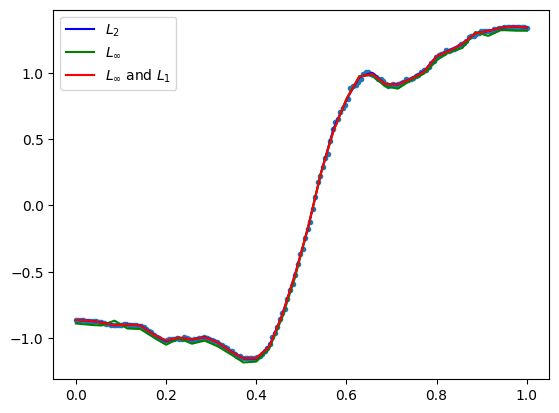

            max_dist       MSE      RMSE       MAE
LSQ         0.039489  0.000065  0.008062  0.004831
Max         0.029134  0.000560  0.023664  0.022070
Max and L1  0.029135  0.000098  0.009910  0.005745 

opt distance 0.029134237242898615
number of data points: 180


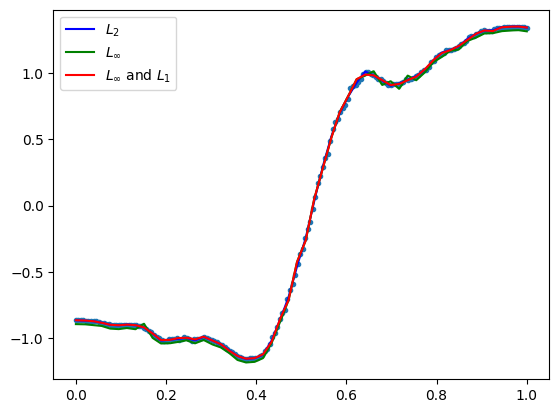

            max_dist       MSE      RMSE       MAE
LSQ         0.028068  0.000037  0.006083  0.003895
Max         0.020901  0.000318  0.017827  0.016959
Max and L1  0.020902  0.000051  0.007110  0.003924 

opt distance 0.020901183228275003
number of data points: 180


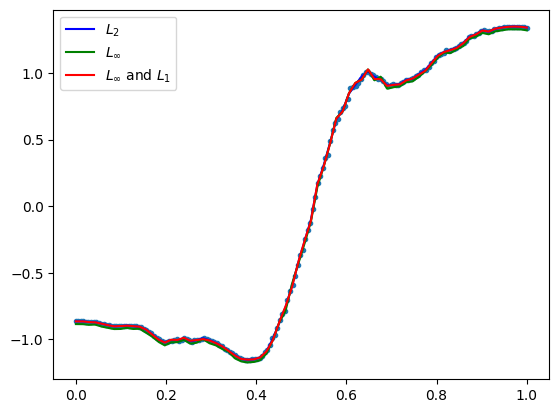

            max_dist       MSE      RMSE       MAE
LSQ         0.019304  0.000027  0.005176  0.003356
Max         0.015977  0.000190  0.013773  0.012926
Max and L1  0.015978  0.000040  0.006359  0.003550 

opt distance 0.015976799656671817
number of data points: 180


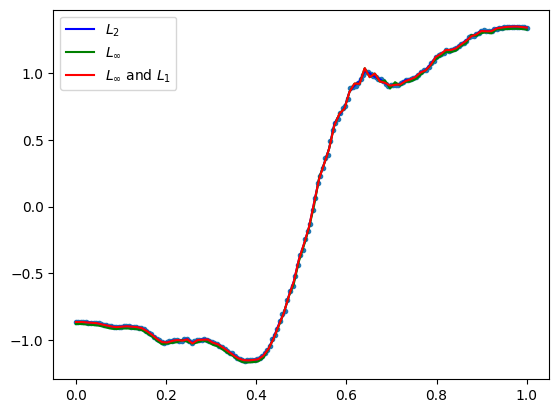

GestureMidAirD3 no. 153 len(ts): 108 ts processed: 73.56 %
[10, 21, 32, 43, 54]
            max_dist       MSE      RMSE       MAE
LSQ         0.141305  0.001762  0.041971  0.030254
Max         0.099014  0.003993  0.063192  0.056112
Max and L1  0.099015  0.003108  0.055753  0.044953 

opt distance 0.09901446364178712
number of data points: 108


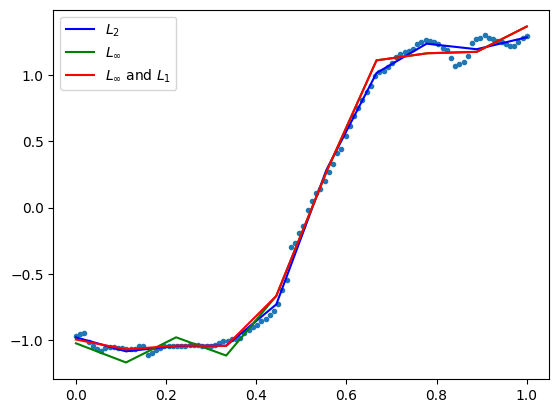

            max_dist       MSE      RMSE       MAE
LSQ         0.102040  0.000333  0.018239  0.012398
Max         0.070128  0.002857  0.053450  0.049323
Max and L1  0.070129  0.000693  0.026325  0.017216 

opt distance 0.07012838256528398
number of data points: 108


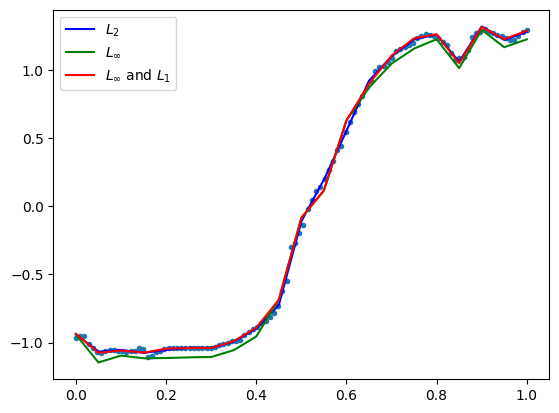

            max_dist       MSE      RMSE       MAE
LSQ         0.074107  0.000244  0.015631  0.010457
Max         0.049823  0.001616  0.040205  0.037595
Max and L1  0.049824  0.000338  0.018373  0.010623 

opt distance 0.04982257214640214
number of data points: 108


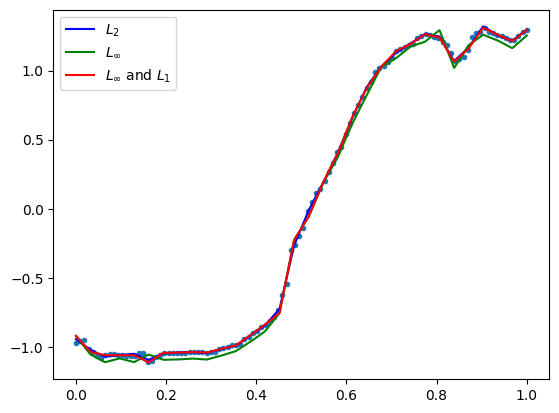

            max_dist       MSE      RMSE       MAE
LSQ         0.064700  0.000115  0.010733  0.006708
Max         0.045200  0.001452  0.038106  0.036406
Max and L1  0.045201  0.000218  0.014760  0.007965 

opt distance 0.04520009449368443
number of data points: 108


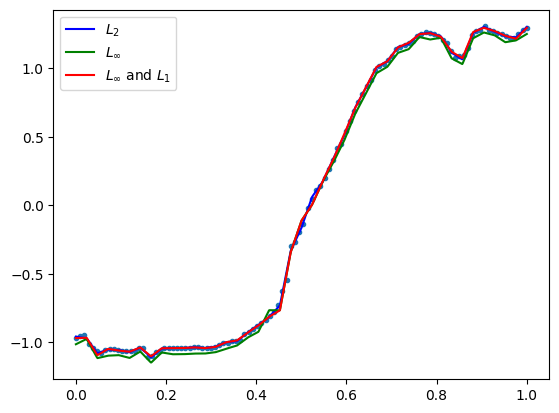

            max_dist       MSE      RMSE       MAE
LSQ         0.064889  0.000143  0.011945  0.006785
Max         0.050324  0.002019  0.044930  0.043486
Max and L1  0.050325  0.000231  0.015196  0.007412 

opt distance 0.05032417097365993
number of data points: 108


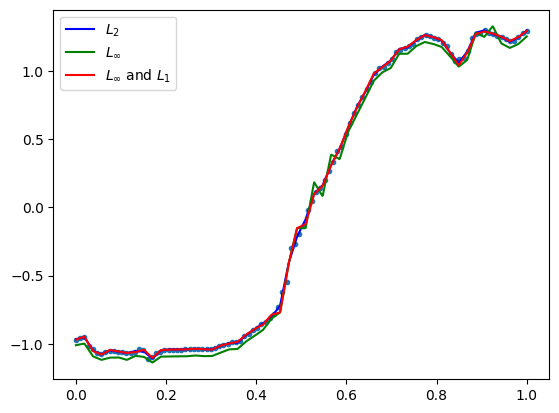

GestureMidAirD3 no. 154 len(ts): 112 ts processed: 74.03999999999999 %
[11, 22, 33, 44, 56]
            max_dist       MSE      RMSE       MAE
LSQ         0.191360  0.003899  0.062444  0.046913
Max         0.149050  0.010987  0.104819  0.096140
Max and L1  0.149051  0.005424  0.073645  0.056872 

opt distance 0.14905019175472234
number of data points: 112


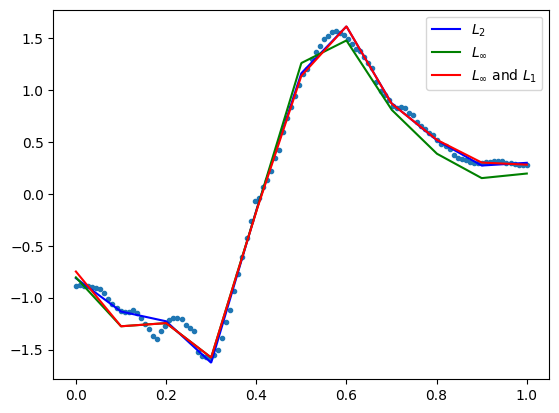

            max_dist       MSE      RMSE       MAE
LSQ         0.089162  0.000866  0.029422  0.020916
Max         0.069183  0.002702  0.051979  0.047853
Max and L1  0.069184  0.000930  0.030504  0.021206 

opt distance 0.0691831536215369
number of data points: 112


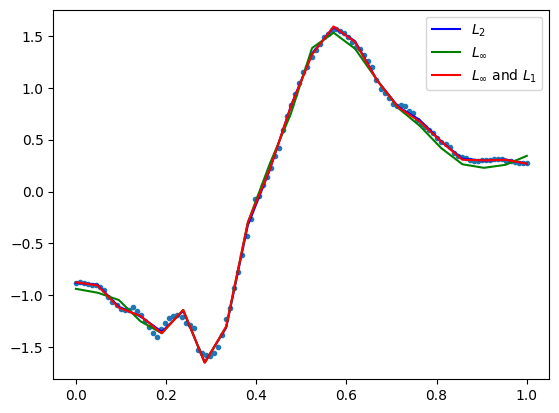

            max_dist       MSE      RMSE       MAE
LSQ         0.068863  0.000295  0.017170  0.011828
Max         0.048525  0.001454  0.038130  0.034912
Max and L1  0.048526  0.000465  0.021553  0.014185 

opt distance 0.04852473589128298
number of data points: 112


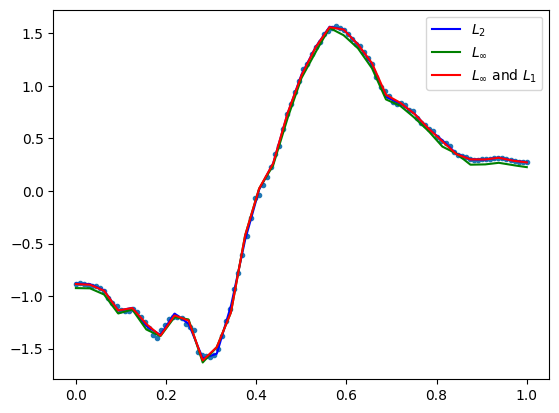

            max_dist       MSE      RMSE       MAE
LSQ         0.055329  0.000163  0.012758  0.009109
Max         0.042111  0.001152  0.033940  0.031280
Max and L1  0.042112  0.000252  0.015885  0.009569 

opt distance 0.04211145625240493
number of data points: 112


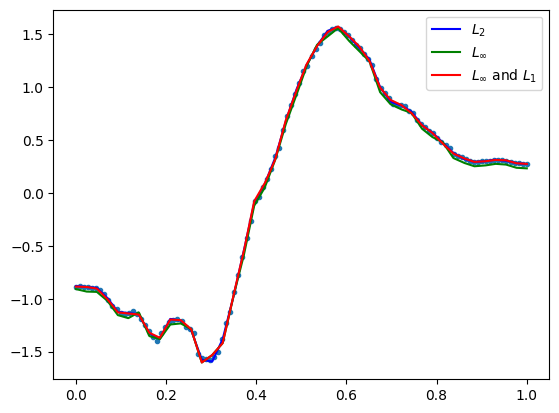

            max_dist       MSE      RMSE       MAE
LSQ         0.050715  0.000107  0.010325  0.006983
Max         0.035073  0.000891  0.029844  0.028193
Max and L1  0.035074  0.000176  0.013253  0.007449 

opt distance 0.03507340255139607
number of data points: 112


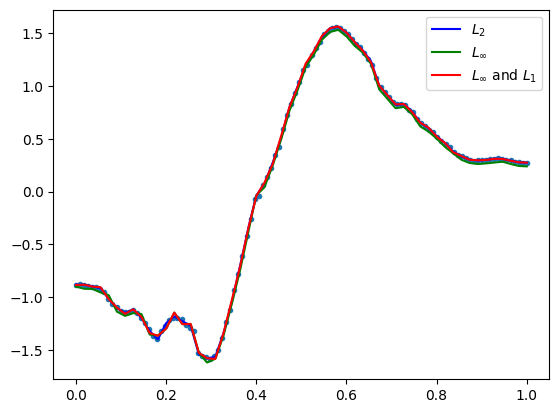

GestureMidAirD3 no. 155 len(ts): 179 ts processed: 74.52 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.065903  0.000399  0.019980  0.014008
Max         0.057520  0.001761  0.041968  0.038227
Max and L1  0.057521  0.000548  0.023417  0.016697 

opt distance 0.05751962135657107
number of data points: 179


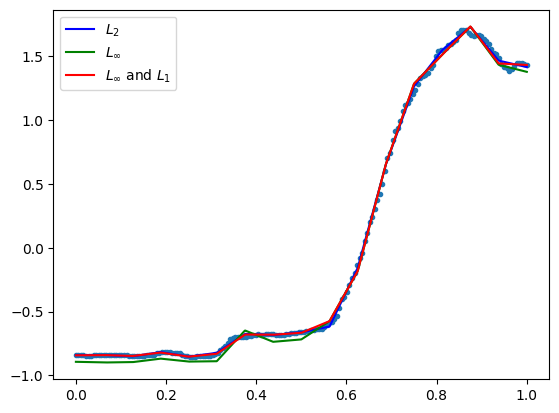

            max_dist       MSE      RMSE       MAE
LSQ         0.038087  0.000114  0.010695  0.007112
Max         0.029794  0.000508  0.022549  0.020596
Max and L1  0.029795  0.000144  0.012005  0.007744 

opt distance 0.029793650177013287
number of data points: 179


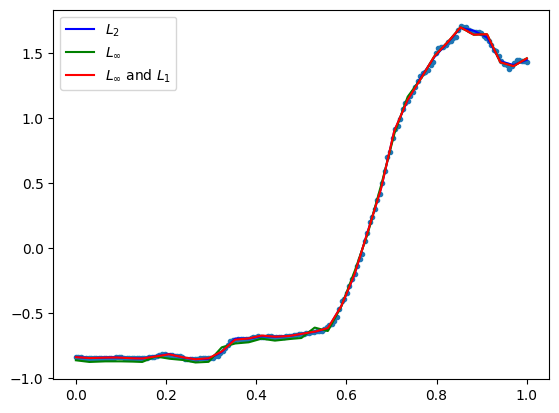

            max_dist       MSE      RMSE       MAE
LSQ         0.024504  0.000048  0.006949  0.004433
Max         0.019427  0.000273  0.016513  0.015815
Max and L1  0.019428  0.000059  0.007694  0.004569 

opt distance 0.019427368403414955
number of data points: 179


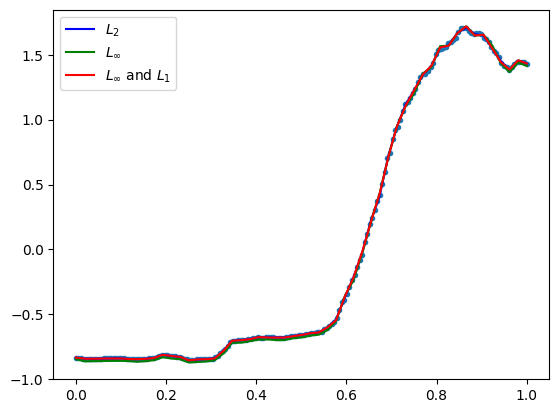

            max_dist       MSE      RMSE       MAE
LSQ         0.029341  0.000037  0.006102  0.003530
Max         0.020985  0.000330  0.018177  0.017218
Max and L1  0.020986  0.000044  0.006609  0.003404 

opt distance 0.020985437526384924
number of data points: 179


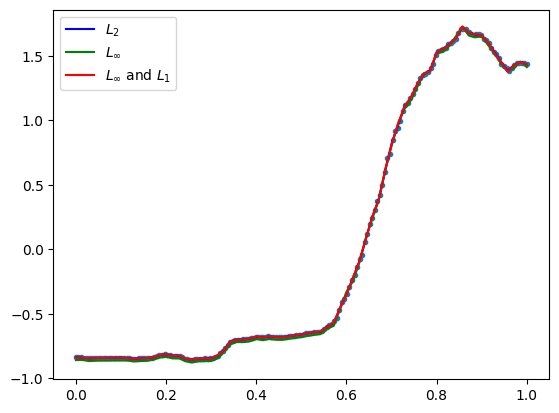

            max_dist       MSE      RMSE       MAE
LSQ         0.028318  0.000024  0.004929  0.002770
Max         0.020277  0.000338  0.018388  0.017868
Max and L1  0.020278  0.000042  0.006457  0.003144 

opt distance 0.020276932492627766
number of data points: 179


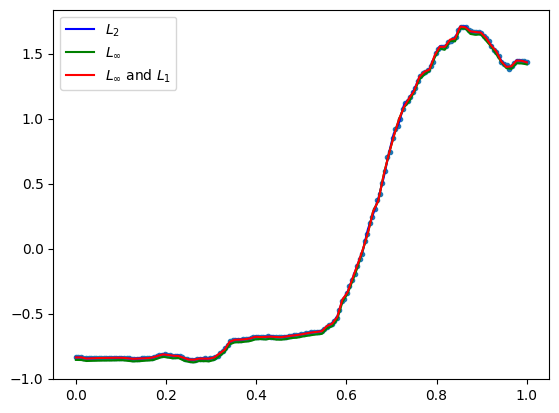

GestureMidAirD3 no. 156 len(ts): 163 ts processed: 75.0 %
[16, 32, 48, 65, 81]
            max_dist       MSE      RMSE       MAE
LSQ         0.093586  0.001003  0.031677  0.024804
Max         0.071668  0.002148  0.046350  0.041252
Max and L1  0.071669  0.001086  0.032950  0.025279 

opt distance 0.0716683312460679
number of data points: 163


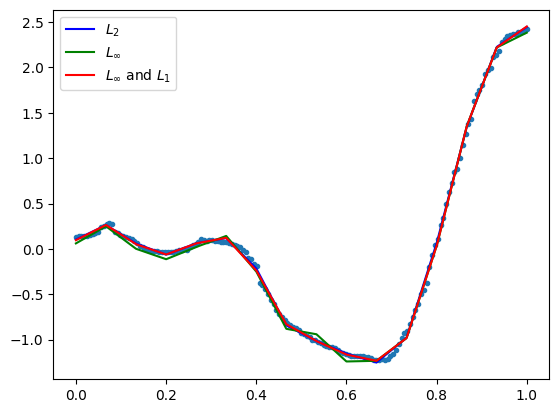

            max_dist       MSE      RMSE       MAE
LSQ         0.062098  0.000308  0.017554  0.011655
Max         0.050207  0.001498  0.038702  0.035602
Max and L1  0.050208  0.000428  0.020677  0.013559 

opt distance 0.05020744929810794
number of data points: 163


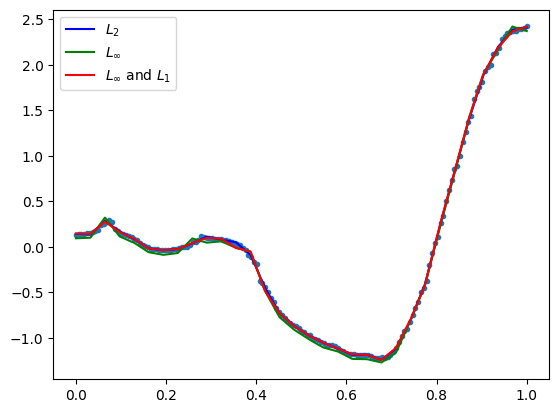

            max_dist       MSE      RMSE       MAE
LSQ         0.063125  0.000233  0.015278  0.009286
Max         0.054503  0.001991  0.044621  0.041526
Max and L1  0.054504  0.000382  0.019543  0.011220 

opt distance 0.054502766685476066
number of data points: 163


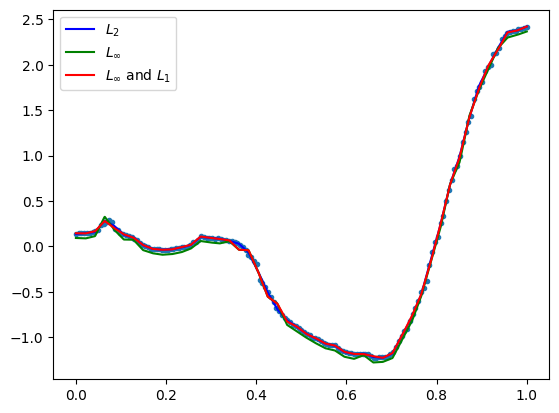

            max_dist       MSE      RMSE       MAE
LSQ         0.061559  0.000163  0.012766  0.007733
Max         0.044151  0.001416  0.037629  0.036015
Max and L1  0.044152  0.000234  0.015306  0.008297 

opt distance 0.0441508839519589
number of data points: 163


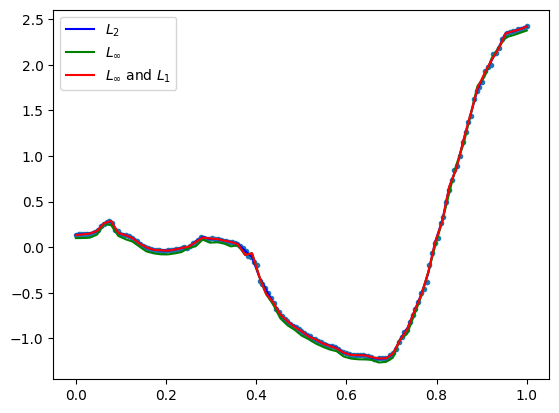

            max_dist       MSE      RMSE       MAE
LSQ         0.049083  0.000090  0.009496  0.005805
Max         0.035297  0.000963  0.031029  0.029448
Max and L1  0.035298  0.000134  0.011562  0.005765 

opt distance 0.03529655157710253
number of data points: 163


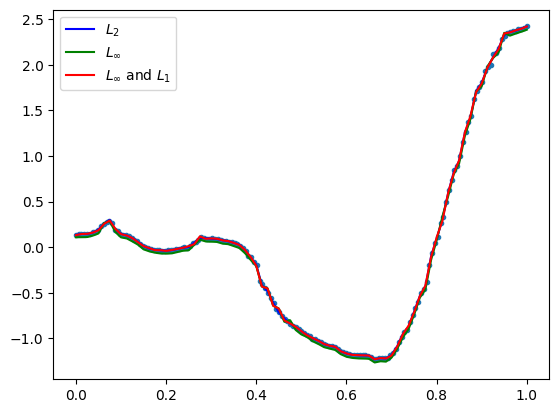

GestureMidAirD3 no. 157 len(ts): 180 ts processed: 75.48 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.070381  0.000527  0.022956  0.017612
Max         0.062053  0.001753  0.041867  0.036988
Max and L1  0.062054  0.000558  0.023632  0.017699 

opt distance 0.06205324350356062
number of data points: 180


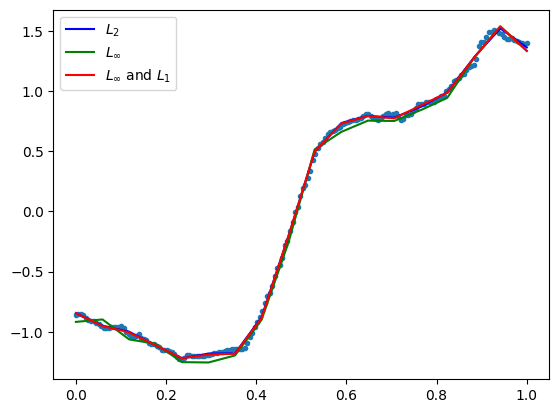

            max_dist       MSE      RMSE       MAE
LSQ         0.046245  0.000150  0.012265  0.009359
Max         0.034298  0.000617  0.024830  0.022336
Max and L1  0.034299  0.000206  0.014366  0.010000 

opt distance 0.03429786201169656
number of data points: 180


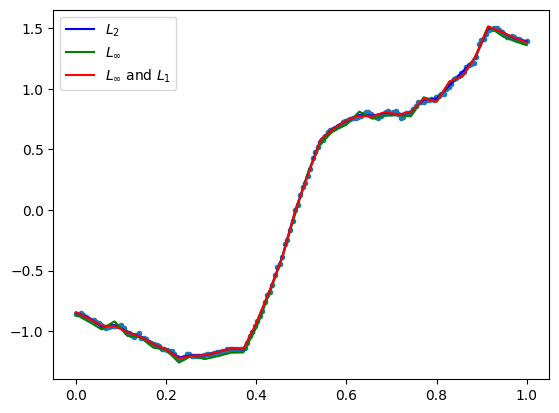

            max_dist       MSE      RMSE       MAE
LSQ         0.042748  0.000099  0.009958  0.007407
Max         0.032278  0.000640  0.025297  0.023309
Max and L1  0.032279  0.000132  0.011487  0.007397 

opt distance 0.03227803662289644
number of data points: 180


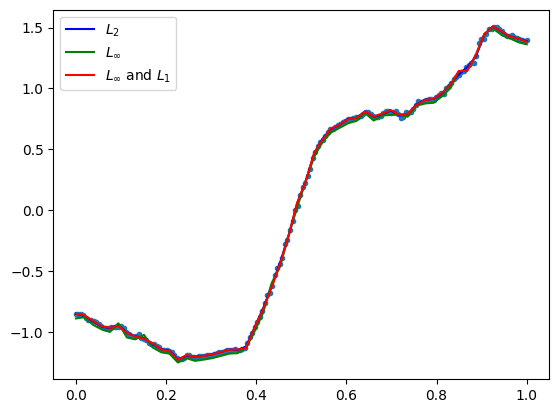

            max_dist       MSE      RMSE       MAE
LSQ         0.037043  0.000067  0.008173  0.005603
Max         0.026005  0.000453  0.021277  0.019584
Max and L1  0.026006  0.000093  0.009636  0.005758 

opt distance 0.026004678358753464
number of data points: 180


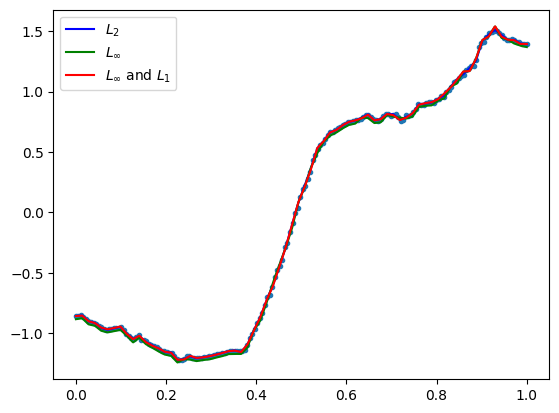

            max_dist       MSE      RMSE       MAE
LSQ         0.028442  0.000048  0.006917  0.004545
Max         0.019700  0.000285  0.016893  0.016018
Max and L1  0.019701  0.000061  0.007806  0.004540 

opt distance 0.019699749595300364
number of data points: 180


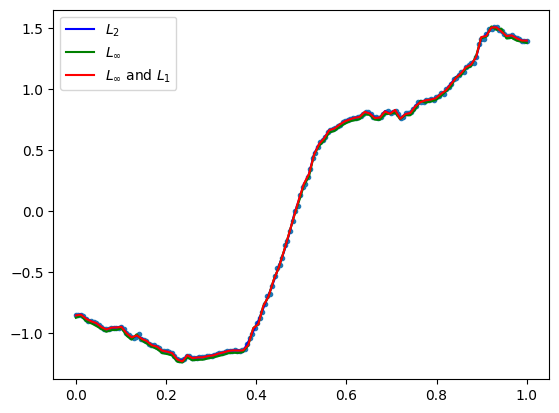

GestureMidAirD3 no. 158 len(ts): 120 ts processed: 75.96000000000001 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.092221  0.001200  0.034646  0.027926
Max         0.082456  0.002904  0.053887  0.047176
Max and L1  0.082457  0.001234  0.035135  0.028122 

opt distance 0.08245646410797197
number of data points: 120


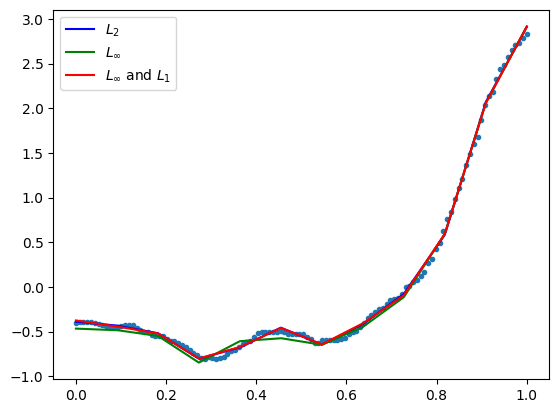

            max_dist       MSE      RMSE       MAE
LSQ         0.057680  0.000235  0.015323  0.011880
Max         0.041576  0.000843  0.029035  0.026073
Max and L1  0.041577  0.000331  0.018182  0.013310 

opt distance 0.041576163154375505
number of data points: 120


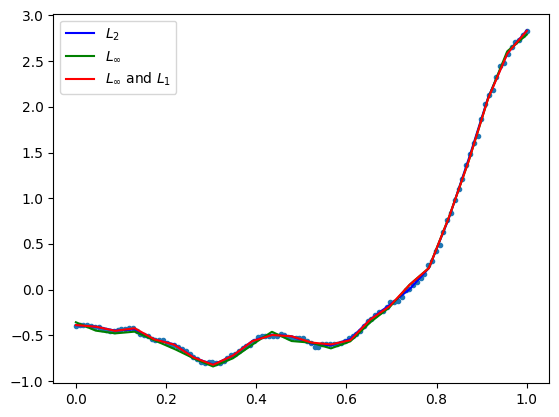

            max_dist       MSE      RMSE       MAE
LSQ         0.042326  0.000142  0.011923  0.008688
Max         0.034746  0.000729  0.026992  0.024732
Max and L1  0.034747  0.000158  0.012557  0.008525 

opt distance 0.03474550241548775
number of data points: 120


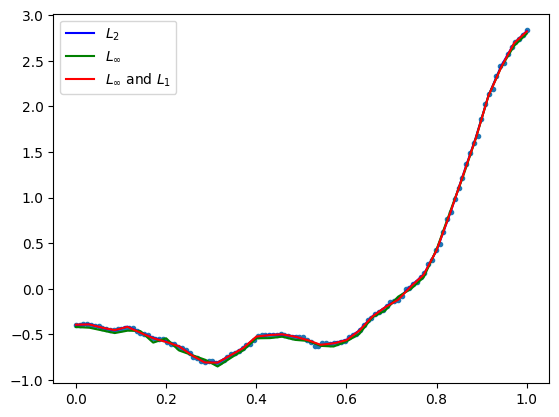

            max_dist       MSE      RMSE       MAE
LSQ         0.045270  0.000111  0.010529  0.007442
Max         0.034899  0.000807  0.028404  0.026495
Max and L1  0.034900  0.000172  0.013111  0.007897 

opt distance 0.034898571757921874
number of data points: 120


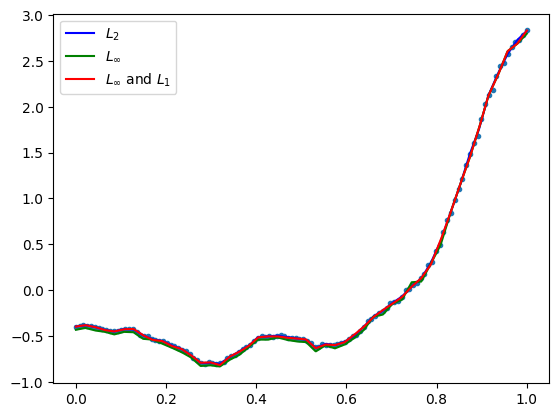

            max_dist       MSE      RMSE       MAE
LSQ         0.042968  0.000105  0.010226  0.006540
Max         0.032615  0.000785  0.028011  0.026339
Max and L1  0.032616  0.000153  0.012387  0.006869 

opt distance 0.03261490981614812
number of data points: 120


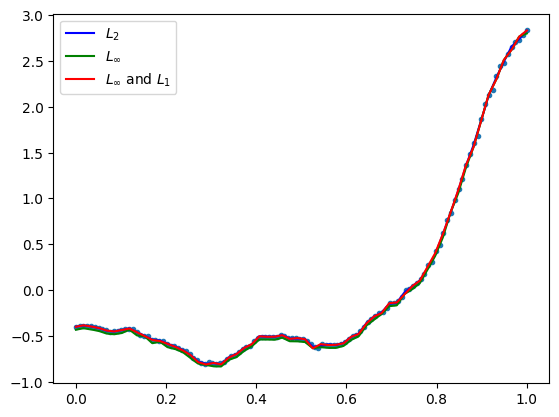

GestureMidAirD3 no. 159 len(ts): 180 ts processed: 76.44 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.031245  0.000070  0.008339  0.005328
Max         0.026391  0.000411  0.020280  0.018842
Max and L1  0.026392  0.000095  0.009737  0.005943 
opt distance 0.026391014045171413
number of data points: 180


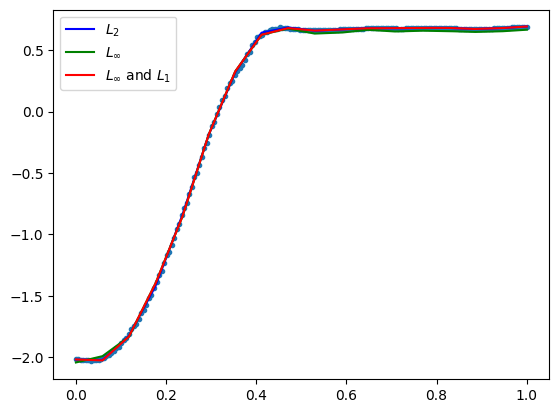

            max_dist       MSE      RMSE       MAE
LSQ         0.016618  0.000024  0.004889  0.002801
Max         0.014359  0.000142  0.011918  0.011213
Max and L1  0.014360  0.000025  0.005000  0.002790 

opt distance 0.014358798517979672
number of data points: 180


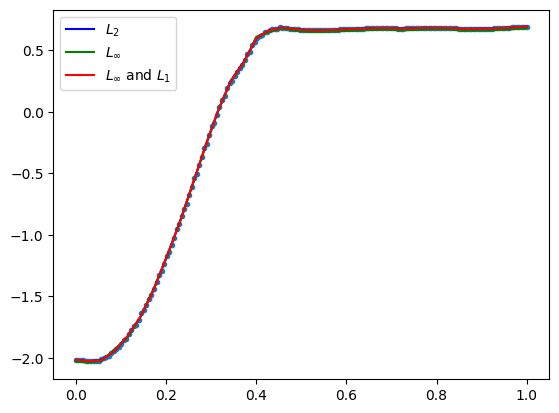

            max_dist       MSE      RMSE       MAE
LSQ         0.015839  0.000020  0.004495  0.002519
Max         0.013978  0.000147  0.012137  0.011537
Max and L1  0.013979  0.000023  0.004829  0.002559 

opt distance 0.013977867818213726
number of data points: 180


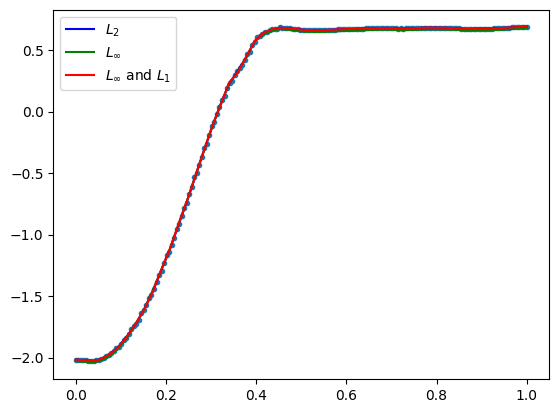

            max_dist       MSE      RMSE       MAE
LSQ         0.017375  0.000020  0.004425  0.002360
Max         0.013563  0.000147  0.012117  0.011650
Max and L1  0.013564  0.000022  0.004699  0.002309 

opt distance 0.013562687755583943
number of data points: 180


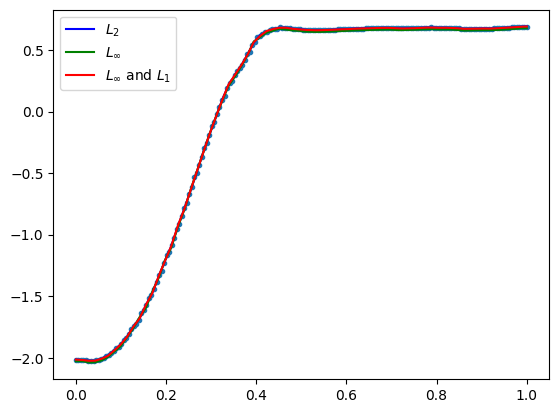

            max_dist       MSE      RMSE       MAE
LSQ         0.015109  0.000014  0.003789  0.002042
Max         0.011712  0.000116  0.010758  0.010402
Max and L1  0.011713  0.000018  0.004204  0.002021 

opt distance 0.01171200039528612
number of data points: 180


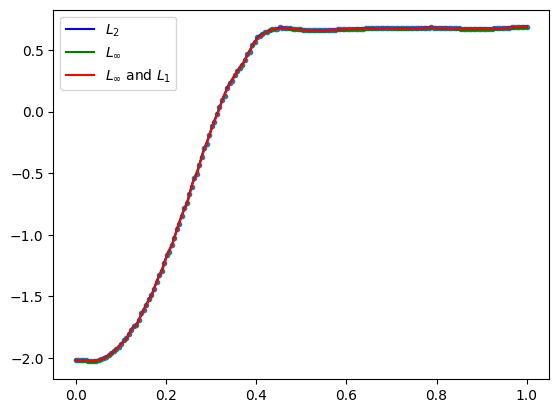

GestureMidAirD3 no. 160 len(ts): 86 ts processed: 76.92 %
[8, 17, 25, 34, 43]
            max_dist       MSE      RMSE       MAE
LSQ         0.110398  0.001029  0.032081  0.024301
Max         0.079815  0.002514  0.050137  0.043504
Max and L1  0.079816  0.001759  0.041940  0.033657 

opt distance 0.07981506111831949
number of data points: 86


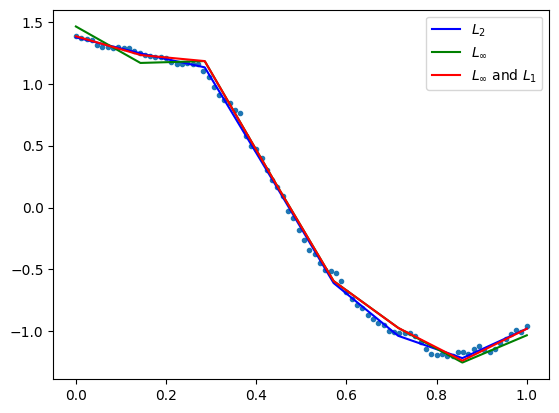

            max_dist       MSE      RMSE       MAE
LSQ         0.074224  0.000438  0.020932  0.016227
Max         0.059284  0.001727  0.041563  0.037451
Max and L1  0.059285  0.000770  0.027757  0.020927 

opt distance 0.05928405433689068
number of data points: 86


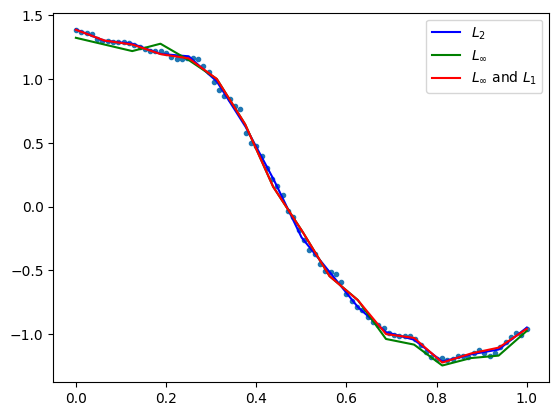

            max_dist       MSE      RMSE       MAE
LSQ         0.072155  0.000285  0.016886  0.012035
Max         0.054566  0.001797  0.042396  0.039509
Max and L1  0.054567  0.000474  0.021769  0.014323 

opt distance 0.05456560795887122
number of data points: 86


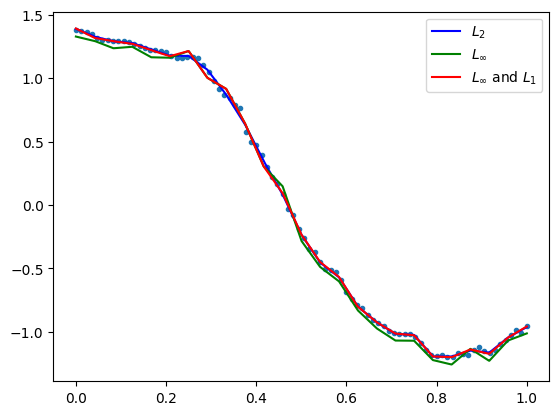

            max_dist       MSE      RMSE       MAE
LSQ         0.050742  0.000157  0.012524  0.008838
Max         0.039736  0.000992  0.031493  0.029244
Max and L1  0.039737  0.000192  0.013872  0.008642 

opt distance 0.0397360519261339
number of data points: 86


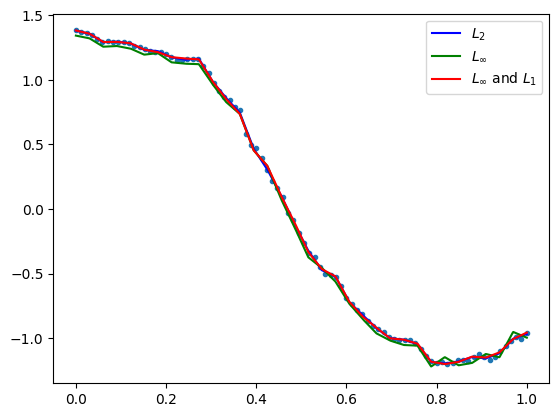

            max_dist       MSE      RMSE       MAE
LSQ         0.040507  0.000102  0.010108  0.006970
Max         0.030184  0.000637  0.025238  0.023589
Max and L1  0.030185  0.000149  0.012211  0.007208 

opt distance 0.030184415715684813
number of data points: 86


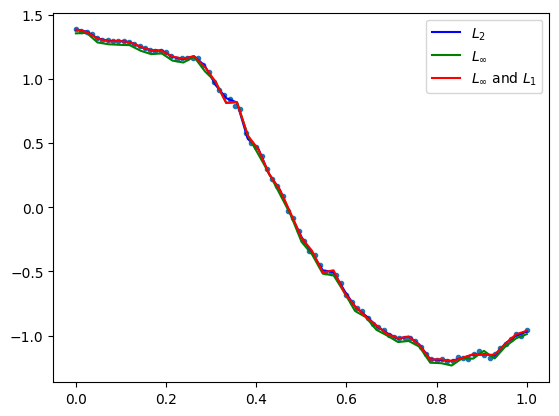

GestureMidAirD3 no. 161 len(ts): 179 ts processed: 77.4 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.042346  0.000167  0.012937  0.009586
Max         0.035226  0.000624  0.024988  0.023028
Max and L1  0.035227  0.000190  0.013783  0.009958 

opt distance 0.03522566063266597
number of data points: 179


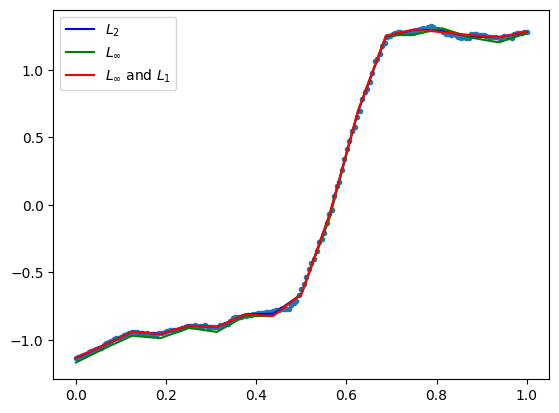

            max_dist       MSE      RMSE       MAE
LSQ         0.033231  0.000062  0.007851  0.005340
Max         0.026964  0.000425  0.020623  0.019267
Max and L1  0.026965  0.000069  0.008307  0.005176 

opt distance 0.026963944301791054
number of data points: 179


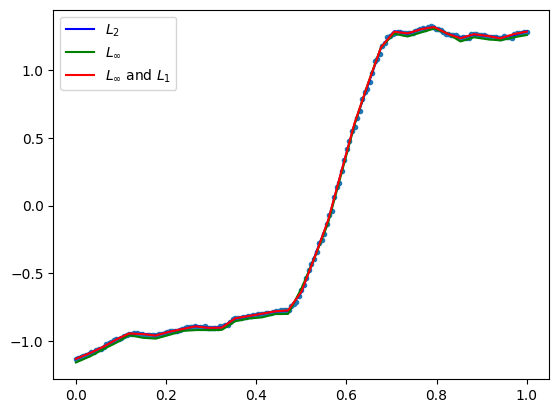

            max_dist       MSE      RMSE       MAE
LSQ         0.035242  0.000046  0.006803  0.004312
Max         0.025123  0.000441  0.021008  0.020003
Max and L1  0.025124  0.000061  0.007840  0.004477 

opt distance 0.025122719554948603
number of data points: 179


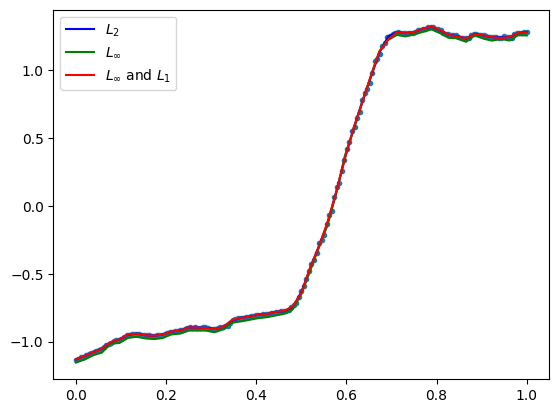

            max_dist       MSE      RMSE       MAE
LSQ         0.033166  0.000041  0.006364  0.003843
Max         0.021344  0.000336  0.018327  0.017438
Max and L1  0.021345  0.000062  0.007897  0.004362 

opt distance 0.021344074117718638
number of data points: 179


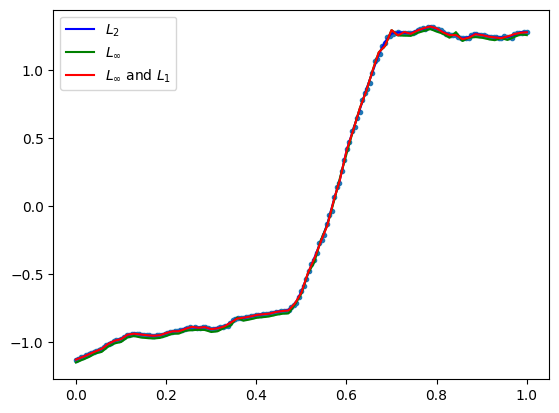

            max_dist       MSE      RMSE       MAE
LSQ         0.023319  0.000025  0.005014  0.002920
Max         0.015703  0.000196  0.013993  0.013463
Max and L1  0.015704  0.000033  0.005770  0.003028 

opt distance 0.015703151236165797
number of data points: 179


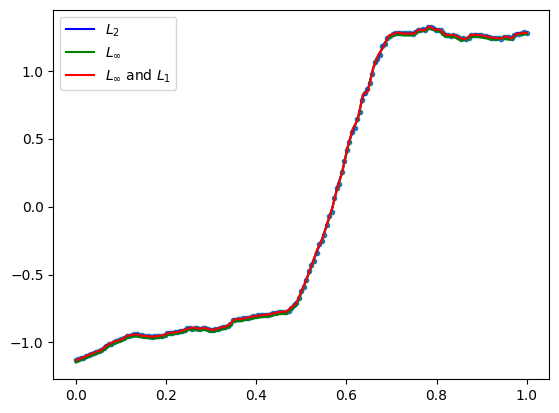

GestureMidAirD3 no. 162 len(ts): 179 ts processed: 77.88000000000001 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.063780  0.000297  0.017237  0.012633
Max         0.048693  0.001118  0.033429  0.029796
Max and L1  0.048694  0.000429  0.020716  0.014922 

opt distance 0.04869306532148454
number of data points: 179


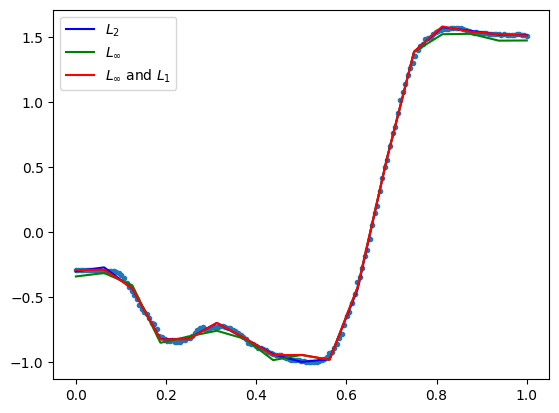

            max_dist       MSE      RMSE       MAE
LSQ         0.027783  0.000061  0.007799  0.005335
Max         0.020998  0.000239  0.015457  0.013774
Max and L1  0.020999  0.000071  0.008439  0.005436 

opt distance 0.020997887495363965
number of data points: 179


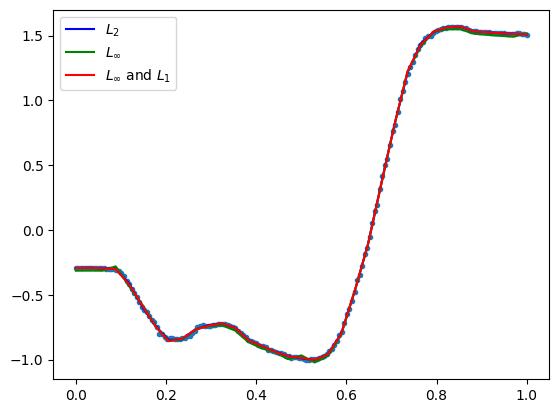

            max_dist       MSE      RMSE       MAE
LSQ         0.028496  0.000044  0.006600  0.004140
Max         0.020839  0.000284  0.016865  0.015818
Max and L1  0.020840  0.000048  0.006903  0.004021 

opt distance 0.02083883823964494
number of data points: 179


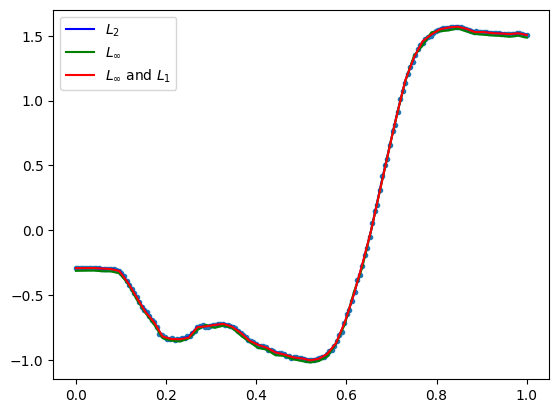

            max_dist       MSE      RMSE       MAE
LSQ         0.026179  0.000034  0.005835  0.003444
Max         0.020203  0.000299  0.017293  0.016558
Max and L1  0.020204  0.000039  0.006212  0.003292 

opt distance 0.020203391387472982
number of data points: 179


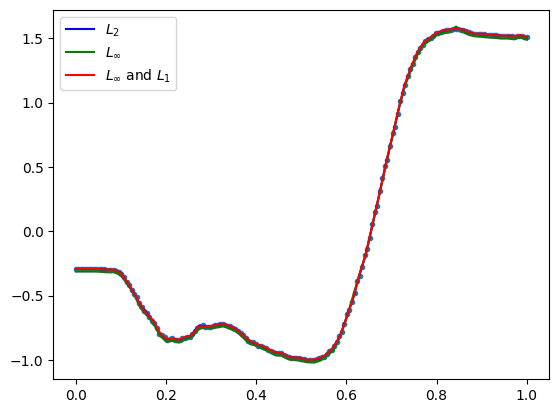

            max_dist       MSE      RMSE       MAE
LSQ         0.024503  0.000024  0.004853  0.002885
Max         0.018086  0.000266  0.016311  0.015866
Max and L1  0.018087  0.000040  0.006355  0.003221 

opt distance 0.018085767546095827
number of data points: 179


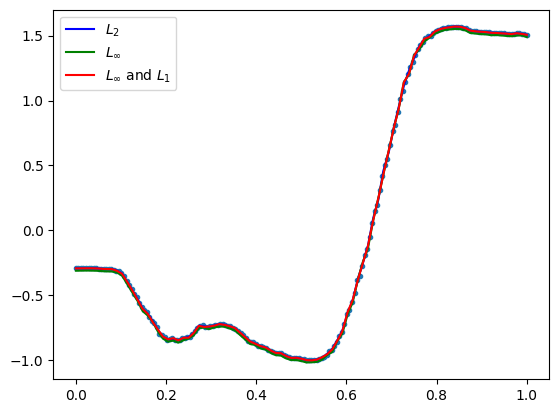

GestureMidAirD3 no. 163 len(ts): 166 ts processed: 78.36999999999999 %
[16, 33, 49, 66, 83]
            max_dist       MSE      RMSE       MAE
LSQ         0.060743  0.000357  0.018882  0.013210
Max         0.051250  0.001313  0.036239  0.033123
Max and L1  0.051251  0.000420  0.020497  0.014082 

opt distance 0.05125008753741149
number of data points: 166


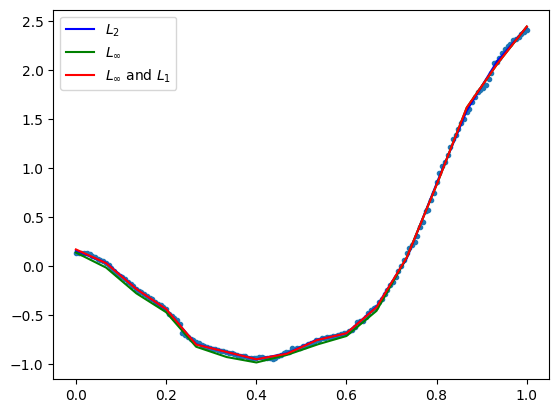

            max_dist       MSE      RMSE       MAE
LSQ         0.037152  0.000109  0.010422  0.007144
Max         0.027186  0.000407  0.020178  0.018293
Max and L1  0.027187  0.000125  0.011165  0.007538 

opt distance 0.02718608937628687
number of data points: 166


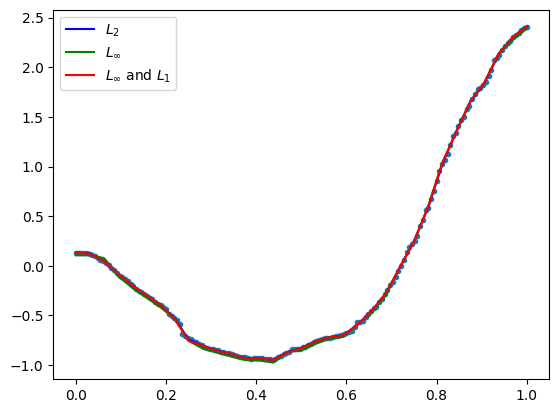

            max_dist       MSE      RMSE       MAE
LSQ         0.041893  0.000091  0.009555  0.006323
Max         0.029048  0.000530  0.023029  0.021257
Max and L1  0.029049  0.000130  0.011395  0.006993 

opt distance 0.029048146366119354
number of data points: 166


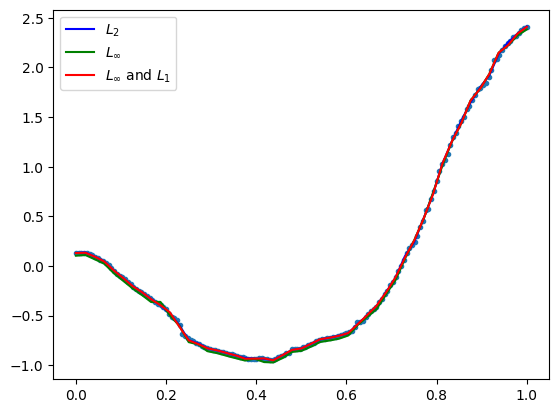

            max_dist       MSE      RMSE       MAE
LSQ         0.034312  0.000058  0.007641  0.004934
Max         0.021934  0.000322  0.017934  0.016708
Max and L1  0.021935  0.000076  0.008733  0.005345 

opt distance 0.02193407703109053
number of data points: 166


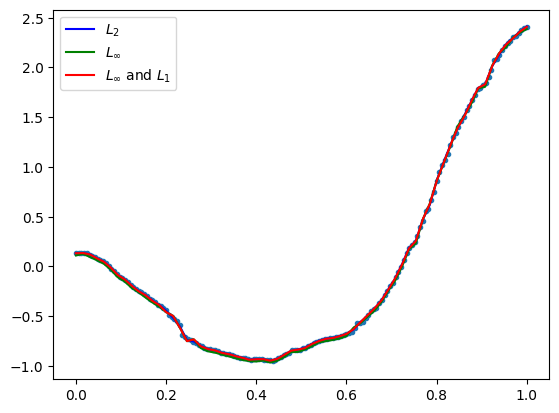

            max_dist       MSE      RMSE       MAE
LSQ         0.028021  0.000037  0.006048  0.003870
Max         0.021247  0.000348  0.018652  0.017866
Max and L1  0.021248  0.000055  0.007413  0.004005 

opt distance 0.021247493220717013
number of data points: 166


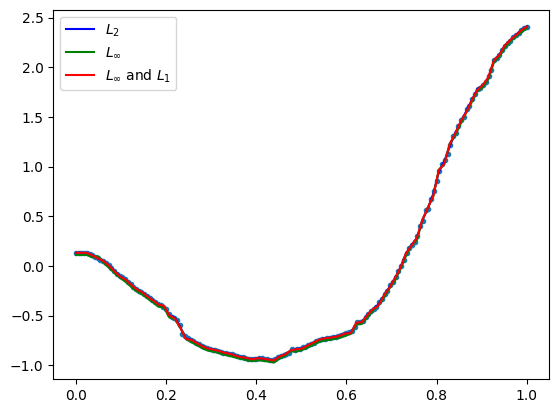

GestureMidAirD3 no. 164 len(ts): 239 ts processed: 78.85 %
[23, 47, 71, 95, 119]
            max_dist       MSE      RMSE       MAE
LSQ         0.111605  0.001079  0.032850  0.023194
Max         0.104894  0.005836  0.076393  0.069955
Max and L1  0.104895  0.001547  0.039332  0.026147 

opt distance 0.10489404891428596
number of data points: 239


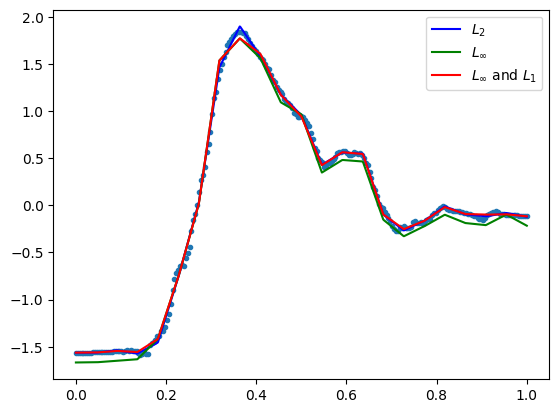

            max_dist       MSE      RMSE       MAE
LSQ         0.071919  0.000352  0.018773  0.013197
Max         0.055590  0.001748  0.041814  0.037996
Max and L1  0.055591  0.000425  0.020609  0.013115 

opt distance 0.0555902842350865
number of data points: 239


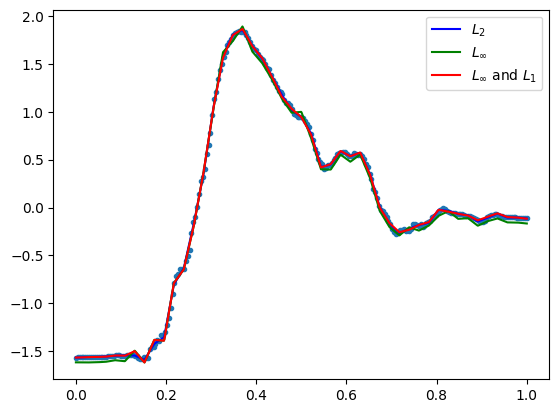

            max_dist       MSE      RMSE       MAE
LSQ         0.049320  0.000152  0.012347  0.008408
Max         0.036785  0.000877  0.029622  0.027546
Max and L1  0.036786  0.000173  0.013152  0.008028 

opt distance 0.03678541670892826
number of data points: 239


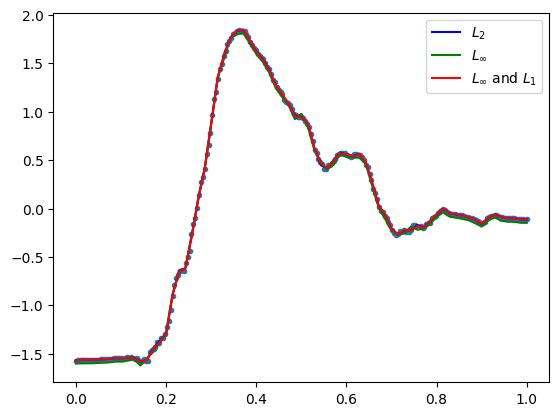

            max_dist       MSE      RMSE       MAE
LSQ         0.045796  0.000105  0.010234  0.006916
Max         0.032178  0.000682  0.026110  0.023931
Max and L1  0.032179  0.000135  0.011639  0.006614 

opt distance 0.03217804703421245
number of data points: 239


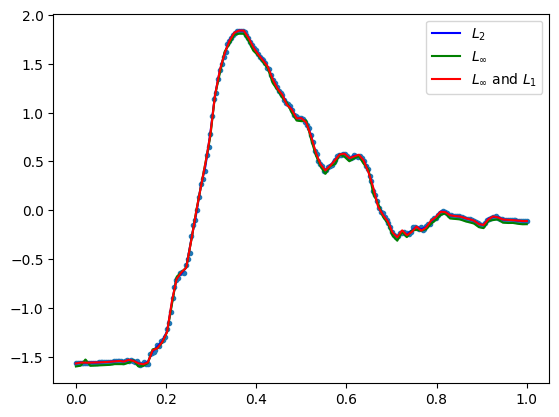

            max_dist       MSE      RMSE       MAE
LSQ         0.035072  0.000081  0.008975  0.005760
Max         0.027735  0.000579  0.024056  0.022745
Max and L1  0.027736  0.000106  0.010274  0.005512 

opt distance 0.027734527224567818
number of data points: 239


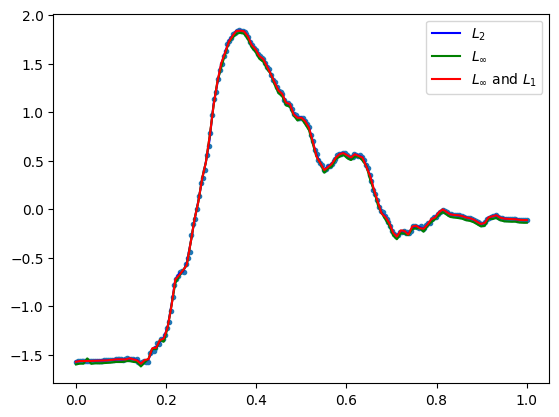

GestureMidAirD3 no. 165 len(ts): 180 ts processed: 79.33 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.095054  0.000804  0.028355  0.019797
Max         0.076167  0.002793  0.052850  0.048068
Max and L1  0.076168  0.001130  0.033618  0.023584 
opt distance 0.07616729830309243
number of data points: 180


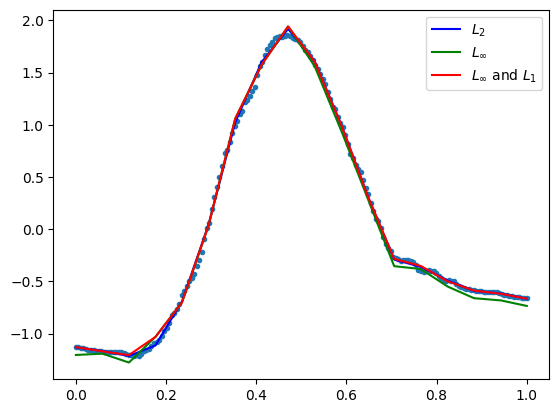

            max_dist       MSE      RMSE       MAE
LSQ         0.042952  0.000188  0.013718  0.009921
Max         0.034022  0.000640  0.025296  0.022570
Max and L1  0.034023  0.000245  0.015659  0.010732 

opt distance 0.034021652687392503
number of data points: 180


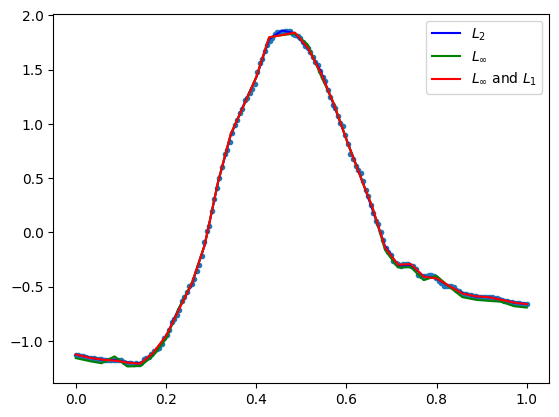

            max_dist       MSE      RMSE       MAE
LSQ         0.035716  0.000102  0.010108  0.006997
Max         0.024627  0.000380  0.019484  0.017951
Max and L1  0.024628  0.000125  0.011170  0.007577 

opt distance 0.024627017359814856
number of data points: 180


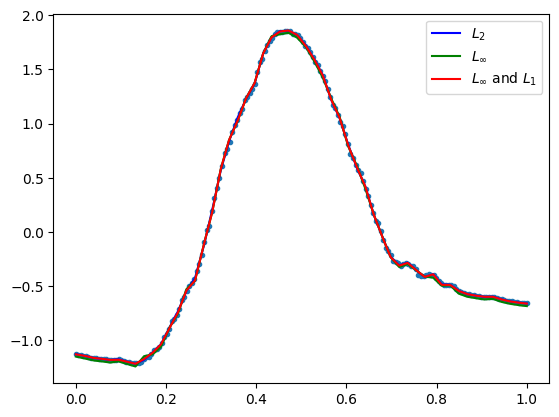

            max_dist       MSE      RMSE       MAE
LSQ         0.033760  0.000059  0.007680  0.005257
Max         0.022916  0.000353  0.018790  0.017304
Max and L1  0.022917  0.000073  0.008569  0.004949 

opt distance 0.02291588124883836
number of data points: 180


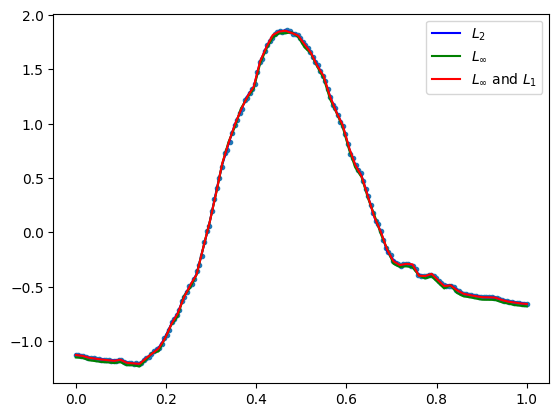

            max_dist       MSE      RMSE       MAE
LSQ         0.034801  0.000047  0.006826  0.004590
Max         0.022677  0.000388  0.019693  0.018735
Max and L1  0.022678  0.000075  0.008663  0.004897 

opt distance 0.022676621190863815
number of data points: 180


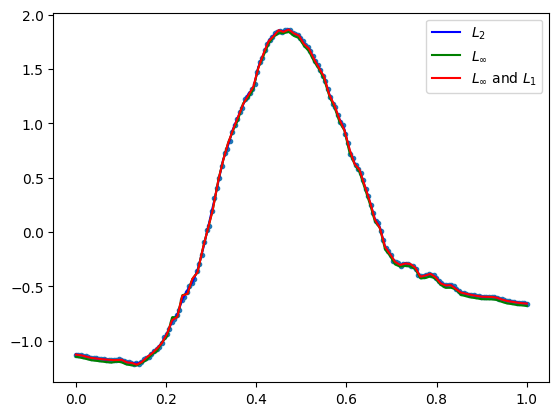

GestureMidAirD3 no. 166 len(ts): 171 ts processed: 79.81 %
[17, 34, 51, 68, 85]
            max_dist       MSE      RMSE       MAE
LSQ         0.540468  0.018374  0.135552  0.066777
Max         0.451038  0.142473  0.377456  0.351720
Max and L1  0.451039  0.029561  0.171932  0.096983 

opt distance 0.4510381101975185
number of data points: 171


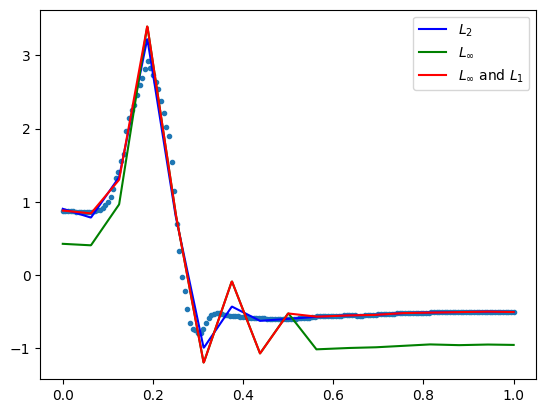

            max_dist       MSE      RMSE       MAE
LSQ         0.145611  0.000831  0.028821  0.012484
Max         0.121523  0.011144  0.105564  0.099727
Max and L1  0.121524  0.000918  0.030304  0.012436 

opt distance 0.12152275135166127
number of data points: 171


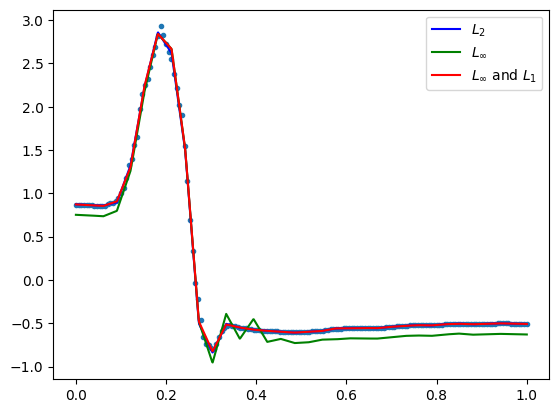

            max_dist       MSE      RMSE       MAE
LSQ         0.114298  0.000407  0.020173  0.008341
Max         0.087524  0.006176  0.078588  0.075161
Max and L1  0.087525  0.000608  0.024662  0.010250 

opt distance 0.08752374780058698
number of data points: 171


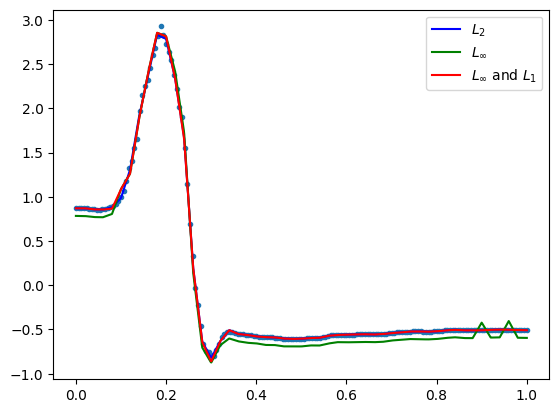

            max_dist       MSE      RMSE       MAE
LSQ         0.086674  0.000180  0.013415  0.005458
Max         0.060860  0.003261  0.057108  0.055955
Max and L1  0.060861  0.000263  0.016226  0.006166 

opt distance 0.06085975660982156
number of data points: 171


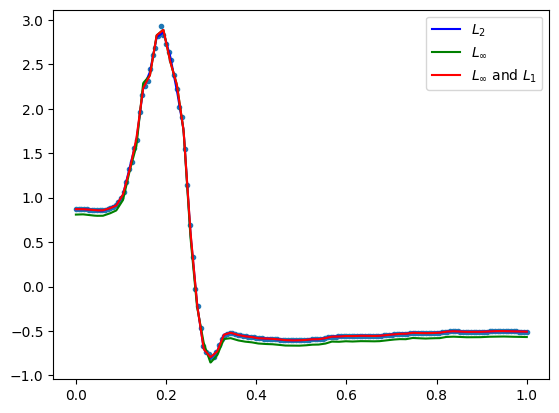

            max_dist       MSE      RMSE       MAE
LSQ         0.062837  0.000098  0.009902  0.004105
Max         0.045398  0.001841  0.042911  0.041786
Max and L1  0.045399  0.000166  0.012902  0.004869 

opt distance 0.045397877044420415
number of data points: 171


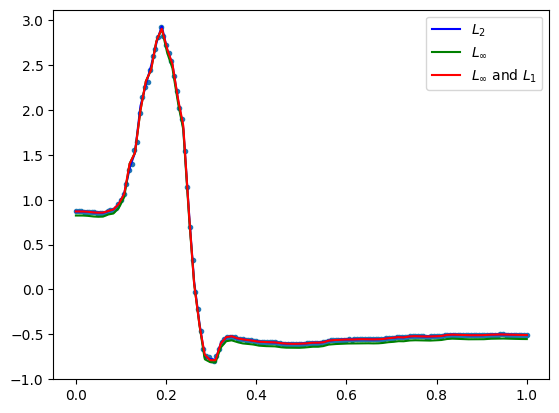

GestureMidAirD3 no. 167 len(ts): 360 ts processed: 80.28999999999999 %
[36, 72, 108, 144, 180]
            max_dist       MSE      RMSE       MAE
LSQ         0.096915  0.000521  0.022825  0.017252
Max         0.058897  0.001713  0.041389  0.037724
Max and L1  0.058898  0.000623  0.024957  0.018366 

opt distance 0.05889675441368587
number of data points: 360


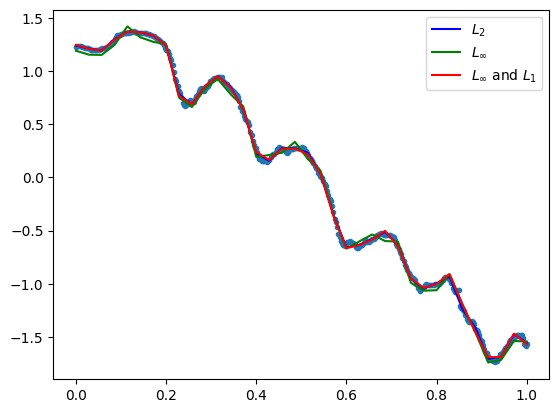

            max_dist       MSE      RMSE       MAE
LSQ         0.072665  0.000111  0.010542  0.007283
Max         0.049562  0.001630  0.040375  0.038510
Max and L1  0.049563  0.000155  0.012438  0.007750 

opt distance 0.04956247575620692
number of data points: 360


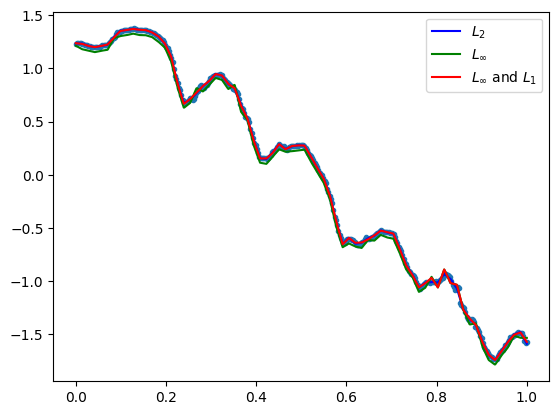

            max_dist       MSE      RMSE       MAE
LSQ         0.061393  0.000066  0.008148  0.005188
Max         0.049460  0.001771  0.042088  0.040387
Max and L1  0.049461  0.000108  0.010381  0.005470 
opt distance 0.04945984286083598
number of data points: 360


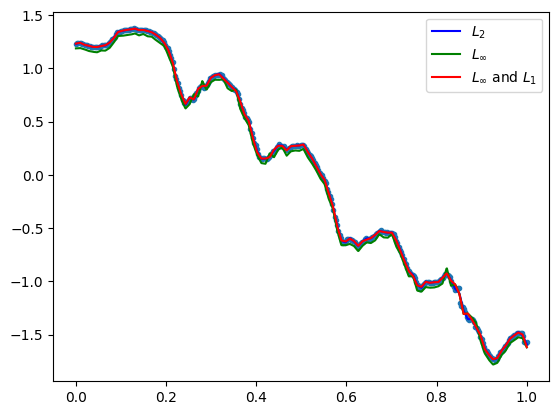

            max_dist       MSE      RMSE       MAE
LSQ         0.057606  0.000038  0.006127  0.003877
Max         0.036313  0.001018  0.031902  0.030990
Max and L1  0.036314  0.000058  0.007590  0.003775 
opt distance 0.03631331621174039
number of data points: 360


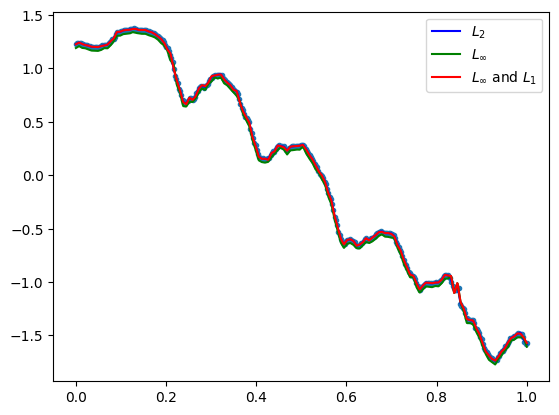

            max_dist       MSE      RMSE       MAE
LSQ         0.037637  0.000022  0.004735  0.003131
Max         0.026603  0.000560  0.023664  0.022897
Max and L1  0.026604  0.000035  0.005900  0.002952 
opt distance 0.0266029368633387
number of data points: 360


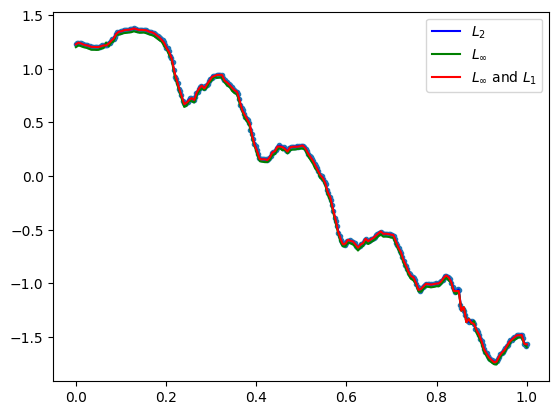

GestureMidAirD3 no. 168 len(ts): 169 ts processed: 80.77 %
[16, 33, 50, 67, 84]
            max_dist       MSE      RMSE       MAE
LSQ         0.093150  0.001118  0.033440  0.026126
Max         0.085208  0.003179  0.056379  0.050471
Max and L1  0.085209  0.001816  0.042616  0.033119 

opt distance 0.0852076421323471
number of data points: 169


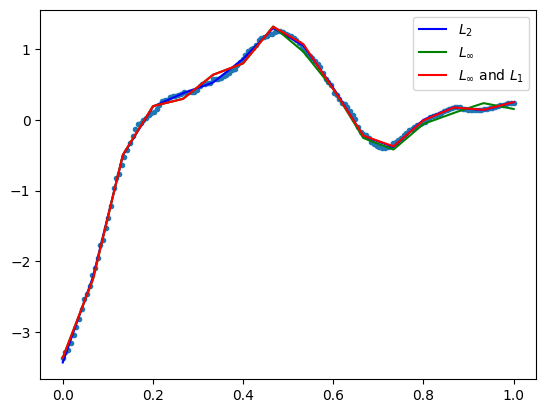

            max_dist       MSE      RMSE       MAE
LSQ         0.083117  0.000311  0.017639  0.012670
Max         0.059871  0.001964  0.044316  0.040971
Max and L1  0.059872  0.000448  0.021157  0.013993 

opt distance 0.05987126393462563
number of data points: 169


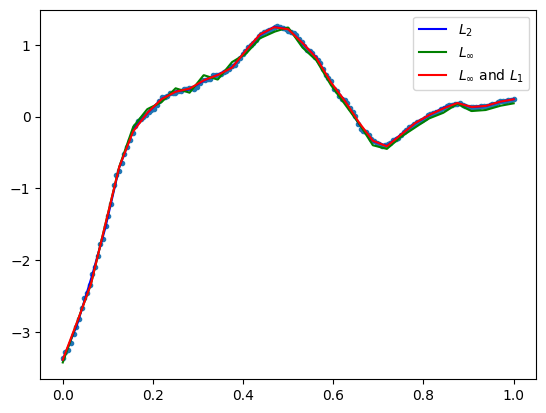

            max_dist       MSE      RMSE       MAE
LSQ         0.068762  0.000172  0.013117  0.008725
Max         0.050696  0.001712  0.041372  0.038819
Max and L1  0.050697  0.000232  0.015223  0.009246 

opt distance 0.050696214329703046
number of data points: 169


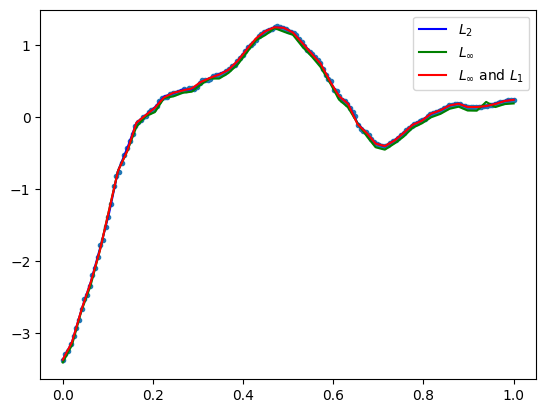

            max_dist       MSE      RMSE       MAE
LSQ         0.057504  0.000133  0.011512  0.007522
Max         0.043029  0.001278  0.035753  0.033658
Max and L1  0.043030  0.000177  0.013308  0.007450 

opt distance 0.04302937488190306
number of data points: 169


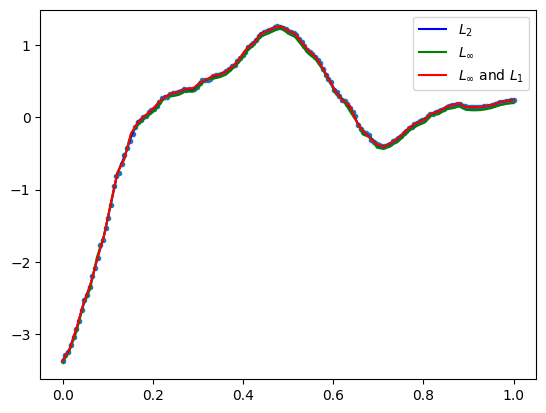

            max_dist       MSE      RMSE       MAE
LSQ         0.046851  0.000087  0.009343  0.005911
Max         0.035370  0.000959  0.030967  0.029646
Max and L1  0.035371  0.000112  0.010597  0.005517 

opt distance 0.035370390335840184
number of data points: 169


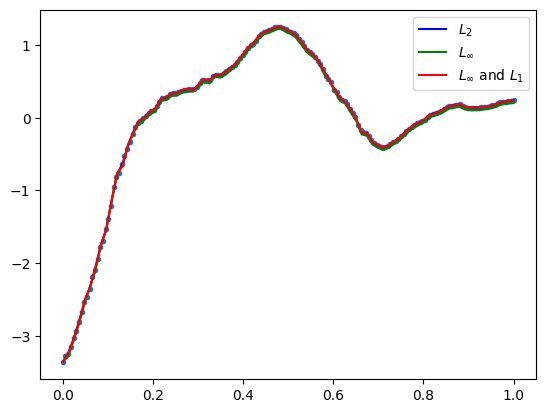

GestureMidAirD3 no. 169 len(ts): 240 ts processed: 81.25 %
[24, 48, 72, 96, 120]
            max_dist       MSE      RMSE       MAE
LSQ         0.214404  0.003539  0.059487  0.043283
Max         0.172769  0.014509  0.120455  0.109073
Max and L1  0.172770  0.005594  0.074796  0.053904 
opt distance 0.17276928253496007
number of data points: 240


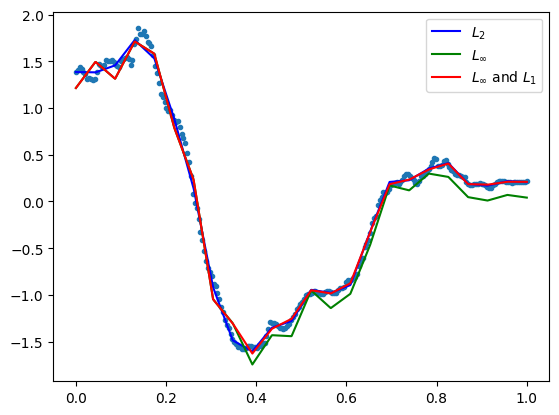

            max_dist       MSE      RMSE       MAE
LSQ         0.119583  0.000699  0.026435  0.019239
Max         0.092738  0.004748  0.068905  0.062676
Max and L1  0.092739  0.000943  0.030701  0.020436 

opt distance 0.09273751376759679
number of data points: 240


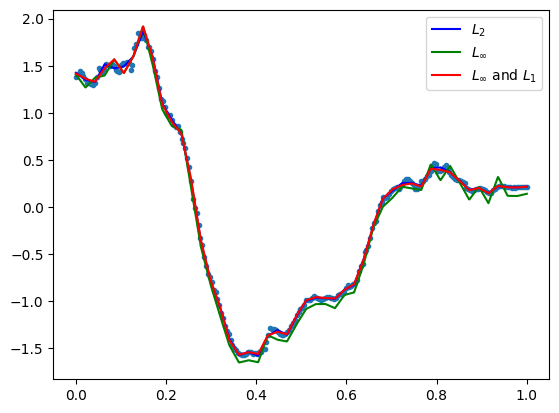

            max_dist       MSE      RMSE       MAE
LSQ         0.082097  0.000357  0.018907  0.013310
Max         0.065616  0.002794  0.052858  0.049685
Max and L1  0.065617  0.000462  0.021501  0.013335 

opt distance 0.06561579663955255
number of data points: 240


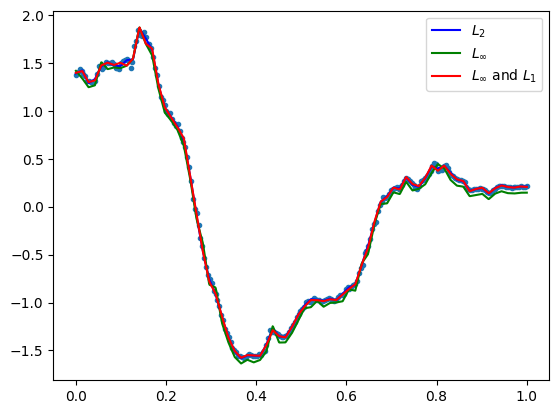

            max_dist       MSE      RMSE       MAE
LSQ         0.061900  0.000184  0.013553  0.009371
Max         0.045847  0.001397  0.037370  0.034695
Max and L1  0.045848  0.000222  0.014911  0.008835 

opt distance 0.04584707824435586
number of data points: 240


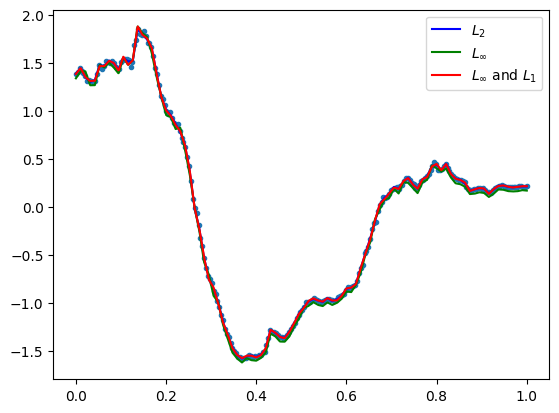

            max_dist       MSE      RMSE       MAE
LSQ         0.050086  0.000115  0.010745  0.007064
Max         0.042927  0.001388  0.037262  0.035478
Max and L1  0.042928  0.000165  0.012851  0.006754 

opt distance 0.04292693279928863
number of data points: 240


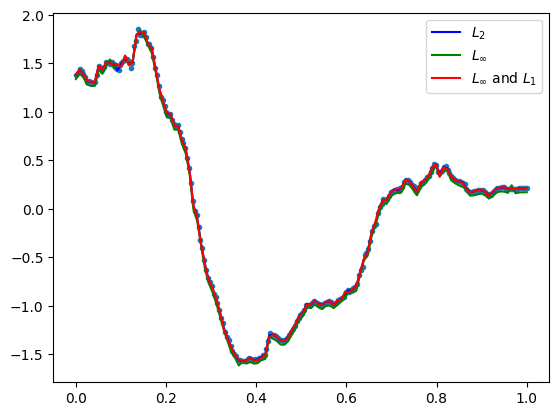

GestureMidAirD3 no. 170 len(ts): 120 ts processed: 81.73 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.107722  0.001328  0.036446  0.028001
Max         0.084199  0.002930  0.054125  0.047033
Max and L1  0.084200  0.002126  0.046114  0.037580 

opt distance 0.08419904734976666
number of data points: 120


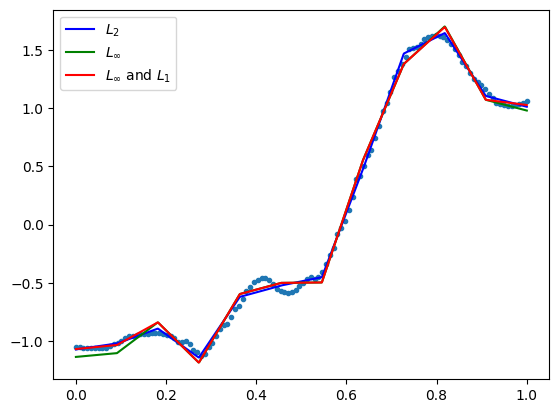

            max_dist       MSE      RMSE       MAE
LSQ         0.061428  0.000392  0.019797  0.014558
Max         0.044679  0.001073  0.032754  0.029622
Max and L1  0.044680  0.000510  0.022588  0.016608 

opt distance 0.04467874137234136
number of data points: 120


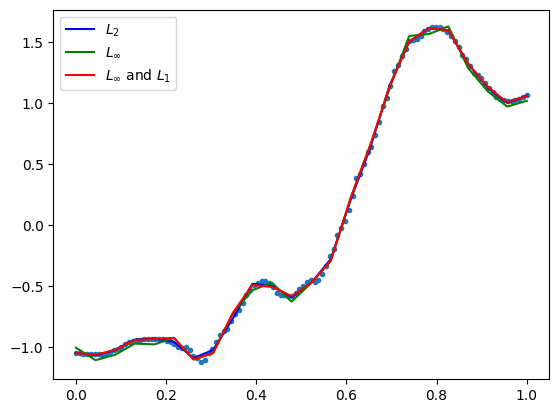

            max_dist       MSE      RMSE       MAE
LSQ         0.040479  0.000109  0.010462  0.007581
Max         0.031554  0.000579  0.024053  0.021648
Max and L1  0.031555  0.000150  0.012261  0.007762 

opt distance 0.031553971687372104
number of data points: 120


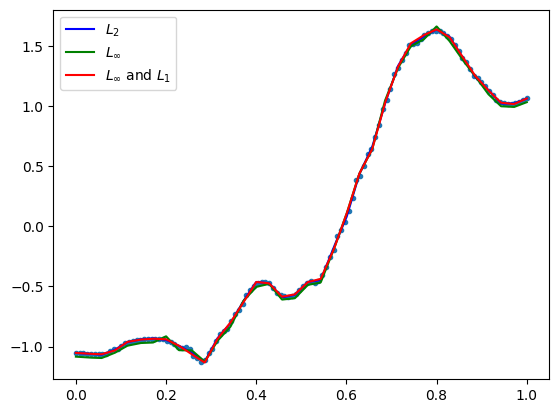

            max_dist       MSE      RMSE       MAE
LSQ         0.038194  0.000082  0.009031  0.006035
Max         0.026006  0.000468  0.021624  0.020262
Max and L1  0.026007  0.000102  0.010112  0.005942 

opt distance 0.02600647055982741
number of data points: 120


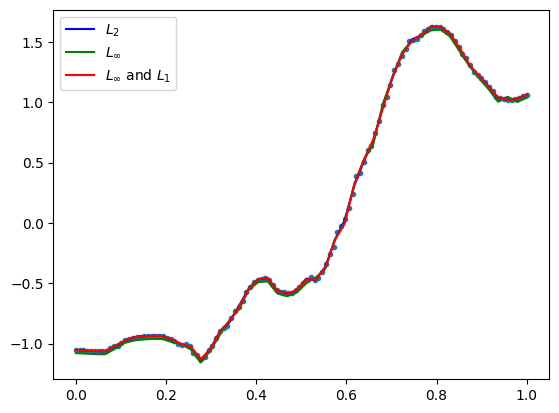

            max_dist       MSE      RMSE       MAE
LSQ         0.038555  0.000071  0.008416  0.005553
Max         0.027267  0.000554  0.023531  0.022147
Max and L1  0.027268  0.000103  0.010144  0.005538 

opt distance 0.027266953852775222
number of data points: 120


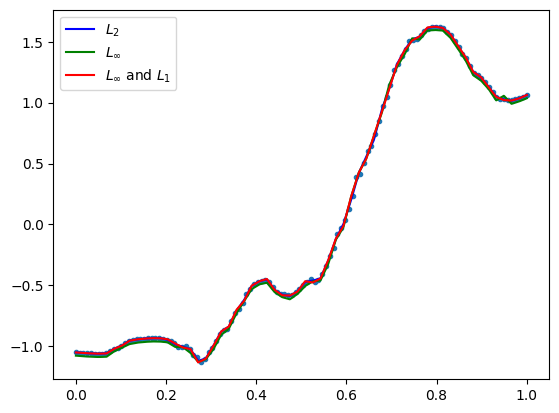

GestureMidAirD3 no. 171 len(ts): 172 ts processed: 82.21000000000001 %
[17, 34, 51, 68, 86]
            max_dist       MSE      RMSE       MAE
LSQ         0.142123  0.001455  0.038141  0.026986
Max         0.120260  0.007979  0.089325  0.082745
Max and L1  0.120261  0.002150  0.046372  0.031179 

opt distance 0.12026016709889319
number of data points: 172


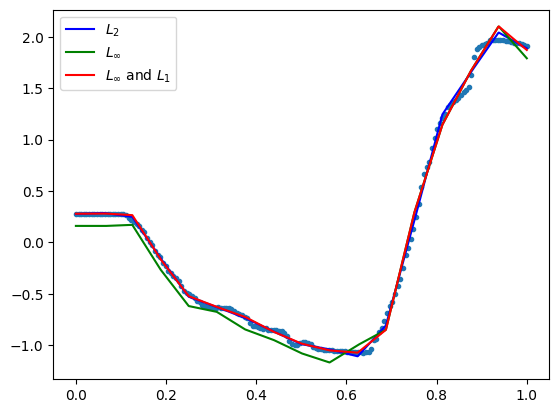

            max_dist       MSE      RMSE       MAE
LSQ         0.099003  0.000396  0.019896  0.011543
Max         0.081265  0.004325  0.065764  0.062253
Max and L1  0.081266  0.000580  0.024085  0.013387 

opt distance 0.08126502139426386
number of data points: 172


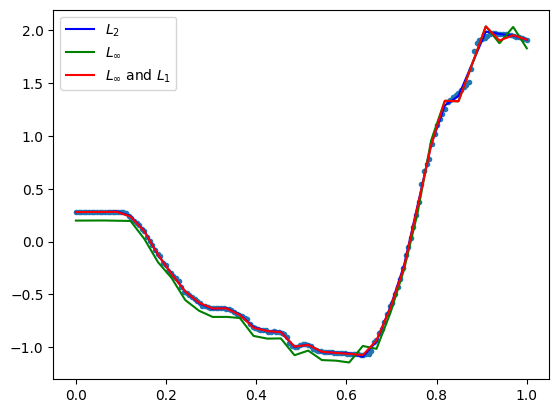

            max_dist       MSE      RMSE       MAE
LSQ         0.077684  0.000211  0.014524  0.007985
Max         0.061253  0.002766  0.052594  0.050119
Max and L1  0.061254  0.000323  0.017972  0.008852 

opt distance 0.06125319689119968
number of data points: 172


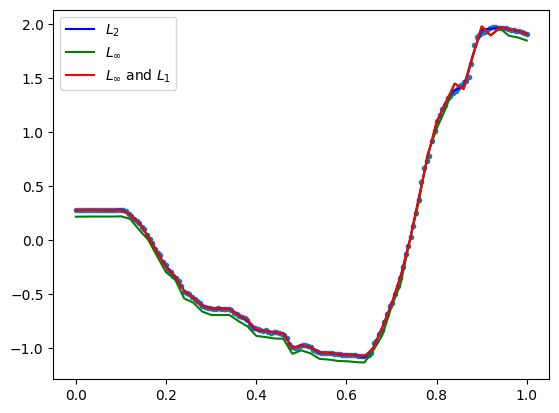

            max_dist       MSE      RMSE       MAE
LSQ         0.048979  0.000110  0.010467  0.005894
Max         0.039470  0.001159  0.034047  0.032395
Max and L1  0.039471  0.000158  0.012588  0.006313 

opt distance 0.039470428341907414
number of data points: 172


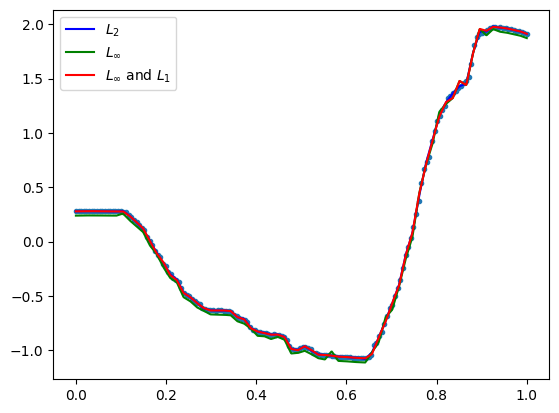

            max_dist       MSE      RMSE       MAE
LSQ         0.033665  0.000046  0.006781  0.003893
Max         0.025870  0.000531  0.023048  0.022126
Max and L1  0.025871  0.000072  0.008472  0.004235 

opt distance 0.02586994557544346
number of data points: 172


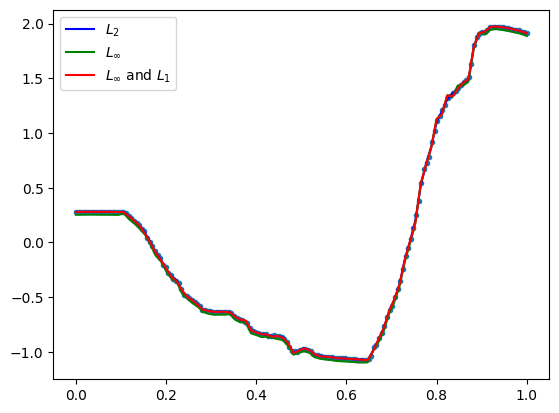

GestureMidAirD3 no. 172 len(ts): 180 ts processed: 82.69 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.045170  0.000182  0.013506  0.010497
Max         0.032859  0.000454  0.021299  0.018705
Max and L1  0.032860  0.000252  0.015870  0.012197 
opt distance 0.03285869873007974
number of data points: 180


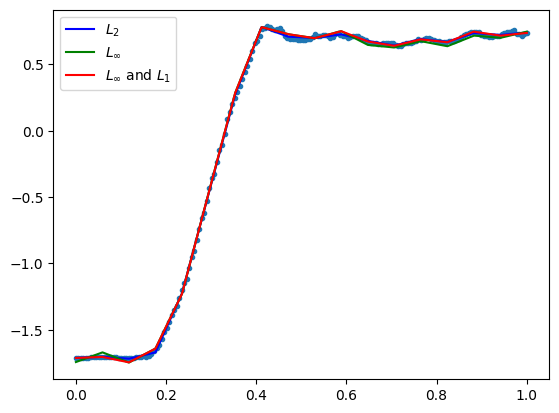

            max_dist       MSE      RMSE       MAE
LSQ         0.028704  0.000076  0.008696  0.006026
Max         0.022105  0.000264  0.016248  0.014837
Max and L1  0.022106  0.000083  0.009117  0.006079 

opt distance 0.022105102928284215
number of data points: 180


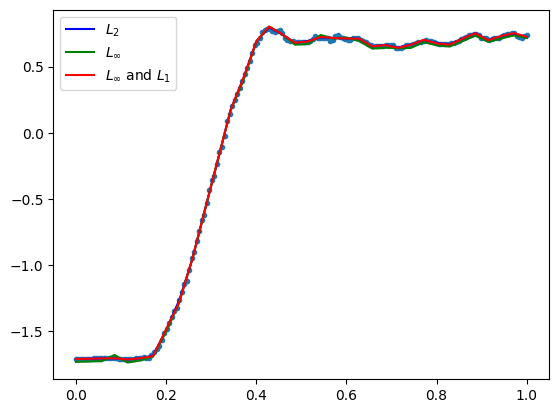

            max_dist       MSE      RMSE       MAE
LSQ         0.025418  0.000042  0.006492  0.004382
Max         0.020344  0.000279  0.016717  0.015780
Max and L1  0.020345  0.000050  0.007037  0.004219 

opt distance 0.020344015193536673
number of data points: 180


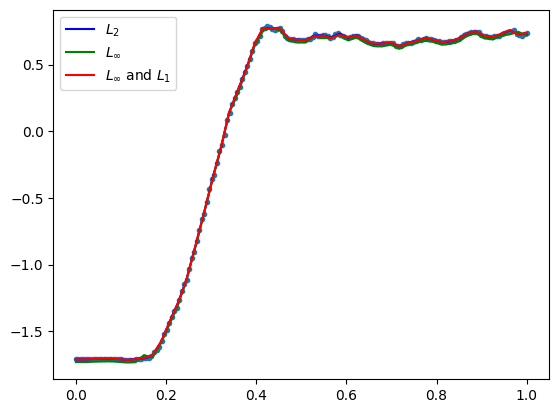

            max_dist       MSE      RMSE       MAE
LSQ         0.023420  0.000035  0.005936  0.003677
Max         0.018673  0.000253  0.015896  0.015027
Max and L1  0.018674  0.000041  0.006389  0.003593 

opt distance 0.018673203778453593
number of data points: 180


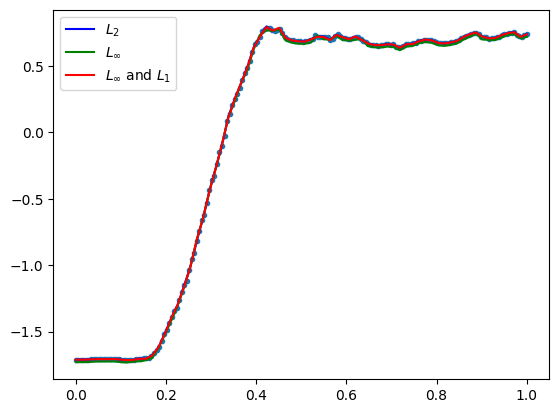

            max_dist       MSE      RMSE       MAE
LSQ         0.027044  0.000029  0.005374  0.003300
Max         0.019422  0.000295  0.017180  0.016490
Max and L1  0.019423  0.000042  0.006449  0.003301 

opt distance 0.01942207695865699
number of data points: 180


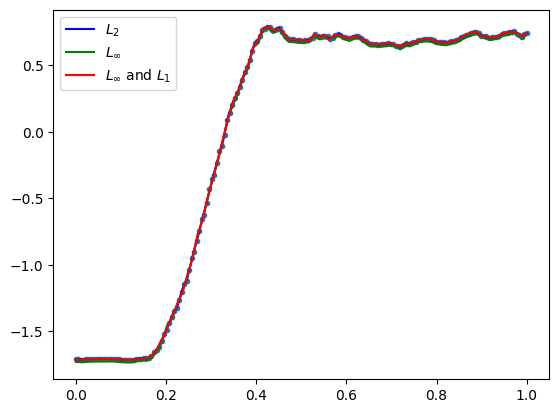

GestureMidAirD3 no. 173 len(ts): 239 ts processed: 83.17 %
[23, 47, 71, 95, 119]
            max_dist       MSE      RMSE       MAE
LSQ         0.145132  0.001682  0.041009  0.027125
Max         0.122844  0.009215  0.095995  0.089382
Max and L1  0.122845  0.002287  0.047823  0.031183 

opt distance 0.12284415200329114
number of data points: 239


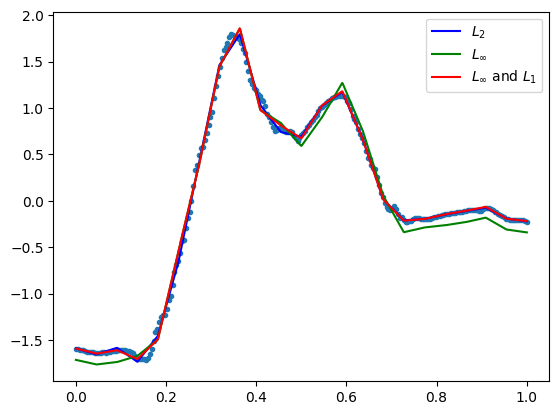

            max_dist       MSE      RMSE       MAE
LSQ         0.070465  0.000424  0.020584  0.013642
Max         0.062969  0.002457  0.049571  0.045870
Max and L1  0.062970  0.000514  0.022678  0.013941 

opt distance 0.06296930457686617
number of data points: 239


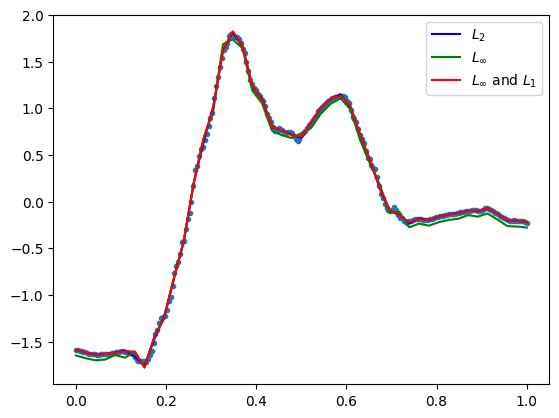

            max_dist       MSE      RMSE       MAE
LSQ         0.059452  0.000163  0.012762  0.008176
Max         0.041994  0.001211  0.034799  0.032593
Max and L1  0.041995  0.000198  0.014076  0.007829 

opt distance 0.04199358554698219
number of data points: 239


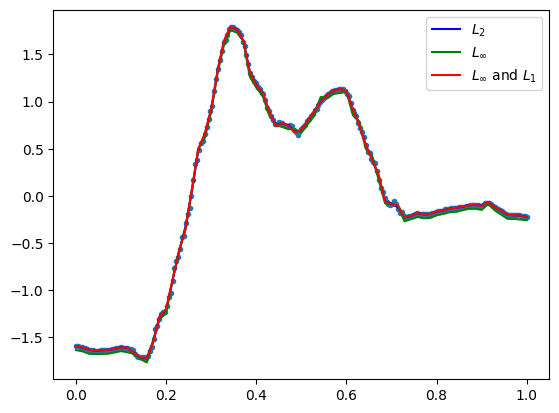

            max_dist       MSE      RMSE       MAE
LSQ         0.040892  0.000117  0.010797  0.006866
Max         0.032627  0.000756  0.027486  0.025828
Max and L1  0.032628  0.000142  0.011933  0.006688 

opt distance 0.03262660050062332
number of data points: 239


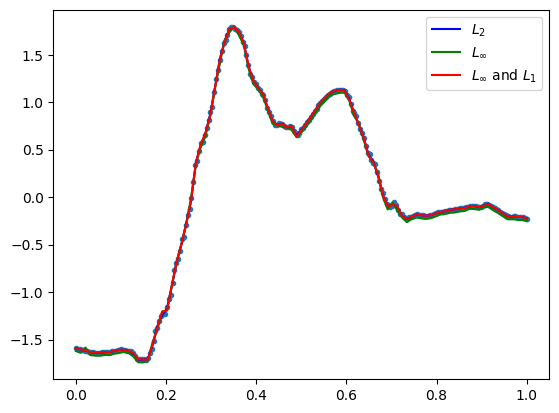

            max_dist       MSE      RMSE       MAE
LSQ         0.038894  0.000076  0.008709  0.005378
Max         0.029764  0.000687  0.026202  0.025021
Max and L1  0.029765  0.000111  0.010529  0.005489 
opt distance 0.029764300049238912
number of data points: 239


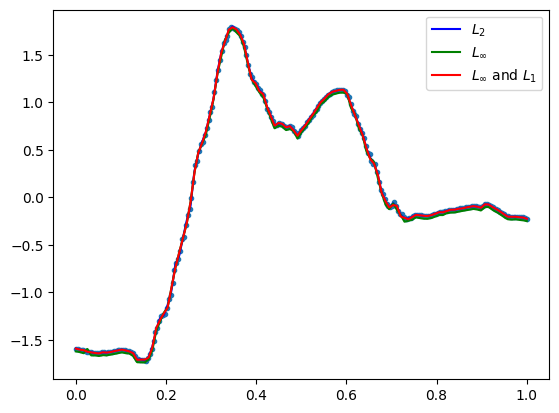

GestureMidAirD3 no. 174 len(ts): 89 ts processed: 83.65 %
[8, 17, 26, 35, 44]
            max_dist       MSE      RMSE       MAE
LSQ         0.293659  0.014556  0.120649  0.101082
Max         0.228457  0.022057  0.148517  0.128659
Max and L1  0.228458  0.015710  0.125339  0.103323 

opt distance 0.22845715060130053
number of data points: 89


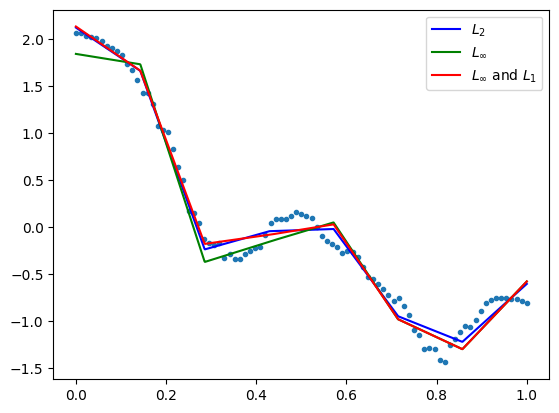

            max_dist       MSE      RMSE       MAE
LSQ         0.125979  0.001848  0.042993  0.031887
Max         0.105108  0.005105  0.071451  0.063276
Max and L1  0.105109  0.002550  0.050497  0.037329 

opt distance 0.10510778281296962
number of data points: 89


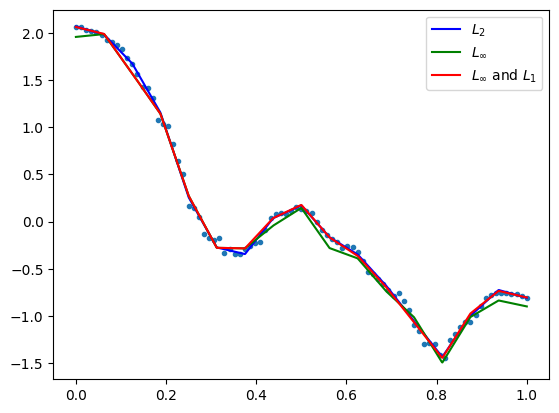

            max_dist       MSE      RMSE       MAE
LSQ         0.129325  0.001185  0.034430  0.023790
Max         0.089855  0.004753  0.068940  0.064063
Max and L1  0.089856  0.001686  0.041062  0.028849 

opt distance 0.08985458176494787
number of data points: 89


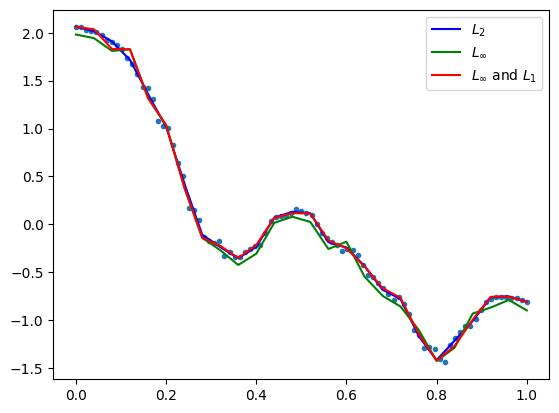

            max_dist       MSE      RMSE       MAE
LSQ         0.114851  0.000842  0.029012  0.020014
Max         0.078492  0.004099  0.064024  0.059791
Max and L1  0.078493  0.001017  0.031887  0.019194 

opt distance 0.07849245962261575
number of data points: 89


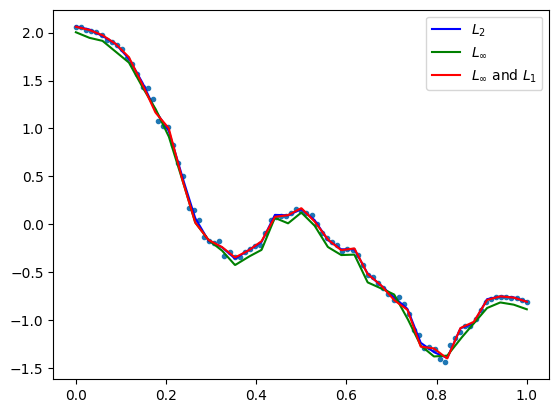

            max_dist       MSE      RMSE       MAE
LSQ         0.082821  0.000515  0.022702  0.016009
Max         0.061708  0.002642  0.051404  0.047574
Max and L1  0.061709  0.000672  0.025923  0.014986 

opt distance 0.06170824013714753
number of data points: 89


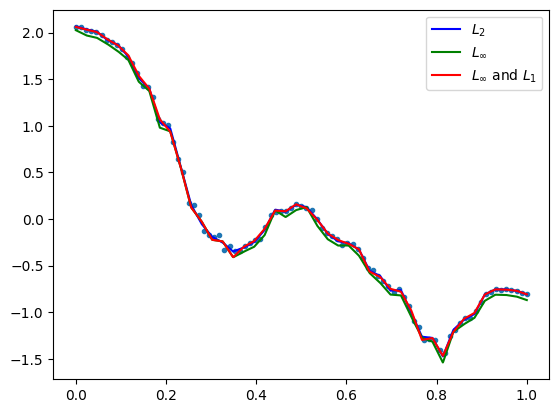

GestureMidAirD3 no. 175 len(ts): 180 ts processed: 84.13000000000001 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.095188  0.000595  0.024389  0.017808
Max         0.073095  0.002411  0.049106  0.043475
Max and L1  0.073096  0.000658  0.025657  0.017828 

opt distance 0.07309475059864601
number of data points: 180


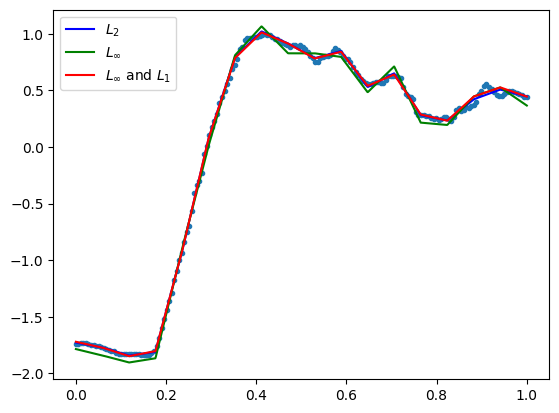

            max_dist       MSE      RMSE       MAE
LSQ         0.061039  0.000265  0.016274  0.012029
Max         0.050491  0.001341  0.036623  0.033217
Max and L1  0.050492  0.000324  0.017990  0.011955 

opt distance 0.050491311642019934
number of data points: 180


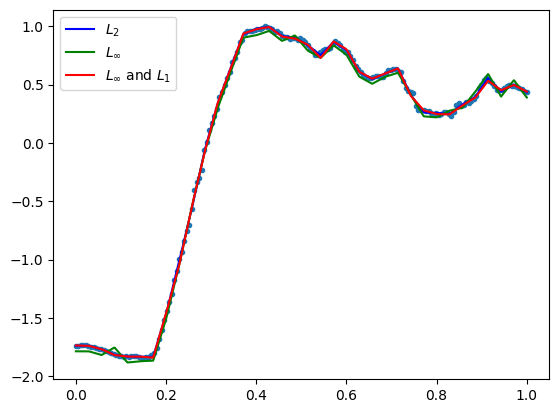

            max_dist       MSE      RMSE       MAE
LSQ         0.053036  0.000155  0.012455  0.008591
Max         0.039758  0.001023  0.031982  0.029918
Max and L1  0.039759  0.000194  0.013944  0.008373 

opt distance 0.03975767645592556
number of data points: 180


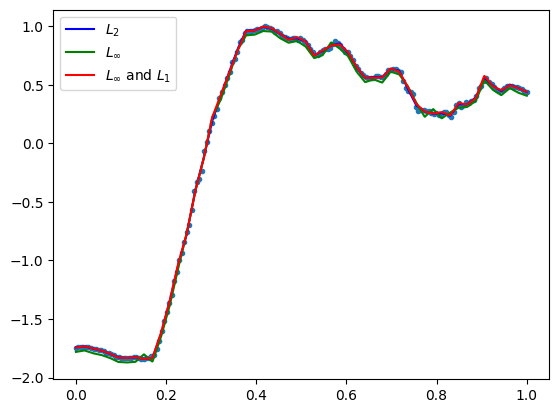

            max_dist       MSE      RMSE       MAE
LSQ         0.048433  0.000082  0.009072  0.005766
Max         0.036243  0.000925  0.030417  0.028907
Max and L1  0.036244  0.000129  0.011350  0.006184 

opt distance 0.03624335650812752
number of data points: 180


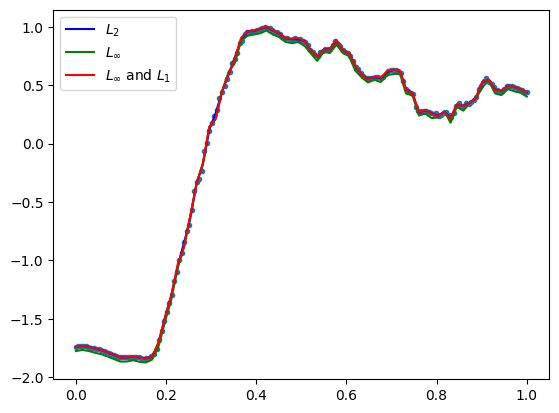

            max_dist       MSE      RMSE       MAE
LSQ         0.043050  0.000083  0.009122  0.005596
Max         0.030541  0.000719  0.026809  0.025649
Max and L1  0.030542  0.000116  0.010793  0.005748 

opt distance 0.03054146269915314
number of data points: 180


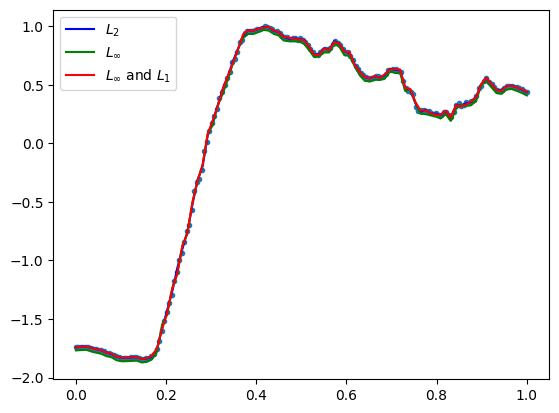

GestureMidAirD3 no. 176 len(ts): 141 ts processed: 84.61999999999999 %
[14, 28, 42, 56, 70]
            max_dist       MSE      RMSE       MAE
LSQ         0.080365  0.000472  0.021736  0.015246
Max         0.063694  0.001961  0.044280  0.040017
Max and L1  0.063695  0.000591  0.024314  0.016527 

opt distance 0.06369413567243931
number of data points: 141


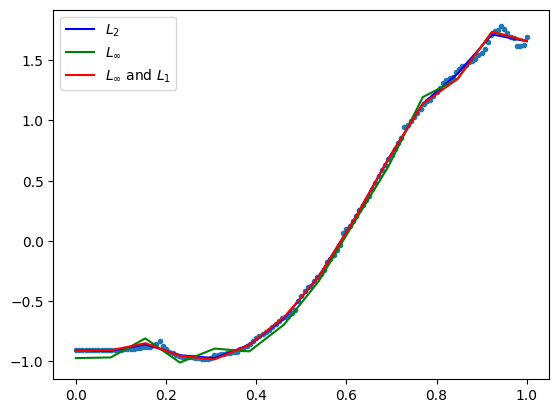

            max_dist       MSE      RMSE       MAE
LSQ         0.065835  0.000189  0.013764  0.008462
Max         0.045610  0.001318  0.036301  0.034115
Max and L1  0.045611  0.000296  0.017202  0.010511 

opt distance 0.045609880786927536
number of data points: 141


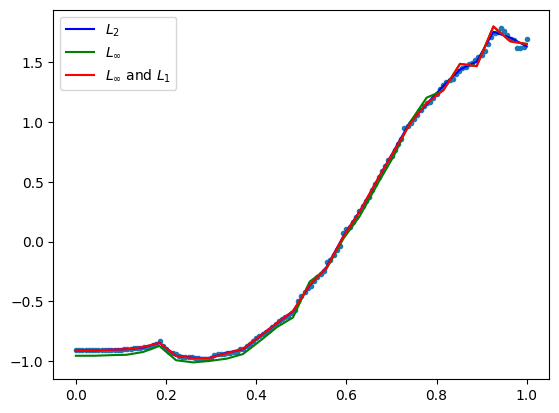

            max_dist       MSE      RMSE       MAE
LSQ         0.037680  0.000098  0.009887  0.006610
Max         0.029182  0.000546  0.023362  0.021839
Max and L1  0.029183  0.000133  0.011549  0.007253 

opt distance 0.029181698982034633
number of data points: 141


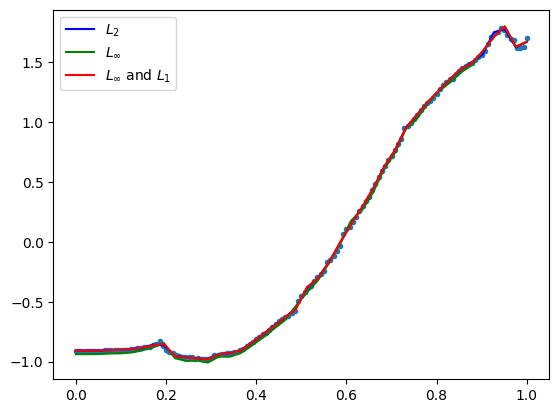

            max_dist       MSE      RMSE       MAE
LSQ         0.025402  0.000045  0.006713  0.004302
Max         0.019685  0.000255  0.015971  0.014743
Max and L1  0.019686  0.000054  0.007315  0.004117 
opt distance 0.019685220778349444
number of data points: 141


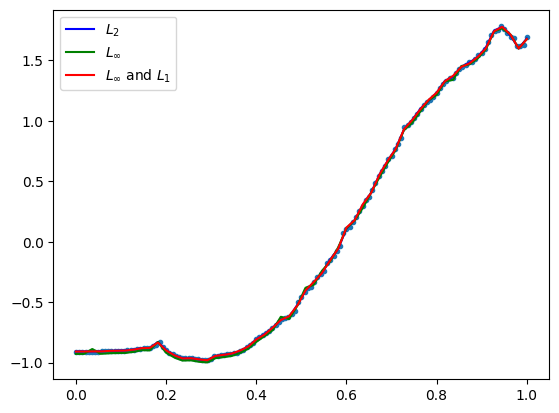

            max_dist       MSE      RMSE       MAE
LSQ         0.019893  0.000036  0.005995  0.003825
Max         0.015305  0.000185  0.013600  0.013020
Max and L1  0.015306  0.000044  0.006663  0.003968 

opt distance 0.015304674745024713
number of data points: 141


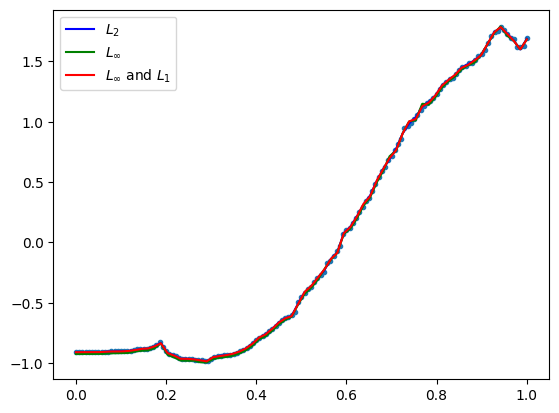

GestureMidAirD3 no. 177 len(ts): 173 ts processed: 85.1 %
[17, 34, 51, 69, 86]
            max_dist       MSE      RMSE       MAE
LSQ         0.077836  0.000322  0.017932  0.012617
Max         0.060768  0.002193  0.046832  0.043364
Max and L1  0.060769  0.000455  0.021326  0.014266 

opt distance 0.06076769510900118
number of data points: 173


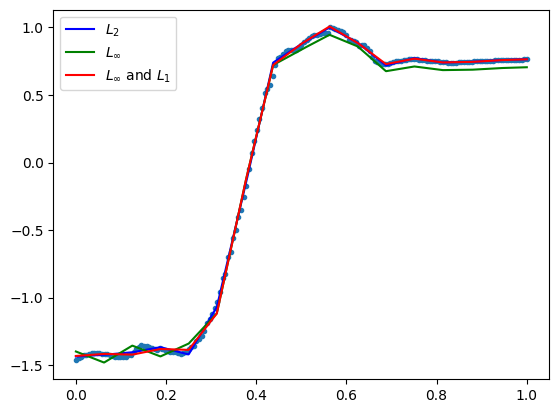

            max_dist       MSE      RMSE       MAE
LSQ         0.037982  0.000090  0.009467  0.006106
Max         0.031807  0.000659  0.025672  0.023850
Max and L1  0.031808  0.000109  0.010444  0.006253 

opt distance 0.03180712208244488
number of data points: 173


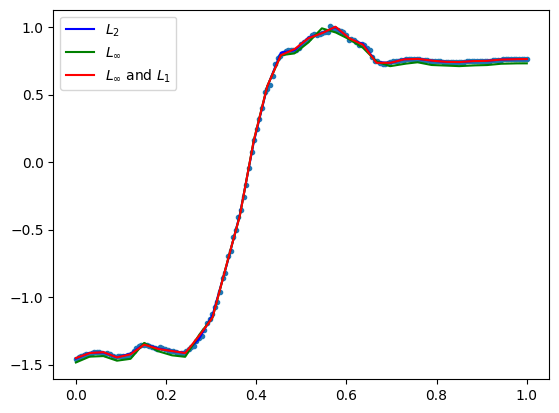

            max_dist       MSE      RMSE       MAE
LSQ         0.030671  0.000066  0.008136  0.004858
Max         0.025956  0.000485  0.022018  0.020849
Max and L1  0.025957  0.000077  0.008800  0.004730 

opt distance 0.025956124322766283
number of data points: 173


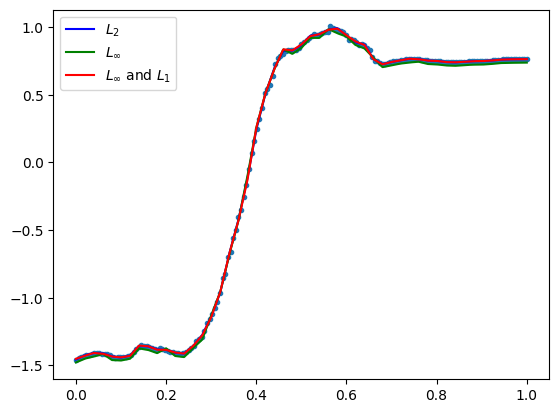

            max_dist       MSE      RMSE       MAE
LSQ         0.040425  0.000052  0.007210  0.003936
Max         0.027298  0.000595  0.024384  0.023615
Max and L1  0.027299  0.000070  0.008372  0.004120 

opt distance 0.027297752535610474
number of data points: 173


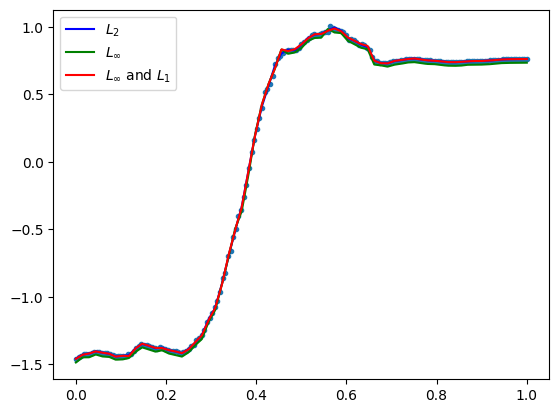

            max_dist       MSE      RMSE       MAE
LSQ         0.030822  0.000037  0.006049  0.003315
Max         0.021451  0.000383  0.019564  0.019018
Max and L1  0.021452  0.000048  0.006938  0.003248 

opt distance 0.021451413761073797
number of data points: 173


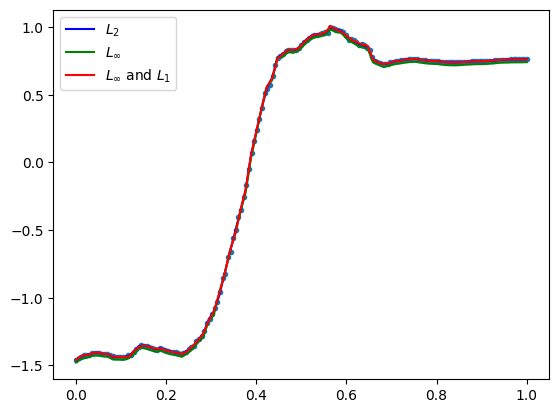

GestureMidAirD3 no. 178 len(ts): 87 ts processed: 85.58 %
[8, 17, 26, 34, 43]
            max_dist       MSE      RMSE       MAE
LSQ         0.427777  0.012562  0.112081  0.079201
Max         0.291468  0.033599  0.183301  0.161452
Max and L1  0.291469  0.024619  0.156905  0.127699 

opt distance 0.29146784504908607
number of data points: 87


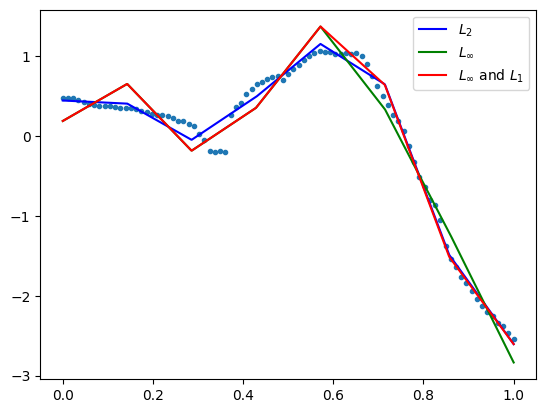

            max_dist       MSE      RMSE       MAE
LSQ         0.252846  0.003726  0.061037  0.039988
Max         0.195069  0.023254  0.152492  0.139158
Max and L1  0.195070  0.004534  0.067338  0.040705 

opt distance 0.1950689302499934
number of data points: 87


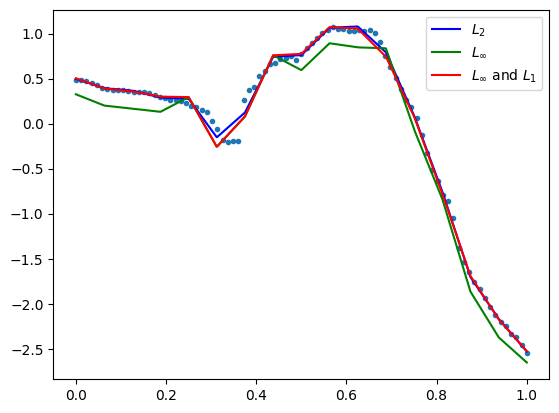

            max_dist       MSE      RMSE       MAE
LSQ         0.175870  0.001338  0.036577  0.023624
Max         0.125799  0.010685  0.103367  0.097528
Max and L1  0.125800  0.001693  0.041148  0.023832 

opt distance 0.1257985726588583
number of data points: 87


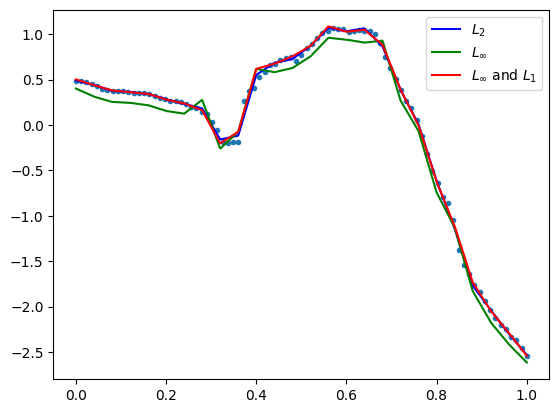

            max_dist       MSE      RMSE       MAE
LSQ         0.153584  0.000874  0.029561  0.015132
Max         0.128606  0.012994  0.113991  0.109440
Max and L1  0.128607  0.001800  0.042427  0.019790 

opt distance 0.12860586964895623
number of data points: 87


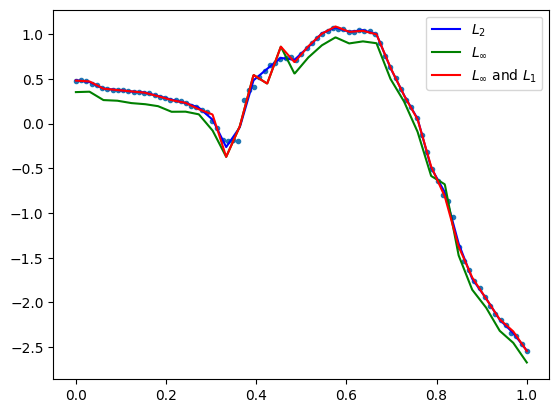

            max_dist       MSE      RMSE       MAE
LSQ         0.090537  0.000302  0.017370  0.010036
Max         0.066412  0.003420  0.058482  0.055995
Max and L1  0.066413  0.000496  0.022279  0.011379 

opt distance 0.06641168236741271
number of data points: 87


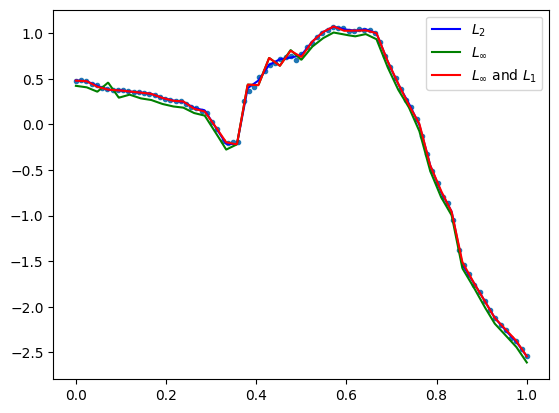

GestureMidAirD3 no. 179 len(ts): 180 ts processed: 86.06 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.060959  0.000328  0.018112  0.011298
Max         0.047000  0.001333  0.036516  0.033924
Max and L1  0.047001  0.000359  0.018952  0.012248 
opt distance 0.04699990824029854
number of data points: 180


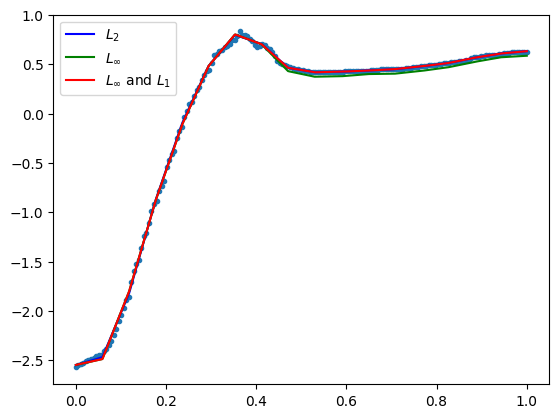

            max_dist       MSE      RMSE       MAE
LSQ         0.043812  0.000139  0.011769  0.006755
Max         0.039590  0.001137  0.033721  0.031850
Max and L1  0.039591  0.000150  0.012252  0.006610 

opt distance 0.03958979136649354
number of data points: 180


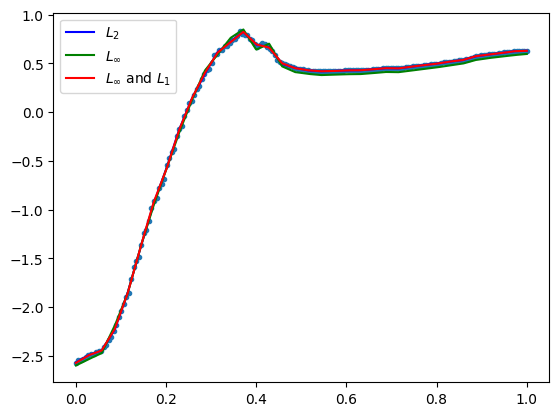

            max_dist       MSE      RMSE       MAE
LSQ         0.043498  0.000110  0.010501  0.005603
Max         0.036348  0.001001  0.031632  0.030099
Max and L1  0.036349  0.000124  0.011118  0.005348 

opt distance 0.03634757500198961
number of data points: 180


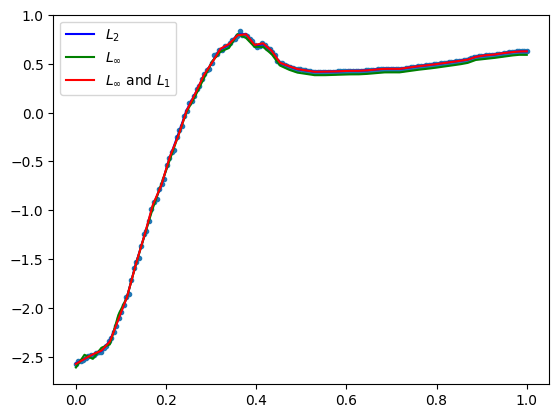

            max_dist       MSE      RMSE       MAE
LSQ         0.044952  0.000097  0.009854  0.005326
Max         0.032229  0.000822  0.028666  0.027406
Max and L1  0.032230  0.000112  0.010564  0.005181 

opt distance 0.03222911406237485
number of data points: 180


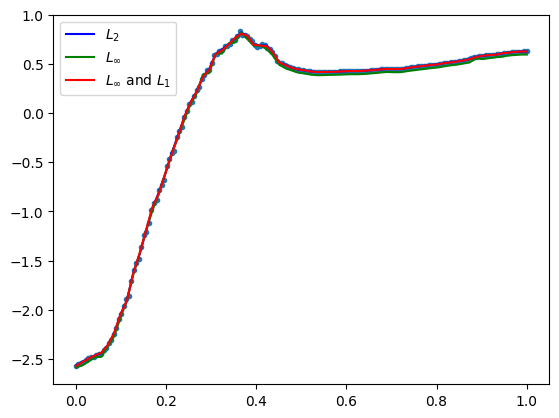

            max_dist       MSE      RMSE       MAE
LSQ         0.041768  0.000086  0.009294  0.004747
Max         0.032881  0.000905  0.030075  0.029018
Max and L1  0.032882  0.000117  0.010839  0.005002 

opt distance 0.03288078573226065
number of data points: 180


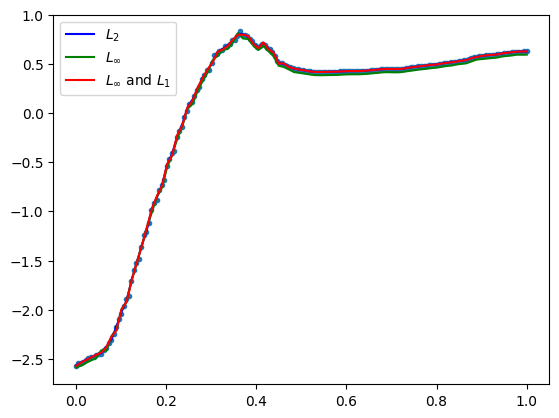

GestureMidAirD3 no. 180 len(ts): 80 ts processed: 86.53999999999999 %
[8, 16, 24, 32, 40]
            max_dist       MSE      RMSE       MAE
LSQ         0.378332  0.011218  0.105914  0.072380
Max         0.278103  0.034790  0.186521  0.164600
Max and L1  0.278104  0.024301  0.155887  0.125537 

opt distance 0.27810252337466773
number of data points: 80


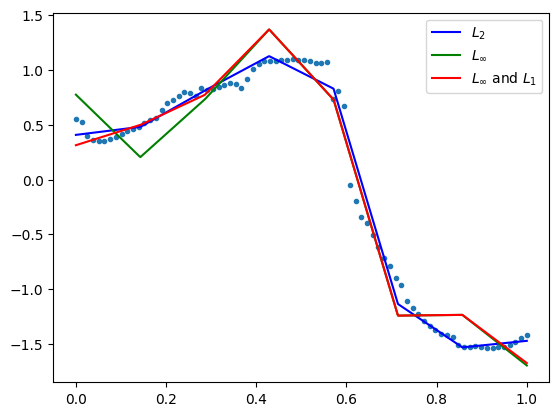

            max_dist       MSE      RMSE       MAE
LSQ         0.271638  0.005097  0.071395  0.041563
Max         0.251332  0.039306  0.198258  0.186578
Max and L1  0.251333  0.012033  0.109694  0.074407 

opt distance 0.25133248111709255
number of data points: 80


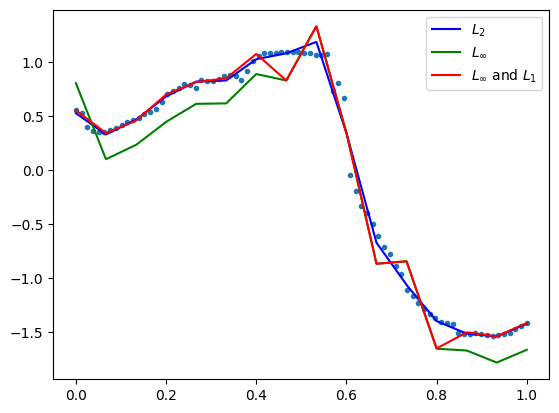

            max_dist       MSE      RMSE       MAE
LSQ         0.294684  0.002652  0.051500  0.023371
Max         0.228126  0.040867  0.202156  0.196248
Max and L1  0.228127  0.003006  0.054824  0.023207 

opt distance 0.22812632204536998
number of data points: 80


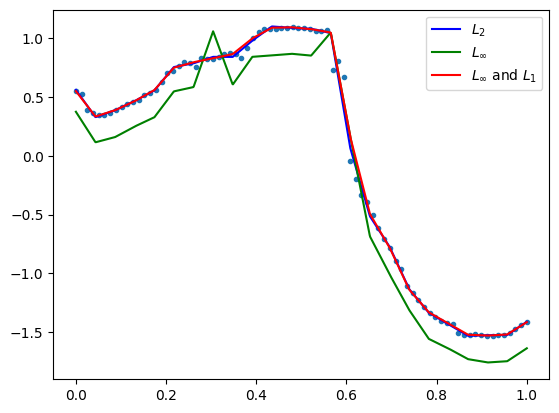

            max_dist       MSE      RMSE       MAE
LSQ         0.236972  0.001572  0.039644  0.017719
Max         0.173655  0.025660  0.160188  0.157231
Max and L1  0.173656  0.002288  0.047829  0.021720 

opt distance 0.17365528015331644
number of data points: 80


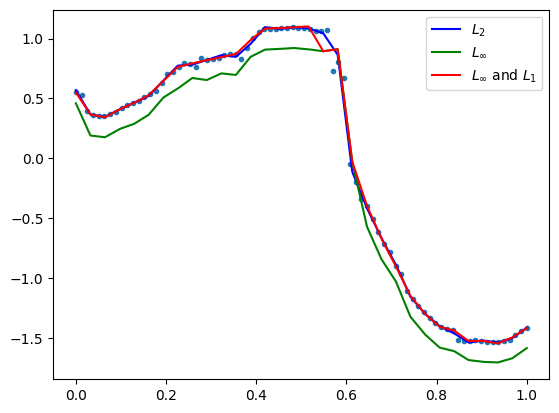

            max_dist       MSE      RMSE       MAE
LSQ         0.134669  0.000878  0.029635  0.014871
Max         0.104857  0.009015  0.094950  0.091532
Max and L1  0.104858  0.001314  0.036244  0.017545 

opt distance 0.10485716879788402
number of data points: 80


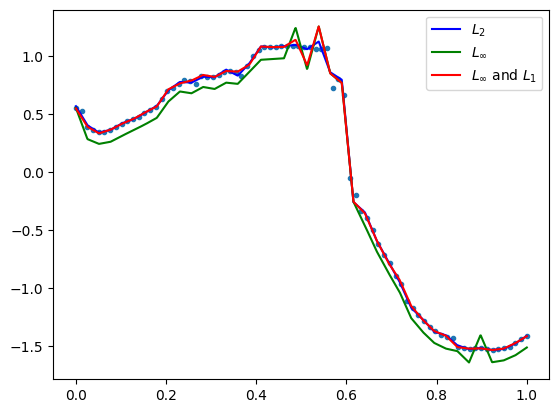

GestureMidAirD3 no. 181 len(ts): 240 ts processed: 87.02 %
[24, 48, 72, 96, 120]
            max_dist       MSE      RMSE       MAE
LSQ         0.310149  0.003678  0.060644  0.040639
Max         0.260757  0.038800  0.196978  0.183623
Max and L1  0.260758  0.005572  0.074644  0.046375 

opt distance 0.2607572326140459
number of data points: 240


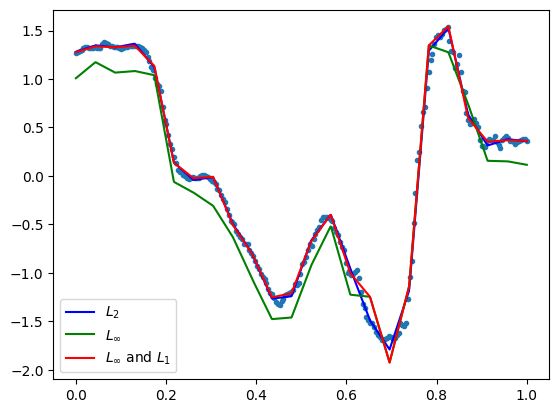

            max_dist       MSE      RMSE       MAE
LSQ         0.200234  0.001597  0.039962  0.024575
Max         0.143028  0.013950  0.118109  0.111989
Max and L1  0.143029  0.002107  0.045907  0.027244 

opt distance 0.143028274376275
number of data points: 240


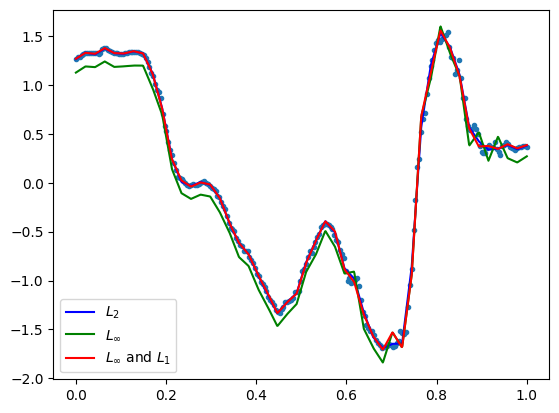

            max_dist       MSE      RMSE       MAE
LSQ         0.149471  0.000653  0.025545  0.015777
Max         0.113035  0.008717  0.093365  0.089019
Max and L1  0.113036  0.000946  0.030759  0.016639 

opt distance 0.11303487178290403
number of data points: 240


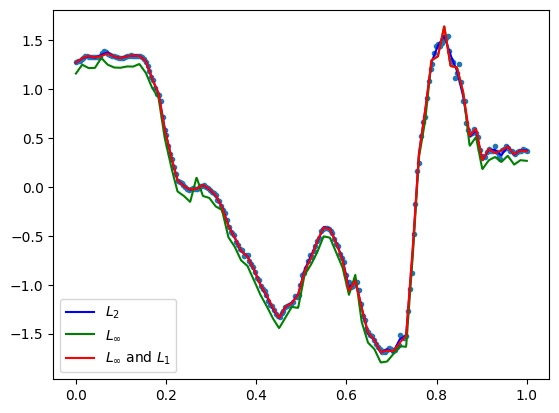

            max_dist       MSE      RMSE       MAE
LSQ         0.103280  0.000474  0.021781  0.013728
Max         0.083278  0.005036  0.070964  0.067515
Max and L1  0.083279  0.000639  0.025279  0.013419 

opt distance 0.0832776495504396
number of data points: 240


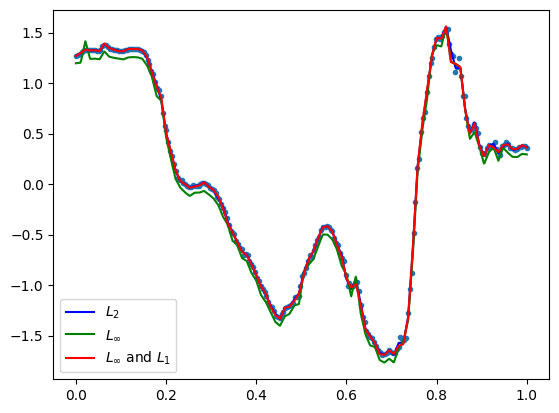

            max_dist       MSE      RMSE       MAE
LSQ         0.075794  0.000273  0.016530  0.010465
Max         0.053591  0.002145  0.046316  0.043952
Max and L1  0.053592  0.000384  0.019600  0.010776 

opt distance 0.05359120105916264
number of data points: 240


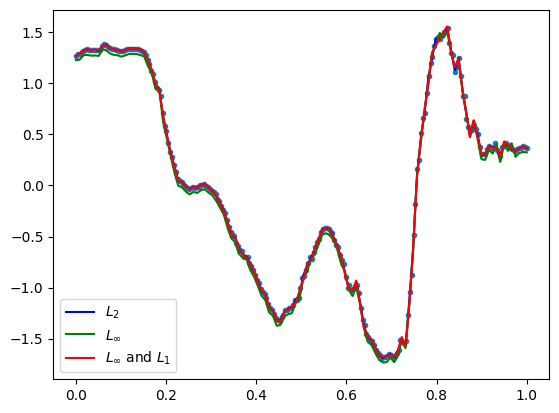

GestureMidAirD3 no. 182 len(ts): 180 ts processed: 87.5 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.038925  0.000123  0.011077  0.007769
Max         0.029877  0.000492  0.022187  0.020077
Max and L1  0.029878  0.000140  0.011811  0.008021 

opt distance 0.02987689728573767
number of data points: 180


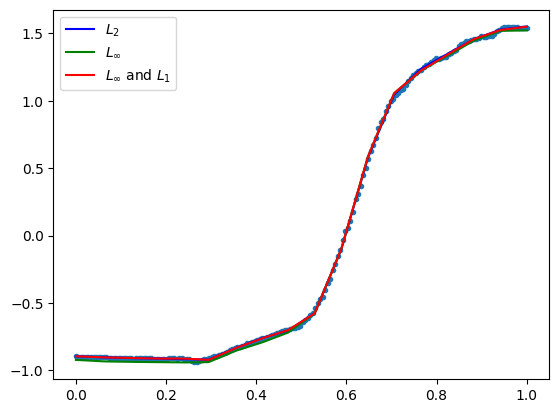

            max_dist       MSE      RMSE       MAE
LSQ         0.025116  0.000037  0.006123  0.004008
Max         0.022312  0.000294  0.017155  0.015865
Max and L1  0.022313  0.000052  0.007229  0.004422 

opt distance 0.02231160110133686
number of data points: 180


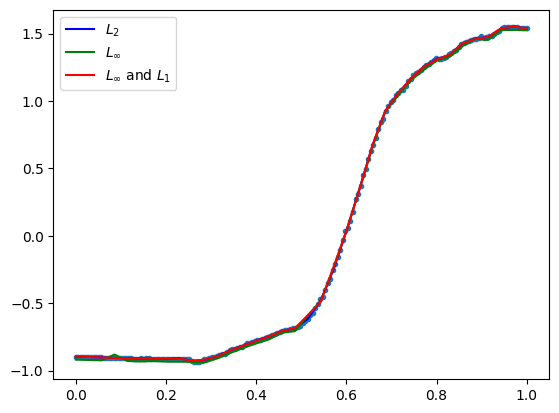

            max_dist       MSE      RMSE       MAE
LSQ         0.026102  0.000025  0.005049  0.003076
Max         0.020468  0.000294  0.017156  0.016218
Max and L1  0.020469  0.000031  0.005544  0.002967 

opt distance 0.02046844399446058
number of data points: 180


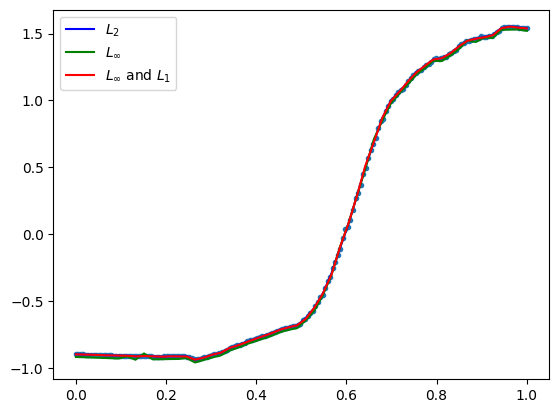

            max_dist       MSE      RMSE       MAE
LSQ         0.022633  0.000019  0.004358  0.002678
Max         0.015335  0.000172  0.013107  0.012537
Max and L1  0.015336  0.000025  0.004974  0.002717 

opt distance 0.015335105170024165
number of data points: 180


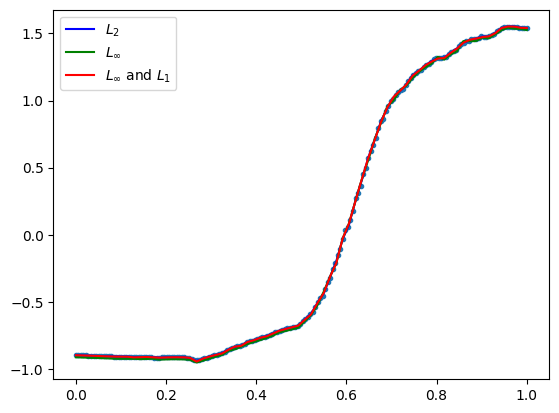

            max_dist       MSE      RMSE       MAE
LSQ         0.013139  0.000010  0.003178  0.001911
Max         0.009914  0.000077  0.008779  0.008479
Max and L1  0.009915  0.000013  0.003645  0.001964 

opt distance 0.009914051072042157
number of data points: 180


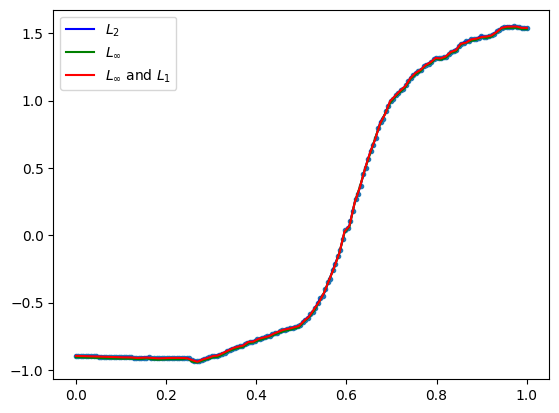

GestureMidAirD3 no. 183 len(ts): 119 ts processed: 87.98 %
[11, 23, 35, 47, 59]
            max_dist       MSE      RMSE       MAE
LSQ         0.363657  0.012566  0.112096  0.085334
Max         0.253288  0.033561  0.183197  0.168346
Max and L1  0.253289  0.016549  0.128641  0.097125 

opt distance 0.2532875653053944
number of data points: 119


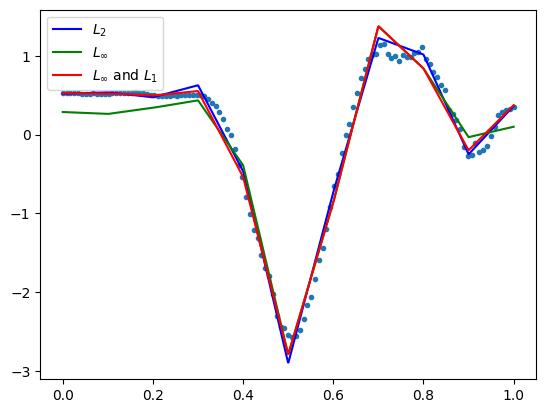

            max_dist       MSE      RMSE       MAE
LSQ         0.160936  0.002130  0.046149  0.030849
Max         0.109409  0.007182  0.084746  0.076702
Max and L1  0.109410  0.002469  0.049685  0.033391 

opt distance 0.10940879259627077
number of data points: 119


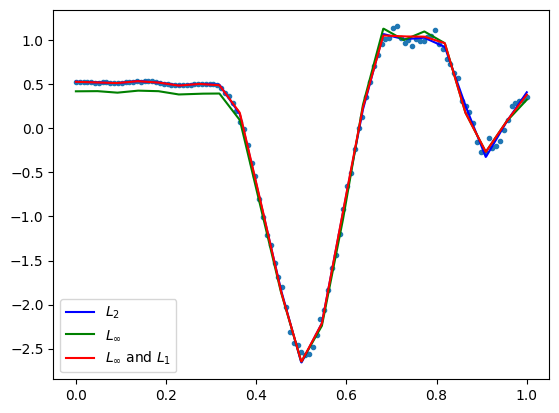

            max_dist       MSE      RMSE       MAE
LSQ         0.139210  0.001065  0.032629  0.020632
Max         0.108941  0.007952  0.089174  0.083033
Max and L1  0.108942  0.001465  0.038277  0.022319 

opt distance 0.10894103222743676
number of data points: 119


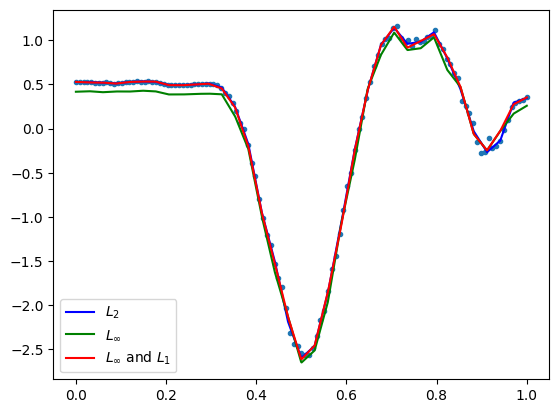

            max_dist       MSE      RMSE       MAE
LSQ         0.094015  0.000793  0.028165  0.018357
Max         0.075609  0.003782  0.061495  0.056448
Max and L1  0.075610  0.001141  0.033782  0.021217 

opt distance 0.07560946555307319
number of data points: 119


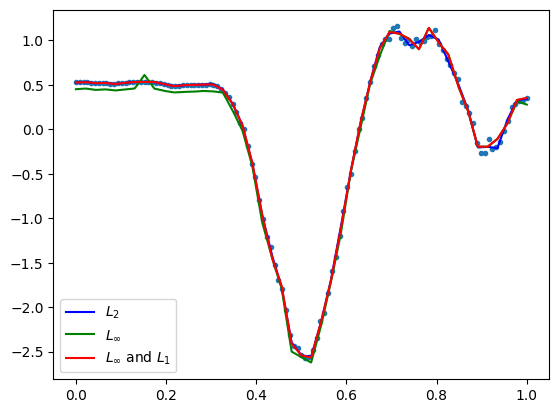

            max_dist       MSE      RMSE       MAE
LSQ         0.062325  0.000396  0.019907  0.013629
Max         0.044073  0.001461  0.038219  0.036259
Max and L1  0.044074  0.000495  0.022247  0.013871 

opt distance 0.044073443567646614
number of data points: 119


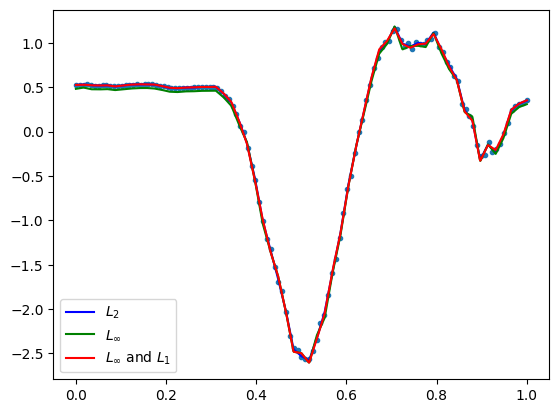

GestureMidAirD3 no. 184 len(ts): 90 ts processed: 88.46000000000001 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.493830  0.030529  0.174724  0.114956
Max         0.405975  0.099551  0.315517  0.296213
Max and L1  0.405976  0.039149  0.197862  0.135798 

opt distance 0.4059751409548489
number of data points: 90


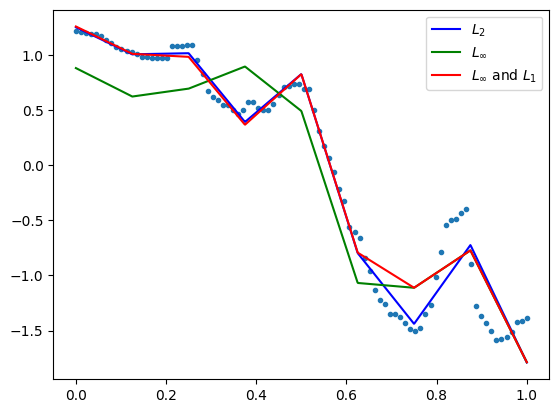

            max_dist       MSE      RMSE       MAE
LSQ         0.403137  0.006248  0.079045  0.050487
Max         0.290431  0.048738  0.220766  0.202273
Max and L1  0.290432  0.014529  0.120538  0.080722 

opt distance 0.2904308827923437
number of data points: 90


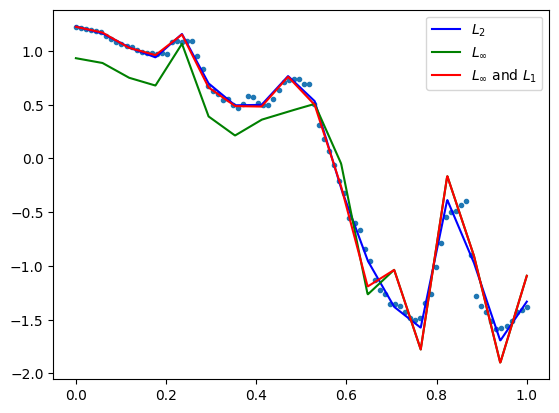

            max_dist       MSE      RMSE       MAE
LSQ         0.286581  0.002421  0.049208  0.028082
Max         0.209607  0.031317  0.176966  0.169014
Max and L1  0.209608  0.004317  0.065705  0.035735 

opt distance 0.20960716506080052
number of data points: 90


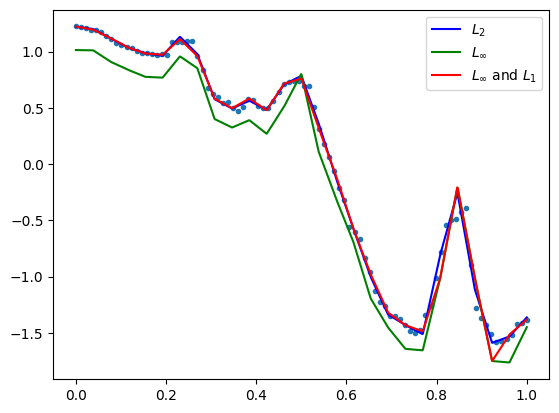

            max_dist       MSE      RMSE       MAE
LSQ         0.169683  0.001039  0.032239  0.019794
Max         0.119648  0.010031  0.100155  0.094945
Max and L1  0.119649  0.001849  0.043002  0.024290 

opt distance 0.11964756957698172
number of data points: 90


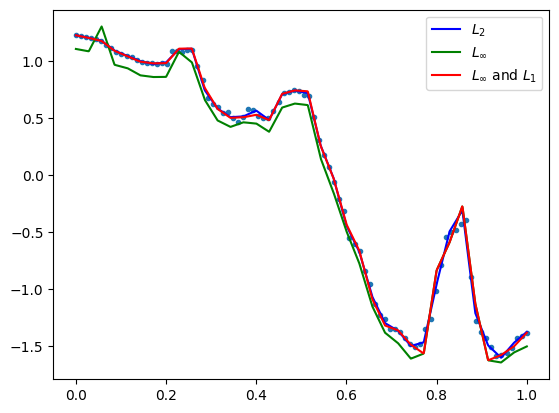

            max_dist       MSE      RMSE       MAE
LSQ         0.050425  0.000263  0.016226  0.011281
Max         0.037369  0.000991  0.031481  0.029323
Max and L1  0.037370  0.000304  0.017426  0.010918 

opt distance 0.037368559755245556
number of data points: 90


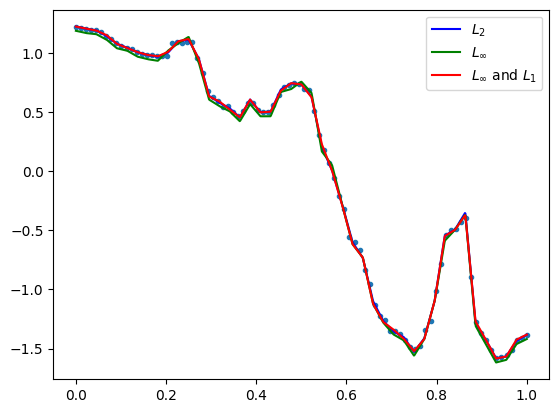

GestureMidAirD3 no. 185 len(ts): 120 ts processed: 88.94 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.326200  0.005658  0.075216  0.055223
Max         0.231792  0.026943  0.164145  0.149942
Max and L1  0.231793  0.007072  0.084097  0.059956 

opt distance 0.23179246792428254
number of data points: 120


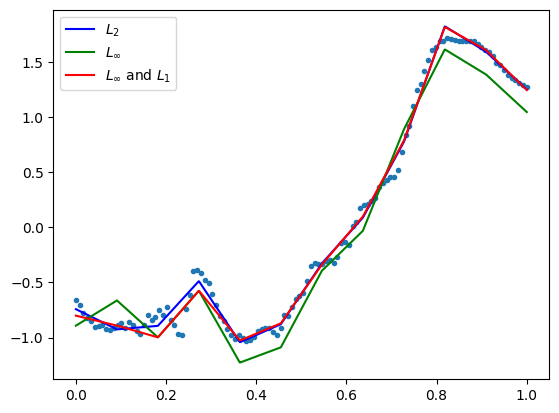

            max_dist       MSE      RMSE       MAE
LSQ         0.228315  0.002195  0.046847  0.033387
Max         0.156000  0.014432  0.120135  0.111180
Max and L1  0.156001  0.003072  0.055429  0.036448 

opt distance 0.15600019695368691
number of data points: 120


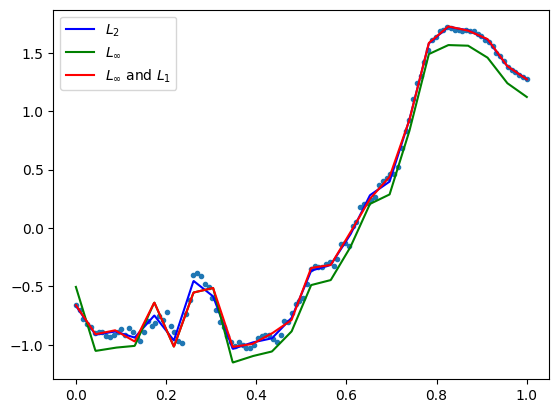

            max_dist       MSE      RMSE       MAE
LSQ         0.080580  0.000717  0.026781  0.019842
Max         0.065257  0.002424  0.049231  0.044350
Max and L1  0.065258  0.000823  0.028681  0.019585 
opt distance 0.0652569795037973
number of data points: 120


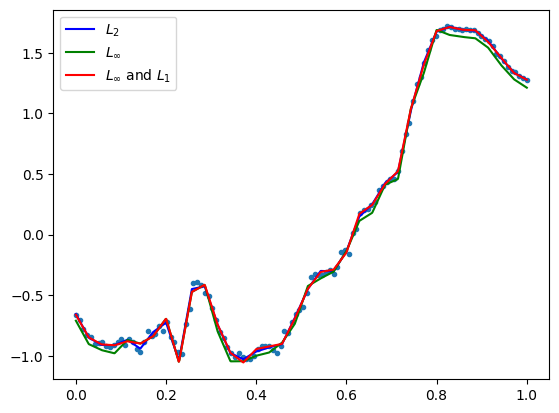

            max_dist       MSE      RMSE       MAE
LSQ         0.080099  0.000516  0.022721  0.015980
Max         0.055505  0.001965  0.044330  0.040377
Max and L1  0.055506  0.000637  0.025249  0.015990 

opt distance 0.0555051844039842
number of data points: 120


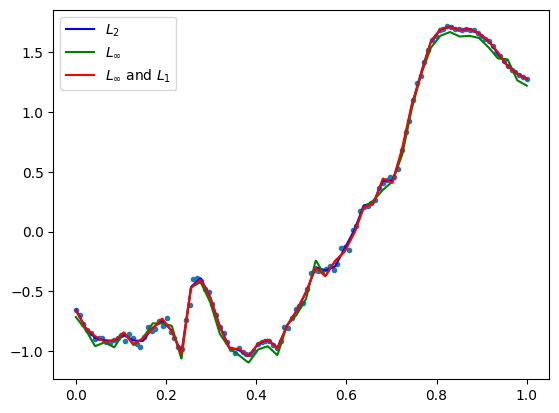

            max_dist       MSE      RMSE       MAE
LSQ         0.060637  0.000357  0.018899  0.013644
Max         0.047523  0.001517  0.038949  0.035686
Max and L1  0.047524  0.000513  0.022646  0.014307 

opt distance 0.04752300901901618
number of data points: 120


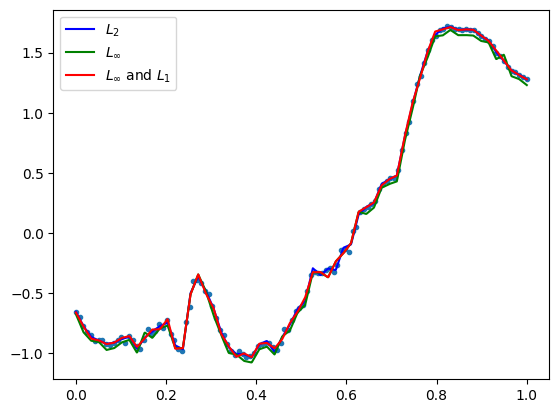

GestureMidAirD3 no. 186 len(ts): 90 ts processed: 89.42 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.376233  0.011244  0.106038  0.082204
Max         0.286062  0.030514  0.174683  0.149667
Max and L1  0.286063  0.014323  0.119678  0.092702 

opt distance 0.2860619522711798
number of data points: 90


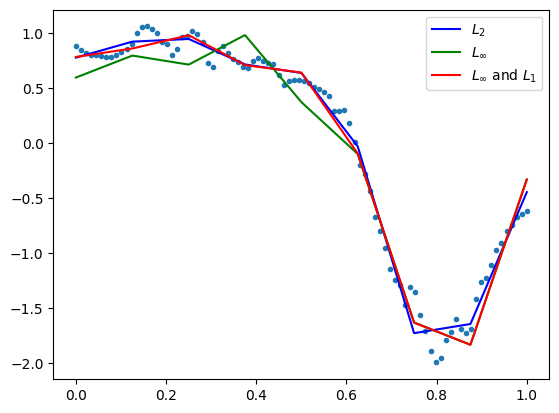

            max_dist       MSE      RMSE       MAE
LSQ         0.220532  0.005077  0.071256  0.051900
Max         0.181077  0.016031  0.126614  0.112790
Max and L1  0.181078  0.006928  0.083237  0.058908 

opt distance 0.18107723630357006
number of data points: 90


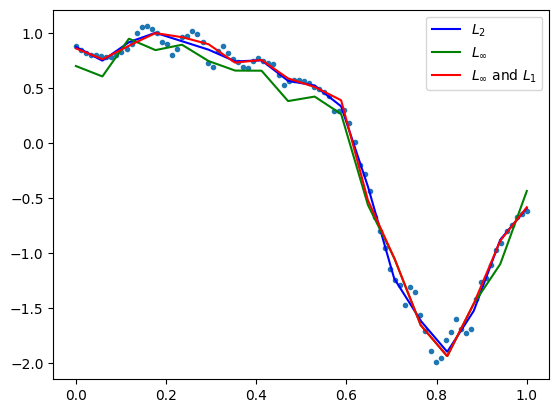

            max_dist       MSE      RMSE       MAE
LSQ         0.146315  0.002717  0.052121  0.036437
Max         0.116686  0.008487  0.092124  0.085924
Max and L1  0.116687  0.003703  0.060849  0.043426 

opt distance 0.11668553834328799
number of data points: 90


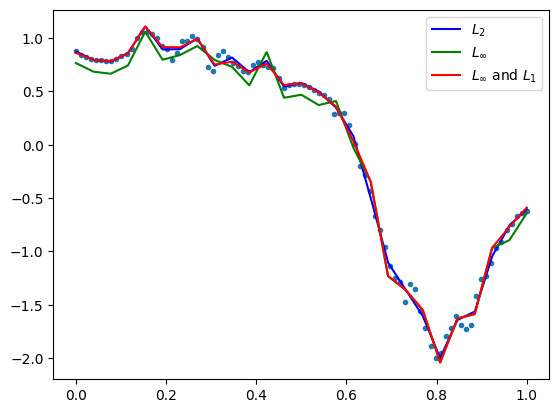

            max_dist       MSE      RMSE       MAE
LSQ         0.137504  0.001411  0.037559  0.025279
Max         0.090560  0.005393  0.073435  0.068816
Max and L1  0.090561  0.001780  0.042192  0.027483 

opt distance 0.09055952042130468
number of data points: 90


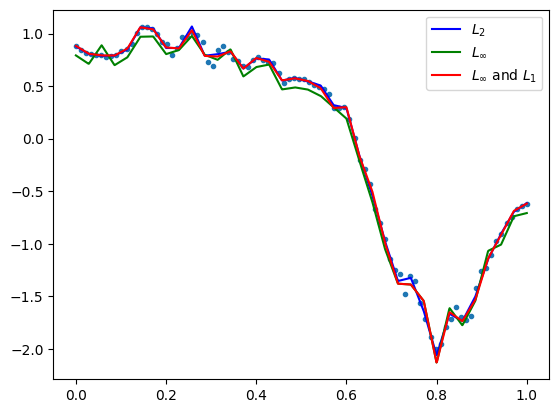

            max_dist       MSE      RMSE       MAE
LSQ         0.089727  0.000653  0.025560  0.018777
Max         0.058372  0.002354  0.048523  0.044517
Max and L1  0.058373  0.000875  0.029583  0.019557 

opt distance 0.058372376707212625
number of data points: 90


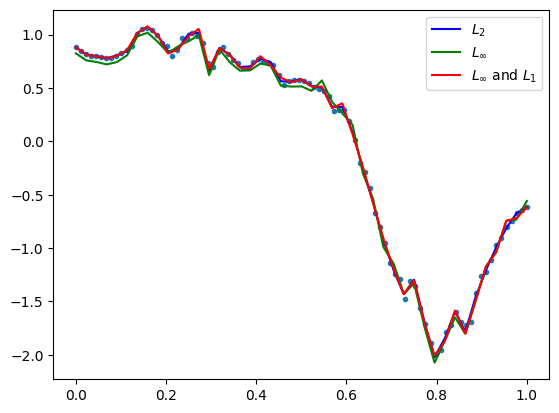

GestureMidAirD3 no. 187 len(ts): 180 ts processed: 89.9 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.048026  0.000238  0.015436  0.011526
Max         0.039836  0.000707  0.026583  0.023647
Max and L1  0.039837  0.000344  0.018556  0.014199 

opt distance 0.03983611656551317
number of data points: 180


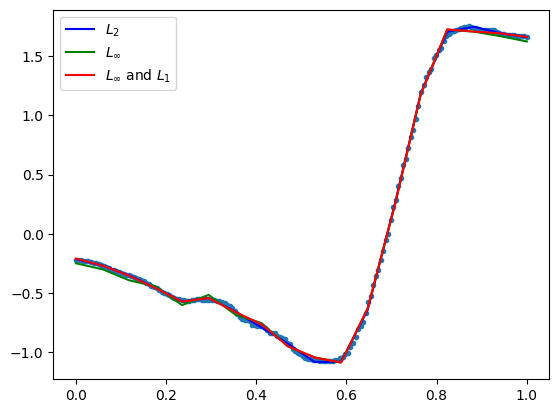

            max_dist       MSE      RMSE       MAE
LSQ         0.028242  0.000062  0.007855  0.005278
Max         0.024559  0.000326  0.018068  0.016398
Max and L1  0.024560  0.000073  0.008552  0.005505 

opt distance 0.024559157415448656
number of data points: 180


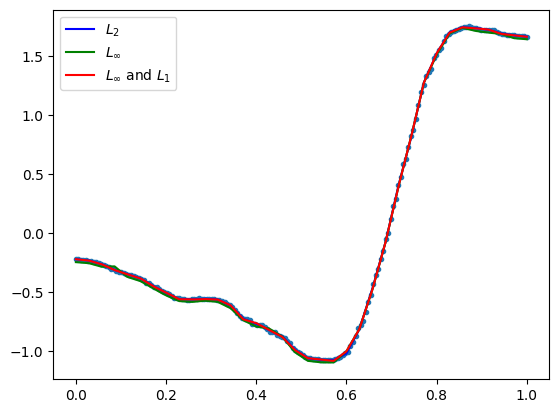

            max_dist       MSE      RMSE       MAE
LSQ         0.029706  0.000046  0.006771  0.004297
Max         0.022462  0.000346  0.018604  0.017496
Max and L1  0.022463  0.000056  0.007469  0.004299 

opt distance 0.0224620185564196
number of data points: 180


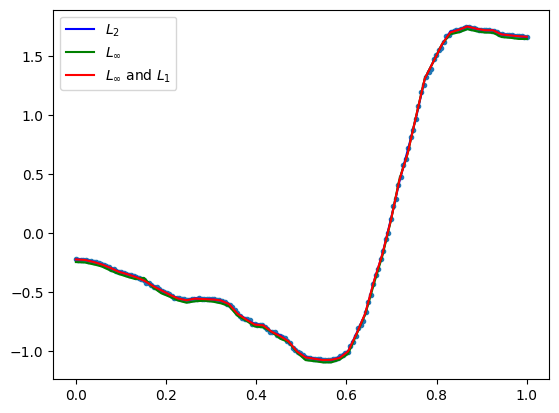

            max_dist       MSE      RMSE       MAE
LSQ         0.023596  0.000040  0.006357  0.003818
Max         0.018517  0.000240  0.015487  0.014501
Max and L1  0.018518  0.000053  0.007261  0.004126 

opt distance 0.018517129322606296
number of data points: 180


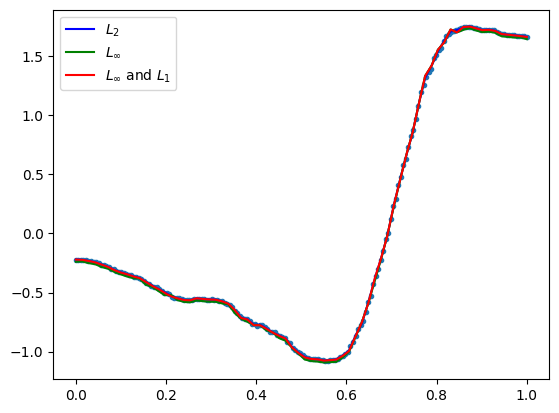

            max_dist       MSE      RMSE       MAE
LSQ         0.023189  0.000025  0.004994  0.002909
Max         0.018338  0.000271  0.016473  0.015958
Max and L1  0.018339  0.000036  0.006041  0.002964 

opt distance 0.018338466058887986
number of data points: 180


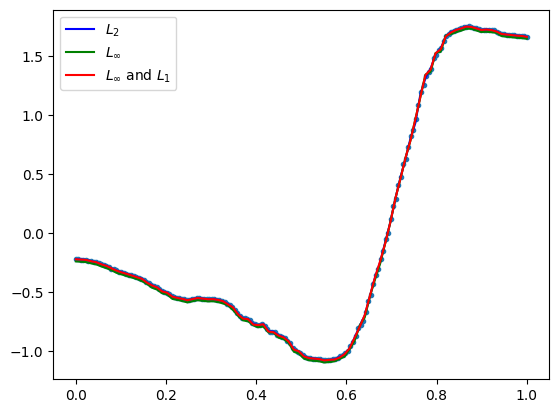

GestureMidAirD3 no. 188 len(ts): 180 ts processed: 90.38000000000001 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.065469  0.000330  0.018177  0.013708
Max         0.051506  0.001130  0.033620  0.029460
Max and L1  0.051507  0.000385  0.019626  0.014364 

opt distance 0.05150647621775584
number of data points: 180


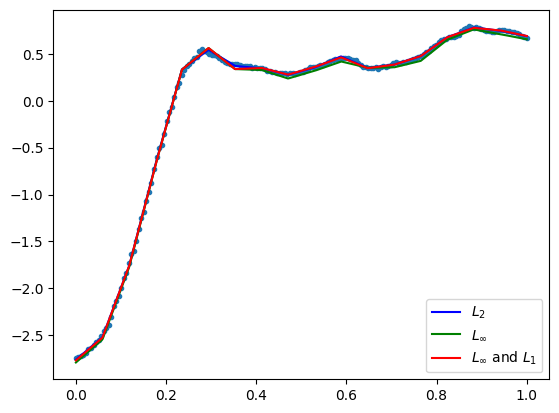

            max_dist       MSE      RMSE       MAE
LSQ         0.041151  0.000160  0.012632  0.009004
Max         0.035173  0.000696  0.026379  0.024297
Max and L1  0.035174  0.000172  0.013127  0.008857 
opt distance 0.03517304029252654
number of data points: 180


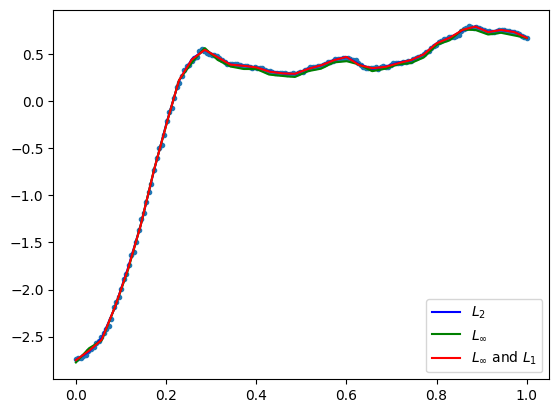

            max_dist       MSE      RMSE       MAE
LSQ         0.040018  0.000102  0.010080  0.006668
Max         0.034863  0.000833  0.028861  0.027301
Max and L1  0.034864  0.000140  0.011852  0.006722 

opt distance 0.03486275383194176
number of data points: 180


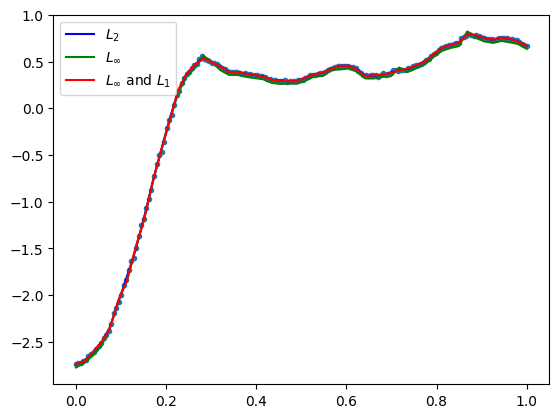

            max_dist       MSE      RMSE       MAE
LSQ         0.045125  0.000075  0.008646  0.005308
Max         0.031745  0.000747  0.027324  0.026219
Max and L1  0.031746  0.000093  0.009646  0.005106 

opt distance 0.0317445775939206
number of data points: 180


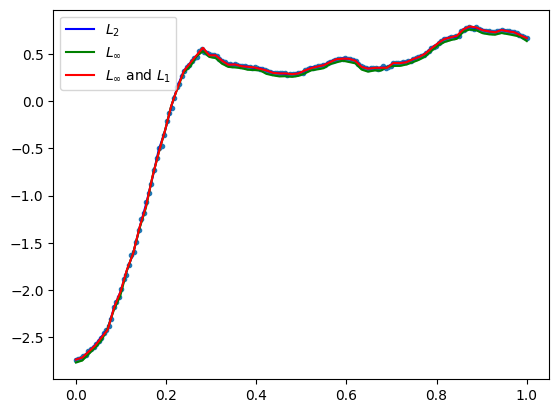

            max_dist       MSE      RMSE       MAE
LSQ         0.030560  0.000048  0.006918  0.004476
Max         0.019944  0.000300  0.017335  0.016511
Max and L1  0.019945  0.000061  0.007820  0.004427 

opt distance 0.01994368520941916
number of data points: 180


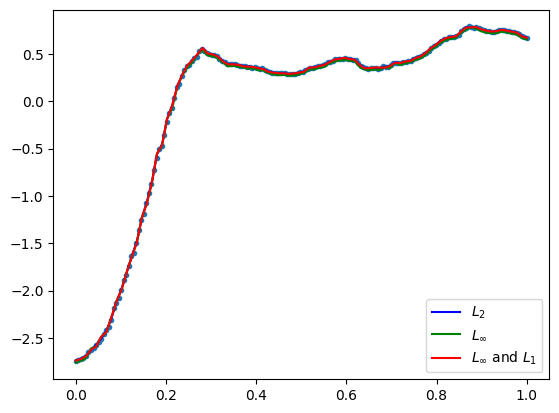

GestureMidAirD3 no. 189 len(ts): 90 ts processed: 90.86999999999999 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.512575  0.032799  0.181104  0.128241
Max         0.399738  0.068313  0.261368  0.228837
Max and L1  0.399739  0.052990  0.230196  0.187284 

opt distance 0.3997378566111097
number of data points: 90


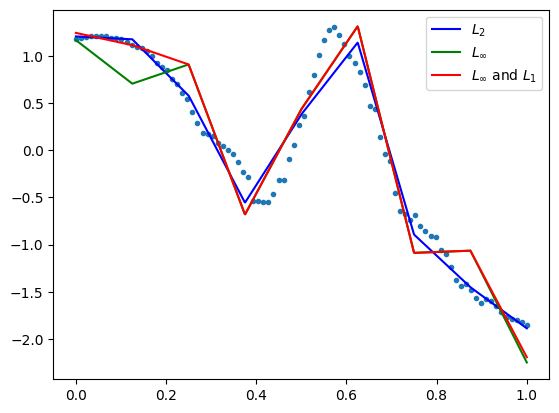

            max_dist       MSE      RMSE       MAE
LSQ         0.157984  0.002583  0.050824  0.036132
Max         0.124413  0.008145  0.090250  0.082466
Max and L1  0.124414  0.003281  0.057284  0.040159 

opt distance 0.12441345391326229
number of data points: 90


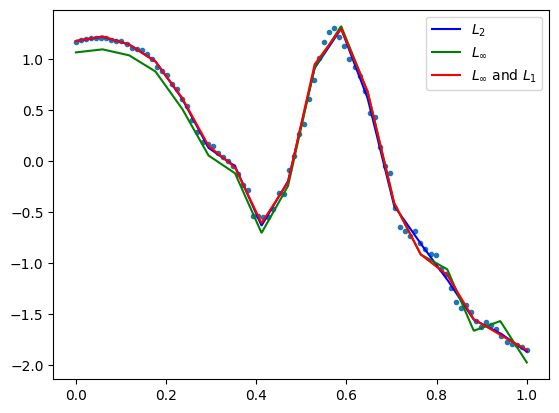

            max_dist       MSE      RMSE       MAE
LSQ         0.100693  0.001147  0.033873  0.024198
Max         0.080648  0.003880  0.062287  0.057173
Max and L1  0.080649  0.001504  0.038780  0.026700 

opt distance 0.08064823029136876
number of data points: 90


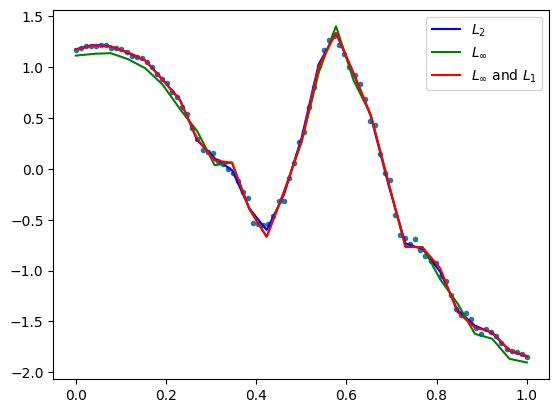

            max_dist       MSE      RMSE       MAE
LSQ         0.108116  0.000780  0.027922  0.019705
Max         0.074480  0.003423  0.058506  0.054272
Max and L1  0.074481  0.001070  0.032707  0.021223 

opt distance 0.07447969752520665
number of data points: 90


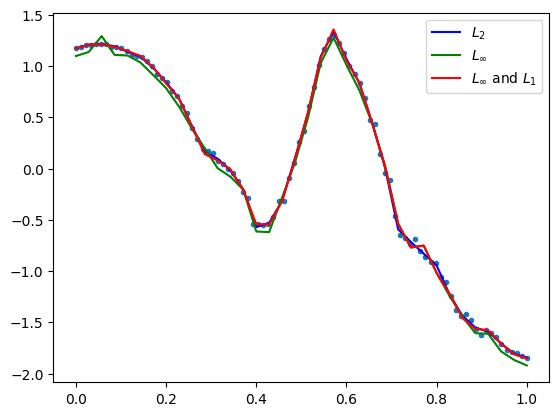

            max_dist       MSE      RMSE       MAE
LSQ         0.098163  0.000686  0.026188  0.016855
Max         0.067468  0.003482  0.059005  0.056623
Max and L1  0.067469  0.000886  0.029760  0.017451 

opt distance 0.06746832587748404
number of data points: 90


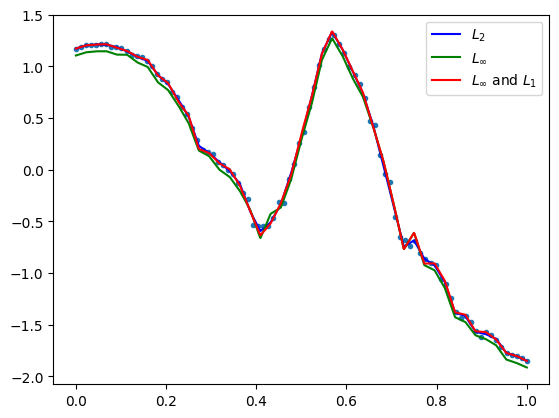

GestureMidAirD3 no. 190 len(ts): 300 ts processed: 91.35 %
[30, 60, 90, 120, 150]
            max_dist       MSE      RMSE       MAE
LSQ         0.312788  0.003965  0.062970  0.048202
Max         0.221902  0.023851  0.154438  0.139649
Max and L1  0.221903  0.005748  0.075818  0.055200 
opt distance 0.2219018504968223
number of data points: 300


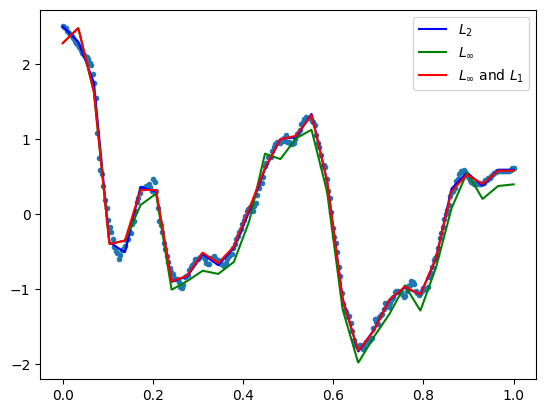

            max_dist       MSE      RMSE       MAE
LSQ         0.140815  0.001162  0.034084  0.024620
Max         0.116724  0.007766  0.088126  0.081349
Max and L1  0.116725  0.001357  0.036839  0.024386 

opt distance 0.11672405531241094
number of data points: 300


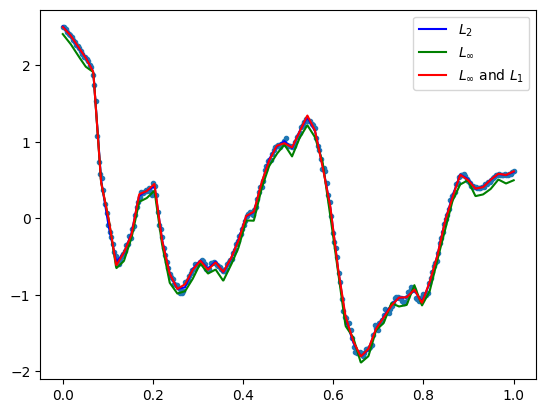

            max_dist       MSE      RMSE       MAE
LSQ         0.159413  0.000750  0.027390  0.019086
Max         0.117292  0.008906  0.094372  0.088536
Max and L1  0.117293  0.001082  0.032888  0.019698 
opt distance 0.11729177505291787
number of data points: 300


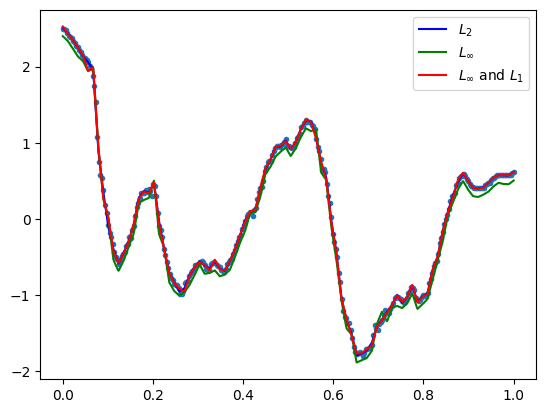

            max_dist       MSE      RMSE       MAE
LSQ         0.118467  0.000530  0.023031  0.015282
Max         0.094538  0.006332  0.079573  0.075507
Max and L1  0.094539  0.000774  0.027829  0.015881 
opt distance 0.09453829841205244
number of data points: 300


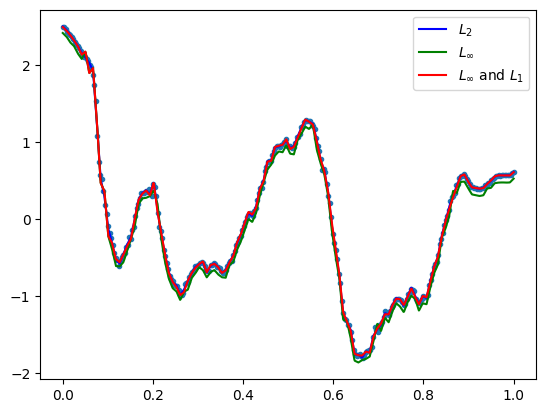

            max_dist       MSE      RMSE       MAE
LSQ         0.078252  0.000249  0.015791  0.011127
Max         0.050533  0.001840  0.042893  0.040577
Max and L1  0.050534  0.000346  0.018604  0.010689 

opt distance 0.05053302245259306
number of data points: 300


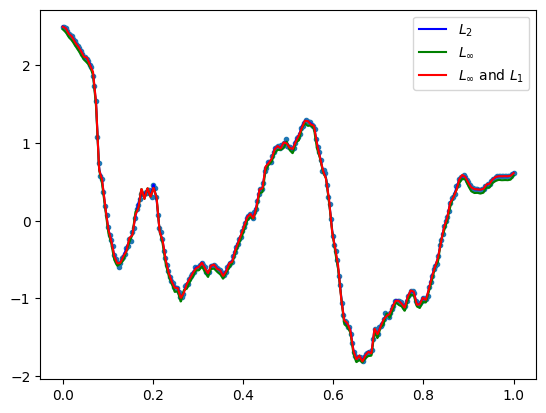

GestureMidAirD3 no. 191 len(ts): 120 ts processed: 91.83 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.113590  0.001264  0.035551  0.027741
Max         0.088443  0.003572  0.059763  0.053676
Max and L1  0.088444  0.002396  0.048948  0.039868 

opt distance 0.08844251086269433
number of data points: 120


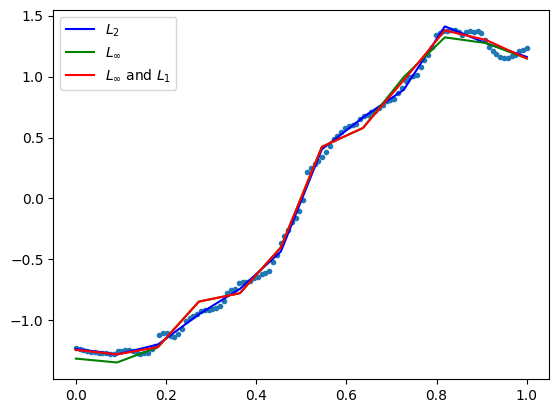

            max_dist       MSE      RMSE       MAE
LSQ         0.075112  0.000576  0.024010  0.018036
Max         0.063005  0.002133  0.046188  0.041613
Max and L1  0.063006  0.000666  0.025806  0.018358 

opt distance 0.06300455301021328
number of data points: 120


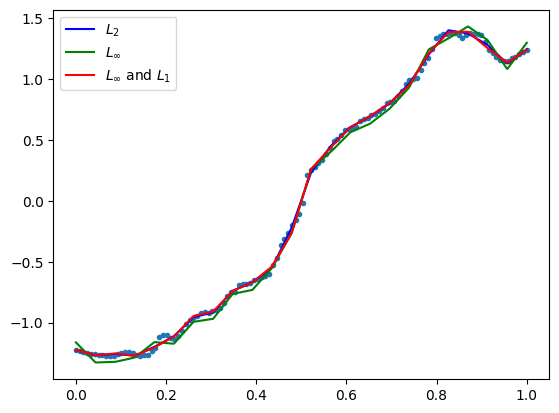

            max_dist       MSE      RMSE       MAE
LSQ         0.071293  0.000205  0.014325  0.009335
Max         0.051868  0.001822  0.042682  0.040424
Max and L1  0.051869  0.000279  0.016700  0.009979 

opt distance 0.05186770409814406
number of data points: 120


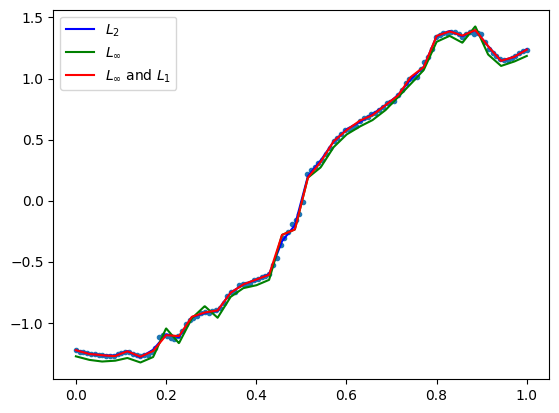

            max_dist       MSE      RMSE       MAE
LSQ         0.066433  0.000144  0.012000  0.008037
Max         0.050790  0.001815  0.042600  0.039889
Max and L1  0.050791  0.000225  0.014988  0.008098 

opt distance 0.05079016528488167
number of data points: 120


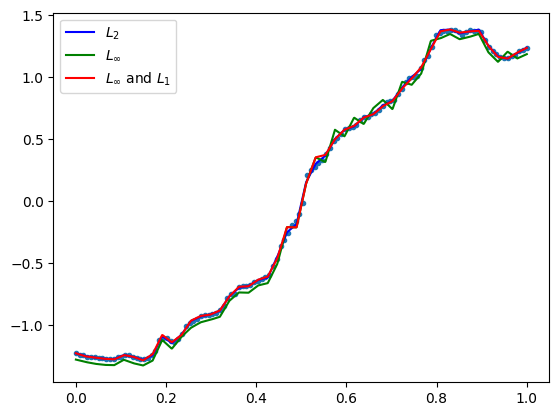

            max_dist       MSE      RMSE       MAE
LSQ         0.056287  0.000107  0.010331  0.006356
Max         0.043650  0.001468  0.038311  0.036864
Max and L1  0.043651  0.000316  0.017790  0.010212 

opt distance 0.043649556197237316
number of data points: 120


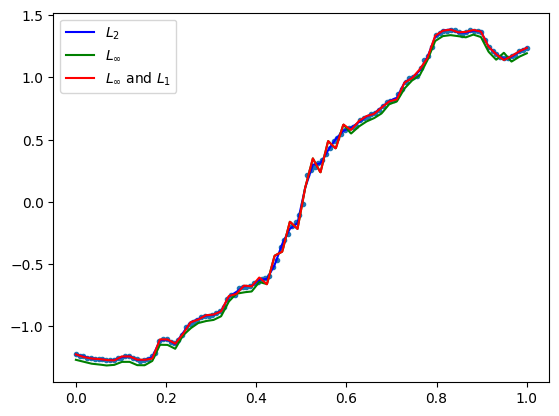

GestureMidAirD3 no. 192 len(ts): 89 ts processed: 92.31 %
[8, 17, 26, 35, 44]
            max_dist       MSE      RMSE       MAE
LSQ         0.847638  0.095567  0.309138  0.234069
Max         0.649472  0.157200  0.396484  0.341797
Max and L1  0.649473  0.156257  0.395293  0.340880 

opt distance 0.6494719419994425
number of data points: 89


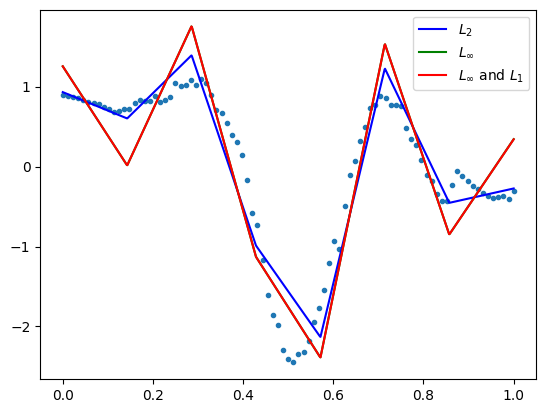

            max_dist       MSE      RMSE       MAE
LSQ         0.288494  0.006107  0.078146  0.055009
Max         0.186212  0.019264  0.138796  0.125587
Max and L1  0.186213  0.008634  0.092920  0.068410 

opt distance 0.18621218644608625
number of data points: 89


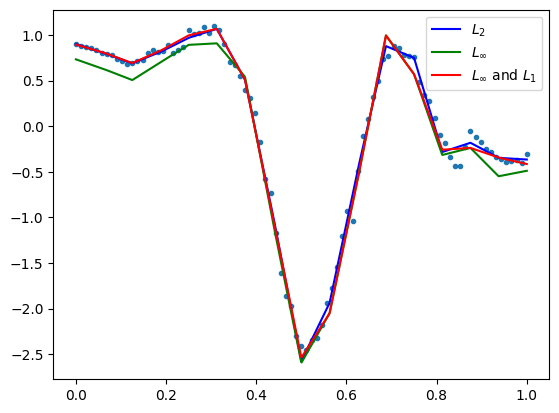

            max_dist       MSE      RMSE       MAE
LSQ         0.269157  0.002975  0.054545  0.035427
Max         0.189424  0.023108  0.152012  0.140433
Max and L1  0.189425  0.003809  0.061720  0.036151 

opt distance 0.1894242026865873
number of data points: 89


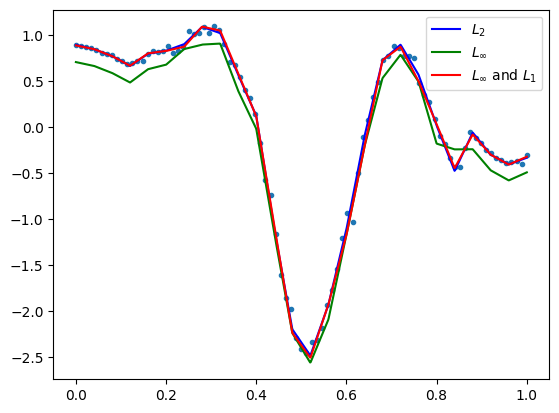

            max_dist       MSE      RMSE       MAE
LSQ         0.170674  0.002277  0.047721  0.034726
Max         0.115114  0.008235  0.090746  0.082842
Max and L1  0.115115  0.003066  0.055367  0.036442 

opt distance 0.11511413103729339
number of data points: 89


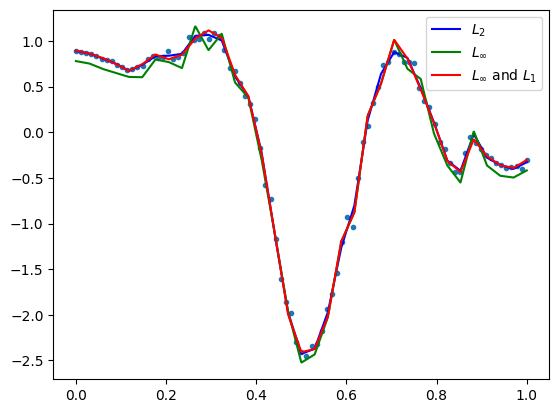

            max_dist       MSE      RMSE       MAE
LSQ         0.238183  0.002200  0.046908  0.031392
Max         0.155929  0.017389  0.131867  0.123522
Max and L1  0.155930  0.003497  0.059133  0.034276 

opt distance 0.15592873020540213
number of data points: 89


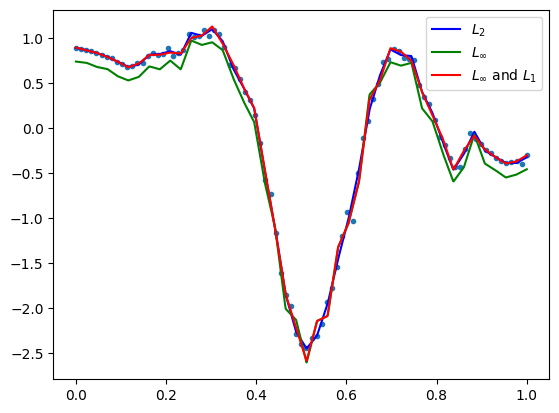

GestureMidAirD3 no. 193 len(ts): 226 ts processed: 92.78999999999999 %
[22, 45, 67, 90, 113]
            max_dist       MSE      RMSE       MAE
LSQ         0.166902  0.001391  0.037295  0.022944
Max         0.124944  0.010583  0.102872  0.095669
Max and L1  0.124945  0.001654  0.040672  0.024697 

opt distance 0.12494356569647917
number of data points: 226


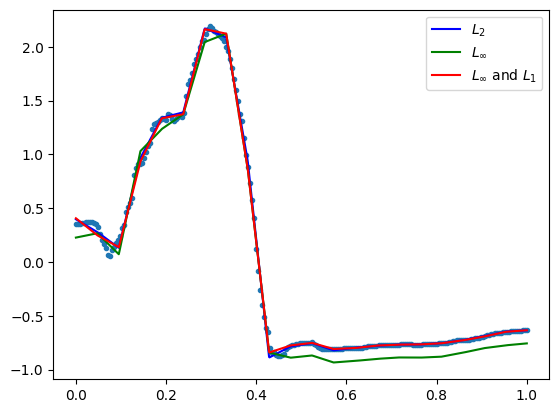

            max_dist       MSE      RMSE       MAE
LSQ         0.095004  0.000305  0.017450  0.009118
Max         0.070395  0.003686  0.060712  0.058066
Max and L1  0.070396  0.000460  0.021449  0.010906 

opt distance 0.07039513813696807
number of data points: 226


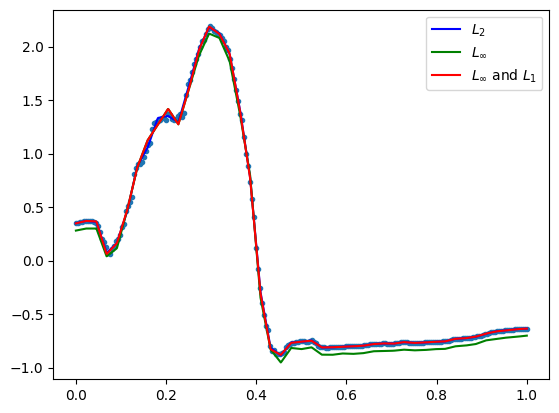

            max_dist       MSE      RMSE       MAE
LSQ         0.060588  0.000222  0.014914  0.007948
Max         0.050433  0.001927  0.043902  0.041702
Max and L1  0.050434  0.000255  0.015974  0.007884 

opt distance 0.050433489654556296
number of data points: 226


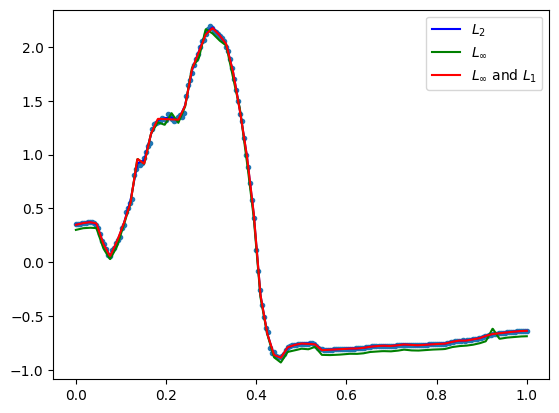

            max_dist       MSE      RMSE       MAE
LSQ         0.059557  0.000129  0.011347  0.005841
Max         0.040081  0.001291  0.035929  0.034324
Max and L1  0.040082  0.000157  0.012521  0.005820 

opt distance 0.040081155395738755
number of data points: 226


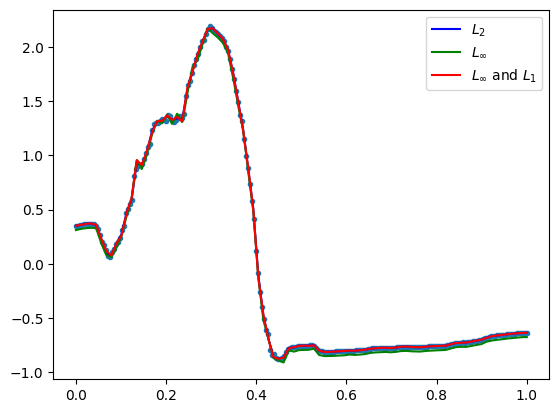

            max_dist       MSE      RMSE       MAE
LSQ         0.059235  0.000100  0.010005  0.004917
Max         0.041865  0.001507  0.038814  0.037880
Max and L1  0.041866  0.000134  0.011560  0.004818 

opt distance 0.04186471193808616
number of data points: 226


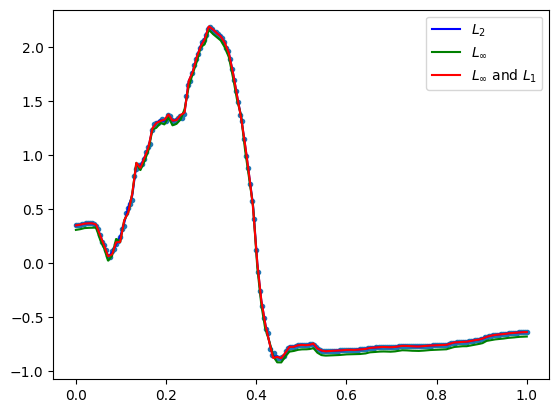

GestureMidAirD3 no. 194 len(ts): 171 ts processed: 93.27 %
[17, 34, 51, 68, 85]
            max_dist       MSE      RMSE       MAE
LSQ         0.212635  0.002848  0.053366  0.036979
Max         0.150622  0.012068  0.109855  0.100267
Max and L1  0.150623  0.004518  0.067217  0.048746 

opt distance 0.15062163755800984
number of data points: 171


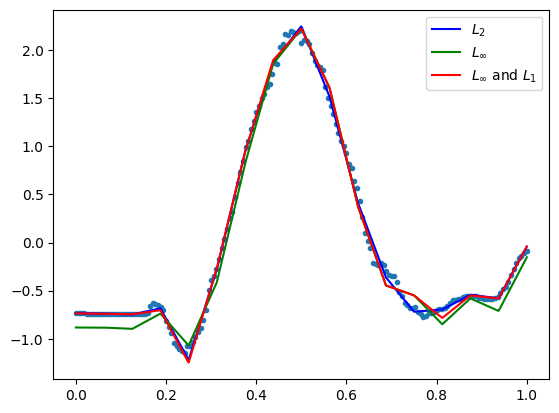

            max_dist       MSE      RMSE       MAE
LSQ         0.078139  0.000602  0.024530  0.017277
Max         0.064729  0.002298  0.047940  0.042442
Max and L1  0.064730  0.000678  0.026038  0.017551 

opt distance 0.06472936256769798
number of data points: 171


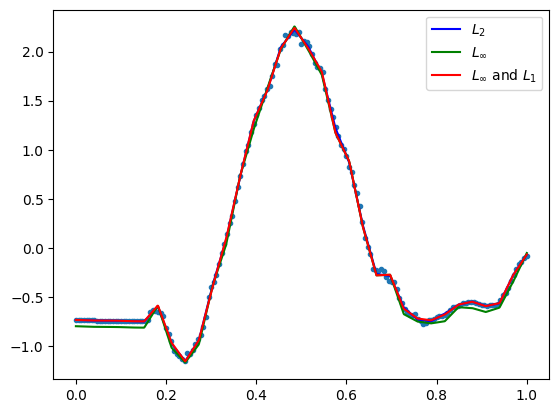

            max_dist       MSE      RMSE       MAE
LSQ         0.074813  0.000332  0.018210  0.012365
Max         0.048919  0.001500  0.038736  0.035374
Max and L1  0.048920  0.000390  0.019759  0.012059 

opt distance 0.048919242760354864
number of data points: 171


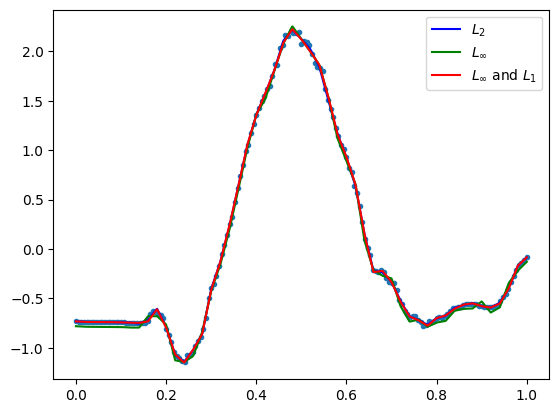

            max_dist       MSE      RMSE       MAE
LSQ         0.066106  0.000267  0.016346  0.010827
Max         0.047528  0.001567  0.039590  0.036738
Max and L1  0.047529  0.000356  0.018872  0.011125 

opt distance 0.047528034397666334
number of data points: 171


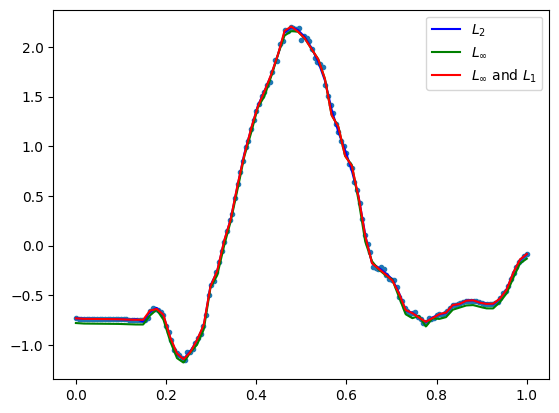

            max_dist       MSE      RMSE       MAE
LSQ         0.056039  0.000157  0.012529  0.008499
Max         0.043078  0.001404  0.037465  0.035620
Max and L1  0.043079  0.000238  0.015439  0.008255 

opt distance 0.04307823664480252
number of data points: 171


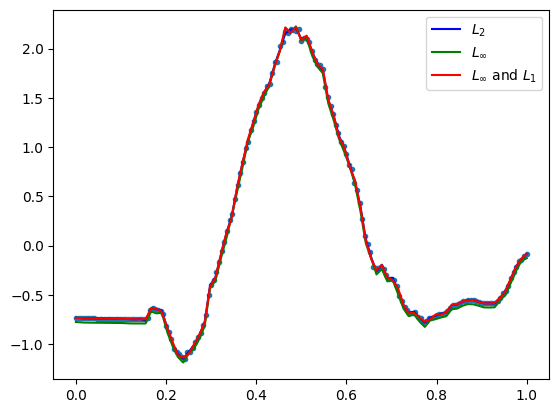

GestureMidAirD3 no. 195 len(ts): 173 ts processed: 93.75 %
[17, 34, 51, 69, 86]
            max_dist       MSE      RMSE       MAE
LSQ         0.086767  0.000260  0.016125  0.011368
Max         0.058445  0.001869  0.043236  0.039506
Max and L1  0.058446  0.000348  0.018664  0.012682 

opt distance 0.05844460043571912
number of data points: 173


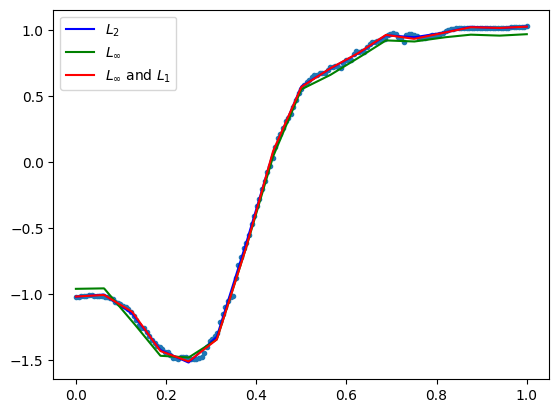

            max_dist       MSE      RMSE       MAE
LSQ         0.077371  0.000142  0.011911  0.007419
Max         0.051917  0.001841  0.042906  0.040642
Max and L1  0.051918  0.000204  0.014283  0.008174 

opt distance 0.05191693132062179
number of data points: 173


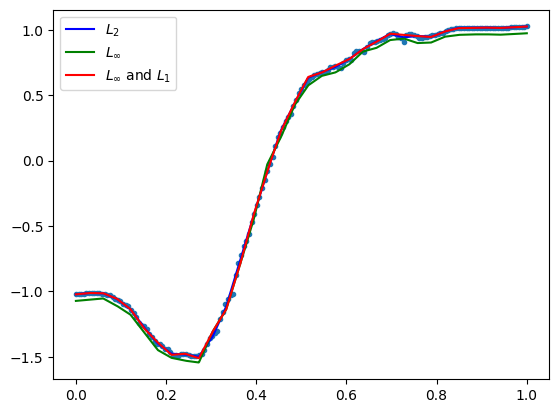

            max_dist       MSE      RMSE       MAE
LSQ         0.069270  0.000098  0.009888  0.005509
Max         0.043595  0.001302  0.036079  0.033951
Max and L1  0.043596  0.000215  0.014661  0.007912 

opt distance 0.04359479846660985
number of data points: 173


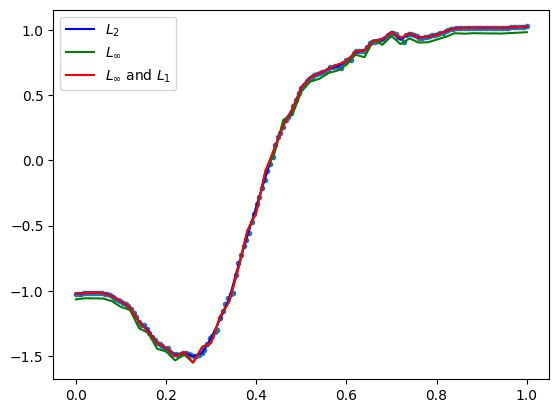

            max_dist       MSE      RMSE       MAE
LSQ         0.047104  0.000066  0.008116  0.004604
Max         0.033930  0.000887  0.029780  0.028492
Max and L1  0.033931  0.000096  0.009798  0.004924 

opt distance 0.0339301800189546
number of data points: 173


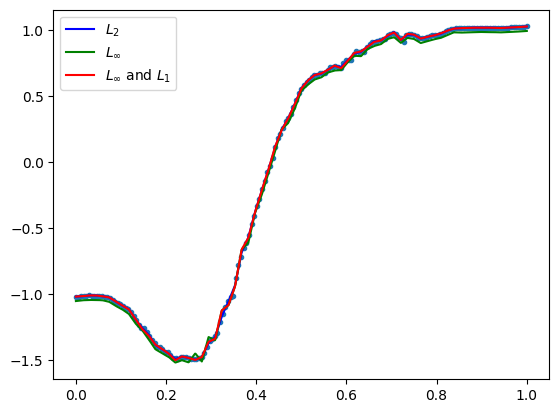

            max_dist       MSE      RMSE       MAE
LSQ         0.041882  0.000040  0.006285  0.003286
Max         0.028901  0.000694  0.026341  0.025407
Max and L1  0.028902  0.000069  0.008329  0.003632 

opt distance 0.028900807361258416
number of data points: 173


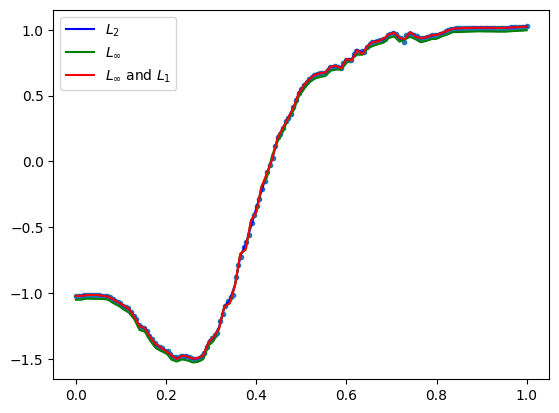

GestureMidAirD3 no. 196 len(ts): 171 ts processed: 94.23 %
[17, 34, 51, 68, 85]
            max_dist       MSE      RMSE       MAE
LSQ         0.397186  0.002221  0.047132  0.019708
Max         0.243033  0.038818  0.197023  0.184360
Max and L1  0.243034  0.005451  0.073829  0.038481 

opt distance 0.24303283536275833
number of data points: 171


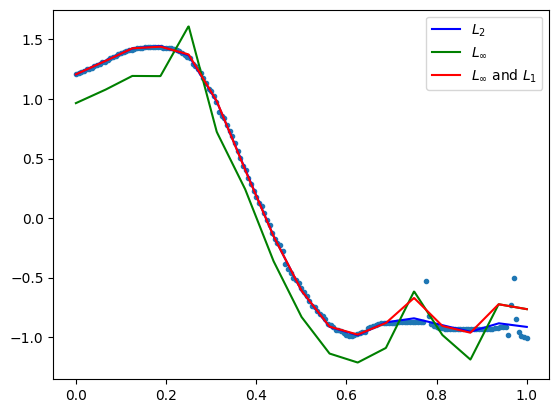

            max_dist       MSE      RMSE       MAE
LSQ         0.299876  0.001308  0.036167  0.013709
Max         0.177193  0.026539  0.162907  0.159038
Max and L1  0.177194  0.002614  0.051129  0.023601 

opt distance 0.17719345275377063
number of data points: 171


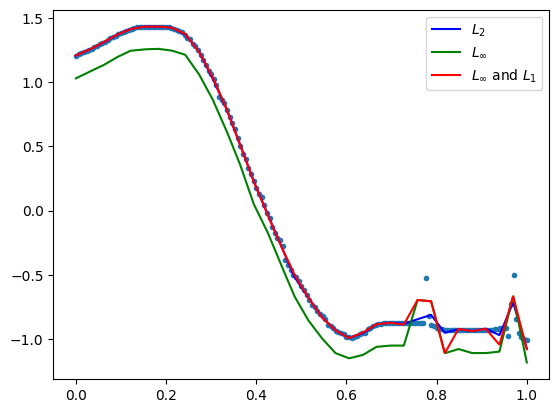

            max_dist       MSE      RMSE       MAE
LSQ         0.306325  0.001354  0.036791  0.012603
Max         0.210928  0.038509  0.196238  0.191462
Max and L1  0.210929  0.002273  0.047680  0.016745 

opt distance 0.21092827534150232
number of data points: 171


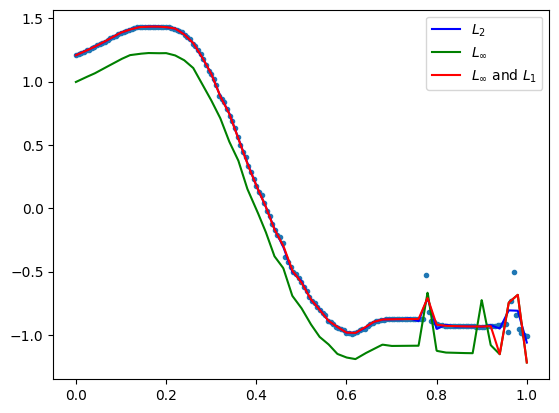

            max_dist       MSE      RMSE       MAE
LSQ         0.124913  0.000415  0.020374  0.008396
Max         0.103451  0.009198  0.095906  0.093659
Max and L1  0.103452  0.000649  0.025483  0.009703 

opt distance 0.10345052455586125
number of data points: 171


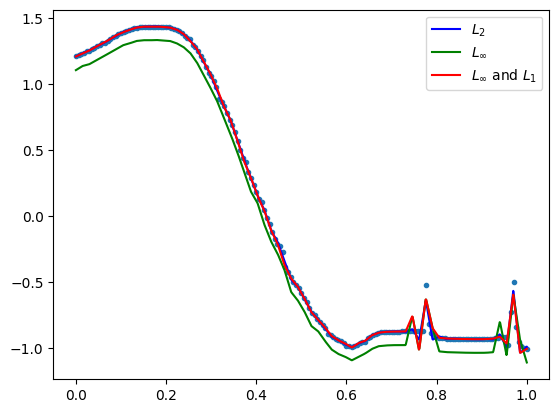

            max_dist       MSE      RMSE       MAE
LSQ         0.224749  0.000861  0.029349  0.009091
Max         0.149208  0.020526  0.143270  0.141760
Max and L1  0.149209  0.001238  0.035179  0.011456 

opt distance 0.14920792162337448
number of data points: 171


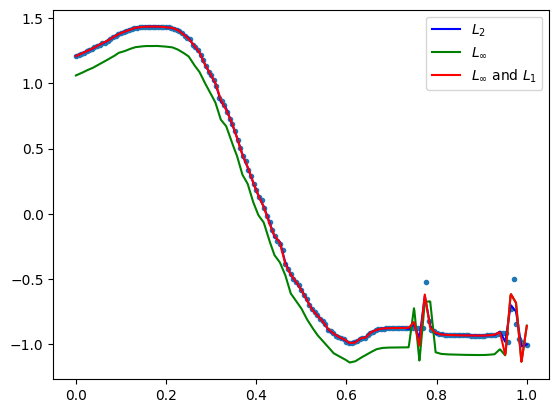

GestureMidAirD3 no. 197 len(ts): 84 ts processed: 94.71000000000001 %
[8, 16, 25, 33, 42]
            max_dist       MSE      RMSE       MAE
LSQ         0.675587  0.020456  0.143026  0.097692
Max         0.403124  0.093916  0.306457  0.281822
Max and L1  0.403125  0.047525  0.218001  0.159689 

opt distance 0.40312373491482567
number of data points: 84


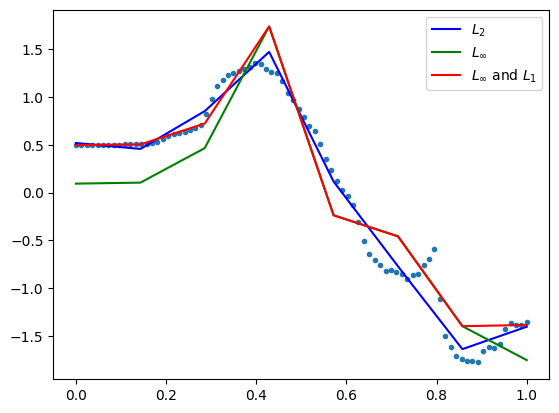

            max_dist       MSE      RMSE       MAE
LSQ         0.304758  0.004928  0.070198  0.039149
Max         0.279167  0.051876  0.227763  0.214896
Max and L1  0.279168  0.009506  0.097497  0.057469 

opt distance 0.27916676371300286
number of data points: 84


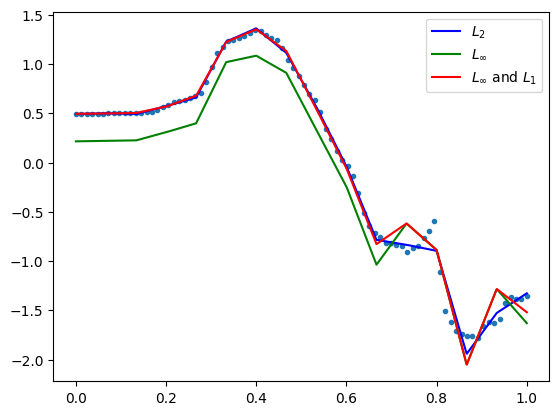

            max_dist       MSE      RMSE       MAE
LSQ         0.138146  0.001118  0.033440  0.021350
Max         0.113562  0.008388  0.091586  0.085370
Max and L1  0.113563  0.001347  0.036700  0.021201 

opt distance 0.11356187265095563
number of data points: 84


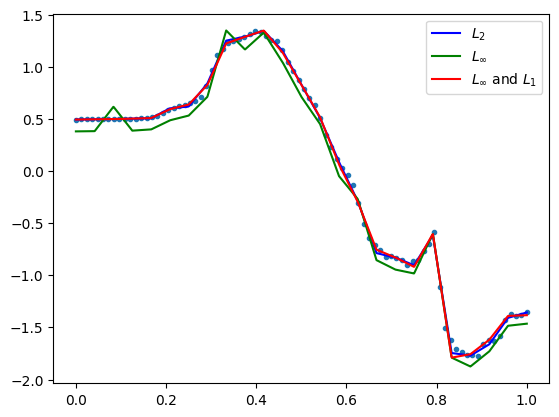

            max_dist       MSE      RMSE       MAE
LSQ         0.277168  0.001712  0.041374  0.019304
Max         0.186197  0.026929  0.164100  0.157653
Max and L1  0.186198  0.002524  0.050238  0.022909 

opt distance 0.18619745967523757
number of data points: 84


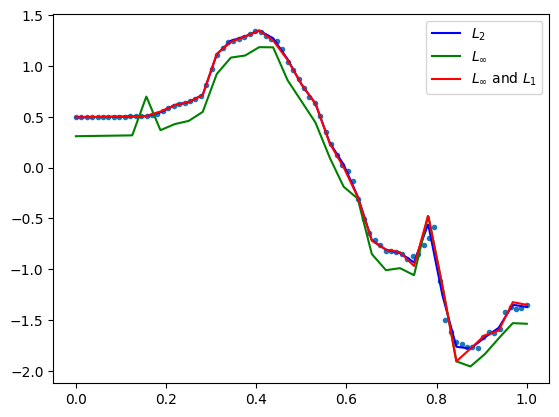

            max_dist       MSE      RMSE       MAE
LSQ         0.221241  0.001167  0.034161  0.015912
Max         0.145445  0.017862  0.133648  0.130807
Max and L1  0.145446  0.002019  0.044934  0.020955 

opt distance 0.14544539647619786
number of data points: 84


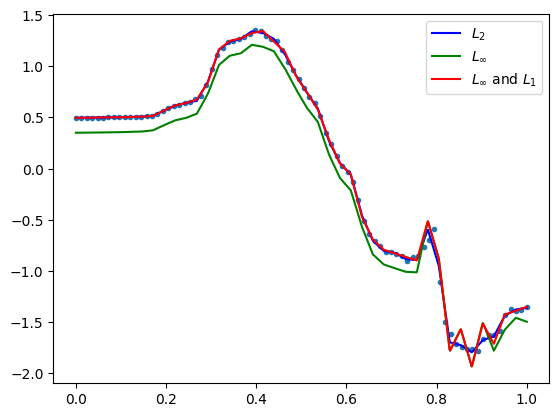

GestureMidAirD3 no. 198 len(ts): 120 ts processed: 95.19 %
[12, 24, 36, 48, 60]
            max_dist       MSE      RMSE       MAE
LSQ         0.055113  0.000420  0.020493  0.014879
Max         0.047402  0.001165  0.034139  0.030384
Max and L1  0.047403  0.000536  0.023141  0.017090 

opt distance 0.04740161155306866
number of data points: 120


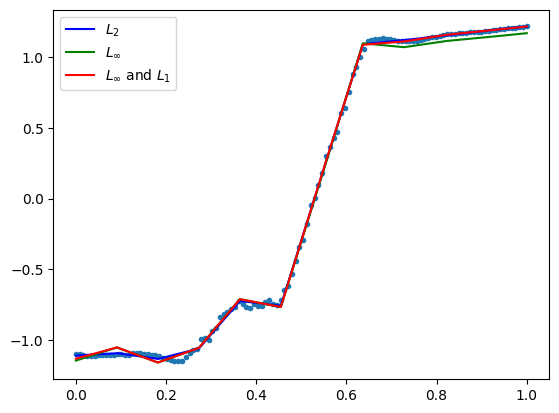

            max_dist       MSE      RMSE       MAE
LSQ         0.045677  0.000213  0.014594  0.008849
Max         0.038520  0.000830  0.028810  0.025805
Max and L1  0.038521  0.000296  0.017205  0.011176 

opt distance 0.038520169274328976
number of data points: 120


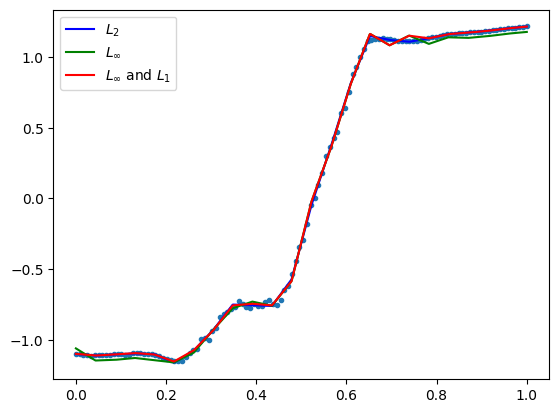

            max_dist       MSE      RMSE       MAE
LSQ         0.036064  0.000135  0.011628  0.006933
Max         0.027473  0.000539  0.023217  0.021924
Max and L1  0.027474  0.000162  0.012722  0.008033 

opt distance 0.02747255317343599
number of data points: 120


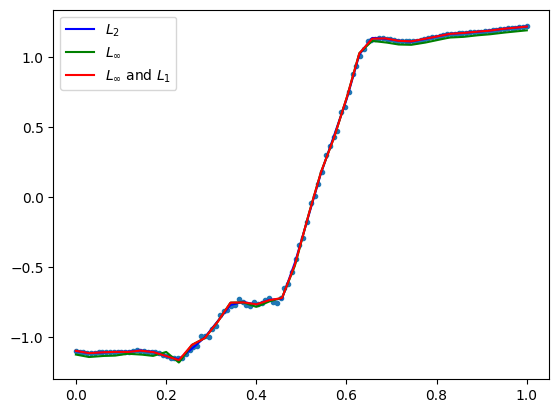

            max_dist       MSE      RMSE       MAE
LSQ         0.037198  0.000074  0.008604  0.004978
Max         0.024903  0.000456  0.021357  0.020313
Max and L1  0.024904  0.000090  0.009512  0.005217 

opt distance 0.024903465545863743
number of data points: 120


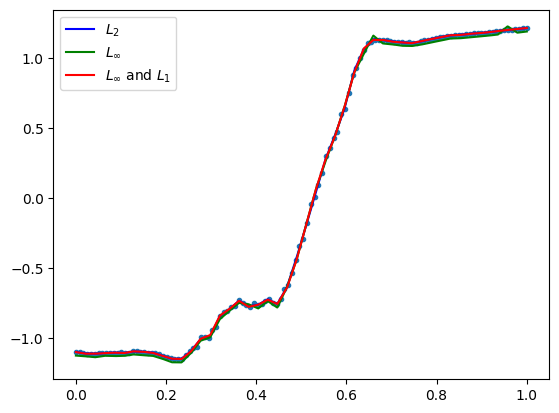

            max_dist       MSE      RMSE       MAE
LSQ         0.035192  0.000070  0.008372  0.004672
Max         0.025488  0.000501  0.022372  0.021183
Max and L1  0.025489  0.000108  0.010384  0.005560 

opt distance 0.025487851183314203
number of data points: 120


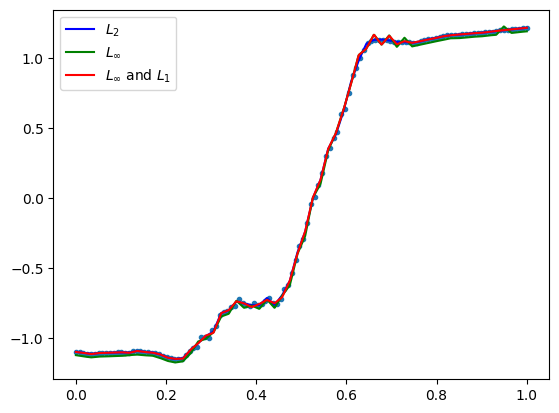

GestureMidAirD3 no. 199 len(ts): 90 ts processed: 95.67 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.442629  0.028867  0.169903  0.130735
Max         0.359812  0.046313  0.215205  0.186601
Max and L1  0.359813  0.042065  0.205097  0.170973 

opt distance 0.3598121975957079
number of data points: 90


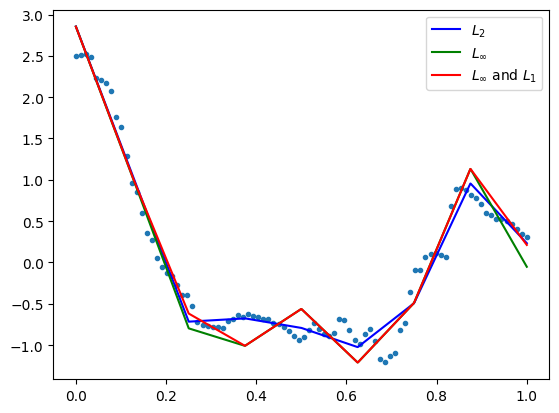

            max_dist       MSE      RMSE       MAE
LSQ         0.313511  0.008068  0.089824  0.065053
Max         0.269016  0.040330  0.200824  0.186022
Max and L1  0.269017  0.015307  0.123722  0.089374 

opt distance 0.2690156553747005
number of data points: 90


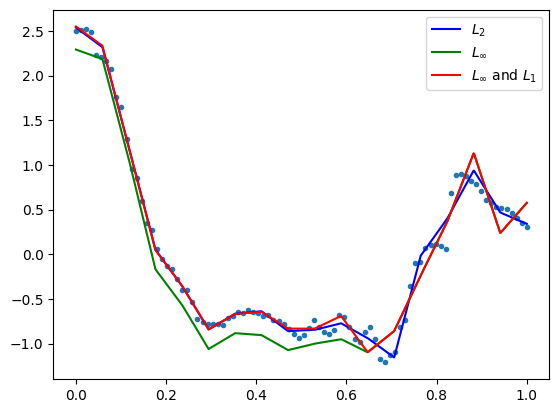

            max_dist       MSE      RMSE       MAE
LSQ         0.245969  0.003262  0.057112  0.040063
Max         0.162511  0.017057  0.130601  0.121757
Max and L1  0.162512  0.003963  0.062949  0.040813 

opt distance 0.16251119080547516
number of data points: 90


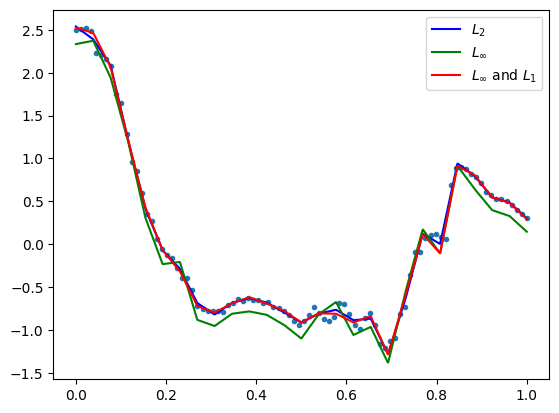

            max_dist       MSE      RMSE       MAE
LSQ         0.274058  0.003246  0.056978  0.038946
Max         0.195595  0.025408  0.159400  0.146951
Max and L1  0.195596  0.005349  0.073140  0.043694 

opt distance 0.1955953765783689
number of data points: 90


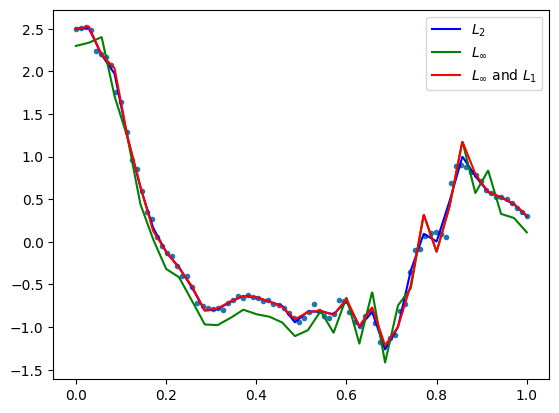

            max_dist       MSE      RMSE       MAE
LSQ         0.113261  0.001047  0.032361  0.022531
Max         0.084146  0.004805  0.069320  0.063534
Max and L1  0.084147  0.001465  0.038281  0.023570 

opt distance 0.08414618692658411
number of data points: 90


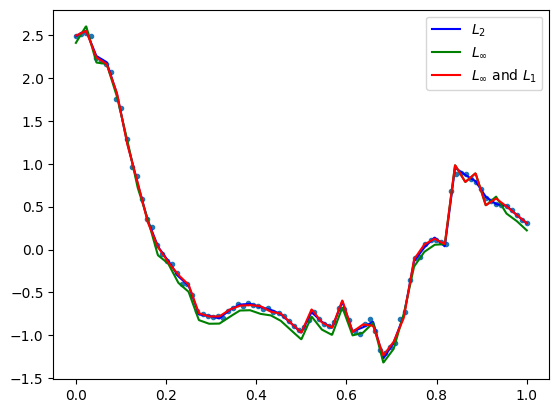

GestureMidAirD3 no. 200 len(ts): 180 ts processed: 96.15 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.164270  0.001653  0.040658  0.023660
Max         0.156227  0.016875  0.129904  0.125254
Max and L1  0.156228  0.001866  0.043196  0.024861 

opt distance 0.15622725337836055
number of data points: 180


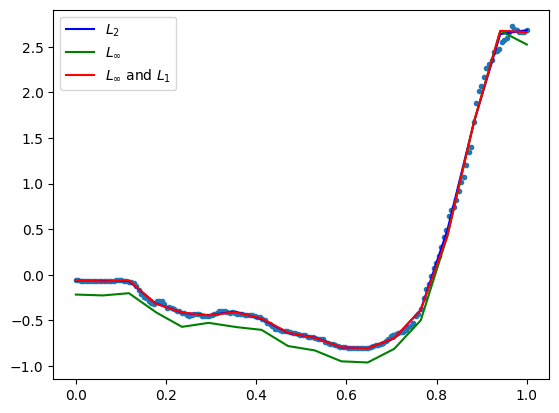

            max_dist       MSE      RMSE       MAE
LSQ         0.137507  0.000374  0.019342  0.011611
Max         0.095464  0.006006  0.077499  0.072519
Max and L1  0.095465  0.001054  0.032472  0.018305 

opt distance 0.0954641723146737
number of data points: 180


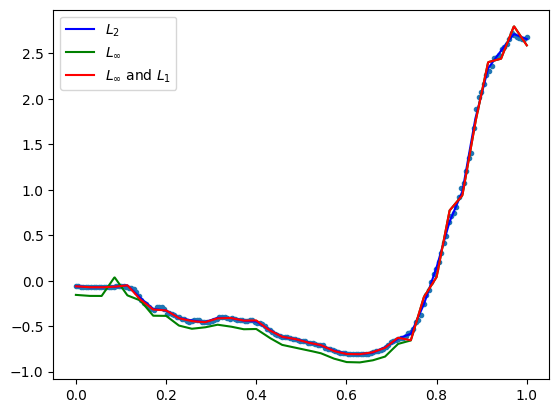

            max_dist       MSE      RMSE       MAE
LSQ         0.106355  0.000192  0.013846  0.007790
Max         0.065747  0.003241  0.056928  0.054489
Max and L1  0.065748  0.000290  0.017038  0.008585 

opt distance 0.0657473183324148
number of data points: 180


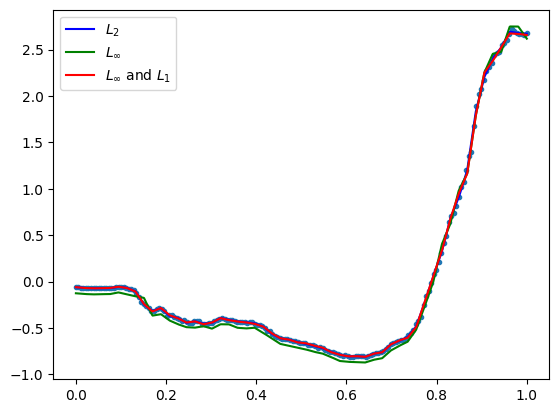

            max_dist       MSE      RMSE       MAE
LSQ         0.068879  0.000123  0.011110  0.006428
Max         0.053636  0.002223  0.047147  0.045792
Max and L1  0.053637  0.000177  0.013308  0.006412 

opt distance 0.053636040992406514
number of data points: 180


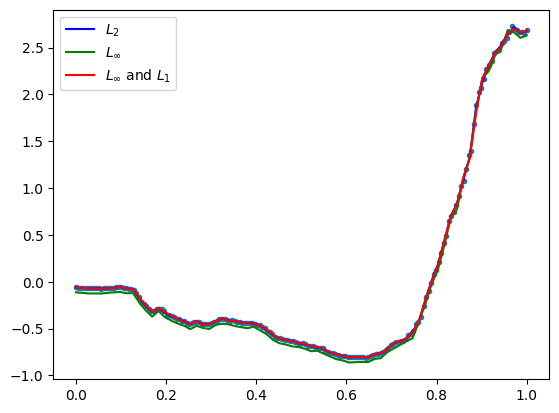

            max_dist       MSE      RMSE       MAE
LSQ         0.040237  0.000062  0.007898  0.004539
Max         0.031033  0.000790  0.028103  0.027228
Max and L1  0.031034  0.000087  0.009346  0.004517 

opt distance 0.031032752224488605
number of data points: 180


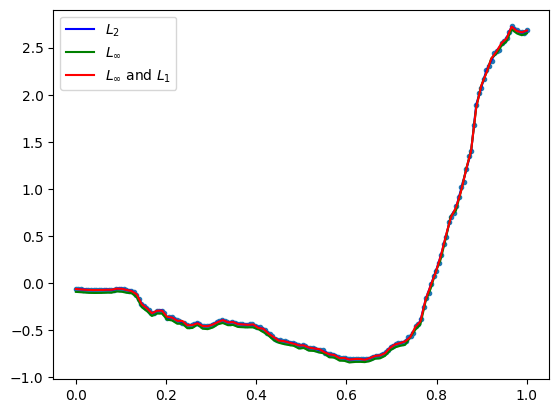

GestureMidAirD3 no. 201 len(ts): 180 ts processed: 96.63000000000001 %
[18, 36, 54, 72, 90]
            max_dist       MSE      RMSE       MAE
LSQ         0.052228  0.000244  0.015619  0.011717
Max         0.043483  0.000933  0.030550  0.027555
Max and L1  0.043484  0.000328  0.018106  0.013534 
opt distance 0.04348277294820263
number of data points: 180


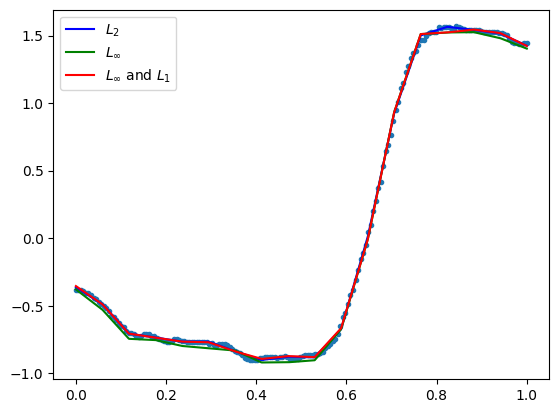

            max_dist       MSE      RMSE       MAE
LSQ         0.027639  0.000061  0.007782  0.005728
Max         0.025179  0.000356  0.018856  0.017140
Max and L1  0.025180  0.000075  0.008678  0.005709 

opt distance 0.025179127503521487
number of data points: 180


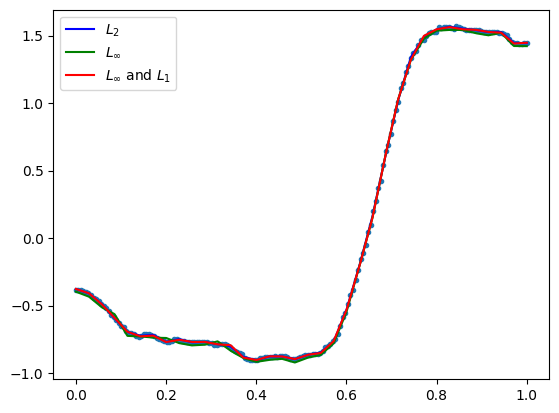

            max_dist       MSE      RMSE       MAE
LSQ         0.032043  0.000051  0.007162  0.004954
Max         0.026130  0.000458  0.021411  0.020138
Max and L1  0.026131  0.000069  0.008329  0.005131 

opt distance 0.026129575544587766
number of data points: 180


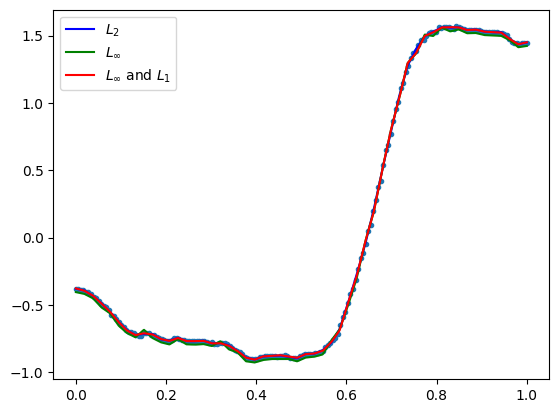

            max_dist       MSE      RMSE       MAE
LSQ         0.024988  0.000036  0.005977  0.003819
Max         0.021179  0.000320  0.017894  0.017038
Max and L1  0.021180  0.000045  0.006717  0.003689 

opt distance 0.021179054274471976
number of data points: 180


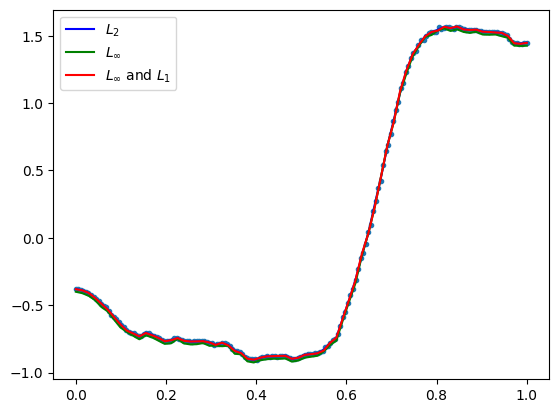

            max_dist       MSE      RMSE       MAE
LSQ         0.021663  0.000023  0.004847  0.003121
Max         0.015594  0.000185  0.013592  0.013001
Max and L1  0.015595  0.000030  0.005513  0.002966 

opt distance 0.015594066317993078
number of data points: 180


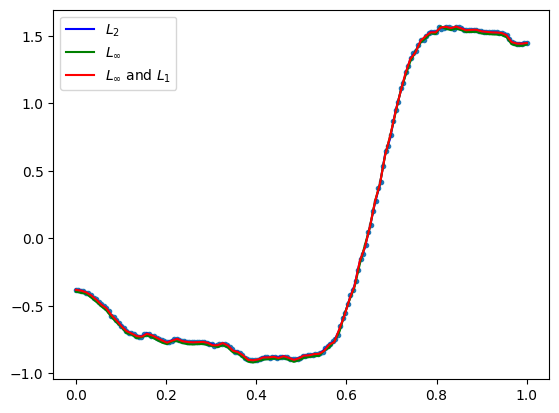

GestureMidAirD3 no. 202 len(ts): 90 ts processed: 97.11999999999999 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.467623  0.025447  0.159523  0.123678
Max         0.325833  0.053988  0.232353  0.215964
Max and L1  0.325834  0.030889  0.175753  0.147379 

opt distance 0.32583317235050985
number of data points: 90


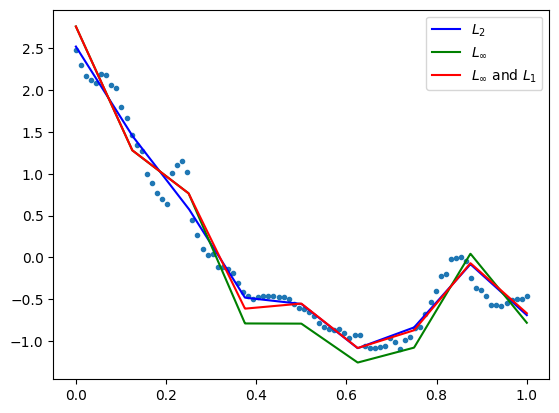

            max_dist       MSE      RMSE       MAE
LSQ         0.224994  0.005143  0.071717  0.054796
Max         0.166425  0.013597  0.116608  0.102282
Max and L1  0.166426  0.006708  0.081904  0.061018 

opt distance 0.16642549330914147
number of data points: 90


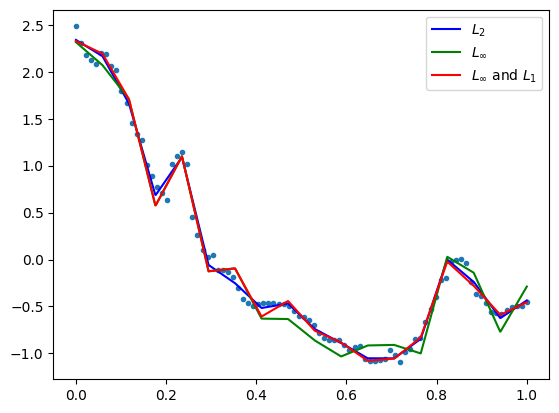

            max_dist       MSE      RMSE       MAE
LSQ         0.176645  0.001763  0.041987  0.029229
Max         0.126232  0.009435  0.097136  0.088015
Max and L1  0.126233  0.002260  0.047543  0.030288 

opt distance 0.126231551938744
number of data points: 90


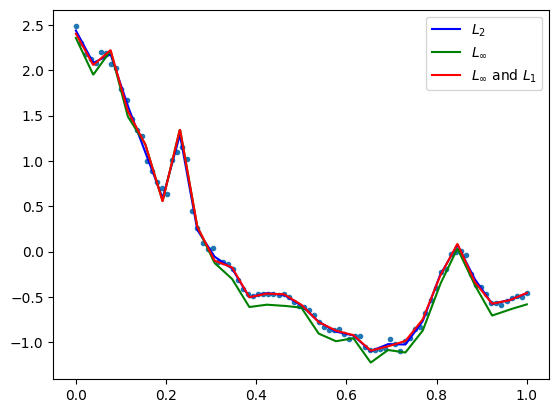

            max_dist       MSE      RMSE       MAE
LSQ         0.187416  0.001431  0.037828  0.025864
Max         0.137582  0.012681  0.112609  0.104749
Max and L1  0.137583  0.002997  0.054743  0.033920 

opt distance 0.13758226154485814
number of data points: 90


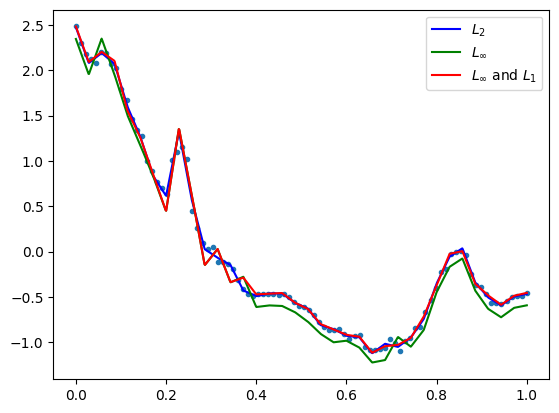

            max_dist       MSE      RMSE       MAE
LSQ         0.147714  0.001182  0.034375  0.023782
Max         0.107360  0.008237  0.090757  0.085557
Max and L1  0.107361  0.001578  0.039720  0.022308 

opt distance 0.10736005183380917
number of data points: 90


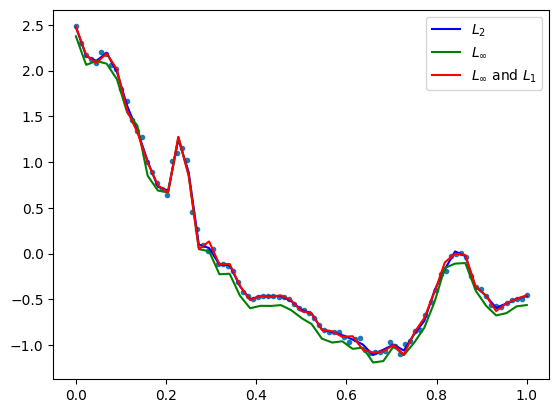

GestureMidAirD3 no. 203 len(ts): 87 ts processed: 97.6 %
[8, 17, 26, 34, 43]
            max_dist       MSE      RMSE       MAE
LSQ         0.249631  0.007249  0.085138  0.065930
Max         0.181176  0.014268  0.119449  0.104661
Max and L1  0.181177  0.009177  0.095796  0.077344 

opt distance 0.18117633109465214
number of data points: 87


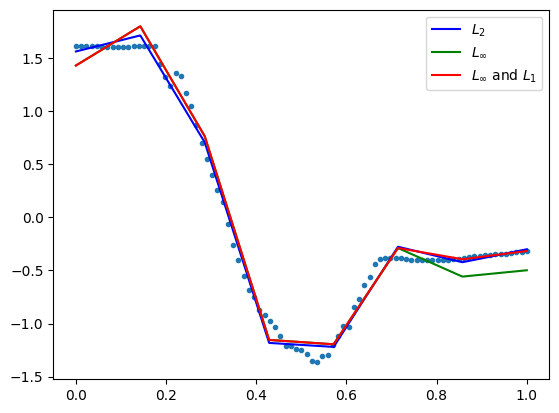

            max_dist       MSE      RMSE       MAE
LSQ         0.120031  0.001213  0.034823  0.021795
Max         0.105689  0.006758  0.082209  0.073734
Max and L1  0.105690  0.001558  0.039477  0.023575 

opt distance 0.10568925958074937
number of data points: 87


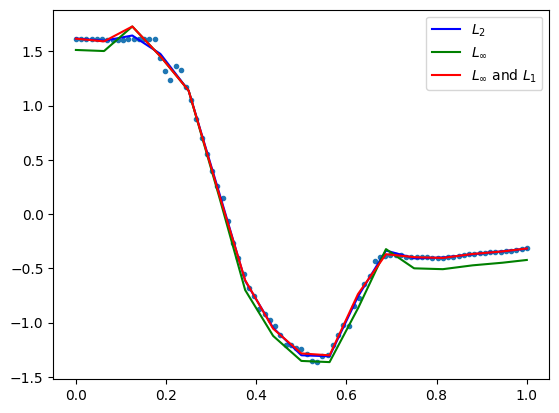

            max_dist       MSE      RMSE       MAE
LSQ         0.081705  0.000502  0.022406  0.013537
Max         0.061240  0.002618  0.051170  0.047775
Max and L1  0.061241  0.000624  0.024990  0.015220 

opt distance 0.06124047317249931
number of data points: 87


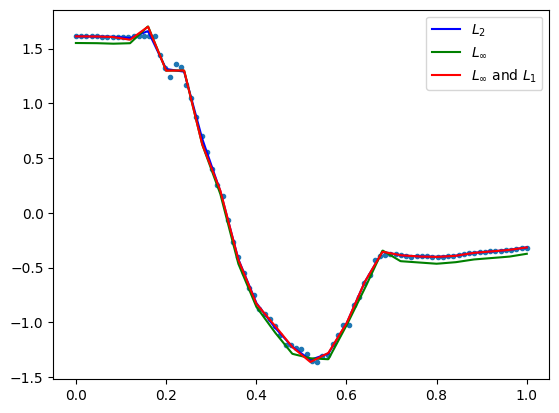

            max_dist       MSE      RMSE       MAE
LSQ         0.092533  0.000576  0.024008  0.013949
Max         0.073436  0.003900  0.062449  0.058308
Max and L1  0.073437  0.000948  0.030795  0.017661 

opt distance 0.07343563827665867
number of data points: 87


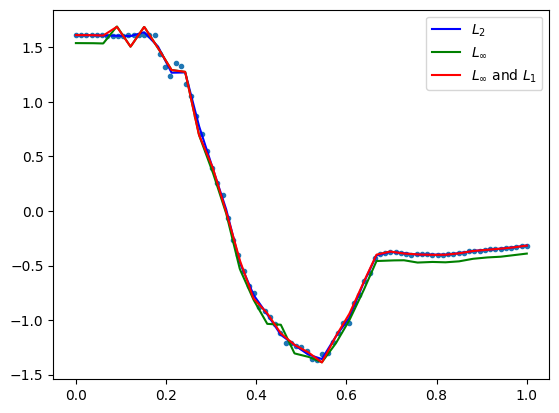

            max_dist       MSE      RMSE       MAE
LSQ         0.069914  0.000353  0.018797  0.010651
Max         0.056332  0.002405  0.049039  0.045779
Max and L1  0.056333  0.000590  0.024296  0.013462 

opt distance 0.05633236531068402
number of data points: 87


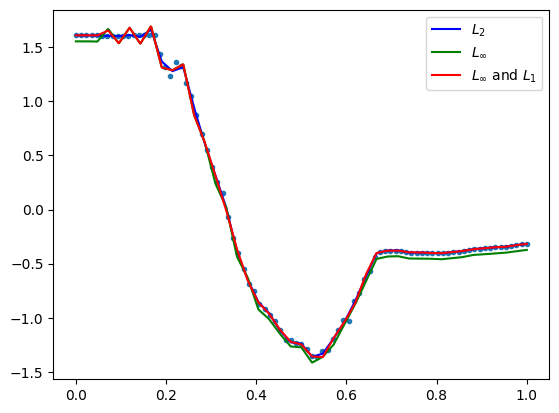

GestureMidAirD3 no. 204 len(ts): 178 ts processed: 98.08 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.225232  0.004067  0.063772  0.044566
Max         0.155629  0.011354  0.106557  0.094805
Max and L1  0.155630  0.005817  0.076267  0.058626 

opt distance 0.15562874536294205
number of data points: 178


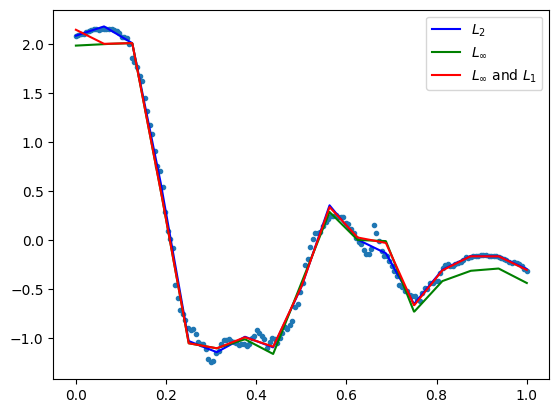

            max_dist       MSE      RMSE       MAE
LSQ         0.205883  0.001237  0.035168  0.022789
Max         0.135892  0.010646  0.103179  0.093576
Max and L1  0.135893  0.002070  0.045492  0.029000 

opt distance 0.13589154378639773
number of data points: 178


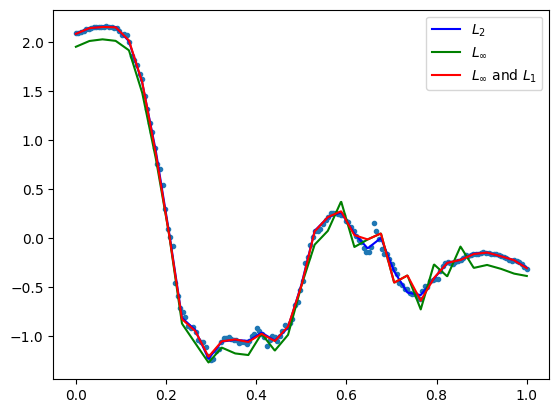

            max_dist       MSE      RMSE       MAE
LSQ         0.176418  0.000833  0.028861  0.018202
Max         0.109827  0.007812  0.088385  0.081785
Max and L1  0.109828  0.001268  0.035608  0.020510 

opt distance 0.10982678092732417
number of data points: 178


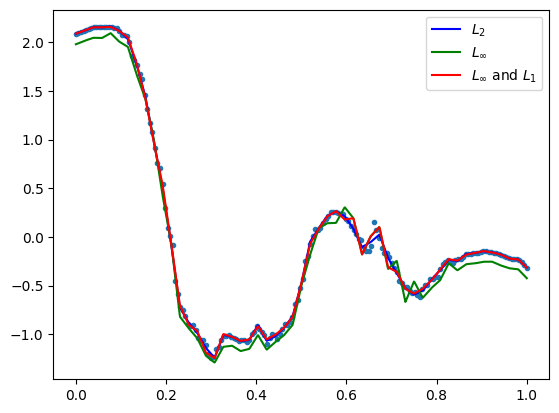

            max_dist       MSE      RMSE       MAE
LSQ         0.125042  0.000508  0.022532  0.014243
Max         0.092784  0.006258  0.079105  0.074914
Max and L1  0.092785  0.000829  0.028787  0.015247 

opt distance 0.09278431493371903
number of data points: 178


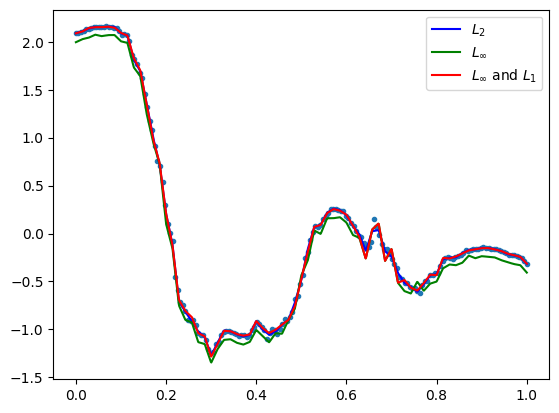

            max_dist       MSE      RMSE       MAE
LSQ         0.096141  0.000294  0.017148  0.010485
Max         0.067009  0.003470  0.058907  0.056533
Max and L1  0.067010  0.000447  0.021147  0.010774 

opt distance 0.06700924538233742
number of data points: 178


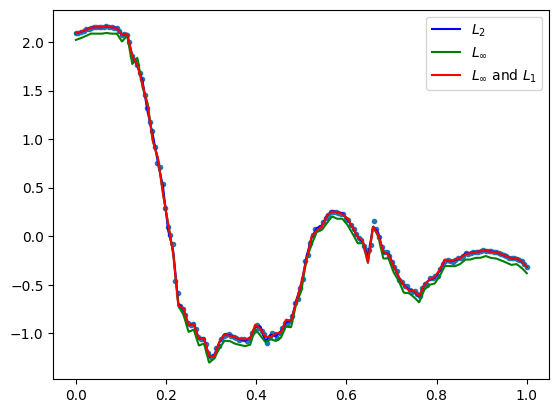

GestureMidAirD3 no. 205 len(ts): 90 ts processed: 98.56 %
[9, 18, 27, 36, 45]
            max_dist       MSE      RMSE       MAE
LSQ         0.388465  0.015101  0.122885  0.081136
Max         0.302151  0.042220  0.205476  0.180732
Max and L1  0.302152  0.027731  0.166525  0.134123 

opt distance 0.3021513964593276
number of data points: 90


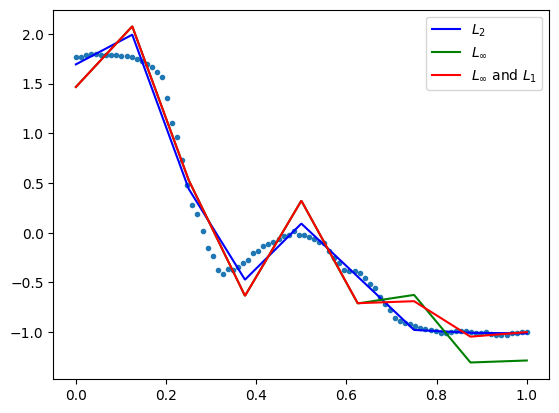

            max_dist       MSE      RMSE       MAE
LSQ         0.088031  0.000648  0.025455  0.015609
Max         0.069937  0.002704  0.052004  0.047841
Max and L1  0.069938  0.000705  0.026543  0.016854 

opt distance 0.06993705168981829
number of data points: 90


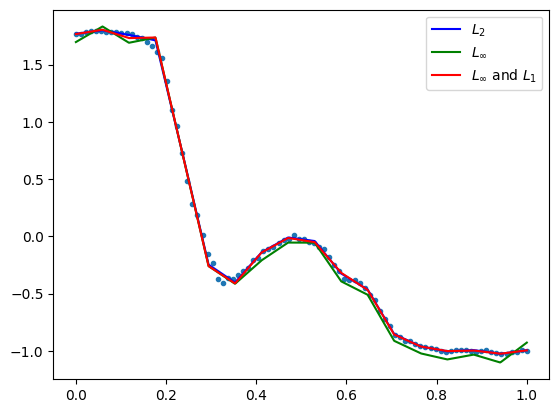

            max_dist       MSE      RMSE       MAE
LSQ         0.052754  0.000274  0.016556  0.011038
Max         0.046900  0.001279  0.035759  0.032661
Max and L1  0.046901  0.000377  0.019417  0.012368 

opt distance 0.04690041864063624
number of data points: 90


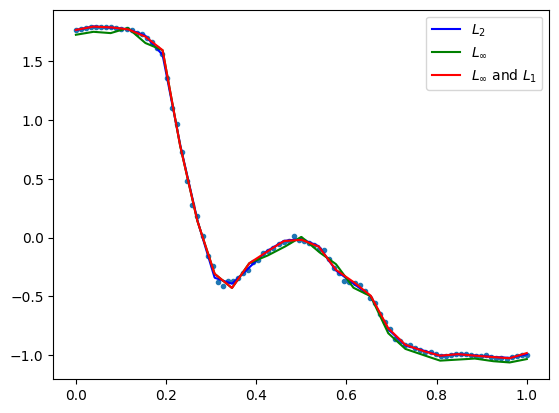

            max_dist       MSE      RMSE       MAE
LSQ         0.057616  0.000170  0.013043  0.008370
Max         0.044647  0.001379  0.037130  0.034938
Max and L1  0.044648  0.000253  0.015896  0.009136 

opt distance 0.04464660349703175
number of data points: 90


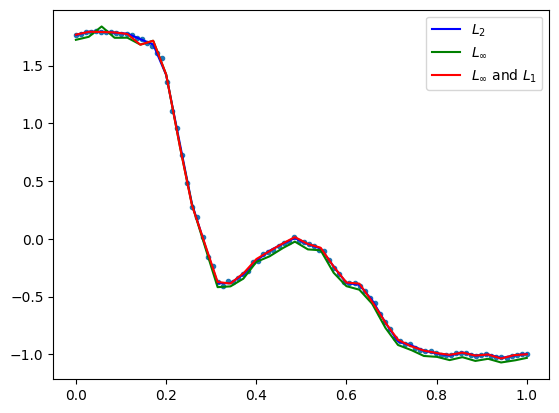

            max_dist       MSE      RMSE       MAE
LSQ         0.051850  0.000139  0.011783  0.007368
Max         0.041281  0.001255  0.035428  0.033389
Max and L1  0.041282  0.000240  0.015481  0.008430 

opt distance 0.04128092898486213
number of data points: 90


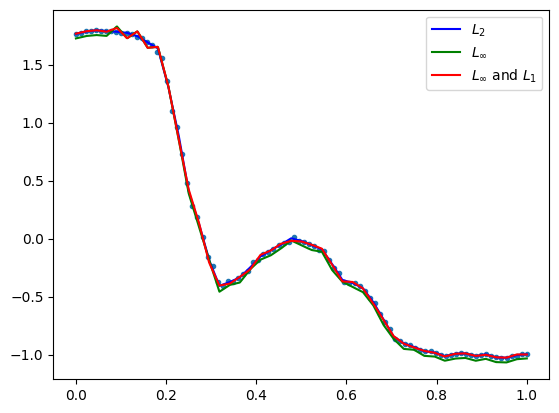

GestureMidAirD3 no. 206 len(ts): 179 ts processed: 99.03999999999999 %
[17, 35, 53, 71, 89]
            max_dist       MSE      RMSE       MAE
LSQ         0.052478  0.000208  0.014427  0.010408
Max         0.038340  0.000772  0.027785  0.025067
Max and L1  0.038341  0.000288  0.016985  0.012129 

opt distance 0.038339506231116205
number of data points: 179


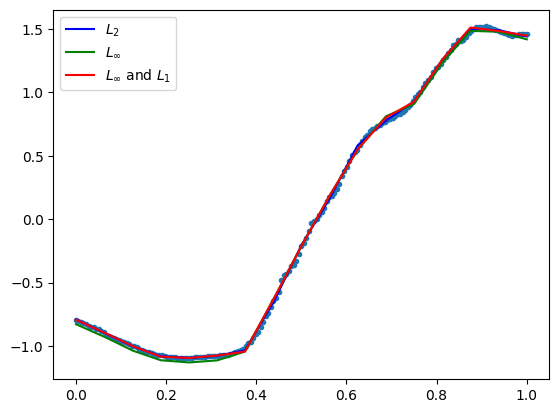

            max_dist       MSE      RMSE       MAE
LSQ         0.038708  0.000077  0.008773  0.005650
Max         0.028289  0.000529  0.023005  0.021834
Max and L1  0.028290  0.000088  0.009395  0.005662 
opt distance 0.028288812125582704
number of data points: 179


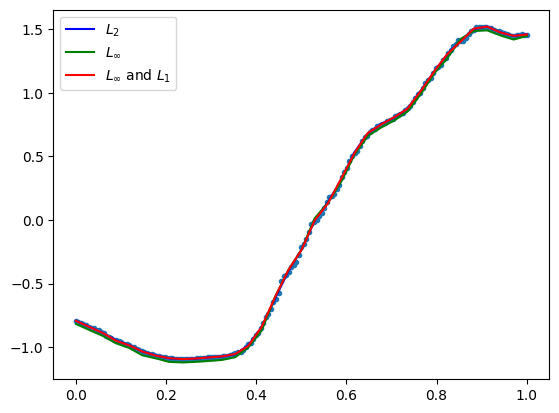

            max_dist       MSE      RMSE       MAE
LSQ         0.021043  0.000031  0.005612  0.003739
Max         0.017001  0.000193  0.013881  0.013162
Max and L1  0.017002  0.000043  0.006536  0.004097 

opt distance 0.017001282863567724
number of data points: 179


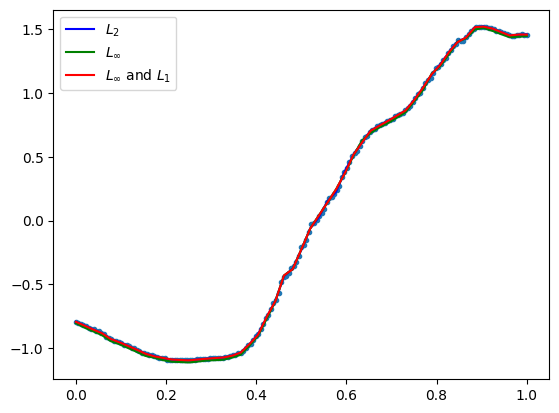

            max_dist       MSE      RMSE       MAE
LSQ         0.020762  0.000024  0.004901  0.003308
Max         0.014586  0.000155  0.012465  0.011882
Max and L1  0.014587  0.000030  0.005464  0.003050 

opt distance 0.014585973051544417
number of data points: 179


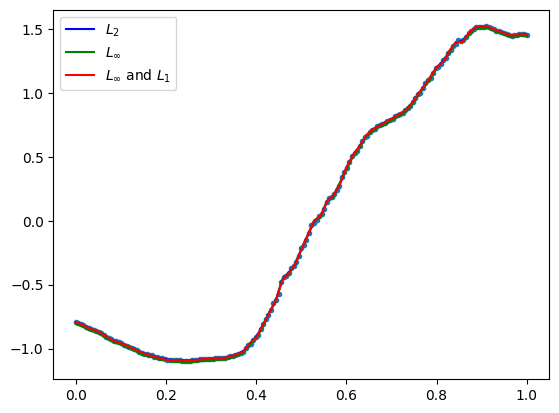

            max_dist       MSE      RMSE       MAE
LSQ         0.020449  0.000015  0.003923  0.002646
Max         0.013328  0.000135  0.011609  0.011090
Max and L1  0.013329  0.000023  0.004821  0.002646 

opt distance 0.013328213912840635
number of data points: 179


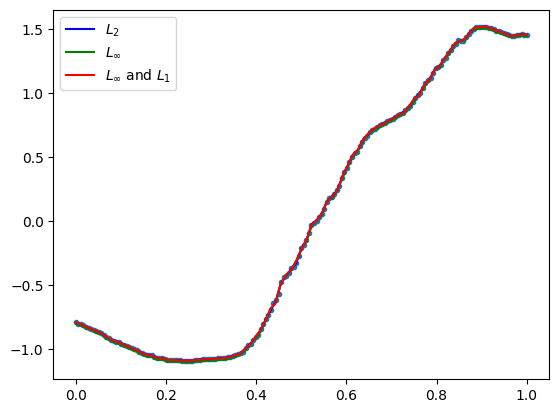

GestureMidAirD3 no. 207 len(ts): 228 ts processed: 99.52 %
[22, 45, 68, 91, 114]
            max_dist       MSE      RMSE       MAE
LSQ         0.122953  0.001515  0.038921  0.028163
Max         0.109375  0.006281  0.079252  0.071697
Max and L1  0.109376  0.001842  0.042916  0.029219 
opt distance 0.10937461176526955
number of data points: 228


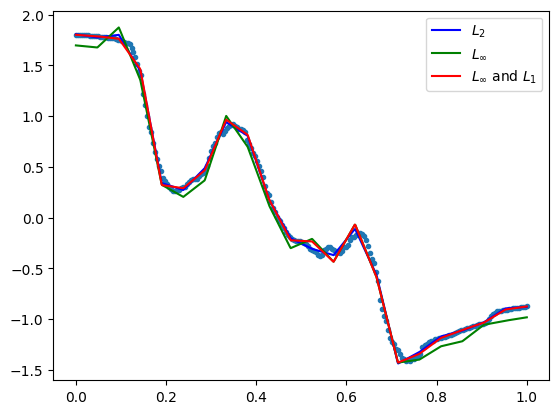

            max_dist       MSE      RMSE       MAE
LSQ         0.067361  0.000175  0.013216  0.008638
Max         0.046648  0.001367  0.036972  0.034446
Max and L1  0.046649  0.000224  0.014979  0.009031 

opt distance 0.04664838087138734
number of data points: 228


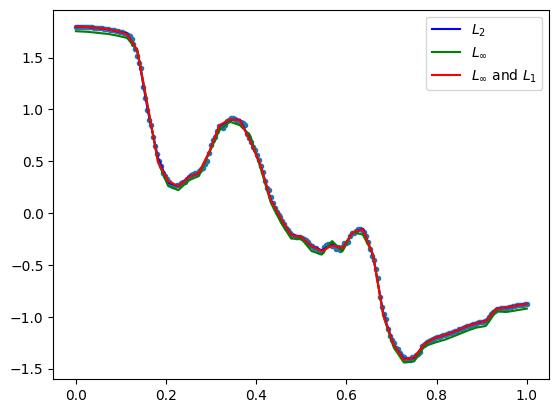

            max_dist       MSE      RMSE       MAE
LSQ         0.062434  0.000125  0.011170  0.006604
Max         0.042753  0.001335  0.036535  0.034851
Max and L1  0.042754  0.000191  0.013826  0.007520 

opt distance 0.0427528027765989
number of data points: 228


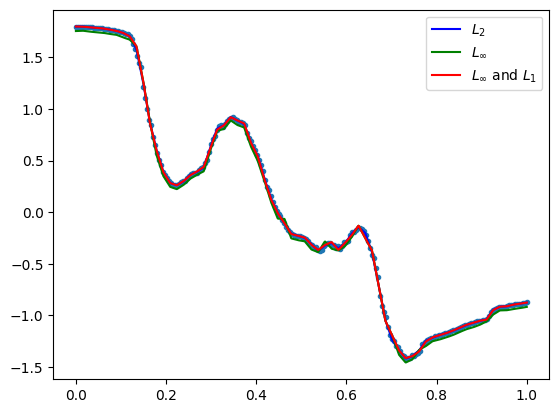

            max_dist       MSE      RMSE       MAE
LSQ         0.027895  0.000051  0.007147  0.004484
Max         0.019963  0.000288  0.016973  0.016072
Max and L1  0.019964  0.000059  0.007678  0.004446 

opt distance 0.019963207942145237
number of data points: 228


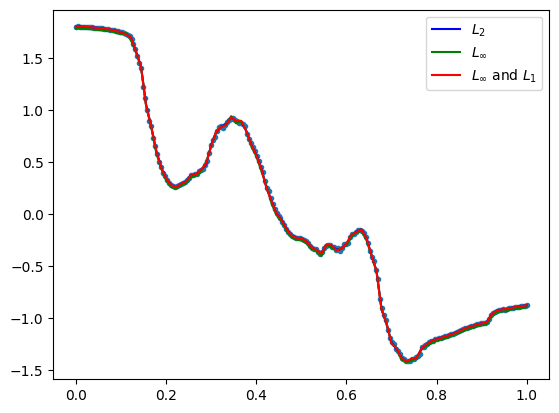

            max_dist       MSE      RMSE       MAE
LSQ         0.045753  0.000048  0.006908  0.003969
Max         0.033047  0.000874  0.029564  0.028285
Max and L1  0.033048  0.000076  0.008702  0.004028 

opt distance 0.03304716946445927
number of data points: 228


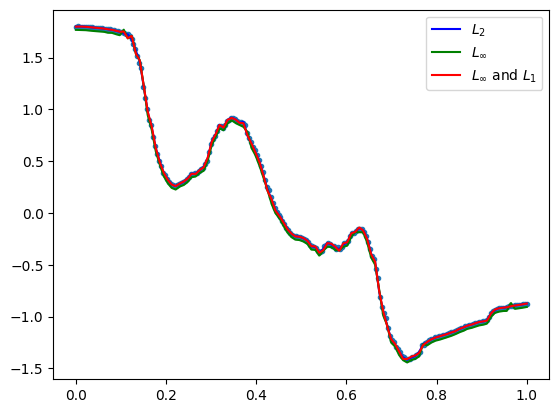

CPU times: total: 9min 53s
Wall time: 9min 55s


In [26]:
%%time
from plot import plot_splines
from spline_utils import generate_coeff_counts, generate_knot_vector_from_coeff_count
from fit import fit_max_spline, fit_max_l1_spline
from sklearn.metrics import mean_squared_error, mean_absolute_error
from spline_utils import evaluate_spline
import matplotlib.pyplot as plt
import pandas as pd

"""short = 0
medium = 1

dataset = short

data = all_data[dataset]
compression_ratios = all_compression_ratios[dataset]"""
print("number of time series:", len(data.index))

results = []
error_ts = []
counter = 0
for index, row in data.iterrows():
    time_series = row['data']
    print(row['dataset'], "no.", row['num'], "len(ts):", len(time_series), "ts processed:",
          round(counter / len(data.index), 4) * 100, "%")
    counter += 1
    for degree in degrees:
        counts = generate_coeff_counts(num_data_pts=len(time_series), degree=degree,
                                       compression_ratios=compression_ratios)
        print(counts)
        for count in counts:
            knots = generate_knot_vector_from_coeff_count(degree=degree, num_coeffs=count)

            error_metrics = calculate_errors(time_series, knots, degree)
            df = pd.DataFrame(error_metrics, columns=['max_dist', 'MSE', 'RMSE', 'MAE'])
            df.index = ['LSQ', 'Max', 'Max and L1']
            print(df, "\n")

            plot_splines(plt, knots, degree, time_series, plot_LSQ=True, plot_max=True, plot_max_l1=True)
            plt.show()


number of time series: 208
GestureMidAirD3 no. 0 len(ts): 180 ts processed: 0.0 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.184599  0.002720  0.052155  0.030711
Max         0.162061  0.014044  0.118506  0.106227
Max and L1  0.162062  0.005385  0.073382  0.050685 

opt distance 0.16206124895429452
number of data points: 180


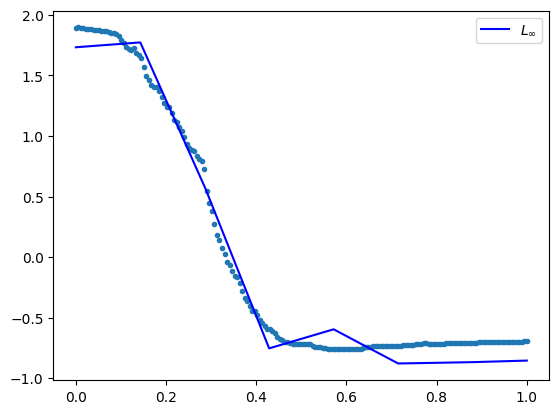

GestureMidAirD3 no. 1 len(ts): 90 ts processed: 0.48 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.542881  0.045537  0.213393  0.158191
Max         0.445939  0.081013  0.284628  0.252146
Max and L1  0.445940  0.072231  0.268758  0.231571 

opt distance 0.44593906272340583
number of data points: 90


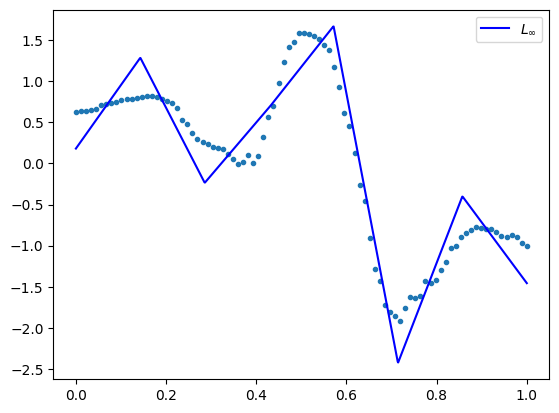

GestureMidAirD3 no. 2 len(ts): 120 ts processed: 0.96 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.169080  0.004407  0.066383  0.048802
Max         0.152188  0.009906  0.099531  0.087136
Max and L1  0.152189  0.005184  0.071998  0.054383 

opt distance 0.15218813678754506
number of data points: 120


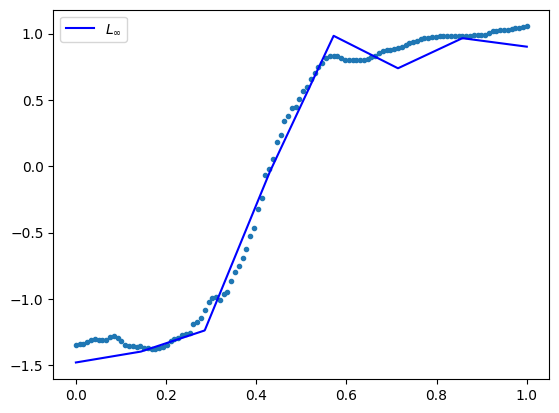

GestureMidAirD3 no. 3 len(ts): 240 ts processed: 1.44 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.517713  0.037413  0.193425  0.150481
Max         0.440253  0.070722  0.265937  0.233849
Max and L1  0.440254  0.040487  0.201215  0.155650 

opt distance 0.4402525246701091
number of data points: 240


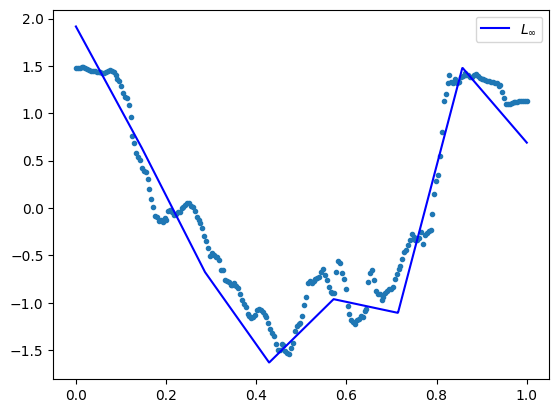

GestureMidAirD3 no. 4 len(ts): 238 ts processed: 1.92 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.482539  0.039818  0.199545  0.166749
Max         0.397658  0.049936  0.223463  0.184063
Max and L1  0.397659  0.044707  0.211441  0.175745 

opt distance 0.3976577680720697
number of data points: 238


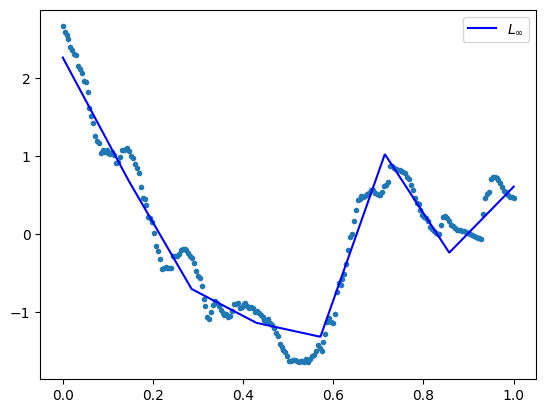

GestureMidAirD3 no. 5 len(ts): 90 ts processed: 2.4 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.105789  0.002346  0.048431  0.040515
Max         0.097091  0.003206  0.056621  0.048257
Max and L1  0.097092  0.002593  0.050919  0.042256 

opt distance 0.09709073769565368
number of data points: 90


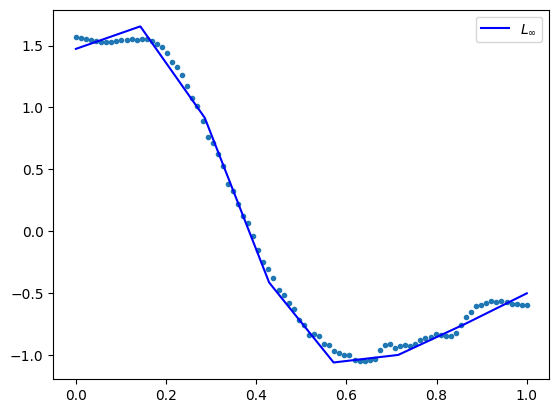

GestureMidAirD3 no. 6 len(ts): 360 ts processed: 2.88 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.413545  0.031935  0.178703  0.145977
Max         0.342664  0.056611  0.237931  0.214404
Max and L1  0.342665  0.038567  0.196385  0.159746 

opt distance 0.3426638488341529
number of data points: 360


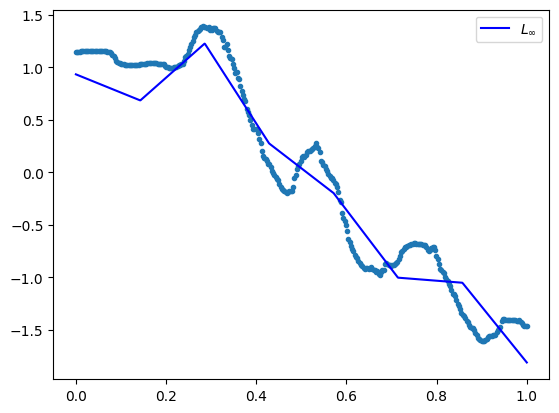

GestureMidAirD3 no. 7 len(ts): 120 ts processed: 3.37 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.108997  0.002562  0.050619  0.040837
Max         0.101076  0.004439  0.066627  0.058543
Max and L1  0.101077  0.002600  0.050989  0.041120 

opt distance 0.10107575890310196
number of data points: 120


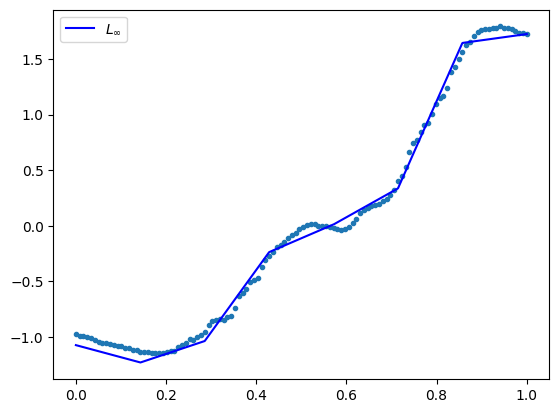

GestureMidAirD3 no. 8 len(ts): 180 ts processed: 3.85 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.266746  0.009502  0.097476  0.072428
Max         0.207260  0.017925  0.133885  0.119144
Max and L1  0.207261  0.014524  0.120516  0.099885 

opt distance 0.20725954699851123
number of data points: 180


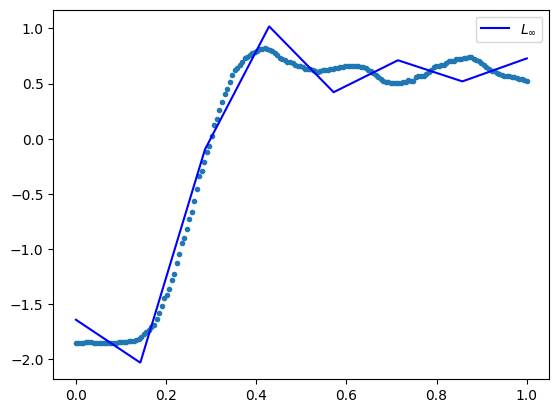

GestureMidAirD3 no. 9 len(ts): 169 ts processed: 4.33 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.086982  0.000712  0.026684  0.019373
Max         0.066173  0.001705  0.041290  0.036664
Max and L1  0.066174  0.000754  0.027453  0.019889 

opt distance 0.06617290448448111
number of data points: 169


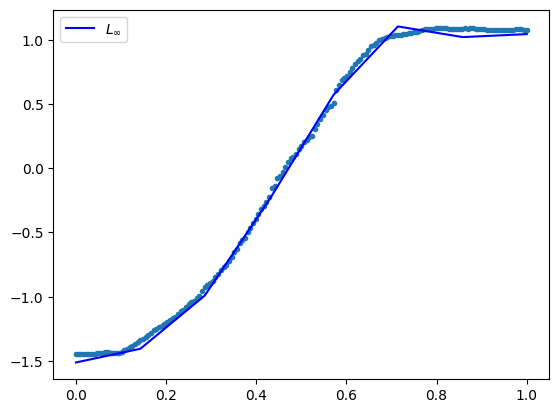

GestureMidAirD3 no. 10 len(ts): 179 ts processed: 4.81 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.240068  0.006546  0.080908  0.057455
Max         0.190230  0.018782  0.137049  0.124016
Max and L1  0.190231  0.008203  0.090568  0.065674 

opt distance 0.1902296353232249
number of data points: 179


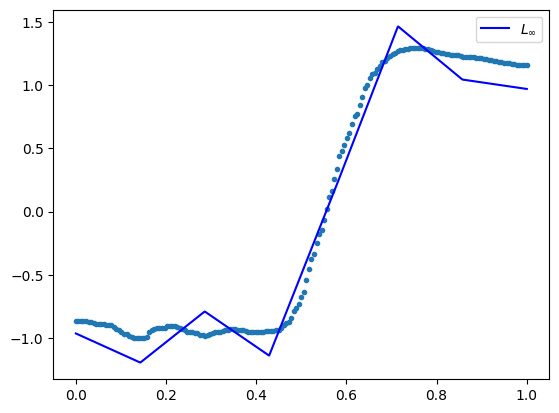

GestureMidAirD3 no. 11 len(ts): 180 ts processed: 5.29 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.271904  0.009262  0.096239  0.065738
Max         0.225223  0.029199  0.170878  0.158920
Max and L1  0.225224  0.012413  0.111413  0.083890 

opt distance 0.22522297611680242
number of data points: 180


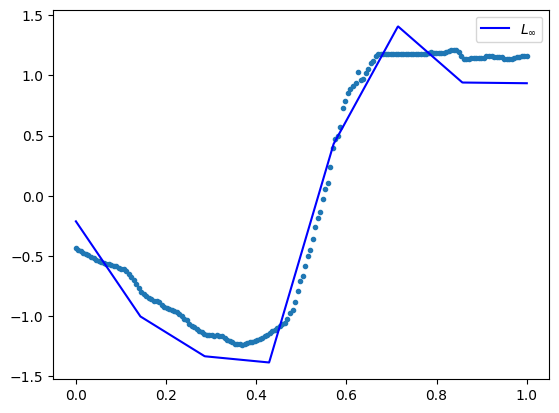

GestureMidAirD3 no. 12 len(ts): 180 ts processed: 5.7700000000000005 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.579411  0.040245  0.200612  0.147783
Max         0.471794  0.097748  0.312646  0.282942
Max and L1  0.471795  0.065221  0.255384  0.210057 

opt distance 0.4717943238421507
number of data points: 180


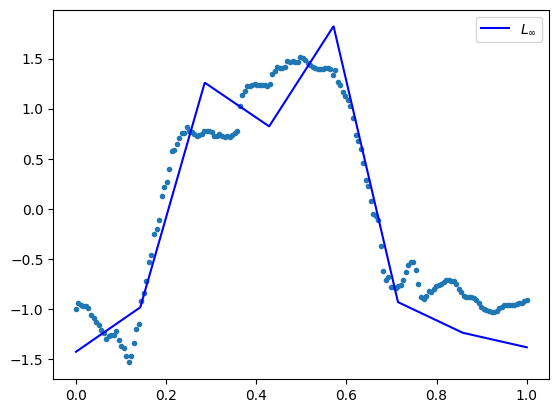

GestureMidAirD3 no. 13 len(ts): 120 ts processed: 6.25 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.231337  0.007681  0.087642  0.070871
Max         0.171354  0.012907  0.113610  0.100130
Max and L1  0.171355  0.008686  0.093198  0.074834 

opt distance 0.1713542440558997
number of data points: 120


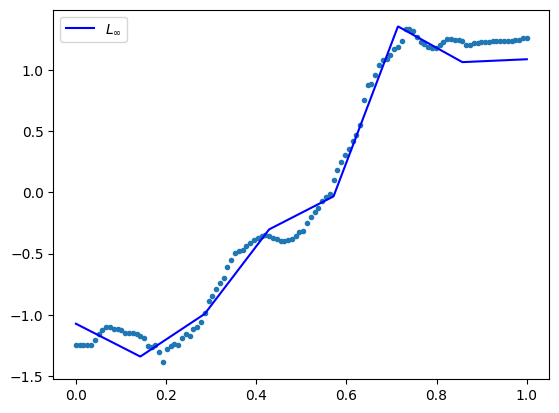

GestureMidAirD3 no. 14 len(ts): 300 ts processed: 6.7299999999999995 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         1.174295  0.244598  0.494569  0.380078
Max         1.007650  0.383865  0.619569  0.538058
Max and L1  1.007651  0.275499  0.524880  0.407909 
opt distance 1.0076498722718659
number of data points: 300


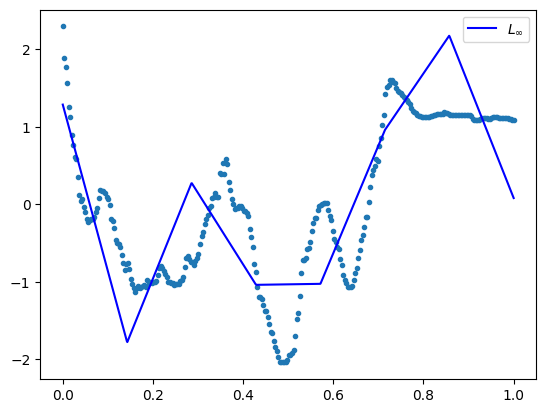

GestureMidAirD3 no. 15 len(ts): 316 ts processed: 7.21 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.545419  0.057323  0.239423  0.193522
Max         0.423035  0.079627  0.282183  0.252128
Max and L1  0.423036  0.067444  0.259699  0.222060 

opt distance 0.42303537164543337
number of data points: 316


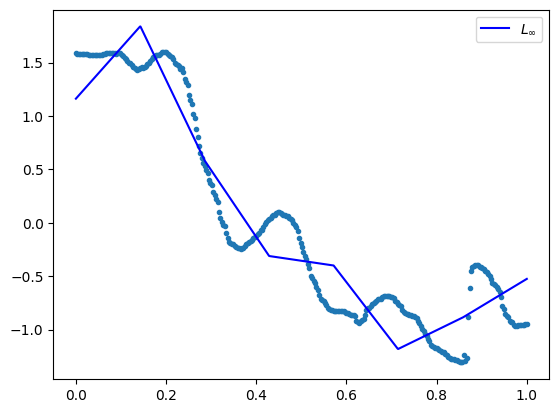

GestureMidAirD3 no. 16 len(ts): 180 ts processed: 7.6899999999999995 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.427333  0.019576  0.139916  0.101987
Max         0.340739  0.055716  0.236042  0.212817
Max and L1  0.340740  0.029062  0.170477  0.135112 

opt distance 0.3407394356206519
number of data points: 180


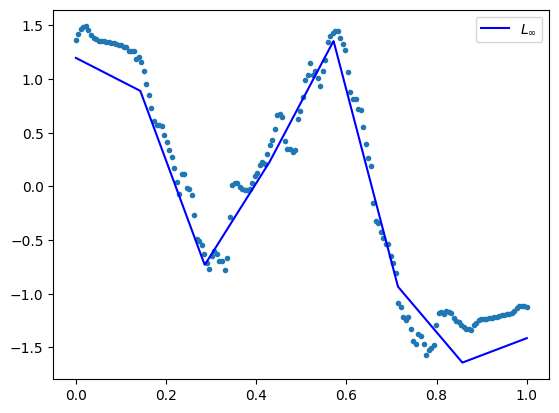

GestureMidAirD3 no. 17 len(ts): 180 ts processed: 8.17 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.300696  0.011536  0.107408  0.082982
Max         0.246002  0.026296  0.162162  0.143793
Max and L1  0.246003  0.015094  0.122856  0.096965 
opt distance 0.24600239813562297
number of data points: 180


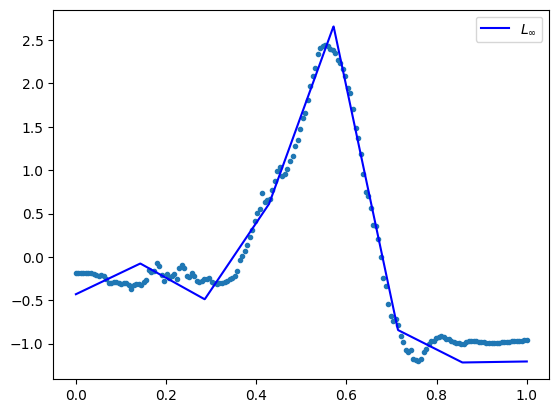

GestureMidAirD3 no. 18 len(ts): 120 ts processed: 8.649999999999999 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.286083  0.007966  0.089251  0.066112
Max         0.203459  0.015377  0.124004  0.106812
Max and L1  0.203460  0.011588  0.107647  0.083413 

opt distance 0.20345946775798082
number of data points: 120


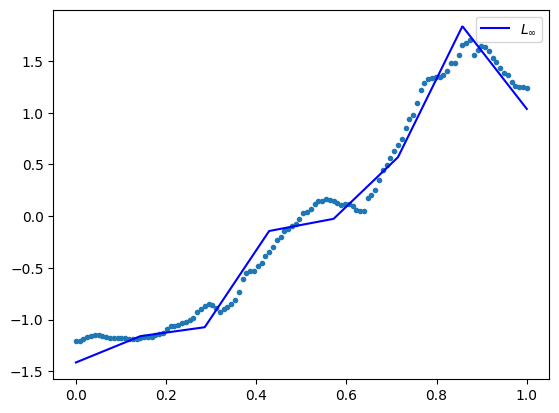

GestureMidAirD3 no. 19 len(ts): 171 ts processed: 9.13 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.492860  0.031901  0.178610  0.113665
Max         0.399922  0.104836  0.323785  0.305522
Max and L1  0.399923  0.046965  0.216714  0.165967 

opt distance 0.39992158065828587
number of data points: 171


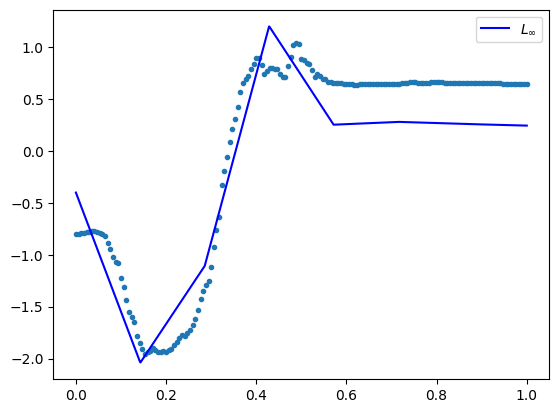

GestureMidAirD3 no. 20 len(ts): 109 ts processed: 9.62 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.219137  0.006256  0.079095  0.062064
Max         0.169089  0.012502  0.111810  0.100750
Max and L1  0.169090  0.007845  0.088572  0.070457 

opt distance 0.16908908548242968
number of data points: 109


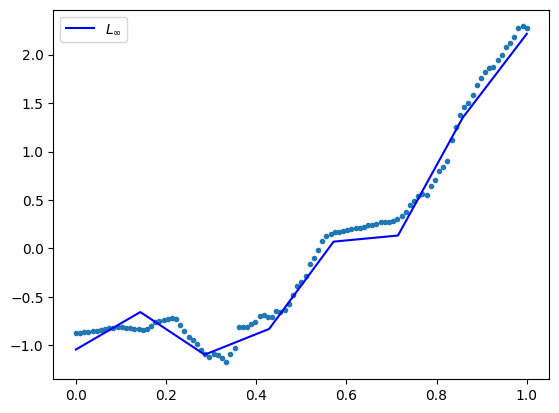

GestureMidAirD3 no. 21 len(ts): 120 ts processed: 10.100000000000001 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.255844  0.008501  0.092202  0.073814
Max         0.204631  0.015108  0.122916  0.104737
Max and L1  0.204632  0.011658  0.107970  0.086930 

opt distance 0.2046314170693241
number of data points: 120


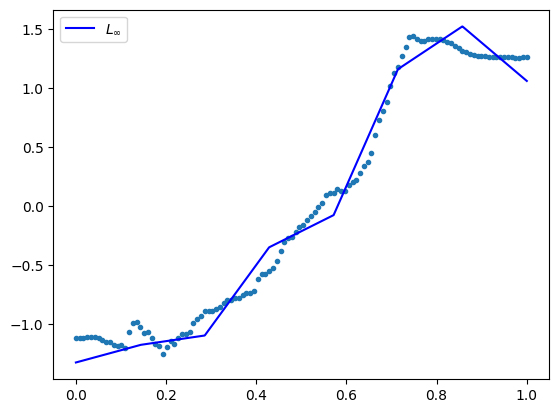

GestureMidAirD3 no. 22 len(ts): 173 ts processed: 10.58 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.096146  0.000701  0.026482  0.018781
Max         0.075992  0.002127  0.046118  0.040367
Max and L1  0.075993  0.001504  0.038783  0.031064 

opt distance 0.07599155282159586
number of data points: 173


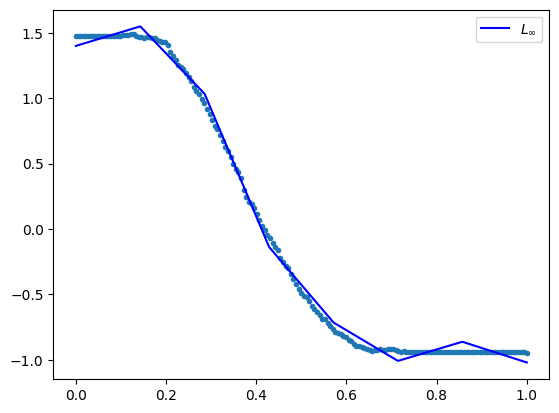

GestureMidAirD3 no. 23 len(ts): 120 ts processed: 11.06 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.591797  0.052724  0.229617  0.179668
Max         0.496357  0.110958  0.333104  0.298073
Max and L1  0.496358  0.063624  0.252237  0.198225 

opt distance 0.49635743081457134
number of data points: 120


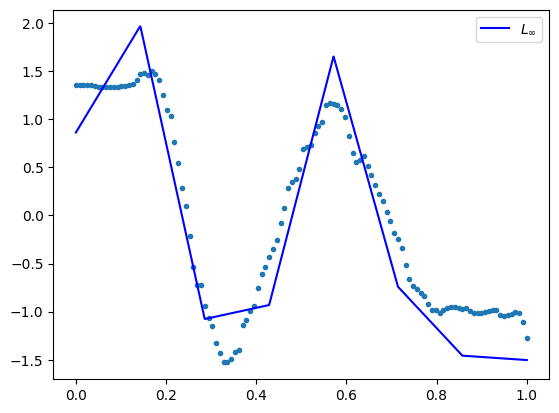

GestureMidAirD3 no. 24 len(ts): 359 ts processed: 11.540000000000001 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.385762  0.027602  0.166139  0.129326
Max         0.320964  0.045951  0.214361  0.193928
Max and L1  0.320965  0.035637  0.188776  0.160244 

opt distance 0.32096379429735994
number of data points: 359


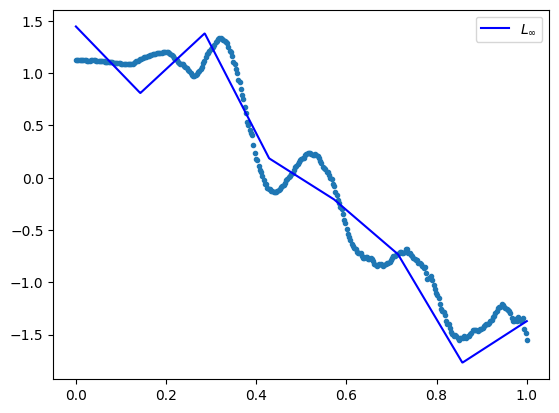

GestureMidAirD3 no. 25 len(ts): 90 ts processed: 12.02 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.241711  0.003780  0.061484  0.044521
Max         0.151813  0.008542  0.092421  0.080580
Max and L1  0.151814  0.006826  0.082621  0.066812 

opt distance 0.1518132708436815
number of data points: 90


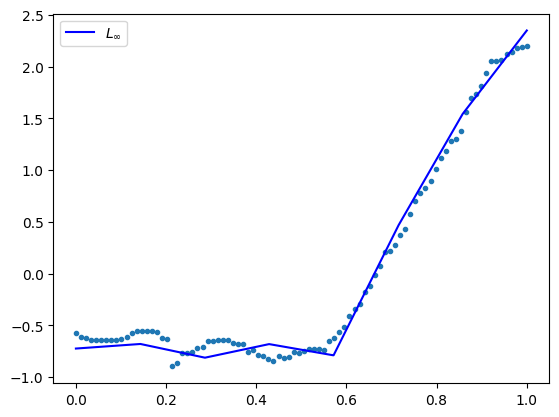

GestureMidAirD3 no. 26 len(ts): 90 ts processed: 12.5 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.560186  0.034117  0.184709  0.138318
Max         0.429932  0.077465  0.278325  0.245453
Max and L1  0.429933  0.043224  0.207903  0.164234 

opt distance 0.4299323867280388
number of data points: 90


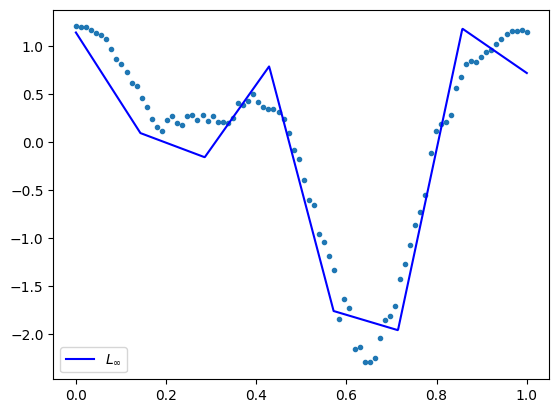

GestureMidAirD3 no. 27 len(ts): 227 ts processed: 12.98 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         1.218975  0.195733  0.442417  0.293743
Max         1.066067  0.737852  0.858983  0.815459
Max and L1  1.066068  0.257873  0.507812  0.336090 

opt distance 1.0660666783905375
number of data points: 227


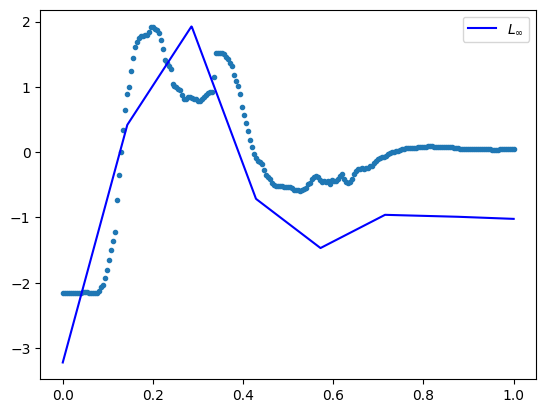

GestureMidAirD3 no. 28 len(ts): 180 ts processed: 13.459999999999999 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.291913  0.011293  0.106269  0.080629
Max         0.236605  0.022705  0.150680  0.132198
Max and L1  0.236606  0.016016  0.126554  0.103015 

opt distance 0.23660518419563004
number of data points: 180


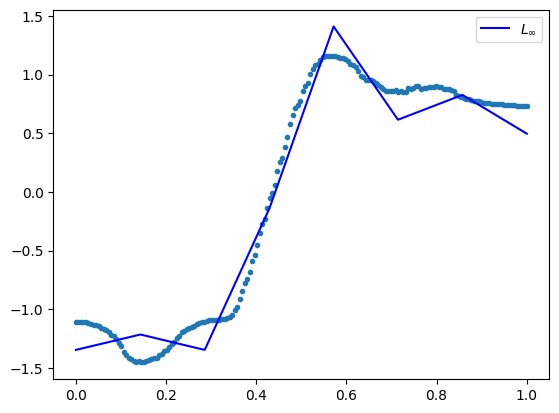

GestureMidAirD3 no. 29 len(ts): 180 ts processed: 13.94 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.566312  0.064401  0.253774  0.213549
Max         0.441500  0.084903  0.291381  0.258650
Max and L1  0.441501  0.076394  0.276395  0.241953 
opt distance 0.4414995461023593
number of data points: 180


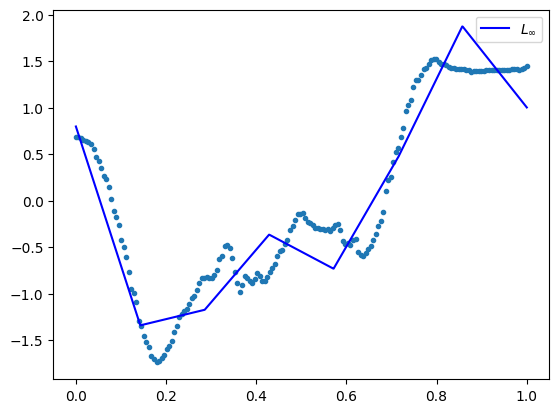

GestureMidAirD3 no. 30 len(ts): 161 ts processed: 14.42 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.218808  0.004121  0.064193  0.049021
Max         0.173926  0.010117  0.100584  0.086013
Max and L1  0.173927  0.007202  0.084865  0.067754 
opt distance 0.17392573374455067
number of data points: 161


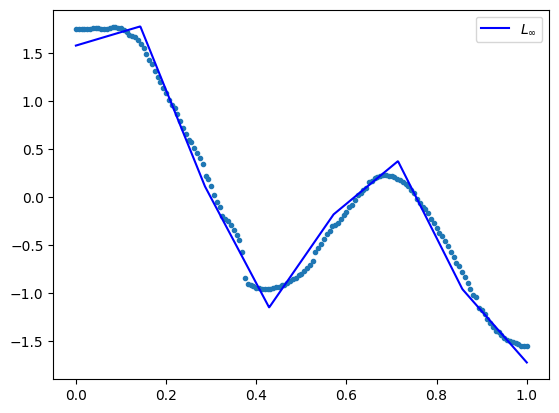

GestureMidAirD3 no. 31 len(ts): 180 ts processed: 14.899999999999999 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.280614  0.008264  0.090908  0.069975
Max         0.231379  0.017676  0.132951  0.114358
Max and L1  0.231380  0.009318  0.096530  0.076009 

opt distance 0.2313792513376608
number of data points: 180


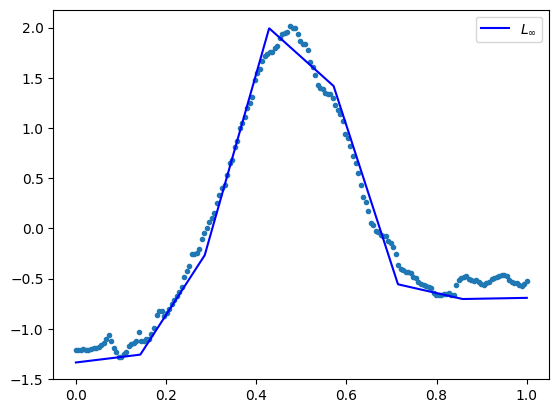

GestureMidAirD3 no. 32 len(ts): 120 ts processed: 15.379999999999999 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.154207  0.002135  0.046211  0.033904
Max         0.122920  0.007221  0.084974  0.076971
Max and L1  0.122921  0.003313  0.057558  0.046269 

opt distance 0.122920461643184
number of data points: 120


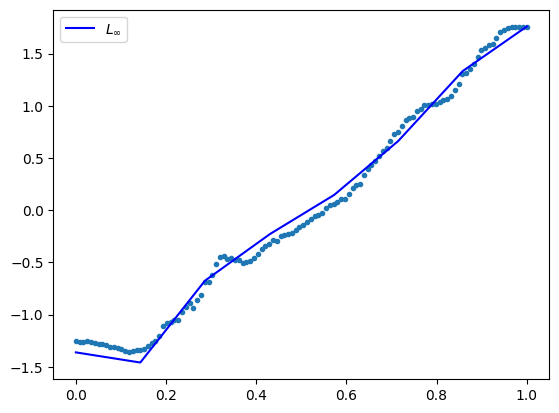

GestureMidAirD3 no. 33 len(ts): 228 ts processed: 15.870000000000001 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         1.198530  0.275485  0.524866  0.372148
Max         1.068228  0.539214  0.734312  0.654084
Max and L1  1.068229  0.372402  0.610248  0.499483 

opt distance 1.068228264057077
number of data points: 228


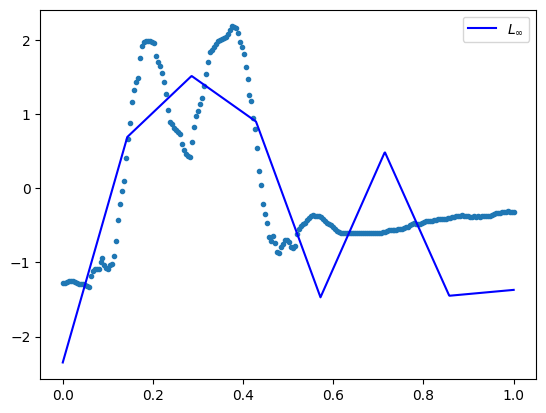

GestureMidAirD3 no. 34 len(ts): 119 ts processed: 16.35 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.170967  0.003617  0.060143  0.046714
Max         0.141687  0.007399  0.086016  0.075620
Max and L1  0.141688  0.004960  0.070427  0.057759 

opt distance 0.14168737361397454
number of data points: 119


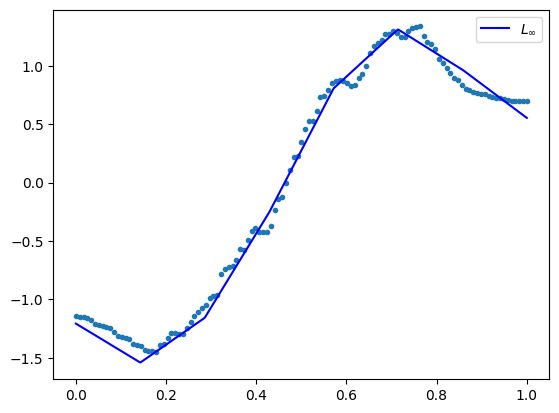

GestureMidAirD3 no. 35 len(ts): 179 ts processed: 16.830000000000002 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.269849  0.016626  0.128942  0.109621
Max         0.241244  0.021390  0.146253  0.124745
Max and L1  0.241245  0.017307  0.131558  0.111228 

opt distance 0.24124394813556738
number of data points: 179


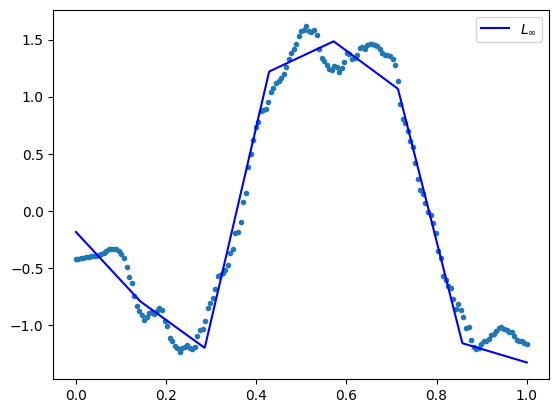

GestureMidAirD3 no. 36 len(ts): 341 ts processed: 17.31 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.248056  0.010215  0.101072  0.080430
Max         0.208814  0.022466  0.149886  0.136825
Max and L1  0.208815  0.015386  0.124038  0.104493 

opt distance 0.20881398785123417
number of data points: 341


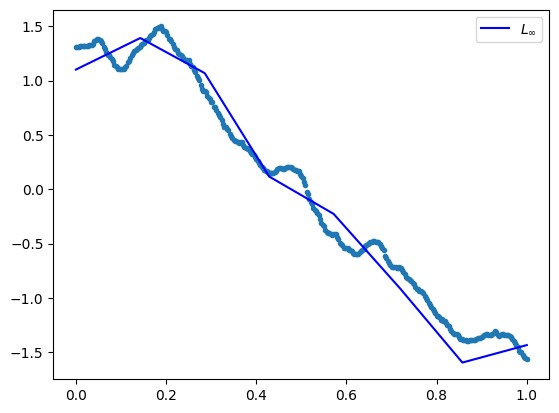

GestureMidAirD3 no. 37 len(ts): 179 ts processed: 17.79 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.178113  0.006559  0.080987  0.064707
Max         0.156215  0.011578  0.107602  0.098798
Max and L1  0.156216  0.008540  0.092410  0.077950 

opt distance 0.15621500926163034
number of data points: 179


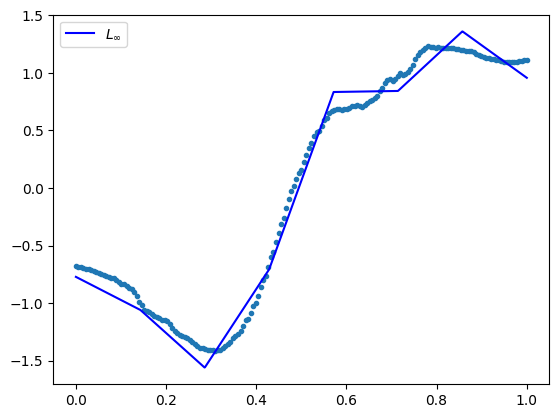

GestureMidAirD3 no. 38 len(ts): 89 ts processed: 18.27 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.068484  0.000403  0.020081  0.016026
Max         0.047716  0.000881  0.029679  0.025864
Max and L1  0.047717  0.000527  0.022949  0.017854 

opt distance 0.04771601847415932
number of data points: 89


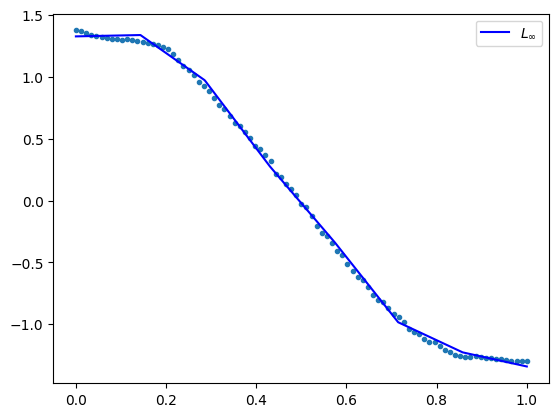

GestureMidAirD3 no. 39 len(ts): 87 ts processed: 18.75 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.388231  0.018067  0.134415  0.099380
Max         0.303663  0.040388  0.200969  0.179138
Max and L1  0.303664  0.021397  0.146278  0.107874 

opt distance 0.30366324144827117
number of data points: 87


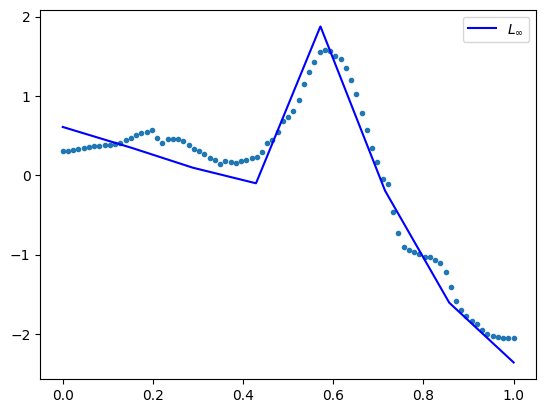

GestureMidAirD3 no. 40 len(ts): 114 ts processed: 19.23 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.563891  0.044825  0.211719  0.161637
Max         0.418239  0.074793  0.273483  0.239022
Max and L1  0.418240  0.070935  0.266337  0.228598 

opt distance 0.41823948209856954
number of data points: 114


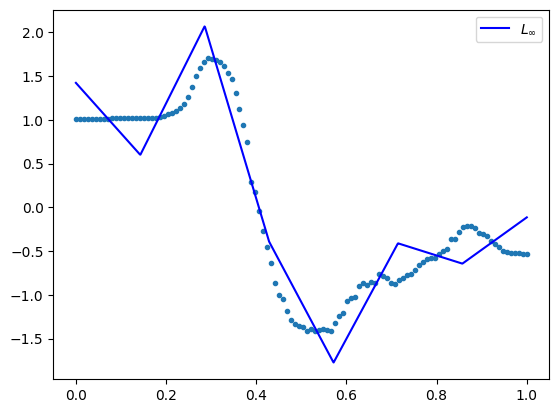

GestureMidAirD3 no. 41 len(ts): 167 ts processed: 19.71 %
knot_vector [0, 0, 0.14285714285714285, 0.2857142857142857, 0.42857142857142855, 0.5714285714285714, 0.7142857142857143, 0.8571428571428571, 1, 1]
            max_dist       MSE      RMSE       MAE
LSQ         0.316335  0.010096  0.100477  0.082851
Max         0.235007  0.021867  0.147876  0.131502
Max and L1  0.235008  0.018606  0.136402  0.116282 

opt distance 0.23500723693667325
number of data points: 167


KeyboardInterrupt: 

In [23]:
%%time
from plot import plot_splines
from spline_utils import generate_coeff_counts, generate_knot_vector_from_coeff_count
from fit import fit_max_spline, fit_max_l1_spline
from sklearn.metrics import mean_squared_error, mean_absolute_error
from spline_utils import evaluate_spline
import matplotlib.pyplot as plt
import pandas as pd

degree = 1

short = 0
medium = 1

dataset = short

#data = all_data[dataset]
#compression_ratios = all_compression_ratios[dataset]
print("number of time series:", len(data.index))

results = []
error_ts = []
counter = 0
for index, row in data.iterrows():
    time_series = row['data']
    
    print(row['dataset'], "no.", row['num'], "len(ts):", len(time_series), "ts processed:",
          round(counter / len(data.index), 4) * 100, "%")
    counter += 1

    knots = generate_knot_vector_from_coeff_count(degree=degree, num_coeffs=8)
    print("knot_vector", knots)

    error_metrics = calculate_errors(time_series, knots, degree)
    df = pd.DataFrame(error_metrics, columns=['max_dist', 'MSE', 'RMSE', 'MAE'])
    df.index = ['LSQ', 'Max', 'Max and L1']
    print(df, "\n")

    #plot_splines(plt, knots=knots, n=degree, data=time_series, plot_LSQ=True, plot_max=True, plot_max_l1=True)
    plot_splines(plt, knots, degree, time_series)
    plt.show()